In [1]:
# Imports
import sys
sys.path.insert(1, '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/')
import os
from importlib import reload
import copy
import numpy as np
import tensorflow as tf
import tensorflow_gnn as tfgnn
from tensorflow_gnn.models import gat_v2
from tensorflow import keras
import sklearn.ensemble as ensemble
import sklearn.impute as impute
import awkward as ak
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as plt_colours
import matplotlib as mpl
from mpl_toolkits.mplot3d import Axes3D
from python.analysis import EventSelection, Plots, vector, PairSelection, Master, PFOSelection, cross_section, CutOptimization
from python.analysis import SelectionEvaluation as seval
from python.gnn import DataPreparation, Models, bdt_classifier, Layers
from apps import photon_pairs
import time
import timeit

2024-07-23 08:58:02.311878: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
plt_conf = Plots.PlotConfig()
plt_conf.SHOW_PLOT = True
plt_conf.SAVE_FOLDER = None
# plt_conf.BINS = 30

In [3]:
def apply_selection(
        events, data_type, selection,
        conf_args=None,
        conf_file="/users/wx21978/projects/pion-phys/pi0-analysis/analysis/config/cex_analysis_3GeV_config_hm01.json",
        show_table=True):
    if show_table:
        init_tab_index = events.cutTable.concat_index
    if conf_args is None:
        conf_args = cross_section.ApplicationArguments.ResolveConfig(cross_section.LoadConfiguration(conf_file))
    args = vars(conf_args)
    if selection.lower() == "valid_pfo":
        if not args["valid_pfo_selection"]:
            return events
        pos_mask = PFOSelection.ValidRecoTrackPositionCut(events)
        events.Filter([pos_mask], [])
        mask = PFOSelection.GoodShowerSelection(events)
        events.Filter([mask], [])
    elif "selection_masks" in args:
        for m in args["selection_masks"][data_type][selection].values():
            events.Filter([m], [m])
    else:
        print("Saved masks not found, generating...")
        for s, a in zip(args[f"{selection}_selection"]["selections"].values(), args[f"{selection}_selection"][f"{data_type}_arguments"].values()):
            mask = s(events, **a)
            events.Filter([mask], [mask])
    if show_table:
        print(events.cutTable.get_table(initial_concat_index=init_tab_index))
    return events

In [8]:
conf_file = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/config/cex_analysis_3GeV_config_mc1.json"
conf_args = cross_section.ApplicationArguments.ResolveConfig(cross_section.LoadConfiguration(conf_file))

evts = Master.Data(conf_args.mc_file, nTuple_type = conf_args.ntuple_type)
evts = apply_selection(evts, "mc", "beam", conf_args=conf_args)
evts = apply_selection(evts, "mc", "valid_pfo", conf_args=conf_args)

ValueError: in RegularArray attempting to get 89666, index out of range

(https://github.com/scikit-hep/awkward-1.0/blob/1.10.1/src/cpu-kernels/awkward_RegularArray_getitem_next_array_regularize.cpp#L19)

In [ ]:
evts, "mc", "beam"
events = evts
init_tab_index = events.cutTable.concat_index
args = vars(conf_args)
if "selection_masks" in args:
    for m in args["selection_masks"]["mc"]["beam"].values():
        events.Filter([m], [m])
else:
    print("Saved masks not found, generating...")
    for s, a in zip(args[f"beam_selection"]["selections"].values(), args[f"beam_selection"][f"mc_arguments"].values()):
        mask = s(events, **a)
        events.Filter([mask], [mask])


In [5]:
print(ak.num(evts.recoParticles.number, axis=0))

26165


In [6]:
print(26165*0.8)
print(20932/32)

20932.0

In [130]:
## Select which variables to use for this analysis

classifications = ["absorption", "charge_exchange", "single_pion_production", "multi_pion_production"]

kinematic_props = ["track", "dEdx_med", "chi2_pion_reduced", "chi2_muon_reduced", "chi2_proton_reduced", "track_len", "shower_energy"]

geom_props = ["separation_track", "separation_shower", "closest_approach_track", "closest_approach_shower", "impact_parameter_track", "impact_parameter_shower"]

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_flat_evt_dist/"

In [1]:
## Select which variables to use for this analysis

classifications = ["absorption", "charge_exchange", "single_pion_production", "multi_pion_production"]

kinematic_props = ["track", "n_hits", "dEdx_med", "chi2_pion_reduced", "chi2_muon_reduced", "chi2_proton_reduced", "track_len"]

geom_props = ["separation_track", "separation_shower", "closest_approach_track", "closest_approach_shower", "impact_parameter_track", "impact_parameter_shower"]

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_1/"

In [3]:
## Select which variables to use for this analysis

classifications = ["charge_exchange"]

kinematic_props = ["track", "dEdx_med", "chi2_pion_reduced", "chi2_muon_reduced", "chi2_proton_reduced", "track_len", "shower_energy"]

geom_props = ["separation_track", "separation_shower", "closest_approach_track", "closest_approach_shower", "impact_parameter_track", "impact_parameter_shower"]

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_sig-bkg/"

In [5]:
classifications = ["absorption", "charge_exchange", "single_pion_production", "multi_pion_production"]

truth_dict = DataPreparation.gen_truth_definitions(
    [(211, -211), 22,       2212,     (11, -11),  (13, -13)],
    ["pion",      "photon", "proton", "electron", "muon"   ])

truth_classes = list(truth_dict.keys())
truth_classes.remove("beam_truth")

geom_props = ["shared_mother", "closest_approach", "separation", "pi0"]

momenta_props = ["true_x", "true_y", "true_z"]

beam_props = ["beam_daughter", "impact_true", "separation_true"]

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_truth_momenta+pi0/"

mom_truth_params = DataPreparation.create_parameter_dictionary(
    folder_path,
    evts,
    classifications, truth_classes, geom_props, beam_connections=beam_props,
    kinematic_definitions=truth_dict, norm_kinematics=False,
    momenta=momenta_props, norm_momenta=True,
    geometric_definitions=DataPreparation.truth_geometric_definitions,
    beam_definitions=DataPreparation.truth_beam_definitions)

In [ ]:
bt_particle_defs = gen_truth_definitions(
    pdgs, names, mc_true=mc)

bt_beam_particles = _beam_connection(events)
bt_mothers = events.trueParticlesBT.mother
bt_pi0_granddaughters = 1. * PFOSelection.get_ak_intersection(
    bt_mothers, events.trueParticles.number[mc_beam_pi0s])

bt_pi0_mothers = bt_mothers[pi0_granddaughters == 1]
bt_pi0_unique = PFOSelection.add_event_offset(bt_pi0_mothers)
unique_pi0s = np.unique(ak.ravel(bt_pi0_unique, return_counts=True))
n_events = ak.num(bt_pi0_mothers, axis=0)
event_bits = len(bin(ak.num(bt_pi0_mothers, axis=0))) - 2
event_numbers = unique_pi0s%(2**event_bits)
inds, n_pi0s = np.unique(event_numbers, return_counts=True)
bt_pi0_counts = np.zeros(n_events)
bt_pi0_counts[inds] = n_pi0s

In [10]:
## Select which variables to use for this analysis

classifications = ["absorption", "charge_exchange", "single_pion_production", "multi_pion_production"]

kinematic_props = ["track", "dEdx_med", "chi2_pion_reduced", "chi2_muon_reduced", "chi2_proton_reduced", "track_len", "shower_energy"]

geom_props = ["separation_shower", "closest_approach_shower", "impact_parameter_shower"]
# geom_props = ["separation_track", "separation_shower", "closest_approach_track", "closest_approach_shower", "impact_parameter_track", "impact_parameter_shower"]

beam_props = ["impact", "separation"]

momenta_props = ["reco_x", "reco_y", "reco_z"]

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_truth_info_momentum_shower_only/"

data_truth_params = DataPreparation.create_parameter_dictionary(
    folder_path,
    evts,
    classifications, kinematic_props, geom_props, beam_connections=beam_props,
    norm_kinematics=True, momenta=momenta_props, norm_momenta=True,
    truth_info=True)

In [161]:
DataPreparation.generate_training_data(data_truth_params)

('/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_truth_info_momentum_shower_only/schema.pbtxt',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_truth_info_momentum_shower_only/train_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_truth_info_momentum_shower_only/val_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_truth_info_momentum_shower_only/test_data.tfrecords')

In [5]:
pi0_counts = EventSelection.count_all_pi0s(evts)
pion_counts = EventSelection.count_non_beam_charged_pi(evts)
regions_dict = EventSelection.create_regions_new(pi0_counts, pion_counts)
index = np.array([
        i * mask
        for i, mask in enumerate(regions_dict.values())]).sum(axis=0)

In [6]:
cex_pdgs = evts.trueParticlesBT.pdg[regions_dict["charge_exchange"]]
cex_mothers = evts.trueParticlesBT.mother[regions_dict["charge_exchange"]]
cex_ids = evts.trueParticlesBT.number[regions_dict["charge_exchange"]]

In [9]:
print(ak.sum(cex_pdgs == 22, axis=-1))
print(cex_mothers[cex_pdgs == 22])

[1, 0, 1, 2, 2, 0, 2, 2, 1, 3, 1, 1, 2, 2, ... 1, 1, 2, 1, 3, 2, 3, 5, 1, 1, 3, 0, 1]
[[667734], [], [722769], [670418, 670418, ... [723053, 723053, 723053], [], [631498]]


In [13]:
beam_particles = DataPreparation._beam_connection(evts)
mothers = evts.trueParticlesBT.mother
mc_beam_daughters = evts.trueParticles.mother == 1
mc_beam_pi0s = np.logical_and(mc_beam_daughters,
                                    evts.trueParticles.pdg == 111)
all_granddaughters = 1. * PFOSelection.get_ak_intersection(
    mothers, evts.trueParticles.number[mc_beam_daughters])
pi0_granddaughters = 1. * PFOSelection.get_ak_intersection(
    mothers, evts.trueParticles.number[mc_beam_pi0s])

In [18]:
print(np.unique(ak.ravel(beam_particles), return_counts=True))

(array([0., 1.]), array([76710, 42858]))


In [17]:
print(np.unique(ak.ravel(pi0_granddaughters + beam_particles), return_counts=True))
print(np.unique(ak.ravel(all_granddaughters + beam_particles), return_counts=True))

(array([0., 1.]), array([55966, 63602]))
(array([0., 1.]), array([35616, 83952]))


In [22]:
print(np.unique(ak.ravel(pi0_granddaughters), return_counts=True))
print(np.unique(ak.ravel(1. * all_bt_beam_granddaughters_old), return_counts=True))

(array([0., 1.]), array([98824, 20744]))
(array([0., 1.]), array([98824, 20744]))


In [20]:
print(np.unique(ak.ravel(all_granddaughters + beam_particles + 1. * (evts.trueParticlesBT.number == 1)), return_counts=True))

(array([0., 1.]), array([30701, 88867]))


In [10]:
np.unique(ak.ravel(evts.trueParticlesBT.pdg[all_bt_beam_granddaughters]), return_counts=True)

(array([      -321,       -211,        -13,        -11,         11,
                13,         22,        211,        321,       2212,
              3112,       3222, 1000010020, 1000010030, 1000020040],
       dtype=int32),
 array([   13,  3076,   507,    96,    79,   175, 21018,  4271,   195,
        11428,     1,     1,   225,     8,     1]))

In [11]:
np.unique(ak.ravel(evts.trueParticlesBT.pdg[all_bt_beam_granddaughters_old]), return_counts=True)

(array([-11,  11,  22], dtype=int32), array([   73,    72, 20599]))

In [27]:
beam_daughter_filter = evts.trueParticles.mother == 1
beam_cadidate_pi0s = evts.trueParticles.number[np.logical_and(
    beam_daughter_filter,
    evts.trueParticles.pdg == 111)]

pi0_daughters = PFOSelection.get_mother_pdgs(evts) == 111
pi0_photon_mothers = evts.trueParticles.mother[np.logical_and(
    evts.trueParticles.pdg == 22,
    pi0_daughters)]


In [ ]:
def get_two_count_pi0s(pi0s):
    pions, counts = np.unique(pi0s, return_counts=True)
    return pions[counts == 2]

if beam_daughters:
    beam_daughter_filter = events.trueParticles.mother == 1
else:
    beam_daughter_filter = True
beam_cadidate_pi0s = events.trueParticles.number[np.logical_and(
    beam_daughter_filter,
    events.trueParticles.pdg == 111)]
try:
    pi0_daughters = events.trueParticles.mother_pdg == 111
except:
    pi0_daughters = PFOSelection.get_mother_pdgs(events) == 111
pi0_photon_mothers = events.trueParticles.mother[np.logical_and(
    events.trueParticles.pdg == 22,
    pi0_daughters)]
counts = ak.Array(map(
    lambda pi0s: len(
        np.intersect1d(
            pi0s['beam'],
            get_two_count_pi0s(pi0s['photon']))),
    ak.zip(
        {"beam": beam_cadidate_pi0s, "photon": pi0_photon_mothers},
        depth_limit=1)))

In [28]:
print(unique_beam_daughter)
print(unique_photon_mothers)

[[2735030272, 2735034368, 2735042560, 2735058944], ... [], [], [2586622132]]
[[2735038464], [], [2960461826], ... 2961627314, 2961627314], [], [2586618036]]


82/82 [==============================] - 0s 2ms/step


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


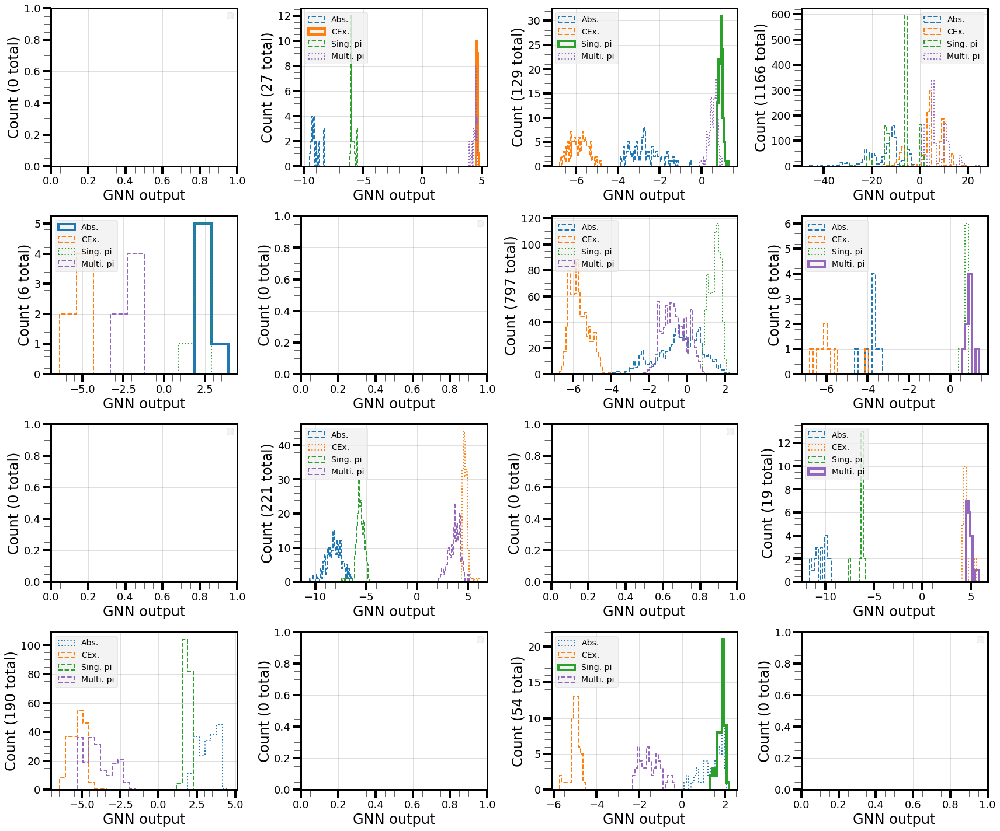

In [11]:
Models.per_region_dists(
    loaded_model,
    mc_path_params["schema_path"], mc_path_params["test_path"],
    plt_conf,
    classification_labels = ["Abs.", "CEx.", "Sing. pi", "Multi. pi"])

In [25]:
preds, truth = Models.get_predicitions(loaded_model, mc_path_params["schema_path"], mc_path_params["test_path"])
pred_ind = pred_index = np.where(preds == np.max(preds, axis=1)[:, np.newaxis])[1]

82/82 [==============================] - 0s 5ms/step


In [28]:
region_masks = np.full((4, 4, truth.size), False, dtype=bool)
for i in range(4):
    for j in range(4):
        region_masks[i, j] = np.logical_and(pred_ind==i, truth==j)

In [26]:
true_multi_reco_cex = test_evt_0 + np.arange(pred_ind.size)[np.logical_and(truth==3, pred_ind==1)]

In [7]:
calc_pi0s = EventSelection.count_all_pi0s(
    evts, beam_daughters=True)

In [8]:
ak.all(calc_pi0s == evts.trueParticles.nPi0)

True

In [7]:
loaded_model = tf.keras.models.load_model("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mc_truth_models/Model_mc_truth_07_pi0_nodes_0xMP/model.tf")

82/82 [==============================] - 1s 3ms/step


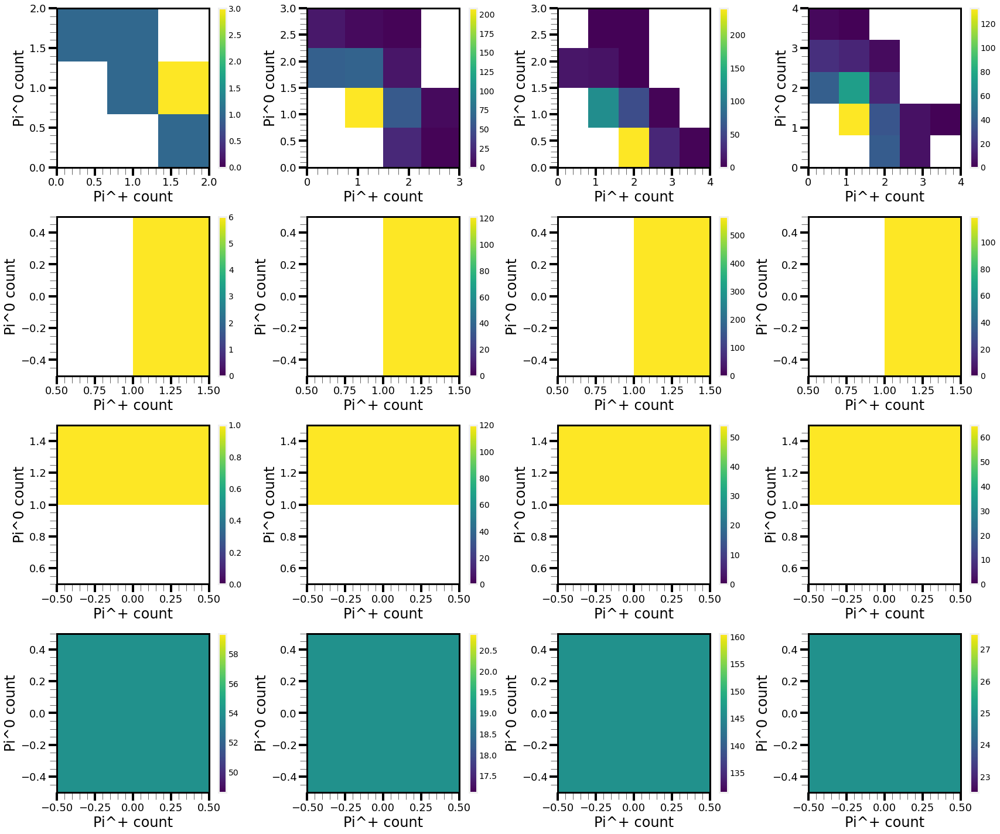

In [18]:
per_region_true_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf)

82/82 [==============================] - 0s 3ms/step


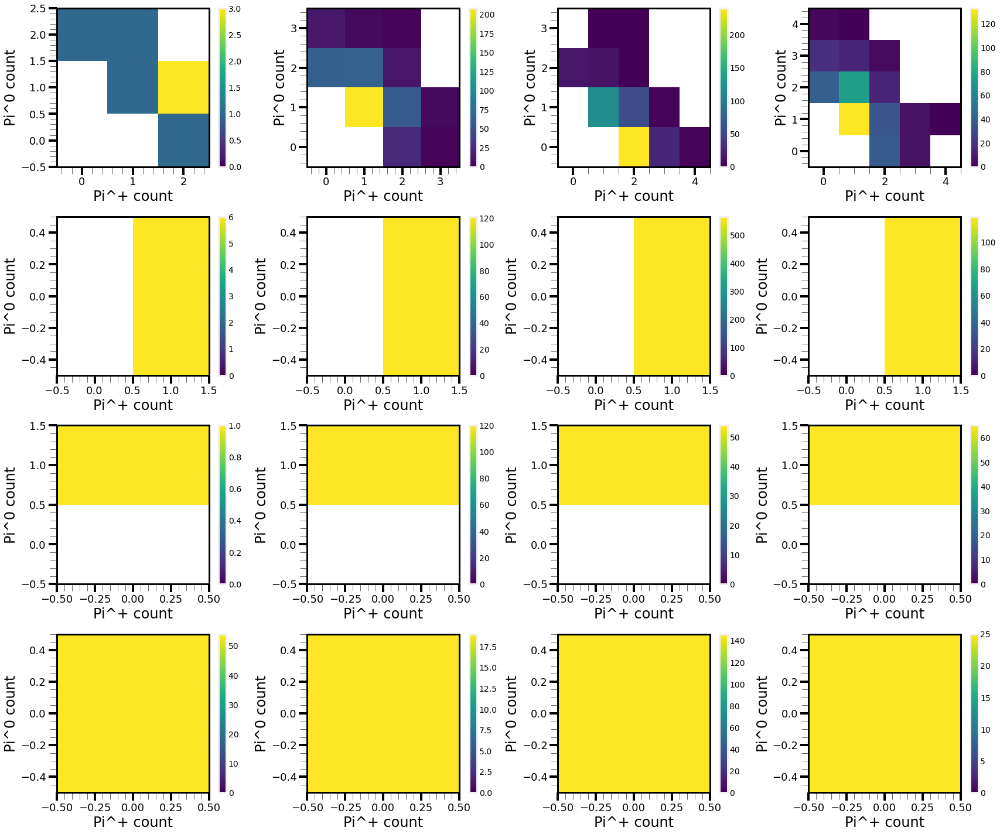

82/82 [==============================] - 0s 3ms/step


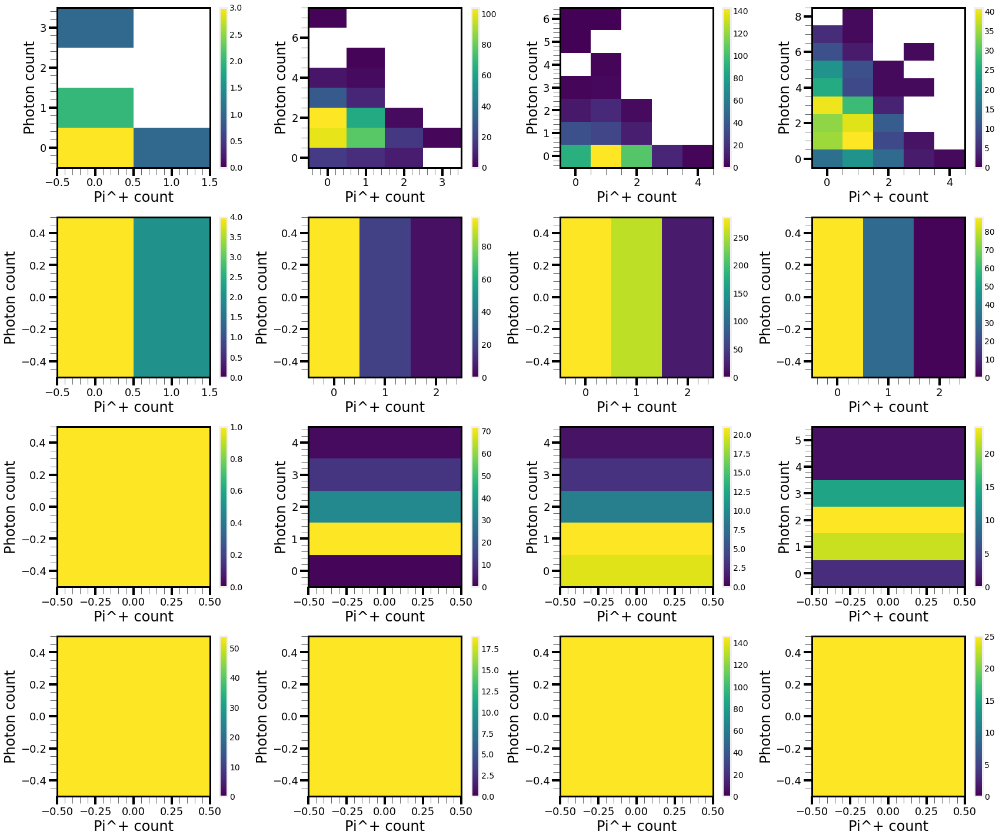

82/82 [==============================] - 0s 3ms/step


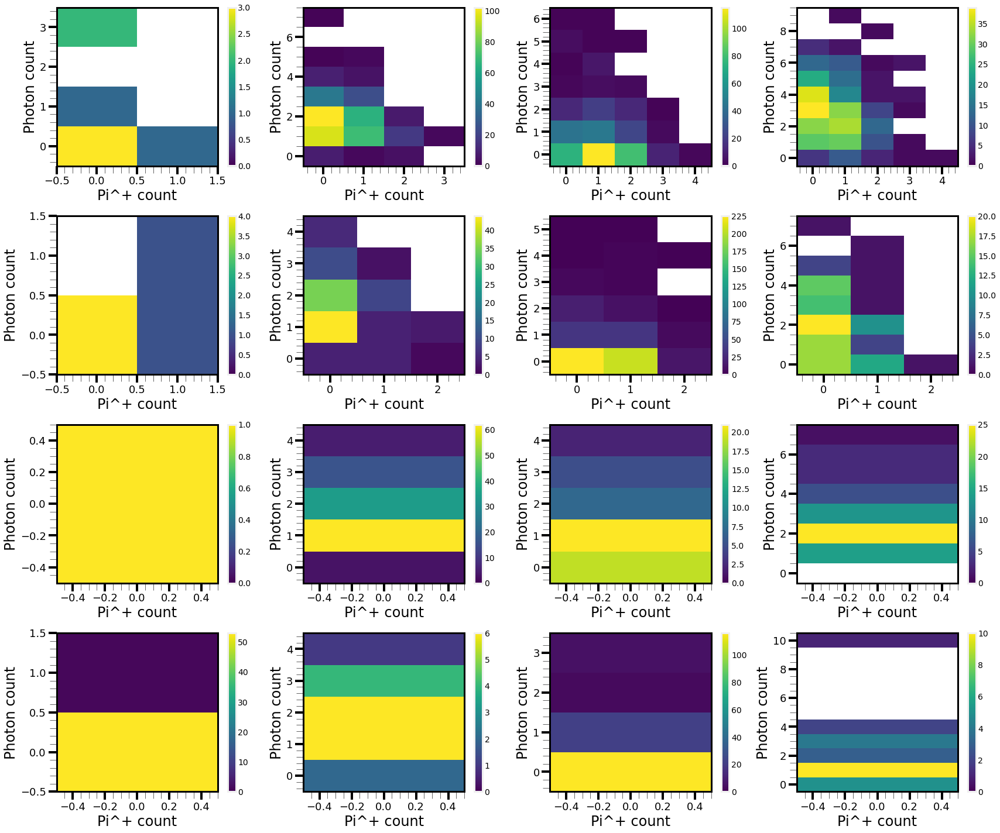

In [29]:
these_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_momentum_shower_only/")
loaded_model = tf.keras.models.load_model("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_models/Model_data_68_focal_alpha_MPx2_init_1x128_final_1x32/model.tf")
per_region_true_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf)
per_region_bt_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf)
per_region_bt_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf,
    all_photons=True)

82/82 [==============================] - 1s 5ms/step


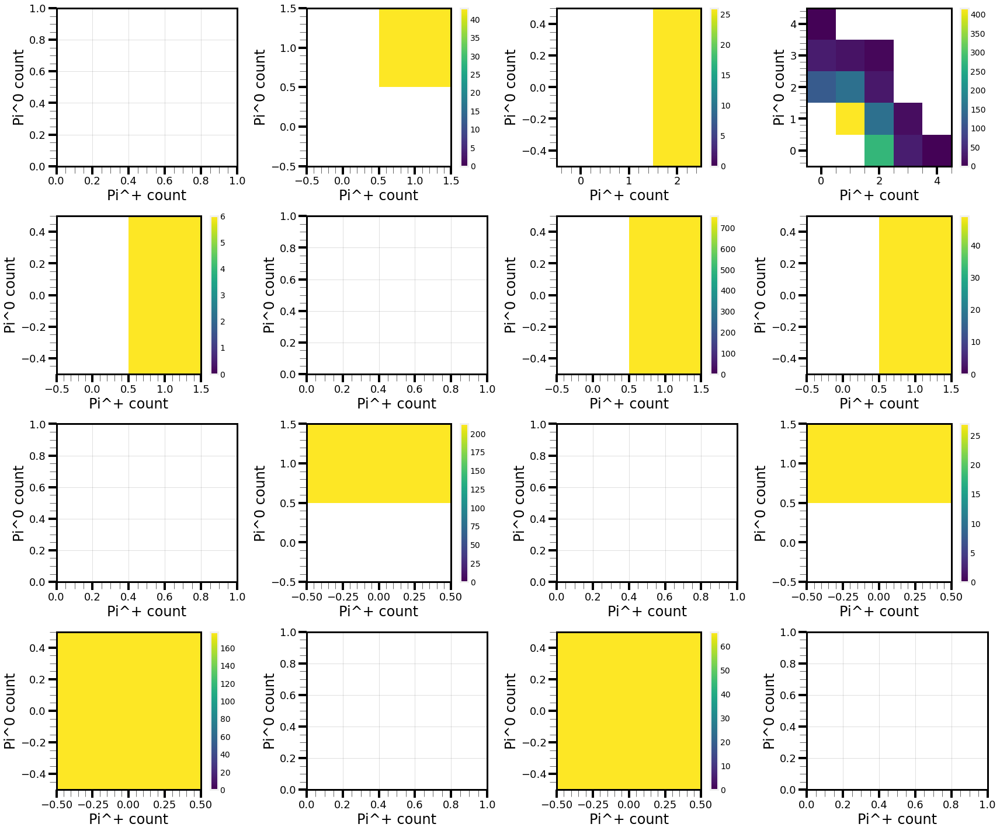

82/82 [==============================] - 1s 5ms/step


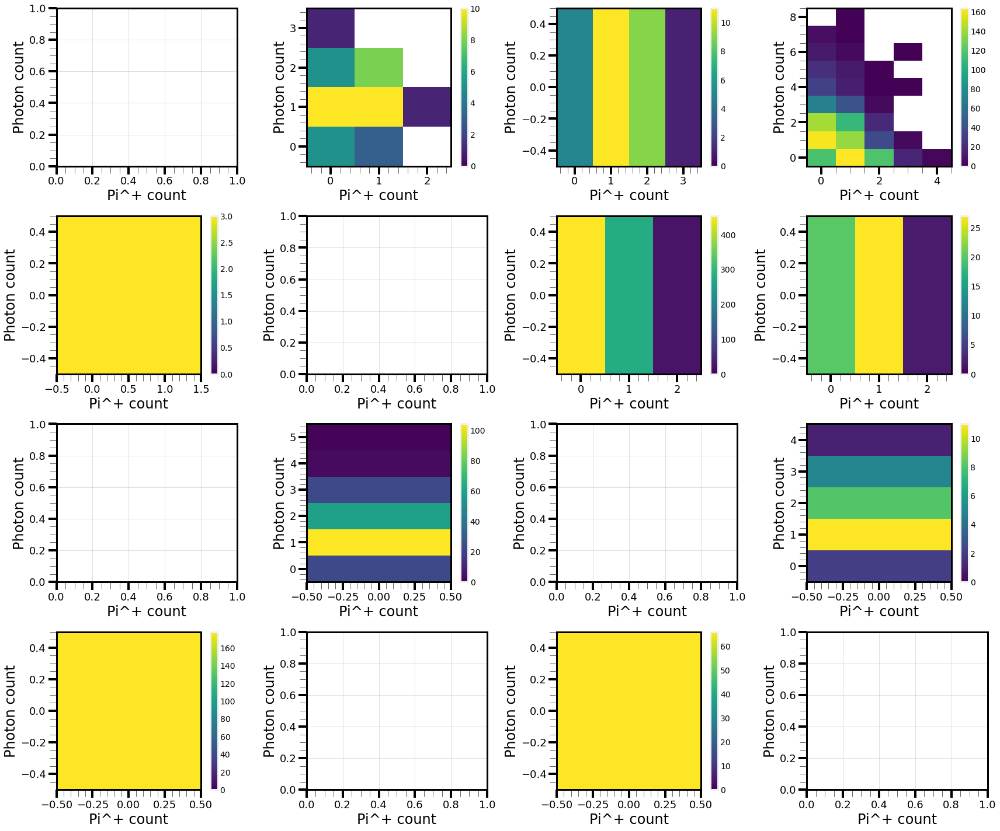

82/82 [==============================] - 1s 5ms/step


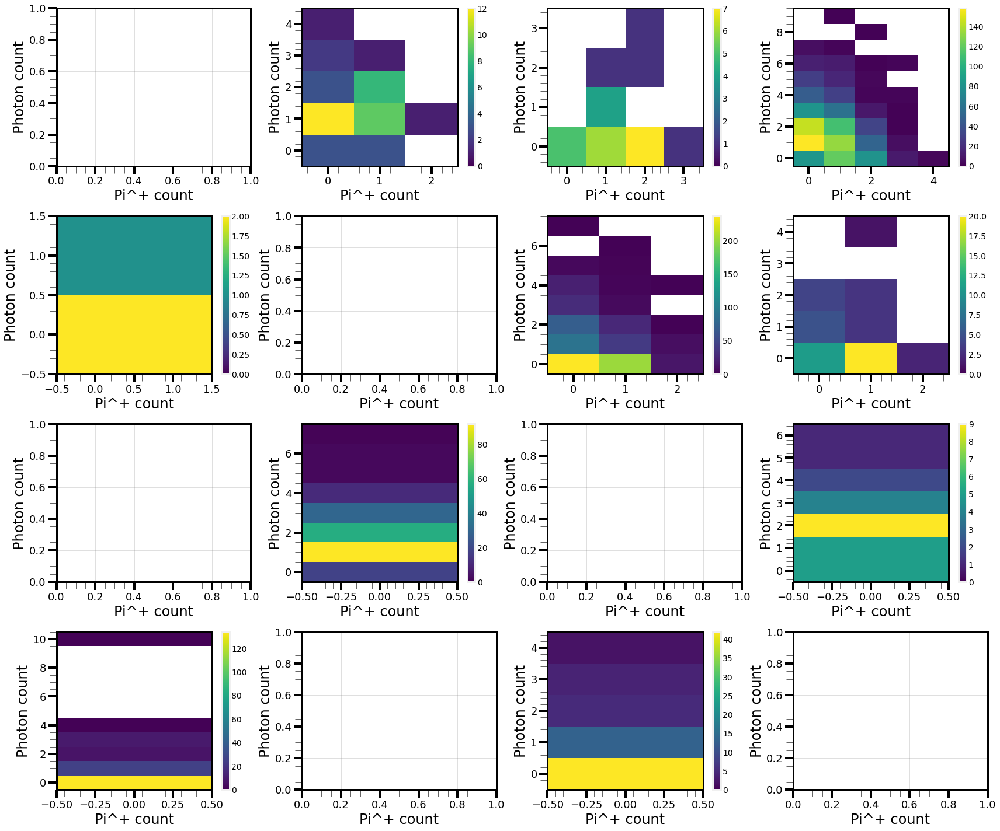

In [30]:
these_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_mc_truth_momenta/")
loaded_model = tf.keras.models.load_model("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mc_truth_models/Model_mc_truth_03/model.tf")
per_region_true_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf)
per_region_bt_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf)
per_region_bt_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf,
    all_photons=True)

82/82 [==============================] - 0s 2ms/step


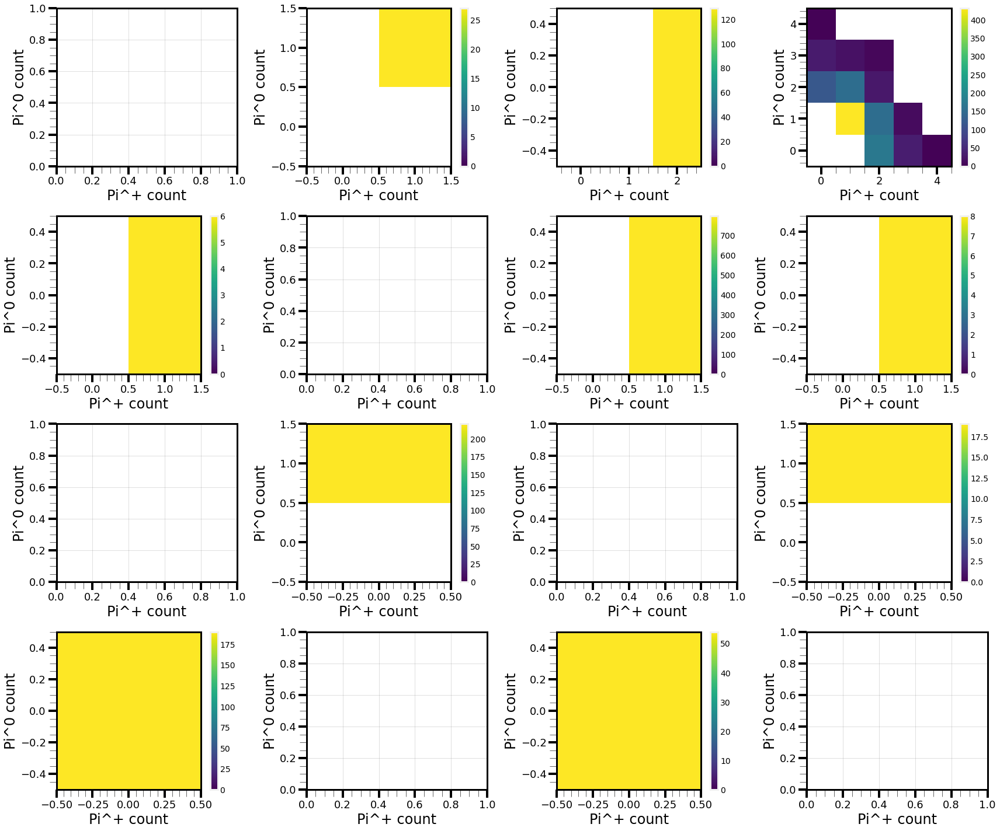

82/82 [==============================] - 0s 3ms/step


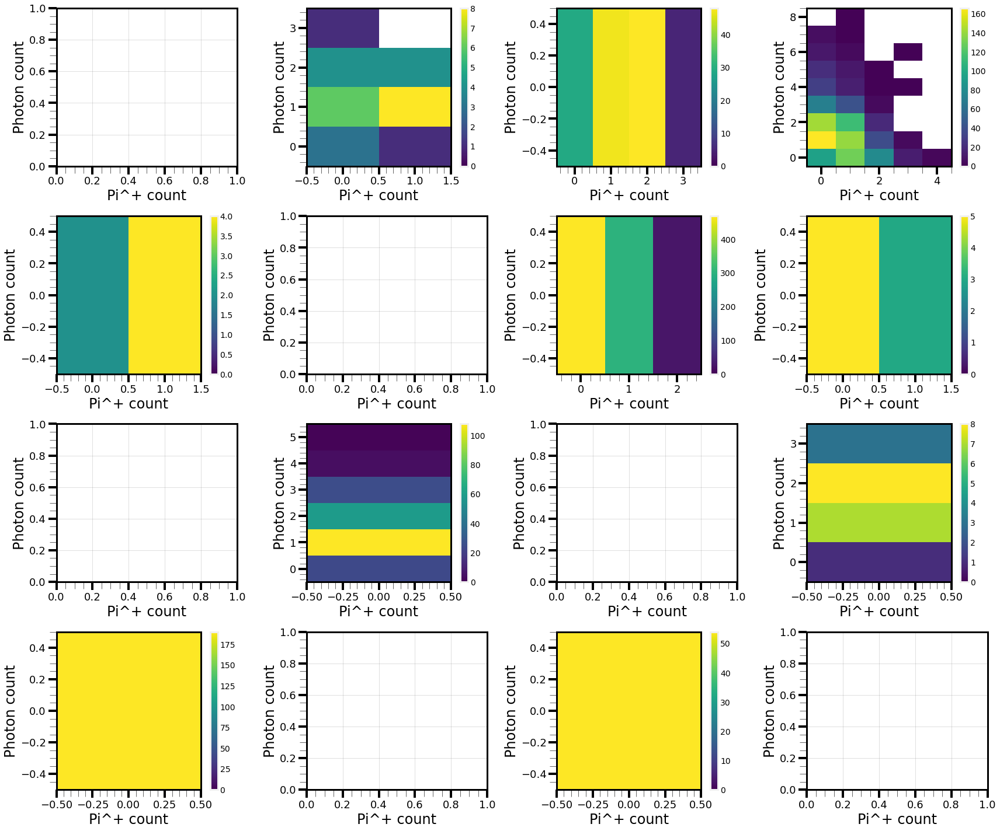

82/82 [==============================] - 0s 2ms/step


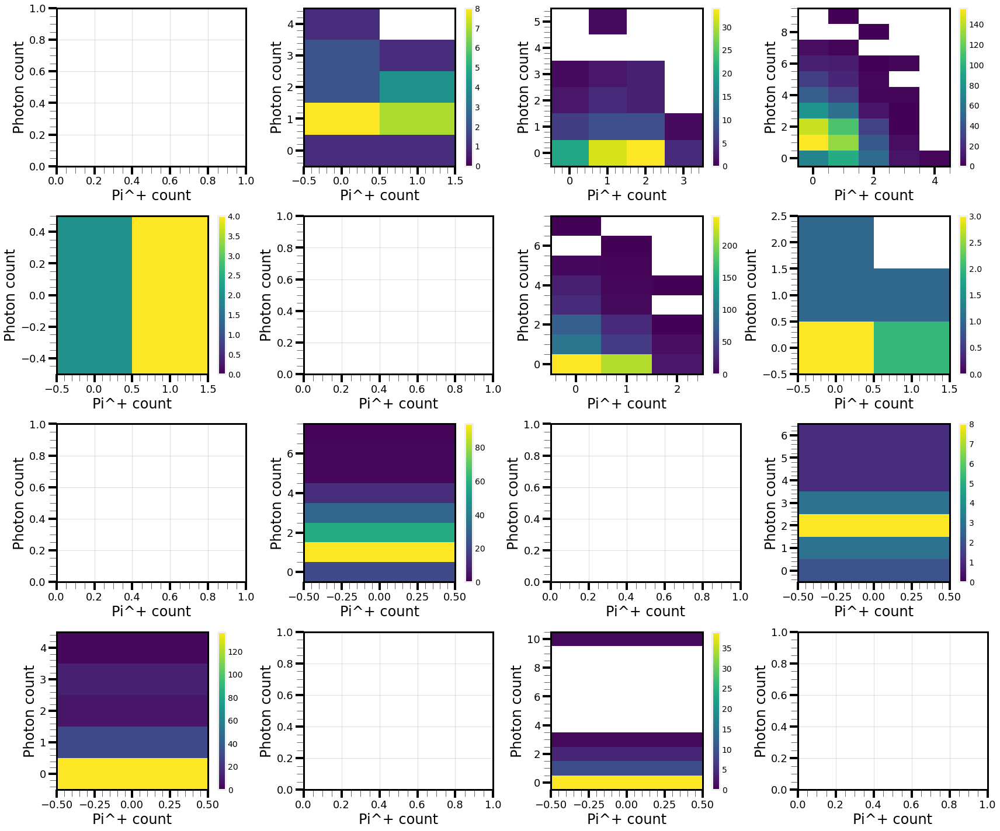

In [31]:
these_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_mc_truth_momenta+pi0_nodes/")
loaded_model = tf.keras.models.load_model("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mc_truth_models/Model_mc_truth_07_pi0_nodes_0xMP/model.tf")
per_region_true_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf)
per_region_bt_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf)
per_region_bt_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf,
    all_photons=True)

82/82 [==============================] - 1s 3ms/step


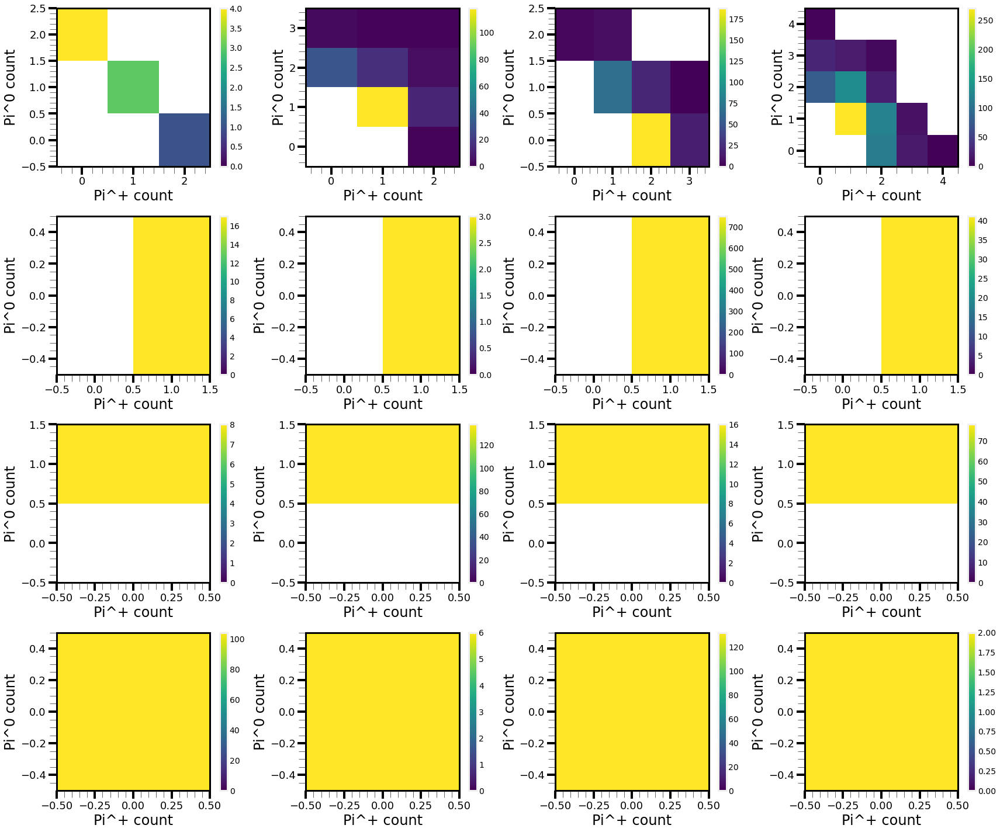

82/82 [==============================] - 0s 3ms/step


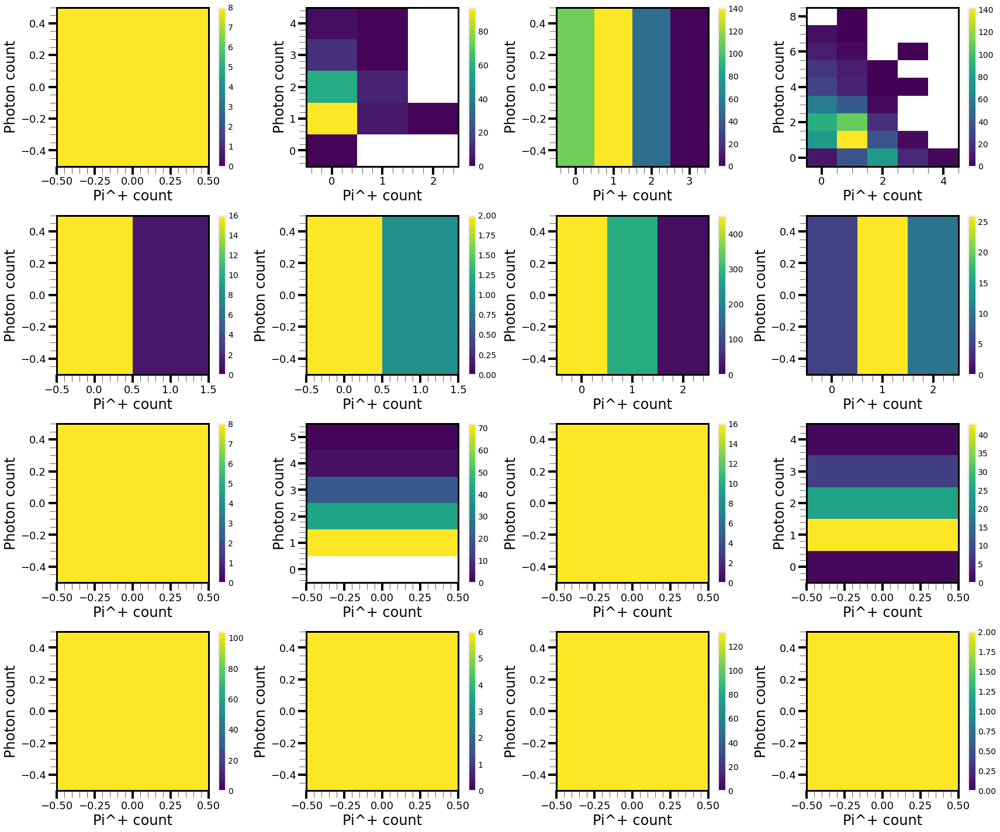

82/82 [==============================] - 0s 2ms/step


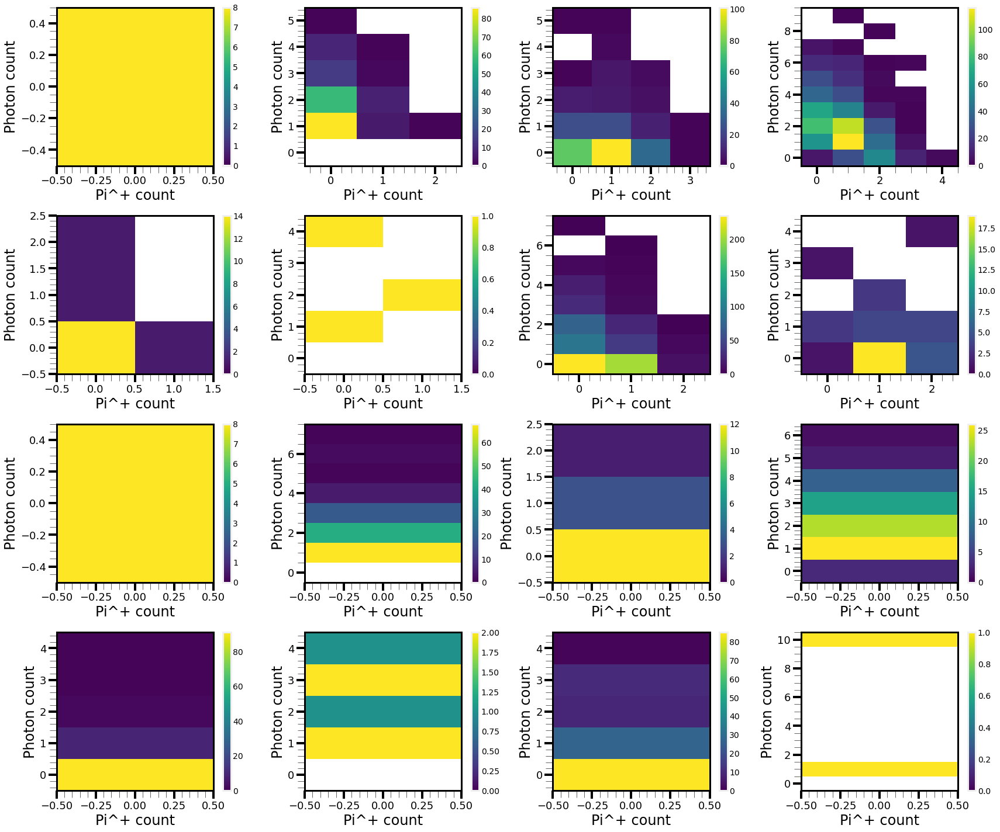

In [56]:
these_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_truth_momenta/")
loaded_model = tf.keras.models.load_model("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/truth_models/Model_truth_65_latest_data_model_class_weighted/model.tf")
per_region_true_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf)
per_region_bt_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf)
per_region_bt_counts(
    evts,
    0.1,
    loaded_model,
    these_path_params["schema_path"], these_path_params["test_path"],
    plt_conf,
    all_photons=True)

In [35]:
ind = 200
print(evts.trueParticles.number[ind])
print(evts.trueParticles.pdg[ind])
print(evts.trueParticlesBT.mother[ind])
print(true_pi0_daughters[ind])
print(list(map(lambda id: id in list(true_pi0_daughters[ind]), evts.trueParticlesBT.mother[ind])))

[1, 561287, 561288, 561289, 561290, ... 561295, 561296, 561297, 561408, 561409]
[211, 111, 2212, 2112, 2112, 2212, 22, ... 2112, 22, 1000010020, 1000160320, 22, 22]
[561287, 0, 1]
[561287]
[True, False, False]


In [12]:
def count_bt_photons(events, beam_daughters=True):
    """
    Returns the number of truth pi0 particles which decay to yy in each
    event in `events`.

    pi0 -> yy

    Parameters
    ----------
    events : Data
        Events in which to count pi0 occurances.
    beam_daughters : boolean, optional
        Whether to only accept a pi0 if it is a daughter of the beam
        particle. Default is True.

    Returns
    -------
    counts : ak.Array
        Array containing the number of occurances of pi0 -> yy for each
        event.
    """
    true_pi0_daughters = evts.trueParticles.number[np.logical_and(evts.trueParticles.mother == 1, evts.trueParticles.pdg == 111)]
    results = []
    for i in range(ak.num(evts.trueParticlesBT.mother, axis=0)):
        results.append(list(map(lambda id: id in list(true_pi0_daughters[i]), evts.trueParticlesBT.mother[i])))
    results = ak.Array(results)
    return ak.sum(results, axis=-1)

def count_bt_pi0s(events, beam_daughters=True):
    """
    Returns the number of truth pi0 particles which decay to yy in each
    event in `events`.

    pi0 -> yy

    Parameters
    ----------
    events : Data
        Events in which to count pi0 occurances.
    beam_daughters : boolean, optional
        Whether to only accept a pi0 if it is a daughter of the beam
        particle. Default is True.

    Returns
    -------
    counts : ak.Array
        Array containing the number of occurances of pi0 -> yy for each
        event.
    """
    if beam_daughters:
        beam_daughter_filter = events.trueParticlesBT.mother == 1
    else:
        beam_daughter_filter = True
    beam_cadidate_pi0s = ak.values_astype(np.logical_and(
        beam_daughter_filter,
        events.trueParticlesBT.pdg == 111), int)
    return ak.sum(beam_cadidate_pi0s, axis=-1)


def count_bt_charged_pi(events, beam_daughters=True):
    """
    Returns the number of truth pi+ particles event in `events`.

    Parameters
    ----------
    events : Data
        Events in which to count pi+ occurances.
    beam_daughters : boolean, optional
        Whether to only accept a pi+ if it is a daughter of the beam
        particle. Default is True.

    Returns
    -------
    counts : ak.Array
        Array containing the number of pi+ particles for each event.
    """
    if beam_daughters:
        daughter_truth = events.trueParticlesBT.mother == 1
    else:
        daughter_truth = ak.ones_like(events.trueParticlesBT.mother, dtype=bool)
    non_beam_pi_mask = np.logical_and(
        daughter_truth,
        np.logical_and(events.trueParticlesBT.pdg == 211,
                       events.trueParticlesBT.number != 1))
    return ak.sum(non_beam_pi_mask, axis=-1)

(array([1.8873e+04, 3.9100e+03, 1.9350e+03, 8.0900e+02, 3.3700e+02,
        1.3000e+02, 5.8000e+01, 1.4000e+01, 6.0000e+00, 0.0000e+00,
        1.0000e+00, 1.0000e+00]),
 array([-0.5,  0.5,  1.5,  2.5,  3.5,  4.5,  5.5,  6.5,  7.5,  8.5,  9.5,
        10.5, 11.5]),
 <BarContainer object of 12 artists>)

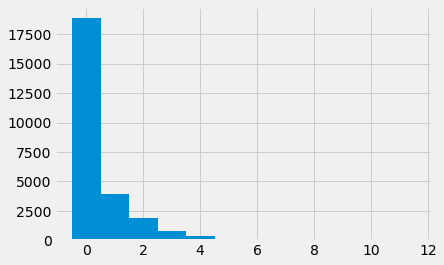

In [59]:
all_photon_counts = ak.sum(evts.trueParticlesBT.pdg == 22, axis=-1)

beam_photon_counts = count_bt_photons(
    evts, beam_daughters=True)

plt.hist(all_photon_counts - beam_photon_counts, bins = np.arange(np.max(all_photon_counts - beam_photon_counts) + 2) - 0.5)

In [28]:
def plot_res_dist(axis, selected_index, predictions, plot_config, labels, expand_bins=True):
    if predictions.size == 0:
        return
    bins = plot_config.get_bins(predictions[:, selected_index], array=True)
    selected_kwargs = {"lw":4}
    other_kwargs = {"ls":"--"}
    for i in range(predictions.shape[-1]):
        data = predictions[:, i]
        if expand_bins:
            this_bins = plot_config.expand_bins(bins, data)
        else:
            this_bins = bins
        if i == selected_index:
            kwargs = plot_config.gen_kwargs(
                type="hist", index=i, label=labels[i],
                bins=this_bins,
                **selected_kwargs)
        else:
            kwargs = plot_config.gen_kwargs(
                type="hist", index=i, label=labels[i],
                bins=this_bins,
                **other_kwargs)
        axis.hist(data, **kwargs)
    return

def plot_particle_counts(axis, pi_plus_counts, pi_0_counts, plot_config):
    if len(pi_plus_counts) == 0:
        # If this is true there is no data i the region, so don't plot
        return
    bins_plus = np.arange(2+np.max(pi_plus_counts)) - 0.5
    bins_0 = np.arange(2+np.max(pi_0_counts)) - 0.5
    viridis = mpl.colormaps['viridis'].resampled(256)
    new_colours = viridis(np.linspace(0, 1, 256))
    new_colours[0, :] = np.array([1., 1., 1., 1.]) # white
    new_cmap = plt_colours.ListedColormap(new_colours)
    _, _, _, im = axis.hist2d(pi_plus_counts, pi_0_counts, vmin=0, cmap=new_cmap, bins = (bins_plus, bins_0))#np.array([bins_plus, bins_0]), cmap=new_cmap)
    plt.colorbar(im, ax=axis)
    return

def per_region_bt_counts(
        events,
        test_frac,
        model,
        schema_path,
        test_path,
        plot_config,
        classification_labels=None,
        all_photons=False):
    n_total = ak.num(events.trueParticles.number, axis=0)
    test_evt_0 = int(n_total * (1. - test_frac))
    if all_photons:
        true_photon_counts = ak.sum(events.trueParticlesBT.pdg == 22, axis=-1)[test_evt_0:]
    else:
        true_photon_counts = count_bt_photons(
            events, beam_daughters=True)[test_evt_0:]
    true_pi_plus_counts = count_bt_charged_pi(
        events, beam_daughters=True)[test_evt_0:]
    # all_true_pi0_counts = EventSelection.count_all_pi0s(
    #     events, beam_daughters=False)[test_evt_0:]
    # all_true_pi_plus_counts = EventSelection.count_non_beam_charged_pi(
    #     events, beam_daughters=False)[test_evt_0:]
    # non_beam_pi0_counts = all_true_pi0_counts - true_pi0_counts
    # non_beam_pi_plus_counts = all_true_pi_plus_counts - true_pi_plus_counts

    predictions, truth_index = Models.get_predicitions(
        model, schema_path, test_path)
    pred_index = np.where(
        predictions == np.max(predictions, axis=1)[:, np.newaxis])[1]
    labels = Models._parse_classification_labels(classification_labels,
                                          pred_index, truth_index)
    n_regions = predictions.shape[-1]
    region_masks = Models._get_region_masks(pred_index, truth_index, n_regions)
    _, axes = plot_config.setup_figure(n_regions, n_regions, figsize=(24, 20))
    for reco_i in range(n_regions):
        for true_i in range(n_regions):
            ax = axes[3-true_i, reco_i]
            these_pi_plus = true_pi_plus_counts[region_masks[reco_i, true_i]]
            these_pi0s = true_photon_counts[region_masks[reco_i, true_i]]
            plot_particle_counts(
                ax,
                these_pi_plus, these_pi0s,
                plot_config)
            plot_config.format_axis(
                ax, xlabel="Pi^+ count",
                ylabel=f"Photon count")
    return plot_config.end_plot()

def per_region_true_counts(
        events,
        test_frac,
        model,
        schema_path,
        test_path,
        plot_config,
        classification_labels=None,
        backtracked=False):
    n_total = ak.num(events.trueParticles.number, axis=0)
    test_evt_0 = int(n_total * (1. - test_frac))
    true_pi0_counts = EventSelection.count_all_pi0s(
        events, beam_daughters=True)[test_evt_0:]
    true_pi_plus_counts = EventSelection.count_non_beam_charged_pi(
        events, beam_daughters=True)[test_evt_0:]
    # all_true_pi0_counts = EventSelection.count_all_pi0s(
    #     events, beam_daughters=False)[test_evt_0:]
    # all_true_pi_plus_counts = EventSelection.count_non_beam_charged_pi(
    #     events, beam_daughters=False)[test_evt_0:]
    # non_beam_pi0_counts = all_true_pi0_counts - true_pi0_counts
    # non_beam_pi_plus_counts = all_true_pi_plus_counts - true_pi_plus_counts

    predictions, truth_index = Models.get_predicitions(
        model, schema_path, test_path)
    pred_index = np.where(
        predictions == np.max(predictions, axis=1)[:, np.newaxis])[1]
    labels = Models._parse_classification_labels(classification_labels,
                                          pred_index, truth_index)
    n_regions = predictions.shape[-1]
    region_masks = Models._get_region_masks(pred_index, truth_index, n_regions)
    _, axes = plot_config.setup_figure(n_regions, n_regions, figsize=(24, 20))
    for reco_i in range(n_regions):
        for true_i in range(n_regions):
            ax = axes[3-true_i, reco_i]
            these_pi_plus = true_pi_plus_counts[region_masks[reco_i, true_i]]
            these_pi0s = true_pi0_counts[region_masks[reco_i, true_i]]
            plot_particle_counts(
                ax,
                these_pi_plus, these_pi0s,
                plot_config)
            plot_config.format_axis(
                ax, xlabel="Pi^+ count",
                ylabel=f"Pi^0 count")
    return plot_config.end_plot()

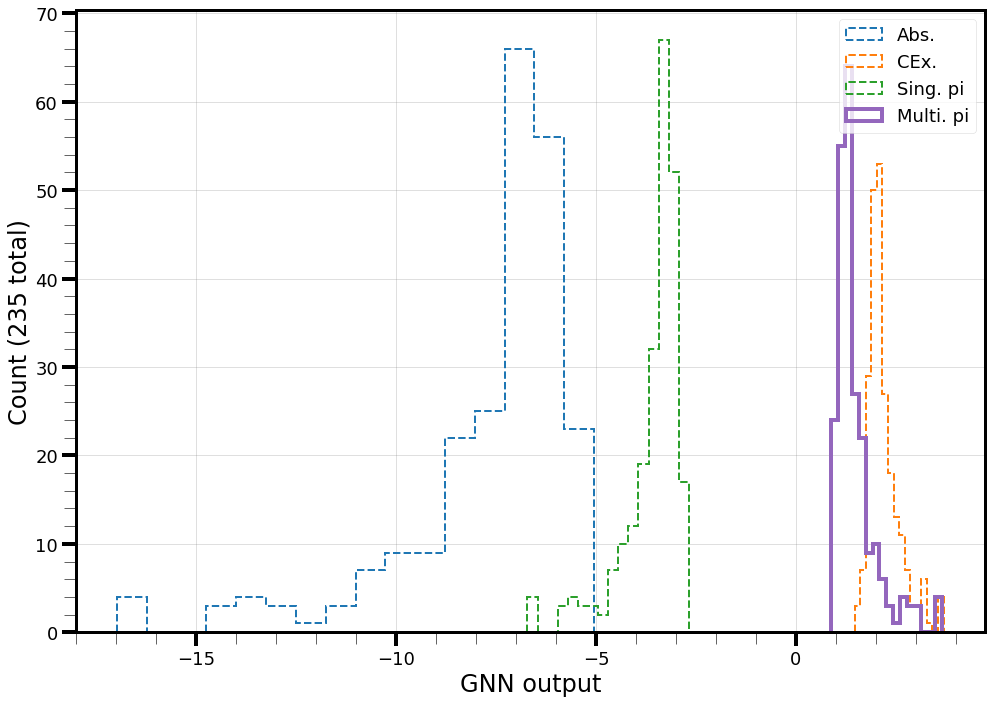

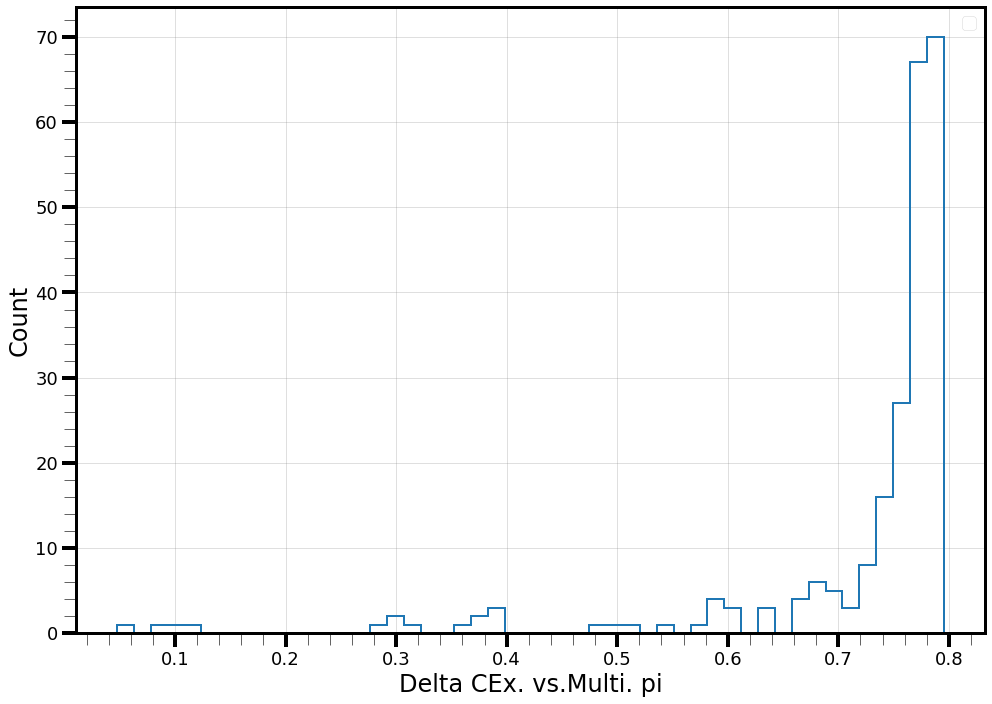

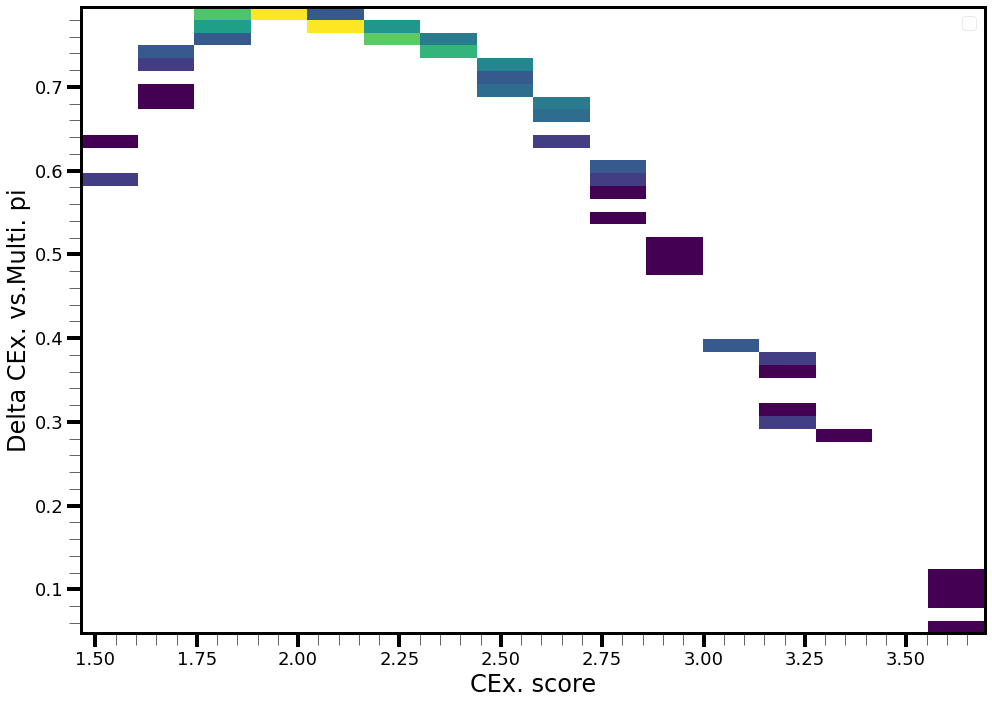

In [72]:
plt_conf.setup_figure()
labs = ["Abs.", "CEx.", "Sing. pi", "Multi. pi"]
good_ind = 1
compare_ind = 3
# these_preds = preds[region_masks[3, 3]]
# bins = np.linspace(-100, 100, 50)
these_preds = preds[region_masks[good_ind, good_ind]]
bins = plt_conf.get_bins(these_preds[:, good_ind])
selected_kwargs = {"lw":4}
other_kwargs = {"ls":"--"}
for i in range(these_preds.shape[-1]):
    data = these_preds[:, i]
    if i == 3:
        kwargs = plt_conf.gen_kwargs(
            type="hist", index=i, label=labs[i],
            bins=bins,
            **selected_kwargs)
    else:
        kwargs = plt_conf.gen_kwargs(
            type="hist", index=i, label=labs[i],
            bins=bins,
            **other_kwargs)
    plt.hist(data, **kwargs)
plt_conf.format_axis( xlabel="GNN output", ylabel=f"Count ({region_masks[good_ind, good_ind].sum()} total)")
plt_conf.end_plot()

plt_conf.setup_figure()
diff_data = these_preds[:, good_ind] - these_preds[:, compare_ind]
plt.hist(diff_data, **plt_conf.gen_kwargs(
    type="hist", index=0,
    bins=plt_conf.get_bins(diff_data)))
plt_conf.format_axis( xlabel=f"Delta {labs[good_ind]} vs.{labs[compare_ind]}", ylabel="Count")
plt_conf.end_plot()

plt_conf.setup_figure()
diff_data = these_preds[:, good_ind] - these_preds[:, compare_ind]
plt.hist2d(these_preds[:, good_ind], diff_data, bins=(plt_conf.get_bins(these_preds[:, good_ind]), plt_conf.get_bins(diff_data)), norm=plt_colours.LogNorm())
plt_conf.format_axis( xlabel=f"{labs[good_ind]} score", ylabel=f"Delta {labs[good_ind]} vs.{labs[compare_ind]}")
plt_conf.end_plot()

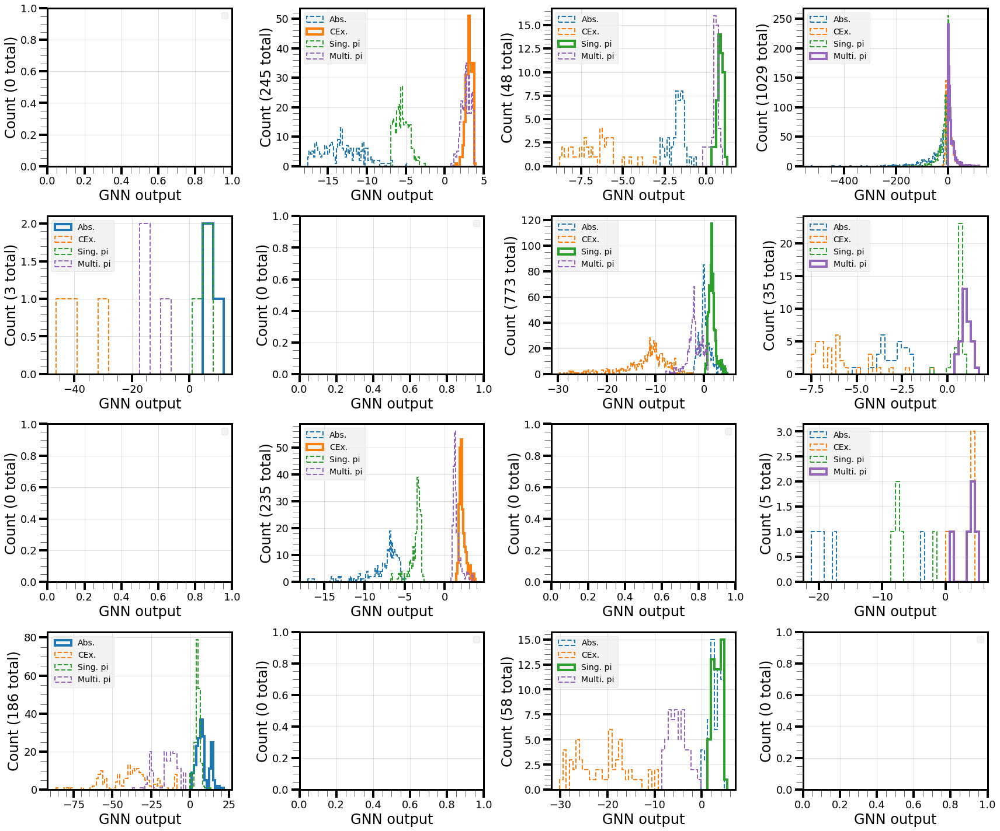

In [57]:
fig, axes = plt_conf.setup_figure(4, 4, figsize=(24, 20))
for reco_i in range(4):
    for true_i in range(4):
        ax = axes[3-true_i, reco_i]
        these_preds = preds[region_masks[reco_i, true_i]]
        plot_res_dist(ax, reco_i, these_preds, plt_conf, ["Abs.", "CEx.", "Sing. pi", "Multi. pi"])
        plt_conf.format_axis(ax, xlabel="GNN output", ylabel=f"Count ({region_masks[reco_i, true_i].sum()} total)")
        ax.legend()
plt_conf.end_plot()

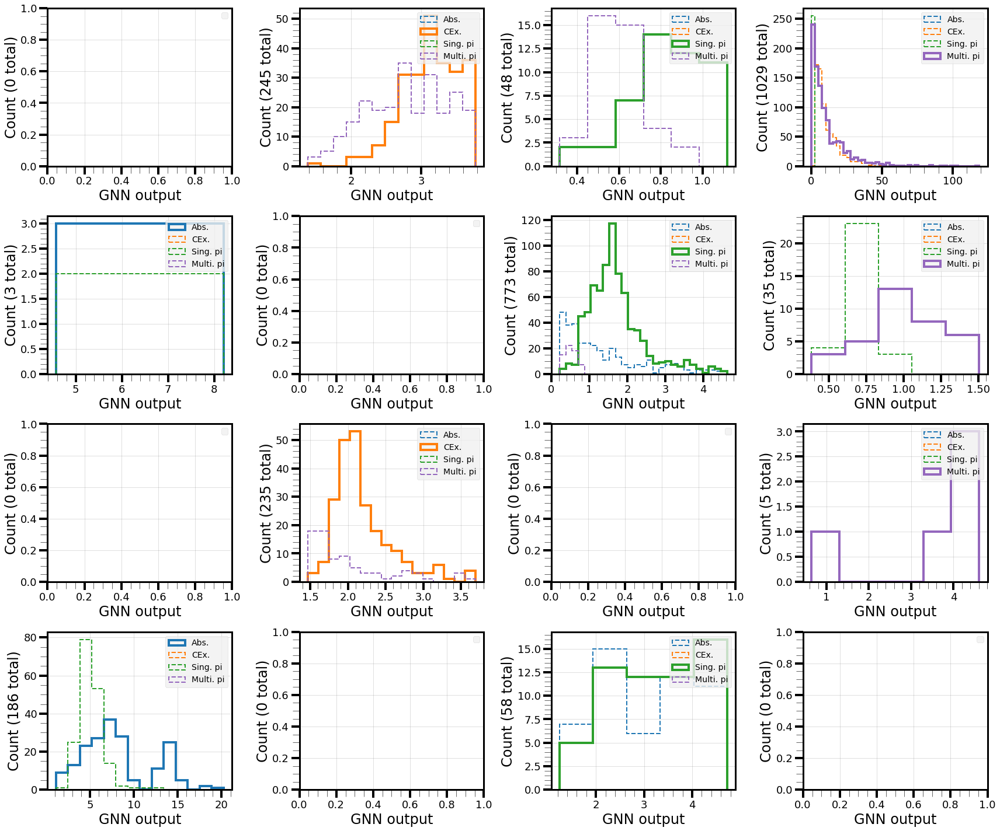

In [58]:
fig, axes = plt_conf.setup_figure(4, 4, figsize=(24, 20))
for reco_i in range(4):
    for true_i in range(4):
        ax = axes[3-true_i, reco_i]
        these_preds = preds[region_masks[reco_i, true_i]]
        plot_res_dist(ax, reco_i, these_preds, plt_conf, ["Abs.", "CEx.", "Sing. pi", "Multi. pi"], expand_bins=False)
        plt_conf.format_axis(ax, xlabel="GNN output", ylabel=f"Count ({region_masks[reco_i, true_i].sum()} total)")
        ax.legend()
plt_conf.end_plot()

In [21]:
def _mc_true_shared_mother(evts, pairs):
    return 1. * (evts.trueParticles.mother[pairs["0"]]
                 == evts.trueParticles.mother[pairs["1"]])
def _mc_true_shared_mother_not_beam(evts, pairs):
    return 1. * np.logical_and(
        evts.trueParticles.mother[pairs["0"]] == evts.trueParticles.mother[pairs["1"]],
        np.logical_and(evts.trueParticles.mother[pairs["0"]] != 1,
                       evts.trueParticles.mother[pairs["0"]] != 0))
def _mc_true_closest_approach(evts, pairs):
    return Master.ShowerPairs.ClosestApproach(
        evts.trueParticles.direction[pairs["1"]],
        evts.trueParticles.direction[pairs["0"]],
        evts.trueParticles.shower_start_pos[pairs["1"]],
        evts.trueParticles.shower_start_pos[pairs["0"]])
def _mc_true_pfo_sep(evts, pairs):
    return vector.dist(evts.trueParticles.shower_start_pos[pairs["1"]],
                       evts.trueParticles.shower_start_pos[pairs["0"]])
mc_truth_geometric_definitions = {
    "shared_mother": _mc_true_shared_mother_not_beam,
    "closest_approach": _mc_true_closest_approach,
    "separation": _mc_true_pfo_sep}

def _get_beam_vertex_from_true(evts):
    return evts.trueParticles.endPos[:,0]
def _beam_connection(evts):
    return 1. * (evts.trueParticles.mother == 1)
def _true_true_beam_impact(evts):
    return PFOSelection.get_impact_parameter(
        evts.trueParticles.direction,
        evts.trueParticles.shower_start_pos,
        _get_beam_vertex_from_true(evts))
def _true_true_beam_separation(evts):
    return vector.dist(evts.trueParticles.shower_start_pos,
                       _get_beam_vertex_from_true(evts))
mc_truth_beam_definitions = {
    "beam_daughter" : _beam_connection,
    "impact_true": _true_true_beam_impact,
    "separation_true": _true_true_beam_separation}

In [22]:
classifications = ["absorption", "charge_exchange", "single_pion_production", "multi_pion_production"]

mc_truth_dict = DataPreparation.gen_truth_definitions(
    [(211, -211), 22,       2212,     (11, -11),  (13, -13)],#, 111  ],
    ["pion",      "photon", "proton", "electron", "muon"   ],#, "pi0"],
    mc_true=True)

mc_truth_classes = list(mc_truth_dict.keys())
mc_truth_classes.remove("beam_truth")

mc_geom_props = ["shared_mother", "closest_approach", "separation"]

mc_momenta_props = ["mc_true_x", "mc_true_y", "mc_true_z"]

mc_beam_props = ["beam_daughter", "impact_true", "separation_true"]

mc_pairs = DataPreparation.generate_directed_pair_indicies(evts, mc_true=True)

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_mc_truth_info_no_pi0_unnormed_label_no_beam_mother/"

mc_truth_params = DataPreparation.create_parameter_dictionary(
    folder_path,
    evts,
    classifications, mc_truth_classes, mc_geom_props, beam_connections=mc_beam_props,
    directed_pairs=mc_pairs,
    kinematic_definitions=mc_truth_dict, norm_kinematics=False,
    momenta=mc_momenta_props, norm_momenta=True,
    geometric_definitions=mc_truth_geometric_definitions,
    beam_definitions=mc_truth_beam_definitions,
    truth_info=True,
    data_type="mc")

In [26]:
DataPreparation.generate_training_data(mc_truth_params)

('/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_mc_truth_info_no_pi0_unnormed_label_no_beam_mother/schema.pbtxt',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_mc_truth_info_no_pi0_unnormed_label_no_beam_mother/train_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_mc_truth_info_no_pi0_unnormed_label_no_beam_mother/val_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_mc_truth_info_no_pi0_unnormed_label_no_beam_mother/test_data.tfrecords')

In [17]:
## Select which variables to use for this analysis

classifications = ["absorption", "charge_exchange", "single_pion_production", "multi_pion_production"]

kinematic_props = ["track", "dEdx_med", "chi2_pion_reduced", "chi2_muon_reduced", "chi2_proton_reduced", "track_len", "shower_energy"]

geom_props = ["separation_shower", "closest_approach_shower", "impact_parameter_shower"]
# geom_props = ["separation_track", "separation_shower", "closest_approach_track", "closest_approach_shower", "impact_parameter_track", "impact_parameter_shower"]

beam_props = ["impact", "separation"]

momenta_props = ["reco_x", "reco_y", "reco_z"]

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_momentum_shower_only/"

data_truth_params = DataPreparation.create_parameter_dictionary(
    folder_path,
    evts,
    classifications, kinematic_props, geom_props, beam_connections=beam_props,
    norm_kinematics=True, momenta=momenta_props, norm_momenta=True)

In [ ]:
classifications = ["absorption", "charge_exchange", "single_pion_production", "multi_pion_production"]

truth_dict = DataPreparation.gen_truth_definitions(
    [(211, -211), 22,       2212,     (11, -11),  (13, -13)],
    ["pion",      "photon", "proton", "electron", "muon"   ])

truth_classes = list(truth_dict.keys())
truth_classes.remove("beam_truth")

geom_props = ["separation_shower_shower", "closest_approach_shower_shower", "impact_parameter_shower"]

beam_props = ["impact", "separation"]

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_pfo_truth_edge_reco/"

bt_pfo_truth_params = DataPreparation.create_parameter_dictionary(
    folder_path,
    evts,
    classifications, truth_classes, geom_props, beam_connections=beam_props,
    kinematic_definitions=truth_dict, norm_kinematics=False,
    geometric_definitions=DataPreparation.default_geometric_definitions,
    beam_definitions=DataPreparation.default_beam_definitions,
    truth_info=True, data_type="bt")

In [104]:
DataPreparation.generate_training_data(bt_pfo_truth_params)

('/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_pfo_truth_edge_reco/schema.pbtxt',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_pfo_truth_edge_reco/train_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_pfo_truth_edge_reco/val_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_pfo_truth_edge_reco/test_data.tfrecords')

In [8]:
classifications = ["absorption", "charge_exchange", "single_pion_production", "multi_pion_production"]

truth_dict = DataPreparation.gen_truth_definitions(
    [(211, -211), 22,       2212,     (11, -11),  (13, -13)],
    ["pion",      "photon", "proton", "electron", "muon"   ])

truth_classes = list(truth_dict.keys())
truth_classes.remove("beam_truth")

geom_props = ["closest_approach", "separation"]

beam_props = ["impact_true", "separation_true"]

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_truth_no_shared_mother/"

bt_truth_params_no_shared_mother = DataPreparation.create_parameter_dictionary(
    folder_path,
    evts,
    classifications, truth_classes, geom_props, beam_connections=beam_props,
    kinematic_definitions=truth_dict, norm_kinematics=False,
    geometric_definitions=DataPreparation.truth_geometric_definitions,
    beam_definitions=DataPreparation.truth_beam_definitions,
    truth_info=True, data_type="bt")

In [9]:
DataPreparation.generate_training_data(bt_truth_params_no_shared_mother)

('/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_truth_no_shared_mother/schema.pbtxt',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_truth_no_shared_mother/train_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_truth_no_shared_mother/val_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_truth_no_shared_mother/test_data.tfrecords')

In [6]:
classifications = ["absorption", "charge_exchange", "single_pion_production", "multi_pion_production"]

kinematic_props = ["track", "dEdx_med", "n_hits", "chi2_pion_reduced", "chi2_muon_reduced", "chi2_proton_reduced", "track_len", "track_len_alt"]

geom_props = ["closest_approach", "separation"]

beam_props = ["impact_true", "separation_true"]

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_edge_truth_pfo_reco_no_shared_mother/"

bt_edge_truth_params = DataPreparation.create_parameter_dictionary(
    folder_path,
    evts,
    classifications, kinematic_props, geom_props, beam_connections=beam_props,
    kinematic_definitions=DataPreparation.default_kinematic_definitions, norm_kinematics=True,
    geometric_definitions=DataPreparation.truth_geometric_definitions,
    beam_definitions=DataPreparation.truth_beam_definitions,
    truth_info=True, data_type="bt")

In [7]:
DataPreparation.generate_training_data(bt_edge_truth_params)

('/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_edge_truth_pfo_reco_no_shared_mother/schema.pbtxt',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_edge_truth_pfo_reco_no_shared_mother/train_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_edge_truth_pfo_reco_no_shared_mother/val_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_edge_truth_pfo_reco_no_shared_mother/test_data.tfrecords')

In [29]:
loaded_bdt = bdt_classifier.loadBDT("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/bdt_pfo.dll")
bdt_classify_definitions = DataPreparation.default_kinematic_definitions
def get_bdt_output(index, bdt):
    def func(events):
        n_pfos = ak.count(evts.recoParticles.number, axis=1)
        predictions = bdt.predict_proba(events)[:, index]
        return ak.unflatten(predictions, n_pfos)
    return func
bdt_classify_definitions["bdt_pion"] = get_bdt_output(0, loaded_bdt)
bdt_classify_definitions["bdt_photon"] = get_bdt_output(1, loaded_bdt)
bdt_classify_definitions["bdt_proton"] = get_bdt_output(2, loaded_bdt)
bdt_classify_definitions["bdt_other"] = get_bdt_output(3, loaded_bdt)

In [30]:
classifications = ["absorption", "charge_exchange", "single_pion_production", "multi_pion_production"]

kinematic_props = ["bdt_pion", "bdt_photon", "bdt_proton", "bdt_other", "track", "n_hits"]

geom_props = ["separation_shower_shower", "closest_approach_shower_shower", "impact_parameter_shower"]

beam_props = ["impact", "separation"]

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_bdt_scores_norms/"

data_bdt_params = DataPreparation.create_parameter_dictionary(
    folder_path,
    evts,
    classifications, kinematic_props, geom_props, beam_connections=beam_props,
    kinematic_definitions=bdt_classify_definitions, norm_kinematics=True,
    geometric_definitions=DataPreparation.default_geometric_definitions,
    beam_definitions=DataPreparation.default_beam_definitions,
    truth_info=True, data_type="reco")

In [31]:
DataPreparation.generate_training_data(data_bdt_params)

('/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_bdt_scores_norms/schema.pbtxt',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_bdt_scores_norms/train_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_bdt_scores_norms/val_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_bdt_scores_norms/test_data.tfrecords')

In [8]:
classifications = ["absorption", "charge_exchange", "single_pion_production", "multi_pion_production"]

kinematic_props = ["track", "dEdx_med", "n_hits", "chi2_pion_reduced", "chi2_muon_reduced", "chi2_proton_reduced", "track_len", "track_len_alt"]

geom_props = ["separation_shower_shower", "closest_approach_shower_shower", "impact_parameter_shower"]

beam_props = ["impact", "separation"]

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_with_extra_losses/"

data_new_params = DataPreparation.create_parameter_dictionary(
    folder_path,
    evts,
    classifications, kinematic_props, geom_props, beam_connections=beam_props,
    kinematic_definitions=DataPreparation.default_kinematic_definitions, norm_kinematics=True,
    geometric_definitions=DataPreparation.default_geometric_definitions,
    beam_definitions=DataPreparation.default_beam_definitions,
    truth_info=True, data_type="reco")

In [9]:
DataPreparation.generate_training_data(data_new_params)

('/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_with_extra_losses/schema.pbtxt',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_with_extra_losses/train_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_with_extra_losses/val_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_with_extra_losses/test_data.tfrecords')

In [58]:
classifications = ["absorption", "charge_exchange", "single_pion_production", "multi_pion_production"]

truth_dict = DataPreparation.gen_truth_definitions(
    [(211, -211), 22,       2212,     (11, -11),  (13, -13)],
    ["pion",      "photon", "proton", "electron", "muon"   ])

truth_classes = list(truth_dict.keys())
truth_classes.remove("beam_truth")

geom_props = ["shared_mother_no_beam", "closest_approach", "separation"]

beam_props = ["beam_daughter", "impact_true", "separation_true"]

folder_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_pfo_truth_edge_reco/"

bt_truth_params = DataPreparation.create_parameter_dictionary(
    folder_path,
    evts,
    classifications, truth_classes, geom_props, beam_connections=beam_props,
    kinematic_definitions=truth_dict, norm_kinematics=False,
    geometric_definitions=DataPreparation.geometric_definitions,
    beam_definitions=DataPreparation.truth_beam_definitions,
    truth_info=True, data_type="bt")

In [7]:
DataPreparation.generate_training_data(mom_truth_params)

NameError: name 'mom_truth_params' is not defined

In [59]:
DataPreparation.generate_training_data(bt_truth_params)

('/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_truth_no_mom_no_beam_mother_reco_class/schema.pbtxt',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_truth_no_mom_no_beam_mother_reco_class/train_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_truth_no_mom_no_beam_mother_reco_class/val_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_truth_no_mom_no_beam_mother_reco_class/test_data.tfrecords')

In [28]:
def apply_not_beam(events, other_mask):
    # not_beam = events.trueParticlesBT.number != 1
    not_beam = events.recoParticles.number != events.recoParticles.beam_number
    return 1. * np.logical_and(not_beam, other_mask)

# def _truth_pion(events):
#     return apply_not_beam(
#         events,
#         np.logical_or(events.trueParticlesBT.pdg ==  211,
#                       events.trueParticlesBT.pdg == -211))
#     daughter_mask = np.logical_and(
#         events.trueParticlesBT.mother == 1,
#         events.trueParticlesBT.number != 1)
#     return np.logical_and(
#         daughter_mask,
#         np.logical_or(events.trueParticlesBT.pdg ==  211,
#                       events.trueParticlesBT.pdg == -211))

# def _truth_photon(events):
#     return apply_not_beam(
#         events, events.trueParticlesBT.pdg == 22)
#     daughter_mask = np.logical_and(
#         events.trueParticlesBT.mother == 1,
#         events.trueParticlesBT.number != 1)
#     return np.logical_and(
#         daughter_mask,
#         events.trueParticlesBT.pdg == 22)

# def _truth_proton(events):
#     return apply_not_beam(
#         events, events.trueParticlesBT.pdg == 2212)
#     daughter_mask = np.logical_and(
#         events.trueParticlesBT.mother == 1,
#         events.trueParticlesBT.number != 1)
#     return np.logical_and(
#         daughter_mask,
#         events.trueParticlesBT.pdg == 2212)

# def _truth_electron(events):
#     return apply_not_beam(
#         events,
#         np.logical_or(events.trueParticlesBT.pdg ==  11,
#                       events.trueParticlesBT.pdg == -11))
#     daughter_mask = np.logical_and(
#         events.trueParticlesBT.mother == 1,
#         events.trueParticlesBT.number != 1)
#     return np.logical_and(
#         daughter_mask,
#         np.logical_or(events.trueParticlesBT.pdg ==  11,
#                       events.trueParticlesBT.pdg == -11))

# def _truth_muon(events):
#     return apply_not_beam(
#         events,
#         np.logical_or(events.trueParticlesBT.pdg ==  13,
#                       events.trueParticlesBT.pdg == -13))
#     daughter_mask = np.logical_and(
#         events.trueParticlesBT.mother == 1,
#         events.trueParticlesBT.number != 1)
#     return np.logical_and(
#         daughter_mask,
#         np.logical_or(events.trueParticlesBT.pdg ==  13,
#                       events.trueParticlesBT.pdg == -13))

# def _truth_other(events):
#     classified_pfo_ids = [11, -11, 13, -13, 22, 211, -211, 2212]
#     mask = True
#     for id in classified_pfo_ids:
#         mask = np.logical_and(mask, events.trueParticlesBT.pdg != id)
#     return apply_not_beam(events, mask)

# def _truth_beam(events):
#     return 1. - apply_not_beam(events, True)

def get_multi_mask(events, ids):
    mask = False
    for id in ids:
        mask = np.logical_or(mask, events.trueParticlesBT.pdg == id)
    return mask

def gen_truth_labels_dict(events, ids, names):
    """
    Takes a list of `ids` containing integers or tuples of two integers,
    combined is a list of `names` of equal length to `ids` containing strings.

    Returns a dictionary classifing the truth particles in `events` as defined by `ids` and `names`.
    If an entry is `ids` is a tuple, all elements in that tuple will be classified together,
    i.e. +ve and -ve pions: `(211, -211)`.

    In addition, the beam particle will be uniquely classified, and an "other" category will
    be created to take any unaccoutned PFOs.
    """
    res = {"beam_truth": 1. - apply_not_beam(events, True)}
    other_mask = True
    for i, name in enumerate(names):
        if isinstance(ids[i], tuple):
            this_mask = get_multi_mask(events, ids[i])
        else:
            this_mask = events.trueParticlesBT.pdg == ids[i]
        res.update({f"{name}_truth":apply_not_beam(events, this_mask)})
        other_mask = np.logical_and(other_mask,
                                    np.logical_not(this_mask))
    res.update({"other_truth":apply_not_beam(events, other_mask)})
    return res    

In [39]:
truth_dict = DataPreparation.gen_truth_definitions(
    [(211, -211), 22,       2212,     (11, -11),  (13, -13)],
    ["pion",      "photon", "proton", "electron", "muon"   ])

for k, val in truth_dict.items():
    print(f"{k} count: {np.sum(val(evts))}")

print(f"Total event count: {ak.num(evts.recoParticles.number, axis=0)}")
print(f"Total PFO count: {ak.count(evts.recoParticles.number)}")

beam_truth count: 0.0
pion_truth count: 34633.0
photon_truth count: 33338.0
proton_truth count: 37798.0
electron_truth count: 3056.0
muon_truth count: 8711.0
other_truth count: 2032.0
Total event count: 26165
Total PFO count: 119568


In [7]:
truth_dict = gen_truth_labels_dict(
    evts,
    [(211, -211), 22,       2212,     (11, -11),  (13, -13)],
    ["pion",      "photon", "proton", "electron", "muon"   ])

for k, val in truth_dict.items():
    print(f"{k} count: {np.sum(val)}")

print(f"Total event count: {ak.num(evts.recoParticles.number, axis=0)}")
print(f"Total PFO count: {ak.count(evts.recoParticles.number)}")

NameError: name 'gen_truth_labels_dict' is not defined

In [6]:
# true_regions = DataPreparation.default_classification_definitions["charge_exchange"](evts)
true_regions = DataPreparation.make_evt_classifications(evts, ["charge_exchange"])
true_pfos = []
for key in truth_classes:
    true_pfos += [truth_dict[key](evts)]

true_pfos = ak.sum(true_pfos, axis=-1).to_numpy().T

# true_pfos = ak.concatenate(true_pfos, axis=1)
# true_pfos

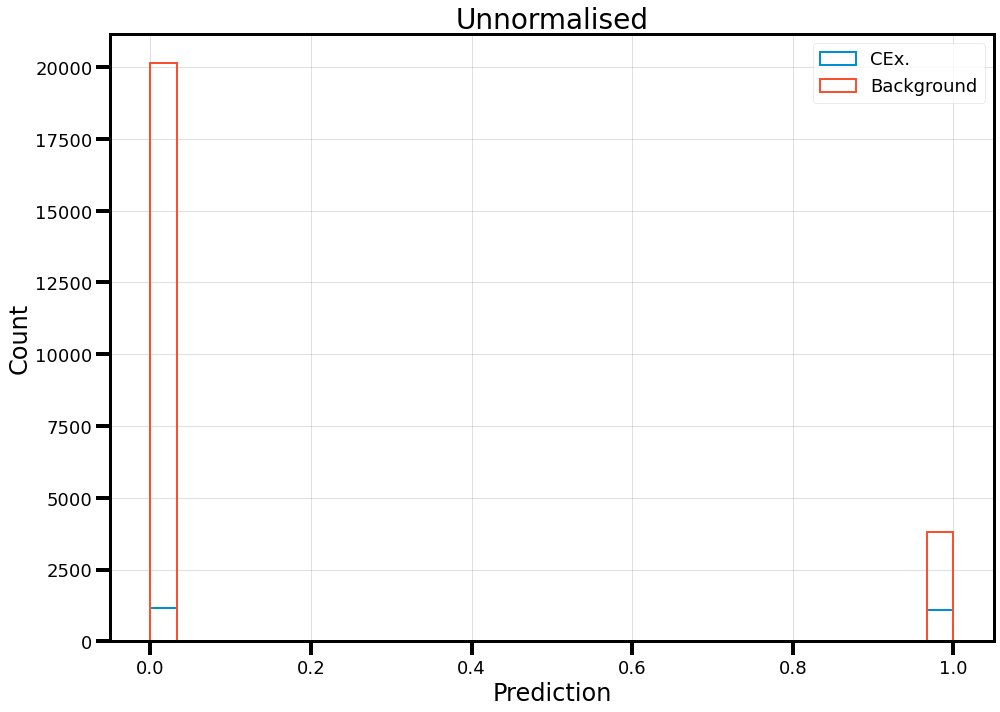

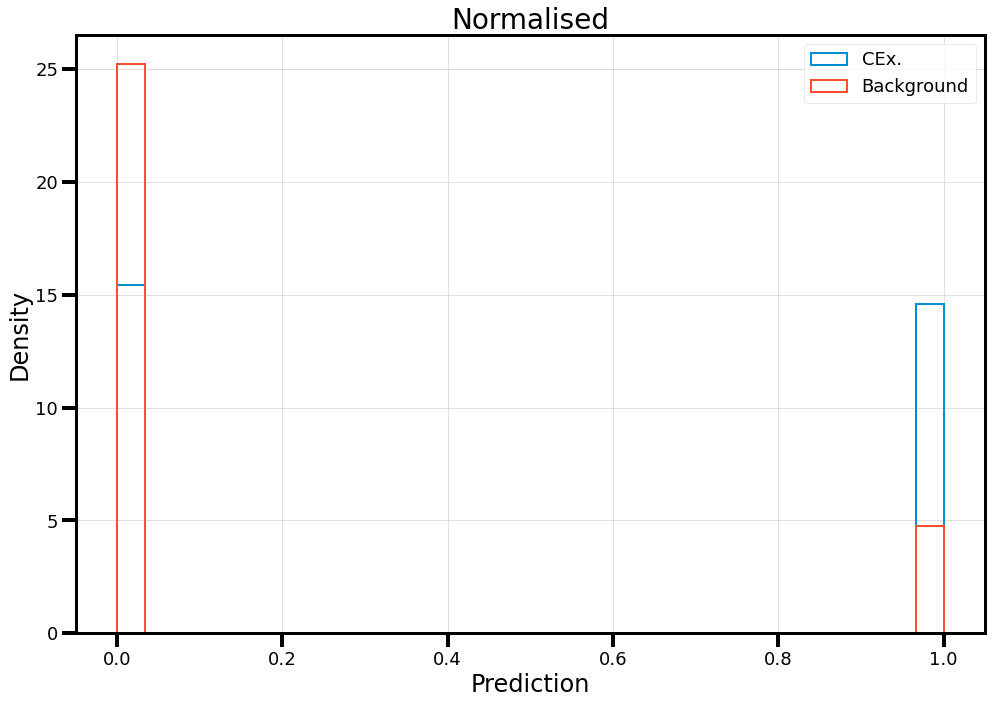

In [9]:
pred = 1. * np.logical_and(true_pfos[:, 1] > 0, true_pfos[:, 0] == 0)

bkg_preds = pred[true_regions==0.]
sig_preds = pred[true_regions==1.]
bins = np.linspace(0, 1, 31)

plt_conf.setup_figure(title="Unnormalised")
plt.hist(
    sig_preds, **plt_conf.gen_kwargs(
        index=0, bins=bins, label="CEx.",
        density=False, histtype="step"))
plt.hist(
    bkg_preds, **plt_conf.gen_kwargs(
        index=1, bins=bins, label="Background",
        density=False, histtype="step"))
plt_conf.format_axis(xlog=False, ylog=False,
                        xlabel="Prediction", ylabel="Count")
plt_conf.end_plot()

plt_conf.setup_figure(title="Normalised")
plt.hist(
    sig_preds, **plt_conf.gen_kwargs(
        index=0, bins=bins, label="CEx.",
        density=True, histtype="step"))
plt.hist(
    bkg_preds, **plt_conf.gen_kwargs(
        index=1, bins=bins, label="Background",
        density=True, histtype="step"))
plt_conf.format_axis(xlog=False, ylog=False,
                        xlabel="Prediction", ylabel="Density")
plt_conf.end_plot()

In [143]:
pi0_counts = EventSelection.count_all_pi0s(evts)
pion_counts = EventSelection.count_non_beam_charged_pi(evts)
regions_dict = EventSelection.create_regions_new(pi0_counts, pion_counts)

region_counts = {key: ak.sum(item) for key, item in regions_dict.items()}
min_count = min(region_counts.values())

filter = ak.full_like(regions_dict["charge_exchange"], True)

random_sample = ak.Array(np.random.rand(ak.count(regions_dict["charge_exchange"])))

for region in regions_dict.keys():
    remove_mask = random_sample >= (min_count/region_counts[region])
    remove_mask = np.logical_and(regions_dict[region], remove_mask)
    filter = np.logical_and(filter, np.logical_not(remove_mask))

sampled_evts = copy.deepcopy(evts)
sampled_evts.Filter([filter], [filter])


/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to filters.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to filename.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to nTuple_type.
  warnings.warn(f"Couldn't apply filters to {var}.")


In [ ]:
data_params_sampled = DataPreparation.create_parameter_dictionary(
    folder_path,
    sampled_evts, classifications, kinematic_props, geom_props)

In [151]:
DataPreparation.generate_training_data(data_params_sampled)

('/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_flat_evt_dist/schema.pbtxt',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_flat_evt_dist/train_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_flat_evt_dist/val_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_flat_evt_dist/test_data.tfrecords')

In [ ]:
path_params = DataPreparation.create_filepath_dictionary(folder_path)

In [7]:
data_params = DataPreparation.create_parameter_dictionary(
    folder_path,
    evts, classifications, kinematic_props, geom_props)
DataPreparation.generate_training_data(data_params)

('/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_sig-bkg/schema.pbtxt',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_sig-bkg/train_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_sig-bkg/val_data.tfrecords',
 '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_sig-bkg/test_data.tfrecords')

In [3]:
full_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_truth_momenta+pi0/")

In [4]:
# bt_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_truth_momenta/")
# bt_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_truth_no_mom_no_beam_mother/")
bt_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_truth_no_mom_no_beam_mother_reco_class/")
bt_reco_pfo_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_edge_truth_pfo_reco_no_shared_mother/")
bt_reco_edge_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_bt_pfo_truth_edge_reco/")

In [6]:
mc_with_pi0_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_mc_truth_info/")

In [5]:
# mc_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_mc_truth_info_no_pi0/")
mc_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_mc_truth_info_no_pi0_unnormed_label_no_beam_mother/")

In [3]:
# data_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_momentum_shower_only/")
# data_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_with_extra_losses")
# data_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_bdt_scores/")
data_path_params = DataPreparation.create_filepath_dictionary("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_bdt_scores_norms/")

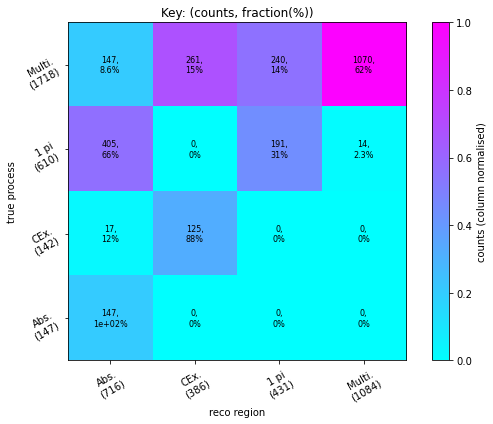

In [5]:
test_record = DataPreparation.load_record(bt_path_params["schema_path"], bt_path_params["test_path"],
                                            extra_losses=["reco_class"])
true_class = Models.convert_labels_to_truth(test_record.map(lambda d, l: l[0]))
reco_class = Models.convert_labels_to_truth(test_record.map(lambda d, l: l[-1]))
confustion_mat = Models.create_confusion_matrix(reco_class, true_class)
Models.plot_confusion_matrix(
    confustion_mat,
    ["Abs.", "CEx.", "1 pi", "Multi."], ["Abs.", "CEx.", "1 pi", "Multi."])

In [6]:
# train_ds, val_ds = DataPreparation.load_record(
#     data_params_sampled["schema_path"],
#     [data_params_sampled["train_path"], data_params_sampled["val_path"]])
train_ds, val_ds = DataPreparation.load_record(
    full_path_params["schema_path"],
    [full_path_params["train_path"], full_path_params["val_path"]])


2024-02-01 09:08:08.692887: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2256] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


In [41]:
train_ds, val_ds = DataPreparation.load_record(
    data_path_params["schema_path"],
    [data_path_params["train_path"], data_path_params["val_path"]])

In [42]:
a_graph, lab = train_ds.take(1).get_single_element()
a_graph

GraphTensor(
  context=Context(features={'reco_class': <tf.Tensor: shape=(1, 4), dtype=tf.float32>, 'mc_pi0s': <tf.Tensor: shape=(1, 1), dtype=tf.float32>, 'bt_photons': <tf.Tensor: shape=(1, 1), dtype=tf.float32>, 'mc_pions': <tf.Tensor: shape=(1, 1), dtype=tf.float32>, 'bt_pions': <tf.Tensor: shape=(1, 1), dtype=tf.float32>, 'mc_photons': <tf.Tensor: shape=(1, 1), dtype=tf.float32>, 'bt_pi0s': <tf.Tensor: shape=(1, 1), dtype=tf.float32>}, sizes=[1], shape=(), indices_dtype=tf.int32),
  node_set_names=['beam', 'pfo'],
  edge_set_names=['beam_connections', 'neighbours'])

In [194]:
reload(Layers)
reload(Models)

<module 'python.gnn.Models' from '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py'>

In [195]:
data_model_params = {
    "node_dim": 16,
    "beam_node_dim": 16,
    "edge_dim": 8,
    "beam_edge_dim": 8,
    # Dimensions for PNA message passing
    "message_dim": 8,
    "beam_message_dim": 8,
    # Dimensions for GATv2 message passing.
    # "message_heads": 4,
    # "message_channels": 8,
    # "beam_message_heads": 8,
    # "beam_message_channels": 8,
    # Other hyperparameters.
    "regularisation": 8e-5,
    "dropout_rate": 0.2
}

data_model_message_passing = [
    Layers.PFOUpdate(message_type="PNA"),
    Layers.NeighbourUpdate(final_step=False),
    Layers.BeamCollection(message_type="PNA", activation="leaky_relu"),
    Layers.BeamConnectionUpdate(final_step=False)
]

data_model_constructor = [
    Layers.Setup(),
    Models.create_normaliser_from_data(data_path_params),
    Layers.InitialState(pfo_hidden=(64, 2),
                        neighbours_hidden=None,
                        beam_connections_hidden=None, activation="leaky_relu"),
    # Layer is an output if given positional argument
    Layers.ReadoutClassifyNode("pion_id", which_nodes="pfo"),
    Layers.ReadoutClassifyNode("photon_id", which_nodes="pfo"),
    Layers.BeamCollection(message_type="PNA", next_state="concat"),
    # Loop constructor creates a sub loop
    Layers.LoopConstructor(data_model_message_passing,
                           loops=2),
    Layers.ReadoutClassifyEdge("pi0_id", which_edges="neighbours"),
    Layers.ReadoutNode(which_nodes="beam"),
    Layers.Dense(depth=16, n_layers=1),
    Layers.Dense("pion_count", depth=1),
    Layers.Dense("pi0_count", depth=1),
    Layers.Dense(depth=16, n_layers=1),
    Layers.Dense("reco_classification", depth=4),
    Layers.Dense("classifier", depth=4)
]

data_model_outputs = ["classifier",
                      "pion_count", "pi0_count",
                      "pion_id", "photon_id", "pi0_id",
                      "reco_classification"]

In [49]:
layer_funcs, _ = Layers.parse_constructor(data_model_constructor, data_model_params)

In [50]:
batched_train = train_ds.ragged_batch(batch_size=512)
a_batch, labs = batched_train.take(1).get_single_element()

In [51]:
b_batch = layer_funcs[0](a_batch)

In [52]:
c_batch = layer_funcs[1](b_batch)

In [4]:
d_batch = layer_funcs[2](c_batch)

NameError: name 'layer_funcs' is not defined

In [54]:
e_batch = layer_funcs[3](d_batch)

In [55]:
print(e_batch)

GraphTensor(
  context=Context(features={'reco_class': <tf.Tensor: shape=(512, 4), dtype=tf.float32>, 'mc_pi0s': <tf.Tensor: shape=(512, 1), dtype=tf.float32>, 'bt_photons': <tf.Tensor: shape=(512, 1), dtype=tf.float32>, 'mc_pions': <tf.Tensor: shape=(512, 1), dtype=tf.float32>, 'bt_pions': <tf.Tensor: shape=(512, 1), dtype=tf.float32>, 'mc_photons': <tf.Tensor: shape=(512, 1), dtype=tf.float32>, 'bt_pi0s': <tf.Tensor: shape=(512, 1), dtype=tf.float32>}, sizes=[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1

In [57]:
e_batch.node_sets["beam"].features

NodeSet(features={'hidden_state': <tf.Tensor: shape=(512, 16), dtype=tf.float32>}, sizes=[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 

In [ ]:
print(data_)

In [196]:
data_model_funcs, data_model_outputs = Layers.parse_constructor(data_model_constructor, data_model_params)
curr_state = a_batch
node_out_is = [1, 2, 6, 10]
beam_out_is = [1, 2, 5, 8, 11]
raw_out_is = [13]
# print(curr_state.node_sets["beam"].features[tfgnn.HIDDEN_STATE])
for i, (f, out) in enumerate(zip(data_model_funcs, data_model_outputs)):
    print(i)
    if out is None:
        curr_state = f(curr_state)
    if i in node_out_is:
        print(np.min(curr_state.node_sets["pfo"].features[tfgnn.HIDDEN_STATE]))
        print(np.max(curr_state.node_sets["pfo"].features[tfgnn.HIDDEN_STATE]))
        print(curr_state.node_sets["pfo"].features[tfgnn.HIDDEN_STATE])
    if i in beam_out_is:
        if i > 2:
            print(np.min(curr_state.node_sets["beam"].features[tfgnn.HIDDEN_STATE]))
            print(np.max(curr_state.node_sets["beam"].features[tfgnn.HIDDEN_STATE]))
        print(curr_state.node_sets["beam"].features[tfgnn.HIDDEN_STATE])
    if i in raw_out_is:
        print(curr_state)

0
1
-1.6643469
8.394523
tf.Tensor(
[[ 1.8344438  -0.7428288  -0.6070692  -0.38682872  0.4029384   0.01558568]
 [-0.04239681 -0.78187746 -0.7442995   3.7367692   0.9228514   2.366683  ]
 [-0.1803499  -0.78771895 -0.796881    4.150306    0.87201506  2.2538111 ]
 ...
 [-0.9599998  -0.7892695   1.8418386  -0.73338264  1.1470925  -0.35905293]
 [-0.6245573   1.2840214  -0.7781302   0.10058186 -1.4124203  -0.6424334 ]
 [-0.83697075 -0.7328342   1.6081073  -0.53971267  0.6344689  -0.70967627]], shape=(2364, 6), dtype=float32)
tf.Tensor(
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1.

In [59]:
data_model.predict(a_batch, batch_size=512)

1/1 [==============================] - 1s 974ms/step


[array([[nan, nan, nan, nan],
        [nan, nan, nan, nan],
        [nan, nan, nan, nan],
        ...,
        [nan, nan, nan, nan],
        [nan, nan, nan, nan],
        [nan, nan, nan, nan]], dtype=float32),
 array([[nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [nan],
        [n

In [58]:
e_batch.node_sets["beam"].features[tfgnn.HIDDEN_STATE]

<tf.Tensor: shape=(512, 16), dtype=float32, numpy=
array([[0.        , 0.        , 0.0279253 , ..., 0.00882404, 0.0587037 ,
        0.        ],
       [0.4700389 , 0.        , 0.02957788, ..., 0.15699169, 0.        ,
        0.        ],
       [0.06160037, 0.        , 0.02084519, ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.05781082, 0.        , 0.        , ..., 0.04607271, 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.08827648, 0.00933272,
        0.        ],
       [0.05237676, 0.        , 0.        , ..., 0.        , 0.05485135,
        0.        ]], dtype=float32)>

In [43]:
from tensorflow_gnn.graph import broadcast_ops, pool_ops

In [70]:
class StdGraphPieceReducer(pool_ops.GraphPieceReducer):
    """Implements standard deviation pooling from one graph piece."""

    def __init__(self, *args, eps=1e-5, **kwargs):
        self.eps = eps
        super().__init__(*args, **kwargs)

    def unsorted_segment_op(self,
                            values,
                            segment_ids,
                            num_segments):
        """Implements subclass API."""
        squares = tf.math.square(values)
        var = (tf.math.unsorted_segment_mean(squares, segment_ids, num_segments)
            - tf.math.square(tf.math.unsorted_segment_mean(values, segment_ids, num_segments)))
        relu_var = (tf.math.abs(var) + var) / 2 # eqution for ReLU activation
        # From PNA paper [arXiv:2004.05718], use relu to avoid -ve from
        # numerical errors and add an epsilon for differentiability
        return tf.math.sqrt(relu_var + self.eps)

class MomentGraphPieceReducer(pool_ops.GraphPieceReducer):
    """Implements moment-pooling from one graph piece."""

    def __init__(self, *args, moment=1, eps=1e-5, **kwargs):
        self.eps = eps
        self.moment = moment
        super().__init__(*args, **kwargs)

    def unsorted_segment_op(self,
                            values,
                            segment_ids,
                            num_segments,
                            eps=1e-5):
        """Implements subclass API."""
        squares = tf.math.square(values)
        var = (tf.math.unsorted_segment_mean(squares, segment_ids, num_segments)
            - tf.math.square(tf.math.unsorted_segment_mean(values, segment_ids, num_segments)))
        relu_var = (tf.math.abs(var) + var) / 2 # eqution for ReLU activation
        # From PNA paper [arXiv:2004.05718], use relu to avoid -ve from
        # numerical errors and add an epsilon for differentiability
        return tf.math.sqrt(relu_var + self.eps)

class PrincipleNeighbourAggregator(tfgnn.keras.layers.AnyToAnyConvolutionBase):
    def __init__(
            self,
            units,
            activation="relu", dropout_rate=0., regularisation=None,
            receiver_tag = None,
            receiver_feature = tfgnn.HIDDEN_STATE,
            sender_node_feature = tfgnn.HIDDEN_STATE,
            sender_edge_feature = None,
            aggregators = ["mean", "min", "max", "std"],
            # scalar_alphas = [0., 1., -1.],
            **kwargs):
        self.aggregator_defs = {
            "mean": pool_ops.MeanGraphPieceReducer().reduce,
            "max" : pool_ops.MaxGraphPieceReducer().reduce,
            "min" : pool_ops.MinGraphPieceReducer().reduce,
            "std" : StdGraphPieceReducer().reduce}
        self.aggregators = aggregators
        # self.scalar_alphas = scalar_alphas

        super().__init__(
            receiver_tag = receiver_tag,
            receiver_feature = receiver_feature,
            sender_node_feature = sender_node_feature,
            sender_edge_feature = sender_edge_feature,
            extra_receiver_ops = {agg: self.aggregator_defs[agg]
                                  for agg in self.aggregators},
            **kwargs)
        # generic_dense_layer defined in this module
        self._message_fn = Layers.generic_dense_layer(
            units, activation=activation,
            dropout_rate=dropout_rate, regularisation=regularisation)

    def scalar(self, counts, alpha):
        """
        Implements calculation of a scaler for each neighbourhood
        based on the scalar calculation method suggested by Corso et al.
        in [arXiv:2004.05718].

        For a neighbourhood of size d, calculate the scalar S as:
        S(d) = (log(d + 1)/delta)^alpha
        With delta as the E[log(d+1)] over the training set.
        """
        log_counts = tf.math.log(counts + 1)

        # Not sure what dimension this should be for edge cases,
        # expect only 1 input dim.
        average_count = tf.math.reduce_mean(log_counts, axis=0)
        scalars = tf.math.pow(log_counts/average_count, alpha)
        # Expand dims t allow broadcasting onto featureful final dimension
        return tf.expand_dims(scalars, axis=-1)

    def pna_attention(self, messages):
        pass

    def get_config(self):
        return dict(units=self._message_fn.units, **super().get_config())

    def convolve(
            # Call arguements from AnyToAnyConvolutionBase parent
            self, *,
            sender_node_input, sender_edge_input, receiver_input,
            broadcast_from_sender_node, broadcast_from_receiver, 
            pool_to_receiver, # Unused
            extra_receiver_ops,
            training):
        inputs = []
        if sender_node_input is not None:
            inputs.append(broadcast_from_sender_node(sender_node_input))
            print(dir(broadcast_from_sender_node))
            print(sender_node_input.shape)
        if sender_edge_input is not None:
            inputs.append(sender_edge_input)
            print(sender_edge_input.shape)
        if receiver_input is not None:
            inputs.append(broadcast_from_receiver(receiver_input))
            print(receiver_input.shape)
        print([i.shape for i in inputs])
        print(tf.concat(inputs, axis=-1).shape)
        messages = self._message_fn(tf.concat(inputs, axis=-1))
        # messages = tf.concat(inputs, axis=-1)
        print(messages.shape)
        counts = pool_to_receiver(messages, reduce_type="_count")
        print(counts.shape)
        aggrs = []
        for agg in self.aggregators:
            aggrs.append(extra_receiver_ops[agg](messages))
        aggrs = tf.concat(aggrs, axis=-1)
        # aggrs = pool_to_receiver(messages, reduce_type="mean|max|min")
        print(aggrs.shape)
        # std_aggr = extra_receiver_ops["std"](messages)
        # print(std_aggr.shape)
        scalars = [self.scalar(counts, a) for a in self.scalar_alphas]
        print([s.shape for s in scalars])
        res = tf.concat([aggrs * s for s in scalars], axis=-1)
        print(res.shape)
        return res

In [63]:
pna_layer = PrincipleNeighbourAggregator(32, receiver_tag=tfgnn.SOURCE, sender_edge_feature=tfgnn.HIDDEN_STATE)
pna_update = tfgnn.keras.layers.GraphUpdate(
            node_sets={
                "pfo": tfgnn.keras.layers.NodeSetUpdate(
                    {"neighbours": pna_layer},
                    tfgnn.keras.layers.ResidualNextState(
                        Layers.generic_dense_layer(data_model_params["node_dim"])))})
e_batch = pna_update(d_batch)

['__annotations__', '__builtins__', '__call__', '__class__', '__closure__', '__code__', '__defaults__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__get__', '__getattribute__', '__globals__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__kwdefaults__', '__le__', '__lt__', '__module__', '__name__', '__ne__', '__new__', '__qualname__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__']
(2364, 16)
(10666, 8)
(2364, 16)
[TensorShape([10666, 16]), TensorShape([10666, 8]), TensorShape([10666, 16])]
(10666, 40)
(10666, 32)
(2364,)
(2364, 128)
[TensorShape([2364, 1]), TensorShape([2364, 1]), TensorShape([2364, 1])]
(2364, 384)


In [64]:
print(e_batch)

GraphTensor(
  context=Context(features={'mc_pi0s': <tf.Tensor: shape=(512, 1), dtype=tf.float32>, 'mc_photons': <tf.Tensor: shape=(512, 1), dtype=tf.float32>, 'reco_class': <tf.Tensor: shape=(512, 4), dtype=tf.float32>, 'bt_photons': <tf.Tensor: shape=(512, 1), dtype=tf.float32>, 'bt_pi0s': <tf.Tensor: shape=(512, 1), dtype=tf.float32>, 'mc_pions': <tf.Tensor: shape=(512, 1), dtype=tf.float32>, 'bt_pions': <tf.Tensor: shape=(512, 1), dtype=tf.float32>}, sizes=[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1

In [80]:
class StdGraphPieceReducer(pool_ops.GraphPieceReducer):
    """Implements standard deviation pooling from one graph piece."""

    def __init__(self, *args, eps=1e-20, **kwargs):
        self.eps = eps
        super().__init__(*args, **kwargs)

    def unsorted_segment_op(self,
                            values,
                            segment_ids,
                            num_segments):
        """Implements subclass API."""
        squares = tf.math.square(values)
        var = (tf.math.unsorted_segment_mean(squares, segment_ids, num_segments)
            - tf.math.square(tf.math.unsorted_segment_mean(values, segment_ids, num_segments)))
        relu_var = (tf.math.abs(var) + var) / 2 # eqution for ReLU activation
        # From PNA paper [arXiv:2004.05718], use relu to avoid -ve from
        # numerical errors and add an epsilon for differentiability
        return tf.math.sqrt(relu_var + self.eps)

class MomentGraphPieceReducer(pool_ops.GraphPieceReducer):
    """Implements moment-pooling from one graph piece."""

    def __init__(self, *args, moment=1, eps=1e-20, **kwargs):
        self.eps = eps
        self.moment = moment
        super().__init__(*args, **kwargs)

    def unsorted_segment_op(self,
                            values,
                            segment_ids,
                            num_segments):
        """Implements subclass API."""
        squares = tf.math.square(values)
        var = (tf.math.unsorted_segment_mean(squares, segment_ids, num_segments)
            - tf.math.square(tf.math.unsorted_segment_mean(values, segment_ids, num_segments)))
        relu_var = (tf.math.abs(var) + var) / 2 # eqution for ReLU activation
        # From PNA paper [arXiv:2004.05718], use relu to avoid -ve from
        # numerical errors and add an epsilon for differentiability
        return tf.math.sqrt(relu_var + self.eps)

class PrincipleNeighbourAggregatorPrintTest(tfgnn.keras.layers.AnyToAnyConvolutionBase):
    def __init__(
            self,
            units,
            activation="relu", dropout_rate=0., regularisation=None,
            receiver_tag = None,
            receiver_feature = tfgnn.HIDDEN_STATE,
            sender_node_feature = tfgnn.HIDDEN_STATE,
            sender_edge_feature = None,
            aggregators = ["mean", "min", "max", "std"],
            scalar_alphas = [0., 1., -1.],
            extra_receiver_ops = {"std":StdGraphPieceReducer().reduce},
            **kwargs):
        self.aggregator_defs = {
            "mean": pool_ops.MeanGraphPieceReducer().reduce,
            "max" : pool_ops.MaxGraphPieceReducer().reduce,
            "min" : pool_ops.MinGraphPieceReducer().reduce,
            "std" : StdGraphPieceReducer().reduce}
        self.aggregators = aggregators

        super().__init__(
            receiver_tag = receiver_tag,
            receiver_feature = receiver_feature,
            sender_node_feature = sender_node_feature,
            sender_edge_feature = sender_edge_feature,
            extra_receiver_ops = {agg: self.aggregator_defs[agg]
                                  for agg in self.aggregators},
            **kwargs)
        # generic_dense_layer defined in this module
        self._message_fn = Layers.generic_dense_layer(
            units, activation=activation,
            dropout_rate=dropout_rate, regularisation=regularisation)
        self.scalar_alphas = scalar_alphas

    def scalar(self, counts, alpha):
        """
        Implements calculation of a scaler for each neighbourhood
        based on the scalar calculation method suggested by Corso et al.
        in [arXiv:2004.05718].

        For a neighbourhood of size d, calculate the scalar S as:
        S(d) = (log(d + 1)/delta)^alpha
        With delta as the E[log(d+1)] over the training set.
        """
        log_counts = tf.math.log(counts + 1)

        # Not sure what dimension this should be for edge cases,
        # expect only 1 input dim.
        average_count = tf.math.reduce_mean(log_counts, axis=0)
        scalars = tf.math.pow(log_counts/average_count, alpha)
        # Expand dims t allow broadcasting onto featureful final dimension
        return tf.expand_dims(scalars, axis=-1)

    def pna_attention(self, messages):
        pass

    def get_config(self):
        return dict(units=self._message_fn.units, **super().get_config())

    def convolve(
            # Call arguements from AnyToAnyConvolutionBase parent
            self, *,
            sender_node_input, sender_edge_input, receiver_input,
            broadcast_from_sender_node, broadcast_from_receiver, 
            pool_to_receiver, # Unused
            extra_receiver_ops,
            training):
        inputs = []
        if sender_node_input is not None:
            inputs.append(broadcast_from_sender_node(sender_node_input))
            print(dir(broadcast_from_sender_node))
            print(sender_node_input.shape)
        if sender_edge_input is not None:
            inputs.append(sender_edge_input)
            print(sender_edge_input.shape)
        if receiver_input is not None:
            inputs.append(broadcast_from_receiver(receiver_input))
            print(receiver_input.shape)
        print([i.shape for i in inputs])
        print(tf.concat(inputs, axis=-1).shape)
        # messages = self._message_fn(tf.concat(inputs, axis=-1))
        messages = tf.concat(inputs, axis=-1)
        print("\nInput:")
        print(messages)
        counts = pool_to_receiver(messages, reduce_type="_count")
        print("\nCounts:")
        print(counts)
        aggrs = []
        for agg in self.aggregators:
            aggrs.append(extra_receiver_ops[agg](messages))
        aggrs = tf.concat(aggrs, axis=-1)
        # aggrs = pool_to_receiver(messages, reduce_type="mean|max|min")
        print("\nAggregations:")
        print(aggrs)
        # std_aggr = extra_receiver_ops["std"](messages)
        # print(std_aggr.shape)
        scalars = [self.scalar(counts, a) for a in self.scalar_alphas]
        # print([s.shae for s in scalars])
        print("\nScalars:")
        print(scalars)
        res = tf.concat([aggrs * s for s in scalars], axis=-1)
        print("\nFinal result:")
        print(res.shape)
        print(res)
        return res

In [69]:
graph_1_nodes = np.array([
    [1., 2.],
    [2., -1.],
    [0.5, 0.5]
])
graph_1_edges = np.ones((6, 1))
graph_2_nodes = np.array([
    [1., 0.],
    [-4., -1.],
    [0.5, 0.8],
    [-0.2, -1.]
])
graph_2_edges = np.zeros((12, 1))
graph_2_edges[1:3, 0] = 1.

graph_1 = tfgnn.GraphTensor.from_pieces(
   node_sets={
       "pfo": tfgnn.NodeSet.from_fields(
           sizes=tf.constant([3]),
           features={
               tfgnn.HIDDEN_STATE: tf.convert_to_tensor(
                   graph_1_nodes)
           })},
   edge_sets={
       "neighbours": tfgnn.EdgeSet.from_fields(
           sizes=tf.constant([6]),
           features = {tfgnn.HIDDEN_STATE: tf.convert_to_tensor(graph_1_edges)},
           adjacency=tfgnn.Adjacency.from_indices(
               source=("pfo", tf.constant([0, 0, 1, 1, 2, 2])),
               target=("pfo", tf.constant([1, 2, 0, 2, 0, 1]))))})
    
graph_2 = tfgnn.GraphTensor.from_pieces(
   node_sets={
       "pfo": tfgnn.NodeSet.from_fields(
           sizes=tf.constant([4]),
           features={
               tfgnn.HIDDEN_STATE: tf.convert_to_tensor(
                   graph_2_nodes)
           })},
   edge_sets={
       "neighbours": tfgnn.EdgeSet.from_fields(
           sizes=tf.constant([12]),
           features = {tfgnn.HIDDEN_STATE: tf.convert_to_tensor(graph_2_edges)},
           adjacency=tfgnn.Adjacency.from_indices(
               source=("pfo", tf.constant([0, 0, 0, 1, 1, 1, 2, 2, 2, 3, 3, 3])),
               target=("pfo", tf.constant([1, 2, 3, 0, 2, 3, 0, 1, 3, 0, 1, 2]))))})

In [81]:
pna_layer_test = PrincipleNeighbourAggregatorPrintTest(2, receiver_tag=tfgnn.SOURCE, sender_edge_feature=tfgnn.HIDDEN_STATE)
pna_update_test = tfgnn.keras.layers.GraphUpdate(
            node_sets={
                "pfo": tfgnn.keras.layers.NodeSetUpdate(
                    {"neighbours": pna_layer_test},
                    tfgnn.keras.layers.ResidualNextState(
                        Layers.generic_dense_layer(data_model_params["node_dim"])))})
g1_out = pna_update_test(graph_1)

['__annotations__', '__builtins__', '__call__', '__class__', '__closure__', '__code__', '__defaults__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__get__', '__getattribute__', '__globals__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__kwdefaults__', '__le__', '__lt__', '__module__', '__name__', '__ne__', '__new__', '__qualname__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__']
(3, 2)
(6, 1)
(3, 2)
[TensorShape([6, 2]), TensorShape([6, 1]), TensorShape([6, 2])]
(6, 5)

Input:
tf.Tensor(
[[ 2.  -1.   1.   1.   2. ]
 [ 0.5  0.5  1.   1.   2. ]
 [ 1.   2.   1.   2.  -1. ]
 [ 0.5  0.5  1.   2.  -1. ]
 [ 1.   2.   1.   0.5  0.5]
 [ 2.  -1.   1.   0.5  0.5]], shape=(6, 5), dtype=float64)

Counts:
tf.Tensor([2. 2. 2.], shape=(3,), dtype=float64)

Aggregations:
tf.Tensor(
[[ 1.25e+00 -2.50e-01  1.00e+00  1.00e+00  2.00e+00  5.00e-01 -1.00e+00
   1.00e+00  1.00e+00  2.00e+00  2.00e+00 

ValueError: Exception encountered when calling layer 'residual_next_state_23' (type ResidualNextState).

A ResidualNextState() requires an update_fn whose output has the same shape as the input state, but got output shape [3, 16] vs input shape [3, 2] from single input.

Call arguments received by layer 'residual_next_state_23' (type ResidualNextState):
  • inputs=('tf.Tensor(shape=(3, 2), dtype=float32)', {'neighbours': 'tf.Tensor(shape=(3, 60), dtype=float32)'}, {})

In [79]:
feats = np.array([[ 2.,  -1. ,  1.,   1.,   2. ],
 [ 0.5 , 0.5,  1.,   1. ,  2. ],
 [ 1.  , 2. ,  1.,   2. , -1. ],
 [ 0.5,  0.5,  1.,   2. , -1. ],
 [ 1.  , 2. ,  1.,   0.5,  0.5],
 [ 2. , -1. ,  1.,   0.5,  0.5]])
for i in range(feats.shape[0]//2):
    n = feats.shape[0]//2 - 1
    neighbours = feats[n*i:n*(i+1)]
    print(f"Mean: {np.mean(neighbours, axis=0)}")
    print(f"Min: {np.min(neighbours, axis=0)}")
    print(f"Max: {np.max(neighbours, axis=0)}")
    print(f"Std: {np.std(neighbours, axis=0)}")

Mean: [ 1.25 -0.25  1.    1.    2.  ]
Min: [ 0.5 -1.   1.   1.   2. ]
Max: [2.  0.5 1.  1.  2. ]
Std: [0.75 0.75 0.   0.   0.  ]
Mean: [ 0.75  1.25  1.    2.   -1.  ]
Min: [ 0.5  0.5  1.   2.  -1. ]
Max: [ 1.  2.  1.  2. -1.]
Std: [0.25 0.75 0.   0.   0.  ]
Mean: [1.5 0.5 1.  0.5 0.5]
Min: [ 1.  -1.   1.   0.5  0.5]
Max: [2.  2.  1.  0.5 0.5]
Std: [0.5 1.5 0.  0.  0. ]


In [20]:
def pfo_normaliser(node_set, node_set_name):
    data = node_set.get_features_dict()
    if node_set_name == "pfo":
        print(data[tfgnn.HIDDEN_STATE])
        data[tfgnn.HIDDEN_STATE] = data[tfgnn.HIDDEN_STATE] * np.array([1,2,3,4,5,6])
    return data
def edge_normaliser(edge_set, edge_set_name):
    if edge_set_name == "neighbours":
        print(edge_set)
    elif edge_set_name == "beam_connections":
        print(edge_set)
    return None#edge_set
b_graph = tfgnn.keras.layers.MapFeatures(
    node_sets_fn = pfo_normaliser,
    edge_sets_fn = edge_normaliser)(a_graph)

KerasTensor(type_spec=TensorSpec(shape=(1, 6), dtype=tf.float32, name=None), name='Placeholder_6:0', description="created by layer 'input.get_features_dict_3'")
KerasTensor(type_spec=EdgeSetSpec({'features': {'true_pi0': TensorSpec(shape=(0, 1), dtype=tf.float32, name=None), 'beam_pi0': TensorSpec(shape=(0, 1), dtype=tf.float32, name=None), 'hidden_state': TensorSpec(shape=(0, 3), dtype=tf.float32, name=None)}, 'adjacency': AdjacencySpec({'#index.0': TensorSpec(shape=(0,), dtype=tf.int32, name=None), '#index.1': TensorSpec(shape=(0,), dtype=tf.int32, name=None)}, TensorShape([]), tf.int32, tf.int64, {'#index.0': 'pfo', '#index.1': 'pfo'}), 'sizes': TensorSpec(shape=(1,), dtype=tf.int32, name=None)}, TensorShape([]), tf.int32, tf.int64, None), description="created by layer 'input_7'")
KerasTensor(type_spec=EdgeSetSpec({'features': {'beam_relevant': TensorSpec(shape=(1, 1), dtype=tf.float32, name=None), 'hidden_state': TensorSpec(shape=(1, 2), dtype=tf.float32, name=None), 'true_daughter

In [21]:
print(a_graph.node_sets["pfo"].features[tfgnn.HIDDEN_STATE])
print(b_graph.node_sets["pfo"].features[tfgnn.HIDDEN_STATE])

tf.Tensor(
[[8.2876706e-01 1.8020401e-02 9.5793054e-02 5.7419509e-02 6.9659764e-01
  3.2100000e+02]], shape=(1, 6), dtype=float32)
tf.Tensor(
[[8.2876706e-01 3.6040802e-02 2.8737915e-01 2.2967803e-01 3.4829881e+00
  1.9260000e+03]], shape=(1, 6), dtype=float32)


In [3]:
def _build_model_gat(
    graph_tensor_spec,
    # Dimensions of initial states.
    node_dim=16,
    edge_dim=16,
    # Dimensions for message passing.
    n_heads=4,
    per_head_channels=16,
    message_dim=64,
    next_state_dim=64,
    # Dimension for the logits.
    num_classes=2,
    # Number of message passing steps.
    num_message_passing=3,
    # Other hyperparameters.
    l2_regularization=5e-4,
    dropout_rate=0.5,
):
  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)

  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()

  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, *, node_set_name):
    # Since we only have one node set, we can ignore node_set_name.
    return tf.keras.layers.Dense(node_dim)(node_set[tfgnn.HIDDEN_STATE])
  def set_initial_edge_state(edge_set, *, edge_set_name):
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          graph)

  # This helper function is just a short-hand for the code below.
  # def dense(units, activation="relu"):
  #   """A Dense layer with regularization (L2 and Dropout)."""
  #   regularizer = tf.keras.regularizers.l2(l2_regularization)
  #   return tf.keras.Sequential([
  #       tf.keras.layers.Dense(
  #           units,
  #           activation=activation,
  #           kernel_regularizer=regularizer,
  #           bias_regularizer=regularizer),
  #       tf.keras.layers.Dropout(dropout_rate)
  #   ])
  
  def gat_v2_update(num_heads, per_head_channels, i, activation="relu"):
    """A GATv2 attention layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return gat_v2.GATv2HomGraphUpdate(
      num_heads=num_heads,
      per_head_channels=per_head_channels,
      receiver_tag = tfgnn.SOURCE,
      heads_merge_type="concat",
      name=f"gat_v2_{i}",
      activation=activation,
      edge_dropout=dropout_rate,
      kernel_regularizer=regularizer)

  # The GNN core of the model does `num_message_passing` many updates of node
  # states conditioned on their neighbors and the edges connecting to them.
  # More precisely:
  #  - Each edge computes a message by applying a dense layer `message_fn`
  #    to the concatenation of node states of both endpoints (by default)
  #    and the edge's own unchanging feature embedding.
  #  - Messages are summed up at the common TARGET nodes of edges.
  #  - At each node, a dense layer is applied to the concatenation of the old
  #    node state with the summed edge inputs to compute the new node state.
  # Each iteration of the for-loop creates new Keras Layer objects, so each
  # round of updates gets its own trainable variables.
  for i in range(num_message_passing):
    graph = gat_v2_update(
        n_heads, per_head_channels, i
      )(graph)
    # graph = tfgnn.keras.layers.GraphUpdate(
    #     node_sets={
    #         "atoms": tfgnn.keras.layers.NodeSetUpdate(
    #             {"bonds": tfgnn.keras.layers.SimpleConv(
    #                  sender_edge_feature=tfgnn.HIDDEN_STATE,
    #                  message_fn=dense(message_dim),
    #                  reduce_type="sum",
    #                  receiver_tag=tfgnn.TARGET)},
    #             tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))}
    # )(graph)

  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  readout_features = tfgnn.keras.layers.Pool(
      tfgnn.CONTEXT, "mean", node_set_name="atoms")(graph)

  # Put a linear classifier on top (not followed by dropout).
  logits = tf.keras.layers.Dense(1)(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[logits])

In [48]:
def _baseline_build_model(
    graph_tensor_spec,
    # Dimensions of initial states.
    node_dim=16,
    edge_dim=16,
    # Dimensions for message passing.
    message_dim=64,
    next_state_dim=64,
    # Dimension for the logits.
    num_classes=2,
    # Number of message passing steps.
    num_message_passing=3,
    # Other hyperparameters.
    l2_regularization=5e-4,
    dropout_rate=0.5,
):
  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)

  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()

  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, *, node_set_name):
    # Since we only have one node set, we can ignore node_set_name.
    return tf.keras.layers.Dense(node_dim)(node_set[tfgnn.HIDDEN_STATE])
  def set_initial_edge_state(edge_set, *, edge_set_name):
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          graph)

  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  # The GNN core of the model does `num_message_passing` many updates of node
  # states conditioned on their neighbors and the edges connecting to them.
  # More precisely:
  #  - Each edge computes a message by applying a dense layer `message_fn`
  #    to the concatenation of node states of both endpoints (by default)
  #    and the edge's own unchanging feature embedding.
  #  - Messages are summed up at the common TARGET nodes of edges.
  #  - At each node, a dense layer is applied to the concatenation of the old
  #    node state with the summed edge inputs to compute the new node state.
  # Each iteration of the for-loop creates new Keras Layer objects, so each
  # round of updates gets its own trainable variables.
  for i in range(num_message_passing):
    graph = tfgnn.keras.layers.GraphUpdate(
        node_sets={
            "atoms": tfgnn.keras.layers.NodeSetUpdate(
                {"bonds": tfgnn.keras.layers.SimpleConv(
                     sender_edge_feature=tfgnn.HIDDEN_STATE,
                     message_fn=dense(message_dim),
                     reduce_type="sum",
                     receiver_tag=tfgnn.TARGET)},
                tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))}
    )(graph)

  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  readout_features = tfgnn.keras.layers.Pool(
      tfgnn.CONTEXT, "mean", node_set_name="atoms")(graph)

  # Put a linear classifier on top (not followed by dropout).
  logits = tf.keras.layers.Dense(1)(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[logits])

In [4]:
def GATv2_model(
        graph_tensor_spec,
        # Dimensions of initial states.
        node_dim=16,
        edge_dim=16,
        # Dimensions for message passing.
        message_dim=64,
        next_state_dim=64,
        # GAT head count
        n_heads = 4,
        per_head_channels = 8,
        # Dimension for the logits.
        num_classes=4,
        # Number of message passing steps.
        num_message_passing=3,
        # Other hyperparameters.
        l2_regularization=5e-4,
        dropout_rate=0.5,
        # Names (allow convert between us and MUTAG)
        node_name="pfo",
        edge_name="neighbours"
    ):
    input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
    print(type(input_graph))
    print(input_graph)
    print(dir(input_graph))
    graph = input_graph.merge_batch_to_components()
    def set_initial_node_state(node_set, *, node_set_name):
        # Since we only have one node set, we can ignore node_set_name.
        return tf.keras.layers.Dense(node_dim)(node_set[tfgnn.HIDDEN_STATE])
    def set_initial_edge_state(edge_set, *, edge_set_name):
        return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    graph = tfgnn.keras.layers.MapFeatures(
        node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
            graph)
    
    def gat_v2_update(num_heads, per_head_channels, i, activation="relu"):
        """A GATv2 attention layer with regularization (L2 and Dropout)."""
        regularizer = tf.keras.regularizers.l2(l2_regularization)
        return gat_v2.GATv2HomGraphUpdate(
            num_heads=num_heads,
            per_head_channels=per_head_channels,
            receiver_tag = tfgnn.SOURCE,
            heads_merge_type="concat",
            name=f"gat_v2_{i}",
            activation=activation,
            edge_dropout=dropout_rate,
            kernel_regularizer=regularizer)
    
    # GAT_layer = gat_v2.GATv2HomGraphUpdate(
    #         num_heads=n_heads,
    #         per_head_channels=per_head_channels,
    #         receiver_tag = tfgnn.SOURCE,
    #         heads_merge_type="concat")

    for i in range(num_message_passing):
        # graph = GAT_layer(graph)
        graph = gat_v2_update(
            n_heads, per_head_channels, i
        )(graph)
        # graph = gat_v2.GATv2HomGraphUpdate(
        #     num_heads=n_heads,
        #     per_head_channels=per_head_channels,
        #     receiver_tag = tfgnn.SOURCE,
        #     heads_merge_type="concat",
        #     name=f"gat_v2_{i}",
        #     edge_dropout=dropout_rate)(graph)
    # graph = tfgnn.keras.layers.GraphUpdate(
    #     node_sets={
    #         "pfo": tfgnn.keras.layers.NodeSetUpdate(
    #             {"neighbours": tfgnn.keras.layers.GATv2Conv(
    #                 n_heads=n_heads,
    #                 per_head_channels=per_head_channels,
    #                 sender_edge_feature=tfgnn.HIDDEN_STATE,
    #                 message_fn=dense(message_dim),
    #                 reduce_type="sum",
    #                 receiver_tag=tfgnn.TARGET)},
    #             tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))}
    # )(graph)

    # readout_features = tfgnn.keras.layers.Pool(
    #     tfgnn.CONTEXT, "mean", node_set_name="pfo")(graph)
    readout_features = tfgnn.keras.layers.Pool(
        tfgnn.CONTEXT, "mean", edge_set_name=edge_name)(graph)
    # readout_features = gat_v2.GATv2EdgePool(
    #     num_heads = 4, per_head_channels=n_heads*per_head_channels,
    #     receiver_tag=tfgnn.CONTEXT)(graph)
    # readout_features = gat_v2.GATv2Conv(
    #     num_heads = 4, per_head_channels=n_heads*per_head_channels,
    #     receiver_tag = tfgnn.CONTEXT, heads_merge_type = "mean")(graph)

    # Put a linear classifier on top (not followed by dropout).
    # logits = tf.keras.layers.Dense(num_classes)(readout_features)

    # This one isn't logits, need to work out exactly what it is though...
    # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)
    
    # Binary crossentropy version
    logits = tf.keras.layers.Dense(num_classes, activation="sigmoid")(readout_features)

    # Build a Keras Model for the transformation from input_graph to logits.
    return tf.keras.Model(inputs=[input_graph], outputs=[logits])

In [48]:
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model(
    graph_tensor_spec,
    # Dimensions of initial states.
    node_dim=16,
    edge_dim=16,
    # Dimensions for message passing.
    message_dim=64,
    next_state_dim=64,
    # Dimension for the logits.
    final_layers = 1,
    final_layer_nodes = 64,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=3,
    # Other hyperparameters.
    l2_regularization=5e-4,
    dropout_rate=0.5,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)

  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()
  
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, *, node_set_name):
    # Since we only have one node set, we can ignore node_set_name.
    return tf.keras.layers.Dense(node_dim)(node_set[tfgnn.HIDDEN_STATE])
  def set_initial_edge_state(edge_set, *, edge_set_name):
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          graph)
  print(graph)
  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  # The GNN core of the model does `num_message_passing` many updates of node
  # states conditioned on their neighbors and the edges connecting to them.
  # More precisely:
  #  - Each edge computes a message by applying a dense layer `message_fn`
  #    to the concatenation of node states of both endpoints (by default)
  #    and the edge's own unchanging feature embedding.
  #  - Messages are summed up at the common TARGET nodes of edges.
  #  - At each node, a dense layer is applied to the concatenation of the old
  #    node state with the summed edge inputs to compute the new node state.
  # Each iteration of the for-loop creates new Keras Layer objects, so each
  # round of updates gets its own trainable variables.
  for _ in range(num_message_passing):
    graph = tfgnn.keras.layers.GraphUpdate(
        node_sets={
            "pfo": tfgnn.keras.layers.NodeSetUpdate(
                {"neighbours": tfgnn.keras.layers.SimpleConv(
                     sender_edge_feature=tfgnn.HIDDEN_STATE,
                     message_fn=dense(message_dim),
                     reduce_type="sum",
                     receiver_tag=tfgnn.TARGET)},
                tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))}
    )(graph)
  
  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  readout_features = tfgnn.keras.layers.Pool(
      tfgnn.CONTEXT, "mean", node_set_name="pfo")(graph)

  for _ in range(final_layers - 1):
    readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)

  # Put a linear classifier on top (not followed by dropout).
  logits = tf.keras.layers.Dense(num_classes)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[logits])

In [7]:
def GATv2_model_dense(
        graph_tensor_spec,
        # Dimensions of initial states.
        node_dim=16,
        edge_dim=16,
        init_node_heads=3,
        init_node_channels=16,
        init_edge_heads=3,
        init_edge_channels=16,
        # embedding space dropout
        init_dropout=0.2,
        # Dimensions for message passing.
        message_dim=64,
        next_state_dim=64,
        # GAT head count
        n_heads = 4,
        per_head_channels = 8,
        # Dimension for the logits.
        num_classes=4,
        # Number of message passing steps.
        num_message_passing=3,
        # Number of final classifier layers
        final_depth=2,
        final_nodes=64,
        # Other hyperparameters.
        l2_regularization=5e-4,
        dropout_rate=0.5,
        # Names (allow convert between us and MUTAG)
        node_name="pfo",
        edge_name="neighbours"
    ):
    input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)

    graph = input_graph.merge_batch_to_components()
    def set_initial_node_state(node_set, *, node_set_name):
        final_node_shape = tf.keras.layers.Input(shape=[node_dim])
        node_attention = tf.keras.layers.MultiHeadAttention(num_heads=init_node_heads, key_dim=init_node_channels, dropout=init_dropout)
        return node_attention(final_node_shape, node_set[tfgnn.HIDDEN_STATE])
        def do_node_attention(source, **kwargs):
            return node_attention(final_node_shape, source, **kwargs)
        return do_node_attention
        # Since we only have one node set, we can ignore node_set_name.
        # return tf.keras.layers.Dense(node_dim)(node_set[tfgnn.HIDDEN_STATE])
    def set_initial_edge_state(edge_set, *, edge_set_name):
        final_edge_shape = tf.keras.layers.Input(shape=[edge_dim])
        edge_attention = tf.keras.layers.MultiHeadAttention(num_heads=init_edge_heads, key_dim=init_edge_channels, dropout=init_dropout)
        def do_edge_attention(source, **kwargs):
            return edge_attention(final_edge_shape, source, **kwargs)
        return do_edge_attention
        # return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    graph = tfgnn.keras.layers.MapFeatures(
        node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
            graph)
    
    def gat_v2_update(num_heads, per_head_channels, i, activation="relu"):
        """A GATv2 attention layer with regularization (L2 and Dropout)."""
        regularizer = tf.keras.regularizers.l2(l2_regularization)
        return gat_v2.GATv2HomGraphUpdate(
            num_heads=num_heads,
            per_head_channels=per_head_channels,
            receiver_tag = tfgnn.SOURCE,
            heads_merge_type="concat",
            name=f"gat_v2_{i}",
            activation=activation,
            edge_dropout=dropout_rate,
            kernel_regularizer=regularizer)
    
    # GAT_layer = gat_v2.GATv2HomGraphUpdate(
    #         num_heads=n_heads,
    #         per_head_channels=per_head_channels,
    #         receiver_tag = tfgnn.SOURCE,
    #         heads_merge_type="concat")

    for i in range(num_message_passing):
        # graph = GAT_layer(graph)
        graph = gat_v2_update(
            n_heads, per_head_channels, i
        )(graph)
        # graph = gat_v2.GATv2HomGraphUpdate(
        #     num_heads=n_heads,
        #     per_head_channels=per_head_channels,
        #     receiver_tag = tfgnn.SOURCE,
        #     heads_merge_type="concat",
        #     name=f"gat_v2_{i}",
        #     edge_dropout=dropout_rate)(graph)
    # graph = tfgnn.keras.layers.GraphUpdate(
    #     node_sets={
    #         "pfo": tfgnn.keras.layers.NodeSetUpdate(
    #             {"neighbours": tfgnn.keras.layers.GATv2Conv(
    #                 n_heads=n_heads,
    #                 per_head_channels=per_head_channels,
    #                 sender_edge_feature=tfgnn.HIDDEN_STATE,
    #                 message_fn=dense(message_dim),
    #                 reduce_type="sum",
    #                 receiver_tag=tfgnn.TARGET)},
    #             tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))}
    # )(graph)

    # readout_features = tfgnn.keras.layers.Pool(
    #     tfgnn.CONTEXT, "mean", node_set_name="pfo")(graph)
    readout_features = tfgnn.keras.layers.Pool(
        tfgnn.CONTEXT, "mean", edge_set_name=edge_name)(graph)
    # readout_features = gat_v2.GATv2EdgePool(
    #     num_heads = 4, per_head_channels=n_heads*per_head_channels,
    #     receiver_tag=tfgnn.CONTEXT)(graph)
    # readout_features = gat_v2.GATv2Conv(
    #     num_heads = 4, per_head_channels=n_heads*per_head_channels,
    #     receiver_tag = tfgnn.CONTEXT, heads_merge_type = "mean")(graph)

    # This helper function is just a short-hand for the code below.
    def dense(units, activation="relu"):
      """A Dense layer with regularization (L2 and Dropout)."""
      regularizer = tf.keras.regularizers.l2(l2_regularization)
      return tf.keras.Sequential([
          tf.keras.layers.Dense(
              units,
              activation=activation,
              kernel_regularizer=regularizer,
              bias_regularizer=regularizer),
          tf.keras.layers.Dropout(dropout_rate)
      ])

    for _ in range(final_depth):
        readout_features=dense(final_nodes)(readout_features)


    # Put a linear classifier on top (not followed by dropout).
    # logits = tf.keras.layers.Dense(num_classes)(readout_features)

    # This one isn't logits, need to work out exactly what it is though...
    # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)
    
    # Binary crossentropy version
    logits = tf.keras.layers.Dense(num_classes, activation="sigmoid")(readout_features)

    # Build a Keras Model for the transformation from input_graph to logits.
    return tf.keras.Model(inputs=[input_graph], outputs=[logits])

In [3]:
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model_with_beam(
    graph_tensor_spec,
    # Dimensions of initial states.
    beam_dim=16,
    node_dim=16,
    beam_edge_dim=16,
    edge_dim=16,
    # Dimensions for message passing.
    message_dim=64,
    next_state_dim=64,
    beam_message_dim=64,
    beam_next_dim=64,
    edge_next_dim=16,
    beam_edge_next_dim=16,
    # Dimension for the logits.
    final_layers = 1,
    final_layer_nodes = 64,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=3,
    # Other hyperparameters.
    l2_regularization=5e-4,
    dropout_rate=0.5,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
  # print(input_graph)
  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      # return tfgnn.keras.layers.MakeEmptyFeature()(node_set[tfgnn.HIDDEN_STATE])
      # return tf.keras.layers.Dense(beam_dim)(node_set[tfgnn.HIDDEN_STATE])
      # empty = tfgnn.keras.layers.MakeEmptyFeature()(node_set)
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    # Since we only have one node set, we can ignore node_set_name.
    # elif node_set_name == "pfo":
    return tf.keras.layers.Dense(node_dim)(node_set[tfgnn.HIDDEN_STATE])
  def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  # print(graph)
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])

  # def set_beam_node_state(node_set, node_set_name):
  #   if node_set_name == "beam":
  #     return tfgnn.keras.layers.SimpleConv(
  #         sender_edge_feature=tfgnn.HIDDEN_STATE,
  #         message_fn=dense(beam_message_dim),
  #         reduce_type="mean",
  #         receiver_tag=tfgnn.TARGET)
  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  # The GNN core of the model does `num_message_passing` many updates of node
  # states conditioned on their neighbors and the edges connecting to them.
  # More precisely:
  #  - Each edge computes a message by applying a dense layer `message_fn`
  #    to the concatenation of node states of both endpoints (by default)
  #    and the edge's own unchanging feature embedding.
  #  - Messages are summed up at the common TARGET nodes of edges.
  #  - At each node, a dense layer is applied to the concatenation of the old
  #    node state with the summed edge inputs to compute the new node state.
  # Each iteration of the for-loop creates new Keras Layer objects, so each
  # round of updates gets its own trainable variables.

  def beam_collection_layer():
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(beam_message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))},
    )
    return beam_collection_update

  def neighbour_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim))
        )})
    return neighbours_edge_update

  def beam_conn_update_layer():
    beam_conn_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_edge_next_dim))
        )})
    return beam_conn_edge_update
  
  def pfo_update_layer():
    pfo_node_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET)},
          tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))})
    return pfo_node_update


  graph = beam_collection_layer()(graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])
  
  for i in range(num_message_passing):
    graph = pfo_update_layer()(graph)
    if i < num_message_passing - 1:
      graph = neighbour_update_layer()(graph)
    graph = beam_collection_layer()(graph)
    # graph = tfgnn.keras.layers.GraphUpdate(
    #   edge_sets={
    #     "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
    #       tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim))
    #     )#,
    #     # "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
    #     #   tfgnn.keras.layers.NextStateFromConcat(dense(beam_edge_next_dim))
    #     # )
    #   },
    #   node_sets={
    #     "pfo": tfgnn.keras.layers.NodeSetUpdate(
    #       {"neighbours": tfgnn.keras.layers.SimpleConv(
    #         sender_edge_feature=tfgnn.HIDDEN_STATE,
    #         message_fn=dense(message_dim),
    #         reduce_type="sum",
    #         receiver_tag=tfgnn.TARGET)},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim))),
    #     "beam": tfgnn.keras.layers.NodeSetUpdate(
    #       {"beam_connections": tfgnn.keras.layers.SimpleConv(
    #         sender_edge_feature=tfgnn.HIDDEN_STATE,
    #         message_fn=dense(beam_message_dim),
    #         reduce_type="sum",
    #         receiver_tag=tfgnn.SOURCE)},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))}
    # )(graph)
    # print(graph)
  
  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  # readout_features = tfgnn.keras.layers.Pool(
  #     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
  # readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]
  readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
  # print(readout_features)

  for _ in range(final_layers - 1):
    readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)

  # Put a linear classifier on top (not followed by dropout).
  logits = tf.keras.layers.Dense(num_classes)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[logits])

In [17]:
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model_with_momentum(
    graph_tensor_spec,
    # Dimensions of initial states.
    beam_dim=16,
    node_dim=16,
    mom_dim=18,
    beam_edge_dim=16,
    edge_dim=16,
    # Dimensions for message passing.
    message_dim=64,
    next_state_dim=64,
    beam_message_dim=64,
    beam_next_dim=64,
    edge_next_dim=16,
    beam_edge_next_dim=16,
    # Dimension for the logits.
    final_layers = 1,
    final_layer_nodes = 64,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=3,
    # Other hyperparameters.
    l2_regularization=5e-4,
    dropout_rate=0.5,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
  # print(input_graph)
  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      # return tfgnn.keras.layers.MakeEmptyFeature()(node_set[tfgnn.HIDDEN_STATE])
      # return tf.keras.layers.Dense(beam_dim)(node_set[tfgnn.HIDDEN_STATE])
      # empty = tfgnn.keras.layers.MakeEmptyFeature()(node_set)
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    # Since we only have one node set, we can ignore node_set_name.
    # elif node_set_name == "pfo":
    type_vec = tf.keras.layers.Dense(node_dim)(node_set[tfgnn.HIDDEN_STATE])
    mom_vec = tf.keras.layers.Dense(mom_dim)(node_set["momentum"])
    return {tfgnn.HIDDEN_STATE: type_vec, "momentum": mom_vec}
  def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  # print(graph)
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          graph)

  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  def beam_collection_layer():
    # beam_collection_update = tfgnn.keras.layers.GraphUpdate(
    #   node_sets={
    #     "beam": tfgnn.keras.layers.NodeSetUpdate(
    #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
    #         num_heads = 4,
    #         per_head_channels = 4,
    #         receiver_tag = tfgnn.SOURCE,
    #         receiver_feature = tfgnn.HIDDEN_STATE,
    #         sender_node_feature = tfgnn.HIDDEN_STATE,
    #         sender_edge_feature = tfgnn.HIDDEN_STATE,
    #         use_bias = False,
    #         edge_dropout = dropout_rate,
    #         attention_activation = 'leaky_relu',
    #         heads_merge_type = 'concat',
    #         activation = 'relu')},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(beam_message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    return beam_collection_update

  def neighbour_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim))
        )})
    return neighbours_edge_update
  
  def neighbour_momentum_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim)),
          node_input_feature = "momentum"
        )})
    return neighbours_edge_update

  def beam_conn_update_layer():
    beam_conn_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_edge_next_dim))
        )})
    return beam_conn_edge_update
  
  def pfo_update_layer():
    pfo_node_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET)},
          tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))})
    return pfo_node_update

  def momentum_gather_layer():
    mom_layer = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET,
            sender_node_feature="momentum")},
          tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)),
          node_input_feature="momentum")})
    return mom_layer

  # beam_gather_update = tfgnn.keras.layers.GraphUpdate(
  #   node_sets={
  #     "beam": tfgnn.keras.layers.NodeSetUpdate(
  #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
  #         num_heads = 4,
  #         per_head_channels = 4,
  #         receiver_tag = tfgnn.SOURCE,
  #         receiver_feature = tfgnn.HIDDEN_STATE,
  #         sender_node_feature = tfgnn.HIDDEN_STATE,
  #         sender_edge_feature = tfgnn.HIDDEN_STATE,
  #         use_bias = False,
  #         edge_dropout = dropout_rate,
  #         attention_activation = 'leaky_relu',
  #         heads_merge_type = 'concat',
  #         activation = 'relu')},
  #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
  
  # def momentum_update_step(node_set, node_set_name):
  #   # return node_set
  #   if node_set_name == "beam":
  #     return node_set.features
  #   comb_data = tf.keras.layers.Concatenate()([node_set[tfgnn.HIDDEN_STATE], node_set["momentum"]])
  #   return {tfgnn.HIDDEN_STATE: tf.keras.layers.Dense(message_dim)(comb_data),
  #           "momentum": node_set["momentum"]}
  
  # def update_momentum(graph):
  #   node_feats = graph.node_sets["pfo"].features
  #   new_data = tf.keras.layers.Concatenate()([node_feats[tfgnn.HIDDEN_STATE], node_feats["momentum"]])
  #   new_data = tf.keras.layers.Dense(message_dim)(new_data),
  #   graph.node_sets["pfo"].features[tfgnn.HIDDEN_STATE] = new_data
  #   return graph

  # def momentum_gather_update(graph):
  #   new_graph =  tfgnn.keras.layers.GraphUpdate(
  #     node_sets={
  #       "pfo": tfgnn.keras.layers.NodeSetUpdate(
  #         {"neighbours": tfgnn.keras.layers.SimpleConv(
  #           sender_edge_feature=tfgnn.HIDDEN_STATE,
  #           message_fn=dense(message_dim),
  #           reduce_type="sum",
  #           receiver_tag=tfgnn.TARGET,
  #           sender_node_feature="momentum")},
  #         tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)),
  #         node_input_feature="momentum")}
  #     )(graph)
  #   # new_graph = update_momenta(new_graph)
  #   new_graph = tfgnn.keras.layers.MapFeatures(
  #     node_sets_fn=momentum_update_step)(new_graph)
  #   new_graph = tfgnn.keras.layers.GraphUpdate(
  #     node_sets = {
  #       "beam": tfgnn.keras.layers.NodeSetUpdate(
  #         {"beam_connections": tfgnn.keras.layers.SimpleConv(
  #           sender_edge_feature=tfgnn.HIDDEN_STATE,
  #           message_fn=dense(beam_message_dim),
  #           reduce_type="sum",
  #           receiver_tag=tfgnn.SOURCE)},
  #         tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))}
  #     )(new_graph)
  #   return new_graph

  graph = beam_collection_layer()(graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])
  
  for i in range(num_message_passing):
    graph = pfo_update_layer()(graph)
    if i < num_message_passing - 1:
      graph = neighbour_momentum_update_layer()(graph)
      graph = neighbour_update_layer()(graph)
    graph = beam_collection_layer()(graph)
    # if i < num_message_passing - 1:
    #   graph = momentum_gather_layer()(graph)
  
  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  # readout_features = tfgnn.keras.layers.Pool(
  #     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
  # readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]
  readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
  # print(readout_features)

  for _ in range(final_layers - 1):
    readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)

  # Put a linear classifier on top (not followed by dropout).
  logits = tf.keras.layers.Dense(num_classes)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[logits])

In [91]:
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model_with_momentum_new(
    graph_tensor_spec,
    # Dimensions of initial states.
    beam_dim=16,
    node_dim=16,
    mom_dim=18,
    beam_edge_dim=16,
    edge_dim=16,
    # Dimensions for message passing.
    message_dim=64,
    next_state_dim=64,
    beam_message_dim=64,
    beam_next_dim=64,
    # Dimension for the logits.
    final_layers = 1,
    final_layer_nodes = 64,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=3,
    # Other hyperparameters.
    l2_regularization=5e-4,
    dropout_rate=0.4,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
  # print(input_graph)
  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      # return tfgnn.keras.layers.MakeEmptyFeature()(node_set[tfgnn.HIDDEN_STATE])
      # return tf.keras.layers.Dense(beam_dim)(node_set[tfgnn.HIDDEN_STATE])
      # empty = tfgnn.keras.layers.MakeEmptyFeature()(node_set)
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    # Since we only have one node set, we can ignore node_set_name.
    # elif node_set_name == "pfo":
    type_vec = tf.keras.layers.Dense(node_dim)(node_set[tfgnn.HIDDEN_STATE])
    mom_vec = tf.keras.layers.Dense(mom_dim)(node_set["momentum"])
    return {tfgnn.HIDDEN_STATE: type_vec, "momentum": mom_vec}
  def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  # print(graph)
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])

  # def set_beam_node_state(node_set, node_set_name):
  #   if node_set_name == "beam":
  #     return tfgnn.keras.layers.SimpleConv(
  #         sender_edge_feature=tfgnn.HIDDEN_STATE,
  #         message_fn=dense(beam_message_dim),
  #         reduce_type="mean",
  #         receiver_tag=tfgnn.TARGET)
  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  # The GNN core of the model does `num_message_passing` many updates of node
  # states conditioned on their neighbors and the edges connecting to them.
  # More precisely:
  #  - Each edge computes a message by applying a dense layer `message_fn`
  #    to the concatenation of node states of both endpoints (by default)
  #    and the edge's own unchanging feature embedding.
  #  - Messages are summed up at the common TARGET nodes of edges.
  #  - At each node, a dense layer is applied to the concatenation of the old
  #    node state with the summed edge inputs to compute the new node state.
  # Each iteration of the for-loop creates new Keras Layer objects, so each
  # round of updates gets its own trainable variables.

  # beam_gather_update = tfgnn.keras.layers.GraphUpdate(
  #   node_sets={
  #     "beam": tfgnn.keras.layers.NodeSetUpdate(
  #       {"beam_connections": tfgnn.keras.layers.SimpleConv(
  #         sender_edge_feature=tfgnn.HIDDEN_STATE,
  #         message_fn=dense(beam_message_dim),
  #         reduce_type="sum",
  #         receiver_tag=tfgnn.SOURCE)},
  #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))},
  # )
  beam_gather_update = tfgnn.keras.layers.GraphUpdate(
    node_sets={
      "beam": tfgnn.keras.layers.NodeSetUpdate(
        {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
          num_heads = 4,
          per_head_channels = 4,
          receiver_tag = tfgnn.SOURCE,
          receiver_feature = tfgnn.HIDDEN_STATE,
          sender_node_feature = tfgnn.HIDDEN_STATE,
          sender_edge_feature = tfgnn.HIDDEN_STATE,
          use_bias = False,
          edge_dropout = dropout_rate,
          attention_activation = 'leaky_relu',
          heads_merge_type = 'concat',
          activation = 'relu')},
        tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})

  graph = beam_gather_update(graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])
  
  def momentum_update_step(node_set, node_set_name):
    # return node_set
    if node_set_name == "beam":
      return node_set.features
    comb_data = tf.keras.layers.Concatenate()([node_set[tfgnn.HIDDEN_STATE], node_set["momentum"]])
    return {tfgnn.HIDDEN_STATE: tf.keras.layers.Dense(message_dim)(comb_data),
            "momentum": node_set["momentum"]}
  
  def update_momentum(graph):
    node_feats = graph.node_sets["pfo"].features
    new_data = tf.keras.layers.Concatenate()([node_feats[tfgnn.HIDDEN_STATE], node_feats["momentum"]])
    new_data = tf.keras.layers.Dense(message_dim)(new_data),
    graph.node_sets["pfo"].features[tfgnn.HIDDEN_STATE] = new_data
    return graph

  def momentum_gather_update(graph):
    # new_graph =  tfgnn.keras.layers.GraphUpdate(
    #   node_sets={
    #     "pfo": tfgnn.keras.layers.NodeSetUpdate(
    #       {"neighbours": tfgnn.keras.layers.SimpleConv(
    #         sender_edge_feature=tfgnn.HIDDEN_STATE,
    #         message_fn=dense(message_dim),
    #         reduce_type="sum",
    #         receiver_tag=tfgnn.TARGET,
    #         sender_node_feature="momentum")},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)),
    #       node_input_feature="momentum")}
    #   )(graph)
    new_graph =  tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.models.gat_v2.GATv2Conv(
            num_heads = 8,
            per_head_channels = 16,
            receiver_tag = tfgnn.TARGET,
            receiver_feature = "momentum",
            sender_node_feature = "momentum",
            sender_edge_feature = tfgnn.HIDDEN_STATE,
            use_bias = True,
            edge_dropout = dropout_rate,
            attention_activation = 'leaky_relu',
            heads_merge_type = 'concat',
            activation = 'relu')},
          tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)),
          node_input_feature="momentum")}
      )(graph)
    new_graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=momentum_update_step)(new_graph)
    # new_graph = tfgnn.keras.layers.GraphUpdate(
    #   node_sets = {
    #     "beam": tfgnn.keras.layers.NodeSetUpdate(
    #       {"beam_connections": tfgnn.keras.layers.SimpleConv(
    #         sender_edge_feature=tfgnn.HIDDEN_STATE,
    #         message_fn=dense(beam_message_dim),
    #         reduce_type="sum",
    #         receiver_tag=tfgnn.SOURCE)},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))}
    #   )(new_graph)
    new_graph = tfgnn.keras.layers.GraphUpdate(
      node_sets = {
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
            num_heads = 8,
            per_head_channels = 4,
            receiver_tag = tfgnn.SOURCE,
            receiver_feature = tfgnn.HIDDEN_STATE,
            sender_node_feature = tfgnn.HIDDEN_STATE,
            sender_edge_feature = tfgnn.HIDDEN_STATE,
            use_bias = False,
            edge_dropout = dropout_rate,
            attention_activation = 'leaky_relu',
            heads_merge_type = 'concat',
            activation = 'relu')},
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))}
      )(new_graph)
    return new_graph

  for _ in range(num_message_passing):
    graph = momentum_gather_update(graph)
    # print(graph)
  
  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  # readout_features = tfgnn.keras.layers.Pool(
  #     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
  # readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]
  readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
  # print(readout_features)

  for _ in range(final_layers - 1):
    readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)

  # Put a linear classifier on top (not followed by dropout).
  logits = tf.keras.layers.Dense(num_classes)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[logits])

In [ ]:
"""Save of MC with pi0 data"""
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model_mc_counts_with_pi0_save(
    graph_tensor_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=8,
    edge_dim=4,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=8,
    # Dimensions for message passing.
    message_dim=8,
    next_state_dim=8,
    beam_message_dim=8,
    beam_next_dim=8,
    edge_next_dim=4,
    beam_edge_next_dim=4,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=0,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.0,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
  # print(input_graph)
  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()
  
  def make_node_internal(node_input):
    res = node_input
    for _ in range(n_node_layers):
      res = dense(n_node_hidden_depth)(res)
    return tf.keras.layers.Dense(node_dim)(res)
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    return make_node_internal(node_set[tfgnn.HIDDEN_STATE])
  def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  # print(graph)
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          graph)

  def pfo_update_layer():
    pfo_node_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET)},
          tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))})
    return pfo_node_update

  def beam_collection_layer():
    # beam_collection_update = tfgnn.keras.layers.GraphUpdate(
    #   node_sets={
    #     "beam": tfgnn.keras.layers.NodeSetUpdate(
    #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
    #         num_heads = 4,
    #         per_head_channels = 4,
    #         receiver_tag = tfgnn.SOURCE,
    #         receiver_feature = tfgnn.HIDDEN_STATE,
    #         sender_node_feature = tfgnn.HIDDEN_STATE,
    #         sender_edge_feature = tfgnn.HIDDEN_STATE,
    #         use_bias = False,
    #         edge_dropout = dropout_rate,
    #         attention_activation = 'leaky_relu',
    #         heads_merge_type = 'concat',
    #         activation = 'relu')},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(beam_message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    return beam_collection_update

  def neighbour_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim))
        )})
    return neighbours_edge_update

  def beam_conn_update_layer():
    beam_conn_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_edge_next_dim))
        )})
    return beam_conn_edge_update

  graph = beam_collection_layer()(graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])
  
  for i in range(num_message_passing):
    graph = pfo_update_layer()(graph)
    if i < num_message_passing - 1:
      graph = neighbour_update_layer()(graph)
    graph = beam_collection_layer()(graph)
    # if i < num_message_passing - 1:
    #   graph = momentum_gather_layer()(graph)
  
  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  # readout_features = tfgnn.keras.layers.Pool(
  #     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
  # readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]
  readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
  # print(readout_features)

  for _ in range(final_hidden_layers):
    # readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)
    readout_features = dense(final_layer_nodes)(readout_features)
  
  # Put a linear classifier on top (not followed by dropout).
  middle_readout = tf.keras.layers.Dense(16)(readout_features)
  logits = tf.keras.layers.Dense(num_classes)(middle_readout)

  pion_counts = tf.keras.layers.Dense(1)(readout_features)
  pi0_counts = tf.keras.layers.Dense(1)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[logits, pion_counts, pi0_counts])

In [5]:
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model_mc_counts(
    graph_tensor_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=8,
    edge_dim=4,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=8,
    # Dimensions for message passing.
    message_dim=8,
    next_state_dim=8,
    beam_message_dim=8,
    beam_next_dim=8,
    edge_next_dim=4,
    beam_edge_next_dim=4,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=0,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.0,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
  # print(input_graph)
  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()
  
  def make_node_internal(node_input):
    res = node_input
    for _ in range(n_node_layers):
      res = dense(n_node_hidden_depth)(res)
    return tf.keras.layers.Dense(node_dim)(res)
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    return make_node_internal(node_set[tfgnn.HIDDEN_STATE])
  def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  # print(graph)
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          graph)

  def pfo_update_layer():
    pfo_node_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET)},
          tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))})
    return pfo_node_update

  def beam_collection_layer():
    # beam_collection_update = tfgnn.keras.layers.GraphUpdate(
    #   node_sets={
    #     "beam": tfgnn.keras.layers.NodeSetUpdate(
    #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
    #         num_heads = 4,
    #         per_head_channels = 4,
    #         receiver_tag = tfgnn.SOURCE,
    #         receiver_feature = tfgnn.HIDDEN_STATE,
    #         sender_node_feature = tfgnn.HIDDEN_STATE,
    #         sender_edge_feature = tfgnn.HIDDEN_STATE,
    #         use_bias = False,
    #         edge_dropout = dropout_rate,
    #         attention_activation = 'leaky_relu',
    #         heads_merge_type = 'concat',
    #         activation = 'relu')},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(beam_message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    return beam_collection_update

  def neighbour_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim))
        )})
    return neighbours_edge_update

  def beam_conn_update_layer():
    beam_conn_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_edge_next_dim))
        )})
    return beam_conn_edge_update

  # def pfo_classifier_layer_and_readout():
  #   def classifier_layer(node_set, node_set_name):
  #     if node_set_name == "pfo":
  #       return tf.keras.layers.Dense(1)(node_set[tfgnn.HIDDEN_STATE])(node_set)
  #     return node_set
  #   classifier = tfgnn.keras.layers.MapFeatures(
  #       node_sets_fn=classifier_layer)
  #   readout_layer = tfgnn.keras.layers.Readout(node_set_name="pfo")
  #   def combined_layer(graph):
  #     return readout_layer(classifier(graph))
  #   return combined_layer
  def pfo_classifier_layer_and_readout():
    def the_layer(graph)
      return tf.keras.layers.Dense(1)(graph.node_sets["pfo"][tfgnn.HIDDEN_STATE])
    return the_layer

  # def edge_classifier_layer_and_readout():
  #   def classifier_layer(edge_set, edge_set_name):
  #     if edge_set_name == "neighbours":
  #       return tf.keras.layers.Dense(1)(edge_set[tfgnn.HIDDEN_STATE])(edge_set)
  #     return edge_set
  #   classifier = tfgnn.keras.layers.MapFeatures(
  #       edge_sets_fn=classifier_layer)
  #   readout_layer = tfgnn.keras.layers.Readout(edge_set_name="neighbours")
  #   def combined_layer(graph):
  #     return readout_layer(classifier(graph))
  #   return combined_layer
  # def edge_classifier_layer_and_readout():
  #   def the_layer(graph)
  #     return tf.keras.layers.Dense(1)(graph.edge_sets["neighbours"][tfgnn.HIDDEN_STATE])
  #   return the_layer
  def edge_update_and_readout(edge_name="neighbours", activation="sigmoid"):
    single_result_edge_update = tfgnn.keras.layers.GraphUpdate(
    edge_sets={
      edge_name: tfgnn.keras.layers.EdgeSetUpdate(
        tfgnn.keras.layers.NextStateFromConcat(tf.keras.layers.Dense(1, activation=activation))
      )})
    def get_ragged_output(graph):
      single_edge_graph = single_result_edge_update(graph)
      return tf.RaggedTensor.from_row_lengths(
        values=single_edge_graph.edge_sets[edge_name].features[tfgnn.HIDDEN_STATE],
        row_lengths=single_edge_graph.edge_sets[edge_name].sizes).with_row_splits_dtype(tf.int32)
    return get_ragged_output


  graph = beam_collection_layer()(graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])
  
  for i in range(num_message_passing):
    graph = pfo_update_layer()(graph)
    if i < num_message_passing - 1:
      graph = neighbour_update_layer()(graph)
    graph = beam_collection_layer()(graph)
    # if i < num_message_passing - 1:
    #   graph = momentum_gather_layer()(graph)
  
  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  # readout_features = tfgnn.keras.layers.Pool(
  #     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
  # readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]
  readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
  # print(readout_features)

  for _ in range(final_hidden_layers):
    # readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)
    readout_features = dense(final_layer_nodes)(readout_features)
  
  # Put a linear classifier on top (not followed by dropout).
  middle_readout = tf.keras.layers.Dense(16)(readout_features)
  logits = tf.keras.layers.Dense(num_classes)(middle_readout)

  pion_counts = tf.keras.layers.Dense(1)(readout_features)
  pi0_counts = tf.keras.layers.Dense(1)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[logits, pion_counts, pi0_counts])

SyntaxError: expected ':' (247194275.py, line 146)

In [6]:
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model_mc_counts_pi0_id(
    graph_tensor_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=8,
    edge_dim=4,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=8,
    # Dimensions for message passing.
    message_dim=8,
    next_state_dim=8,
    beam_message_dim=8,
    beam_next_dim=8,
    edge_next_dim=4,
    beam_edge_next_dim=4,
    # Classification only layer after counts readout
    class_readout_dim=16,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=0,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.0,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
  # print(input_graph)
  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()
  
  def make_node_internal(node_input):
    res = node_input
    for _ in range(n_node_layers):
      res = dense(n_node_hidden_depth)(res)
    return tf.keras.layers.Dense(node_dim)(res)
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    return make_node_internal(node_set[tfgnn.HIDDEN_STATE])
  def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  # print(graph)
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          graph)

  def pfo_update_layer():
    pfo_node_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET)},
          tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))})
    return pfo_node_update

  def beam_collection_layer():
    # beam_collection_update = tfgnn.keras.layers.GraphUpdate(
    #   node_sets={
    #     "beam": tfgnn.keras.layers.NodeSetUpdate(
    #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
    #         num_heads = 4,
    #         per_head_channels = 4,
    #         receiver_tag = tfgnn.SOURCE,
    #         receiver_feature = tfgnn.HIDDEN_STATE,
    #         sender_node_feature = tfgnn.HIDDEN_STATE,
    #         sender_edge_feature = tfgnn.HIDDEN_STATE,
    #         use_bias = False,
    #         edge_dropout = dropout_rate,
    #         attention_activation = 'leaky_relu',
    #         heads_merge_type = 'concat',
    #         activation = 'relu')},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(beam_message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    return beam_collection_update

  def neighbour_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim))
        )})
    return neighbours_edge_update

  def beam_conn_update_layer():
    beam_conn_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_edge_next_dim))
        )})
    return beam_conn_edge_update

  # def pfo_classifier_layer_and_readout():
  #   def classifier_layer(node_set, node_set_name):
  #     if node_set_name == "pfo":
  #       return tf.keras.layers.Dense(1)(node_set[tfgnn.HIDDEN_STATE])(node_set)
  #     return node_set
  #   classifier = tfgnn.keras.layers.MapFeatures(
  #       node_sets_fn=classifier_layer)
  #   readout_layer = tfgnn.keras.layers.Readout(node_set_name="pfo")
  #   def combined_layer(graph):
  #     return readout_layer(classifier(graph))
  #   return combined_layer
  # def pfo_classifier_layer_and_readout():
  #   def the_layer(graph)
  #     return tf.keras.layers.Dense(1)(graph.node_sets["pfo"][tfgnn.HIDDEN_STATE])
  #   return the_layer

  # def edge_classifier_layer_and_readout():
  #   def classifier_layer(edge_set, edge_set_name):
  #     if edge_set_name == "neighbours":
  #       return tf.keras.layers.Dense(1)(edge_set[tfgnn.HIDDEN_STATE])(edge_set)
  #     return edge_set
  #   classifier = tfgnn.keras.layers.MapFeatures(
  #       edge_sets_fn=classifier_layer)
  #   readout_layer = tfgnn.keras.layers.Readout(edge_set_name="neighbours")
  #   def combined_layer(graph):
  #     return readout_layer(classifier(graph))
  #   return combined_layer
  # def edge_classifier_layer_and_readout():
  #   def the_layer(graph)
  #     return tf.keras.layers.Dense(1)(graph.edge_sets["neighbours"][tfgnn.HIDDEN_STATE])
  #   return the_layer
  def edge_update_and_readout(edge_name="neighbours", activation="relu"):
    single_result_edge_update = tfgnn.keras.layers.GraphUpdate(
    edge_sets={
      edge_name: tfgnn.keras.layers.EdgeSetUpdate(
        tfgnn.keras.layers.NextStateFromConcat(tf.keras.layers.Dense(1, activation=activation))
      )})
    def get_ragged_output(graph):
      single_edge_graph = single_result_edge_update(graph)
      return tf.RaggedTensor.from_row_lengths(
        values=single_edge_graph.edge_sets[edge_name].features[tfgnn.HIDDEN_STATE],
        row_lengths=single_edge_graph.edge_sets[edge_name].sizes).with_row_splits_dtype(tf.int64)
    return get_ragged_output


  graph = beam_collection_layer()(graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])
  
  readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)


  for i in range(num_message_passing):
    graph = pfo_update_layer()(graph)
    if i < num_message_passing - 1:
      graph = neighbour_update_layer()(graph)
    graph = beam_collection_layer()(graph)
    # if i < num_message_passing - 1:
    #   graph = momentum_gather_layer()(graph)
  
  pi0_edge_readout = edge_update_and_readout()
  pi0_id_logits = pi0_edge_readout(graph)

  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  # readout_features = tfgnn.keras.layers.Pool(
  #     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
  # readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]

  # readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
  # print(readout_features)

  for _ in range(final_hidden_layers):
    # readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)
    readout_features = dense(final_layer_nodes)(readout_features)
  
  # Put a linear classifier on top (not followed by dropout).
  middle_readout = tf.keras.layers.Dense(class_readout_dim)(readout_features)
  logits = tf.keras.layers.Dense(num_classes)(middle_readout)

  pion_counts = tf.keras.layers.Dense(1)(readout_features)
  pi0_counts = tf.keras.layers.Dense(1)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[logits, pion_counts, pi0_counts, pi0_id_logits])

In [7]:
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model_mc_counts_pi0_id_residual(
    graph_tensor_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=8,
    edge_dim=4,
    beam_node_dim=8,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=8,
    # Dimensions for message passing.
    message_dim=8,
    beam_message_dim=8,
    # Classification only layer after counts readout
    class_readout_dim=16,
    # edge_readout_dim=16,
    # edge_readout_hidden_layers=1,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=0,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.0,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
  # print(input_graph)
  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()

  def make_node_internal(node_input):
    res = node_input
    for _ in range(n_node_layers):
      res = dense(n_node_hidden_depth)(res)
    return tf.keras.layers.Dense(node_dim)(res)
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    return make_node_internal(node_set[tfgnn.HIDDEN_STATE])
  def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  def initial_edge_state_with_pi0_truth(edge_set, edge_set_name):
    if edge_set_name == "neighbours":
      concat_data = tf.keras.layers.Concatenate()([edge_set[tfgnn.HIDDEN_STATE], edge_set["true_pi0"]])
      features = {tfgnn.HIDDEN_STATE: tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE]),
                  "truth": tf.keras.layers.Dense(edge_dim)(concat_data)}
      return features
    return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  # print(graph)
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(#initial_edge_state_with_pi0_truth
          graph)

  def pfo_update_layer():
    pfo_node_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET)},
          tfgnn.keras.layers.ResidualNextState(dense(node_dim)))})
    return pfo_node_update

  def beam_collection_layer():
    # beam_collection_update = tfgnn.keras.layers.GraphUpdate(
    #   node_sets={
    #     "beam": tfgnn.keras.layers.NodeSetUpdate(
    #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
    #         num_heads = 4,
    #         per_head_channels = 4,
    #         receiver_tag = tfgnn.SOURCE,
    #         receiver_feature = tfgnn.HIDDEN_STATE,
    #         sender_node_feature = tfgnn.HIDDEN_STATE,
    #         sender_edge_feature = tfgnn.HIDDEN_STATE,
    #         use_bias = False,
    #         edge_dropout = dropout_rate,
    #         attention_activation = 'leaky_relu',
    #         heads_merge_type = 'concat',
    #         activation = 'relu')},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(beam_message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
          tfgnn.keras.layers.ResidualNextState(dense(beam_node_dim)))})
    return beam_collection_update
  def beam_collection_layer_no_res():
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(beam_message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_node_dim)))})
    return beam_collection_update

  def neighbour_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.ResidualNextState(dense(edge_dim))
        )})
    return neighbours_edge_update

  def beam_conn_update_layer():
    beam_conn_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.ResidualNextState(dense(beam_edge_dim))
        )})
    return beam_conn_edge_update

  # def pfo_classifier_layer_and_readout():
  #   def classifier_layer(node_set, node_set_name):
  #     if node_set_name == "pfo":
  #       return tf.keras.layers.Dense(1)(node_set[tfgnn.HIDDEN_STATE])(node_set)
  #     return node_set
  #   classifier = tfgnn.keras.layers.MapFeatures(
  #       node_sets_fn=classifier_layer)
  #   readout_layer = tfgnn.keras.layers.Readout(node_set_name="pfo")
  #   def combined_layer(graph):
  #     return readout_layer(classifier(graph))
  #   return combined_layer
  # def pfo_classifier_layer_and_readout():
  #   def the_layer(graph)
  #     return tf.keras.layers.Dense(1)(graph.node_sets["pfo"][tfgnn.HIDDEN_STATE])
  #   return the_layer

  def edge_classifier_layer_and_readout(which_feature = tfgnn.HIDDEN_STATE):
    def classifier_layer(edge_set, edge_set_name):
      if edge_set_name == "neighbours":
        return tf.keras.layers.Dense(1)(edge_set[which_feature])
      return None
    classifier = tfgnn.keras.layers.MapFeatures(
        edge_sets_fn=classifier_layer)
    def readout(graph):
      updated = classifier(graph)
      return tf.RaggedTensor.from_row_lengths(
        values=updated.edge_sets["neighbours"].features[tfgnn.HIDDEN_STATE],
        row_lengths=updated.edge_sets["neighbours"].sizes).with_row_splits_dtype(tf.int64)
    return readout
    # readout_layer = tfgnn.keras.layers.Readout(edge_set_name="neighbours")
    # def combined_layer(graph):
    #   return readout_layer(classifier(graph))
    # return combined_layer

  def node_classifier_layer_and_readout(which_feature = tfgnn.HIDDEN_STATE):
    def classifier_layer(node_set, node_set_name):
      if node_set_name == "pfo":
        return tf.keras.layers.Dense(1)(node_set[which_feature])
      return None
    classifier = tfgnn.keras.layers.MapFeatures(
        node_sets_fn=classifier_layer)
    def readout(graph):
      updated = classifier(graph)
      return tf.RaggedTensor.from_row_lengths(
        values=updated.node_sets["pfo"].features[tfgnn.HIDDEN_STATE],
        row_lengths=updated.node_sets["pfo"].sizes).with_row_splits_dtype(tf.int64)
    return readout
    # readout_layer = tfgnn.keras.layers.Readout(node_set_name="pfo")
    # def combined_layer(graph):
    #   return readout_layer(classifier(graph))
    # return combined_layer
  
  # def edge_classifier_layer_and_readout():
  #   def the_layer(graph)
  #     return tf.keras.layers.Dense(1)(graph.edge_sets["neighbours"][tfgnn.HIDDEN_STATE])
  #   return the_layer
  # def edge_update_and_readout(edge_name="neighbours", activation="relu", which_feature=tfgnn.HIDDEN_STATE):
  #   layers = []
  #   regularizer = tf.keras.regularizers.l2(l2_regularization)
  #   for _ in range(edge_readout_hidden_layers):
  #       layers += [tf.keras.layers.Dense(
  #           edge_readout_dim,
  #           activation=activation,
  #           kernel_regularizer=regularizer,
  #           bias_regularizer=regularizer),
  #           tf.keras.layers.Dropout(dropout_rate)]
  #   layers += [tf.keras.layers.Dense(1, activation=activation)]
  #   readout_layers = tf.keras.Sequential(layers)
  #   single_result_edge_update = tfgnn.keras.layers.GraphUpdate(
  #     edge_sets={
  #       edge_name: tfgnn.keras.layers.EdgeSetUpdate(
  #         tfgnn.keras.layers.NextStateFromConcat(readout_layers), edge_input_feature=which_feature
  #       )})
  #   def get_ragged_output(graph):
  #     single_edge_graph = single_result_edge_update(graph)
  #     return tf.RaggedTensor.from_row_lengths(
  #       values=single_edge_graph.edge_sets[edge_name].features[tfgnn.HIDDEN_STATE],
  #       row_lengths=single_edge_graph.edge_sets[edge_name].sizes).with_row_splits_dtype(tf.int64)
  #   return get_ragged_output

  # true_direct_pi0_1 = edge_classifier_layer_and_readout(which_feature="truth")(graph)
  # true_direct_pi0_2 = edge_classifier_layer_and_readout(which_feature="truth")(graph)
  # true_mp_pi0_1 = edge_update_and_readout(which_feature="truth")(graph)
  # true_mp_pi0_2 = edge_update_and_readout(which_feature="truth")(graph)

  graph = beam_collection_layer_no_res()(graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])

  for i in range(num_message_passing):
    graph = pfo_update_layer()(graph)
    if i < num_message_passing - 1:
      graph = neighbour_update_layer()(graph)
    graph = beam_collection_layer()(graph)
    # if i < num_message_passing - 1:
    #   graph = momentum_gather_layer()(graph)
  
  # pi0_edge_readout = edge_update_and_readout()
  # pi0_id_logits = pi0_edge_readout(graph)
  # pi0_id_logits_2 = edge_update_and_readout()(graph)
  # pi0_id_logits_3 = edge_update_and_readout()(graph)
  pi0_id_logits = edge_classifier_layer_and_readout()(graph)
  # pi0_id_logits_direct_2 = edge_classifier_layer_and_readout()(graph)
  # pi0_id_logits_direct_3 = edge_classifier_layer_and_readout()(graph)

  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  # readout_features = tfgnn.keras.layers.Pool(
  #     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
  # readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]

  readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
  # print(readout_features)

  for _ in range(final_hidden_layers):
    # readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)
    readout_features = dense(final_layer_nodes)(readout_features)
  
  # Put a linear classifier on top (not followed by dropout).
  middle_readout = tf.keras.layers.Dense(class_readout_dim)(readout_features)
  logits = tf.keras.layers.Dense(num_classes)(middle_readout)
  reco_logits = tf.keras.layers.Dense(num_classes)(middle_readout)

  pion_counts = tf.keras.layers.Dense(1)(readout_features)
  pi0_counts = tf.keras.layers.Dense(1)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[
      logits, pion_counts, pi0_counts, pi0_id_logits, reco_logits])# true_direct_pi0_1, true_direct_pi0_2, true_mp_pi0_1, true_mp_pi0_2, pi0_id_logits, pi0_id_logits_2, pi0_id_logits_3, pi0_id_logits_direct_1, pi0_id_logits_direct_2, pi0_id_logits_direct_3])


In [4]:
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model_mc_counts_pid_residual_gat(
    graph_tensor_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=8,
    edge_dim=4,
    beam_node_dim=8,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=8,
    # Dimensions for message passing.
    message_heads=8,
    message_channels=4,
    beam_message_heads=8,
    beam_message_channels=4,
    # Classification only layer after counts readout
    class_readout_dim=16,
    # edge_readout_dim=16,
    # edge_readout_hidden_layers=1,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=0,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.0,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  def make_node_internal(node_input):
    res = node_input
    for _ in range(n_node_layers):
      res = dense(n_node_hidden_depth)(res)
    return tf.keras.layers.Dense(node_dim)(res)
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    return make_node_internal(node_set[tfgnn.HIDDEN_STATE])
  def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  def initial_edge_state_with_pi0_truth(edge_set, edge_set_name):
    if edge_set_name == "neighbours":
      concat_data = tf.keras.layers.Concatenate()([edge_set[tfgnn.HIDDEN_STATE], edge_set["true_pi0"]])
      features = {tfgnn.HIDDEN_STATE: tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE]),
                  "truth": tf.keras.layers.Dense(edge_dim)(concat_data)}
      return features
    return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])

  def pfo_update_layer():
    pfo_node_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours":  tfgnn.models.gat_v2.GATv2Conv(
            num_heads = message_heads,
            per_head_channels = message_channels,
            receiver_tag = tfgnn.SOURCE,
            receiver_feature = tfgnn.HIDDEN_STATE,
            sender_node_feature = tfgnn.HIDDEN_STATE,
            sender_edge_feature = tfgnn.HIDDEN_STATE,
            use_bias = False,
            edge_dropout = dropout_rate,
            attention_activation = 'leaky_relu',
            heads_merge_type = 'concat',
            activation = 'relu')},
          tfgnn.keras.layers.ResidualNextState(dense(node_dim)))})
    return pfo_node_update

  def beam_collection_layer():
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
            num_heads = beam_message_heads,
            per_head_channels = beam_message_channels,
            receiver_tag = tfgnn.SOURCE,
            receiver_feature = tfgnn.HIDDEN_STATE,
            sender_node_feature = tfgnn.HIDDEN_STATE,
            sender_edge_feature = tfgnn.HIDDEN_STATE,
            use_bias = False,
            edge_dropout = dropout_rate,
            attention_activation = 'leaky_relu',
            heads_merge_type = 'concat',
            activation = 'relu')},
          tfgnn.keras.layers.ResidualNextState(dense(beam_node_dim)))})
    # beam_collection_update = tfgnn.keras.layers.GraphUpdate(
    #   node_sets={
    #     "beam": tfgnn.keras.layers.NodeSetUpdate(
    #       {"beam_connections": tfgnn.keras.layers.SimpleConv(
    #         sender_edge_feature=tfgnn.HIDDEN_STATE,
    #         message_fn=dense(beam_message_dim),
    #         reduce_type="sum",
    #         receiver_tag=tfgnn.SOURCE)},
    #       tfgnn.keras.layers.ResidualNextState(dense(beam_node_dim)))})
    return beam_collection_update
  def beam_collection_layer_no_res():
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
            num_heads = beam_message_heads,
            per_head_channels = beam_message_channels,
            receiver_tag = tfgnn.SOURCE,
            receiver_feature = tfgnn.HIDDEN_STATE,
            sender_node_feature = tfgnn.HIDDEN_STATE,
            sender_edge_feature = tfgnn.HIDDEN_STATE,
            use_bias = False,
            edge_dropout = dropout_rate,
            attention_activation = 'leaky_relu',
            heads_merge_type = 'concat',
            activation = 'relu')},
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_node_dim)))})
    return beam_collection_update

  def neighbour_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.ResidualNextState(dense(edge_dim))
        )})
    return neighbours_edge_update

  def beam_conn_update_layer():
    beam_conn_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.ResidualNextState(dense(beam_edge_dim))
        )})
    return beam_conn_edge_update

  # def pfo_classifier_layer_and_readout():
  #   def classifier_layer(node_set, node_set_name):
  #     if node_set_name == "pfo":
  #       return tf.keras.layers.Dense(1)(node_set[tfgnn.HIDDEN_STATE])(node_set)
  #     return node_set
  #   classifier = tfgnn.keras.layers.MapFeatures(
  #       node_sets_fn=classifier_layer)
  #   readout_layer = tfgnn.keras.layers.Readout(node_set_name="pfo")
  #   def combined_layer(graph):
  #     return readout_layer(classifier(graph))
  #   return combined_layer
  # def pfo_classifier_layer_and_readout():
  #   def the_layer(graph)
  #     return tf.keras.layers.Dense(1)(graph.node_sets["pfo"][tfgnn.HIDDEN_STATE])
  #   return the_layer

  def edge_classifier_layer_and_readout(which_feature = tfgnn.HIDDEN_STATE):
    def classifier_layer(edge_set, edge_set_name):
      if edge_set_name == "neighbours":
        return tf.keras.layers.Dense(1)(edge_set[which_feature])
      return None
    classifier = tfgnn.keras.layers.MapFeatures(
        edge_sets_fn=classifier_layer)
    def readout(graph):
      updated = classifier(graph)
      return tf.RaggedTensor.from_row_lengths(
        values=updated.edge_sets["neighbours"].features[tfgnn.HIDDEN_STATE],
        row_lengths=updated.edge_sets["neighbours"].sizes).with_row_splits_dtype(tf.int64)
    return readout
    # readout_layer = tfgnn.keras.layers.Readout(edge_set_name="neighbours")
    # def combined_layer(graph):
    #   return readout_layer(classifier(graph))
    # return combined_layer

  def node_classifier_layer_and_readout(which_feature = tfgnn.HIDDEN_STATE):
    def classifier_layer(node_set, node_set_name):
      if node_set_name == "pfo":
        return tf.keras.layers.Dense(1)(node_set[which_feature])
      return None
    classifier = tfgnn.keras.layers.MapFeatures(
        node_sets_fn=classifier_layer)
    def readout(graph):
      updated = classifier(graph)
      return tf.RaggedTensor.from_row_lengths(
        values=updated.node_sets["pfo"].features[tfgnn.HIDDEN_STATE],
        row_lengths=updated.node_sets["pfo"].sizes).with_row_splits_dtype(tf.int64)
    return readout
    # readout_layer = tfgnn.keras.layers.Readout(node_set_name="pfo")
    # def combined_layer(graph):
    #   return readout_layer(classifier(graph))
    # return combined_layer
  
  # def edge_classifier_layer_and_readout():
  #   def the_layer(graph)
  #     return tf.keras.layers.Dense(1)(graph.edge_sets["neighbours"][tfgnn.HIDDEN_STATE])
  #   return the_layer
  # def edge_update_and_readout(edge_name="neighbours", activation="relu", which_feature=tfgnn.HIDDEN_STATE):
  #   layers = []
  #   regularizer = tf.keras.regularizers.l2(l2_regularization)
  #   for _ in range(edge_readout_hidden_layers):
  #       layers += [tf.keras.layers.Dense(
  #           edge_readout_dim,
  #           activation=activation,
  #           kernel_regularizer=regularizer,
  #           bias_regularizer=regularizer),
  #           tf.keras.layers.Dropout(dropout_rate)]
  #   layers += [tf.keras.layers.Dense(1, activation=activation)]
  #   readout_layers = tf.keras.Sequential(layers)
  #   single_result_edge_update = tfgnn.keras.layers.GraphUpdate(
  #     edge_sets={
  #       edge_name: tfgnn.keras.layers.EdgeSetUpdate(
  #         tfgnn.keras.layers.NextStateFromConcat(readout_layers), edge_input_feature=which_feature
  #       )})
  #   def get_ragged_output(graph):
  #     single_edge_graph = single_result_edge_update(graph)
  #     return tf.RaggedTensor.from_row_lengths(
  #       values=single_edge_graph.edge_sets[edge_name].features[tfgnn.HIDDEN_STATE],
  #       row_lengths=single_edge_graph.edge_sets[edge_name].sizes).with_row_splits_dtype(tf.int64)
  #   return get_ragged_output

  # true_direct_pi0_1 = edge_classifier_layer_and_readout(which_feature="truth")(graph)
  # true_direct_pi0_2 = edge_classifier_layer_and_readout(which_feature="truth")(graph)
  # true_mp_pi0_1 = edge_update_and_readout(which_feature="truth")(graph)
  # true_mp_pi0_2 = edge_update_and_readout(which_feature="truth")(graph)

  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
  # print(input_graph)
  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()

  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(#initial_edge_state_with_pi0_truth
          graph)


  pion_id_logits = node_classifier_layer_and_readout()(graph)
  photon_id_logits = node_classifier_layer_and_readout()(graph)


  graph = beam_collection_layer_no_res()(graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])

  for i in range(num_message_passing):
    graph = pfo_update_layer()(graph)
    if i < num_message_passing - 1:
      graph = neighbour_update_layer()(graph)
    graph = beam_collection_layer()(graph)
    # if i < num_message_passing - 1:
    #   graph = momentum_gather_layer()(graph)
  
  # pi0_edge_readout = edge_update_and_readout()
  # pi0_id_logits = pi0_edge_readout(graph)
  # pi0_id_logits_2 = edge_update_and_readout()(graph)
  # pi0_id_logits_3 = edge_update_and_readout()(graph)
  pi0_id_logits = edge_classifier_layer_and_readout()(graph)
  # pi0_id_logits_direct_2 = edge_classifier_layer_and_readout()(graph)
  # pi0_id_logits_direct_3 = edge_classifier_layer_and_readout()(graph)

  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  # readout_features = tfgnn.keras.layers.Pool(
  #     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
  # readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]

  readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
  # print(readout_features)

  for _ in range(final_hidden_layers):
    # readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)
    readout_features = dense(final_layer_nodes)(readout_features)
  
  # Put a linear classifier on top (not followed by dropout).
  middle_readout = tf.keras.layers.Dense(class_readout_dim)(readout_features)
  logits = tf.keras.layers.Dense(num_classes)(middle_readout)
  reco_logits = tf.keras.layers.Dense(num_classes)(middle_readout)

  pion_counts = tf.keras.layers.Dense(1)(readout_features)
  pi0_counts = tf.keras.layers.Dense(1)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[
      logits, pion_counts, pi0_counts, pion_id_logits, photon_id_logits, pi0_id_logits, reco_logits])# true_direct_pi0_1, true_direct_pi0_2, true_mp_pi0_1, true_mp_pi0_2, pi0_id_logits, pi0_id_logits_2, pi0_id_logits_3, pi0_id_logits_direct_1, pi0_id_logits_direct_2, pi0_id_logits_direct_3])


In [6]:
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model_mc_counts_pid_residual(
    graph_tensor_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=8,
    edge_dim=4,
    beam_node_dim=8,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=8,
    # Dimensions for message passing.
    message_dim=8,
    beam_message_dim=8,
    # Classification only layer after counts readout
    class_readout_dim=16,
    # edge_readout_dim=16,
    # edge_readout_hidden_layers=1,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=0,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.0,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
  # print(input_graph)
  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()

  def make_node_internal(node_input):
    res = node_input
    for _ in range(n_node_layers):
      res = dense(n_node_hidden_depth)(res)
    return tf.keras.layers.Dense(node_dim)(res)
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    return make_node_internal(node_set[tfgnn.HIDDEN_STATE])
  def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  def initial_edge_state_with_pi0_truth(edge_set, edge_set_name):
    if edge_set_name == "neighbours":
      concat_data = tf.keras.layers.Concatenate()([edge_set[tfgnn.HIDDEN_STATE], edge_set["true_pi0"]])
      features = {tfgnn.HIDDEN_STATE: tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE]),
                  "truth": tf.keras.layers.Dense(edge_dim)(concat_data)}
      return features
    return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  # print(graph)

  
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(#initial_edge_state_with_pi0_truth
          graph)

  def pfo_update_layer():
    pfo_node_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET)},
          tfgnn.keras.layers.ResidualNextState(dense(node_dim)))})
    return pfo_node_update

  def beam_collection_layer():
    # beam_collection_update = tfgnn.keras.layers.GraphUpdate(
    #   node_sets={
    #     "beam": tfgnn.keras.layers.NodeSetUpdate(
    #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
    #         num_heads = 4,
    #         per_head_channels = 4,
    #         receiver_tag = tfgnn.SOURCE,
    #         receiver_feature = tfgnn.HIDDEN_STATE,
    #         sender_node_feature = tfgnn.HIDDEN_STATE,
    #         sender_edge_feature = tfgnn.HIDDEN_STATE,
    #         use_bias = False,
    #         edge_dropout = dropout_rate,
    #         attention_activation = 'leaky_relu',
    #         heads_merge_type = 'concat',
    #         activation = 'relu')},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(beam_message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
          tfgnn.keras.layers.ResidualNextState(dense(beam_node_dim)))})
    return beam_collection_update
  def beam_collection_layer_no_res():
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(beam_message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_node_dim)))})
    return beam_collection_update

  def neighbour_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.ResidualNextState(dense(edge_dim))
        )})
    return neighbours_edge_update

  def beam_conn_update_layer():
    beam_conn_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.ResidualNextState(dense(beam_edge_dim))
        )})
    return beam_conn_edge_update

  # def pfo_classifier_layer_and_readout():
  #   def classifier_layer(node_set, node_set_name):
  #     if node_set_name == "pfo":
  #       return tf.keras.layers.Dense(1)(node_set[tfgnn.HIDDEN_STATE])(node_set)
  #     return node_set
  #   classifier = tfgnn.keras.layers.MapFeatures(
  #       node_sets_fn=classifier_layer)
  #   readout_layer = tfgnn.keras.layers.Readout(node_set_name="pfo")
  #   def combined_layer(graph):
  #     return readout_layer(classifier(graph))
  #   return combined_layer
  # def pfo_classifier_layer_and_readout():
  #   def the_layer(graph)
  #     return tf.keras.layers.Dense(1)(graph.node_sets["pfo"][tfgnn.HIDDEN_STATE])
  #   return the_layer

  def edge_classifier_layer_and_readout(which_feature = tfgnn.HIDDEN_STATE):
    def classifier_layer(edge_set, edge_set_name):
      if edge_set_name == "neighbours":
        return tf.keras.layers.Dense(1)(edge_set[which_feature])
      return None
    classifier = tfgnn.keras.layers.MapFeatures(
        edge_sets_fn=classifier_layer)
    def readout(graph):
      updated = classifier(graph)
      return tf.RaggedTensor.from_row_lengths(
        values=updated.edge_sets["neighbours"].features[tfgnn.HIDDEN_STATE],
        row_lengths=updated.edge_sets["neighbours"].sizes).with_row_splits_dtype(tf.int64)
    return readout
    # readout_layer = tfgnn.keras.layers.Readout(edge_set_name="neighbours")
    # def combined_layer(graph):
    #   return readout_layer(classifier(graph))
    # return combined_layer

  def node_classifier_layer_and_readout(which_feature = tfgnn.HIDDEN_STATE):
    def classifier_layer(node_set, node_set_name):
      if node_set_name == "pfo":
        return tf.keras.layers.Dense(1)(node_set[which_feature])
      return None
    classifier = tfgnn.keras.layers.MapFeatures(
        node_sets_fn=classifier_layer)
    def readout(graph):
      updated = classifier(graph)
      return tf.RaggedTensor.from_row_lengths(
        values=updated.node_sets["pfo"].features[tfgnn.HIDDEN_STATE],
        row_lengths=updated.node_sets["pfo"].sizes).with_row_splits_dtype(tf.int64)
    return readout
    # readout_layer = tfgnn.keras.layers.Readout(node_set_name="pfo")
    # def combined_layer(graph):
    #   return readout_layer(classifier(graph))
    # return combined_layer
  
  # def edge_classifier_layer_and_readout():
  #   def the_layer(graph)
  #     return tf.keras.layers.Dense(1)(graph.edge_sets["neighbours"][tfgnn.HIDDEN_STATE])
  #   return the_layer
  # def edge_update_and_readout(edge_name="neighbours", activation="relu", which_feature=tfgnn.HIDDEN_STATE):
  #   layers = []
  #   regularizer = tf.keras.regularizers.l2(l2_regularization)
  #   for _ in range(edge_readout_hidden_layers):
  #       layers += [tf.keras.layers.Dense(
  #           edge_readout_dim,
  #           activation=activation,
  #           kernel_regularizer=regularizer,
  #           bias_regularizer=regularizer),
  #           tf.keras.layers.Dropout(dropout_rate)]
  #   layers += [tf.keras.layers.Dense(1, activation=activation)]
  #   readout_layers = tf.keras.Sequential(layers)
  #   single_result_edge_update = tfgnn.keras.layers.GraphUpdate(
  #     edge_sets={
  #       edge_name: tfgnn.keras.layers.EdgeSetUpdate(
  #         tfgnn.keras.layers.NextStateFromConcat(readout_layers), edge_input_feature=which_feature
  #       )})
  #   def get_ragged_output(graph):
  #     single_edge_graph = single_result_edge_update(graph)
  #     return tf.RaggedTensor.from_row_lengths(
  #       values=single_edge_graph.edge_sets[edge_name].features[tfgnn.HIDDEN_STATE],
  #       row_lengths=single_edge_graph.edge_sets[edge_name].sizes).with_row_splits_dtype(tf.int64)
  #   return get_ragged_output

  # true_direct_pi0_1 = edge_classifier_layer_and_readout(which_feature="truth")(graph)
  # true_direct_pi0_2 = edge_classifier_layer_and_readout(which_feature="truth")(graph)
  # true_mp_pi0_1 = edge_update_and_readout(which_feature="truth")(graph)
  # true_mp_pi0_2 = edge_update_and_readout(which_feature="truth")(graph)

  graph = beam_collection_layer_no_res()(graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])

  for i in range(num_message_passing):
    graph = pfo_update_layer()(graph)
    if i < num_message_passing - 1:
      graph = neighbour_update_layer()(graph)
    graph = beam_collection_layer()(graph)
    # if i < num_message_passing - 1:
    #   graph = momentum_gather_layer()(graph)
  
  # pi0_edge_readout = edge_update_and_readout()
  # pi0_id_logits = pi0_edge_readout(graph)
  # pi0_id_logits_2 = edge_update_and_readout()(graph)
  # pi0_id_logits_3 = edge_update_and_readout()(graph)
  pi0_id_logits = edge_classifier_layer_and_readout()(graph)
  # pi0_id_logits_direct_2 = edge_classifier_layer_and_readout()(graph)
  # pi0_id_logits_direct_3 = edge_classifier_layer_and_readout()(graph)
  pion_id_logits = node_classifier_layer_and_readout()(graph)
  photon_id_logits = node_classifier_layer_and_readout()(graph)

  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  # readout_features = tfgnn.keras.layers.Pool(
  #     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
  # readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]

  readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
  # print(readout_features)

  for _ in range(final_hidden_layers):
    # readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)
    readout_features = dense(final_layer_nodes)(readout_features)
  
  # Put a linear classifier on top (not followed by dropout).
  middle_readout = tf.keras.layers.Dense(class_readout_dim)(readout_features)
  logits = tf.keras.layers.Dense(num_classes)(middle_readout)
  reco_logits = tf.keras.layers.Dense(num_classes)(middle_readout)

  pion_counts = tf.keras.layers.Dense(1)(readout_features)
  pi0_counts = tf.keras.layers.Dense(1)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[
      logits, pion_counts, pi0_counts, pion_id_logits, photon_id_logits, pi0_id_logits, reco_logits])# true_direct_pi0_1, true_direct_pi0_2, true_mp_pi0_1, true_mp_pi0_2, pi0_id_logits, pi0_id_logits_2, pi0_id_logits_3, pi0_id_logits_direct_1, pi0_id_logits_direct_2, pi0_id_logits_direct_3])


In [7]:
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model_simple_mc(
    graph_tensor_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=8,
    edge_dim=4,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=8,
    # Dimensions for message passing.
    message_dim=8,
    next_state_dim=8,
    beam_message_dim=8,
    beam_next_dim=8,
    edge_next_dim=4,
    beam_edge_next_dim=4,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=0,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.0,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
  # print(input_graph)
  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()
  
  def make_node_internal(node_input):
    res = node_input
    for _ in range(n_node_layers):
      res = dense(n_node_hidden_depth)(res)
    return tf.keras.layers.Dense(node_dim)(res)
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    return make_node_internal(node_set[tfgnn.HIDDEN_STATE])
  def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  # print(graph)
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          graph)

  def pfo_update_layer():
    pfo_node_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET)},
          tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))})
    return pfo_node_update

  def beam_collection_layer():
    # beam_collection_update = tfgnn.keras.layers.GraphUpdate(
    #   node_sets={
    #     "beam": tfgnn.keras.layers.NodeSetUpdate(
    #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
    #         num_heads = 4,
    #         per_head_channels = 4,
    #         receiver_tag = tfgnn.SOURCE,
    #         receiver_feature = tfgnn.HIDDEN_STATE,
    #         sender_node_feature = tfgnn.HIDDEN_STATE,
    #         sender_edge_feature = tfgnn.HIDDEN_STATE,
    #         use_bias = False,
    #         edge_dropout = dropout_rate,
    #         attention_activation = 'leaky_relu',
    #         heads_merge_type = 'concat',
    #         activation = 'relu')},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(beam_message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    return beam_collection_update

  def neighbour_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim))
        )})
    return neighbours_edge_update

  def beam_conn_update_layer():
    beam_conn_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_edge_next_dim))
        )})
    return beam_conn_edge_update

  graph = beam_collection_layer()(graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])
  
  for i in range(num_message_passing):
    graph = pfo_update_layer()(graph)
    if i < num_message_passing - 1:
      graph = neighbour_update_layer()(graph)
    graph = beam_collection_layer()(graph)
    # if i < num_message_passing - 1:
    #   graph = momentum_gather_layer()(graph)
  
  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  # readout_features = tfgnn.keras.layers.Pool(
  #     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
  # readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]
  readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
  # print(readout_features)

  for _ in range(final_hidden_layers):
    # readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)
    readout_features = dense(final_layer_nodes)(readout_features)
  
  # Put a linear classifier on top (not followed by dropout).
  logits = tf.keras.layers.Dense(num_classes)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[logits])

In [3]:
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model_data_with_momentum(
    graph_tensor_spec,
    # Dimensions of initial states.
    beam_dim=16,
    node_dim=16,
    mom_dim=18,
    beam_edge_dim=16,
    edge_dim=16,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=128,
    # Dimensions for message passing.
    message_dim=64,
    next_state_dim=64,
    beam_message_dim=64,
    beam_next_dim=64,
    edge_next_dim=16,
    beam_edge_next_dim=16,
    # Dimension for the logits.
    final_layers = 2,
    final_layer_nodes = 32,
    num_classes=4,
    # Readout from nodes
    node_readout_hidden_layers = 1,
    node_readout_hidden_nodes = 64,
    node_readout_final = 0,
    # Readout from edges
    edge_readout_hidden_layers = 1,
    edge_readout_hidden_nodes = 64,
    edge_readout_final = 0,
    # Number of message passing steps.
    num_message_passing=2,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.4,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
  # print(input_graph)
  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()
  
  def make_node_internal(node_input):
    res = node_input
    for _ in range(n_node_layers):
      res = dense(n_node_hidden_depth)(res)
    return tf.keras.layers.Dense(node_dim)(res)
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      # return tfgnn.keras.layers.MakeEmptyFeature()(node_set[tfgnn.HIDDEN_STATE])
      # return tf.keras.layers.Dense(beam_dim)(node_set[tfgnn.HIDDEN_STATE])
      # empty = tfgnn.keras.layers.MakeEmptyFeature()(node_set)
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    # Since we only have one node set, we can ignore node_set_name.
    # elif node_set_name == "pfo":
    # type_vec = tf.keras.layers.Dense(node_dim)(node_set[tfgnn.HIDDEN_STATE])
    type_vec = make_node_internal(node_set[tfgnn.HIDDEN_STATE])
    mom_vec = tf.keras.layers.Dense(mom_dim)(node_set["momentum"])
    return {tfgnn.HIDDEN_STATE: type_vec, "momentum": mom_vec}
  def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  # print(graph)
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          graph)

  def beam_collection_layer():
    # beam_collection_update = tfgnn.keras.layers.GraphUpdate(
    #   node_sets={
    #     "beam": tfgnn.keras.layers.NodeSetUpdate(
    #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
    #         num_heads = 4,
    #         per_head_channels = 4,
    #         receiver_tag = tfgnn.SOURCE,
    #         receiver_feature = tfgnn.HIDDEN_STATE,
    #         sender_node_feature = tfgnn.HIDDEN_STATE,
    #         sender_edge_feature = tfgnn.HIDDEN_STATE,
    #         use_bias = False,
    #         edge_dropout = dropout_rate,
    #         attention_activation = 'leaky_relu',
    #         heads_merge_type = 'concat',
    #         activation = 'relu')},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(beam_message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    return beam_collection_update

  def neighbour_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim))
        )})
    return neighbours_edge_update
  
  def neighbour_momentum_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim)),
          node_input_feature = "momentum"
        )})
    return neighbours_edge_update

  def beam_conn_update_layer():
    beam_conn_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_edge_next_dim))
        )})
    return beam_conn_edge_update
  
  def pfo_update_layer():
    pfo_node_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET)},
          tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))})
    return pfo_node_update

  def momentum_gather_layer():
    mom_layer = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET,
            sender_node_feature="momentum")},
          tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)),
          node_input_feature="momentum")})
    return mom_layer

  # beam_gather_update = tfgnn.keras.layers.GraphUpdate(
  #   node_sets={
  #     "beam": tfgnn.keras.layers.NodeSetUpdate(
  #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
  #         num_heads = 4,
  #         per_head_channels = 4,
  #         receiver_tag = tfgnn.SOURCE,
  #         receiver_feature = tfgnn.HIDDEN_STATE,
  #         sender_node_feature = tfgnn.HIDDEN_STATE,
  #         sender_edge_feature = tfgnn.HIDDEN_STATE,
  #         use_bias = False,
  #         edge_dropout = dropout_rate,
  #         attention_activation = 'leaky_relu',
  #         heads_merge_type = 'concat',
  #         activation = 'relu')},
  #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
  
  # def momentum_update_step(node_set, node_set_name):
  #   # return node_set
  #   if node_set_name == "beam":
  #     return node_set.features
  #   comb_data = tf.keras.layers.Concatenate()([node_set[tfgnn.HIDDEN_STATE], node_set["momentum"]])
  #   return {tfgnn.HIDDEN_STATE: tf.keras.layers.Dense(message_dim)(comb_data),
  #           "momentum": node_set["momentum"]}
  
  # def update_momentum(graph):
  #   node_feats = graph.node_sets["pfo"].features
  #   new_data = tf.keras.layers.Concatenate()([node_feats[tfgnn.HIDDEN_STATE], node_feats["momentum"]])
  #   new_data = tf.keras.layers.Dense(message_dim)(new_data),
  #   graph.node_sets["pfo"].features[tfgnn.HIDDEN_STATE] = new_data
  #   return graph

  # def momentum_gather_update(graph):
  #   new_graph =  tfgnn.keras.layers.GraphUpdate(
  #     node_sets={
  #       "pfo": tfgnn.keras.layers.NodeSetUpdate(
  #         {"neighbours": tfgnn.keras.layers.SimpleConv(
  #           sender_edge_feature=tfgnn.HIDDEN_STATE,
  #           message_fn=dense(message_dim),
  #           reduce_type="sum",
  #           receiver_tag=tfgnn.TARGET,
  #           sender_node_feature="momentum")},
  #         tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)),
  #         node_input_feature="momentum")}
  #     )(graph)
  #   # new_graph = update_momenta(new_graph)
  #   new_graph = tfgnn.keras.layers.MapFeatures(
  #     node_sets_fn=momentum_update_step)(new_graph)
  #   new_graph = tfgnn.keras.layers.GraphUpdate(
  #     node_sets = {
  #       "beam": tfgnn.keras.layers.NodeSetUpdate(
  #         {"beam_connections": tfgnn.keras.layers.SimpleConv(
  #           sender_edge_feature=tfgnn.HIDDEN_STATE,
  #           message_fn=dense(beam_message_dim),
  #           reduce_type="sum",
  #           receiver_tag=tfgnn.SOURCE)},
  #         tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))}
  #     )(new_graph)
  #   return new_graph

  graph = beam_collection_layer()(graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])
  
  for i in range(num_message_passing):
    graph = pfo_update_layer()(graph)
    if i < num_message_passing - 1:
      graph = neighbour_momentum_update_layer()(graph)
      graph = neighbour_update_layer()(graph)
    graph = beam_collection_layer()(graph)
    # if i < num_message_passing - 1:
    #   graph = momentum_gather_layer()(graph)
  
  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  # readout_features = tfgnn.keras.layers.Pool(
  #     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
  # readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]
  readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
  # print(readout_features)

  for _ in range(final_layers - 1):
    # readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)
    readout_features = dense(final_layer_nodes)(readout_features)

  if node_readout_final != 0:
    pfo_readout = tfgnn.keras.layers.Pool(tag=tfgnn.CONTEXT, reduce_type="max_no_inf", node_set_name="pfo")(graph)
    # pfo_readout = tfgnn.keras.layers.Pool(tag=tfgnn.CONTEXT, reduce_type="sum", node_set_name="pfo")(graph)
    for _ in range(node_readout_hidden_layers):
      pfo_readout = dense(node_readout_hidden_nodes)(pfo_readout)
    pfo_readout = tf.keras.layers.Dense(node_readout_final)(pfo_readout)
    readout_features = tf.keras.layers.Concatenate()([readout_features, pfo_readout])
  
  if edge_readout_final != 0:
    edge_readout = tfgnn.keras.layers.Pool(tag=tfgnn.CONTEXT, reduce_type="sum", edge_set_name="neighbours")(graph)
    for _ in range(edge_readout_hidden_layers):
      edge_readout = dense(edge_readout_hidden_nodes)(edge_readout)
    edge_readout = tf.keras.layers.Dense(edge_readout_final)(edge_readout)
    readout_features = tf.keras.layers.Concatenate()([readout_features, edge_readout])
  
  # Put a linear classifier on top (not followed by dropout).
  logits = tf.keras.layers.Dense(num_classes)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[logits])

In [4]:
## Defining the model:
#   Taken from tfgnn-intro-mutag-example.ipynb by the TensorFlow GNN authors
#   https://colab.research.google.com/github/tensorflow/gnn/blob/master/examples/notebooks/intro_mutag_example.ipynb

def build_evt_classifer_model_data_triple_readout(
    graph_tensor_spec,
    # Dimensions of initial states.
    beam_dim=16,
    node_dim=16,
    mom_dim=18,
    beam_edge_dim=16,
    edge_dim=16,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=128,
    # Dimensions for message passing.
    message_dim=64,
    next_state_dim=64,
    beam_message_dim=64,
    beam_next_dim=64,
    edge_next_dim=16,
    beam_edge_next_dim=16,
    # Dimension for the logits.
    final_layers = 2,
    final_hidden_nodes = 32,
    final_nodes = 4,
    num_classes=4,
    # Readout from nodes
    node_readout_hidden_layers = 1,
    node_readout_hidden_nodes = 64,
    # Readout from edges
    edge_readout_hidden_layers = 1,
    edge_readout_hidden_nodes = 64,
    # Number of message passing steps.
    num_message_passing=2,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.4,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
):
  # This helper function is just a short-hand for the code below.
  def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(l2_regularization)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(dropout_rate)
    ])

  # Model building with Keras's Functional API starts with an input object
  # (a placeholder for the eventual inputs). Here is how it works for
  # GraphTensors:
  input_graph = tf.keras.layers.Input(type_spec=graph_tensor_spec)
  # print(input_graph)
  # IMPORTANT: All TF-GNN modeling code assumes a GraphTensor of shape []
  # in which the graphs of the input batch have been merged to components of
  # one contiguously indexed graph. (There are no edges between components,
  # so no information flows between them.)
  graph = input_graph.merge_batch_to_components()
  
  def make_node_internal(node_input):
    res = node_input
    for _ in range(n_node_layers):
      res = dense(n_node_hidden_depth)(res)
    return tf.keras.layers.Dense(node_dim)(res)
  # Nodes and edges have one-hot encoded input features. Sending them through
  # a Dense layer effectively does a lookup in a trainable embedding table.
  def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      # return tfgnn.keras.layers.MakeEmptyFeature()(node_set[tfgnn.HIDDEN_STATE])
      # return tf.keras.layers.Dense(beam_dim)(node_set[tfgnn.HIDDEN_STATE])
      # empty = tfgnn.keras.layers.MakeEmptyFeature()(node_set)
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    # Since we only have one node set, we can ignore node_set_name.
    # elif node_set_name == "pfo":
    # type_vec = tf.keras.layers.Dense(node_dim)(node_set[tfgnn.HIDDEN_STATE])
    type_vec = make_node_internal(node_set[tfgnn.HIDDEN_STATE])
    mom_vec = tf.keras.layers.Dense(mom_dim)(node_set["momentum"])
    return {tfgnn.HIDDEN_STATE: type_vec, "momentum": mom_vec}
  def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  # print(graph)
  graph = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          graph)

  def beam_collection_layer():
    # beam_collection_update = tfgnn.keras.layers.GraphUpdate(
    #   node_sets={
    #     "beam": tfgnn.keras.layers.NodeSetUpdate(
    #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
    #         num_heads = 4,
    #         per_head_channels = 4,
    #         receiver_tag = tfgnn.SOURCE,
    #         receiver_feature = tfgnn.HIDDEN_STATE,
    #         sender_node_feature = tfgnn.HIDDEN_STATE,
    #         sender_edge_feature = tfgnn.HIDDEN_STATE,
    #         use_bias = False,
    #         edge_dropout = dropout_rate,
    #         attention_activation = 'leaky_relu',
    #         heads_merge_type = 'concat',
    #         activation = 'relu')},
    #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    beam_collection_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "beam": tfgnn.keras.layers.NodeSetUpdate(
          {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(beam_message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
    return beam_collection_update

  def neighbour_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim))
        )})
    return neighbours_edge_update
  
  def neighbour_momentum_update_layer():
    neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim)),
          node_input_feature = "momentum"
        )})
    return neighbours_edge_update

  def beam_conn_update_layer():
    beam_conn_edge_update = tfgnn.keras.layers.GraphUpdate(
      edge_sets={
        "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
          tfgnn.keras.layers.NextStateFromConcat(dense(beam_edge_next_dim))
        )})
    return beam_conn_edge_update
  
  def pfo_update_layer():
    pfo_node_update = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET)},
          tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))})
    return pfo_node_update

  def momentum_gather_layer():
    mom_layer = tfgnn.keras.layers.GraphUpdate(
      node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
          {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(message_dim),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET,
            sender_node_feature="momentum")},
          tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)),
          node_input_feature="momentum")})
    return mom_layer

  # beam_gather_update = tfgnn.keras.layers.GraphUpdate(
  #   node_sets={
  #     "beam": tfgnn.keras.layers.NodeSetUpdate(
  #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
  #         num_heads = 4,
  #         per_head_channels = 4,
  #         receiver_tag = tfgnn.SOURCE,
  #         receiver_feature = tfgnn.HIDDEN_STATE,
  #         sender_node_feature = tfgnn.HIDDEN_STATE,
  #         sender_edge_feature = tfgnn.HIDDEN_STATE,
  #         use_bias = False,
  #         edge_dropout = dropout_rate,
  #         attention_activation = 'leaky_relu',
  #         heads_merge_type = 'concat',
  #         activation = 'relu')},
  #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
  
  # def momentum_update_step(node_set, node_set_name):
  #   # return node_set
  #   if node_set_name == "beam":
  #     return node_set.features
  #   comb_data = tf.keras.layers.Concatenate()([node_set[tfgnn.HIDDEN_STATE], node_set["momentum"]])
  #   return {tfgnn.HIDDEN_STATE: tf.keras.layers.Dense(message_dim)(comb_data),
  #           "momentum": node_set["momentum"]}
  
  # def update_momentum(graph):
  #   node_feats = graph.node_sets["pfo"].features
  #   new_data = tf.keras.layers.Concatenate()([node_feats[tfgnn.HIDDEN_STATE], node_feats["momentum"]])
  #   new_data = tf.keras.layers.Dense(message_dim)(new_data),
  #   graph.node_sets["pfo"].features[tfgnn.HIDDEN_STATE] = new_data
  #   return graph

  # def momentum_gather_update(graph):
  #   new_graph =  tfgnn.keras.layers.GraphUpdate(
  #     node_sets={
  #       "pfo": tfgnn.keras.layers.NodeSetUpdate(
  #         {"neighbours": tfgnn.keras.layers.SimpleConv(
  #           sender_edge_feature=tfgnn.HIDDEN_STATE,
  #           message_fn=dense(message_dim),
  #           reduce_type="sum",
  #           receiver_tag=tfgnn.TARGET,
  #           sender_node_feature="momentum")},
  #         tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)),
  #         node_input_feature="momentum")}
  #     )(graph)
  #   # new_graph = update_momenta(new_graph)
  #   new_graph = tfgnn.keras.layers.MapFeatures(
  #     node_sets_fn=momentum_update_step)(new_graph)
  #   new_graph = tfgnn.keras.layers.GraphUpdate(
  #     node_sets = {
  #       "beam": tfgnn.keras.layers.NodeSetUpdate(
  #         {"beam_connections": tfgnn.keras.layers.SimpleConv(
  #           sender_edge_feature=tfgnn.HIDDEN_STATE,
  #           message_fn=dense(beam_message_dim),
  #           reduce_type="sum",
  #           receiver_tag=tfgnn.SOURCE)},
  #         tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))}
  #     )(new_graph)
  #   return new_graph

  graph = beam_collection_layer()(graph)
  # print(graph)
  # return tf.keras.Model(inputs=[input_graph], outputs=[graph.node_sets["beam"][tfgnn.HIDDEN_STATE]])
  
  for i in range(num_message_passing):
    graph = pfo_update_layer()(graph)
    if i < num_message_passing - 1:
      graph = neighbour_momentum_update_layer()(graph)
      graph = neighbour_update_layer()(graph)
    graph = beam_collection_layer()(graph)
    # if i < num_message_passing - 1:
    #   graph = momentum_gather_layer()(graph)
  
  # After the GNN has computed a context-aware representation of the "atoms",
  # the model reads out a representation for the graph as a whole by averaging
  # (pooling) nde states into the graph context. The context is global to each
  # input graph of the batch, so the first dimension of the result corresponds
  # to the batch dimension of the inputs (same as the labels).
  # readout_features = tfgnn.keras.layers.Pool(
  #     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
  # readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]
  readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
  # print(readout_features)

  for _ in range(final_layers - 1):
    # readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)
    readout_features = dense(final_hidden_nodes)(readout_features)
  readout_features = dense(final_nodes)(readout_features)

  pfo_readout = tfgnn.keras.layers.Pool(tag=tfgnn.CONTEXT, reduce_type="max_no_inf", node_set_name="pfo")(graph)
  # pfo_readout = tfgnn.keras.layers.Pool(tag=tfgnn.CONTEXT, reduce_type="sum", node_set_name="pfo")(graph)
  for _ in range(node_readout_hidden_layers):
    pfo_readout = dense(node_readout_hidden_nodes)(pfo_readout)
  pfo_readout = tf.keras.layers.Dense(4)(pfo_readout)
  readout_features = tf.keras.layers.Concatenate()([readout_features, pfo_readout])
  
  edge_readout = tfgnn.keras.layers.Pool(tag=tfgnn.CONTEXT, reduce_type="sum", edge_set_name="neighbours")(graph)
  for _ in range(edge_readout_hidden_layers):
    edge_readout = dense(edge_readout_hidden_nodes)(edge_readout)
  edge_readout = tf.keras.layers.Dense(4)(edge_readout)
  readout_features = tf.keras.layers.Concatenate()([readout_features, edge_readout])
  
  # Put a linear classifier on top (not followed by dropout).
  logits = tf.keras.layers.Dense(num_classes)(readout_features)

  # This one isn't logits, need to work out exactly what it is though...
  # logits = tf.keras.layers.Dense(num_classes, activation="softmax")(readout_features)

  # Build a Keras Model for the transformation from input_graph to logits.
  return tf.keras.Model(inputs=[input_graph], outputs=[logits, pfo_readout, edge_readout])

In [26]:
# train_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_setup_3_train.tfrecords"
# val_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_setup_3_val.tfrecords"

# train_ds = tf.data.TFRecordDataset(["/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_setup_3_train.tfrecords"]).map(decode_fn)
# val_ds = tf.data.TFRecordDataset(["/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_setup_3_val.tfrecords"]).map(decode_fn)

batch_size = 32
train_ds_batched = train_ds.shuffle(buffer_size=96).batch(batch_size=batch_size).repeat()
val_ds_batched = val_ds.batch(batch_size=batch_size)

In [38]:
model_input_graph_spec, _ = train_ds.element_spec
model_samp = build_evt_classifer_model(
    model_input_graph_spec,
    node_dim=16, edge_dim=16,
    message_dim=32, next_state_dim=32,
    num_message_passing=3,
    num_classes = 5)

NameError: name 'build_evt_classifer_model' is not defined

In [157]:
gat_model_full = GATv2_model(model_input_graph_spec,
    node_dim=16, edge_dim=16,num_message_passing=3, n_heads=4, per_head_channels=16, num_classes=5)

In [4]:
# def lr_scheduling(epoch):
#     if epoch < 32:
#         return 1e-3
#     if epoch > 100:
#         return 1e-5
#     # if (epoch > 148) and (epoch < 200):
#     #     return 1e-3
#     return 1e-4

def lr_scheduling(epoch):
    if epoch < 16:
        return 1e-3
    if epoch > 32:
        return 5e-5
    # if (epoch > 148) and (epoch < 200):
    #     return 1e-3
    return 1e-4

In [5]:
"""Multiple loss parameters"""
loss = [tf.keras.losses.CategoricalFocalCrossentropy(alpha = [0.28, 0.48, 0.16, 0.09], from_logits=True),
     #    tf.keras.losses.CategoricalFocalCrossentropy(alpha = [0.275, 0.5, 0.2625, 0.1875], from_logits=True),
        tf.keras.losses.MeanSquaredError(name="mse_pions"),
        tf.keras.losses.MeanSquaredError(name="mse_pi0s"),
        tf.keras.losses.BinaryFocalCrossentropy(name="pion_pfo_binary_focal_ce", from_logits=True),
        tf.keras.losses.BinaryFocalCrossentropy(name="photon_pfo_binary_focal_ce", from_logits=True),
        tf.keras.losses.BinaryFocalCrossentropy(name="pi0_edge_binary_focal_ce", from_logits=True),
        tf.keras.losses.CategoricalFocalCrossentropy(from_logits=True)]#, # true_direct_1
     #    tf.keras.losses.BinaryCrossentropy(from_logits=True), # true_direct_2
     #    tf.keras.losses.BinaryFocalCrossentropy(alpha=0.998, gamma=4., from_logits=True, apply_class_balancing=True), # true_mp_1
     #    tf.keras.losses.BinaryFocalCrossentropy(alpha=0.999, gamma=2., from_logits=True, apply_class_balancing=True), # true_mp_2
     #    tf.keras.losses.BinaryFocalCrossentropy(from_logits=False), # mp_1
     #    tf.keras.losses.BinaryFocalCrossentropy(alpha=0.998, gamma=2., from_logits=False, apply_class_balancing=True), # mp_2
     #    tf.keras.losses.BinaryCrossentropy(from_logits=False), # mp_3
     #    tf.keras.losses.BinaryFocalCrossentropy(alpha=0.99, gamma=2., from_logits=True, apply_class_balancing=True), # direct_1
     #    tf.keras.losses.BinaryFocalCrossentropy(alpha=0.995, gamma=2., from_logits=True, apply_class_balancing=True), # direct_2
     #    tf.keras.losses.BinaryFocalCrossentropy(alpha=0.998, gamma=3., from_logits=True, apply_class_balancing=True)] # direct_3
class_metrics = [#tf.keras.metrics.BinaryAccuracy(),
                 #tf.keras.metrics.BinaryCrossentropy(),
                 tf.keras.metrics.CategoricalAccuracy(name="categorical_accuracy_class"),
                #  tf.keras.metrics.CategoricalCrossentropy(from_logits=True),
                 tf.keras.metrics.AUC(num_thresholds=100, from_logits=True, name="auc_class"),
                 tf.keras.metrics.F1Score(name="f1_score_class"),
                 tf.keras.metrics.F1Score(average="weighted", name="f1_score_weighted_class"),
                #  tf.keras.metrics.RecallAtPrecision(0.7),
                #  tf.keras.metrics.PrecisionAtRecall(0.4),
                #  tf.keras.metrics.PrecisionAtRecall(0.3),
                #  tf.keras.metrics.PrecisionAtRecall(0.2),
                #  tf.keras.metrics.PrecisionAtRecall(0.1),
                #  tf.keras.metrics.BinaryIoU(),
                #  tf.keras.metrics.KLDivergence(),
                 tf.keras.metrics.Precision(top_k=1, name="purity_class"),
                 tf.keras.metrics.Recall(top_k=1, name="efficiency_class")]
               #   tf.keras.metrics.Precision(thresholds=0, name="purity_class"), # From logits should have thresh=0
               #   tf.keras.metrics.Recall(thresholds=0, name="efficiency_class")]
reco_class_metrics = [tf.keras.metrics.CategoricalAccuracy(name="categorical_accuracy_reco_class"),
                      tf.keras.metrics.AUC(num_thresholds=100, from_logits=True, name="auc_reco_class"),
                      tf.keras.metrics.F1Score(name="f1_score_reco_class"),
                      tf.keras.metrics.F1Score(average="weighted", name="f1_score_weighted_reco_class"),
                      tf.keras.metrics.Precision(top_k=1, name="purity_reco_class"),
                      tf.keras.metrics.Recall(top_k=1, name="efficiency_reco_class")]
regr_metrics_pion = [tf.keras.metrics.MeanAbsoluteError(name="mean_absolute_error_pion"),
                    #  tf.keras.metrics.MeanSquaredError(name="mean_squared_error_pion"),
                     tf.keras.metrics.R2Score(name="r^2_score_pion")]
regr_metrics_pi0 = [tf.keras.metrics.MeanAbsoluteError(name="mean_absolute_error_pi0"),
                    # tf.keras.metrics.MeanSquaredError(name="mean_squared_error_pi0"),
                    tf.keras.metrics.R2Score(name="r^2_score_pi0")]
pfo_class_metrics = [tf.keras.metrics.BinaryAccuracy(name="binary_accuracy_pi0_id"),
                     tf.keras.metrics.Precision(thresholds=0, name="purity_pi0_id"),
                     tf.keras.metrics.Recall(thresholds=0, name="efficiency_pi0_id")]
pfo_class_metrics = [tf.keras.metrics.BinaryAccuracy(name="binary_accuracy_pi0_id"),
                #      tf.keras.metrics.BinaryCrossentropy(from_logits=True),
                     # tf.keras.metrics.CategoricalAccuracy(),
                     # tf.keras.metrics.CategoricalCrossentropy(from_logits=True),
                #      tf.keras.metrics.AUC(num_thresholds=100, from_logits=False, name="auc_pi0_id"),
                     #tf.keras.metrics.F1Score(average="micro", name="f1_score_pi0_id"), # Fails for ragged tensors...
                     #  tf.keras.metrics.RecallAtPrecision(0.7),
                     #  tf.keras.metrics.PrecisionAtRecall(0.4),
                     #  tf.keras.metrics.PrecisionAtRecall(0.3),
                     #  tf.keras.metrics.PrecisionAtRecall(0.2),
                     #  tf.keras.metrics.PrecisionAtRecall(0.1),
                #       tf.keras.metrics.BinaryIoU(name="binary_iou_pi0_id"),
                     #  tf.keras.metrics.KLDivergence(),
                     tf.keras.metrics.Precision(thresholds=0, name="purity_pi0_id"),
                     tf.keras.metrics.Recall(thresholds=0, name="efficiency_pi0_id"),
                    #  tf.keras.metrics.Recall(thresholds=0, class_id=0, name="efficiency_iou_non_pi0_id"),
                    #  tf.keras.metrics.Precision(thresholds=0, class_id=0, name="purity_non_pi0_id"),
                    #  tf.keras.metrics.Recall(thresholds=0, class_id=1, name="efficiency_pi0_id"),
                    #  tf.keras.metrics.Precision(thresholds=0, class_id=1, name="purity_pi0_id") # From logits should have thresh=0
                     ]
def get_class_metric_list(id, base_name="pi0_id", from_logits=True):
     thresh = 0. if from_logits else 0.5
     return [tf.keras.metrics.BinaryAccuracy(threshold=thresh, name=f"binary_accuracy_{base_name}_{id}"),
                     tf.keras.metrics.Precision(thresholds=thresh, name=f"purity_{base_name}_{id}"),
                     tf.keras.metrics.Recall(thresholds=thresh, name=f"efficiency_{base_name}_{id}")]
# pfo_class_metrics_2 = [tf.keras.metrics.BinaryAccuracy(name="binary_accuracy_pi0_id_2"),
#                      tf.keras.metrics.Precision(thresholds=0.5, name="purity_pi0_id_2"),
#                      tf.keras.metrics.Recall(thresholds=0.5, name="efficiency_pi0_id_2")]
# pfo_class_metrics_3 = [tf.keras.metrics.BinaryAccuracy(name="binary_accuracy_pi0_id_3"),
#                      tf.keras.metrics.Precision(thresholds=0.5, name="purity_pi0_id_3"),
#                      tf.keras.metrics.Recall(thresholds=0.5, name="efficiency_pi0_id_3")]
# pfo_class_metrics_init_1 = [tf.keras.metrics.BinaryAccuracy(name="binary_accuracy_pi0_id_true_1"),
#                      tf.keras.metrics.Precision(thresholds=0.5, name="purity_pi0_id_true_1"),
#                      tf.keras.metrics.Recall(thresholds=0.5, name="efficiency_pi0_id_true_1")]
# pfo_class_metrics_init_2 = [tf.keras.metrics.BinaryAccuracy(name="binary_accuracy_pi0_id_true_2"),
#                      tf.keras.metrics.Precision(thresholds=0.5, name="purity_pi0_id_true_2"),
#                      tf.keras.metrics.Recall(thresholds=0.5, name="efficiency_pi0_id_true_2")]
# pfo_class_metrics_init_3 = [tf.keras.metrics.BinaryAccuracy(name="binary_accuracy_pi0_id_true_3"),
#                      tf.keras.metrics.Precision(thresholds=0.5, name="purity_pi0_id_true_3"),
#                      tf.keras.metrics.Recall(thresholds=0.5, name="efficiency_pi0_id_true_3")]
metrics = [
     class_metrics,
     regr_metrics_pion, regr_metrics_pi0,
     get_class_metric_list("pion", "pfo_id"), get_class_metric_list("photon", "pfo_id"),
     get_class_metric_list("direct"),
     reco_class_metrics]
     # get_class_metric_list("true_direct_1"), get_class_metric_list("true_direct_2"),
     # get_class_metric_list("true_mp_1"), get_class_metric_list("true_mp_2"),
     # get_class_metric_list("mp_1"), get_class_metric_list("mp_2"), get_class_metric_list("mp_3"),
     # get_class_metric_list("direct_1"), get_class_metric_list("direct_2"), get_class_metric_list("direct_3")]
     #pfo_class_metrics, pfo_class_metrics_2, pfo_class_metrics_3, pfo_class_metrics_init_1, pfo_class_metrics_init_2, pfo_class_metrics_init_3]
callbacks=[tf.keras.callbacks.EarlyStopping(
    min_delta=1e-3, patience=32, restore_best_weights=True, start_from_epoch=16, verbose=1,
    monitor="val_loss"),
           tf.keras.callbacks.LearningRateScheduler(lr_scheduling)]

In [ ]:
"""Multiple loss parameters, pi0_id only"""
loss = [#tf.keras.losses.CategoricalFocalCrossentropy(alpha = [0.27, 0.7, 0.27, 0.13], from_logits=True),
        tf.keras.losses.CategoricalFocalCrossentropy(alpha = [0.275, 0.5, 0.2625, 0.1875], from_logits=True),
        tf.keras.losses.MeanAbsoluteError(name="mae_pions"),
        tf.keras.losses.MeanAbsoluteError(name="mae_pi0s"),
        tf.keras.losses.BinaryFocalCrossentropy(from_logits=True),
        tf.keras.losses.CategoricalFocalCrossentropy(from_logits=True),]
class_metrics = [tf.keras.metrics.CategoricalAccuracy(name="categorical_accuracy_class", from_logits=True),
                #  tf.keras.metrics.CategoricalCrossentropy(from_logits=True),
                 tf.keras.metrics.AUC(num_thresholds=100, from_logits=True, name="auc_class"),
                 tf.keras.metrics.F1Score(name="f1_score_class"),
                 tf.keras.metrics.F1Score(average="weighted", name="f1_score_weighted_class"),
                #  tf.keras.metrics.RecallAtPrecision(0.7),
                #  tf.keras.metrics.PrecisionAtRecall(0.4),
                #  tf.keras.metrics.PrecisionAtRecall(0.3),
                #  tf.keras.metrics.PrecisionAtRecall(0.2),
                #  tf.keras.metrics.PrecisionAtRecall(0.1),
                #  tf.keras.metrics.BinaryIoU(),
                #  tf.keras.metrics.KLDivergence(),
                 tf.keras.metrics.Precision(top_k=1, name="purity_class"),
                 tf.keras.metrics.Recall(top_k=1, name="efficiency_class")]
               #   tf.keras.metrics.Precision(thresholds=0, name="purity_class"), # From logits should have thresh=0
               #   tf.keras.metrics.Recall(thresholds=0, name="efficiency_class")]
reco_class_metrics = [tf.keras.metrics.CategoricalAccuracy(name="categorical_accuracy_reco_class"),
                      tf.keras.metrics.AUC(num_thresholds=100, from_logits=True, name="auc_reco_class"),
                      tf.keras.metrics.F1Score(name="f1_score_reco_class"),
                      tf.keras.metrics.F1Score(average="weighted", name="f1_score_weighted_reco_class"),
                      tf.keras.metrics.Precision(top_k=1, name="purity_reco_class"),
                      tf.keras.metrics.Recall(top_k=1, name="efficiency_reco_class")]
regr_metrics_pion = [tf.keras.metrics.MeanAbsoluteError(name="mean_absolute_error_pion"),
                    #  tf.keras.metrics.MeanSquaredError(name="mean_squared_error_pion"),
                     tf.keras.metrics.R2Score(name="r^2_score_pion")]
regr_metrics_pi0 = [tf.keras.metrics.MeanAbsoluteError(name="mean_absolute_error_pi0"),
                    # tf.keras.metrics.MeanSquaredError(name="mean_squared_error_pi0"),
                    tf.keras.metrics.R2Score(name="r^2_score_pi0")]
pfo_class_metrics = [tf.keras.metrics.BinaryAccuracy(name="binary_accuracy_pi0_id"),
                #      tf.keras.metrics.BinaryCrossentropy(from_logits=True),
                     # tf.keras.metrics.CategoricalAccuracy(),
                     # tf.keras.metrics.CategoricalCrossentropy(from_logits=True),
                #      tf.keras.metrics.AUC(num_thresholds=100, from_logits=False, name="auc_pi0_id"),
                     #tf.keras.metrics.F1Score(average="micro", name="f1_score_pi0_id"), # Fails for ragged tensors...
                     #  tf.keras.metrics.RecallAtPrecision(0.7),
                     #  tf.keras.metrics.PrecisionAtRecall(0.4),
                     #  tf.keras.metrics.PrecisionAtRecall(0.3),
                     #  tf.keras.metrics.PrecisionAtRecall(0.2),
                     #  tf.keras.metrics.PrecisionAtRecall(0.1),
                #       tf.keras.metrics.BinaryIoU(name="binary_iou_pi0_id"),
                     #  tf.keras.metrics.KLDivergence(),
                     tf.keras.metrics.Precision(thresholds=0, name="purity_pi0_id"),
                     tf.keras.metrics.Recall(thresholds=0, name="efficiency_pi0_id"),
                    #  tf.keras.metrics.Recall(thresholds=0, class_id=0, name="efficiency_iou_non_pi0_id"),
                    #  tf.keras.metrics.Precision(thresholds=0, class_id=0, name="purity_non_pi0_id"),
                    #  tf.keras.metrics.Recall(thresholds=0, class_id=1, name="efficiency_pi0_id"),
                    #  tf.keras.metrics.Precision(thresholds=0, class_id=1, name="purity_pi0_id") # From logits should have thresh=0
                     ]
def get_class_metric_list(id, base_name="pi0_id", from_logits=True):
     thresh = 0. if from_logits else 0.5
     return [tf.keras.metrics.BinaryAccuracy(threshold=thresh, name=f"binary_accuracy_{base_name}_{id}"),
                     tf.keras.metrics.Precision(thresholds=thresh, name=f"purity_{base_name}_{id}"),
                     tf.keras.metrics.Recall(thresholds=thresh, name=f"efficiency_{base_name}_{id}")]
metrics = [
     class_metrics, regr_metrics_pion, regr_metrics_pi0, get_class_metric_list("direct"), reco_class_metrics]
callbacks=[tf.keras.callbacks.EarlyStopping(
    min_delta=1e-3, patience=32, restore_best_weights=True, start_from_epoch=16, verbose=1,
    monitor="val_loss"),
           tf.keras.callbacks.LearningRateScheduler(lr_scheduling)]

In [109]:
"""Edge only loss parameters"""
edge_only_loss = tf.keras.losses.BinaryFocalCrossentropy(from_logits=False)
class_metrics = [#tf.keras.metrics.BinaryAccuracy(),
                 #tf.keras.metrics.BinaryCrossentropy(),
                 tf.keras.metrics.CategoricalAccuracy(),
                 tf.keras.metrics.CategoricalCrossentropy(from_logits=True),
                 tf.keras.metrics.AUC(num_thresholds=100, from_logits=True),
                 tf.keras.metrics.F1Score(),
                #  tf.keras.metrics.RecallAtPrecision(0.7),
                #  tf.keras.metrics.PrecisionAtRecall(0.4),
                #  tf.keras.metrics.PrecisionAtRecall(0.3),
                #  tf.keras.metrics.PrecisionAtRecall(0.2),
                #  tf.keras.metrics.PrecisionAtRecall(0.1),
                #  tf.keras.metrics.BinaryIoU(),
                #  tf.keras.metrics.KLDivergence(),
                 tf.keras.metrics.Precision(thresholds=0), # From logits should have thresh=0
                 tf.keras.metrics.Recall(thresholds=0)]
regr_metrics = [tf.keras.metrics.MeanAbsoluteError(),
                tf.keras.metrics.MeanSquaredError(),
                tf.keras.metrics.R2Score()]
pfo_class_metrics = [tf.keras.metrics.BinaryAccuracy(),
                     tf.keras.metrics.BinaryCrossentropy(from_logits=True),
                     # tf.keras.metrics.CategoricalAccuracy(),
                     # tf.keras.metrics.CategoricalCrossentropy(from_logits=True),
                     tf.keras.metrics.AUC(num_thresholds=100, from_logits=True),
                     tf.keras.metrics.F1Score(),
                     #  tf.keras.metrics.RecallAtPrecision(0.7),
                     #  tf.keras.metrics.PrecisionAtRecall(0.4),
                     #  tf.keras.metrics.PrecisionAtRecall(0.3),
                     #  tf.keras.metrics.PrecisionAtRecall(0.2),
                     #  tf.keras.metrics.PrecisionAtRecall(0.1),
                      tf.keras.metrics.BinaryIoU(),
                     #  tf.keras.metrics.KLDivergence(),
                     tf.keras.metrics.Precision(thresholds=0), # From logits should have thresh=0
                     tf.keras.metrics.Recall(thresholds=0)]
metrics = [class_metrics, copy.deepcopy(regr_metrics), copy.deepcopy(regr_metrics), pfo_class_metrics]
callbacks=[tf.keras.callbacks.EarlyStopping(
    min_delta=1e-4, patience=32, restore_best_weights=True, start_from_epoch=16, verbose=1,
    monitor="val_loss"),
           tf.keras.callbacks.LearningRateScheduler(lr_scheduling)]

In [133]:
"""Single loss parameters"""
# loss = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
loss = tf.keras.losses.CategoricalFocalCrossentropy(from_logits=True)
# loss = tf.keras.losses.CategoricalFocalCrossentropy(from_logits=True, gamma=2., alpha=[0.275, 0.5, 0.2625, 0.1875])
# loss = [ # Main loss
#   tf.keras.losses.CategoricalFocalCrossentropy(from_logits=True, gamma=2., alpha=[0.25, 0.25, 0.25, 0.25]),
#   # PFO loss
#   tf.keras.losses.CategoricalFocalCrossentropy(from_logits=True, gamma=2., alpha=[0.25, 0.25, 2., 1.]),
#   # Edge loss
#   tf.keras.losses.CategoricalFocalCrossentropy(from_logits=True, gamma=2., alpha=[0.2, 1., 0.2, 0.2]),
# ]
# loss = Models.CategoricalCrossentropyUnclassBin(from_logits=False)
# loss = tf.keras.losses.BinaryFocalCrossentropy()
# loss = tf.keras.losses.BinaryFocalCrossentropy(apply_class_balancing=True, alpha=0.5, gamma=2)
# loss = tf.keras.losses.BinaryCrossentropy()
# # loss = tf.keras.losses.KLDivergence()
# loss = tf.keras.losses.Hinge()
# metrics = [tf.keras.metrics.CategoricalAccuracy(),
#            tf.keras.metrics.CategoricalCrossentropy(from_logits=True)]
# metrics = [tf.keras.metrics.CategoricalAccuracy(),
#            tf.keras.metrics.CategoricalCrossentropy(from_logits=False)]
metrics = [#tf.keras.metrics.BinaryAccuracy(),
           #tf.keras.metrics.BinaryCrossentropy(),
           tf.keras.metrics.CategoricalAccuracy(),
           tf.keras.metrics.CategoricalCrossentropy(from_logits=True),
           tf.keras.metrics.AUC(num_thresholds=100, from_logits=True),
           tf.keras.metrics.F1Score(),
         #   tf.keras.metrics.RecallAtPrecision(0.7),
           tf.keras.metrics.PrecisionAtRecall(0.4),
           tf.keras.metrics.PrecisionAtRecall(0.3),
           tf.keras.metrics.PrecisionAtRecall(0.2),
           tf.keras.metrics.PrecisionAtRecall(0.1),
        #    tf.keras.metrics.BinaryIoU(),
        #    tf.keras.metrics.KLDivergence(),
           tf.keras.metrics.Precision(thresholds=0),
           tf.keras.metrics.Recall(thresholds=0)]
# callbacks=tf.keras.callbacks.EarlyStopping(
#     min_delta=0.0, patience=16, restore_best_weights=True, verbose=1,
#     monitor="val_loss")
callbacks=[tf.keras.callbacks.EarlyStopping(
    min_delta=0.0, patience=32, restore_best_weights=True, start_from_epoch=32, verbose=1,
    monitor="val_loss"),
           tf.keras.callbacks.LearningRateScheduler(lr_scheduling)]
# callbacks=[tf.keras.callbacks.EarlyStopping(
#     min_delta=0.0, patience=64, restore_best_weights=True, start_from_epoch=200,
#     monitor="val_loss"),
#            tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=10, min_lr=1e-5)]
# callbacks=None

In [19]:
no_beam_hyper_params = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/truth_models/Model_truth_15_no_beam_test",
    loss,
    metrics,
    callbacks,
    1e-4,
    2048,
    16,
    # class_weights={0: 1., 1: 0.5, 2:1., 3:0.9},
    data_folder=no_beam_params["folder_path"],
    training_batch=32,
    training_shuffle=1024)

NameError: name 'no_beam_params' is not defined

In [110]:
other_hyper_params = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/truth_models/Model_truth_14_class_beam_test",
    loss,
    metrics,
    callbacks,
    1e-4,
    2048,
    16,
    # class_weights={0: 1., 1: 0.5, 2:1., 3:0.9},
    data_folder=full_path_params["folder_path"],
    training_batch=32,
    training_shuffle=1024)

In [198]:
"""Data, multiple loss version"""
data_hyper_params = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_models/Model_data_84_PNA",
    loss,
    metrics,
    callbacks,#[0],
    1e-4,
    2048,
    512,
    extra_losses = ["bt_pions", "bt_pi0s", "pion", "photon", "true_pi0", "reco_class"],
    loss_weights=[1,    5e-2  ,    2e-2  ,  1e-2 ,   1e-3  ,     1e-3  ,     1e-5    ],
    # extra_losses = ["pion", "photon", "true_pi0", "reco_class"],
    # loss_weights=[1, 1e-2 ,   1e-3  ,     1e-3  ,     1e-5    ],
    # class_weights={0: 1.2, 1: 3., 2:1., 3:1.},
    data_folder=data_path_params["folder_path"],
    # data_folder=mom_path_params["folder_path"],
    training_batch=32,
    training_shuffle=1024)

In [10]:
"""Data, multiple loss version, initial train (if using 2 part)"""
data_hyper_params_init_train = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_models/Model_data_76_new_model_construction",
    loss,
    metrics,
    callbacks,
    1e-4,
    2048,
    512,
    extra_losses = ["bt_pions", "bt_pi0s", "pion", "photon", "true_pi0", "reco_class"],
    loss_weights=[1e-5, 0.08, 0.1, 1e-3, 1e-3, 1e-2, 1],
    # class_weights={0: 1.2, 1: 3., 2:1., 3:1.},
    data_folder=data_path_params["folder_path"],
    # data_folder=mom_path_params["folder_path"],
    training_batch=32,
    training_shuffle=1024)

In [9]:
"""BT, multiple loss version"""
bt_hyper_params = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/truth_models/Model_truth_80_multi_loss_reco_classification_reco_pfo_data_GATv2_early_pid",
    loss,
    metrics,
    callbacks,
    1e-4,
    2048,
    512,
    extra_losses = ["bt_pions", "bt_pi0s", "pion", "photon", "true_pi0", "reco_class"],
    loss_weights=[1, 5e-2, 2e-2, 5e-2, 1e-2, 1e-2, 1e-5],
    # class_weights={0: 1.2, 1: 3., 2:1., 3:1.},
    data_folder=bt_reco_pfo_path_params["folder_path"],
    # data_folder=mom_path_params["folder_path"],
    training_batch=32,
    training_shuffle=1024)

In [107]:
"""BT, multiple loss version, pi0 ID only"""
bt_hyper_params = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/truth_models/Model_truth_73_multi_loss_reco_classification_reco_pfo_data",
    loss,
    metrics,
    callbacks,
    1e-4,
    2048,
    512,
    extra_losses = ["bt_pions", "bt_pi0s", "true_pi0", "reco_class"],
    loss_weights=[1, 2e-2, 5e-2, 1e-2, 1e-5],
    # class_weights={0: 1.2, 1: 3., 2:1., 3:1.},
    data_folder=bt_path_params["folder_path"],
    # data_folder=mom_path_params["folder_path"],
    training_batch=32,
    training_shuffle=1024)

In [26]:
"""With pi0 MC save Multiple loss version"""
mc_no_pi0_truth_hyper_params = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mc_truth_models/Model_mc_truth_22_fixed_info_count_regression_1e-3_extra_weights_repeat_extra_16_nodes_before_classifier",
    loss,
    metrics,
    callbacks,
    1e-4,
    2048,
    512,
    extra_losses = ["mc_pions", "mc_pi0s"],
    loss_weights=[1, 1e-3, 1e-3],
    # class_weights={0: 1.2, 1: 3., 2:1., 3:1.},
    data_folder=mc_path_params["folder_path"],
    training_batch=32,
    training_shuffle=1024)

In [35]:
"""Multiple loss version"""
mc_truth_hyper_params = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mc_truth_no_pi0_models/Model_mc_truth_no_pi0_028_pi0_edge_id_2MP_no_beam_mother_id",
    loss,
    metrics,
    callbacks,
    1e-4,
    2048,
    512,
    extra_losses = ["mc_pions", "mc_pi0s", "true_pi0"],# "true_pi0", "true_pi0", "true_pi0", "true_pi0", "true_pi0", "true_pi0", "true_pi0", "true_pi0", "true_pi0"],
    loss_weights=[1, 1e-2, 1e-2, 1e-2],# 1, 1, 1, 1, 1, 1, 1, 1, 1],
    # class_weights={0: 1.2, 1: 3., 2:1., 3:1.},
    data_folder=mc_path_params["folder_path"],
    training_batch=32,
    training_shuffle=1024)

In [135]:
"""Single loss version"""
mc_truth_hyper_params = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mc_truth_models/Model_mc_truth_14_fixed_info_new_baseline",
    loss,
    metrics,
    callbacks,
    1e-4,
    2048,
    512,
    # class_weights={0: 1.2, 1: 3., 2:1., 3:1.},
    data_folder=mc_path_params["folder_path"],
    training_batch=32,
    training_shuffle=1024)

In [199]:
data_model_params = {
    "node_dim": 16,
    "beam_node_dim": 16,
    "edge_dim": 8,
    "beam_edge_dim": 8,
    # Dimensions for PNA message passing
    "message_dim": 8,
    "beam_message_dim": 8,
    # Dimensions for GATv2 message passing.
    # "message_heads": 4,
    # "message_channels": 8,
    # "beam_message_heads": 8,
    # "beam_message_channels": 8,
    # Other hyperparameters.
    "regularisation": 8e-5,
    "dropout_rate": 0.2
}

data_model_message_passing = [
    Layers.PFOUpdate(message_type="PNA"),
    Layers.NeighbourUpdate(final_step=False),
    Layers.BeamCollection(message_type="PNA"),
    Layers.BeamConnectionUpdate(final_step=False)
]

data_model_constructor = [
    Layers.Setup(),
    Models.create_normaliser_from_data(data_path_params),
    Layers.InitialState(pfo_hidden=(64, 2),
                        neighbours_hidden=None,
                        beam_connections_hidden=None),
    # Layer is an output if given positional argument
    Layers.ReadoutClassifyNode("pion_id", which_nodes="pfo"),
    Layers.ReadoutClassifyNode("photon_id", which_nodes="pfo"),
    Layers.BeamCollection(message_type="PNA", next_state="concat"),
    # Loop constructor creates a sub loop
    Layers.LoopConstructor(data_model_message_passing,
                           loops=2),
    Layers.ReadoutClassifyEdge("pi0_id", which_edges="neighbours"),
    Layers.ReadoutNode(which_nodes="beam"),
    Layers.Dense(depth=16, n_layers=1),
    Layers.Dense("pion_count", depth=1),
    Layers.Dense("pi0_count", depth=1),
    Layers.Dense(depth=16, n_layers=1),
    Layers.Dense("reco_classification", depth=4),
    Layers.Dense("classifier", depth=4)
]

data_model_outputs = ["classifier",
                      "pion_count", "pi0_count",
                      "pion_id", "photon_id", "pi0_id",
                      "reco_classification"]

In [200]:
train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(data_hyper_params)
data_model = Models.construct_model(data_hyper_params,
                                    data_model_constructor,
                                    data_model_params,
                                    data_model_outputs,
                                    model_type="PNA")

In [147]:
class PrincipleNeighbourAggregator(tfgnn.keras.layers.AnyToAnyConvolutionBase):
    def __init__(self, units, **kwargs):
        super().__init__(**kwargs)
        self.takes_sender_node_input = True
        self.takes_sender_edge_input = True
        self.takes_receiver_input = True
        self._message_fn = tf.keras.layers.Dense(units, "relu")

    def get_config(self):
        return dict(units=self._message_fn.units, **super().get_config())

    def convolve(
            self, *,
            sender_node_input, sender_edge_input, receiver_input,
            broadcast_from_sender_node, broadcast_from_receiver, pool_to_receiver,
            training):
        inputs = []
        if sender_node_input is not None:
            inputs.append(broadcast_from_sender_node(sender_node_input))
        if sender_edge_input is not None:
            inputs.append(sender_edge_input)
        if receiver_input is not None:
            inputs.append(broadcast_from_receiver(receiver_input))
        messages = self._message_fn(tf.concat(inputs, axis=-1))
        return pool_to_receiver(messages, reduce_type="sum")

In [150]:
PrincipleNeighbourAggregator(1).takes_receiver_input

True

In [12]:
def print_shapes(graph):
    print(f"Context: {graph.context.shape}")
    print(f"Beam: {graph.node_sets['beam'].features[tfgnn.HIDDEN_STATE].shape}")
    print(f"PFO: {graph.node_sets['pfo'].features[tfgnn.HIDDEN_STATE].shape}")
    print(f"Beam connections: {graph.edge_sets['beam_connections'].features[tfgnn.HIDDEN_STATE].shape}")
    print(f"PFO connections: {graph.edge_sets['neighbours'].features[tfgnn.HIDDEN_STATE].shape}")
    return

In [34]:
test_graph = train_ds_batched.take(1).get_single_element()[0]#.node_sets["beam"].features[tfgnn.HIDDEN_STATE]
print_shapes(test_graph)

Context: (32,)
Beam: (32, None)
PFO: (32, None, 6)
Beam connections: (32, None, 3)
PFO connections: (32, None, 3)


In [35]:
test_graph_merged = test_graph.merge_batch_to_components()
print_shapes(test_graph_merged)

Context: ()
Beam: (32,)
PFO: (145, 6)
Beam connections: (145, 3)
PFO connections: (648, 3)


In [82]:
print(test_graph.edge_sets["neighbours"].features[tfgnn.HIDDEN_STATE])

<tf.RaggedTensor [[[2.5748682, -1.0, -1.0],
  [-1.0, -1.0000012, -0.9999999],
  [2.5748682, -1.0, -1.0],
  [-1.0, -0.9999995, -0.9999999],
  [-1.0, -1.0000012, -0.9999999],
  [2.5748682, -1.0, -1.0],
  [-1.0, -0.9999995, -0.9999999],
  [-1.0, -0.9999989, -0.9999999],
  [2.5748682, -1.0, -1.0],
  [-1.0, -1.0000005, -0.9999999],
  [2.5748682, -1.0, -1.0],
  [-1.0, -1.0000012, -0.9999999],
  [2.5748682, -1.0, -1.0],
  [-1.0, -0.9999995, -0.9999999],
  [-1.0, -1.0000012, -0.9999999],
  [2.5748682, -1.0, -1.0],
  [-1.0, -0.9999995, -0.9999999],
  [-1.0, -0.9999989, -0.9999999],
  [2.5748682, -1.0, -1.0],
  [-1.0, -1.0000005, -0.9999999]], [[-1.0, 0.87769186, -0.5050202],
                                    [2.5748682, -1.0, -1.0],
                                    [-1.0, -1.481028, -0.5050202],
                                    [-1.0, 0.87769186, -0.5050202],
                                    [2.5748682, -1.0, -1.0],
                                    [-1.0, -1.481028, -0.5050202]] ,

In [38]:
def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
      # return tfgnn.keras.layers.MakeEmptyFeature()(node_set[tfgnn.HIDDEN_STATE])
      # return tf.keras.layers.Dense(beam_dim)(node_set[tfgnn.HIDDEN_STATE])
      # empty = tfgnn.keras.layers.MakeEmptyFeature()(node_set)
      return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
    # Since we only have one node set, we can ignore node_set_name.
    # elif node_set_name == "pfo":
    type_vec = tf.keras.layers.Dense(16)(node_set[tfgnn.HIDDEN_STATE])
    mom_vec = tf.keras.layers.Dense(18)(node_set["momentum"])
    return {tfgnn.HIDDEN_STATE: type_vec, "momentum": mom_vec}
def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
      return tf.keras.layers.Dense(16)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(16)(edge_set[tfgnn.HIDDEN_STATE])
  # print(graph)
test_graph_2 = tfgnn.keras.layers.MapFeatures(
      node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
          test_graph_merged)
print(list(test_graph_2.node_sets["pfo"].features.keys()))

['hidden_state', 'momentum']


In [13]:
def set_initial_node_state(node_set, node_set_name):
    if node_set_name == "beam":
        # return tfgnn.keras.layers.MakeEmptyFeature()(node_set[tfgnn.HIDDEN_STATE])
        # return tf.keras.layers.Dense(beam_dim)(node_set[tfgnn.HIDDEN_STATE])
        return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
        return tf.keras.layers.Dense(beam_dim)(empty)
        return tf.keras.layers.Input(shape=(beam_next_dim,))
        return tf.keras.layers.Dense(beam_dim)(tfgnn.keras.layers.Pool(
            tfgnn.CONTEXT, "mean", node_set_name="beam")(graph))
        return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
        return tf.keras.layers.Dense(beam_dim)(node_set[tfgnn.HIDDEN_STATE])
    # Since we only have one node set, we can ignore node_set_name.
    return tf.keras.layers.Dense(16)(node_set[tfgnn.HIDDEN_STATE])
def set_initial_edge_state(edge_set, edge_set_name):
    if edge_set_name == "beam_connections":
        return tf.keras.layers.Dense(16)(edge_set[tfgnn.HIDDEN_STATE])
    return tf.keras.layers.Dense(16)(edge_set[tfgnn.HIDDEN_STATE])
test_graph_2 = tfgnn.keras.layers.MapFeatures(
    node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(test_graph_merged)
print_shapes(test_graph_2)
print(test_graph_2.node_sets["beam"].features[tfgnn.HIDDEN_STATE])
print(test_graph_2.edge_sets["neighbours"].features[tfgnn.HIDDEN_STATE])

NameError: name 'test_graph_merged' is not defined

In [42]:
def dense(units, activation="relu"):
    """A Dense layer with regularization (L2 and Dropout)."""
    regularizer = tf.keras.regularizers.l2(5e-4)
    return tf.keras.Sequential([
        tf.keras.layers.Dense(
            units,
            activation=activation,
            kernel_regularizer=regularizer,
            bias_regularizer=regularizer),
        tf.keras.layers.Dropout(0.5)
    ])
beam_gather_update = tfgnn.keras.layers.GraphUpdate(
    node_sets={
      "beam": tfgnn.keras.layers.NodeSetUpdate(
        {"beam_connections": tfgnn.keras.layers.SimpleConv(
          sender_edge_feature=tfgnn.HIDDEN_STATE,
          message_fn=dense(64),
          reduce_type="sum",
          receiver_tag=tfgnn.SOURCE)},
        tfgnn.keras.layers.NextStateFromConcat(dense(64)))},
  )

test_graph_3 = beam_gather_update(test_graph_2)
print_shapes(test_graph_3)
print(test_graph_3.node_sets["beam"].features[tfgnn.HIDDEN_STATE])
print(test_graph_3.node_sets["pfo"].features[tfgnn.HIDDEN_STATE])
print(test_graph_3.edge_sets["neighbours"].features[tfgnn.HIDDEN_STATE])

Context: ()
Beam: (32, 64)
PFO: (145, 16)
Beam connections: (145, 16)
PFO connections: (648, 16)
tf.Tensor(
[[0.         1.3979868  0.         ... 0.         1.2491851  0.96784514]
 [0.3319365  1.602125   0.         ... 0.         0.20041706 0.84978944]
 [0.         1.0877635  0.         ... 0.         0.5932649  1.099581  ]
 ...
 [0.37874672 0.7623792  0.         ... 0.         0.         0.12200985]
 [0.5668156  1.0808095  0.         ... 0.         0.         0.19418682]
 [0.         0.3658015  0.         ... 0.         1.1828566  1.2406995 ]], shape=(32, 64), dtype=float32)
tf.Tensor(
[[-0.47311747  0.06091607 -0.18027085 ...  0.4990291  -0.31462145
   0.52125806]
 [-0.47311747  0.06091607 -0.18027085 ...  0.4990291  -0.31462145
   0.52125806]
 [-0.47311747  0.06091607 -0.18027085 ...  0.4990291  -0.31462145
   0.52125806]
 ...
 [-0.42754805  0.17844468 -0.173406   ...  0.1499213   0.26280123
  -0.31686372]
 [-0.21853715  0.47657025  0.13436997 ...  0.22993702 -0.30157787
  -0.15725

In [1]:
def momentum_update_step(node_set, node_set_name):
    # print(node_set.get_features_dict())
    # return node_set.features
    if node_set_name == "beam":
        return node_set.features
    # return node_set
    comb_data = tf.keras.layers.Concatenate()([node_set[tfgnn.HIDDEN_STATE], node_set["momentum"]])
    return {tfgnn.HIDDEN_STATE: tf.keras.layers.Dense(64)(comb_data),
            "momentum": node_set["momentum"]}

def momentum_gather_update(graph):
    new_graph =  tfgnn.keras.layers.GraphUpdate(
        node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
            {"neighbours": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(64),
            reduce_type="sum",
            receiver_tag=tfgnn.TARGET,
            sender_node_feature="momentum")},
            tfgnn.keras.layers.NextStateFromConcat(dense(64)),
            node_input_feature="momentum")}
        )(graph)
    # new_graph = update_momenta(new_graph)
    new_graph = tfgnn.keras.layers.MapFeatures(
        node_sets_fn=momentum_update_step)(new_graph)
    new_graph = tfgnn.keras.layers.GraphUpdate(
        node_sets = {
        "beam": tfgnn.keras.layers.NodeSetUpdate(
            {"beam_connections": tfgnn.keras.layers.SimpleConv(
            sender_edge_feature=tfgnn.HIDDEN_STATE,
            message_fn=dense(64),
            reduce_type="sum",
            receiver_tag=tfgnn.SOURCE)},
            tfgnn.keras.layers.NextStateFromConcat(dense(64)))}
        )(new_graph)
    return new_graph

test_graph_4 = tfgnn.keras.layers.GraphUpdate(
    node_sets={
    "pfo": tfgnn.keras.layers.NodeSetUpdate(
        {"neighbours": tfgnn.keras.layers.SimpleConv(
        sender_edge_feature=tfgnn.HIDDEN_STATE,
        message_fn=dense(64),
        reduce_type="sum",
        receiver_tag=tfgnn.TARGET,
        sender_node_feature="momentum")},
        tfgnn.keras.layers.NextStateFromConcat(dense(64)),
        node_input_feature="momentum")}
    )(test_graph_3)

test_graph_5 = tfgnn.keras.layers.MapFeatures(
        node_sets_fn=momentum_update_step)(test_graph_4)

# test_graph_4 = momentum_gather_update(test_graph_3)
print_shapes(test_graph_4)
print_shapes(test_graph_5)
# print(test_graph_4.node_sets["beam"].features[tfgnn.HIDDEN_STATE])
# print(test_graph_4.node_sets["pfo"].features[tfgnn.HIDDEN_STATE])

NameError: name 'tfgnn' is not defined

In [86]:
test_graph_5 = tfgnn.keras.layers.GraphUpdate(
    node_sets={
        "pfo": tfgnn.keras.layers.NodeSetUpdate(
            {"neighbours": tfgnn.keras.layers.SimpleConv(
                sender_edge_feature=tfgnn.HIDDEN_STATE,
                message_fn=dense(32),
                reduce_type="sum",
                receiver_tag=tfgnn.TARGET)},
                tfgnn.keras.layers.NextStateFromConcat(dense(32))),
        "beam": tfgnn.keras.layers.NodeSetUpdate(
            {"beam_connections": tfgnn.keras.layers.SimpleConv(
                sender_edge_feature=tfgnn.HIDDEN_STATE,
                message_fn=dense(64),
                reduce_type="sum",
                receiver_tag=tfgnn.SOURCE)},
                tfgnn.keras.layers.NextStateFromConcat(dense(64)))}
)(test_graph_4)
print_shapes(test_graph_5)
print(test_graph_5.node_sets["beam"].features[tfgnn.HIDDEN_STATE])

Context: ()
Beam: (32, 64)
PFO: (162, 32)
Beam connections: (162, 16)
PFO connections: (816, 16)
tf.Tensor(
[[     0.    97223.46      0.   ...      0.    57277.76 149633.61]
 [     0.        0.        0.   ...      0.        0.        0.  ]
 [     0.        0.        0.   ...      0.        0.        0.  ]
 ...
 [     0.        0.        0.   ...      0.        0.        0.  ]
 [     0.        0.        0.   ...      0.        0.        0.  ]
 [     0.        0.        0.   ...      0.        0.        0.  ]], shape=(32, 64), dtype=float32)


In [87]:
test_graph_6 = tfgnn.keras.layers.Readout(node_set_name="beam")(test_graph_5)
print(test_graph_6)

#   for _ in range(final_layers - 1):
#     readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)

  # Put a linear classifier on top (not followed by dropout).
test_graph_out = tf.keras.layers.Dense(4)(test_graph_6)
print(test_graph_out)

tf.Tensor(
[[     0.    97223.46      0.   ...      0.    57277.76 149633.61]
 [     0.        0.        0.   ...      0.        0.        0.  ]
 [     0.        0.        0.   ...      0.        0.        0.  ]
 ...
 [     0.        0.        0.   ...      0.        0.        0.  ]
 [     0.        0.        0.   ...      0.        0.        0.  ]
 [     0.        0.        0.   ...      0.        0.        0.  ]], shape=(32, 64), dtype=float32)
tf.Tensor(
[[ 129764.89  -351090.16   250646.77   -53173.547]
 [      0.          0.          0.          0.   ]
 [      0.          0.          0.          0.   ]
 [      0.          0.          0.          0.   ]
 [      0.          0.          0.          0.   ]
 [      0.          0.          0.          0.   ]
 [      0.          0.          0.          0.   ]
 [      0.          0.          0.          0.   ]
 [      0.          0.          0.          0.   ]
 [      0.          0.          0.          0.   ]
 [      0.          0.      

In [37]:
beam_model_truth.compile(loss = tf.keras.losses.CategoricalCrossentropy())
res = beam_model_truth.predict(val_ds_batched, batch_size=32)
print(res.shape)
print(res)

21/21 [==============================] - 1s 22ms/step
(2616, 4)
[[-0.36957628 -0.43949962  0.07867397  0.39052203]
 [-0.30283058 -0.24791679  0.11395253  0.4056959 ]
 [-0.27705917 -0.14464605  0.2006514   0.57430613]
 ...
 [-0.30992383 -0.20667526  0.40334263  0.988153  ]
 [-0.31202814 -0.17931587  0.23181233  1.0034841 ]
 [-0.12471044 -0.3489537   0.22993036  0.40312842]]


In [49]:
beam_model_truth.compile(loss = tf.keras.losses.CategoricalCrossentropy())
res = beam_model_truth.predict(val_ds_batched, batch_size=32)
print(res.shape)
print(res)

82/82 [==============================] - 1s 5ms/step
(12169, 4)
[[0.         0.55719733 0.32003537 0.4367274 ]
 [0.         0.34259406 0.5114924  1.2043368 ]
 [0.         0.55719733 0.32003537 0.4367274 ]
 ...
 [0.         0.34259406 0.5114924  1.2043368 ]
 [0.         0.55719733 0.32003537 0.4367274 ]
 [0.         0.56759447 0.1571993  0.        ]]


In [7]:
# train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(other_hyper_params)
# model_input_graph_spec = Models.get_spec_from_hyper_params(other_hyper_params)
train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(truth_hyper_params)
model_input_graph_spec = Models.get_spec_from_hyper_params(truth_hyper_params)
beam_model_truth = build_evt_classifer_model_with_beam(
    model_input_graph_spec,
    # Dimensions of initial states.
    beam_dim=8,
    node_dim=16,
    beam_edge_dim=4,
    edge_dim=4,
    # Dimensions for message passing.
    message_dim=16,
    next_state_dim=16,
    beam_message_dim=8,
    beam_next_dim=8,
    edge_next_dim=8,
    beam_edge_next_dim=8,
    # Dimension for the logits.
    final_layers = 2,
    final_layer_nodes = 32,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=4,
    # Other hyperparameters.
    l2_regularization=5e-5,
    dropout_rate=0.1,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
)

NameError: name 'truth_hyper_params' is not defined

In [16]:
"""Data, residuals, multiple loss version, GATv2"""
train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(data_hyper_params)
model_input_graph_spec = Models.get_spec_from_hyper_params(data_hyper_params)

data_model = build_evt_classifer_model_mc_counts_pid_residual_gat(#build_evt_classifer_model_mc_counts_pi0_id_residual
    model_input_graph_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=4,
    edge_dim=4,
    beam_node_dim=8,
    # Node setup
    n_node_layers=3,
    n_node_hidden_depth=64,
    # Dimensions for message passing.
    message_heads=8,
    message_channels=4,
    beam_message_heads=8,
    beam_message_channels=4,
    # edge_readout_dim=16,
    # edge_readout_hidden_layers=2,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Classificatino only layer after regression readout
    class_readout_dim=16,
    # Number of message passing steps.
    num_message_passing=2,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.1,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
)

In [21]:
empty_test_model.load_weights(data_hyper_params["weights_path"])

82/82 [==============================] - 2s 9ms/step
2617 events searched.
1533 events correctly classified (1084 false), for an efficiency of 58.58%.
For Abs.: 34.01% efficiency, 63.29% purity (product: 21.53%).
For CEx.: 24.65% efficiency, 29.17% purity (product: 7.19%).
For 1 pi: 64.10% efficiency, 35.74% purity (product: 22.91%).
For Multi.: 61.53% efficiency, 79.83% purity (product: 49.12%).



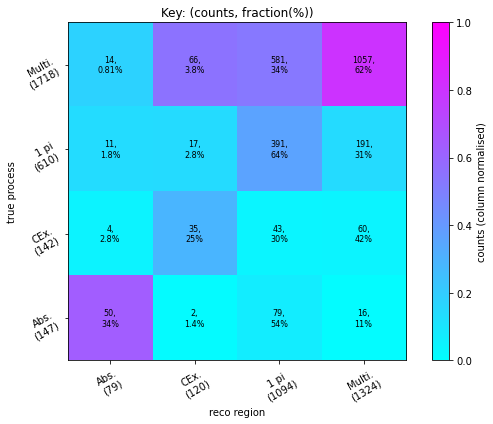

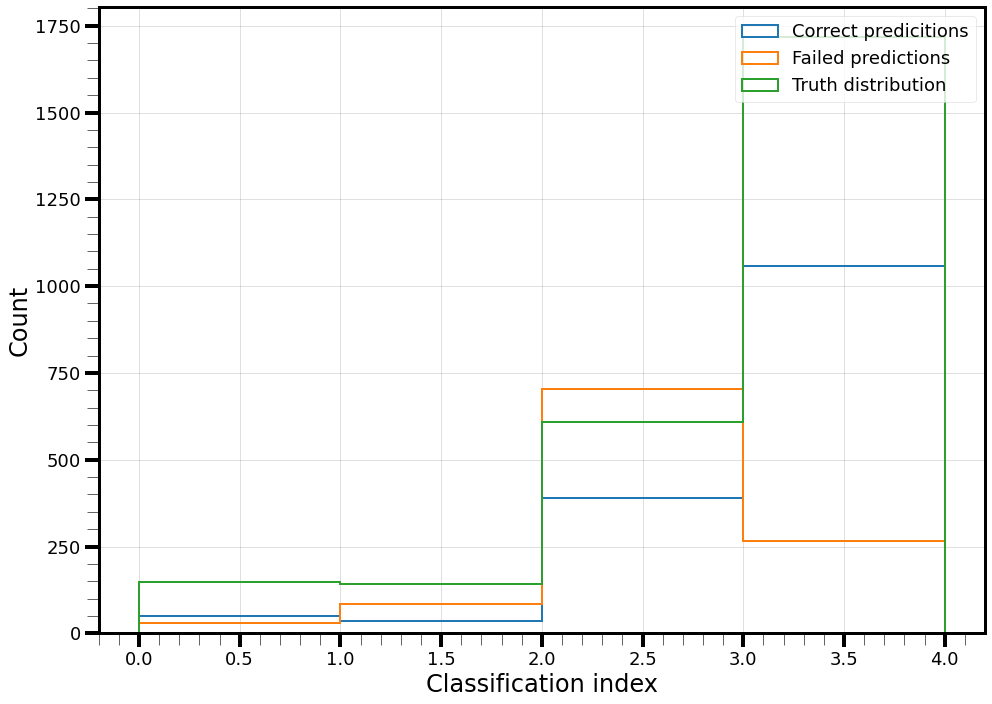

(array([3, 3, 3, ..., 2, 1, 2]), array([3., 3., 3., ..., 2., 3., 3.]))

In [22]:
Models.evaluate_model(
    # loaded_model,
    empty_test_model,
    data_path_params["schema_path"],
    data_path_params["test_path"],
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."],
    plot_config=plt_conf)

82/82 [==============================] - 2s 9ms/step
2617 events searched.
1533 events correctly classified (1084 false), for an efficiency of 58.58%.
For Abs.: 34.01% efficiency, 63.29% purity (product: 21.53%).
For CEx.: 24.65% efficiency, 29.17% purity (product: 7.19%).
For 1 pi: 64.10% efficiency, 35.74% purity (product: 22.91%).
For Multi.: 61.53% efficiency, 79.83% purity (product: 49.12%).



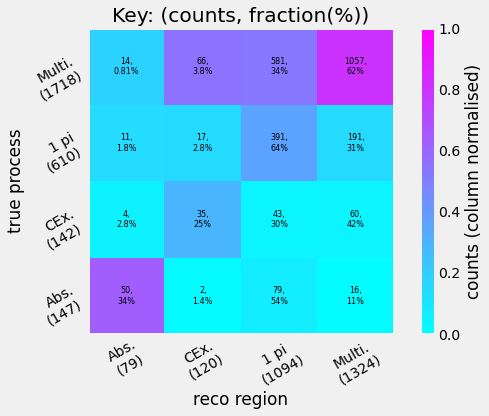

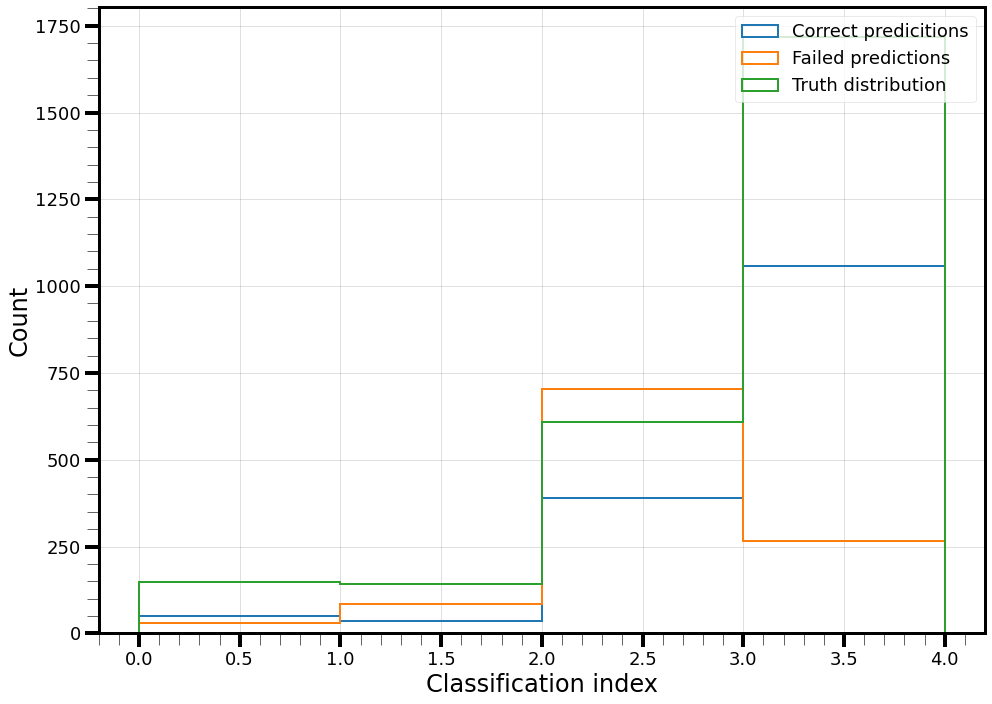

(array([3, 3, 3, ..., 2, 1, 2]), array([3., 3., 3., ..., 2., 3., 3.]))

In [23]:
Models.evaluate_model(
    # loaded_model,
    data_model,
    data_path_params["schema_path"],
    data_path_params["test_path"],
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."],
    plot_config=plt_conf)

82/82 [==============================] - 2s 9ms/step


/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py:802: RuntimeWarning: invalid value encountered in scalar divide
  purity = (100*np.sum(truth_index[pred_index==i] == i)
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/apps/cex_toy_parameters.py:164: RuntimeWarning: invalid value encountered in divide
  Plots.plt.imshow(counts/np.sum(counts, axis = 0), cmap = "cool", vmin=0., vmax=1., origin = "lower")


2617 events searched.
712 events correctly classified (1905 false), for an efficiency of 27.21%.
For Abs.: 0.00% efficiency, nan% purity (product: nan%).
For CEx.: 0.00% efficiency, nan% purity (product: nan%).
For 1 pi: 96.72% efficiency, 24.04% purity (product: 23.25%).
For Multi.: 7.10% efficiency, 74.85% purity (product: 5.32%).



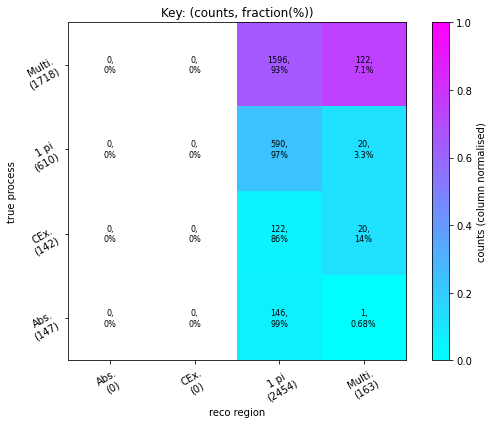

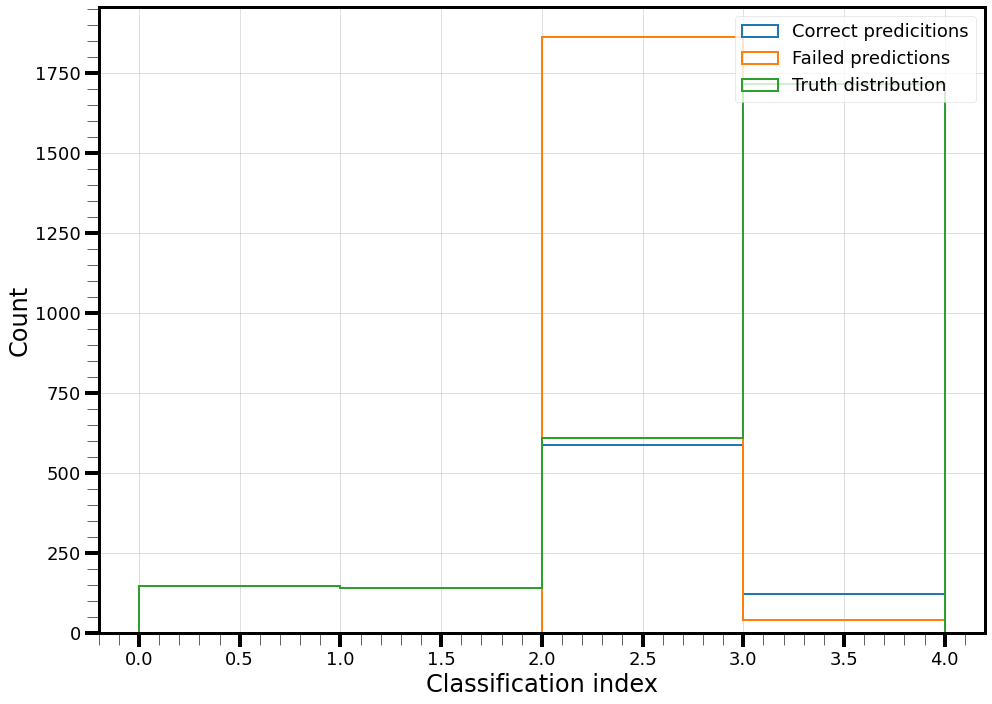

(array([2, 2, 2, ..., 2, 2, 2]), array([3., 3., 3., ..., 2., 3., 3.]))

In [11]:
Models.evaluate_model(
    # loaded_model,
    data_model,
    data_path_params["schema_path"],
    data_path_params["test_path"],
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."],
    plot_config=plt_conf)

In [66]:
train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(data_hyper_params)
model_input_graph_spec = Models.get_spec_from_hyper_params(data_hyper_params)
beam_model_data = build_evt_classifer_model_data_with_momentum(
    model_input_graph_spec,
    # Dimensions of initial states.
    beam_dim=16,
    node_dim=16,
    mom_dim=18,
    beam_edge_dim=16,
    edge_dim=16,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=128,
    # Dimensions for message passing.
    message_dim=32,
    next_state_dim=32,
    beam_message_dim=16,
    beam_next_dim=16,
    edge_next_dim=32,
    beam_edge_next_dim=16,
    # Dimension for the logits.
    final_layers = 2,
    final_layer_nodes = 32,
    num_classes=4,
    # Readout from nodes
    node_readout_hidden_layers = 2,
    node_readout_hidden_nodes = 64,
    node_readout_final = 0,
    # Readout from edges
    edge_readout_hidden_layers = 2,
    edge_readout_hidden_nodes = 64,
    edge_readout_final = 0,
    # Number of message passing steps.
    num_message_passing=2,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.2,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
)

In [15]:
"""With pi0 MC save multiple loss version"""
train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(mc_truth_hyper_params)
model_input_graph_spec = Models.get_spec_from_hyper_params(mc_truth_hyper_params)

beam_model_mc_with_pi0 = build_evt_classifer_model_mc_counts(
    model_input_graph_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=8,
    edge_dim=4,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=8,
    # Dimensions for message passing.
    message_dim=8,
    next_state_dim=8,
    beam_message_dim=8,
    beam_next_dim=8,
    edge_next_dim=4,
    beam_edge_next_dim=4,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=1,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.0,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
)

NameError: name 'mc_truth_hyper_params' is not defined

In [10]:
"""BT Residuals, multiple loss version, GATv2"""
train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(bt_hyper_params)
model_input_graph_spec = Models.get_spec_from_hyper_params(bt_hyper_params)

bt_model = build_evt_classifer_model_mc_counts_pid_residual_gat(#build_evt_classifer_model_mc_counts_pi0_id_residual
    model_input_graph_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=4,
    edge_dim=4,
    beam_node_dim=8,
    # Node setup
    n_node_layers=3,
    n_node_hidden_depth=64,
    # Dimensions for message passing.
    message_heads=8,
    message_channels=4,
    beam_message_heads=8,
    beam_message_channels=4,
    # edge_readout_dim=16,
    # edge_readout_hidden_layers=2,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Classificatino only layer after regression readout
    class_readout_dim=16,
    # Number of message passing steps.
    num_message_passing=2,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.1,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
)

In [10]:
"""BT Residuals, multiple loss version"""
train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(bt_hyper_params)
model_input_graph_spec = Models.get_spec_from_hyper_params(bt_hyper_params)

bt_model = build_evt_classifer_model_mc_counts_pid_residual(#build_evt_classifer_model_mc_counts_pi0_id_residual
    model_input_graph_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=4,
    edge_dim=4,
    beam_node_dim=8,
    # Node setup
    n_node_layers=3,
    n_node_hidden_depth=64,
    # Dimensions for message passing.
    message_dim=32,
    beam_message_dim=8,
    # edge_readout_dim=16,
    # edge_readout_hidden_layers=2,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Classificatino only layer after regression readout
    class_readout_dim=16,
    # Number of message passing steps.
    num_message_passing=2,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.1,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
)

In [37]:
"""MC Residuals, multiple loss version"""
train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(mc_truth_hyper_params)
model_input_graph_spec = Models.get_spec_from_hyper_params(mc_truth_hyper_params)

beam_model_mc = build_evt_classifer_model_mc_counts_pi0_id_residual(
    model_input_graph_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=4,
    edge_dim=4,
    beam_node_dim=8,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=8,
    # Dimensions for message passing.
    message_dim=32,
    beam_message_dim=8,
    # edge_readout_dim=16,
    # edge_readout_hidden_layers=2,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Classificatino only layer after regression readout
    class_readout_dim=16,
    # Number of message passing steps.
    num_message_passing=2,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.0,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
)

In [73]:
"""Multiple loss version"""
train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(mc_truth_hyper_params)
model_input_graph_spec = Models.get_spec_from_hyper_params(mc_truth_hyper_params)

beam_model_mc = build_evt_classifer_model_mc_counts_pi0_id(
    model_input_graph_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=4,
    edge_dim=4,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=8,
    # Dimensions for message passing.
    message_dim=32,
    next_state_dim=8,
    beam_message_dim=8,
    beam_next_dim=8,
    edge_next_dim=4,
    beam_edge_next_dim=4,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Classificatino only layer after regression readout
    class_readout_dim=16,
    # Number of message passing steps.
    num_message_passing=2,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.0,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
)

In [136]:
"""Single loss version"""
train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(mc_truth_hyper_params)
model_input_graph_spec = Models.get_spec_from_hyper_params(mc_truth_hyper_params)
# beam_model_mc = build_evt_classifer_model_data_with_momentum(
#     model_input_graph_spec,
#     # Dimensions of initial states.
#     beam_dim=16,
#     node_dim=16,
#     mom_dim=18,
#     beam_edge_dim=16,
#     edge_dim=16,
#     # Node setup
#     n_node_layers=0,
#     n_node_hidden_depth=128,
#     # Dimensions for message passing.
#     message_dim=32,
#     next_state_dim=32,
#     beam_message_dim=16,
#     beam_next_dim=16,
#     edge_next_dim=32,
#     beam_edge_next_dim=16,
#     # Dimension for the logits.
#     final_layers = 2,
#     final_layer_nodes = 32,
#     num_classes=4,
#     # Readout from nodes
#     node_readout_hidden_layers = 2,
#     node_readout_hidden_nodes = 64,
#     node_readout_final = 0,
#     # Readout from edges
#     edge_readout_hidden_layers = 2,
#     edge_readout_hidden_nodes = 64,
#     edge_readout_final = 0,
#     # Number of message passing steps.
#     num_message_passing=0,
#     # Other hyperparameters.
#     l2_regularization=8e-5,
#     dropout_rate=0.2,
#     # # Names of sets to use
#     # node_sets_name="pfo",
#     # edge_sets_name="neighbours"
# )

beam_model_mc = build_evt_classifer_model_simple_mc(
    model_input_graph_spec,
    # Dimensions of initial states.
    node_dim=8,
    beam_edge_dim=8,
    edge_dim=4,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=8,
    # Dimensions for message passing.
    message_dim=8,
    next_state_dim=8,
    beam_message_dim=8,
    beam_next_dim=8,
    edge_next_dim=4,
    beam_edge_next_dim=4,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=1,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.0,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
)

In [52]:
train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(bt_truth_hyper_params)
model_input_graph_spec = Models.get_spec_from_hyper_params(bt_truth_hyper_params)
beam_model_truth = build_evt_classifer_model_data_with_momentum(
    model_input_graph_spec,
    # Dimensions of initial states.
    beam_dim=16,
    node_dim=16,
    mom_dim=18,
    beam_edge_dim=16,
    edge_dim=16,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=128,
    # Dimensions for message passing.
    message_dim=32,
    next_state_dim=32,
    beam_message_dim=16,
    beam_next_dim=16,
    edge_next_dim=32,
    beam_edge_next_dim=16,
    # Dimension for the logits.
    final_layers = 2,
    final_layer_nodes = 32,
    num_classes=4,
    # Readout from nodes
    node_readout_hidden_layers = 2,
    node_readout_hidden_nodes = 64,
    node_readout_final = 0,
    # Readout from edges
    edge_readout_hidden_layers = 2,
    edge_readout_hidden_nodes = 64,
    edge_readout_final = 0,
    # Number of message passing steps.
    num_message_passing=2,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.2,
    # # Names of sets to use
    # node_sets_name="pfo",
    # edge_sets_name="neighbours"
)
# base_model_truth = build_evt_classifer_model(
#     model_input_graph_spec,
#     edge_dim=4,
#     num_message_passing=3,
#     message_dim=32,
#     next_state_dim=32,
#     final_layers=3,
#     final_layer_nodes = 16, num_classes=4)


In [13]:
data_76_hist_init = Models.compile_and_train(data_model, data_hyper_params_init_train, train_ds_batched, val_ds_batched, partial_train=True)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [()]                         0         []                            
                                                                                                  
 input.merge_batch_to_compo  ()                           0         ['input_1[0][0]']             
 nents (InstanceMethod)                                                                           
                                                                                                  
 map_features (MapFeatures)  ()                           9800      ['input.merge_batch_to_compone
                                                                    nts[0][0]']                   
                                                                                              

In [201]:
data_84_hist = Models.compile_and_train(data_model, data_hyper_params, train_ds_batched, val_ds_batched)

Model: "model_372"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_398 (InputLayer)      [()]                         0         []                            
                                                                                                  
 input.merge_batch_to_compo  ()                           0         ['input_398[0][0]']           
 nents_1 (InstanceMethod)                                                                         
                                                                                                  
 map_features_307 (MapFeatu  ()                           0         ['input.merge_batch_to_compone
 res)                                                               nts_1[0][0]']                 
                                                                                          

In [11]:
bt_truth_80_hist = Models.compile_and_train(bt_model, bt_hyper_params, train_ds_batched, val_ds_batched)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [()]                         0         []                            
                                                                                                  
 input.merge_batch_to_compo  ()                           0         ['input_1[0][0]']             
 nents (InstanceMethod)                                                                           
                                                                                                  
 map_features (MapFeatures)  ()                           9440      ['input.merge_batch_to_compone
                                                                    nts[0][0]']                   
                                                                                              

/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/tensorflow/python/saved_model/nested_structure_coder.py:458: UserWarning: Encoding a StructuredValue with type tensorflow_gnn.GraphTensorSpec; loading this StructuredValue will require that this type be imported and registered.
  warnings.warn("Encoding a StructuredValue with type %s; loading this "
/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/tensorflow/python/saved_model/nested_structure_coder.py:458: UserWarning: Encoding a StructuredValue with type tensorflow_gnn.ContextSpec.v2; loading this StructuredValue will require that this type be imported and registered.
  warnings.warn("Encoding a StructuredValue with type %s; loading this "
/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/tensorflow/python/saved_model/nested_structure_coder.py:458: UserWarning: Encoding a StructuredValue with type tensorflow_gnn.NodeSetSpec; loading this StructuredValue will requ

INFO:tensorflow:Assets written to: /users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/truth_models/Model_truth_80_multi_loss_reco_classification_reco_pfo_data_GATv2_early_pid/model.tf/assets


INFO:tensorflow:Assets written to: /users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/truth_models/Model_truth_80_multi_loss_reco_classification_reco_pfo_data_GATv2_early_pid/model.tf/assets


In [22]:
train_ds_data_only_batched, val_ds_data_only_batched = get_data_only_ds(mc_truth_hyper_params)

In [23]:
input_graph = train_ds_data_only_batched.take(1).get_single_element()
print(input_graph)

GraphTensor(
  context=Context(features={'classification': <tf.Tensor: shape=(32, 1, 4), dtype=tf.float32>, 'mc_pi0s': <tf.Tensor: shape=(32, 1, 1), dtype=tf.float32>, 'mc_photons': <tf.Tensor: shape=(32, 1, 1), dtype=tf.float32>, 'mc_pions': <tf.Tensor: shape=(32, 1, 1), dtype=tf.float32>}, sizes=[[1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]], shape=(32,), indices_dtype=tf.int32),
  node_set_names=['beam', 'pfo'],
  edge_set_names=['beam_connections', 'neighbours'])


In [24]:
graph = input_graph.merge_batch_to_components()
print(graph)

GraphTensor(
  context=Context(features={'classification': <tf.Tensor: shape=(32, 4), dtype=tf.float32>, 'mc_pi0s': <tf.Tensor: shape=(32, 1), dtype=tf.float32>, 'mc_photons': <tf.Tensor: shape=(32, 1), dtype=tf.float32>, 'mc_pions': <tf.Tensor: shape=(32, 1), dtype=tf.float32>}, sizes=[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1], shape=(), indices_dtype=tf.int32),
  node_set_names=['beam', 'pfo'],
  edge_set_names=['beam_connections', 'neighbours'])


In [26]:
print(input_graph.edge_sets["neighbours"].features["true_pi0"])

<tf.RaggedTensor [[[0.0],
  [0.0],
  [0.0],
  ...,
  [0.0],
  [0.0],
  [1.0]], [[0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0.0],
           [0

In [25]:
print(graph.edge_sets["neighbours"].features["true_pi0"])

tf.Tensor(
[[0.]
 [0.]
 [0.]
 ...
 [0.]
 [0.]
 [1.]], shape=(14764, 1), dtype=float32)


In [34]:
node_dim=8
beam_edge_dim=8
edge_dim=4
# Node setup
n_node_layers=1
n_node_hidden_depth=8
# Dimensions for message passing
message_dim=8
next_state_dim=8
beam_message_dim=8
beam_next_dim=8
edge_next_dim=4
beam_edge_next_dim=4
# Dimension for the logits
final_hidden_layers = 0
final_layer_nodes = 16
num_classes=4
# Number of message passing steps
num_message_passing=0
# Other hyperparameters
l2_regularization=8e-5
dropout_rate=0.0

In [35]:
# This helper function is just a short-hand for the code below.
def dense(units, activation="relu"):
  """A Dense layer with regularization (L2 and Dropout)."""
  regularizer = tf.keras.regularizers.l2(l2_regularization)
  return tf.keras.Sequential([
      tf.keras.layers.Dense(
          units,
          activation=activation,
          kernel_regularizer=regularizer,
          bias_regularizer=regularizer),
      tf.keras.layers.Dropout(dropout_rate)
  ])

def make_node_internal(node_input):
  res = node_input
  for _ in range(n_node_layers):
    res = dense(n_node_hidden_depth)(res)
  return tf.keras.layers.Dense(node_dim)(res)
# Nodes and edges have one-hot encoded input features. Sending them through
# a Dense layer effectively does a lookup in a trainable embedding table.
def set_initial_node_state(node_set, node_set_name):
  if node_set_name == "beam":
    return tfgnn.keras.layers.MakeEmptyFeature()(node_set)
  return make_node_internal(node_set[tfgnn.HIDDEN_STATE])
def set_initial_edge_state(edge_set, edge_set_name):
  if edge_set_name == "beam_connections":
    return tf.keras.layers.Dense(beam_edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
  return tf.keras.layers.Dense(edge_dim)(edge_set[tfgnn.HIDDEN_STATE])
# print(graph)

mapped_graph = tfgnn.keras.layers.MapFeatures(
    node_sets_fn=set_initial_node_state, edge_sets_fn=set_initial_edge_state)(
        graph)



In [37]:
mapped_graph.edge_sets["neighbours"]

EdgeSet(features={'hidden_state': <tf.Tensor: shape=(14764, 4), dtype=tf.float32>}, sizes=[1560  306  930  182 1056   56  210  182   20   30  342  870  210  992
   12  930  506  342  210   90  380  506  870  132  110  930  182   90
  380  992  650  506], adjacency=Adjacency(source=('pfo', <tf.Tensor: shape=(14764,), dtype=tf.int32>), target=('pfo', <tf.Tensor: shape=(14764,), dtype=tf.int32>)))

In [5]:
def pfo_update_layer():
  pfo_node_update = tfgnn.keras.layers.GraphUpdate(
    node_sets={
      "pfo": tfgnn.keras.layers.NodeSetUpdate(
        {"neighbours": tfgnn.keras.layers.SimpleConv(
          sender_edge_feature=tfgnn.HIDDEN_STATE,
          message_fn=dense(message_dim),
          reduce_type="sum",
          receiver_tag=tfgnn.TARGET)},
        tfgnn.keras.layers.NextStateFromConcat(dense(next_state_dim)))})
  return pfo_node_update

def beam_collection_layer():
  # beam_collection_update = tfgnn.keras.layers.GraphUpdate(
  #   node_sets={
  #     "beam": tfgnn.keras.layers.NodeSetUpdate(
  #       {"beam_connections": tfgnn.models.gat_v2.GATv2Conv(
  #         num_heads = 4,
  #         per_head_channels = 4,
  #         receiver_tag = tfgnn.SOURCE,
  #         receiver_feature = tfgnn.HIDDEN_STATE,
  #         sender_node_feature = tfgnn.HIDDEN_STATE,
  #         sender_edge_feature = tfgnn.HIDDEN_STATE,
  #         use_bias = False,
  #         edge_dropout = dropout_rate,
  #         attention_activation = 'leaky_relu',
  #         heads_merge_type = 'concat',
  #         activation = 'relu')},
  #       tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
  beam_collection_update = tfgnn.keras.layers.GraphUpdate(
    node_sets={
      "beam": tfgnn.keras.layers.NodeSetUpdate(
        {"beam_connections": tfgnn.keras.layers.SimpleConv(
          sender_edge_feature=tfgnn.HIDDEN_STATE,
          message_fn=dense(beam_message_dim),
          reduce_type="sum",
          receiver_tag=tfgnn.SOURCE)},
        tfgnn.keras.layers.NextStateFromConcat(dense(beam_next_dim)))})
  return beam_collection_update

def neighbour_update_layer():
  neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
    edge_sets={
      "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
        tfgnn.keras.layers.NextStateFromConcat(dense(edge_next_dim))
      )})
  return neighbours_edge_update

def beam_conn_update_layer():
  beam_conn_edge_update = tfgnn.keras.layers.GraphUpdate(
    edge_sets={
      "beam_connections": tfgnn.keras.layers.EdgeSetUpdate(
        tfgnn.keras.layers.NextStateFromConcat(dense(beam_edge_next_dim))
      )})
  return beam_conn_edge_update

# def pfo_classifier_layer_and_readout():
#   def classifier_layer(node_set, node_set_name):
#     if node_set_name == "pfo":
#       return tf.keras.layers.Dense(1)(node_set[tfgnn.HIDDEN_STATE])(node_set)
#     return node_set
#   classifier = tfgnn.keras.layers.MapFeatures(
#       node_sets_fn=classifier_layer)
#   readout_layer = tfgnn.keras.layers.Readout(node_set_name="pfo")
#   def combined_layer(graph):
#     return readout_layer(classifier(graph))
#   return combined_layer
# def pfo_classifier_layer_and_readout():
#   def the_layer(graph)
#     return tf.keras.layers.Dense(1)(graph.node_sets["pfo"][tfgnn.HIDDEN_STATE])
#   return the_layer

def edge_classifier_layer_and_readout():
  def classifier_layer(edge_set, edge_set_name):
    if edge_set_name == "neighbours":
      features = edge_set.get_features_dict()
      features["edge_readout"] = tf.keras.layers.Dense(1, activation="sigmoid")(edge_set[tfgnn.HIDDEN_STATE])
      return features
    return None
  classifier = tfgnn.keras.layers.MapFeatures(
      edge_sets_fn=classifier_layer)#set_initial_edge_state)
  readout_layer = tfgnn.keras.layers.Readout(edge_set_name="neighbours")
  def combined_layer(graph):
    # print(classifier(graph).edge_sets["neighbours"].feautres)
    return classifier(graph).edge_sets["neighbours"].features["edge_readout"]#readout_layer(classifier(graph))
  return combined_layer
# def edge_classifier_layer_and_readout():
#   def the_layer(graph)
#     return tf.keras.layers.Dense(1)(graph.edge_sets["neighbours"][tfgnn.HIDDEN_STATE])
#   return the_layer

In [39]:
graph_step_1 = beam_collection_layer()(mapped_graph)
graph_step_1.edge_sets["neighbours"]

EdgeSet(features={'hidden_state': <tf.Tensor: shape=(14764, 4), dtype=tf.float32>}, sizes=[1560  306  930  182 1056   56  210  182   20   30  342  870  210  992
   12  930  506  342  210   90  380  506  870  132  110  930  182   90
  380  992  650  506], adjacency=Adjacency(source=('pfo', <tf.Tensor: shape=(14764,), dtype=tf.int32>), target=('pfo', <tf.Tensor: shape=(14764,), dtype=tf.int32>)))

In [40]:
graph_mp = graph_step_1
for i in range(1):
  graph_mp = pfo_update_layer()(graph_mp)
  if i < num_message_passing - 1:
    graph_mp = neighbour_update_layer()(graph_mp)
  graph_mp = beam_collection_layer()(graph_mp)
  # if i < num_message_passing - 1:
  #   graph = momentum_gather_layer()(graph)
graph_mp.edge_sets["neighbours"]

EdgeSet(features={'hidden_state': <tf.Tensor: shape=(14764, 4), dtype=tf.float32>}, sizes=[1560  306  930  182 1056   56  210  182   20   30  342  870  210  992
   12  930  506  342  210   90  380  506  870  132  110  930  182   90
  380  992  650  506], adjacency=Adjacency(source=('pfo', <tf.Tensor: shape=(14764,), dtype=tf.int32>), target=('pfo', <tf.Tensor: shape=(14764,), dtype=tf.int32>)))

In [44]:
def final_neighbour_update_layer():
  neighbours_edge_update = tfgnn.keras.layers.GraphUpdate(
    edge_sets={
      "neighbours": tfgnn.keras.layers.EdgeSetUpdate(
        tfgnn.keras.layers.NextStateFromConcat(tf.keras.layers.Dense(1, activation="sigmoid"))
      )})
  return neighbours_edge_update

In [43]:
graph_mp.edge_sets["neighbours"].features[tfgnn.HIDDEN_STATE]

<tf.Tensor: shape=(14764, 4), dtype=float32, numpy=
array([[-1.91427597e+02,  3.89322998e+02,  5.96318054e+01,
         3.98913217e+00],
       [-3.31488068e+02,  6.78920532e+02,  1.03150024e+02,
         3.58046937e+00],
       [-3.38815826e+02,  6.94130005e+02,  1.05423409e+02,
         3.52129030e+00],
       ...,
       [ 2.60808915e-01,  4.33002949e-01, -3.66473556e-01,
        -2.96822429e-01],
       [ 2.62161165e-01,  4.30196226e-01, -3.66893083e-01,
        -2.96811491e-01],
       [-1.35031074e-01,  1.07607532e+00,  5.38886487e-02,
        -6.04342818e-01]], dtype=float32)>

In [45]:
neighbour_readout_graph = final_neighbour_update_layer()(graph_mp)
neighbour_readout_graph.edge_sets["neighbours"].features[tfgnn.HIDDEN_STATE]

<tf.Tensor: shape=(14764, 1), dtype=float32, numpy=
array([[1.],
       [1.],
       [1.],
       ...,
       [1.],
       [1.],
       [1.]], dtype=float32)>

In [46]:
neighbour_readout_graph.edge_sets["neighbours"].sizes

<tf.Tensor: shape=(32,), dtype=int32, numpy=
array([1560,  306,  930,  182, 1056,   56,  210,  182,   20,   30,  342,
        870,  210,  992,   12,  930,  506,  342,  210,   90,  380,  506,
        870,  132,  110,  930,  182,   90,  380,  992,  650,  506],
      dtype=int32)>

In [47]:
neighbour_readout_ragged = tf.RaggedTensor.from_row_lengths(
    values=neighbour_readout_graph.edge_sets["neighbours"].features[tfgnn.HIDDEN_STATE],
    row_lengths=neighbour_readout_graph.edge_sets["neighbours"].sizes)

In [48]:
neighbour_readout_ragged

<tf.RaggedTensor [[[1.0],
  [1.0],
  [1.0],
  ...,
  [1.0],
  [1.0],
  [1.0]], [[1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1.0],
           [1

In [41]:
neighbour_readout_pi0 = edge_classifier_layer_and_readout()
pi0_id_logits = neighbour_readout_pi0(graph_mp)

{'hidden_state': <KerasTensor: shape=(14764, 4) dtype=float32 (created by layer 'input.get_features_dict')>, 'edge_readout': <KerasTensor: shape=(14764, 1) dtype=float32 (created by layer 'dense_17')>}


In [42]:
pi0_id_logits

<tf.Tensor: shape=(14764, 1), dtype=float32, numpy=
array([[1.        ],
       [1.        ],
       [1.        ],
       ...,
       [0.47281888],
       [0.4720153 ],
       [0.66927856]], dtype=float32)>

In [76]:
test_input_1, (test_class_1, test_pions_1, test_pi0s_1, test_pi0_ids_1) = testing_train_batched.take(1).get_single_element()
# test_input_1, test_labels_1 = testing_train_batched.take(1).get_single_element()

In [75]:
testing_train_batched, testing_val_batched = test_load_data_from_hyper_params_pre_batch(mc_truth_hyper_params)

Batched, with suffle, all losses pre-batching
Batched, with suffle, no losses pre-batching
Losses pre-batching
Shuffle, batched, no post batching labels


In [74]:
"""Batched, with suffle, all losses post batching version"""
def test_load_data_from_hyper_params_pre_batch(hyper_params):
    print("Batched, with suffle, all losses pre-batching")
    if ((hyper_params["data_folder"] is None)
        or (hyper_params["training_batch"] is None)):
        raise ValueError("Hyper-parameters do not contain data details")
    data_paths = DataPreparation.create_filepath_dictionary(
        hyper_params["data_folder"])
    train_ds, val_ds = load_record_pre_batch(
        data_paths["schema_path"],
        [data_paths["train_path"], data_paths["val_path"]],
        extra_losses=hyper_params["extra_losses"])
    # return train_ds, val_ds
    return format_data_pre_batch(train_ds, val_ds,
                       hyper_params["training_batch"],
                       hyper_params["training_shuffle"],
                       extra_losses=hyper_params["extra_losses"])

def format_data_pre_batch(train, val, batch_size=32, shuffle_size=128, extra_losses=None):
    print("Shuffle, batched, no post batching labels")
    if shuffle_size is not None:
        train = train.shuffle(buffer_size=shuffle_size)
    train_batched = train.ragged_batch(batch_size=batch_size).repeat()
    val_batched = val.ragged_batch(batch_size=batch_size)
    return train_batched, val_batched

def load_record_pre_batch(schema_path, record_path, no_label=False, extra_losses=None):
    print("Batched, with suffle, no losses pre-batching")
    decode_func = _make_decode_func_pre_batch(schema_path, extra_losses)
    if isinstance(record_path, str):
        datasets = tf.data.TFRecordDataset([record_path]).map(decode_func)
        if no_label:
            datasets = datasets.map(_get_data_only)
    else: # we iterate through record paths to get multiple datasets
        datasets = tuple(tf.data.TFRecordDataset([path]).map(decode_func)
                         for path in record_path)
        if not isinstance(no_label, bool):
            # Only remove label if the no_label is true at the index
            datasets = tuple(ds.map(_get_data_only)
                             if no_label[i] else ds
                             for i, ds in enumerate(datasets))
        elif no_label:
            datasets = tuple(ds.map(_get_data_only) for ds in datasets)
    return datasets

def _make_decode_func_pre_batch(schema_path, extra_losses=None):
    """Create a decoding function to parse records"""
    print("Losses pre-batching")
    graph_spec = tfgnn.create_graph_spec_from_schema_pb(
        tfgnn.read_schema(schema_path))
    class_shape = graph_spec.context_spec["classification"].shape

    if (len(class_shape) > 1) and (class_shape[0] == 1):
        # If using a vector, want to remove the first dimension
        class_label = lambda graph_context: tf.squeeze(
            graph_context.pop('classification'), axis=0)
    else:
        class_label = lambda graph_context: graph_context.pop(
            'classification')
    if extra_losses is None:
        def append_extra_losses(graph, label):
            return graph, label
    else:
        def append_extra_losses(graph, label):
            labels = [label]
            context_values = ["mc_pions", "mc_photons", "mc_pi0s", "bt_pions",
                              "bt_photons", "bt_pi0s"]
            pfo_values = [
                "beam_daughter", "beam_granddaughter", "pi0_granddaughter",
                "beam_related", "beam_relevant", "pion", "photon",
                "beam_pion", "beam_photon"]
            neighbour_values = ["true_pi0", "beam_pi0"]
            new_context = graph.context.get_features_dict()
    #         # new_nodes = graph.
    #         # new_edges = graph.
            for loss in extra_losses:
                if loss in context_values:
                    info = new_context.pop(loss)# tf.squeeze(
                        # new_context.pop(loss), axis=0)
                    labels.append(info)
                elif loss in pfo_values:
                    info = tfgnn.keras.layers.Readout(
                        node_set_name="pfo", feature_name=loss)(graph)
                    labels.append(info)
                elif loss in neighbour_values:
                    info = tfgnn.keras.layers.Readout(
                        edge_set_name="neighbours", feature_name=loss)(graph)
                    labels.append(info)
                else:
                    labels.append(None)
            new_graph = graph.replace_features(context=new_context)
            return new_graph, tuple(labels)
    def decode_func(record_bytes):
        graph = tfgnn.parse_single_example(graph_spec,
                                            record_bytes,
                                            validate=True)
        # Extract the classification sperately as truth data
        graph_context = graph.context.get_features_dict()
        label = class_label(graph_context)
        new_graph = graph.replace_features(context=graph_context)
        return append_extra_losses(new_graph, label)
    return decode_func

In [ ]:
# pi0_edge_readout = tfgnn.keras.layers.Readout(edge_set_name="neighbours")(graph)
# pi0_id_logits = tf.keras.layers.Dense(1)(pi0_edge_readout)

# After the GNN has computed a context-aware representation of the "atoms",
# the model reads out a representation for the graph as a whole by averaging
# (pooling) nde states into the graph context. The context is global to each
# input graph of the batch, so the first dimension of the result corresponds
# to the batch dimension of the inputs (same as the labels).
# readout_features = tfgnn.keras.layers.Pool(
#     tfgnn.CONTEXT, "mean", node_set_name="beam")(graph)
# readout_features = graph.node_sets["beam"][tfgnn.HIDDEN_STATE]
readout_features = tfgnn.keras.layers.Readout(node_set_name="beam")(graph)
# print(readout_features)

for _ in range(final_hidden_layers):
  # readout_features = tf.keras.layers.Dense(final_layer_nodes)(readout_features)
  readout_features = dense(final_layer_nodes)(readout_features)

# Put a linear classifier on top (not followed by dropout).
middle_readout = tf.keras.layers.Dense(16)(readout_features)
logits = tf.keras.layers.Dense(num_classes)(middle_readout)

pion_counts = tf.keras.layers.Dense(1)(readout_features)
pi0_counts = tf.keras.layers.Dense(1)(readout_features)

In [93]:
test_model = build_evt_classifer_model_mc_test_pi0_id_only(model_input_graph_spec,
    # Dimensions of initial states.
    node_dim=16,#8,
    beam_edge_dim=16,#8,
    edge_dim=8,#4,
    # Node setup
    n_node_layers=1,
    n_node_hidden_depth=16,#8,
    # Dimensions for message passing.
    message_dim=32,#8,
    next_state_dim=32,#8,
    beam_message_dim=8,
    beam_next_dim=8,
    edge_next_dim=16,#4,
    beam_edge_next_dim=16,#4,
    # Dimension for the logits.
    final_hidden_layers = 0,
    final_layer_nodes = 16,
    num_classes=4,
    # Number of message passing steps.
    num_message_passing=4,
    # Other hyperparameters.
    l2_regularization=8e-5,
    dropout_rate=0.0)

In [21]:
testing_hyper_params = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mc_truth_no_pi0_models/XXX_TEST_batched_shuffle_attempt_sigmoid_output_MP_steps_focal_0.95_alpha",
    tf.keras.losses.BinaryFocalCrossentropy(alpha=0.95,from_logits=False),#edge_only_loss,#loss,
    [tf.keras.metrics.BinaryCrossentropy(), tf.keras.metrics.BinaryAccuracy()],#pfo_class_metrics,#metrics,
    callbacks,
    1e-4,
    2048,
    512,
    extra_losses = ["mc_pions", "mc_pi0s", "true_pi0"],
    # loss_weights=[1, 1e-3, 1e-3, 1e-3],
    # class_weights={0: 1.2, 1: 3., 2:1., 3:1.},
    data_folder=mc_path_params["folder_path"],
    training_batch=32,
    training_shuffle=1024)
train_ds_test, val_ds_test = Models.load_data_from_hyper_params(testing_hyper_params)

In [57]:
train_ds_batched, val_ds_batched = test_load_data_from_hyper_params(mc_truth_hyper_params)

Batched, with suffle, all losses post batching
Batched, with suffle, no losses pre-batching
No losses pre-batching
Shuffle, batched, no post batching labels
Batched, with suffle, all losses post batching


In [64]:
test_train_ds, _ = test_load_data_from_hyper_params(testing_hyper_params)

Batchless
Batchless
Edges only


In [52]:
data_paths = DataPreparation.create_filepath_dictionary(
    mc_truth_hyper_params["data_folder"])
mid_train_ds, mid_val_ds = load_record(
    data_paths["schema_path"],
    [data_paths["train_path"], data_paths["val_path"]],
    extra_losses=mc_truth_hyper_params["extra_losses"])

In [21]:
def get_data_only_ds(hyper_params):
    data_paths = DataPreparation.create_filepath_dictionary(
        hyper_params["data_folder"])
    graph_spec = tfgnn.create_graph_spec_from_schema_pb(
        tfgnn.read_schema(data_paths["schema_path"]))
    def data_only_decode_func(record_bytes):
        graph = tfgnn.parse_single_example(graph_spec,
                                            record_bytes,
                                            validate=True)
        return graph
    train = tf.data.TFRecordDataset([data_paths["train_path"]]).map(data_only_decode_func)
    val = tf.data.TFRecordDataset([data_paths["val_path"]]).map(data_only_decode_func)
    if hyper_params["training_shuffle"] is not None:
        train = train.shuffle(buffer_size=hyper_params["training_shuffle"])
    train_batched = train.batch(batch_size=hyper_params["training_batch"]).repeat()
    val_batched = val.batch(batch_size=hyper_params["training_batch"])
    return train_batched, val_batched

In [17]:
"""Batchless version"""
def test_load_data_from_hyper_params(hyper_params):
    print("Batched, with suffle, no losses post batching")
    if ((hyper_params["data_folder"] is None)
        or (hyper_params["training_batch"] is None)):
        raise ValueError("Hyper-parameters do not contain data details")
    data_paths = DataPreparation.create_filepath_dictionary(
        hyper_params["data_folder"])
    train_ds, val_ds = load_record(
        data_paths["schema_path"],
        [data_paths["train_path"], data_paths["val_path"]],
        extra_losses=hyper_params["extra_losses"])
    # return train_ds, val_ds
    return format_data(train_ds, val_ds,
                       hyper_params["training_batch"],
                       hyper_params["training_shuffle"],
                       extra_losses=hyper_params["extra_losses"])

def format_data(train, val, batch_size=32, shuffle_size=128, extra_losses=None):
    print("Shuffle, batched, no post batching labels")
    if shuffle_size is not None:
        train = train.shuffle(buffer_size=shuffle_size)
    train_batched = train.batch(batch_size=batch_size).repeat()
    val_batched = val.batch(batch_size=batch_size)
    # if extra_losses is not None:
    #     loss_mapper = make_extra_loss_mapper(extra_losses)
    #     train_batched = train_batched.map(loss_mapper)
    #     val_batched = val_batched.map(loss_mapper)        
    # merging_losses = [
    #     "beam_daughter", "beam_granddaughter", "pi0_granddaughter",
    #     "beam_related", "beam_relevant", "pion", "photon",
    #     "beam_pion", "beam_photon", "true_pi0", "beam_pi0"]
    # return_self = lambda d: d
    # return_merged_batch = lambda d: d.merge_batch_to_components()
    # if extra_losses is not None:
    #     loss_updates = [return_self]
    #     for l in extra_losses:
    #         if l in merging_losses:
    #             loss_updates.append(return_merged_batch)
    #         else:
    #             loss_updates.append(return_self)
    #     def update_losses(loss_data):
    #         result = []
    #         for i, data in enumerate(loss_data):
    #             result.append(loss_updates[i](data))
    #         return tuple(result)
    #     train_batched = train_batched.map(lambda x, y: x, update_losses(y))
    #     val_batched = val_batched.map(lambda x, y: x, update_losses(y))
    return train_batched, val_batched

def load_record(schema_path, record_path, no_label=False, extra_losses=None):
    print("Batchless")
    decode_func = _make_decode_func(schema_path, extra_losses)
    if isinstance(record_path, str):
        datasets = tf.data.TFRecordDataset([record_path]).map(decode_func)
        if no_label:
            datasets = datasets.map(_get_data_only)
    else: # we iterate through record paths to get multiple datasets
        datasets = tuple(tf.data.TFRecordDataset([path]).map(decode_func)
                         for path in record_path)
        if not isinstance(no_label, bool):
            # Only remove label if the no_label is true at the index
            datasets = tuple(ds.map(_get_data_only)
                             if no_label[i] else ds
                             for i, ds in enumerate(datasets))
        elif no_label:
            datasets = tuple(ds.map(_get_data_only) for ds in datasets)
    return datasets

def _make_decode_func(schema_path, extra_losses=None):
    """Create a decoding function to parse records"""
    print("Edges only")
    graph_spec = tfgnn.create_graph_spec_from_schema_pb(
        tfgnn.read_schema(schema_path))
    class_shape = graph_spec.context_spec["classification"].shape

    if (len(class_shape) > 1) and (class_shape[0] == 1):
        # If using a vector, want to remove the first dimension
        class_label = lambda graph_context: tf.squeeze(
            graph_context.pop('classification'), axis=0)
    else:
        class_label = lambda graph_context: graph_context.pop(
            'classification')
    if extra_losses is None:
        def append_extra_losses(graph, label):
            return graph, label
    else:
        def append_extra_losses(graph, label):
            labels = [label]
            context_values = ["mc_pions", "mc_photons", "mc_pi0s", "bt_pions",
                              "bt_photons", "bt_pi0s"]
            pfo_values = [
                "beam_daughter", "beam_granddaughter", "pi0_granddaughter",
                "beam_related", "beam_relevant", "pion", "photon",
                "beam_pion", "beam_photon"]
            neighbour_values = ["true_pi0", "beam_pi0"]
            new_context = graph.context.get_features_dict()
    #         # new_nodes = graph.
    #         # new_edges = graph.
            for loss in extra_losses:
                if loss in context_values:
                    info = new_context.pop(loss)# tf.squeeze(
                        # new_context.pop(loss), axis=0)
                    labels.append(info)
                if loss in pfo_values:
                    info = tfgnn.keras.layers.Readout(
                        node_set_name="pfo", feature_name=loss)(graph)
                    labels.append(info)
                if loss in neighbour_values:
                    info = tfgnn.keras.layers.Readout(
                        edge_set_name="neighbours", feature_name=loss)(graph)
                    return graph, info
                    labels.append(info)
                else:
                    labels.append(None)
            new_graph = graph.replace_features(context=new_context)
            return new_graph, tuple(labels)
    def decode_func(record_bytes):
        graph = tfgnn.parse_single_example(graph_spec,
                                            record_bytes,
                                            validate=True)
        # Extract the classification sperately as truth data
        graph_context = graph.context.get_features_dict()
        label = class_label(graph_context)
        new_graph = graph.replace_features(context=graph_context)
        return append_extra_losses(new_graph, label)
    return decode_func

def make_extra_loss_mapper(extra_losses):
    print("Batchless")
    def loss_mapper(graph, label):
        # print(label)
        # labels = [label[0]]#list(label)
        labels=list(label)
        # context_values = ["mc_pions", "mc_photons", "mc_pi0s", "bt_pions",
        #                     "bt_photons", "bt_pi0s"]
        pfo_values = [
            "beam_daughter", "beam_granddaughter", "pi0_granddaughter",
            "beam_related", "beam_relevant", "pion", "photon",
            "beam_pion", "beam_photon"]
        neighbour_values = ["true_pi0", "beam_pi0"]
        new_context = graph.context.get_features_dict()
        # new_nodes = graph.
        # new_edges = graph.
        for i, loss in enumerate(extra_losses):
            # if loss in context_values:
            #     info = tf.squeeze(
            #         new_context.pop(loss), axis=0)
            #     labels.append(info)
            if loss in pfo_values:
                # info = tfgnn.keras.layers.Readout(
                #     node_set_name="pfo", feature_name=loss)(graph)
                info = graph.node_sets["pfo"].features[loss]
                labels[i+1] = info
            #     labels.append(info)
            elif loss in neighbour_values:
                # info = tfgnn.keras.layers.Readout(
                #     edge_set_name="neighbours", feature_name=loss)(graph)
                info = graph.edge_sets["neighbours"].features[loss]
                labels[i+1] = info
            #     labels.append(info)
            # else:
            #     labels.append(label[i+1])
        # new_graph = graph.replace_features(context=new_context)
        return graph, tuple(labels)
    return loss_mapper

In [72]:
"""Batched, with suffle, all losses post batching version"""
def test_load_data_from_hyper_params(hyper_params):
    print("Batched, with suffle, all losses post batching")
    if ((hyper_params["data_folder"] is None)
        or (hyper_params["training_batch"] is None)):
        raise ValueError("Hyper-parameters do not contain data details")
    data_paths = DataPreparation.create_filepath_dictionary(
        hyper_params["data_folder"])
    train_ds, val_ds = load_record(
        data_paths["schema_path"],
        [data_paths["train_path"], data_paths["val_path"]],
        extra_losses=hyper_params["extra_losses"])
    # return train_ds, val_ds
    return format_data(train_ds, val_ds,
                       hyper_params["training_batch"],
                       hyper_params["training_shuffle"],
                       extra_losses=hyper_params["extra_losses"])

def format_data(train, val, batch_size=32, shuffle_size=128, extra_losses=None):
    print("Shuffle, batched, no post batching labels")
    if shuffle_size is not None:
        train = train.shuffle(buffer_size=shuffle_size)
    train_batched = train.batch(batch_size=batch_size).repeat()
    val_batched = val.batch(batch_size=batch_size)
    # return train_batched, val_batched
    loss_mapper = make_extra_loss_mapper(extra_losses)
    train_batched = train_batched.map(loss_mapper)
    val_batched = val_batched.map(loss_mapper)
    # if extra_losses is not None:
    #     loss_mapper = make_extra_loss_mapper(extra_losses)
    #     train_batched = train_batched.map(loss_mapper)
    #     val_batched = val_batched.map(loss_mapper)
    # merging_losses = [
    #     "beam_daughter", "beam_granddaughter", "pi0_granddaughter",
    #     "beam_related", "beam_relevant", "pion", "photon",
    #     "beam_pion", "beam_photon", "true_pi0", "beam_pi0"]
    # return_self = lambda d: d
    # return_merged_batch = lambda d: d.merge_batch_to_components()
    # if extra_losses is not None:
    #     loss_updates = [return_self]
    #     for l in extra_losses:
    #         if l in merging_losses:
    #             loss_updates.append(return_merged_batch)
    #         else:
    #             loss_updates.append(return_self)
    #     def update_losses(loss_data):
    #         result = []
    #         for i, data in enumerate(loss_data):
    #             result.append(loss_updates[i](data))
    #         return tuple(result)
    #     train_batched = train_batched.map(lambda x, y: x, update_losses(y))
    #     val_batched = val_batched.map(lambda x, y: x, update_losses(y))
    return train_batched, val_batched

def load_record(schema_path, record_path, no_label=False, extra_losses=None):
    print("Batched, with suffle, no losses pre-batching")
    decode_func = _make_decode_func(schema_path, extra_losses)
    if isinstance(record_path, str):
        datasets = tf.data.TFRecordDataset([record_path]).map(decode_func)
        if no_label:
            datasets = datasets.map(_get_data_only)
    else: # we iterate through record paths to get multiple datasets
        datasets = tuple(tf.data.TFRecordDataset([path]).map(decode_func)
                         for path in record_path)
        if not isinstance(no_label, bool):
            # Only remove label if the no_label is true at the index
            datasets = tuple(ds.map(_get_data_only)
                             if no_label[i] else ds
                             for i, ds in enumerate(datasets))
        elif no_label:
            datasets = tuple(ds.map(_get_data_only) for ds in datasets)
    return datasets

def _make_decode_func(schema_path, extra_losses=None):
    """Create a decoding function to parse records"""
    print("No losses pre-batching")
    graph_spec = tfgnn.create_graph_spec_from_schema_pb(
        tfgnn.read_schema(schema_path))
    class_shape = graph_spec.context_spec["classification"].shape

    if (len(class_shape) > 1) and (class_shape[0] == 1):
        # If using a vector, want to remove the first dimension
        class_label = lambda graph_context: tf.squeeze(
            graph_context.pop('classification'), axis=0)
    else:
        class_label = lambda graph_context: graph_context.pop(
            'classification')
    # if extra_losses is None:
    #     def append_extra_losses(graph, label):
    #         return graph, label
    # else:
    #     def append_extra_losses(graph, label):
    #         labels = [label]
    #         context_values = ["mc_pions", "mc_photons", "mc_pi0s", "bt_pions",
    #                           "bt_photons", "bt_pi0s"]
    #         pfo_values = [
    #             "beam_daughter", "beam_granddaughter", "pi0_granddaughter",
    #             "beam_related", "beam_relevant", "pion", "photon",
    #             "beam_pion", "beam_photon"]
    #         neighbour_values = ["true_pi0", "beam_pi0"]
    #         new_context = graph.context.get_features_dict()
    # #         # new_nodes = graph.
    # #         # new_edges = graph.
    #         for loss in extra_losses:
    #             if loss in context_values:
    #                 info = new_context.pop(loss)# tf.squeeze(
    #                     # new_context.pop(loss), axis=0)
    #                 labels.append(info)
    #             if loss in pfo_values:
    #                 info = tfgnn.keras.layers.Readout(
    #                     node_set_name="pfo", feature_name=loss)(graph)
    #                 labels.append(info)
    #             if loss in neighbour_values:
    #                 info = tfgnn.keras.layers.Readout(
    #                     edge_set_name="neighbours", feature_name=loss)(graph)
    #                 return graph, info
    #                 labels.append(info)
    #             else:
    #                 labels.append(None)
    #         new_graph = graph.replace_features(context=new_context)
    #         return new_graph, tuple(labels)
    def decode_func(record_bytes):
        graph = tfgnn.parse_single_example(graph_spec,
                                            record_bytes,
                                            validate=True)
        return graph
        # Extract the classification sperately as truth data
        graph_context = graph.context.get_features_dict()
        label = class_label(graph_context)
        new_graph = graph.replace_features(context=graph_context)
        return append_extra_losses(new_graph, label)
    return decode_func

def make_extra_loss_mapper(extra_losses):
    print("Batched, with suffle, all losses post batching")
    def loss_mapper(graph):#, label):
        # print(label)
        # labels = [label[0]]#list(label)
        labels=[]#list(label)
        context_values = ["mc_pions", "mc_photons", "mc_pi0s", "bt_pions",
                            "bt_photons", "bt_pi0s"]
        pfo_values = [
            "beam_daughter", "beam_granddaughter", "pi0_granddaughter",
            "beam_related", "beam_relevant", "pion", "photon",
            "beam_pion", "beam_photon"]
        neighbour_values = ["true_pi0", "beam_pi0"]
        new_context = graph.context.get_features_dict()
        labels.append(tf.squeeze(new_context.pop("classification"), axis=0))
        # new_nodes = graph.
        # new_edges = graph.
        # for i, loss in enumerate(extra_losses):
        #     if loss in context_values:
        #         info = tf.squeeze(
        #             new_context.pop(loss), axis=0)
        #         labels.append(info)
        #     if loss in pfo_values:
        #         # info = tfgnn.keras.layers.Readout(
        #         #     node_set_name="pfo", feature_name=loss)(graph)
        #         info = graph.node_sets["pfo"].features[loss]
        #         # labels[i+1] = info
        #         labels.append(info)
        #     elif loss in neighbour_values:
        #         # info = tfgnn.keras.layers.Readout(
        #         #     edge_set_name="neighbours", feature_name=loss)(graph)
        #         info = graph.edge_sets["neighbours"].features[loss]
        #         # labels[i+1] = info
        #         labels.append(info)
            # else:
            #     labels.append(label[i+1])
        new_graph = graph.replace_features(context=new_context)
        return graph#, tuple(labels)
    return loss_mapper

In [65]:
train_ds_batched, val_ds_batched = test_load_data_from_hyper_params(mc_truth_hyper_params)

Batched, with suffle, all losses post batching
Batched, with suffle, no losses pre-batching
No losses pre-batching
Shuffle, batched, no post batching labels
Batched, with suffle, all losses post batching


In [14]:
train_ds_data_only_batched, val_ds_data_only_batched = test_load_data_from_hyper_params(mc_truth_hyper_params)

In [12]:
def test_load_data_from_hyper_params(hyper_params):
    if ((hyper_params["data_folder"] is None)
        or (hyper_params["training_batch"] is None)):
        raise ValueError("Hyper-parameters do not contain data details")
    data_paths = DataPreparation.create_filepath_dictionary(
        hyper_params["data_folder"])
    train_ds, val_ds = load_record(
        data_paths["schema_path"],
        [data_paths["train_path"], data_paths["val_path"]],
        extra_losses=hyper_params["extra_losses"])
    return format_data(train_ds, val_ds,
                       hyper_params["training_batch"],
                       hyper_params["training_shuffle"],
                       extra_losses=hyper_params["extra_losses"])

def format_data(train, val, batch_size=32, shuffle_size=128, extra_losses=None):
    if shuffle_size is not None:
        train = train.shuffle(buffer_size=shuffle_size)
    train_batched = train.batch(batch_size=batch_size).repeat()
    val_batched = val.batch(batch_size=batch_size)
    if extra_losses is not None:
        loss_mapper = make_extra_loss_mapper(extra_losses)
        train_batched = train_batched.map(loss_mapper)
        val_batched = val_batched.map(loss_mapper)        
    # merging_losses = [
    #     "beam_daughter", "beam_granddaughter", "pi0_granddaughter",
    #     "beam_related", "beam_relevant", "pion", "photon",
    #     "beam_pion", "beam_photon", "true_pi0", "beam_pi0"]
    # return_self = lambda d: d
    # return_merged_batch = lambda d: d.merge_batch_to_components()
    # if extra_losses is not None:
    #     loss_updates = [return_self]
    #     for l in extra_losses:
    #         if l in merging_losses:
    #             loss_updates.append(return_merged_batch)
    #         else:
    #             loss_updates.append(return_self)
    #     def update_losses(loss_data):
    #         result = []
    #         for i, data in enumerate(loss_data):
    #             result.append(loss_updates[i](data))
    #         return tuple(result)
    #     train_batched = train_batched.map(lambda x, y: x, update_losses(y))
    #     val_batched = val_batched.map(lambda x, y: x, update_losses(y))
    return train_batched, val_batched

def load_record(schema_path, record_path, no_label=False, extra_losses=None):
    decode_func = _make_decode_func(schema_path, extra_losses)
    if isinstance(record_path, str):
        datasets = tf.data.TFRecordDataset([record_path]).map(decode_func)
        if no_label:
            datasets = datasets.map(_get_data_only)
    else: # we iterate through record paths to get multiple datasets
        datasets = tuple(tf.data.TFRecordDataset([path]).map(decode_func)
                         for path in record_path)
        if not isinstance(no_label, bool):
            # Only remove label if the no_label is true at the index
            datasets = tuple(ds.map(_get_data_only)
                             if no_label[i] else ds
                             for i, ds in enumerate(datasets))
        elif no_label:
            datasets = tuple(ds.map(_get_data_only) for ds in datasets)
    return datasets

def _make_decode_func(schema_path, extra_losses=None):
    """Create a decoding function to parse records"""
    graph_spec = tfgnn.create_graph_spec_from_schema_pb(
        tfgnn.read_schema(schema_path))
    class_shape = graph_spec.context_spec["classification"].shape

    if (len(class_shape) > 1) and (class_shape[0] == 1):
        # If using a vector, want to remove the first dimension
        class_label = lambda graph_context: tf.squeeze(
            graph_context.pop('classification'), axis=0)
    else:
        class_label = lambda graph_context: graph_context.pop(
            'classification')
    if extra_losses is None:
        def append_extra_losses(graph, label):
            return graph, label
    else:
        def append_extra_losses(graph, label):
            labels = [label]
            context_values = ["mc_pions", "mc_photons", "mc_pi0s", "bt_pions",
                              "bt_photons", "bt_pi0s"]
    #         pfo_values = [
    #             "beam_daughter", "beam_granddaughter", "pi0_granddaughter",
    #             "beam_related", "beam_relevant", "pion", "photon",
    #             "beam_pion", "beam_photon"]
    #         neighbour_values = ["true_pi0", "beam_pi0"]
            new_context = graph.context.get_features_dict()
    #         # new_nodes = graph.
    #         # new_edges = graph.
            for loss in extra_losses:
                if loss in context_values:
                    info = tf.squeeze(
                        new_context.pop(loss), axis=0)
                    labels.append(info)
    #             if loss in pfo_values:
    #                 info = tfgnn.keras.layers.Readout(
    #                     node_set_name="pfo", feature_name=loss)(graph)
    #                 labels.append(info)
    #             if loss in neighbour_values:
    #                 info = tfgnn.keras.layers.Readout(
    #                     edge_set_name="neighbours", feature_name=loss)(graph)
    #                 labels.append(info)
                else:
                    labels.append(None)
            new_graph = graph.replace_features(context=new_context)
            return new_graph, tuple(labels)
    def decode_func(record_bytes):
        graph = tfgnn.parse_single_example(graph_spec,
                                            record_bytes,
                                            validate=True)
        # Extract the classification sperately as truth data
        graph_context = graph.context.get_features_dict()
        label = class_label(graph_context)
        new_graph = graph.replace_features(context=graph_context)
        return append_extra_losses(new_graph, label)
    return decode_func

def make_extra_loss_mapper(extra_losses):
    def loss_mapper(graph, label):
        # print(label)
        # labels = [label[0]]#list(label)
        labels=list(label)
        # context_values = ["mc_pions", "mc_photons", "mc_pi0s", "bt_pions",
        #                     "bt_photons", "bt_pi0s"]
        pfo_values = [
            "beam_daughter", "beam_granddaughter", "pi0_granddaughter",
            "beam_related", "beam_relevant", "pion", "photon",
            "beam_pion", "beam_photon"]
        neighbour_values = ["true_pi0", "beam_pi0"]
        new_context = graph.context.get_features_dict()
        # new_nodes = graph.
        # new_edges = graph.
        for i, loss in enumerate(extra_losses):
            # if loss in context_values:
            #     info = tf.squeeze(
            #         new_context.pop(loss), axis=0)
            #     labels.append(info)
            if loss in pfo_values:
                # info = tfgnn.keras.layers.Readout(
                #     node_set_name="pfo", feature_name=loss)(graph)
                info = graph.node_sets["pfo"].features[loss]
                labels[i+1] = info
            #     labels.append(info)
            elif loss in neighbour_values:
                # info = tfgnn.keras.layers.Readout(
                #     edge_set_name="neighbours", feature_name=loss)(graph)
                info = graph.edge_sets["neighbours"].features[loss]
                labels[i+1] = info
            #     labels.append(info)
            # else:
            #     labels.append(label[i+1])
        # new_graph = graph.replace_features(context=new_context)
        return graph, tuple(labels)
    return loss_mapper

In [37]:
test_train_ds.take(1).get_single_element()

(GraphTensor(
   context=Context(features={'mc_pions': <tf.Tensor: shape=(32, 1, 1), dtype=tf.float32>, 'mc_photons': <tf.Tensor: shape=(32, 1, 1), dtype=tf.float32>, 'mc_pi0s': <tf.Tensor: shape=(32, 1, 1), dtype=tf.float32>}, sizes=[[1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]
  [1]], shape=(32,), indices_dtype=tf.int32),
   node_set_names=['pfo', 'beam'],
   edge_set_names=['neighbours', 'beam_connections']),
 (<tf.Tensor: shape=(32, 4), dtype=float32, numpy=
  array([[0., 0., 1., 0.],
         [0., 0., 1., 0.],
         [0., 0., 1., 0.],
         [0., 0., 0., 1.],
         [0., 0., 1., 0.],
         [0., 0., 0., 1.],
         [0., 0., 0., 1.],
         [0., 1., 0., 0.],
         [0., 0., 1., 0.],
         [0., 0., 0., 1.],
         [0., 0., 0., 1.],
         [0., 0., 0., 1.],
         [0., 0., 1., 0.],
         [0., 0., 0., 1.],
         [0., 0.

In [30]:
default_hyper_params = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mc_truth_no_pi0_models/Model_mc_truth_no_pi0_003_pi0_edge_id",
    loss,
    metrics,
    callbacks,
    1e-4,
    2048,
    512,
    extra_losses = None,#["mc_pions", "mc_pi0s", "true_pi0"],
    loss_weights=[1, 1e-3, 1e-3, 1e-3],
    # class_weights={0: 1.2, 1: 3., 2:1., 3:1.},
    data_folder=mc_path_params["folder_path"],
    training_batch=32,
    training_shuffle=1024)
prev_train_ds, prev_val_ds = Models.load_data_from_hyper_params(default_hyper_params)

In [31]:
prev_d_only_batched = prev_train_ds.map(lambda d, l: d)
prev_d_1 = prev_d_only_batched.take(1).get_single_element()

In [37]:
def add_pi0_edge_labs(graph):
    labs = graph.edge_sets["neighbours"].features["true_pi0"]
    return graph, labs
added_pi0_labs = train_ds_data_only_batched.map(add_pi0_edge_labs)

NameError: name 'train_ds_data_only_batched' is not defined

In [76]:
added_pi0_labs.take(1).get_single_element()[1]

<tf.RaggedTensor [[[0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  [0.0],
  

In [35]:
print(prev_d_1.merge_batch_to_components().edge_sets["neighbours"])
print(prev_d_1.edge_sets["neighbours"])

EdgeSet(features={'beam_pi0': <tf.Tensor: shape=(14116, 1), dtype=tf.float32>, 'true_pi0': <tf.Tensor: shape=(14116, 1), dtype=tf.float32>, 'hidden_state': <tf.Tensor: shape=(14116, 3), dtype=tf.float32>}, sizes=[ 182  506  600   12  380  110  380  462  210  342  506   90  156   42
  110  462  870  650    6  210  930  552   30  812  552  930   12  600
  650  420  702 1640], adjacency=Adjacency(source=('pfo', <tf.Tensor: shape=(14116,), dtype=tf.int32>), target=('pfo', <tf.Tensor: shape=(14116,), dtype=tf.int32>)))
EdgeSet(features={'beam_pi0': <tf.RaggedTensor: dtype=tf.float32>, 'true_pi0': <tf.RaggedTensor: dtype=tf.float32>, 'hidden_state': <tf.RaggedTensor: dtype=tf.float32>}, sizes=[[ 182]
 [ 506]
 [ 600]
 [  12]
 [ 380]
 [ 110]
 [ 380]
 [ 462]
 [ 210]
 [ 342]
 [ 506]
 [  90]
 [ 156]
 [  42]
 [ 110]
 [ 462]
 [ 870]
 [ 650]
 [   6]
 [ 210]
 [ 930]
 [ 552]
 [  30]
 [ 812]
 [ 552]
 [ 930]
 [  12]
 [ 600]
 [ 650]
 [ 420]
 [ 702]
 [1640]], adjacency=Adjacency(source=('pfo', <tf.RaggedT

In [34]:
print(prev_d_1.merge_batch_to_components().node_sets["pfo"])
print(prev_d_1.node_sets["pfo"])

NodeSet(features={'pion': <tf.Tensor: shape=(622, 1), dtype=tf.float32>, 'beam_granddaughter': <tf.Tensor: shape=(622, 1), dtype=tf.float32>, 'beam_daughter': <tf.Tensor: shape=(622, 1), dtype=tf.float32>, 'beam_related': <tf.Tensor: shape=(622, 1), dtype=tf.float32>, 'pi0_granddaughter': <tf.Tensor: shape=(622, 1), dtype=tf.float32>, 'photon': <tf.Tensor: shape=(622, 1), dtype=tf.float32>, 'beam_pion': <tf.Tensor: shape=(622, 1), dtype=tf.float32>, 'hidden_state': <tf.Tensor: shape=(622, 6), dtype=tf.float32>, 'pi0': <tf.Tensor: shape=(622, 1), dtype=tf.float32>, 'beam_pi0': <tf.Tensor: shape=(622, 1), dtype=tf.float32>, 'beam_relevant': <tf.Tensor: shape=(622, 1), dtype=tf.float32>, 'beam_photon': <tf.Tensor: shape=(622, 1), dtype=tf.float32>, 'momentum': <tf.Tensor: shape=(0, 3), dtype=tf.float32>}, sizes=[14 23 25  4 20 11 20 22 15 19 23 10 13  7 11 22 30 26  3 15 31 24  6 29
 24 31  4 25 26 21 27 41])
NodeSet(features={'pion': <tf.RaggedTensor: dtype=tf.float32>, 'beam_granddaught

In [73]:
def add_classification_labs(graph):
    labs = graph.context.get_features_dict()["classification"]
    return graph, labs
added_class_labs = train_ds_data_only_batched.map(add_classification_labs)

In [74]:
added_class_labs.take(1).get_single_element()[1]

<tf.Tensor: shape=(32, 1, 4), dtype=float32, numpy=
array([[[0., 0., 1., 0.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 1., 0.]],

       [[0., 0., 1., 0.]],

       [[0., 0., 1., 0.]],

       [[0., 1., 0., 0.]],

       [[0., 0., 1., 0.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 1., 0.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 1., 0.]],

       [[0., 0., 1., 0.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 1., 0.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 1., 0.]],

       [[0., 0., 1., 0.]],

       [[0., 0., 1., 0.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 1., 0.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 1., 0.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 0., 1.]],

       [[0., 0., 1., 0.]]], dtype=float32)>

In [78]:
def add_context_labs(graph):
    context_feats = graph.context.get_features_dict()
    labs = (context_feats["classification"],
            context_feats["mc_pions"],
            context_feats["mc_pi0s"])
    return graph, labs
added_context_labs = train_ds_data_only_batched.map(add_context_labs)

In [79]:
added_context_labs.take(1).get_single_element()[1]

(<tf.Tensor: shape=(32, 1, 4), dtype=float32, numpy=
 array([[[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[1., 0., 0., 0.]],
 
        [[0., 1., 0., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 1., 0.]],
 
        [[1., 0., 0., 0.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 1., 0., 0.]],
 
        [[0., 0.,

In [80]:
def add_all_labs(graph):
    context_feats = graph.context.get_features_dict()
    labs = (context_feats["classification"],
            context_feats["mc_pions"],
            context_feats["mc_pi0s"],
            graph.edge_sets["neighbours"].features["true_pi0"])
    return graph, labs
added_all_labs = train_ds_data_only_batched.map(add_all_labs)

In [81]:
added_all_labs.take(1).get_single_element()[1]

(<tf.Tensor: shape=(32, 1, 4), dtype=float32, numpy=
 array([[[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 1., 0., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 1., 0., 0.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[1., 0., 0., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 1., 0., 0.]],
 
        [[1., 0., 0., 0.]],
 
        [[0., 1., 0., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 1., 0.]],
 
        [[0., 0., 0., 1.]],
 
        [[0., 0.,

In [82]:
added_all_labs_val = val_ds_data_only_batched.map(add_all_labs)

In [89]:
def add_all_labs_merge(graph):
    graph = graph.merge_batch_to_components()
    context_feats = graph.context.get_features_dict()
    labs = (context_feats["classification"],
            context_feats["mc_pions"],
            context_feats["mc_pi0s"],
            graph.edge_sets["neighbours"].features["true_pi0"])
    return graph, labs
added_all_labs_merge = train_ds_data_only_batched.map(add_all_labs_merge)

In [90]:
added_all_labs_merge.take(1).get_single_element()[1][-1]

<tf.Tensor: shape=(10426, 1), dtype=float32, numpy=
array([[0.],
       [0.],
       [0.],
       ...,
       [0.],
       [0.],
       [1.]], dtype=float32)>

In [66]:
train_ds_batched.take(1).get_single_element()

GraphTensor(
  context=Context(features={'mc_photons': <tf.Tensor: shape=(32, 1, 1), dtype=tf.float32>, 'mc_pions': <tf.Tensor: shape=(32, 1, 1), dtype=tf.float32>, 'mc_pi0s': <tf.Tensor: shape=(32, 1, 1), dtype=tf.float32>, 'classification': <tf.Tensor: shape=(32, 1, 4), dtype=tf.float32>}, sizes=[[1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]
 [1]], shape=(32,), indices_dtype=tf.int32),
  node_set_names=['pfo', 'beam'],
  edge_set_names=['neighbours', 'beam_connections'])

In [63]:
d_only_batched = train_ds_batched.map(lambda d, l: d)
d_1 = d_only_batched.take(1).get_single_element()

InvalidArgumentError: {{function_node __wrapped__DatasetToSingleElement_output_types_36_device_/job:localhost/replica:0/task:0/device:CPU:0}} Can not squeeze dim[0], expected a dimension of 1, got 32
	 [[{{node Squeeze}}]] [Op:DatasetToSingleElement] name: 

In [55]:
data,  (classes, pi_count, pi0_count, pi0_pairs) = train_ds_batched.take(1).get_single_element()
pi0_pairs

InvalidArgumentError: {{function_node __wrapped__DatasetToSingleElement_output_types_39_device_/job:localhost/replica:0/task:0/device:CPU:0}} Can not squeeze dim[0], expected a dimension of 1, got 32
	 [[{{node Squeeze_2}}]] [Op:DatasetToSingleElement] name: 

In [129]:
val_data = val_ds_batched.map(lambda d, l: d)
val_preds = test_model.predict(val_data)

2616/2616 [==============================] - 7s 2ms/step


In [130]:
val_preds.shape

(1037956, 1)

In [131]:
val_labels = val_ds_batched.map(lambda d, l: l)
lab_list = []
for labs in val_labels:
    lab_list += [labs.numpy()]

sizes_list = np.array([l.shape[0] for l in lab_list])
final_labs = np.concatenate(lab_list, axis=0)

(array([[      0.,       0.,       0.,       0.,       0., 1034754.,
               0.,       0.,       0.,       0.],
        [      0.,       0.,       0.,       0.,       0.,       0.,
               0.,       0.,       0.,       0.],
        [      0.,       0.,       0.,       0.,       0.,       0.,
               0.,       0.,       0.,       0.],
        [      0.,       0.,       0.,       0.,       0.,       0.,
               0.,       0.,       0.,       0.],
        [      0.,       0.,       0.,       0.,       0.,       0.,
               0.,       0.,       0.,       0.],
        [      0.,       0.,       0.,       0.,       0.,       0.,
               0.,       0.,       0.,       0.],
        [      0.,       0.,       0.,       0.,       0.,       0.,
               0.,       0.,       0.,       0.],
        [      0.,       0.,       0.,       0.,       0.,       0.,
               0.,       0.,       0.,       0.],
        [      0.,       0.,       0.,       0.,

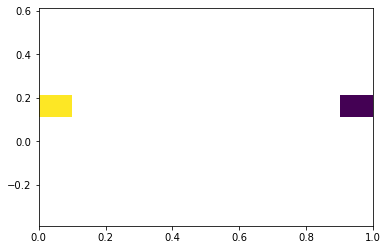

In [132]:
plt.hist2d(final_labs[:, 0], val_preds[:, 0], norm=mpl.colors.LogNorm())

In [133]:
print(len(sizes_list))
print(final_labs[:5])
print(val_preds[:5])

2616
[[0.]
 [0.]
 [0.]
 [0.]
 [0.]]
[[0.11133878]
 [0.11133878]
 [0.11133878]
 [0.11133878]
 [0.11133878]]


In [84]:
mc_truth_test_hist = Models.compile_and_train(beam_model_mc, testing_hyper_params, added_all_labs, added_all_labs_val)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [()]                         0         []                            
                                                                                                  
 input.merge_batch_to_compo  ()                           0         ['input_1[0][0]']             
 nents (InstanceMethod)                                                                           
                                                                                                  
 map_features (MapFeatures)  ()                           176       ['input.merge_batch_to_compone
                                                                    nts[0][0]']                   
                                                                                              

AttributeError: in user code:

    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1401, in train_function  *
        return step_function(self, iterator)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1384, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1373, in run_step  **
        outputs = model.train_step(data)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1151, in train_step
        loss = self.compute_loss(x, y, y_pred, sample_weight)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1209, in compute_loss
        return self.compiled_loss(
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/compile_utils.py", line 277, in __call__
        loss_value = loss_obj(y_t, y_p, sample_weight=sw)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py", line 143, in __call__
        losses = call_fn(y_true, y_pred)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py", line 270, in call  **
        return ag_fn(y_true, y_pred, **self._fn_kwargs)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py", line 2712, in _ragged_tensor_binary_focal_crossentropy
        return _ragged_tensor_apply_loss(fn, y_true, y_pred)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py", line 1784, in _ragged_tensor_apply_loss
        nested_splits_list = [rt.nested_row_splits for rt in (y_true, y_pred)]
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py", line 1784, in <listcomp>
        nested_splits_list = [rt.nested_row_splits for rt in (y_true, y_pred)]

    AttributeError: 'SymbolicTensor' object has no attribute 'nested_row_splits'


In [90]:
test_mc_hyper_params = mc_truth_hyper_params.copy()
test_mc_hyper_params["metrics"] = None

In [94]:
mc_truth_test_hist = Models.compile_and_train(test_model, test_mc_hyper_params, testing_train_batched, testing_val_batched)

Model: "model_11"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_27 (InputLayer)       [()]                         0         []                            
                                                                                                  
 input.merge_batch_to_compo  ()                           0         ['input_27[0][0]']            
 nents_2 (InstanceMethod)                                                                         
                                                                                                  
 map_features_9 (MapFeature  ()                           480       ['input.merge_batch_to_compone
 s)                                                                 nts_2[0][0]']                 
                                                                                           

TypeError: in user code:

    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1401, in train_function  *
        return step_function(self, iterator)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1384, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1373, in run_step  **
        outputs = model.train_step(data)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1151, in train_step
        loss = self.compute_loss(x, y, y_pred, sample_weight)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1209, in compute_loss
        return self.compiled_loss(
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/compile_utils.py", line 277, in __call__
        loss_value = loss_obj(y_t, y_p, sample_weight=sw)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py", line 143, in __call__
        losses = call_fn(y_true, y_pred)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py", line 270, in call  **
        return ag_fn(y_true, y_pred, **self._fn_kwargs)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py", line 2570, in _ragged_tensor_binary_crossentropy
        return _ragged_tensor_apply_loss(fn, y_true, y_pred)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py", line 1793, in _ragged_tensor_apply_loss
        assertion_list = ragged_util.assert_splits_match(nested_splits_list)

    TypeError: Input 'y' of 'Equal' Op has type int32 that does not match type int64 of argument 'x'.


In [95]:
print("in user code:\n\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1401, in train_function  *\n        return step_function(self, iterator)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1384, in step_function  **\n        outputs = model.distribute_strategy.run(run_step, args=(data,))\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1373, in run_step  **\n        outputs = model.train_step(data)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1151, in train_step\n        loss = self.compute_loss(x, y, y_pred, sample_weight)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1209, in compute_loss\n        return self.compiled_loss(\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/compile_utils.py\", line 277, in __call__\n        loss_value = loss_obj(y_t, y_p, sample_weight=sw)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py\", line 143, in __call__\n        losses = call_fn(y_true, y_pred)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py\", line 270, in call  **\n        return ag_fn(y_true, y_pred, **self._fn_kwargs)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py\", line 2570, in _ragged_tensor_binary_crossentropy\n        return _ragged_tensor_apply_loss(fn, y_true, y_pred)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/losses.py\", line 1793, in _ragged_tensor_apply_loss\n        assertion_list = ragged_util.assert_splits_match(nested_splits_list)\n\n    TypeError: Input 'y' of 'Equal' Op has type int32 that does not match type int64 of argument 'x'.\n")

in user code:

    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1401, in train_function  *
        return step_function(self, iterator)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1384, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1373, in run_step  **
        outputs = model.train_step(data)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1151, in train_step
        loss = self.compute_loss(x, y, y_pred, sample_weight)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1209, in compute_loss
        return self.compiled_loss(
    File "/s

In [38]:
print("\u001b[0;31m---------------------------------------------------------------------------\u001b[0m\n\u001b[0;31mTypeError\u001b[0m                                 Traceback (most recent call last)\n\u001b[1;32m/users/wx21978/projects/pion-phys/pi0-analysis/analysis/notebooks/parameter_visualisation_keras.ipynb Cell 206\u001b[0m in \u001b[0;36m<cell line: 1>\u001b[0;34m()\u001b[0m\n\u001b[0;32m----> <a href='vscode-notebook-cell://ssh-remote%2B7b22686f73744e616d65223a22686d30314e6f56504e227d/users/wx21978/projects/pion-phys/pi0-analysis/analysis/notebooks/parameter_visualisation_keras.ipynb#Y353sdnNjb2RlLXJlbW90ZQ%3D%3D?line=0'>1</a>\u001b[0m mc_truth_test_hist \u001b[39m=\u001b[39m Models\u001b[39m.\u001b[39;49mcompile_and_train(test_model, mc_truth_hyper_params, testing_train_batched, testing_val_batched)\n\nFile \u001b[0;32m~/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py:575\u001b[0m, in \u001b[0;36mcompile_and_train\u001b[0;34m(model, hyper_params, batched_train, batched_val, print_summary)\u001b[0m\n\u001b[1;32m    573\u001b[0m \u001b[39mif\u001b[39;00m print_summary:\n\u001b[1;32m    574\u001b[0m     model\u001b[39m.\u001b[39msummary()\n\u001b[0;32m--> 575\u001b[0m history \u001b[39m=\u001b[39m model\u001b[39m.\u001b[39;49mfit(batched_train,\n\u001b[1;32m    576\u001b[0m                     class_weight\u001b[39m=\u001b[39;49mhyper_params[\u001b[39m\"\u001b[39;49m\u001b[39mclass_weights\u001b[39;49m\u001b[39m\"\u001b[39;49m],\n\u001b[1;32m    577\u001b[0m                     steps_per_epoch\u001b[39m=\u001b[39;49mhyper_params[\u001b[39m\"\u001b[39;49m\u001b[39msteps_per_epoch\u001b[39;49m\u001b[39m\"\u001b[39;49m],\n\u001b[1;32m    578\u001b[0m                     epochs\u001b[39m=\u001b[39;49mhyper_params[\u001b[39m\"\u001b[39;49m\u001b[39mepochs\u001b[39;49m\u001b[39m\"\u001b[39;49m],\n\u001b[1;32m    579\u001b[0m                     callbacks\u001b[39m=\u001b[39;49mhyper_params[\u001b[39m\"\u001b[39;49m\u001b[39mcallbacks\u001b[39;49m\u001b[39m\"\u001b[39;49m],\n\u001b[1;32m    580\u001b[0m                     validation_data\u001b[39m=\u001b[39;49mbatched_val)\n\u001b[1;32m    581\u001b[0m \u001b[39m# This save only saves a model which can do inference, it doesn't\u001b[39;00m\n\u001b[1;32m    582\u001b[0m \u001b[39m#   have full (i.e. fitting) functionality\u001b[39;00m\n\u001b[1;32m    583\u001b[0m \u001b[39m# model.export(hyper_params[\"model_path\"])\u001b[39;00m\n\u001b[1;32m    584\u001b[0m \u001b[39m# Saving not currently working - need to use strings as dftype formatting?\u001b[39;00m\n\u001b[1;32m    585\u001b[0m model\u001b[39m.\u001b[39msave(hyper_params[\u001b[39m\"\u001b[39m\u001b[39mmodel_path\u001b[39m\u001b[39m\"\u001b[39m], save_format\u001b[39m=\u001b[39m\u001b[39m\"\u001b[39m\u001b[39mtf\u001b[39m\u001b[39m\"\u001b[39m, overwrite\u001b[39m=\u001b[39m\u001b[39mFalse\u001b[39;00m)\n\nFile \u001b[0;32m/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/utils/traceback_utils.py:70\u001b[0m, in \u001b[0;36mfilter_traceback.<locals>.error_handler\u001b[0;34m(*args, **kwargs)\u001b[0m\n\u001b[1;32m     67\u001b[0m     filtered_tb \u001b[39m=\u001b[39m _process_traceback_frames(e\u001b[39m.\u001b[39m__traceback__)\n\u001b[1;32m     68\u001b[0m     \u001b[39m# To get the full stack trace, call:\u001b[39;00m\n\u001b[1;32m     69\u001b[0m     \u001b[39m# `tf.debugging.disable_traceback_filtering()`\u001b[39;00m\n\u001b[0;32m---> 70\u001b[0m     \u001b[39mraise\u001b[39;00m e\u001b[39m.\u001b[39mwith_traceback(filtered_tb) \u001b[39mfrom\u001b[39;00m \u001b[39mNone\u001b[39m\n\u001b[1;32m     71\u001b[0m \u001b[39mfinally\u001b[39;00m:\n\u001b[1;32m     72\u001b[0m     \u001b[39mdel\u001b[39;00m filtered_tb\n\nFile \u001b[0;32m/tmp/__autograph_generated_filecg9g5otc.py:15\u001b[0m, in \u001b[0;36mouter_factory.<locals>.inner_factory.<locals>.tf__train_function\u001b[0;34m(iterator)\u001b[0m\n\u001b[1;32m     13\u001b[0m \u001b[39mtry\u001b[39;00m:\n\u001b[1;32m     14\u001b[0m     do_return \u001b[39m=\u001b[39m \u001b[39mTrue\u001b[39;00m\n\u001b[0;32m---> 15\u001b[0m     retval_ \u001b[39m=\u001b[39m ag__\u001b[39m.\u001b[39mconverted_call(ag__\u001b[39m.\u001b[39mld(step_function), (ag__\u001b[39m.\u001b[39mld(\u001b[39mself\u001b[39m), ag__\u001b[39m.\u001b[39mld(iterator)), \u001b[39mNone\u001b[39;00m, fscope)\n\u001b[1;32m     16\u001b[0m \u001b[39mexcept\u001b[39;00m:\n\u001b[1;32m     17\u001b[0m     do_return \u001b[39m=\u001b[39m \u001b[39mFalse\u001b[39;00m\n\n\u001b[0;31mTypeError\u001b[0m: in user code:\n\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1401, in train_function  *\n        return step_function(self, iterator)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1384, in step_function  **\n        outputs = model.distribute_strategy.run(run_step, args=(data,))\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1373, in run_step  **\n        outputs = model.train_step(data)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1155, in train_step\n        return self.compute_metrics(x, y, y_pred, sample_weight)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1249, in compute_metrics\n        self.compiled_metrics.update_state(y, y_pred, sample_weight)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/compile_utils.py\", line 620, in update_state\n        metric_obj.update_state(y_t, y_p, sample_weight=mask)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/utils/metrics_utils.py\", line 77, in decorated\n        result = update_state_fn(*args, **kwargs)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/metrics/base_metric.py\", line 140, in update_state_fn\n        return ag_update_state(*args, **kwargs)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/metrics/base_metric.py\", line 713, in update_state  **\n        ], sample_weight = metrics_utils.ragged_assert_compatible_and_get_flat_values(  # noqa: E501\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/utils/metrics_utils.py\", line 872, in ragged_assert_compatible_and_get_flat_values\n        raise TypeError(\n\n    TypeError: Some of the inputs are not tf.RaggedTensor. Input received: [<tf.Tensor 'IteratorGetNext:33' shape=(None, 4) dtype=float32>, tf.RaggedTensor(values=Tensor(\"model_10/graph_update_17/edge_set_update_4/next_state_from_concat_17/dense_40/Sigmoid:0\", shape=(None, 1), dtype=float32), row_splits=Tensor(\"model_10/tf.RaggedTensor.from_row_lengths/RaggedFromRowLengths/control_dependency:0\", shape=(None,), dtype=int32))]\n")

---------------------------------------------------------------------------
TypeError                                 Traceback (most recent call last)
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/notebooks/parameter_visualisation_keras.ipynb Cell 206 in <cell line: 1>()
----> <a href='vscode-notebook-cell://ssh-remote%2B7b22686f73744e616d65223a22686d30314e6f56504e227d/users/wx21978/projects/pion-phys/pi0-analysis/analysis/notebooks/parameter_visualisation_keras.ipynb#Y353sdnNjb2RlLXJlbW90ZQ%3D%3D?line=0'>1</a> mc_truth_test_hist = Models.compile_and_train(test_model, mc_truth_hyper_params, testing_train_batched, testing_val_batched)

File ~/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py:575, in compile_and_train(model, hyper_params, batched_train, batched_val, print_summary)
    573 if print_summary:
    574     model.summary()
--> 575 history = model.fit(batched_train,
    576                     class_weight=hyper_params["class_weights"],
    577           

In [85]:
print("in user code:\n\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1401, in train_function  *\n        return step_function(self, iterator)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1384, in step_function  **\n        outputs = model.distribute_strategy.run(run_step, args=(data,))\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1373, in run_step  **\n        outputs = model.train_step(data)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1155, in train_step\n        return self.compute_metrics(x, y, y_pred, sample_weight)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py\", line 1249, in compute_metrics\n        self.compiled_metrics.update_state(y, y_pred, sample_weight)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/compile_utils.py\", line 620, in update_state\n        metric_obj.update_state(y_t, y_p, sample_weight=mask)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/utils/metrics_utils.py\", line 77, in decorated\n        result = update_state_fn(*args, **kwargs)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/metrics/base_metric.py\", line 140, in update_state_fn\n        return ag_update_state(*args, **kwargs)\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/metrics/base_metric.py\", line 713, in update_state  **\n        ], sample_weight = metrics_utils.ragged_assert_compatible_and_get_flat_values(  # noqa: E501\n    File \"/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/utils/metrics_utils.py\", line 872, in ragged_assert_compatible_and_get_flat_values\n        raise TypeError(\n\n    TypeError: Some of the inputs are not tf.RaggedTensor. Input received: [<tf.Tensor 'IteratorGetNext:33' shape=(None, 4) dtype=float32>, tf.RaggedTensor(values=Tensor(\"model_10/graph_update_17/edge_set_update_4/next_state_from_concat_17/dense_40/Sigmoid:0\", shape=(None, 1), dtype=float32), row_splits=Tensor(\"model_10/tf.RaggedTensor.from_row_lengths/RaggedFromRowLengths/control_dependency:0\", shape=(None,), dtype=int32))]\n")

in user code:

    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1401, in train_function  *
        return step_function(self, iterator)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1384, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1373, in run_step  **
        outputs = model.train_step(data)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1155, in train_step
        return self.compute_metrics(x, y, y_pred, sample_weight)
    File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/engine/training.py", line 1249, in compute_metrics
        self.compiled_metrics.update_stat

In [38]:
mc_truth_028_hist = Models.compile_and_train(beam_model_mc, mc_truth_hyper_params, train_ds_batched, val_ds_batched)

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_16 (InputLayer)       [()]                         0         []                            
                                                                                                  
 input.merge_batch_to_compo  ()                           0         ['input_16[0][0]']            
 nents_1 (InstanceMethod)                                                                         
                                                                                                  
 map_features_6 (MapFeature  ()                           160       ['input.merge_batch_to_compone
 s)                                                                 nts_1[0][0]']                 
                                                                                            

/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/tensorflow/python/saved_model/nested_structure_coder.py:458: UserWarning: Encoding a StructuredValue with type tensorflow_gnn.GraphTensorSpec; loading this StructuredValue will require that this type be imported and registered.
  warnings.warn("Encoding a StructuredValue with type %s; loading this "
/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/tensorflow/python/saved_model/nested_structure_coder.py:458: UserWarning: Encoding a StructuredValue with type tensorflow_gnn.ContextSpec.v2; loading this StructuredValue will require that this type be imported and registered.
  warnings.warn("Encoding a StructuredValue with type %s; loading this "
/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/tensorflow/python/saved_model/nested_structure_coder.py:458: UserWarning: Encoding a StructuredValue with type tensorflow_gnn.NodeSetSpec; loading this StructuredValue will requ

INFO:tensorflow:Assets written to: /users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mc_truth_no_pi0_models/Model_mc_truth_no_pi0_028_pi0_edge_id_2MP_no_beam_mother_id/model.tf/assets


INFO:tensorflow:Assets written to: /users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mc_truth_no_pi0_models/Model_mc_truth_no_pi0_028_pi0_edge_id_2MP_no_beam_mother_id/model.tf/assets


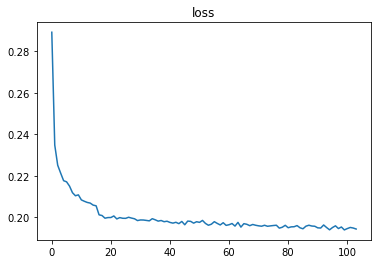

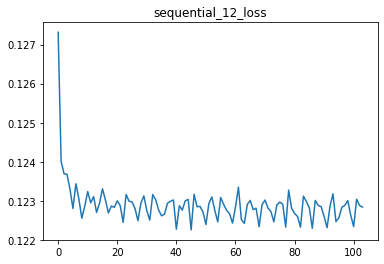

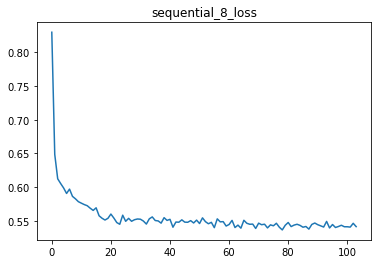

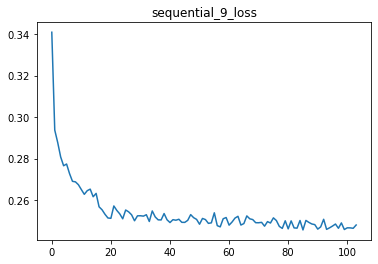

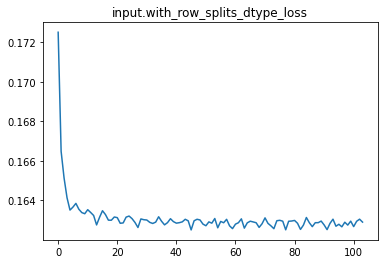

...

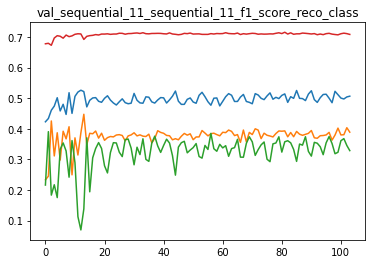

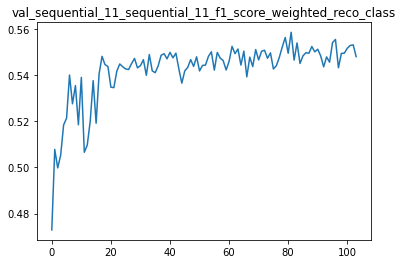

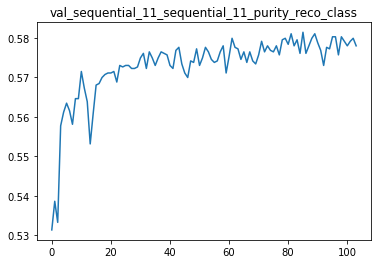

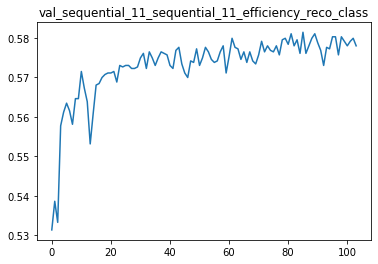

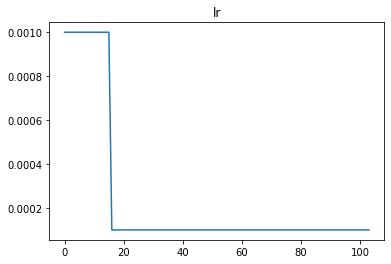

In [15]:
Models.simple_plot_history(data_76_hist_init)

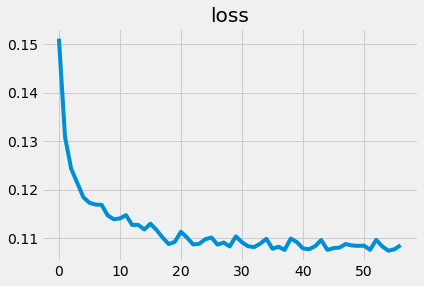

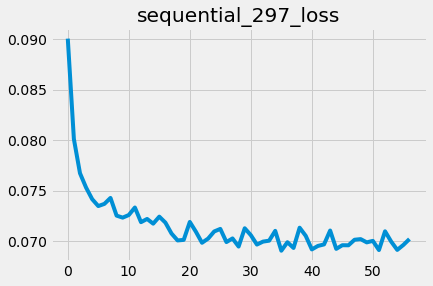

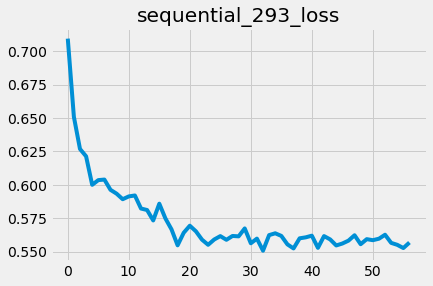

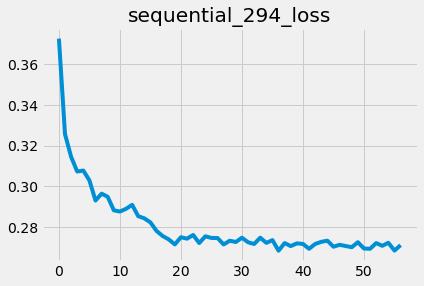

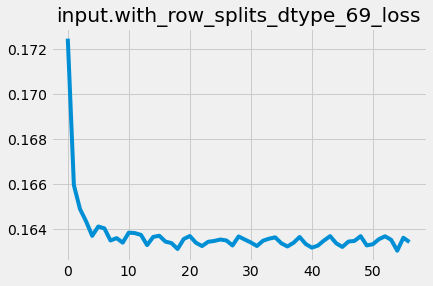

...

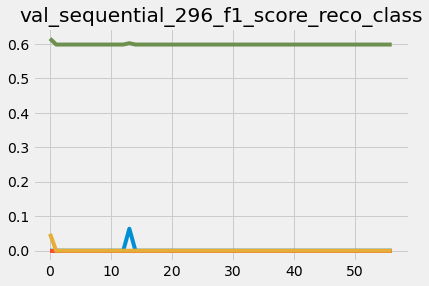

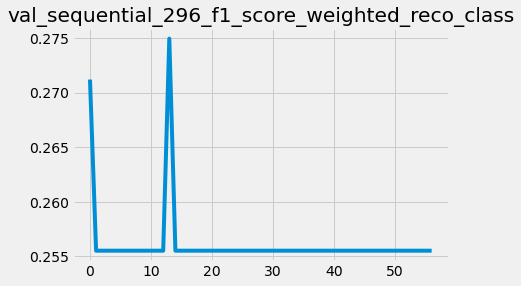

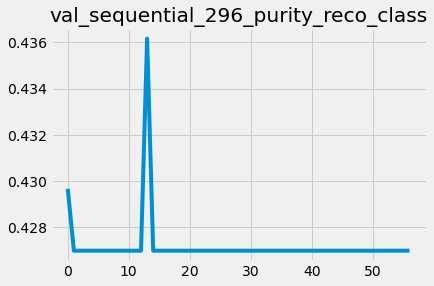

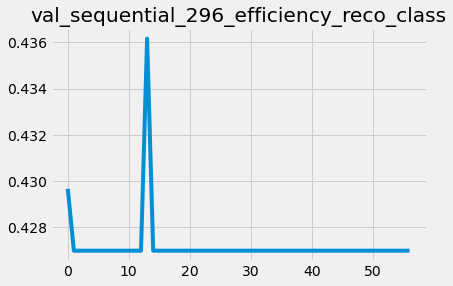

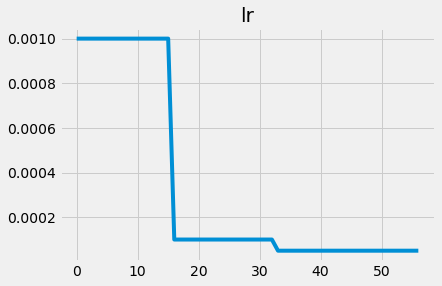

In [129]:
Models.simple_plot_history(data_82_hist)

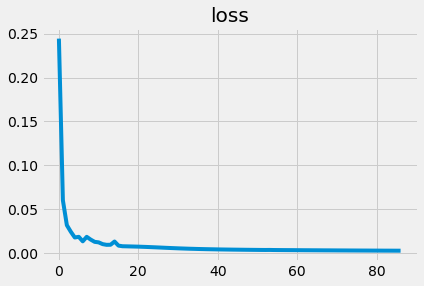

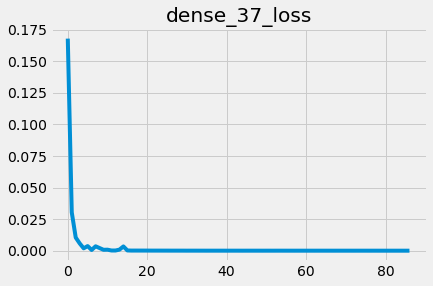

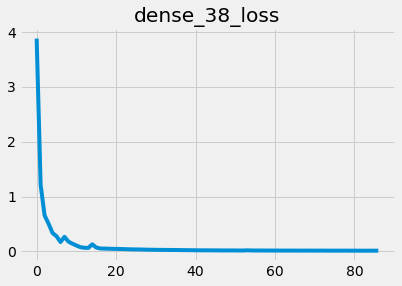

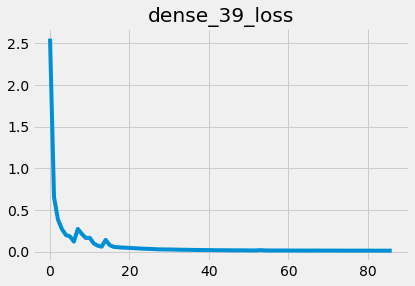

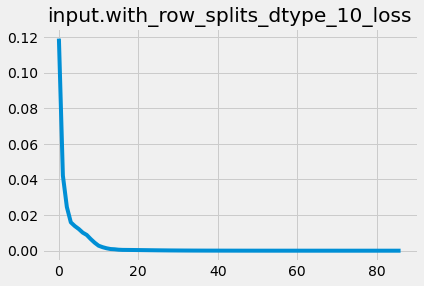

...

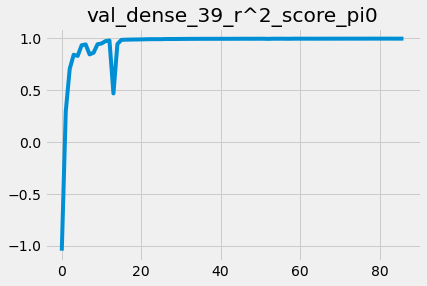

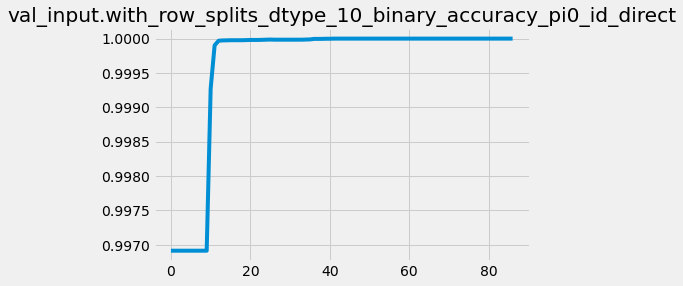

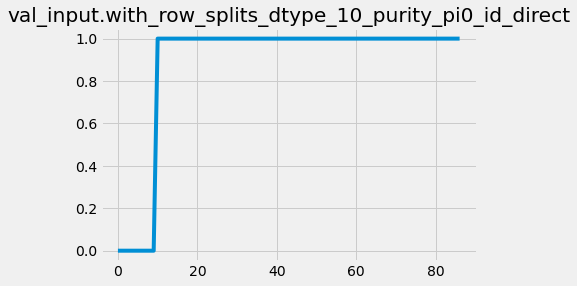

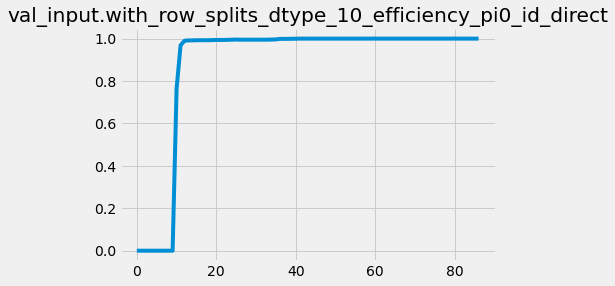

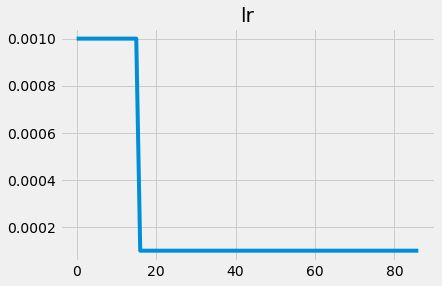

In [39]:
Models.simple_plot_history(mc_truth_028_hist)

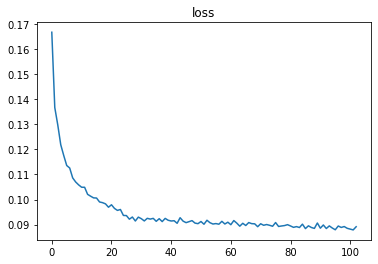

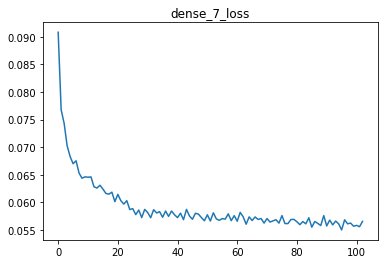

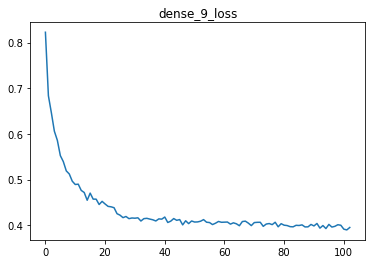

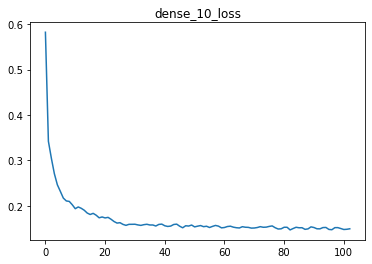

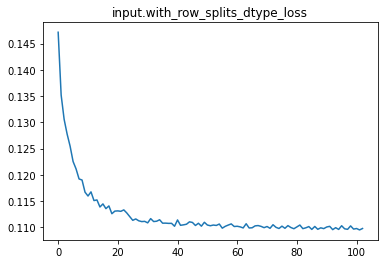

...

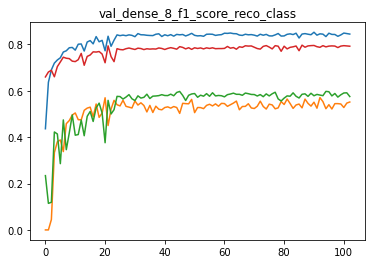

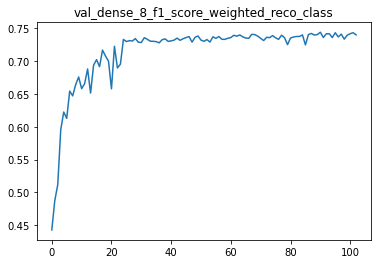

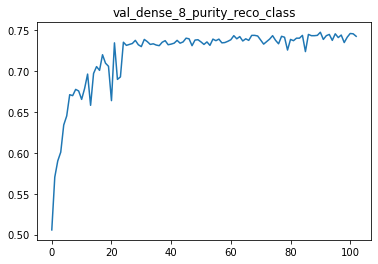

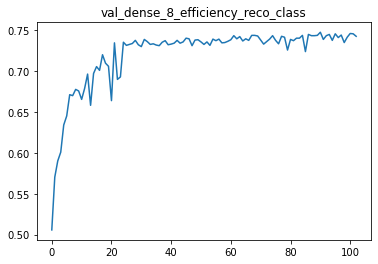

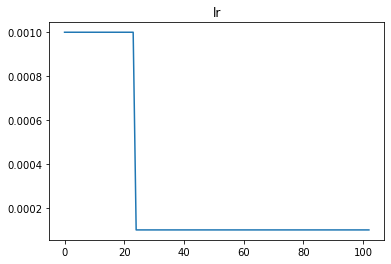

In [12]:
Models.simple_plot_history(bt_truth_80_hist)

In [5]:
which_path_params = data_path_params

In [40]:
def print_shapes(graph):
    print(f"Context: {graph.context.shape}")
    print(f"Beam: {graph.node_sets['beam'].features[tfgnn.HIDDEN_STATE].shape}")
    print(f"PFO: {graph.node_sets['pfo'].features[tfgnn.HIDDEN_STATE].shape}")
    print(f"Beam connections: {graph.edge_sets['beam_connections'].features[tfgnn.HIDDEN_STATE].shape}")
    print(f"PFO connections: {graph.edge_sets['neighbours'].features[tfgnn.HIDDEN_STATE].shape}")
    return
test_data, labs = test_batched.take(1).get_single_element()
pion_lab = labs[4]
print(pion_lab.shape)
print(pion_lab.row_splits)
print_shapes(test_data)
merge_graph = test_data.merge_batch_to_components()
print_shapes(merge_graph)
print(merge_graph.node_sets["pfo"].features[tfgnn.HIDDEN_STATE].shape)
print(tfgnn.keras.layers.Readout(node_set_name="pfo")(merge_graph).shape)
# print(tfgnn.keras.layers.Readout(node_set_name="pfo")(merge_graph))
print(merge_graph.node_sets["pfo"].sizes)
print(tf.RaggedTensor.from_row_lengths(
        values=tfgnn.keras.layers.Readout(node_set_name="pfo")(merge_graph),#updated.node_sets["pfo"].features[tfgnn.HIDDEN_STATE],
        row_lengths=merge_graph.node_sets["pfo"].sizes).with_row_splits_dtype(tf.int64).shape)
print(tf.RaggedTensor.from_row_lengths(
        values=merge_graph.node_sets["pfo"].features[tfgnn.HIDDEN_STATE],
        row_lengths=merge_graph.node_sets["pfo"].sizes).with_row_splits_dtype(tf.int64).shape)

(32, None, 1)
tf.Tensor(
[  0   4  10  14  19  26  30  37  46  52  58  63  69  73  77  80  83  86
  88  92  96 102 106 112 114 115 119 124 127 131 135 139 147], shape=(33,), dtype=int64)
Context: (32,)
Beam: (32, None)
PFO: (32, None, 5)
Beam connections: (32, None, 2)
PFO connections: (32, None, 3)
Context: ()
Beam: (32,)
PFO: (147, 5)
Beam connections: (147, 2)
PFO connections: (624, 3)
(147, 5)
tf.Tensor([4 6 4 5 7 4 7 9 6 6 5 6 4 4 3 3 3 2 4 4 6 4 6 2 1 4 5 3 4 4 4 8], shape=(32,), dtype=int32)
(147, 5)
tf.Tensor([4 6 4 5 7 4 7 9 6 6 5 6 4 4 3 3 3 2 4 4 6 4 6 2 1 4 5 3 4 4 4 8], shape=(32,), dtype=int32)
(32, None, 5)
(32, None, 5)


/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_models/Model_data_84_PNA
82/82 [==============================] - 2s 11ms/step
2617 events searched.
1333 events correctly classified (1284 false), for an efficiency of 50.94%.
For Abs.: 40.82% efficiency, 52.17% purity (product: 21.30%).
For CEx.: 48.59% efficiency, 16.63% purity (product: 8.08%).
For 1 pi: 57.70% efficiency, 35.85% purity (product: 20.68%).
For Multi.: 49.59% efficiency, 77.10% purity (product: 38.24%).



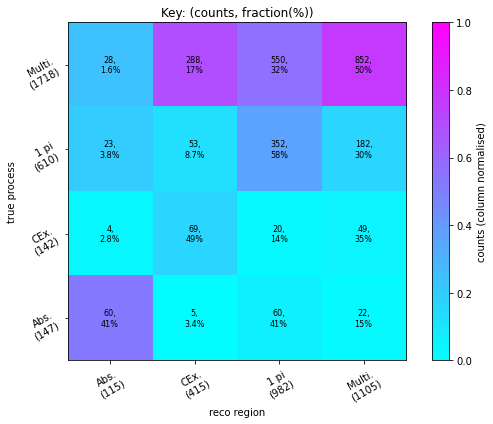

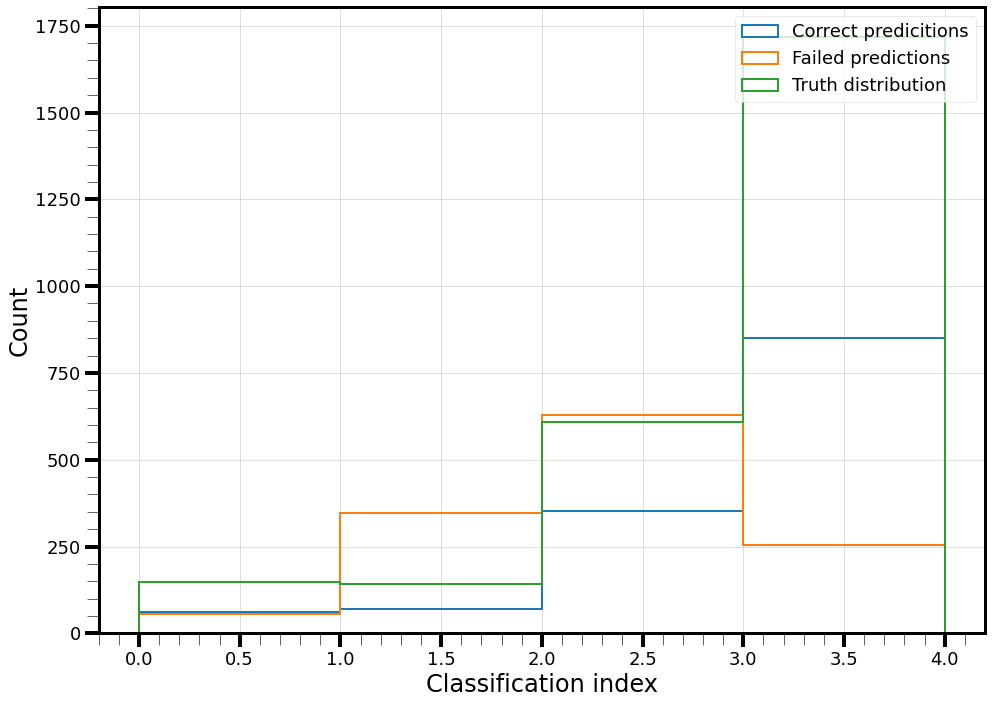

In [8]:
model_path = "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_models/Model_data_84_PNA"
loaded_model = Models.load_model_from_file(model_path)
print(model_path)
# loaded_model = Models.load_model_from_file(data_hyper_params["folder_path"])
# print(data_hyper_params["folder_path"])
true_pred, true_truth = Models.evaluate_model(
    loaded_model,
    # data_model,
    which_path_params["schema_path"],
    which_path_params["test_path"],
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."],
    plot_config=plt_conf)

In [ ]:
predictions, truth_index = Models.get_predicitions(
    loaded_model, which_path_params["schema_path"], which_path_params["test_path"])
pred_index = np.where(
    predictions == (np.max(predictions, axis=1)[:, np.newaxis]))[1]
labels = Models._parse_classification_labels(["Abs.", "CEx.", "1 pi", "Multi."],
                                        pred_index, truth_index)

82/82 [==============================] - 2s 16ms/step


In [ ]:
inds, vals = np.where(
    predictions == (np.max(predictions, axis=1)[:, np.newaxis]))

In [ ]:
_, unique_inds = np.unique(inds, return_index=True)
pred_index = vals[unique_inds]

/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py:948: RuntimeWarning: invalid value encountered in scalar divide
  purity = (100*np.sum(truth_index[pred_index==i] == i)
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/apps/cex_toy_parameters.py:164: RuntimeWarning: invalid value encountered in divide
  Plots.plt.imshow(counts/np.sum(counts, axis = 0), cmap = "cool", vmin=0., vmax=1., origin = "lower")


2617 events searched.
1774 events correctly classified (843 false), for an efficiency of 67.79%.
For Abs.: 37.41% efficiency, 61.11% purity (product: 22.86%).
For CEx.: 0.00% efficiency, nan% purity (product: nan%).
For 1 pi: 36.72% efficiency, 45.62% purity (product: 16.75%).
For Multi.: 87.02% efficiency, 73.43% purity (product: 63.90%).



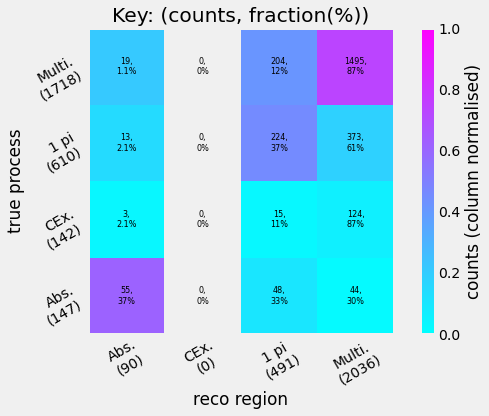

In [ ]:
Models.create_summary_text(
        pred_index, truth_index,
        classification_labels=labels,
        print_results=True)
confustion_mat = Models.create_confusion_matrix(pred_index, truth_index)
Models.plot_confusion_matrix(
    confustion_mat,
    labels, labels)

/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py:533: UserWarning: Layer versions 1.1.1 (model), 1.1.2 (current module) do not match, may be unexpected behaviour.
  warnings.warn(f"Layer versions {version_model} (model), "


/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_data_no_mom_bdt_scores_norms/
82/82 [==============================] - 2s 9ms/step
2617 events searched.
1533 events correctly classified (1084 false), for an efficiency of 58.58%.
For Abs.: 34.69% efficiency, 62.96% purity (product: 21.84%).
For CEx.: 24.65% efficiency, 26.12% purity (product: 6.44%).
For 1 pi: 63.77% efficiency, 36.42% purity (product: 23.23%).
For Multi.: 61.58% efficiency, 79.31% purity (product: 48.84%).



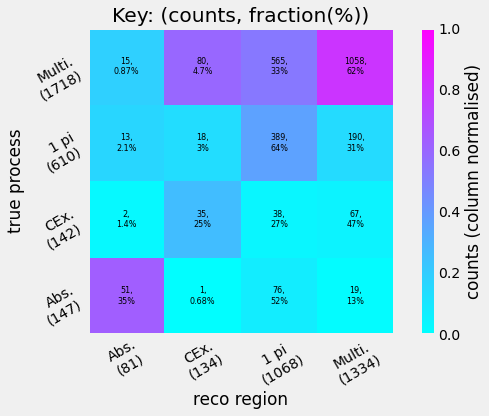

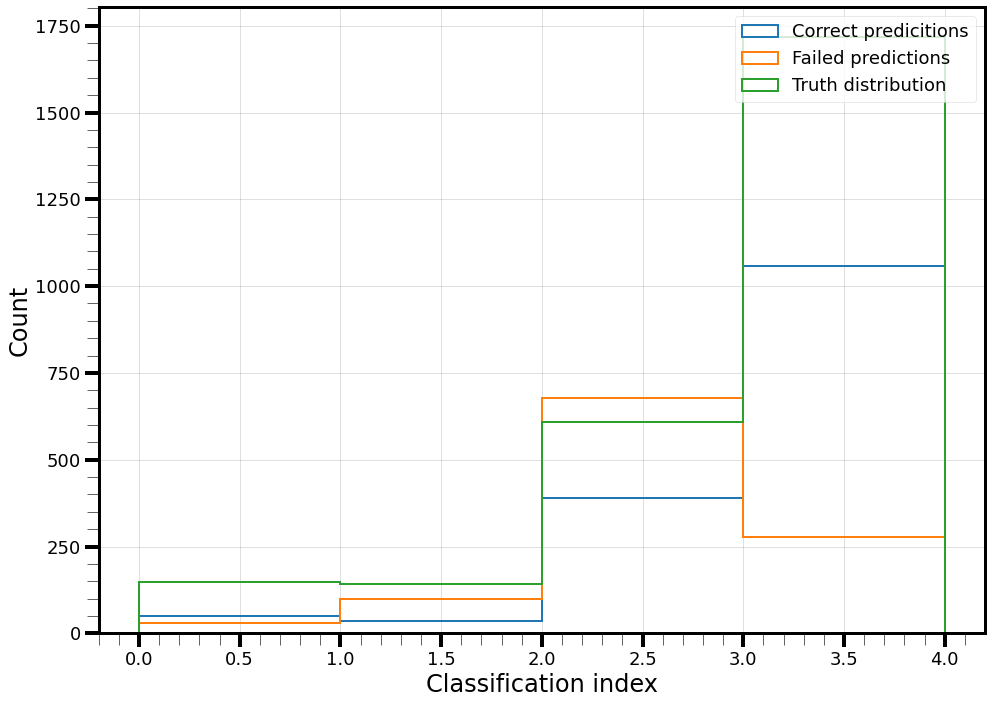

In [84]:
loaded_model = Models.load_model_from_file(data_hyper_params["folder_path"])
print(which_path_params["folder_path"])
true_pred, true_truth = Models.evaluate_model(
    loaded_model,
    # data_model,
    which_path_params["schema_path"],
    which_path_params["test_path"],
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."],
    plot_config=plt_conf)

/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_models/Model_data_71_multi_loss_GATv2_early_pid_2_stage
82/82 [==============================] - 2s 9ms/step
2617 events searched.
1449 events correctly classified (1168 false), for an efficiency of 55.37%.
For Abs.: 36.73% efficiency, 59.34% purity (product: 21.80%).
For CEx.: 23.24% efficiency, 35.48% purity (product: 8.25%).
For 1 pi: 62.79% efficiency, 32.60% purity (product: 20.47%).
For Multi.: 56.98% efficiency, 77.82% purity (product: 44.35%).



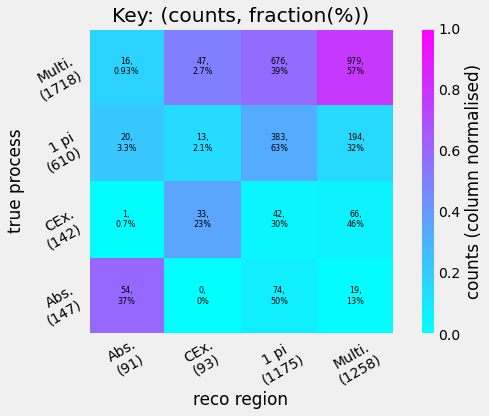

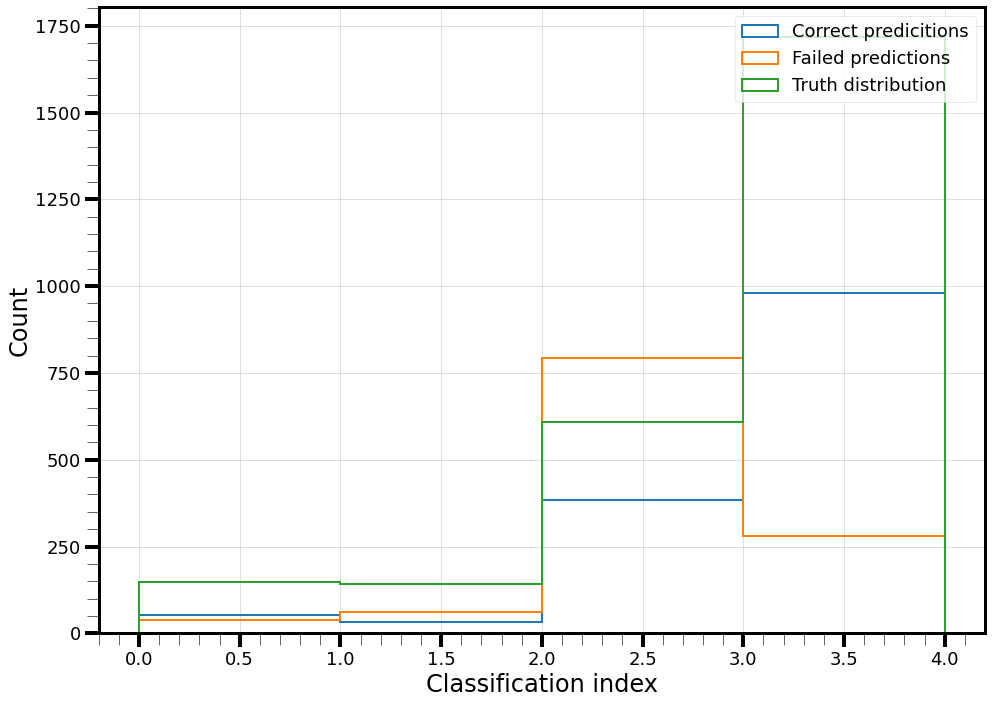

In [24]:
# loaded_model = tf.keras.models.load_model(bt_hyper_params["model_path"])
print(data_hyper_params["folder_path"])
true_pred, true_truth = Models.evaluate_model(
    # loaded_model,
    data_model,
    which_path_params["schema_path"],
    which_path_params["test_path"],
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."],
    plot_config=plt_conf)

82/82 [==============================] - 1s 8ms/step
Found predictions ranging between 0.000 and 0.789.


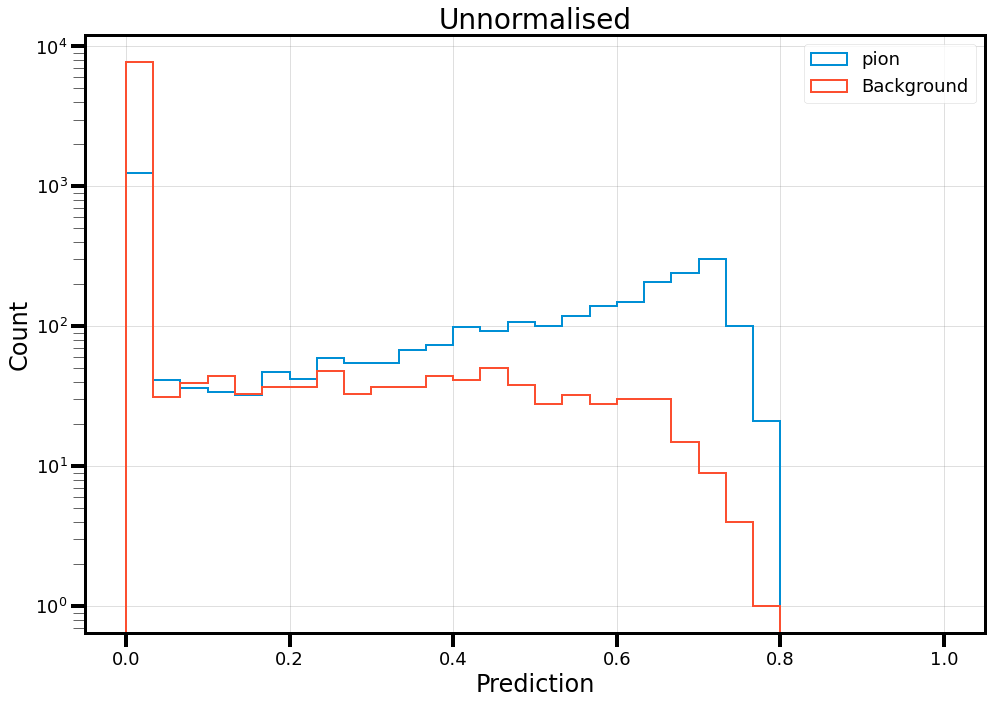

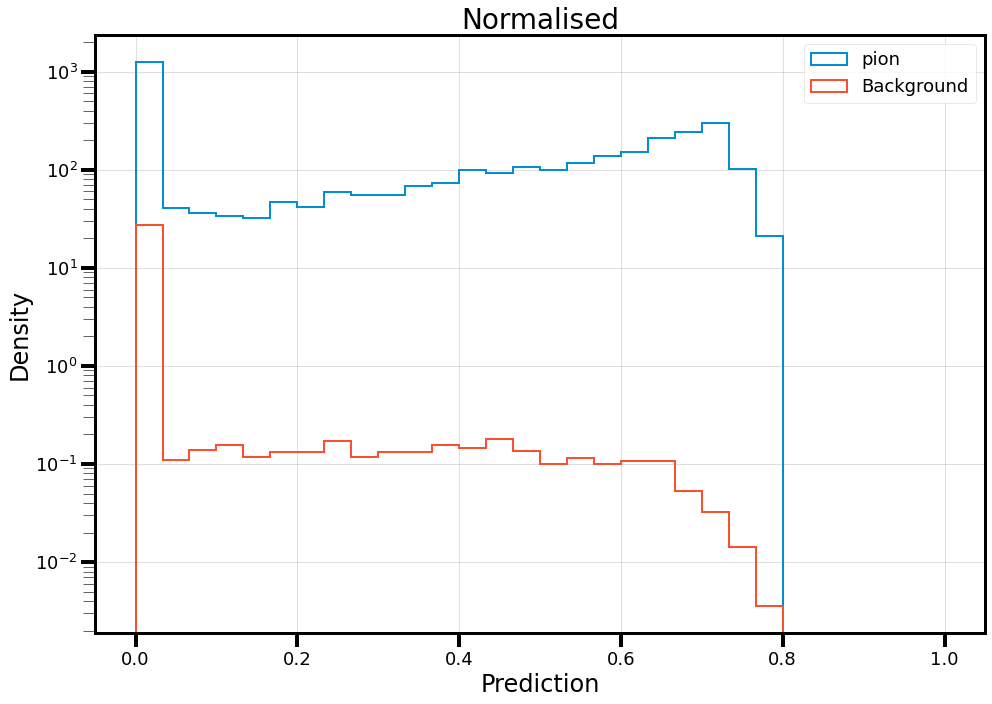

82/82 [==============================] - 1s 8ms/step
Found predictions ranging between 0.000 and 2.795.


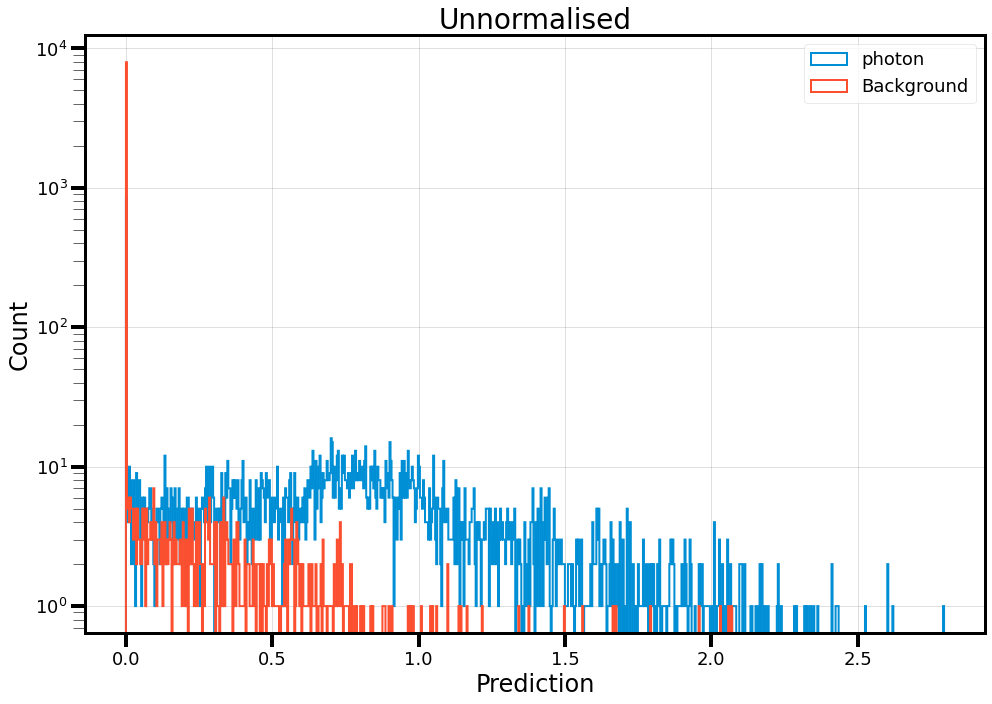

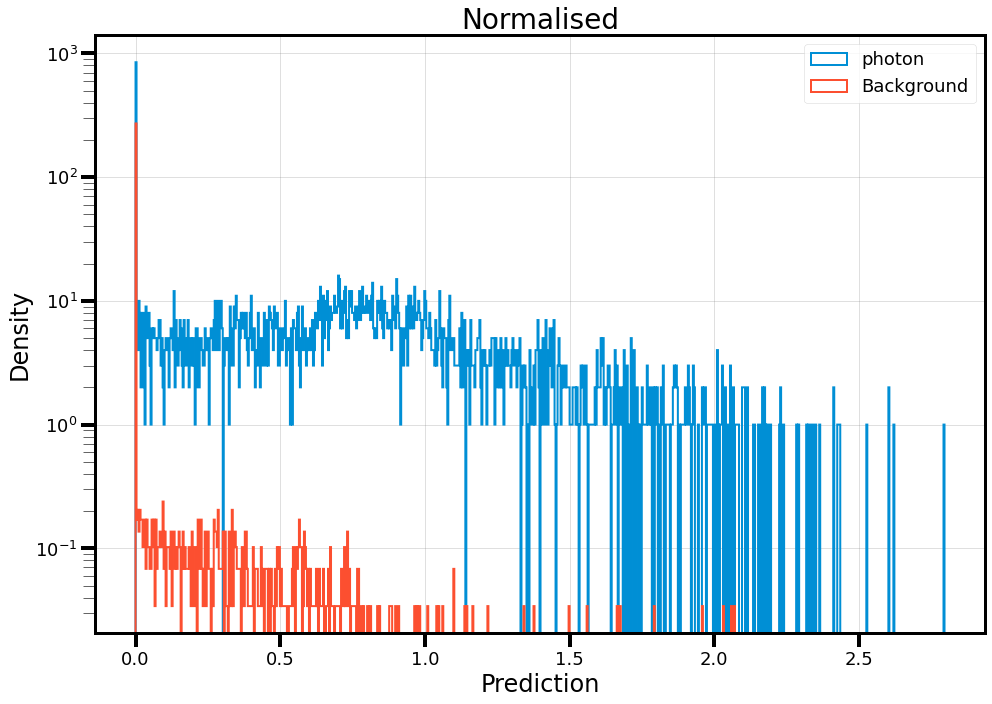

82/82 [==============================] - 1s 8ms/step
Found predictions ranging between 0.000 and 0.000.


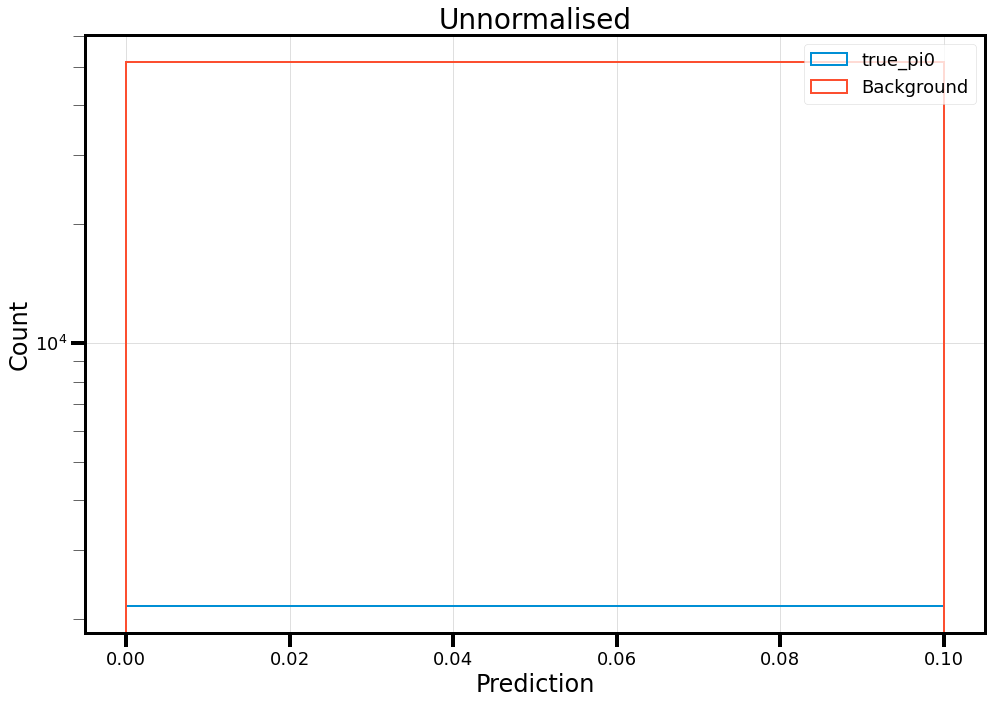

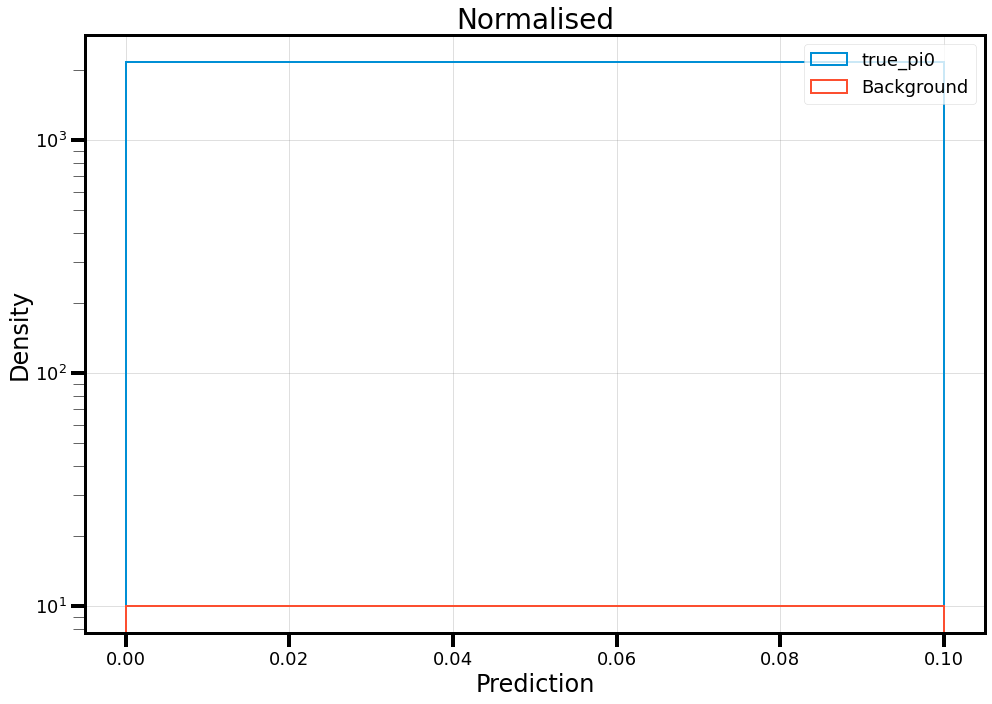

In [9]:
Models.plot_binary_extra_loss_dist(
    loaded_model,
    "pion", 3,
    which_path_params, plt_conf)
Models.plot_binary_extra_loss_dist(
    loaded_model,
    "photon", 4,
    which_path_params, plt_conf)
Models.plot_binary_extra_loss_dist(
    loaded_model,
    "true_pi0", 5,#3,
    which_path_params, plt_conf)

82/82 [==============================] - 2s 9ms/step


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


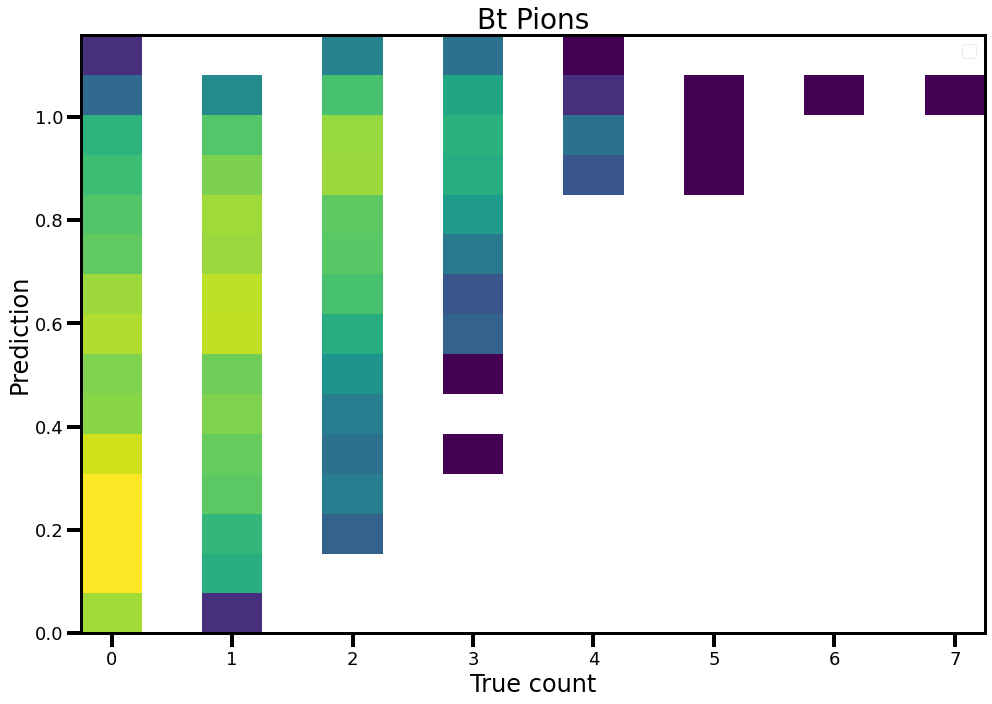

82/82 [==============================] - 2s 4ms/step


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


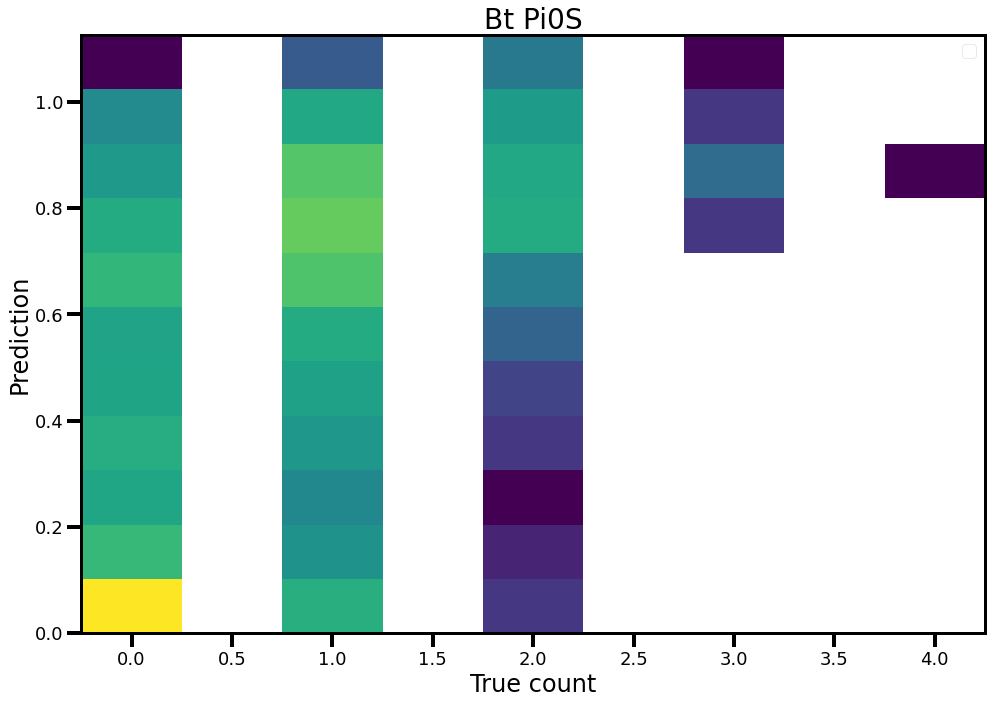

In [10]:
which_true = "bt" # "mc"
Models.plot_regression_extra_loss_dist(
    loaded_model,
    f"{which_true}_pions", 1,
    which_path_params, plt_conf)
Models.plot_regression_extra_loss_dist(
    loaded_model,
    f"{which_true}_pi0s", 2,
    which_path_params, plt_conf)

82/82 [==============================] - 2s 9ms/step


/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py:677: RuntimeWarning: invalid value encountered in scalar divide
  purity = (100*np.sum(truth_index[pred_index==i] == i)
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/apps/cex_toy_parameters.py:164: RuntimeWarning: invalid value encountered in divide
  Plots.plt.imshow(counts/np.sum(counts, axis = 0), cmap = "cool", vmin=0., vmax=1., origin = "lower")


2617 events searched.
1084 events correctly classified (1533 false), for an efficiency of 41.42%.
For Abs.: 0.00% efficiency, nan% purity (product: nan%).
For CEx.: 0.00% efficiency, nan% purity (product: nan%).
For 1 pi: 0.00% efficiency, nan% purity (product: nan%).
For Multi.: 100.00% efficiency, 41.42% purity (product: 41.42%).



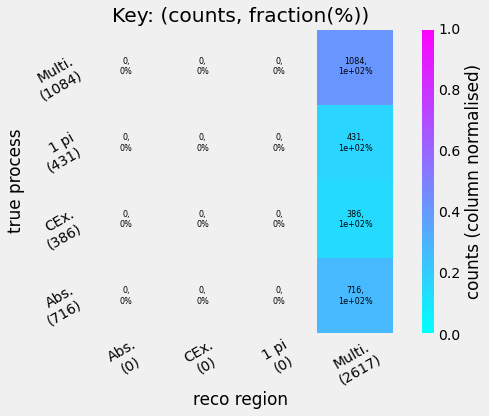

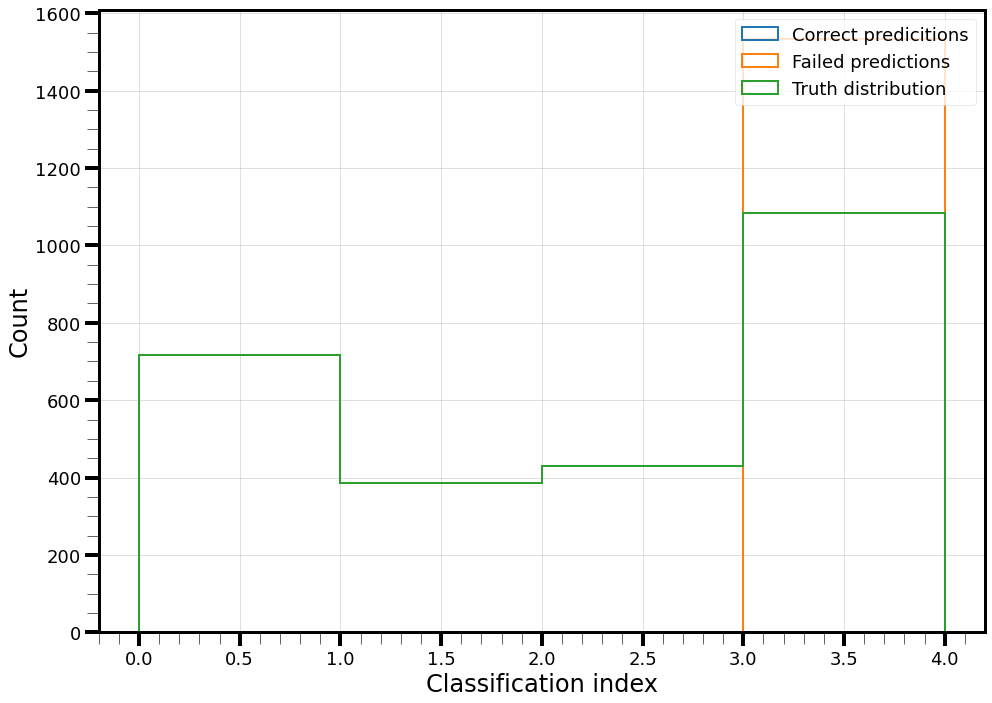

In [11]:
reco_pred, reco_truth = Models.plot_confusion_extra_loss(
    loaded_model,
    "reco_class", -1,
    which_path_params,
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."],
    plot_config=plt_conf)

82/82 [==============================] - 0s 3ms/step
2617 events searched.
1258 events correctly classified (1359 false), for an efficiency of 48.07%.
For Abs.: 11.87% efficiency, 73.91% purity (product: 8.77%).
For CEx.: 50.78% efficiency, 47.23% purity (product: 23.98%).
For 1 pi: 71.23% efficiency, 31.26% purity (product: 22.27%).
For Multi.: 61.81% efficiency, 60.63% purity (product: 37.48%).



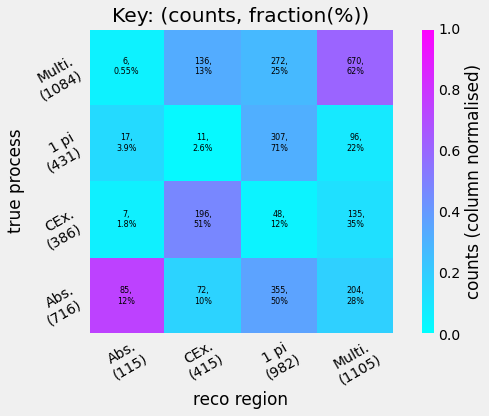

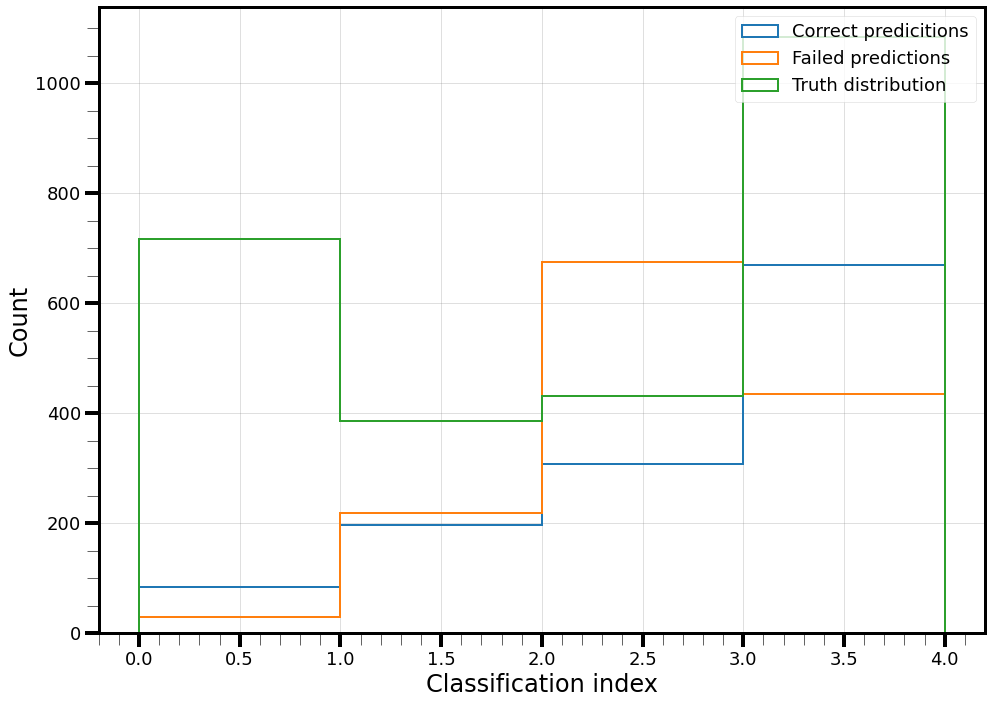

(array([2, 3, 3, ..., 2, 1, 2]), array([2., 3., 3., ..., 0., 1., 2.]))

In [12]:
# reload(Models)
Models.plot_confusion_main_vs_reco_loss(
    loaded_model,
    "reco_class", -1,
    which_path_params,
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."],
    plot_config=plt_conf)

In [13]:
from scipy.stats import poisson, rv_histogram
import scipy.optimize as opt

82/82 [==============================] - 0s 3ms/step
True counts:
[ 177  102  592 1745]

Initial prediction (GNN classification counts):
[ 156  388  952 1120]

Fitted counts
[ 217.75601614    0.          350.71039292 2031.13963555]


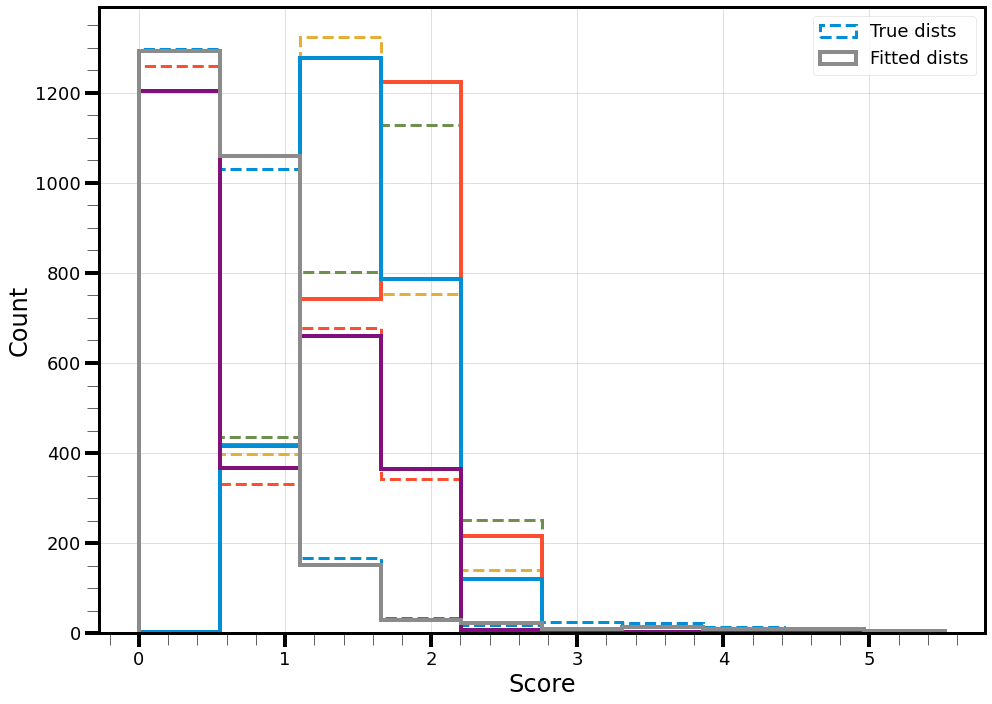

In [14]:
n_bins=10
classification_labels=["Abs.", "CEx.", "1 pi", "Multi."]
predictions, truth_index = Models.get_predicitions(
    loaded_model, which_path_params["schema_path"], which_path_params["test_path"])
# pred_index = np.where(
#     predictions == np.max(predictions, axis=1)[:, np.newaxis])[1]
pred_index = np.argmax(predictions, axis=1)
labels = Models._parse_classification_labels(classification_labels,
                                      pred_index, truth_index)
n_events = predictions.shape[0]
n_regions = predictions.shape[-1]
region_masks = Models._get_region_masks(pred_index, truth_index, n_regions)
# bins = np.linspace(np.min(predictions), np.max(predictions)+1e-2, 31)
# true_counts = region_masks.sum(axis=(0, -1))
# print("True counts:")
# print(true_counts)

classification_labels=["Abs.", "CEx.", "1 pi", "Multi."]
val_predictions, val_truth_index = Models.get_predicitions(
    loaded_model, which_path_params["schema_path"], which_path_params["val_path"])
val_pred_index = np.where(
    val_predictions == np.max(val_predictions, axis=1)[:, np.newaxis])[1]
val_region_masks = Models._get_region_masks(val_pred_index, val_truth_index, n_regions)


bins = np.linspace(min(np.min(predictions), np.min(val_predictions)), max(np.max(predictions), np.max(val_predictions))+1e-2, n_bins+1)
true_counts = val_region_masks.sum(axis=(0, -1))
print("True counts:")
print(true_counts)
def get_hists(preds, bins, n_regions=n_regions, density=False):
    result = np.zeros((bins.size-1, n_regions))
    for i in range(n_regions):
        result[:, i] = np.histogram(preds[:, i], bins, density=density)[0]
    if density:
        result *= (bins[1] - bins[0])
        result = np.clip(result, 1/preds.shape[0], None)
    return result

hists = {"full": get_hists(val_predictions, bins)}
for true_i in range(n_regions):
    all_reco_mask = region_masks[0, true_i]
    for i in range(1, n_regions):
        all_reco_mask = np.logical_or(all_reco_mask, region_masks[i, true_i])
    hists[classification_labels[true_i]] = get_hists(predictions[all_reco_mask], bins, density=True)

def get_likelihood(true_counts, expected_rates):
    L = poisson.pmf(true_counts, expected_rates)
    return - np.log(L).sum()

def make_expected_hist(x):
    absorb = x[0]
    cex = x[1]
    sing = x[2]
    multi = x[3]
    return  (absorb * hists["Abs."]
             + cex * hists["CEx."]
             + sing * hists["1 pi"]
             + multi * hists["Multi."])
        
def fit(x):
    # expected_hist = np.clip(make_expected_hist(x), sys.float_info.min, None)
    expected_hist = make_expected_hist(x)
    return get_likelihood(hists["full"], expected_hist)

init_pred = val_region_masks.sum(axis=(1, -1))
print("\nInitial prediction (GNN classification counts):")
print(init_pred)
result = opt.minimize(fit, init_pred, bounds = [(0, n_events)] * 4)
print("\nFitted counts")
print(result.x)

plt_conf.setup_figure()
plt.hist(np.repeat(bins[:-1, np.newaxis], n_regions, axis=1), bins=bins, weights=hists["full"], lw=3, ls = "--", histtype="step", label="True dists")
plt.hist(np.repeat(bins[:-1, np.newaxis], n_regions, axis=1), bins=bins, weights=make_expected_hist(result.x), lw=4, histtype="step", label="Fitted dists")
plt_conf.format_axis(xlabel="Score", ylabel = "Count")
plt_conf.end_plot()

In [241]:
# coords = np.where(poisson.pmf(hists["full"], make_expected_hist(init_pred)) == 0)
coords = np.where(poisson.pmf(hists["full"], np.clip(make_expected_hist(init_pred), 4*sys.float_info.min, None)) == 0)
print(coords)
# print(hists["full"][coords])
for key in hists.keys():
    print(f"{key}:")
    print(hists[key][coords])
print(make_expected_hist(init_pred)[coords])

(array([18]), array([0]))
full:
[2.]
Abs.:
[0.]
CEx.:
[0.]
1 pi:
[0.]
Multi.:
[0.]
[0.]


In [230]:
print(make_expected_hist(init_pred).sum(axis=0))
print(hists["CEx."].sum(axis=0))

[2616. 2616. 2616. 2616.]
[1. 1. 1. 1.]


In [221]:
make_expected_hist(init_pred).sum(axis=0) * (bins[1] - bins[0])

array([ 12.46857323,  47.45844465, 180.63846809, 687.55426767])

In [222]:
print(hists["full"][:2, :2])
print(make_expected_hist(init_pred)[:2, :2])

[[994. 324.]
 [238. 793.]]
[[16.98210336 23.13148969]
 [ 4.24653187 58.7985782 ]]


In [223]:
poisson.pmf(hists["full"], make_expected_hist(init_pred))[:4, :4]

array([[0.00000000e+000, 3.94860445e-243, 1.00000000e+000,
        1.00000000e+000],
       [5.98658750e-317, 0.00000000e+000, 1.00000000e+000,
        2.68264047e-001],
       [0.00000000e+000, 3.06517151e-169, 1.00000000e+000,
        4.81881226e-002],
       [0.00000000e+000, 1.12547752e-124, 9.20476075e-002,
        3.56535279e-002]])

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


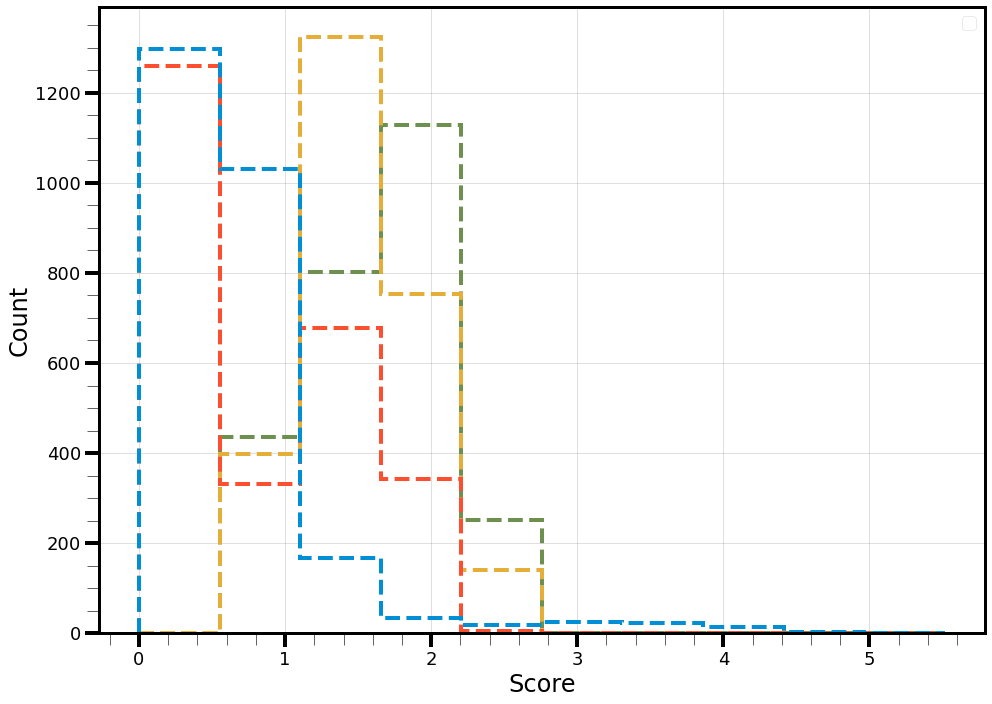

In [15]:
plt_conf.setup_figure()
plt.hist(np.repeat(bins[:-1, np.newaxis], n_regions, axis=1), bins=bins, weights=hists["full"], lw=4, ls = "--", histtype="step")
# plt.hist(make_expected_hist(result.x).T, bins=bins, lw=3, histtype="step")
plt_conf.format_axis(xlabel="Score", ylabel = "Count")
plt_conf.end_plot()

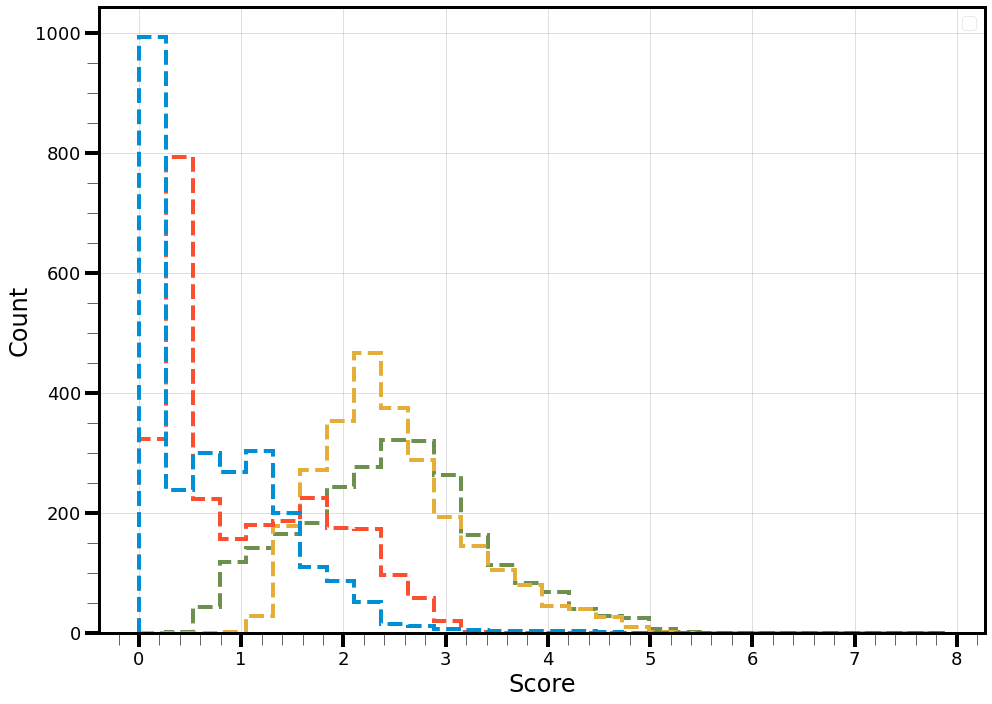

In [201]:
plt_conf.setup_figure()
plt.hist(np.repeat(bins[:-1, np.newaxis], n_regions, axis=1), bins=bins, weights=hists["full"], lw=4, ls = "--", histtype="step")
# plt.hist(make_expected_hist(result.x).T, bins=bins, lw=3, histtype="step")
plt_conf.format_axis(xlabel="Score", ylabel = "Count")
plt_conf.end_plot()

82/82 [==============================] - 1s 16ms/step


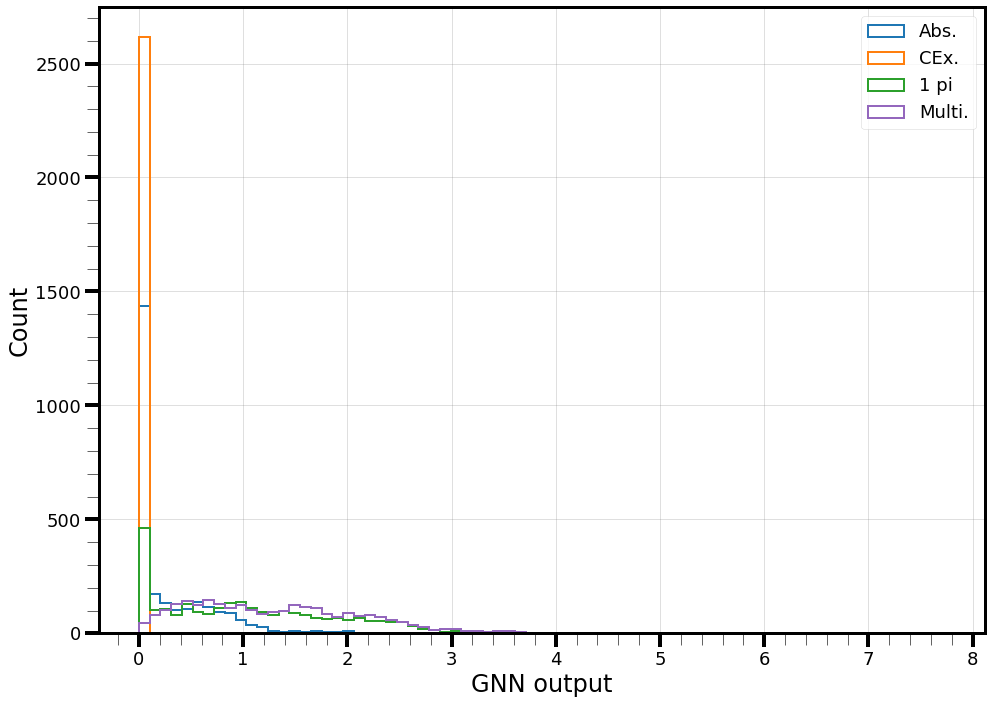

In [130]:
Models.total_score_dist(loaded_model,
    which_path_params["schema_path"],
    which_path_params["test_path"],
    plt_conf,
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."])

In [88]:
import json
with open(data_hyper_params["model_params_path"], "r") as f:
    test_params = json.load(f)

In [149]:
type(test_params)

dict

In [160]:
Models.make_model_paths("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_models/Model_data_77_new_model_construction")["params_path"]

'/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_models/Model_data_77_new_model_construction/hyper_params.pkl'

In [168]:
test_mod = Models.load_model_from_file("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_models/Model_data_77_new_model_construction")

Pickle file seems to have been overwritten (multiple trains?). Loading from text...


ValueError: Received incompatible tensor with shape (32,) when attempting to restore variable with shape (16,) and name dense_74/bias:0.

In [167]:
reload(Models)
reload(Layers)

<module 'python.gnn.Layers' from '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/gnn/Layers.py'>

In [104]:
t = None#1#"text"
print(f"The string: {repr(t)}")

The string: None


In [130]:
eval("np.array([1,2,3])")

array([1, 2, 3])

In [129]:
def test_func():
    res = 1
    exec("")
    return res

print(test_func())

1


In [147]:
res = Models.load_layer("LoopConstructor([PFOUpdate(), LoopConstructor([PFOUpdate(), NeighbourUpdate(final_step=False), BeamCollection(), BeamConnectionUpdate(final_step=False)]), NeighbourUpdate(final_step=False), BeamCollection(), BeamConnectionUpdate(final_step=False)], final_step=False, loops=2)")
res

LoopConstructor([PFOUpdate(), LoopConstructor([PFOUpdate(), NeighbourUpdate(final_step=False), BeamCollection()], loops=1), NeighbourUpdate(final_step=False), BeamCollection()], loops=2)

In [148]:
dir(res)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 'constructor',
 'constructor_repr',
 'do_final_loop_step',
 'looped',
 'loops']

In [123]:
exec("tt = np.array([1,2,3])")
tt

array([1, 2, 3])

In [121]:
layer_repr = "LoopConstructor([PFOUpdate(), LoopConstructor([PFOUpdate(), NeighbourUpdate(final_step=False), BeamCollection(), BeamConnectionUpdate(final_step=False)]), NeighbourUpdate(final_step=False), BeamCollection(), BeamConnectionUpdate(final_step=False)], loops=2)"
if layer_repr[:16] == "LoopConstructor(":
    # If loop constructor, first argument is a list of layers
    constructors = []
    this_constructor = ""
    curr_depth = 0
    curr_ind = 17
    while curr_depth >= 0:
        char = layer_repr[curr_ind]
        curr_ind += 1
        if char == "[" or char == "(":
            curr_depth += 1
        elif char == "]" or char == ")":
            curr_depth -= 1
            if curr_depth == -1:
                continue
        elif curr_depth == 0:
            if char == ",":
                constructors.append(this_constructor)
                this_constructor = ""
                continue
            elif char == " ":
                continue
        this_constructor += char
print(constructors)
for c in constructors:
    print(c)
    print(Models.load_layer(c))
loop_kwarg = {}
loop_arg = layer_repr[curr_ind:-1]
if "loops" in loop_arg:
    loop_kwarg["loops"] = int(loop_arg.split("loops=")[-1].strip())
print(loop_kwarg)

['PFOUpdate()', 'LoopConstructor([PFOUpdate(), NeighbourUpdate(final_step=False), BeamCollection(), BeamConnectionUpdate(final_step=False)])', 'NeighbourUpdate(final_step=False)', 'BeamCollection()']
PFOUpdate()
None
LoopConstructor([PFOUpdate(), NeighbourUpdate(final_step=False), BeamCollection(), BeamConnectionUpdate(final_step=False)])


AttributeError: 'NoneType' object has no attribute 'do_final_loop_step'

In [92]:
test_params["model_outputs"][2:4]

['pi0_count', 'pion_id']

82/82 [==============================] - 1s 8ms/step


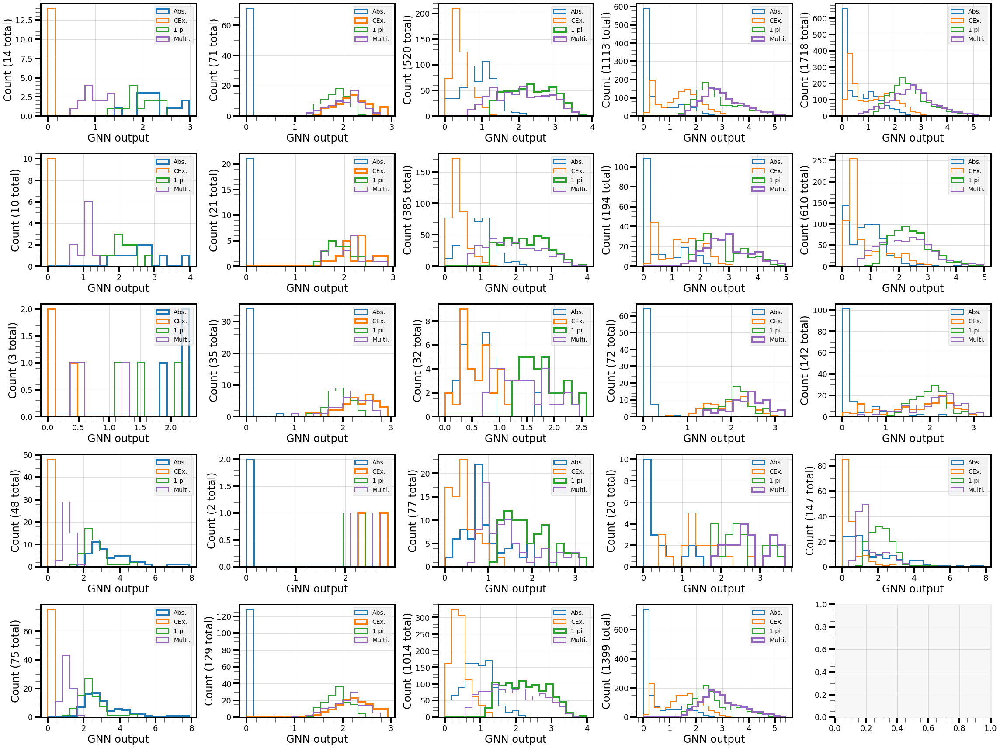

In [85]:
Models.per_region_dists(
    data_model,
    which_path_params["schema_path"],
    which_path_params["test_path"],
    plt_conf,
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."])

82/82 [==============================] - 1s 8ms/step


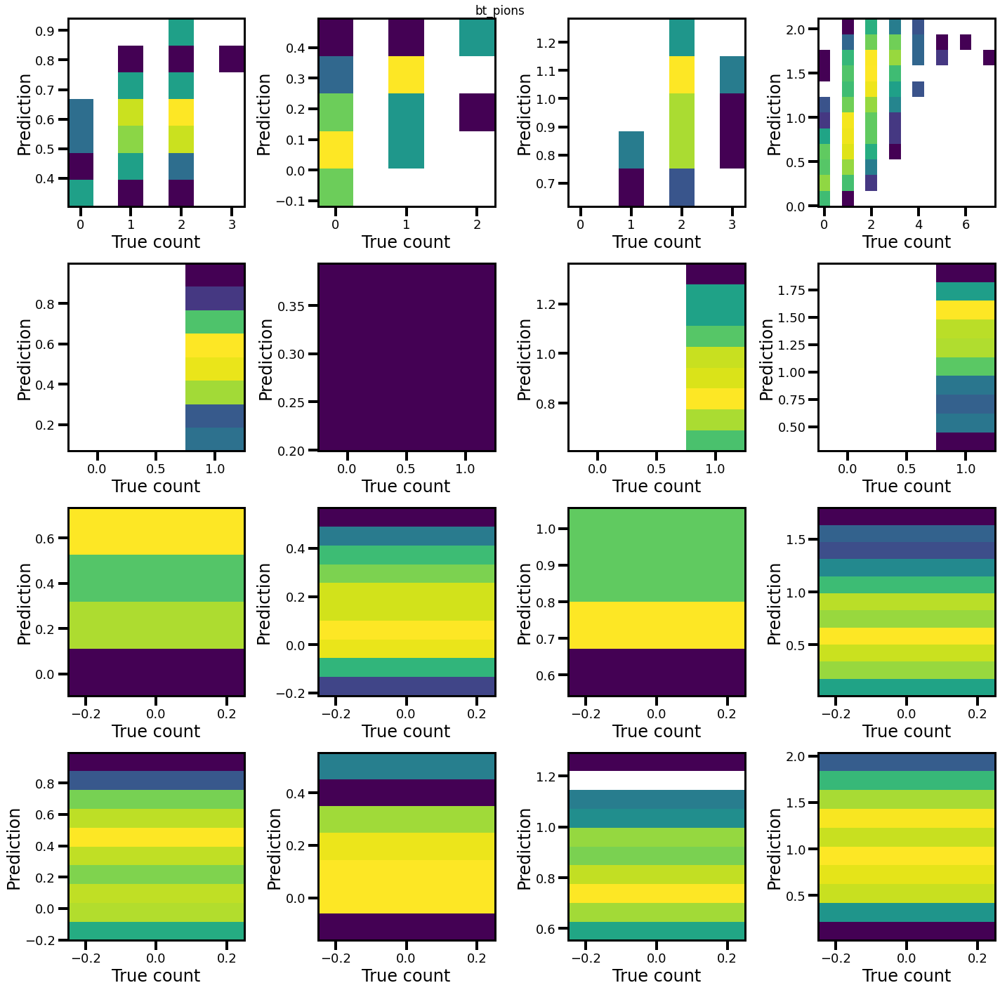

82/82 [==============================] - 1s 4ms/step


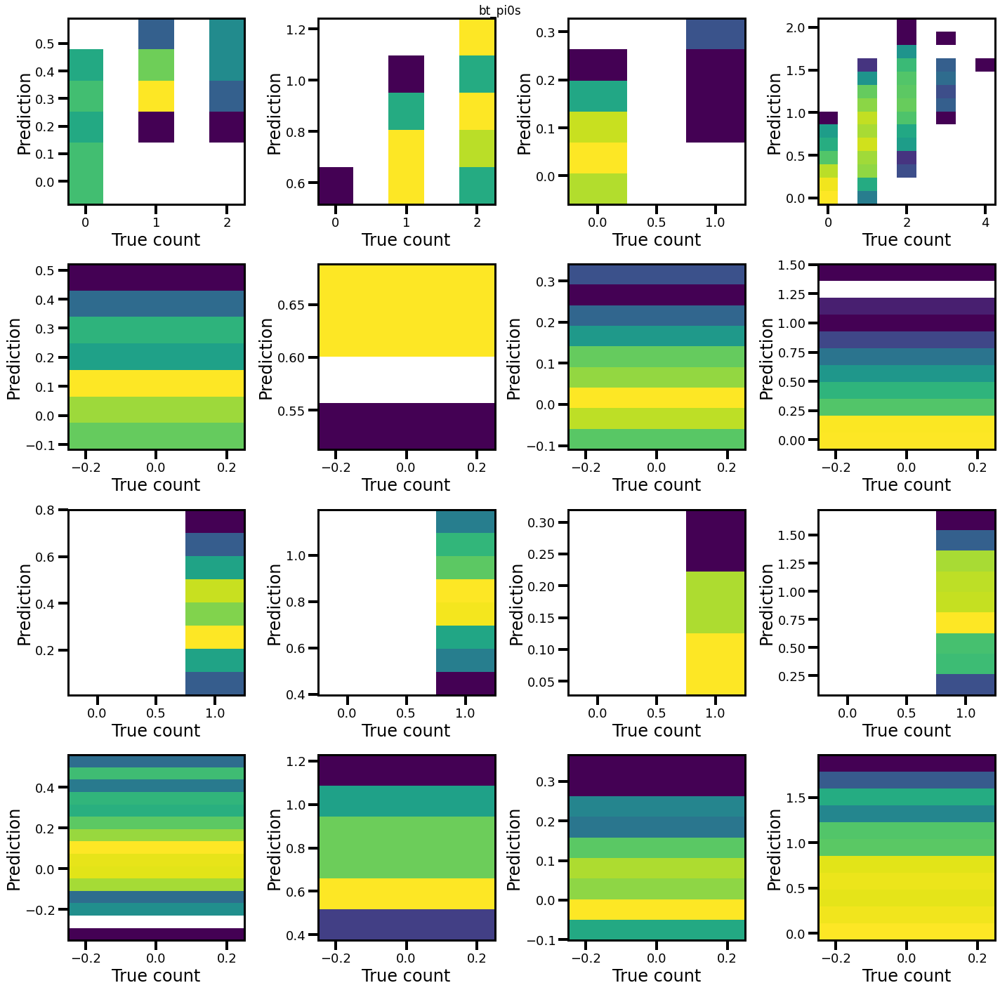

In [20]:
def plot_regr_all_channels(
        which_truth, which_ind,
        pred_region, true_region,
        model, path_params, labels=None):
    if labels is None:
        labels = ["abs", "cex", "1 pi", "multi"]
    full_preds, full_truths = Models.get_predicitions(
            model,
            path_params["schema_path"], path_params["test_path"],
            pred_index=which_ind, other_truth=which_truth)
    if isinstance(full_preds, tf.RaggedTensor):
        full_preds = np.hstack(tf.squeeze(full_preds, axis=-1))
    else:
        full_preds = ak.ravel(full_preds)
    full_truths = ak.ravel(full_truths)

    fig, axes = plt_conf.setup_figure(4, 4, figsize=(20, 20))
    fig.suptitle(which_truth)

    for true_i, true_name in enumerate(labels):
        for pred_i, pred_name in enumerate(labels):
            this_ax = axes[3-true_i, pred_i]
            this_mask = np.logical_and(pred_region == pred_i, true_region == float(true_i))
            if np.sum(this_mask) == 0:
                continue
            preds = full_preds[this_mask]
            truths = full_truths[this_mask]
            pred_bins = plt_conf.get_bins(preds, array=True)
            max_true = max(truths)
            true_bins = np.linspace(-0.25, max_true + 0.25, int(max_true)*2 + 2)
            this_ax.hist2d(
                truths, preds, norm=mpl.colors.LogNorm(), bins=(true_bins, pred_bins))
            # plt.scatter(
            #     truths, preds, **plot_config.gen_kwargs(index=0, marker="x"))
            plt_conf.format_axis(this_ax, xlog=False, ylog=False,
                                    xlabel="True count", ylabel="Prediction")
    return plt_conf.end_plot()

plot_regr_all_channels(
    "bt_pions", 1,
    reco_pred, reco_truth,
    data_model, which_path_params)

# plot_regr_all_channels(
#     "mc_pions", 1,
#     true_pred, true_truth,
#     data_model, which_path_params)
    
plot_regr_all_channels(
    "bt_pi0s", 2,
    reco_pred, reco_truth,
    data_model, which_path_params)

# plot_regr_all_channels(
#     "mc_pi0s", 2,
#     true_pred, true_truth,
#     data_model, which_path_params)


82/82 [==============================] - 1s 8ms/step


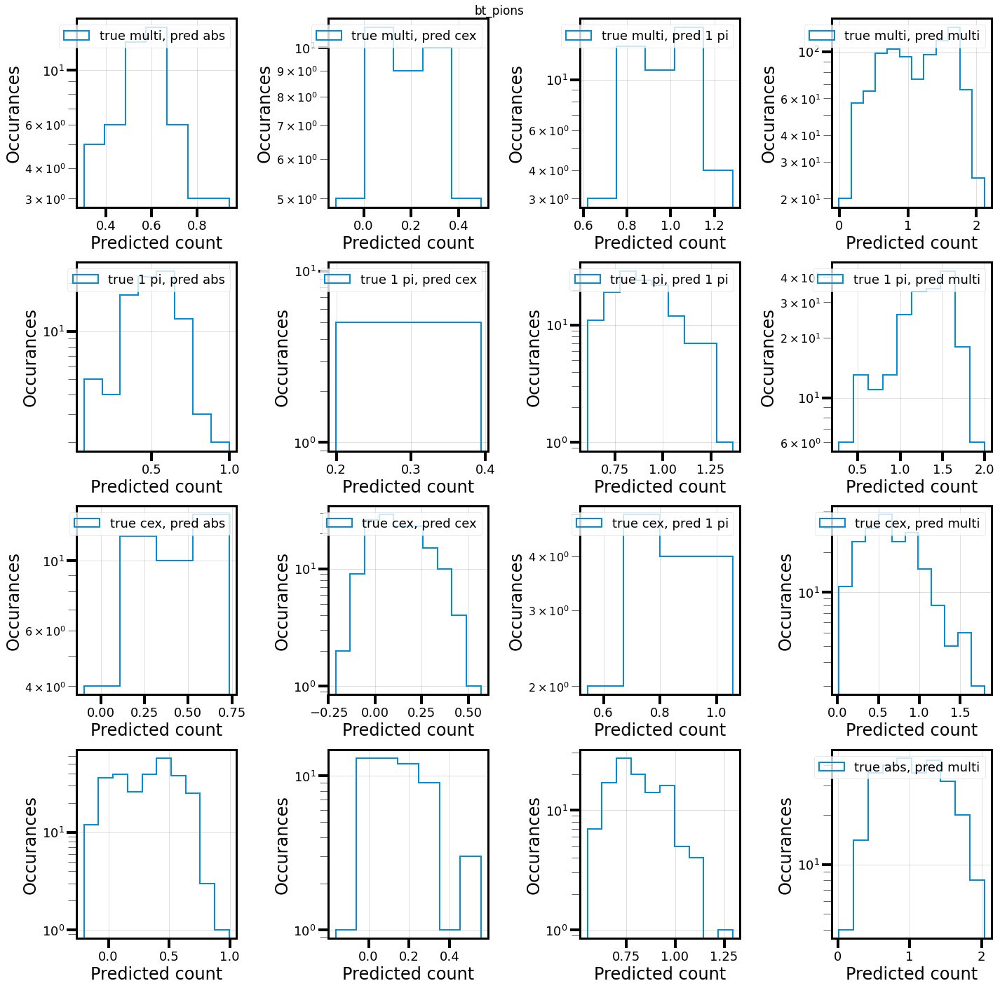

82/82 [==============================] - 1s 4ms/step


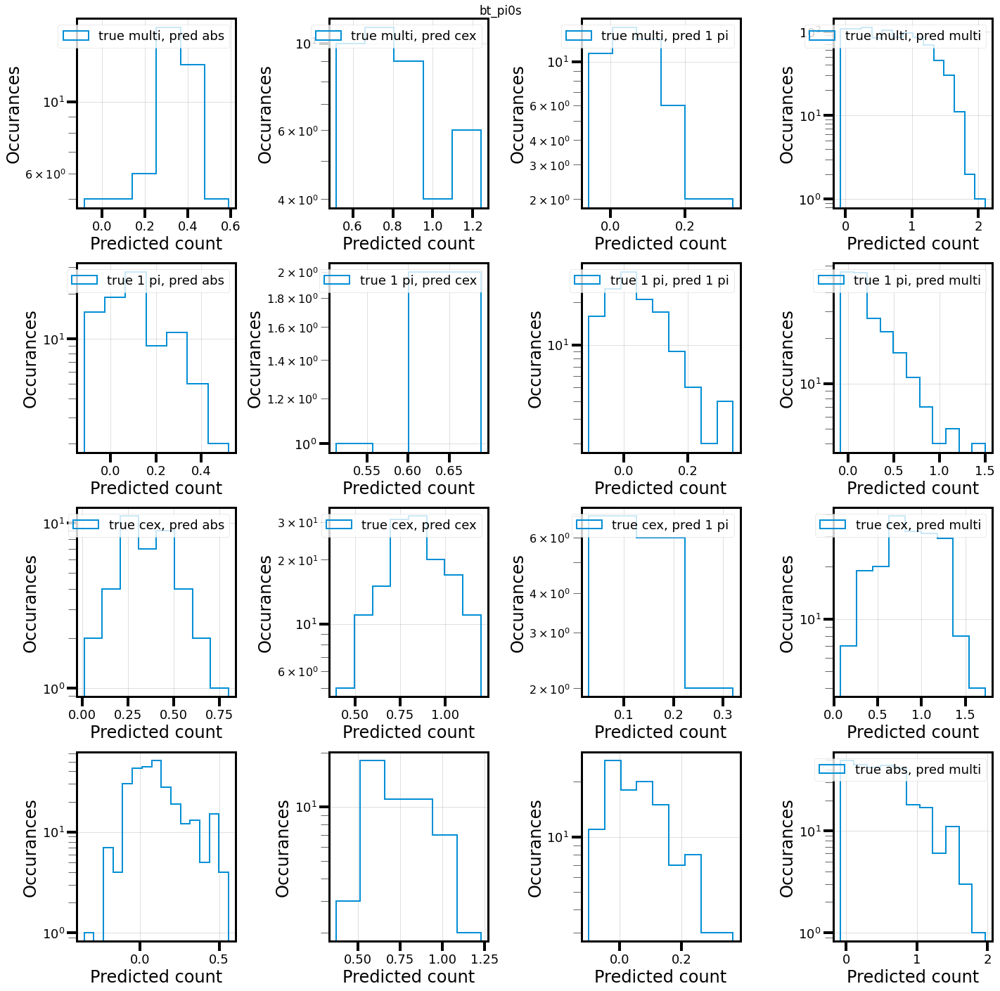

In [21]:
def plot_regr_hist_all_channels(
        which_truth, which_ind,
        pred_region, true_region,
        model, path_params, labels=None):
    if labels is None:
        labels = ["abs", "cex", "1 pi", "multi"]
    full_preds, full_truths = Models.get_predicitions(
            model,
            path_params["schema_path"], path_params["test_path"],
            pred_index=which_ind, other_truth=which_truth)
    if isinstance(full_preds, tf.RaggedTensor):
        full_preds = np.hstack(tf.squeeze(full_preds, axis=-1))
    else:
        full_preds = ak.ravel(full_preds)
    full_truths = ak.ravel(full_truths)

    fig, axes = plt_conf.setup_figure(4, 4, figsize=(20, 20))
    fig.suptitle(which_truth)

    for true_i, true_name in enumerate(labels):
        for pred_i, pred_name in enumerate(labels):
            this_ax = axes[3-true_i, pred_i]
            this_mask = np.logical_and(pred_region == pred_i, true_region == float(true_i))
            if np.sum(this_mask) == 0:
                continue
            preds = full_preds[this_mask]
            pred_bins = plt_conf.get_bins(preds, array=True)
            this_ax.hist(
                preds, **plt_conf.gen_kwargs(
                    index=0, bins=pred_bins, label=f"true {true_name}, pred {pred_name}",
                    density=False, histtype="step"))
            plt_conf.format_axis(this_ax, xlog=False, ylog=True,
                                    xlabel="Predicted count", ylabel="Occurances")
    return plt_conf.end_plot()

plot_regr_hist_all_channels(
    "bt_pions", 1,
    reco_pred, reco_truth,
    data_model, which_path_params)
    
plot_regr_hist_all_channels(
    "bt_pi0s", 2,
    reco_pred, reco_truth,
    data_model, which_path_params)

In [ ]:
which_path_params = bt_reco_pfo_path_params

/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/truth_models/Model_truth_80_multi_loss_reco_classification_reco_pfo_data_GATv2_early_pid
82/82 [==============================] - 2s 9ms/step
2617 events searched.
1861 events correctly classified (756 false), for an efficiency of 71.11%.
For Abs.: 40.14% efficiency, 93.65% purity (product: 37.59%).
For CEx.: 24.65% efficiency, 40.70% purity (product: 10.03%).
For 1 pi: 85.90% efficiency, 50.78% purity (product: 43.62%).
For Multi.: 72.35% efficiency, 86.56% purity (product: 62.63%).



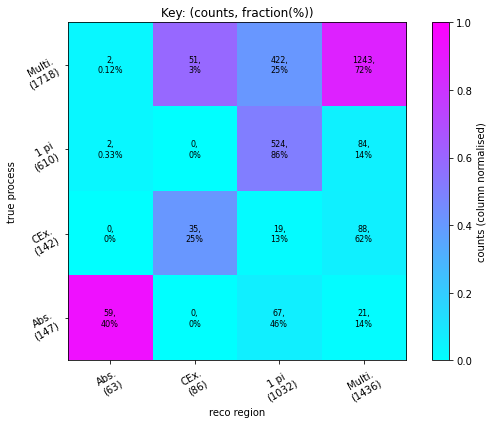

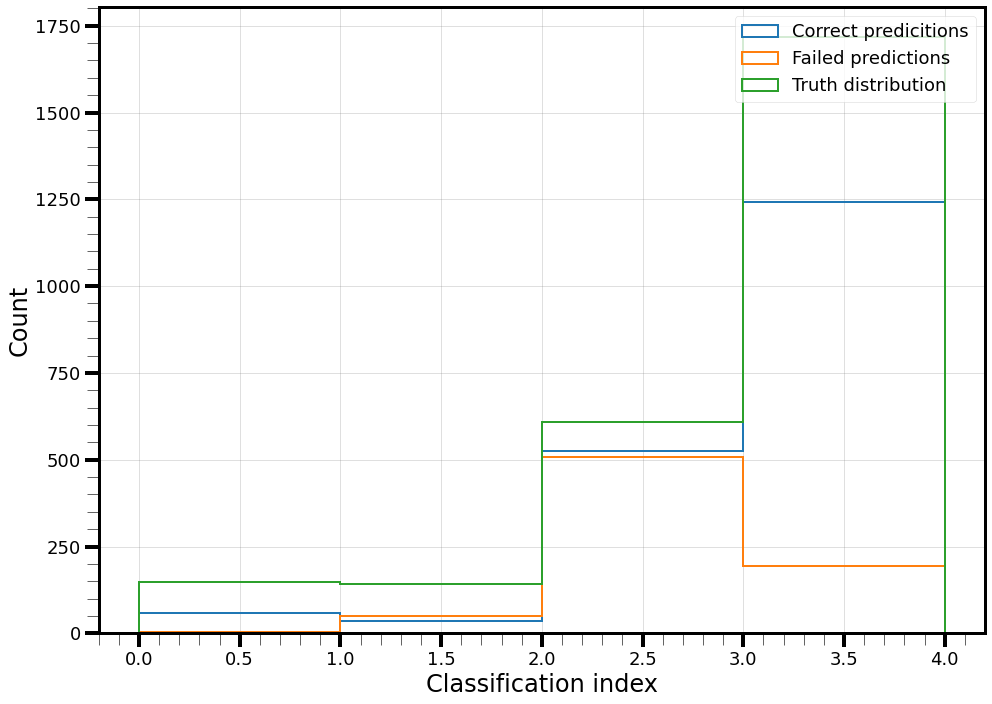

In [14]:
# loaded_model = tf.keras.models.load_model(bt_hyper_params["model_path"])
print(bt_hyper_params["folder_path"])
true_pred, true_truth = Models.evaluate_model(
    # loaded_model,
    bt_model,
    which_path_params["schema_path"],
    which_path_params["test_path"],
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."],
    plot_config=plt_conf)

82/82 [==============================] - 1s 8ms/step
Found predictions ranging between -14.736 and 0.521.


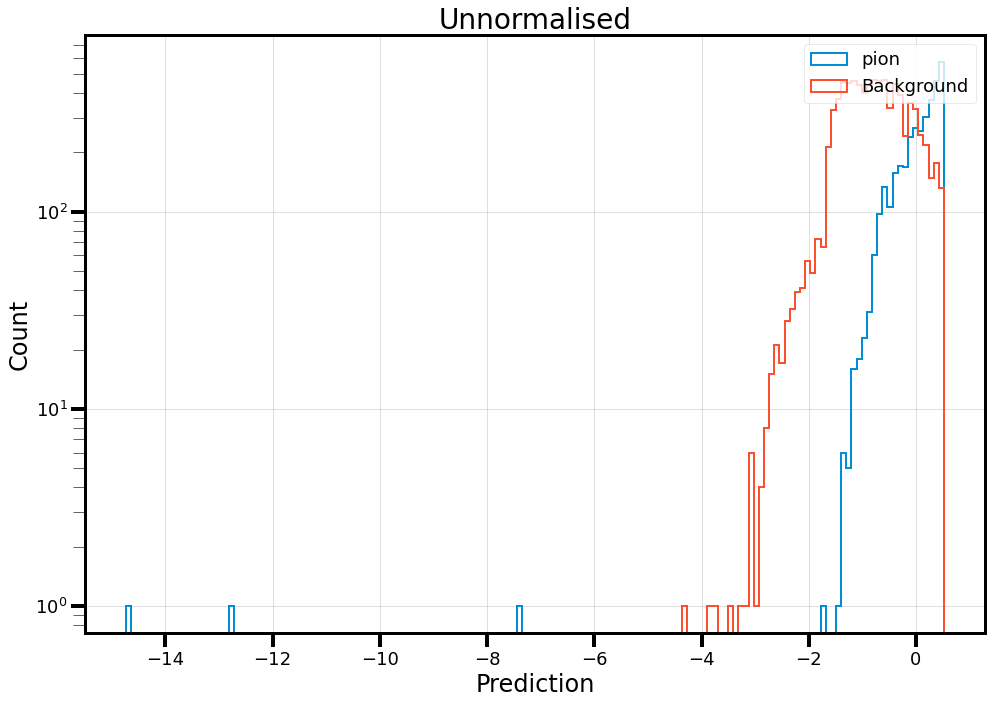

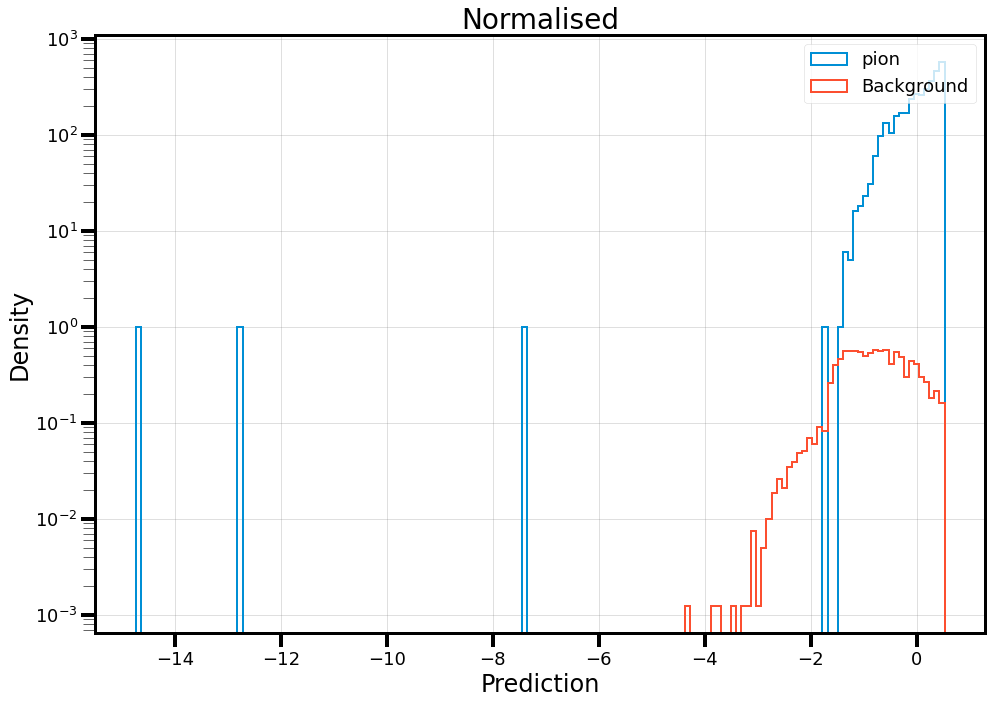

82/82 [==============================] - 1s 8ms/step
Found predictions ranging between -24.712 and 1.621.


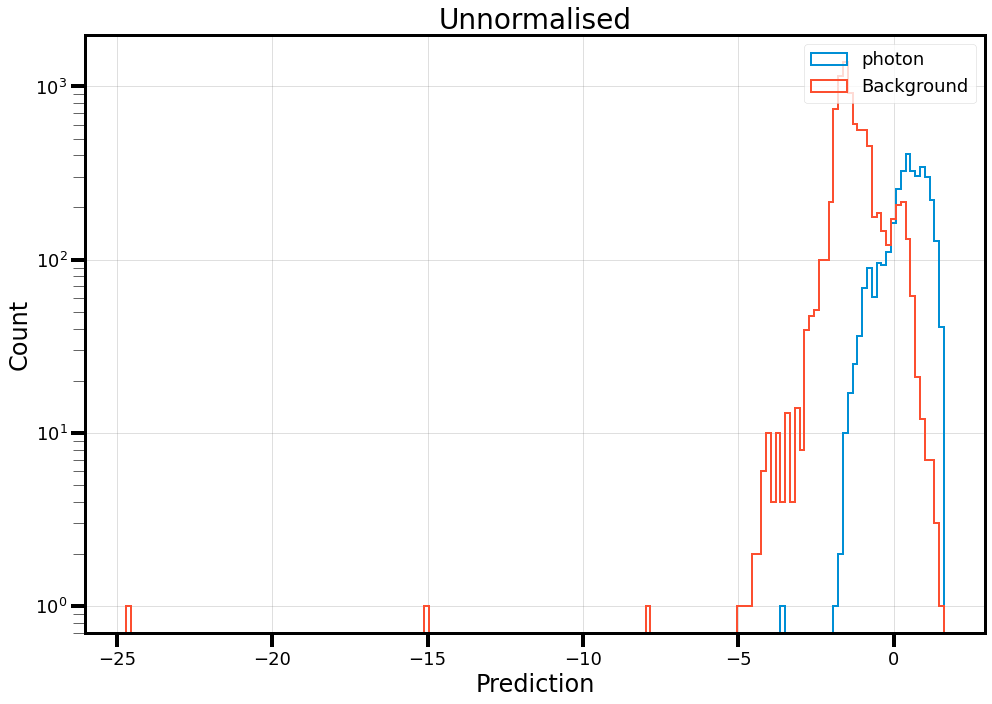

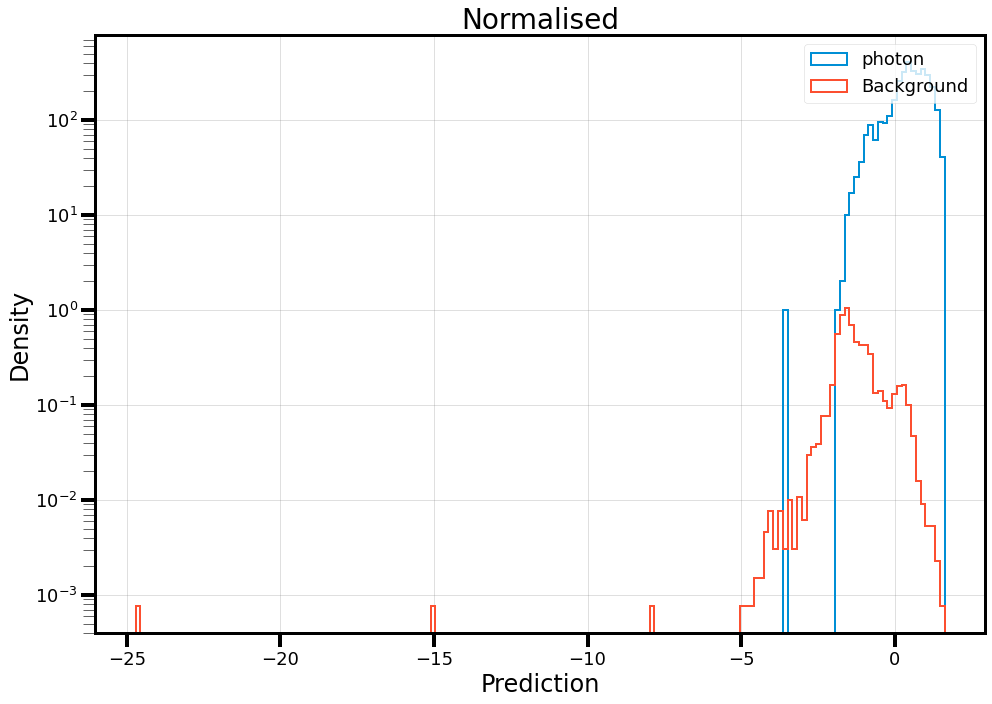

82/82 [==============================] - 1s 8ms/step
Found predictions ranging between -58.043 and -0.282.


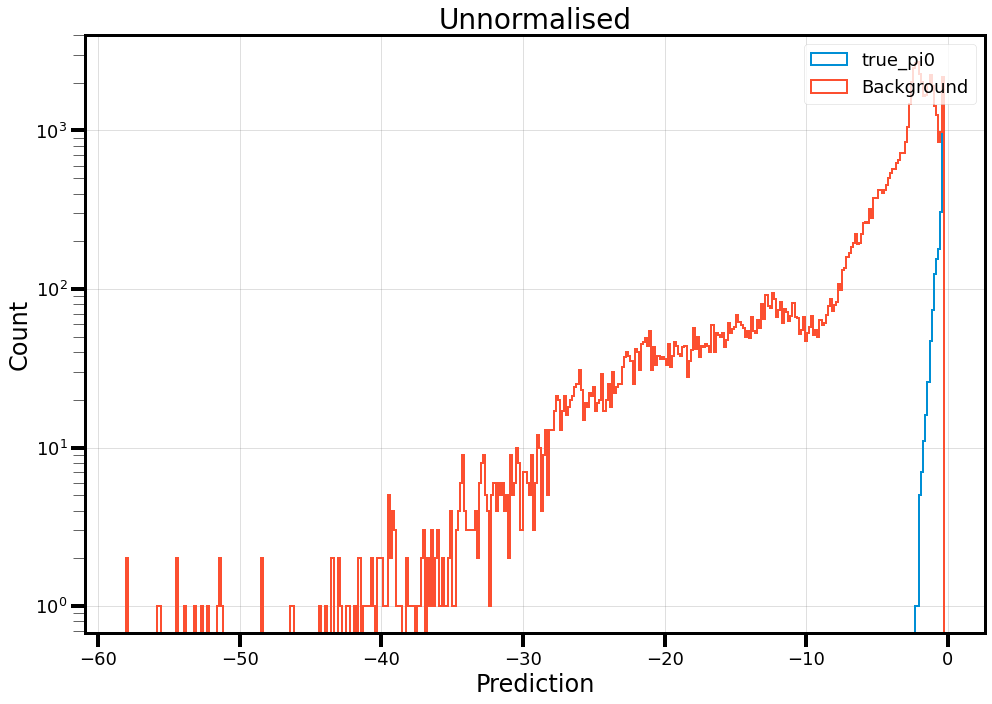

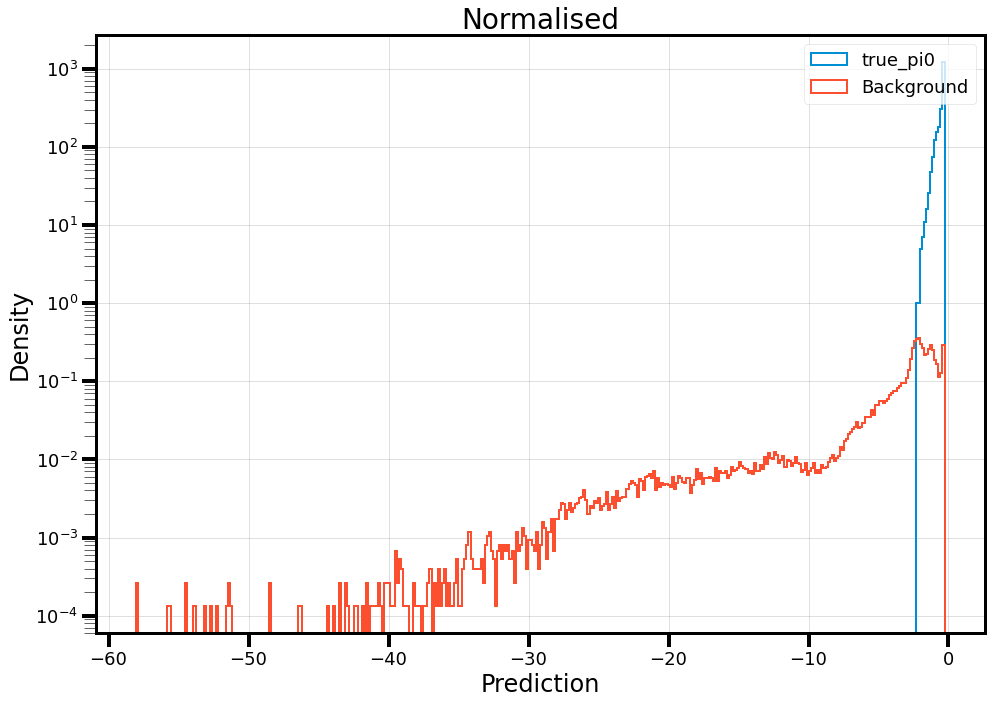

In [15]:
Models.plot_binary_extra_loss_dist(
    bt_model,
    "pion", 3,
    which_path_params, plt_conf)
Models.plot_binary_extra_loss_dist(
    bt_model,
    "photon", 4,
    which_path_params, plt_conf)
Models.plot_binary_extra_loss_dist(
    bt_model,
    "true_pi0", 5,#3,
    which_path_params, plt_conf)

82/82 [==============================] - 2s 9ms/step


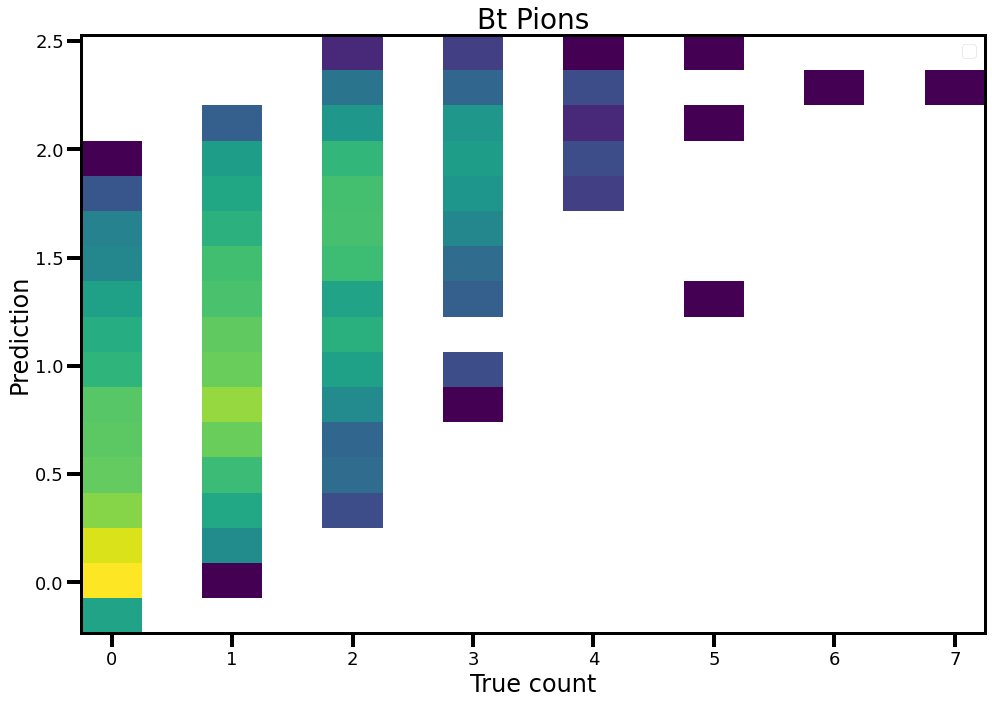

82/82 [==============================] - 1s 4ms/step


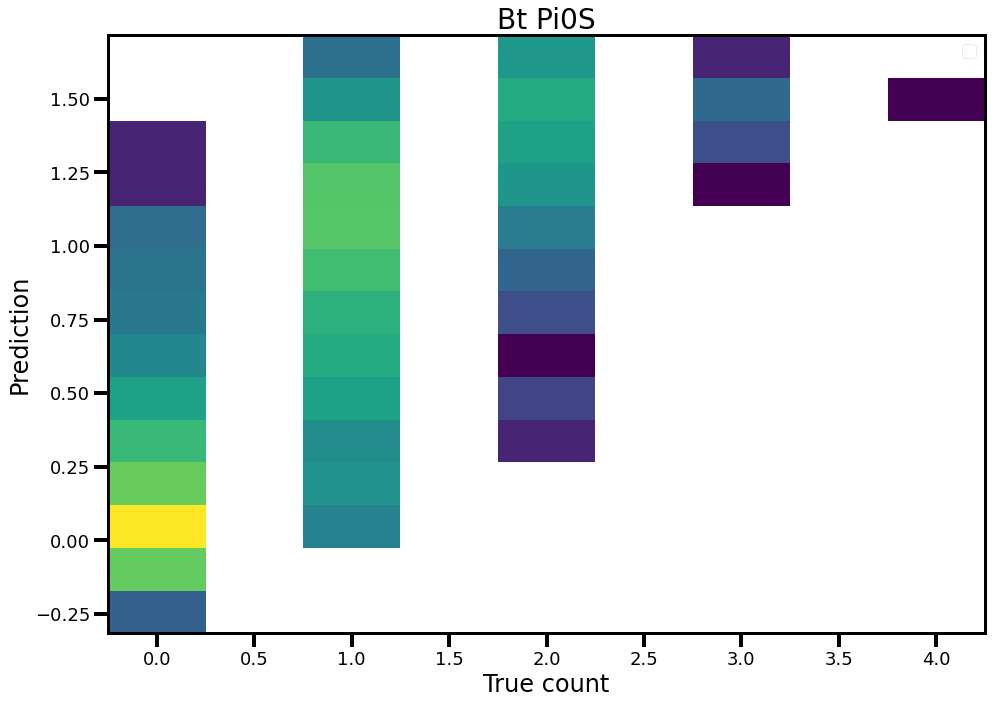

In [16]:
which_true = "bt" # "mc"
Models.plot_regression_extra_loss_dist(
    bt_model,
    f"{which_true}_pions", 1,
    which_path_params, plt_conf)
Models.plot_regression_extra_loss_dist(
    bt_model,
    f"{which_true}_pi0s", 2,
    which_path_params, plt_conf)

82/82 [==============================] - 2s 9ms/step


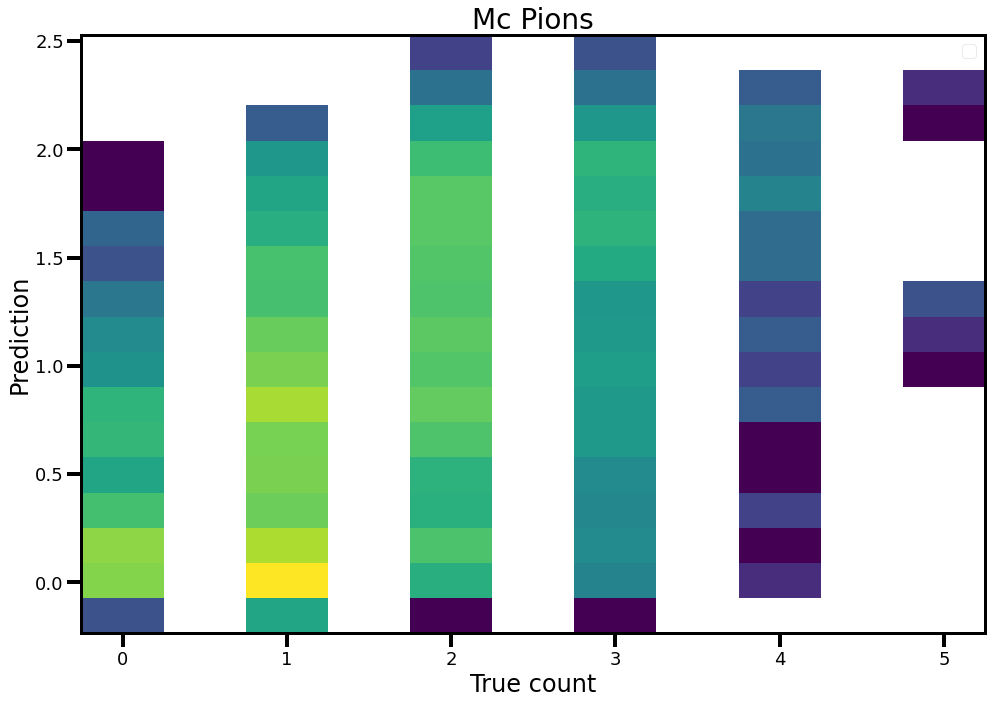

82/82 [==============================] - 2s 4ms/step


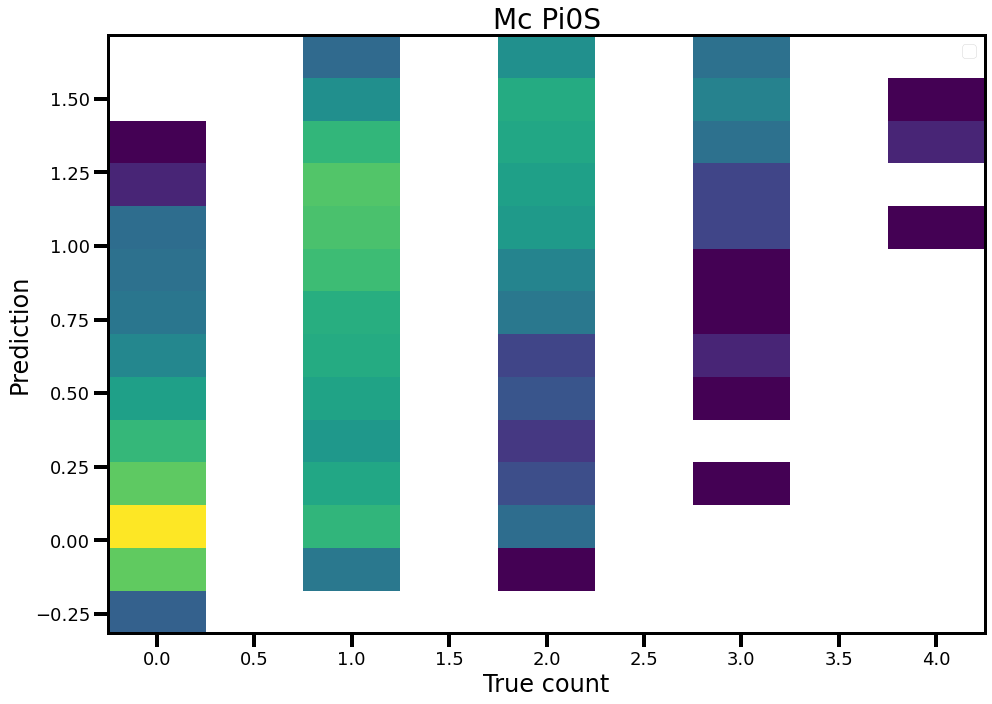

In [17]:
which_true = "mc"
Models.plot_regression_extra_loss_dist(
    bt_model,
    f"{which_true}_pions", 1,
    which_path_params, plt_conf)
Models.plot_regression_extra_loss_dist(
    bt_model,
    f"{which_true}_pi0s", 2,
    which_path_params, plt_conf)

82/82 [==============================] - 2s 9ms/step
2617 events searched.
1918 events correctly classified (699 false), for an efficiency of 73.29%.
For Abs.: 81.01% efficiency, 84.06% purity (product: 68.09%).
For CEx.: 54.40% efficiency, 65.83% purity (product: 35.81%).
For 1 pi: 57.77% efficiency, 56.08% purity (product: 32.40%).
For Multi.: 81.09% efficiency, 75.52% purity (product: 61.23%).



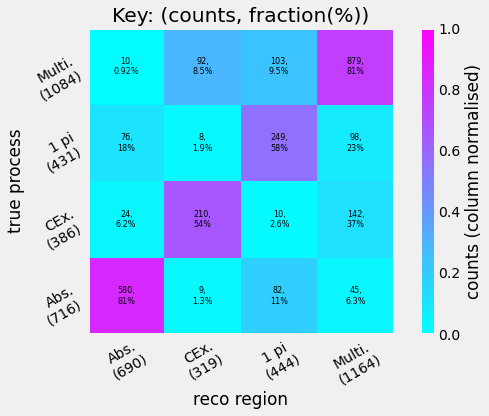

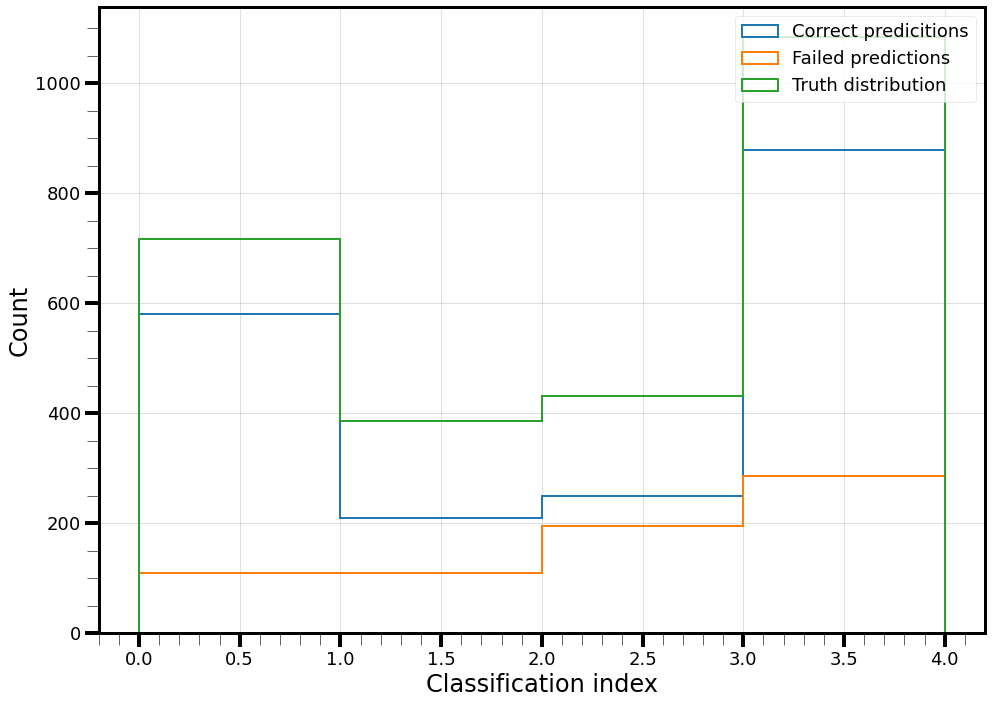

In [18]:
reco_pred, reco_truth = Models.plot_confusion_extra_loss(
    bt_model,
    "reco_class", -1,
    which_path_params,
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."],
    plot_config=plt_conf)

82/82 [==============================] - 0s 3ms/step
2617 events searched.
1436 events correctly classified (1181 false), for an efficiency of 54.87%.
For Abs.: 8.52% efficiency, 96.83% purity (product: 8.25%).
For CEx.: 19.69% efficiency, 88.37% purity (product: 17.40%).
For 1 pi: 74.48% efficiency, 31.10% purity (product: 23.17%).
For Multi.: 90.22% efficiency, 68.11% purity (product: 61.45%).



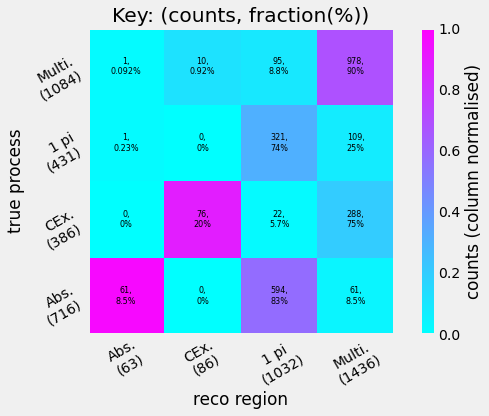

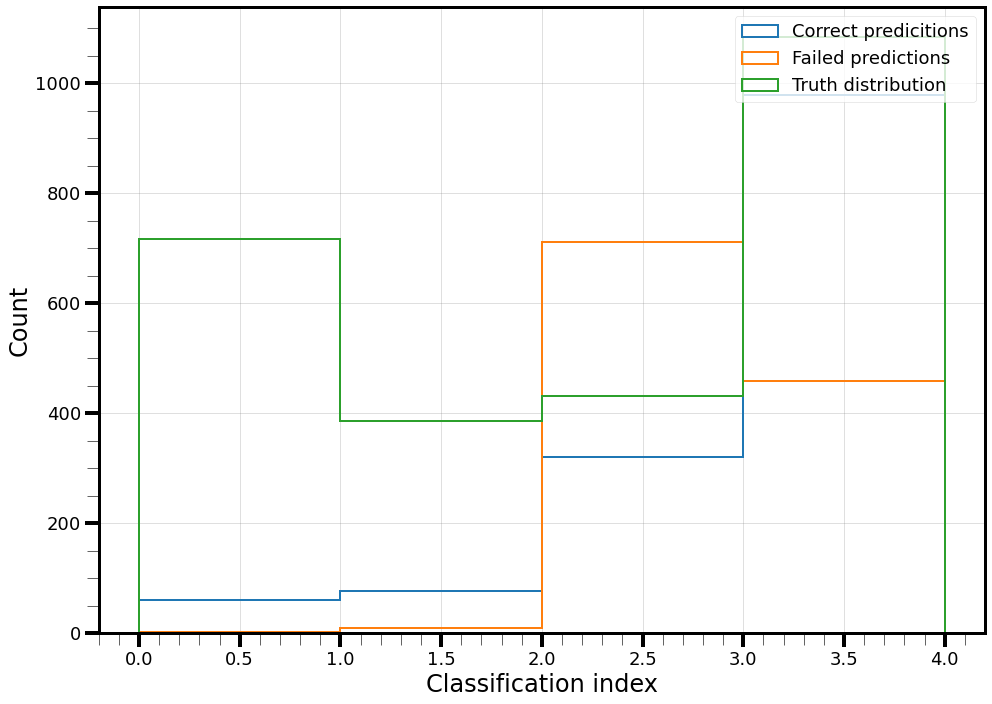

(array([2, 3, 3, ..., 2, 3, 2]), array([2., 3., 3., ..., 0., 1., 2.]))

In [19]:
# reload(Models)
Models.plot_confusion_main_vs_reco_loss(
    bt_model,
    "reco_class", -1,
    which_path_params,
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."],
    plot_config=plt_conf)

82/82 [==============================] - 1s 8ms/step


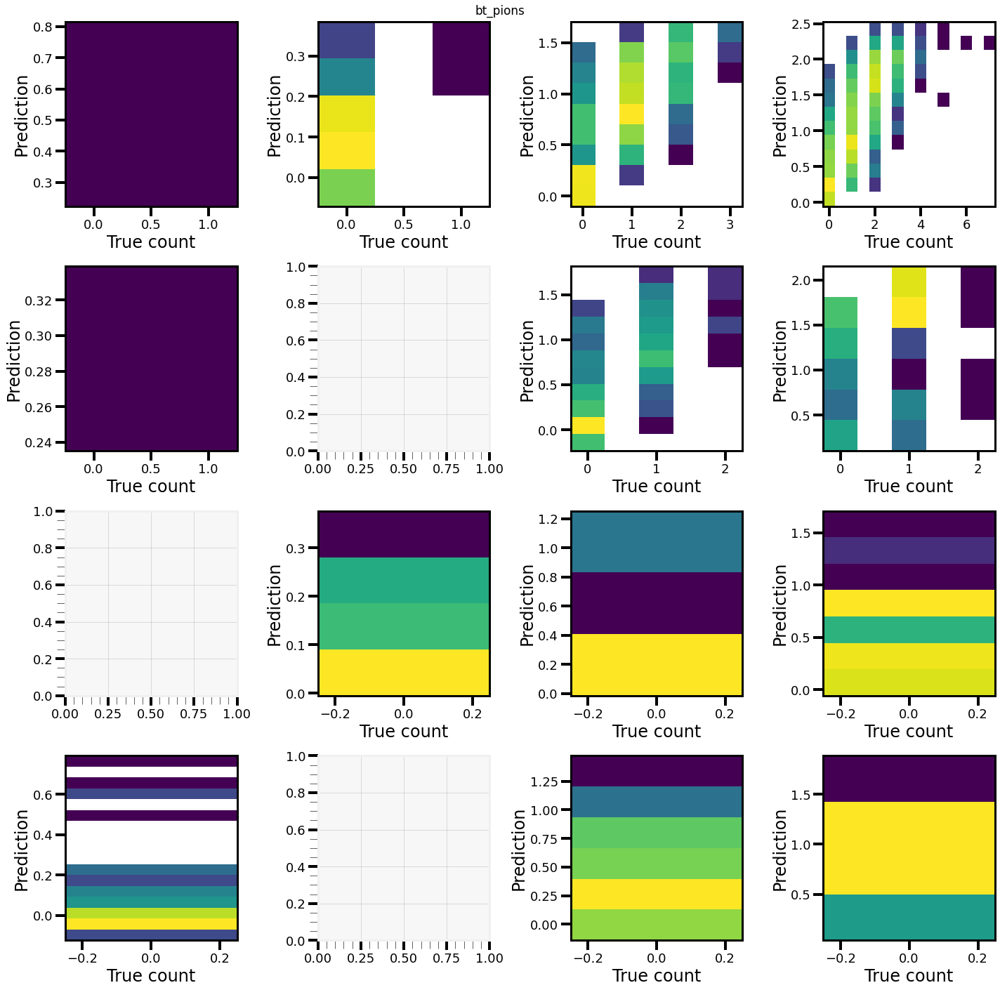

82/82 [==============================] - 0s 3ms/step


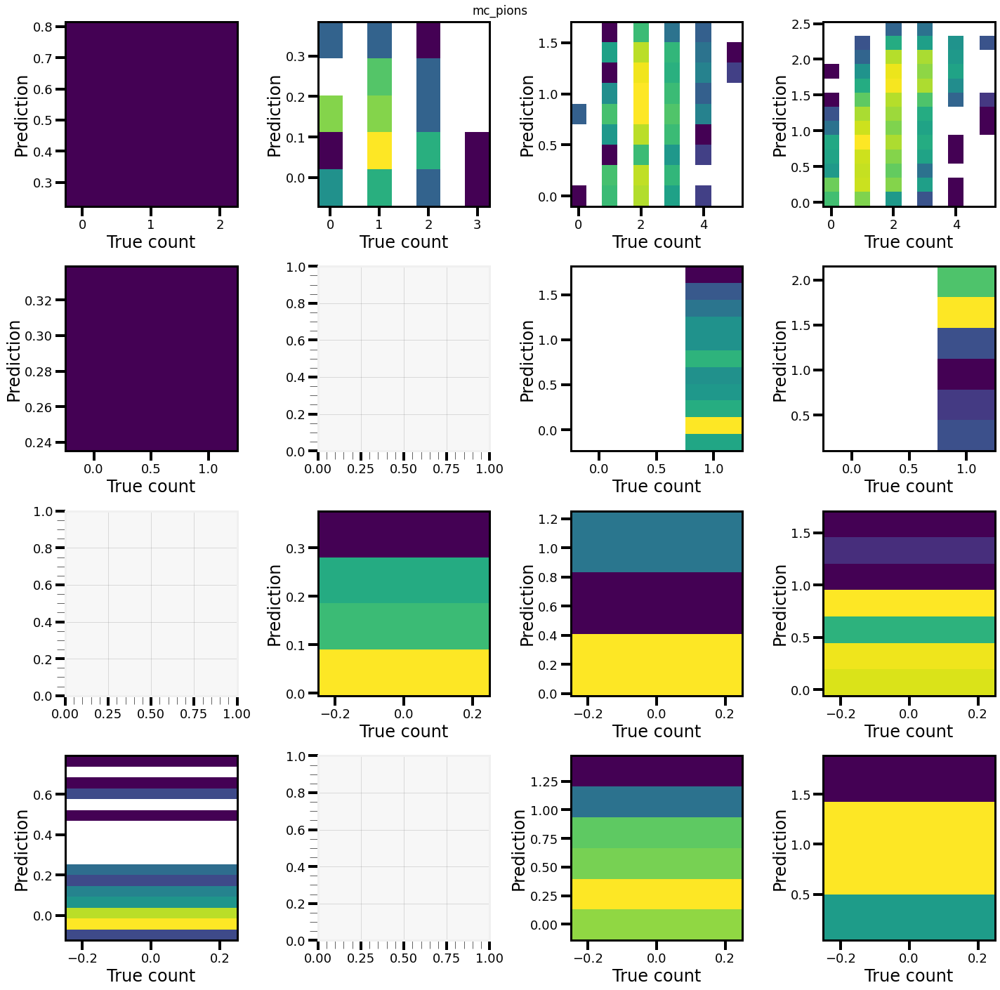

82/82 [==============================] - 1s 4ms/step


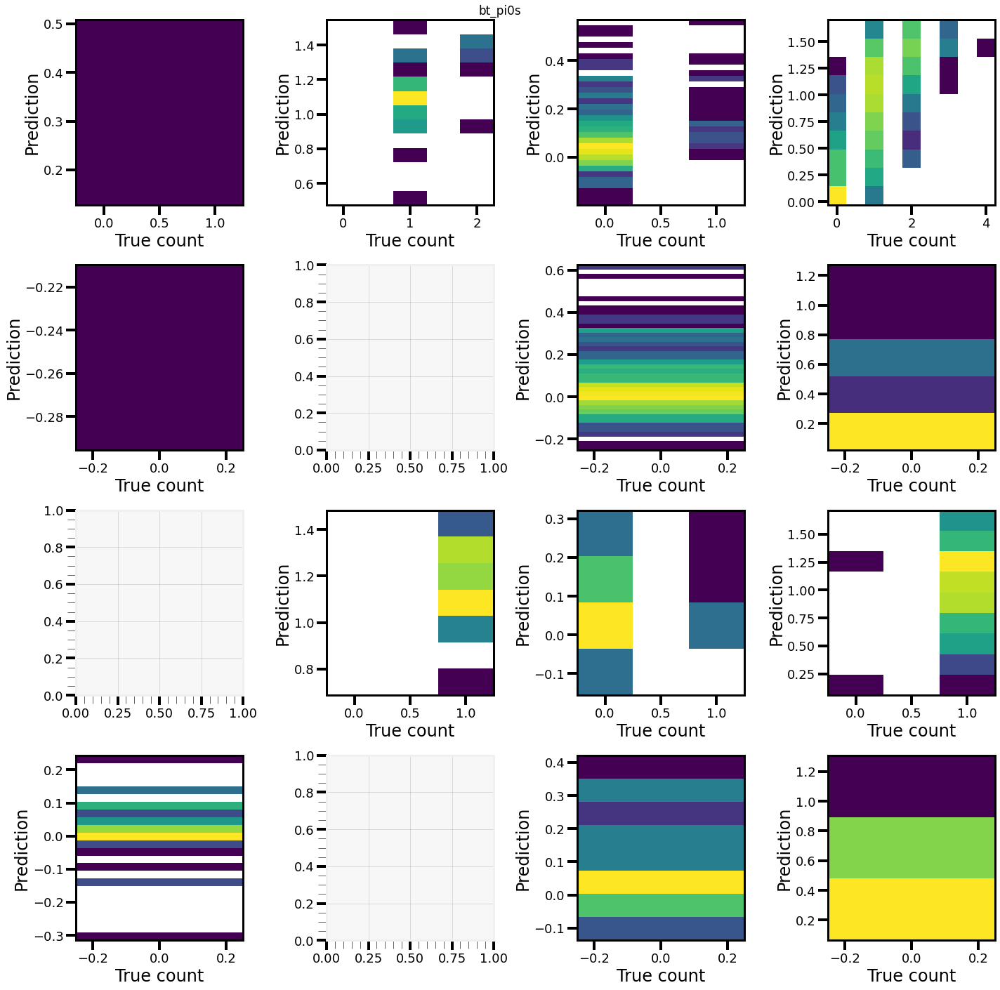

82/82 [==============================] - 0s 3ms/step


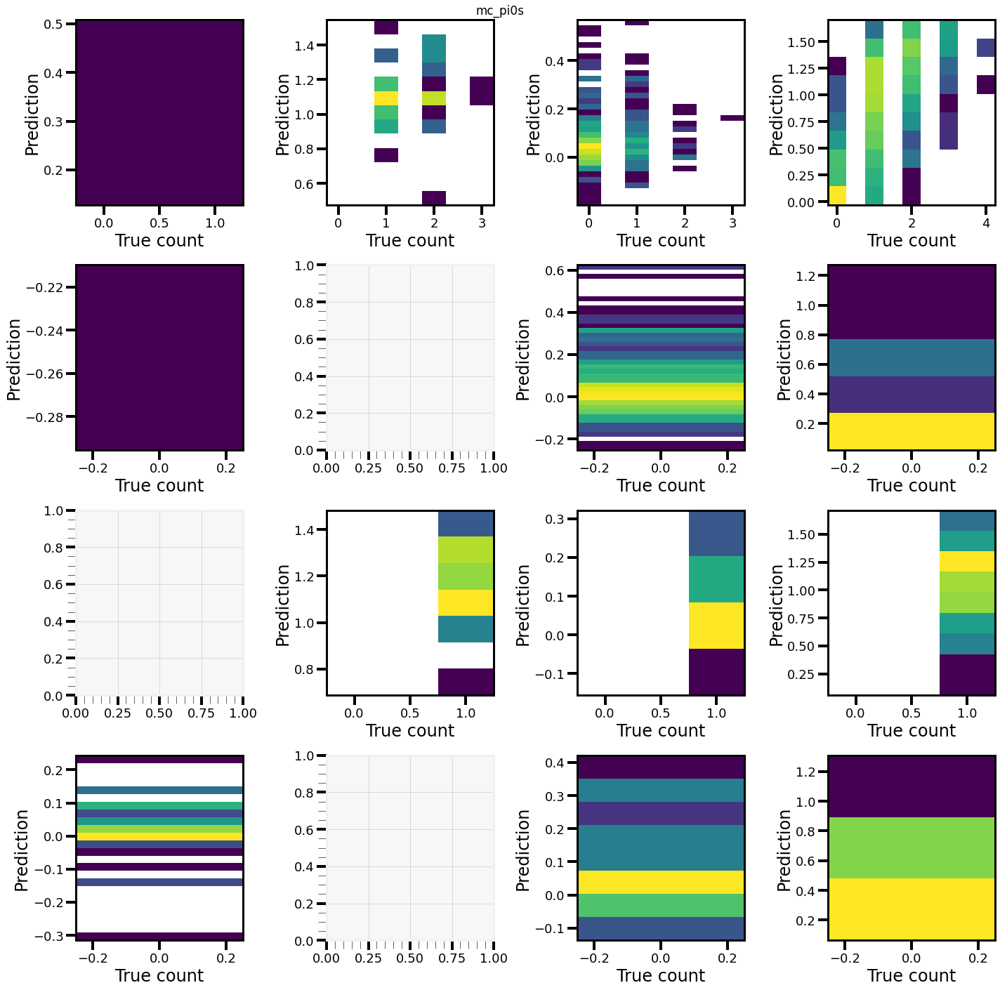

In [20]:
def plot_regr_all_channels(
        which_truth, which_ind,
        pred_region, true_region,
        model, path_params, labels=None):
    if labels is None:
        labels = ["abs", "cex", "1 pi", "multi"]
    full_preds, full_truths = Models.get_predicitions(
            model,
            path_params["schema_path"], path_params["test_path"],
            pred_index=which_ind, other_truth=which_truth)
    if isinstance(full_preds, tf.RaggedTensor):
        full_preds = np.hstack(tf.squeeze(full_preds, axis=-1))
    else:
        full_preds = ak.ravel(full_preds)
    full_truths = ak.ravel(full_truths)

    fig, axes = plt_conf.setup_figure(4, 4, figsize=(20, 20))
    fig.suptitle(which_truth)

    for true_i, true_name in enumerate(labels):
        for pred_i, pred_name in enumerate(labels):
            this_ax = axes[3-true_i, pred_i]
            this_mask = np.logical_and(pred_region == pred_i, true_region == float(true_i))
            if np.sum(this_mask) == 0:
                continue
            preds = full_preds[this_mask]
            truths = full_truths[this_mask]
            pred_bins = plt_conf.get_bins(preds, array=True)
            max_true = max(truths)
            true_bins = np.linspace(-0.25, max_true + 0.25, int(max_true)*2 + 2)
            this_ax.hist2d(
                truths, preds, norm=mpl.colors.LogNorm(), bins=(true_bins, pred_bins))
            # plt.scatter(
            #     truths, preds, **plot_config.gen_kwargs(index=0, marker="x"))
            plt_conf.format_axis(this_ax, xlog=False, ylog=False,
                                    xlabel="True count", ylabel="Prediction")
    return plt_conf.end_plot()

plot_regr_all_channels(
    "bt_pions", 1,
    true_pred, true_truth,
    bt_model, which_path_params)

plot_regr_all_channels(
    "mc_pions", 1,
    true_pred, true_truth,
    bt_model, which_path_params)
    
plot_regr_all_channels(
    "bt_pi0s", 2,
    true_pred, true_truth,
    bt_model, which_path_params)

plot_regr_all_channels(
    "mc_pi0s", 2,
    true_pred, true_truth,
    bt_model, which_path_params)


82/82 [==============================] - 1s 8ms/step


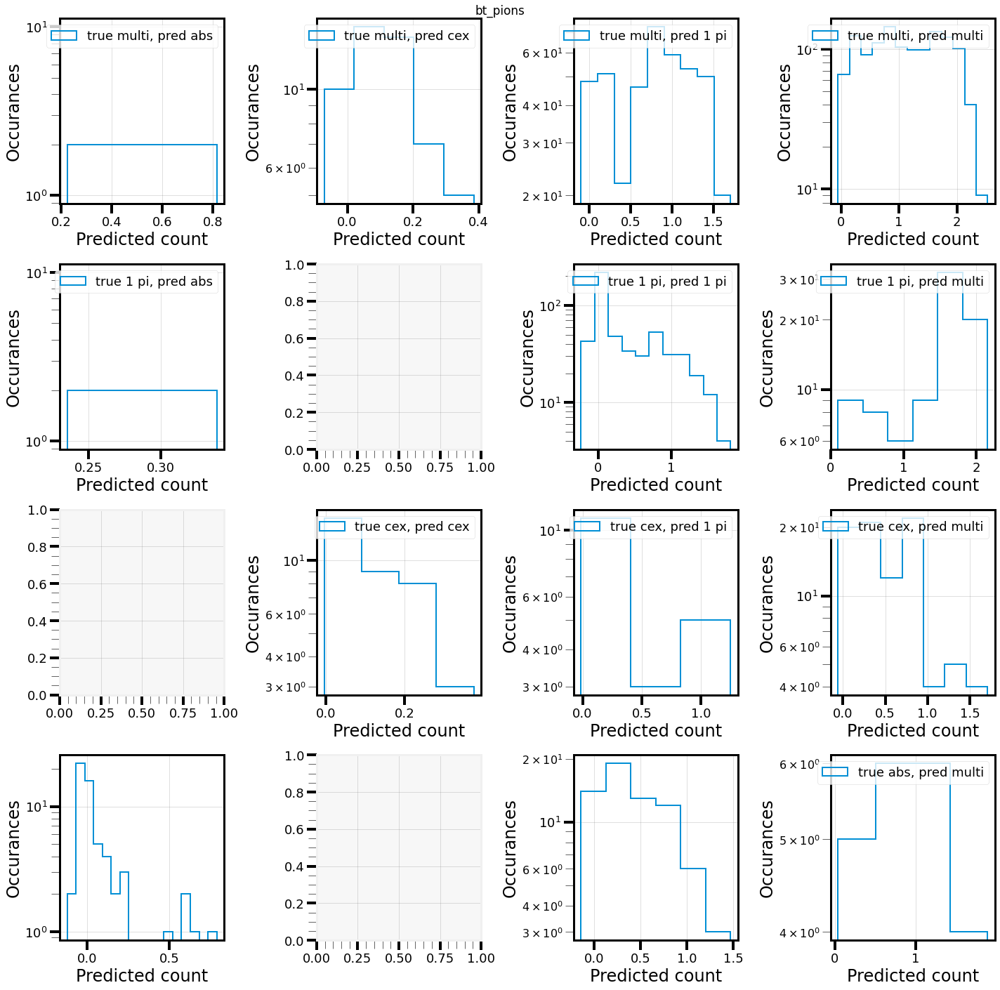

82/82 [==============================] - 0s 3ms/step


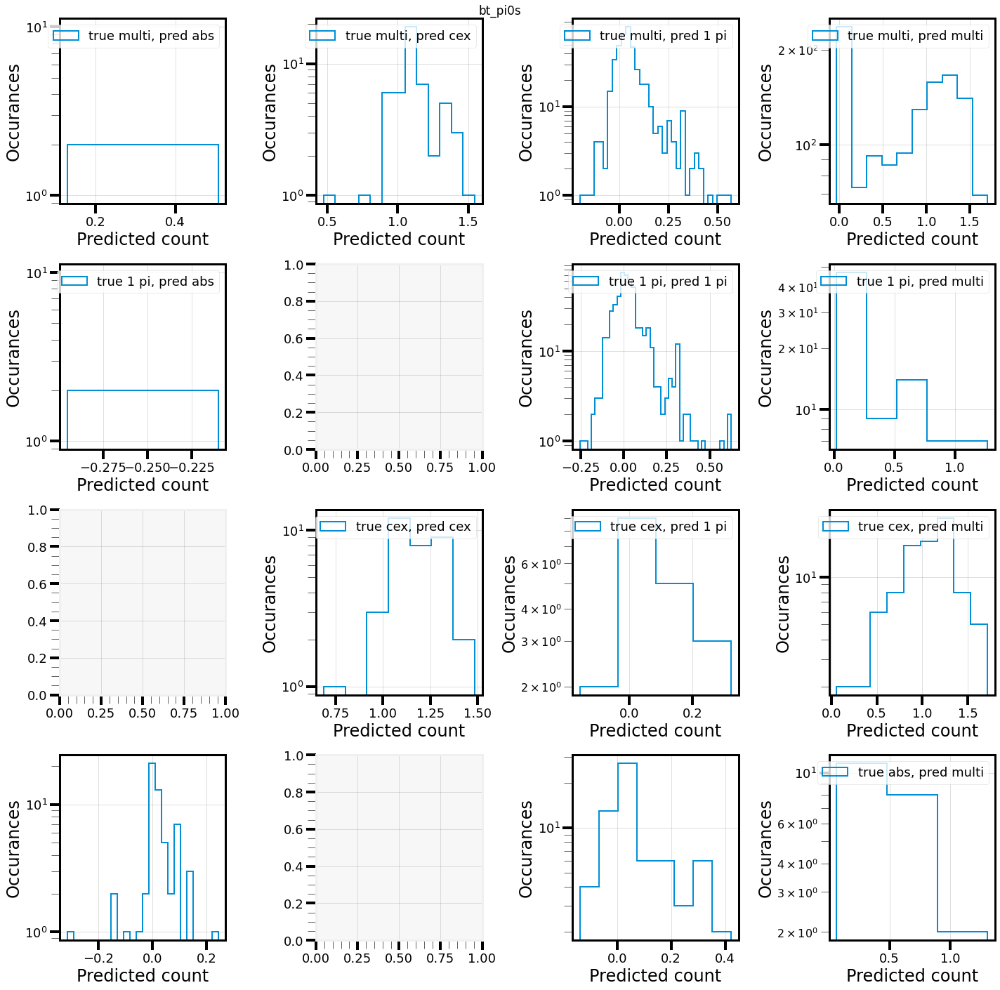

In [27]:
def plot_regr_hist_all_channels(
        which_truth, which_ind,
        pred_region, true_region,
        model, path_params, labels=None):
    if labels is None:
        labels = ["abs", "cex", "1 pi", "multi"]
    full_preds, full_truths = Models.get_predicitions(
            model,
            path_params["schema_path"], path_params["test_path"],
            pred_index=which_ind, other_truth=which_truth)
    if isinstance(full_preds, tf.RaggedTensor):
        full_preds = np.hstack(tf.squeeze(full_preds, axis=-1))
    else:
        full_preds = ak.ravel(full_preds)
    full_truths = ak.ravel(full_truths)

    fig, axes = plt_conf.setup_figure(4, 4, figsize=(20, 20))
    fig.suptitle(which_truth)

    for true_i, true_name in enumerate(labels):
        for pred_i, pred_name in enumerate(labels):
            this_ax = axes[3-true_i, pred_i]
            this_mask = np.logical_and(pred_region == pred_i, true_region == float(true_i))
            if np.sum(this_mask) == 0:
                continue
            preds = full_preds[this_mask]
            pred_bins = plt_conf.get_bins(preds, array=True)
            this_ax.hist(
                preds, **plt_conf.gen_kwargs(
                    index=0, bins=pred_bins, label=f"true {true_name}, pred {pred_name}",
                    density=False, histtype="step"))
            plt_conf.format_axis(this_ax, xlog=False, ylog=True,
                                    xlabel="Predicted count", ylabel="Occurances")
    return plt_conf.end_plot()

plot_regr_hist_all_channels(
    "bt_pions", 1,
    true_pred, true_truth,
    bt_model, which_path_params)
    
plot_regr_hist_all_channels(
    "bt_pi0s", 2,
    true_pred, true_truth,
    bt_model, which_path_params)

82/82 [==============================] - 1s 8ms/step


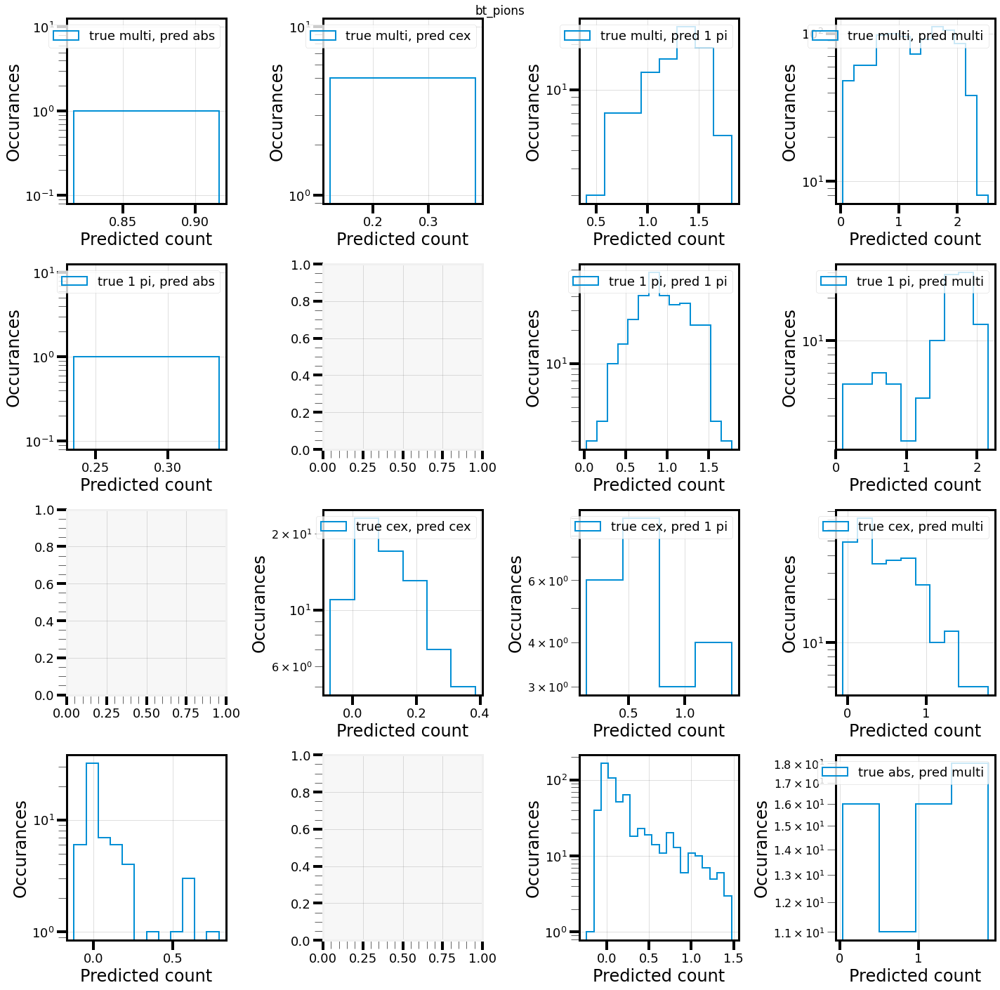

82/82 [==============================] - 1s 4ms/step


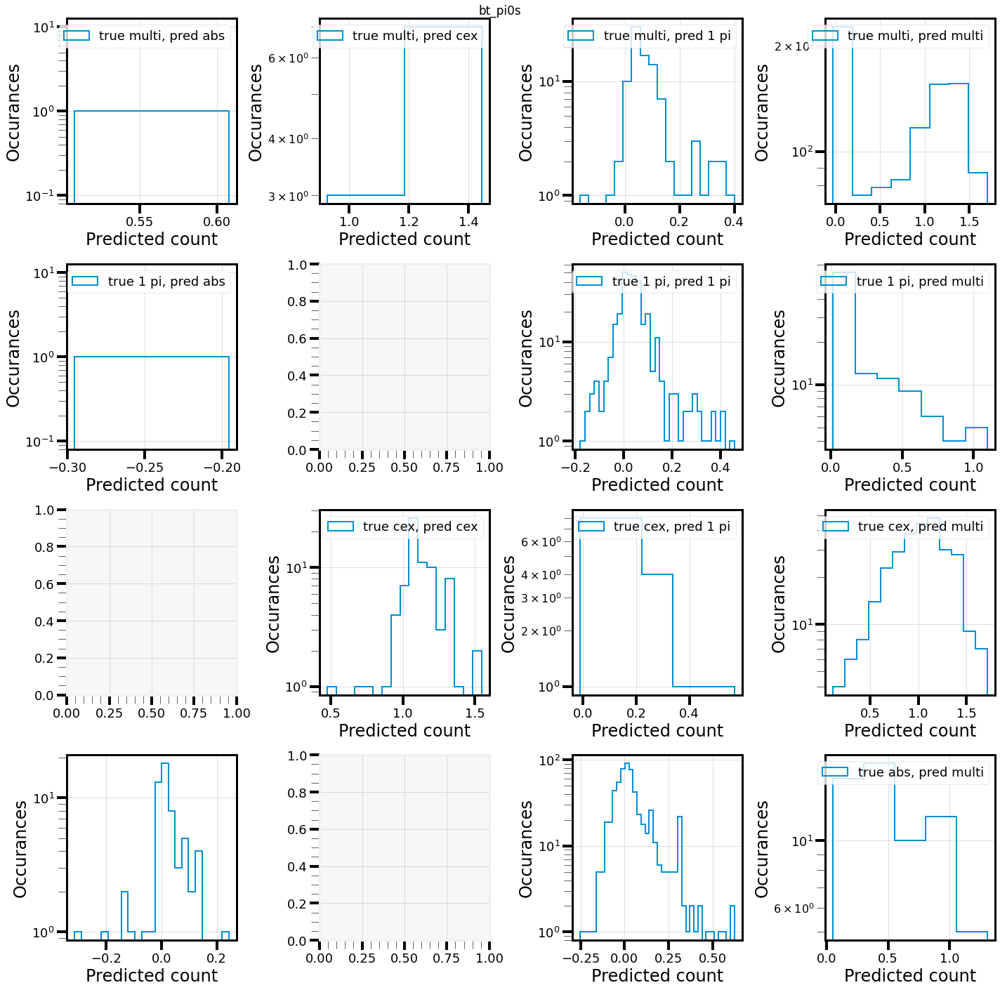

In [28]:
plot_regr_hist_all_channels(
    "bt_pions", 1,
    true_pred, reco_truth,
    bt_model, which_path_params)
    
plot_regr_hist_all_channels(
    "bt_pi0s", 2,
    true_pred, reco_truth,
    bt_model, which_path_params)

82/82 [==============================] - 1s 4ms/step


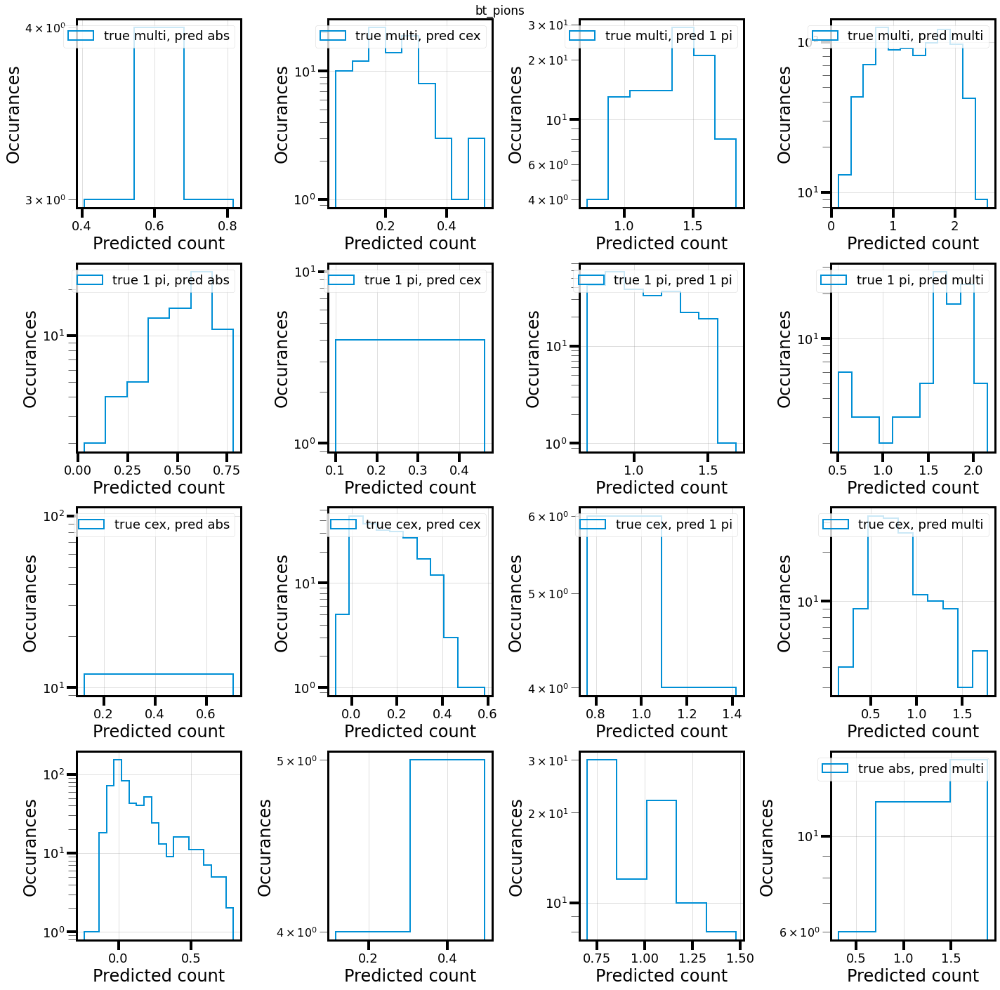

82/82 [==============================] - 0s 4ms/step


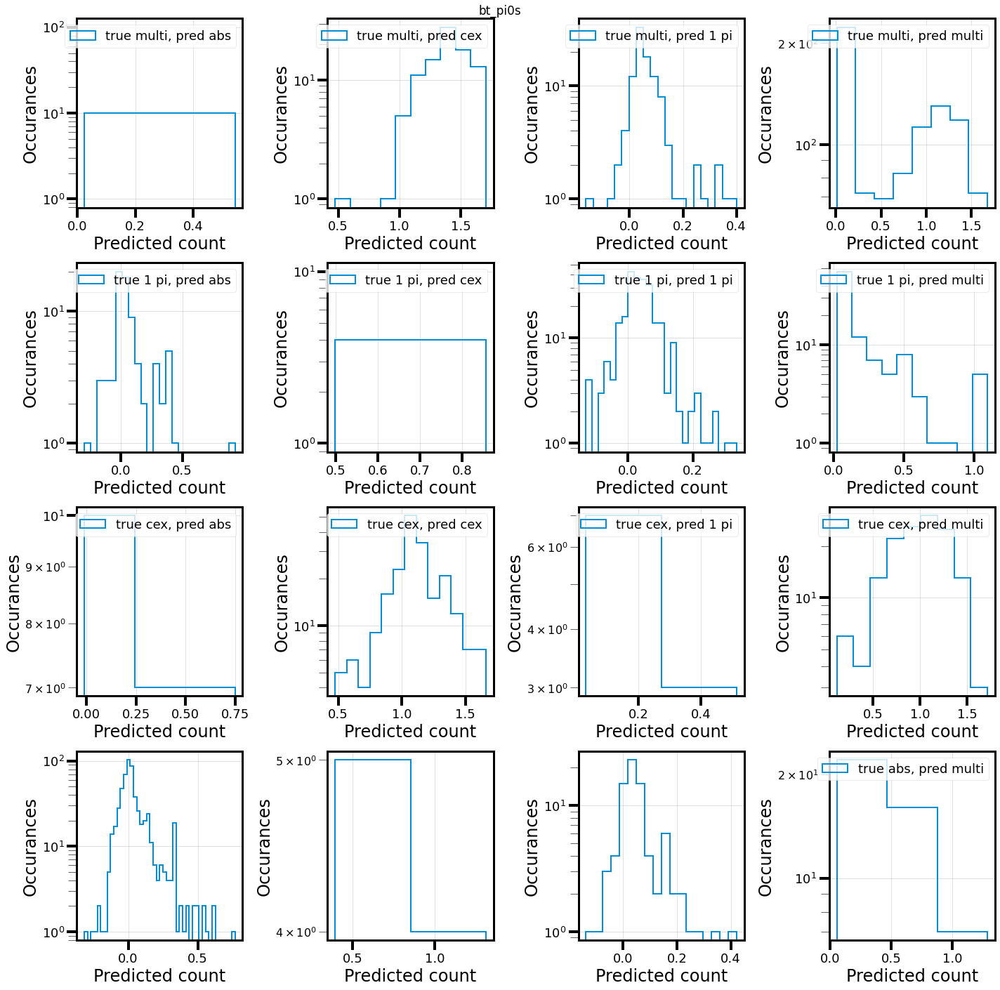

In [29]:
plot_regr_hist_all_channels(
    "bt_pions", 1,
    reco_pred, reco_truth,
    bt_model, which_path_params)
    
plot_regr_hist_all_channels(
    "bt_pi0s", 2,
    reco_pred, reco_truth,
    bt_model, which_path_params)

82/82 [==============================] - 1s 8ms/step


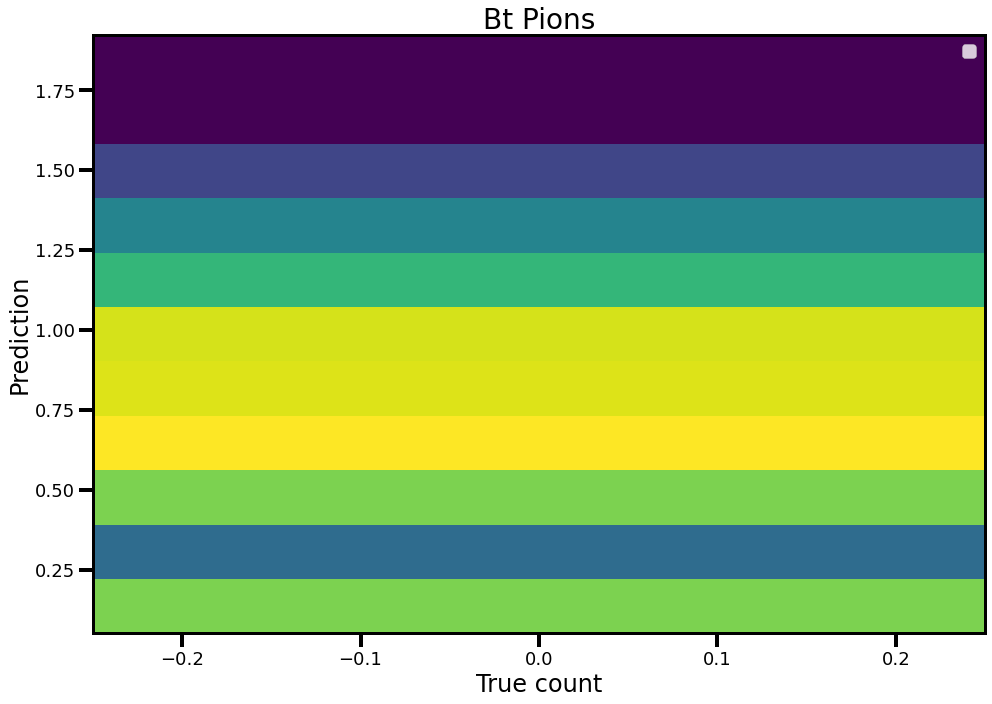

82/82 [==============================] - 1s 3ms/step


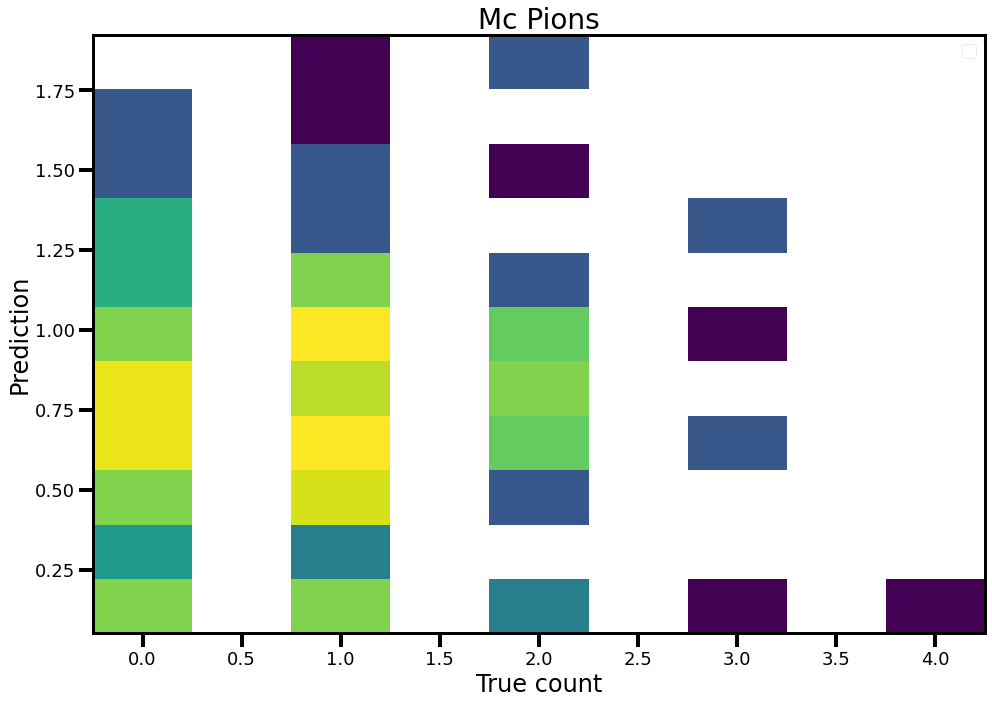

82/82 [==============================] - 1s 4ms/step


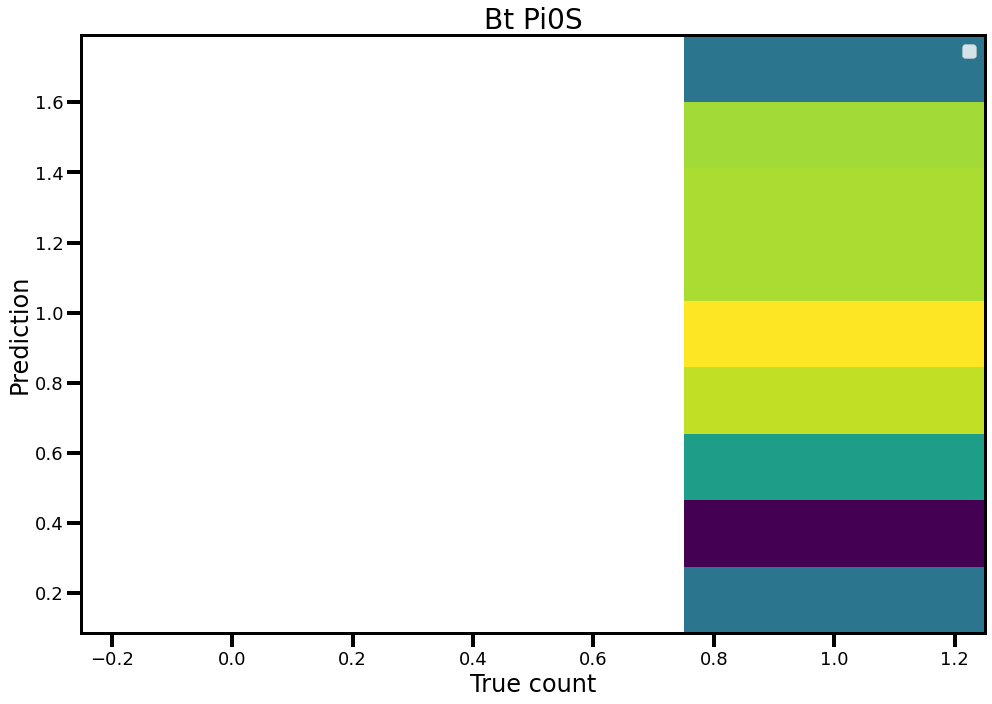

82/82 [==============================] - 1s 4ms/step


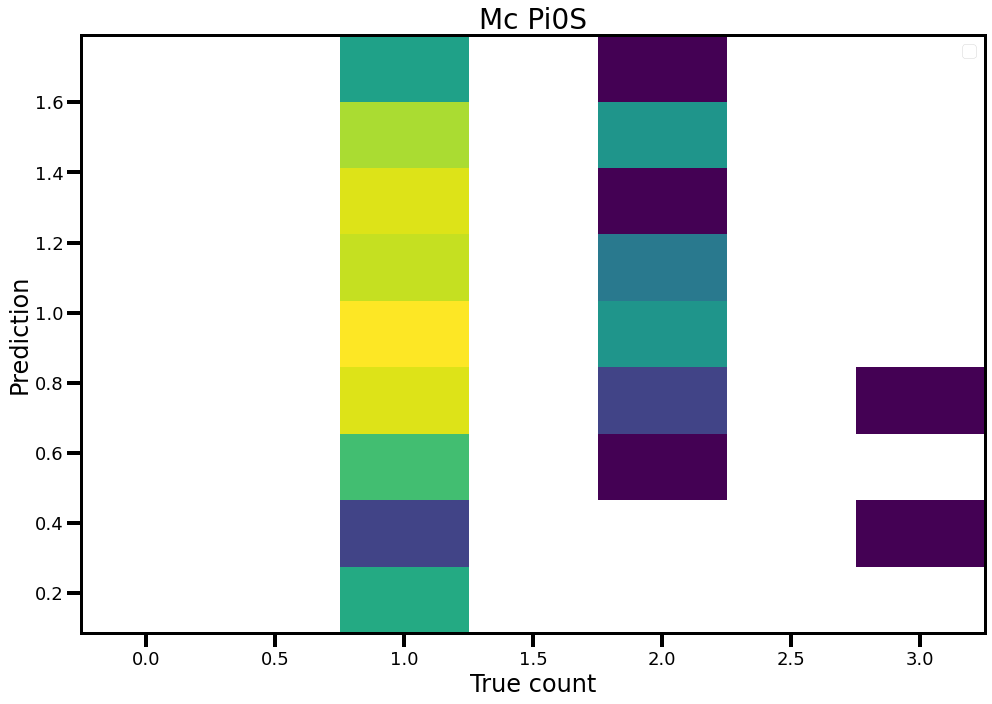

In [68]:
reco_multi_pred_reco_cex = np.logical_and(reco_pred == 3, reco_truth == 1.)
Models.plot_regression_extra_loss_dist(
    bt_model,
    f"bt_pions", 1,
    which_path_params, plt_conf,
    mask = reco_multi_pred_reco_cex)
Models.plot_regression_extra_loss_dist(
    bt_model,
    f"mc_pions", 1,
    which_path_params, plt_conf,
    mask = reco_multi_pred_reco_cex)
Models.plot_regression_extra_loss_dist(
    bt_model,
    f"bt_pi0s", 2,
    which_path_params, plt_conf,
    mask = reco_multi_pred_reco_cex)
Models.plot_regression_extra_loss_dist(
    bt_model,
    f"mc_pi0s", 2,
    which_path_params, plt_conf,
    mask = reco_multi_pred_reco_cex)

82/82 [==============================] - 1s 4ms/step


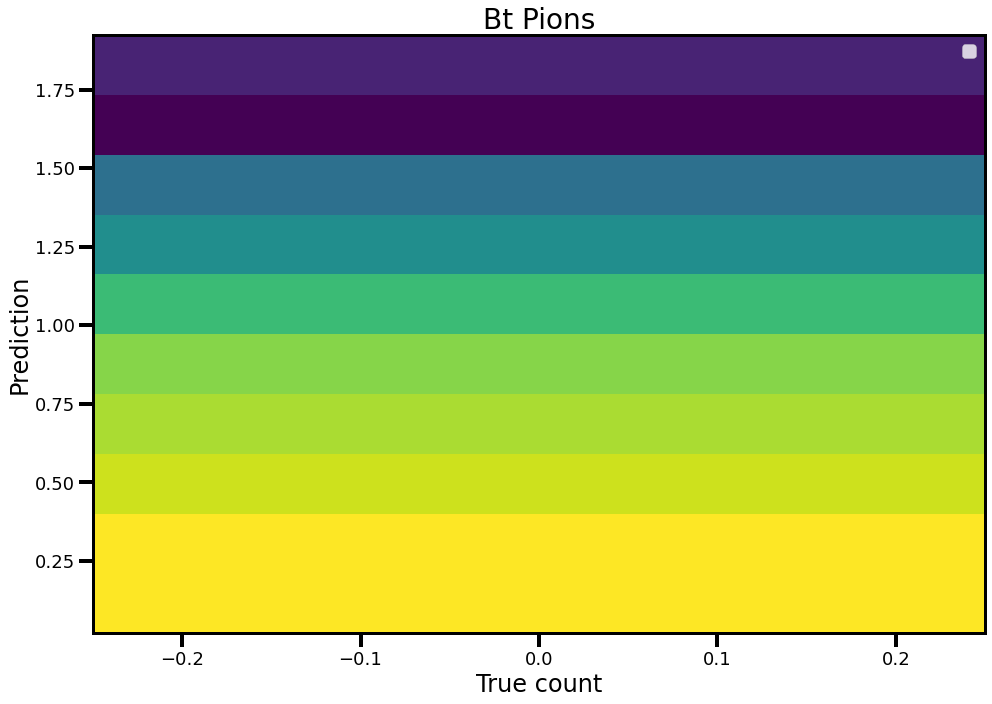

82/82 [==============================] - 1s 4ms/step


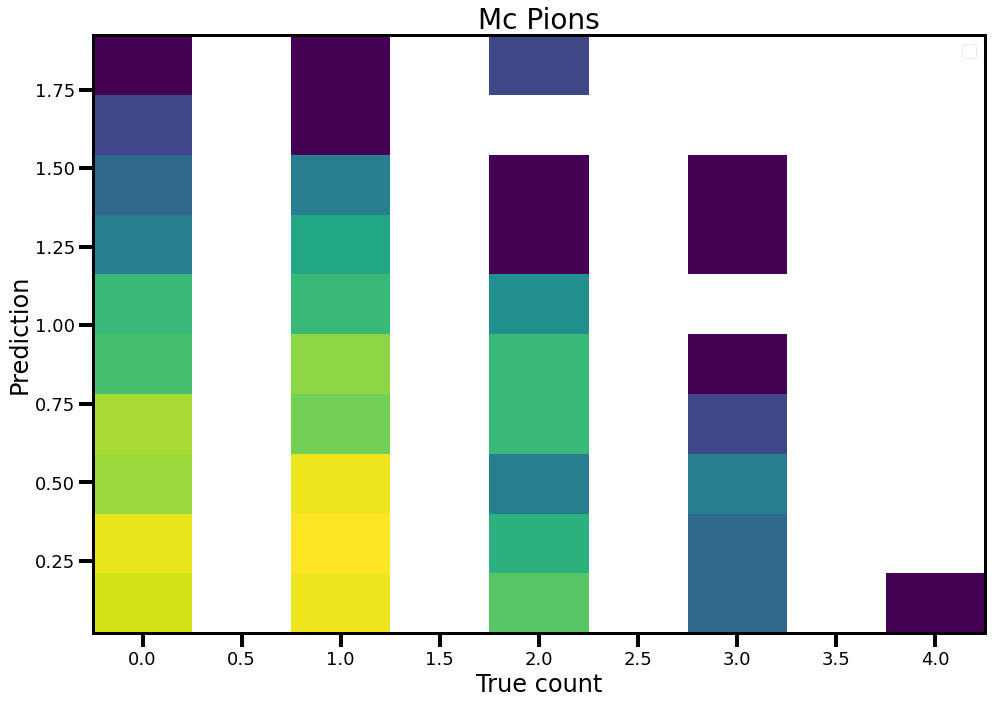

82/82 [==============================] - 1s 4ms/step


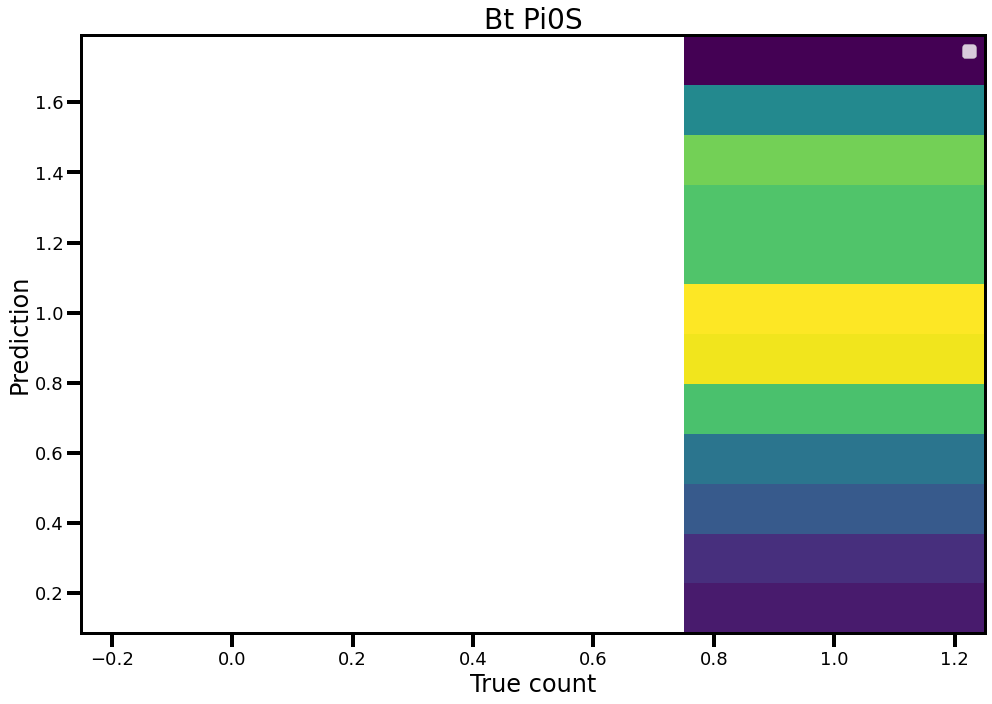

82/82 [==============================] - 1s 4ms/step


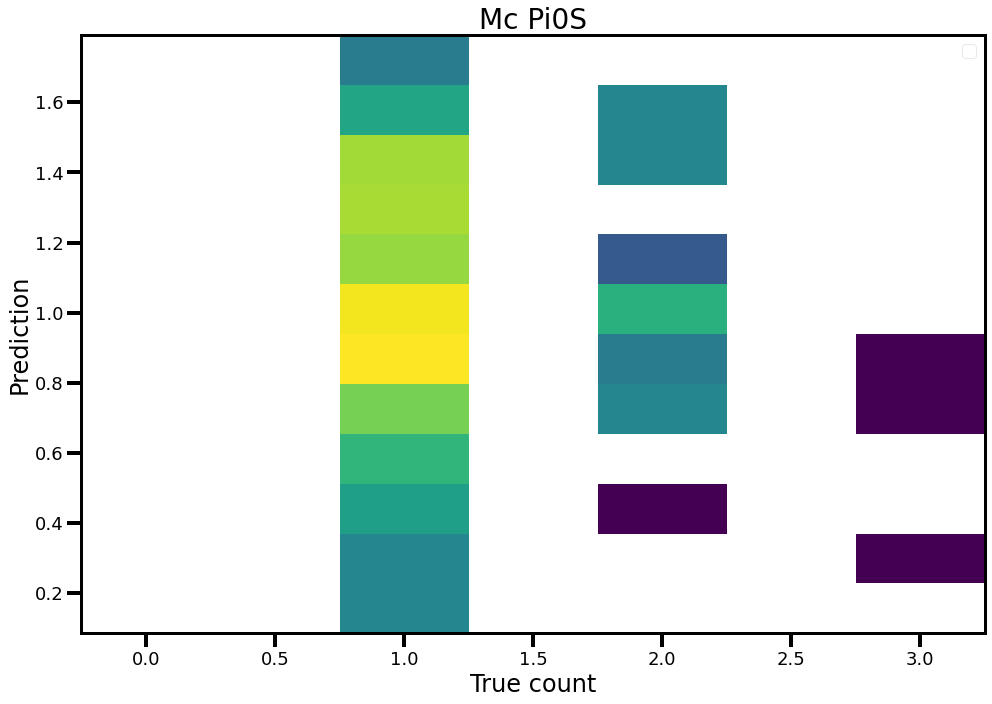

In [69]:
true_multi_pred_reco_cex = np.logical_and(true_pred == 3, reco_truth == 1.)
Models.plot_regression_extra_loss_dist(
    bt_model,
    f"bt_pions", 1,
    which_path_params, plt_conf,
    mask = true_multi_pred_reco_cex)
Models.plot_regression_extra_loss_dist(
    bt_model,
    f"mc_pions", 1,
    which_path_params, plt_conf,
    mask = true_multi_pred_reco_cex)
Models.plot_regression_extra_loss_dist(
    bt_model,
    f"bt_pi0s", 2,
    which_path_params, plt_conf,
    mask = true_multi_pred_reco_cex)
Models.plot_regression_extra_loss_dist(
    bt_model,
    f"mc_pi0s", 2,
    which_path_params, plt_conf,
    mask = true_multi_pred_reco_cex)

In [128]:
bt_predictions, bt_truth_index = Models.get_predicitions(
        bt_model, bt_path_params["schema_path"], bt_path_params["test_path"])
bt_pred_index = np.where(
    bt_predictions == np.max(bt_predictions, axis=1)[:, np.newaxis])[1]
bt_pion_preds, bt_mc_pion_truths = Models.get_predicitions(
        bt_model,
        bt_path_params["schema_path"], bt_path_params["test_path"],
        pred_index=1, other_truth="mc_pions")
bt_pion_preds = bt_pion_preds[:, 0]
bt_mc_pion_truths = ak.ravel(bt_mc_pion_truths).to_numpy()
bt_pi0_preds, bt_pi0_truths = Models.get_predicitions(
        bt_model,
        bt_path_params["schema_path"], bt_path_params["test_path"],
        pred_index=2, other_truth="bt_pi0s")
_, bt_mc_pi0_truths = Models.get_predicitions(
        bt_model,
        bt_path_params["schema_path"], bt_path_params["test_path"],
        pred_index=2, other_truth="mc_pi0s")
bt_pi0_preds = bt_pi0_preds[:, 0]
bt_pi0_truths = ak.ravel(bt_pi0_truths).to_numpy()
bt_mc_pi0_truths = ak.ravel(bt_mc_pi0_truths).to_numpy()

82/82 [==============================] - 1s 3ms/step


In [129]:
bt_multi_cex_events = np.logical_and(bt_truth_index==3, bt_pred_index==1)

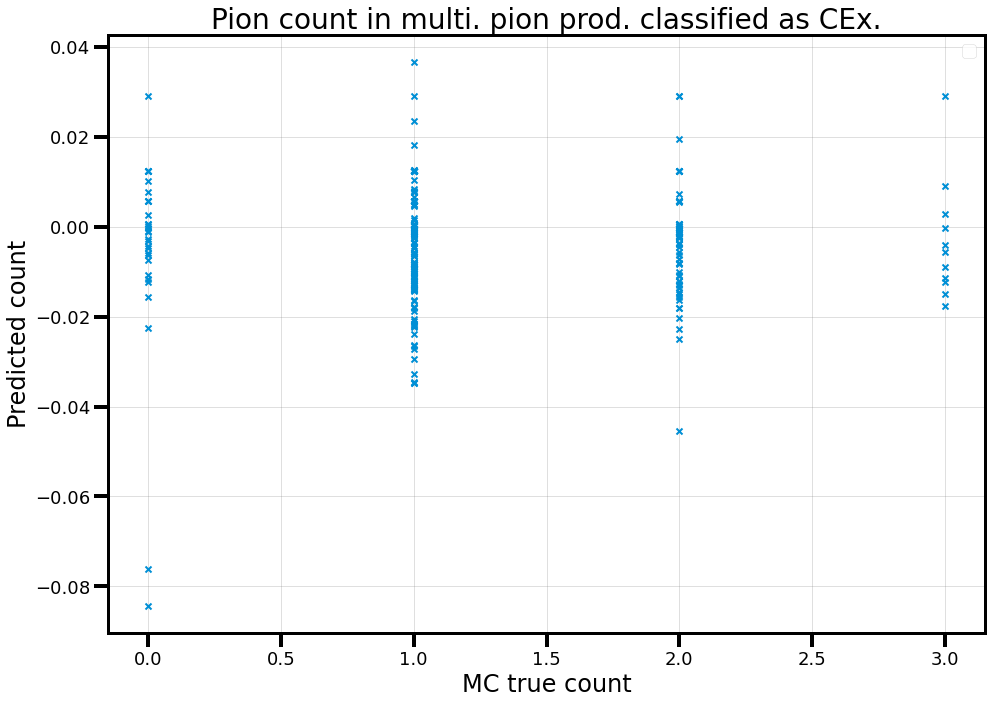

In [130]:
plt_conf.setup_figure(title="Pion count in multi. pion prod. classified as CEx.")
plt.scatter(
    bt_mc_pion_truths[bt_multi_cex_events],
    bt_pion_preds[bt_multi_cex_events],
    **plt_conf.gen_kwargs(index=0, marker="x"))
plt_conf.format_axis(xlog=False, ylog=False,
                        xlabel="MC true count", ylabel="Predicted count")
plt_conf.end_plot()

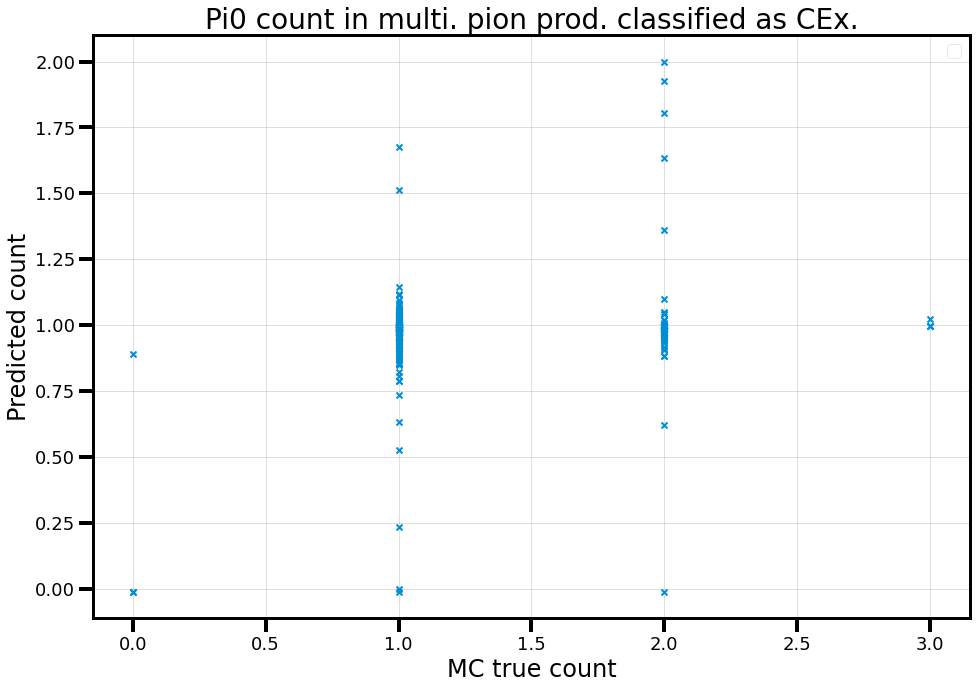

In [131]:
plt_conf.setup_figure(title="Pi0 count in multi. pion prod. classified as CEx.")
plt.scatter(
    bt_mc_pi0_truths[bt_multi_cex_events],
    bt_pi0_preds[bt_multi_cex_events],
    **plt_conf.gen_kwargs(index=0, marker="x"))
plt_conf.format_axis(xlog=False, ylog=False,
                        xlabel="MC true count", ylabel="Predicted count")

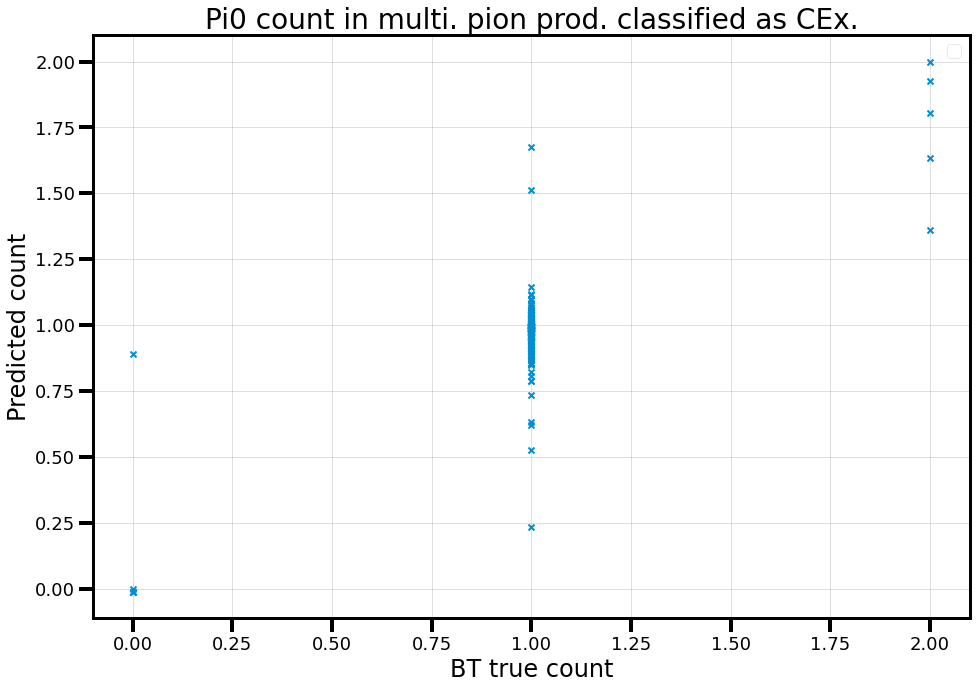

In [132]:
plt_conf.setup_figure(title="Pi0 count in multi. pion prod. classified as CEx.")
plt.scatter(
    bt_pi0_truths[bt_multi_cex_events],
    bt_pi0_preds[bt_multi_cex_events],
    **plt_conf.gen_kwargs(index=0, marker="x"))
plt_conf.format_axis(xlog=False, ylog=False,
                        xlabel="BT true count", ylabel="Predicted count")

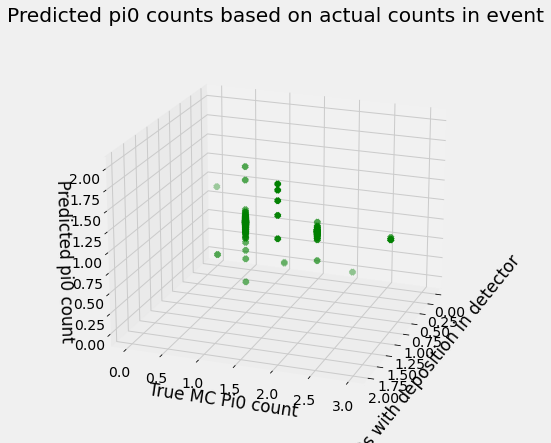

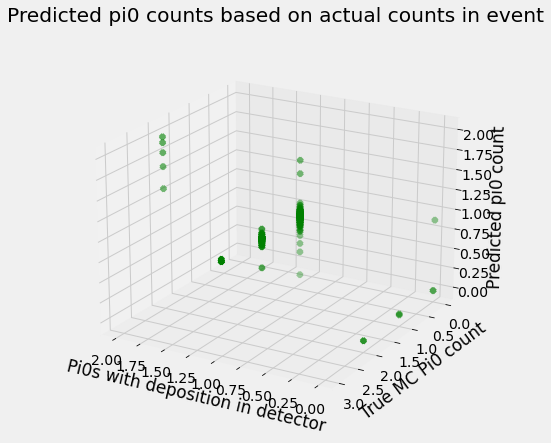

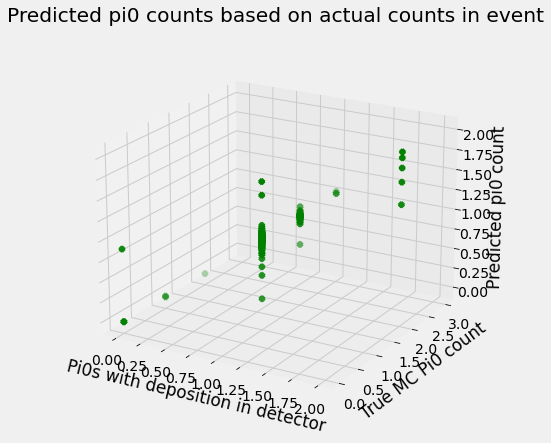

In [138]:
from mpl_toolkits import mplot3d
# Creating figure
fig = plt.figure(figsize = (10, 7))
ax = plt.axes(projection ="3d")
 
# Creating plot
ax.scatter3D(
    bt_pi0_truths[bt_multi_cex_events],
    bt_mc_pi0_truths[bt_multi_cex_events],
    bt_pi0_preds[bt_multi_cex_events], color = "green", marker="x")
plt.title("Predicted pi0 counts based on actual counts in event")
ax.set_xlabel("Pi0s with deposition in detector")
ax.set_ylabel("True MC Pi0 count")
ax.set_zlabel("Predicted pi0 count")
 
ax.view_init(20, 20)
plt.show()

fig = plt.figure(figsize = (10, 7))
ax = plt.axes(projection ="3d")
 
# Creating plot
ax.scatter3D(
    bt_pi0_truths[bt_multi_cex_events],
    bt_mc_pi0_truths[bt_multi_cex_events],
    bt_pi0_preds[bt_multi_cex_events], color = "green", marker="x")
plt.title("Predicted pi0 counts based on actual counts in event")
ax.set_xlabel("Pi0s with deposition in detector")
ax.set_ylabel("True MC Pi0 count")
ax.set_zlabel("Predicted pi0 count")
ax.view_init(20, 120)
plt.show()

fig = plt.figure(figsize = (10, 7))
ax = plt.axes(projection ="3d")
 
# Creating plot
ax.scatter3D(
    bt_pi0_truths[bt_multi_cex_events],
    bt_mc_pi0_truths[bt_multi_cex_events],
    bt_pi0_preds[bt_multi_cex_events], color = "green", marker="x")
plt.title("Predicted pi0 counts based on actual counts in event")
ax.set_xlabel("Pi0s with deposition in detector")
ax.set_ylabel("True MC Pi0 count")
ax.set_zlabel("Predicted pi0 count")
ax.view_init(20, -60)
plt.show()

82/82 [==============================] - 1s 9ms/step
Found predictions ranging between -75.076 and 3.978.


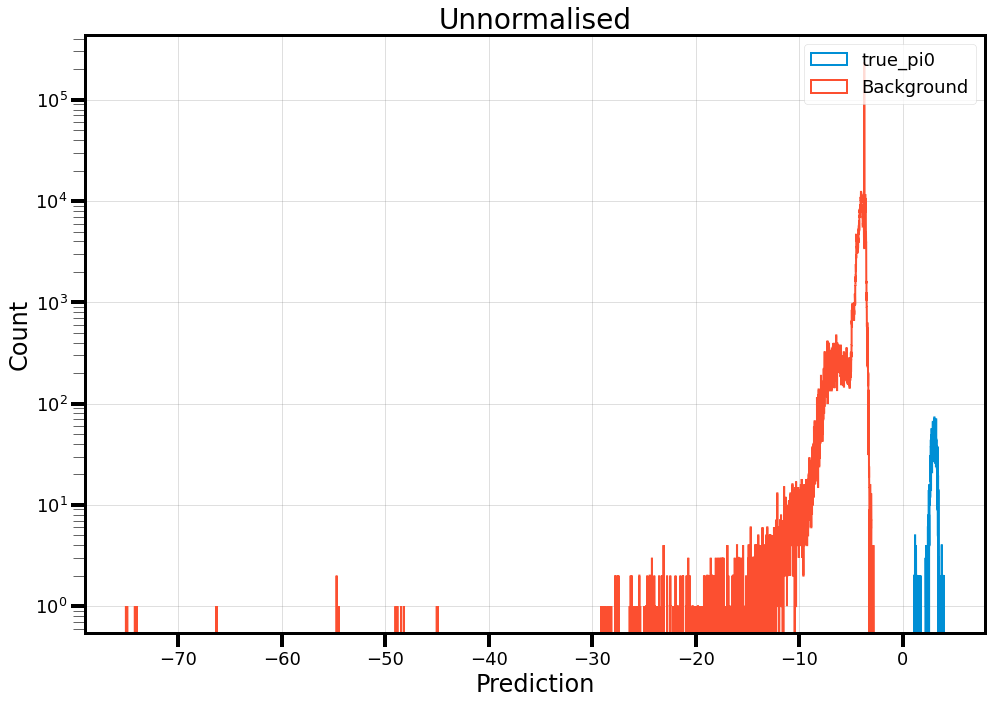

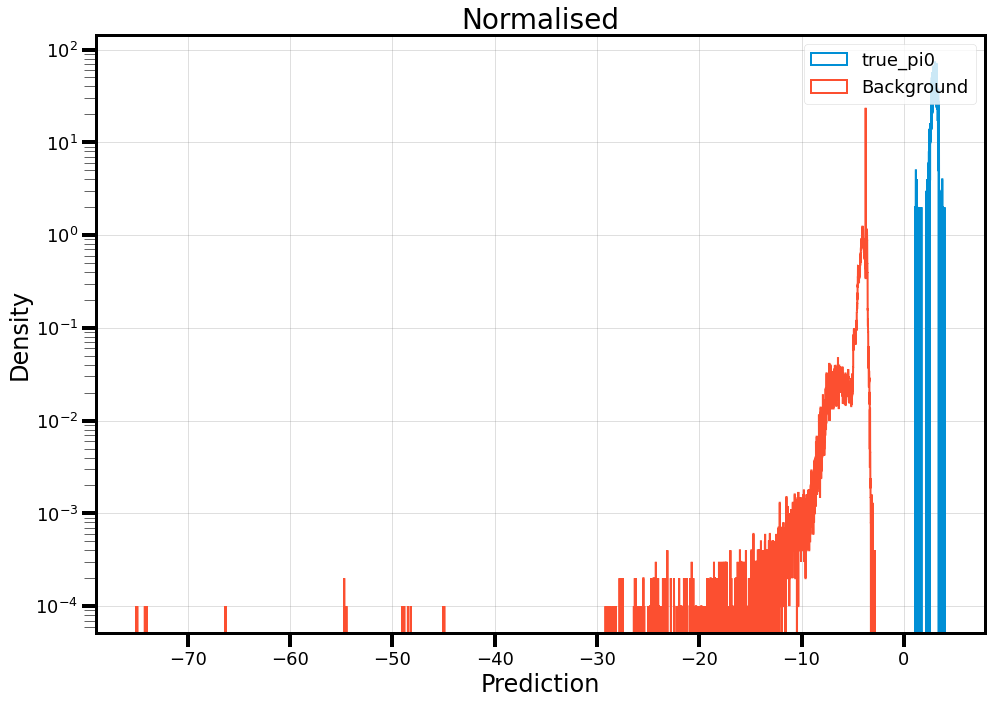

In [47]:
Models.plot_binary_extra_loss_dist(
    beam_model_mc,
    "true_pi0", -1,
    mc_path_params, plt_conf)

82/82 [==============================] - 1s 9ms/step


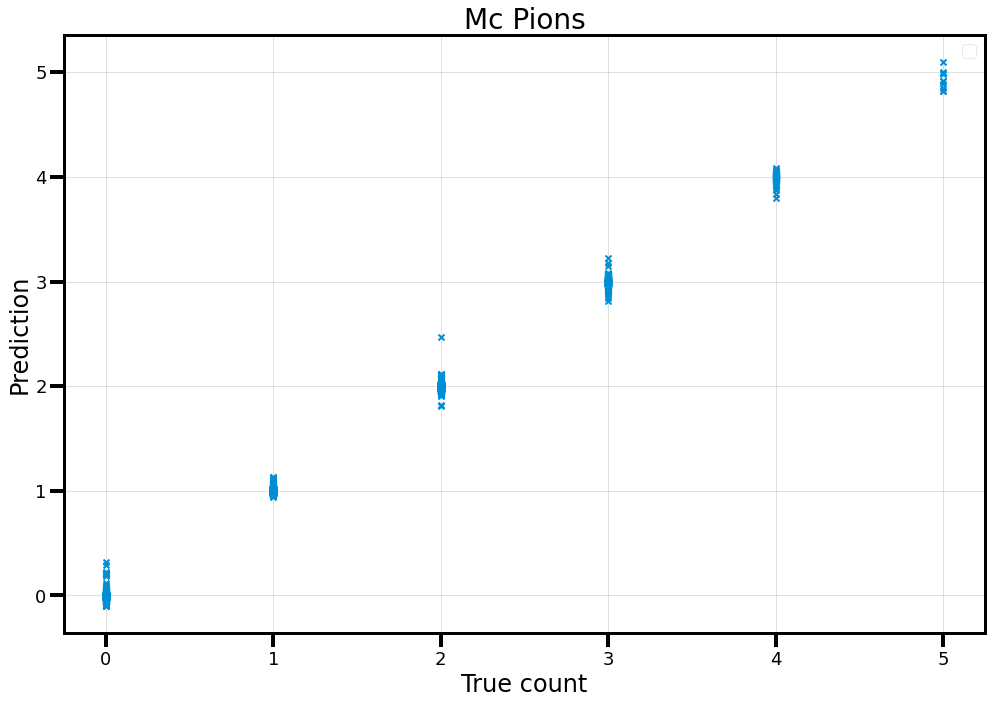

82/82 [==============================] - 1s 4ms/step


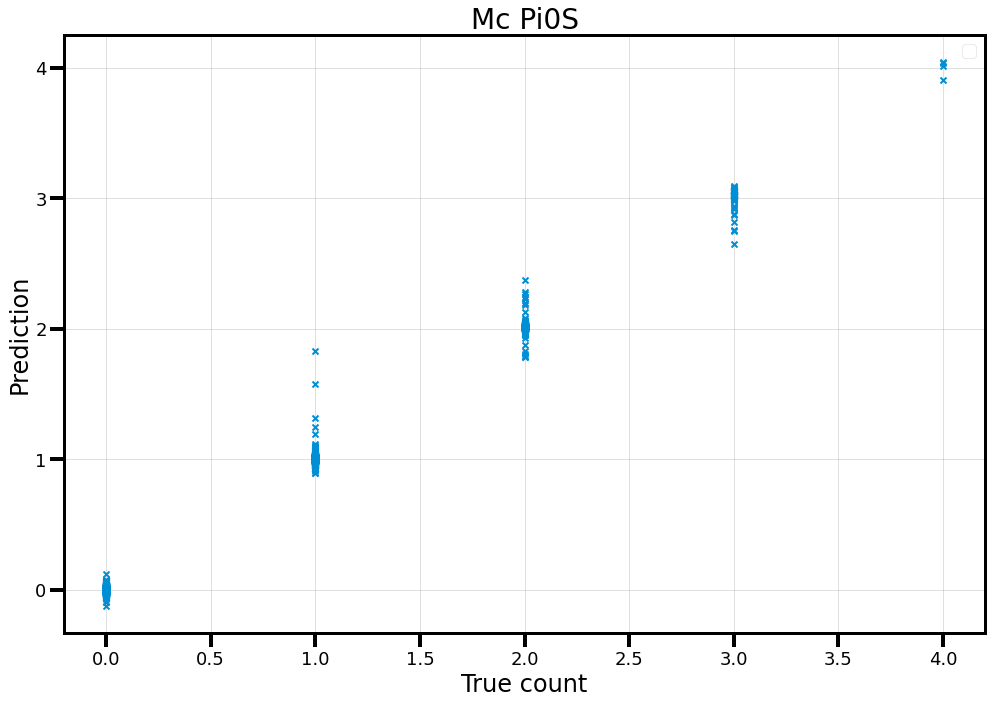

In [51]:
Models.plot_regression_extra_loss_dist(
    beam_model_mc,
    "mc_pions", 1,
    mc_path_params, plt_conf)
Models.plot_regression_extra_loss_dist(
    beam_model_mc,
    "mc_pi0s", 2,
    mc_path_params, plt_conf)

In [61]:
predictions, truth_index = Models.get_predicitions(
        beam_model_mc, mc_path_params["schema_path"], mc_path_params["test_path"])
pred_index = np.where(
    predictions == np.max(predictions, axis=1)[:, np.newaxis])[1]
pion_preds, pion_truths = Models.get_predicitions(
        beam_model_mc,
        mc_path_params["schema_path"], mc_path_params["test_path"],
        pred_index=1, other_truth="mc_pions")
pion_preds = pion_preds[:, 0]
pion_truths = ak.ravel(pion_truths).to_numpy()
pi0_preds, pi0_truths = Models.get_predicitions(
        beam_model_mc,
        mc_path_params["schema_path"], mc_path_params["test_path"],
        pred_index=2, other_truth="mc_pi0s")
pi0_preds = pi0_preds[:, 0]
pi0_truths = ak.ravel(pi0_truths).to_numpy()

82/82 [==============================] - 1s 4ms/step


In [65]:
bad_evt = np.logical_and(truth_index==1, pred_index==3)
print(f"{np.sum(bad_evt)} misclassified event found, with 1 expected.")
print(f"Index of bad event: {np.arange(bad_evt.size)[bad_evt][0]}")
print(f"Pion count prediction: {pion_preds[bad_evt][0]}")
print(f"Pi0 count prediction: {pi0_preds[bad_evt][0]}")

1 misclassified event found, with 1 expected.
Index of bad event: 1998
Pion count prediction: 0.321309357881546
Pi0 count prediction: 1.5747368335723877


In [81]:
bad_pi0_count_evt = np.logical_and(pi0_truths == 1, pi0_preds > 1.6)
print(f"{np.sum(bad_pi0_count_evt)} events with bad pi0 ID found, with 1 expected.")
print(f"Index of weird event: {np.arange(bad_pi0_count_evt.size)[bad_pi0_count_evt][0]}")
print(f"Weird event true classification: {truth_index[bad_pi0_count_evt][0]}")
print(f"Weird event true predicted classification: {pred_index[bad_pi0_count_evt][0]}")
print(f"Weird event true pion count: {pion_truths[bad_pi0_count_evt][0]}")
print(f"Weird event predicted pion count: {pion_preds[bad_pi0_count_evt][0]}")

1 events with bad pi0 ID found, with 1 expected.
Index of weird event: 1849
Weird event true classification: 3.0
Weird event true predicted classification: 3
Weird event true pion count: 2.0
Weird event predicted pion count: 2.4704835414886475


82/82 [==============================] - 1s 9ms/step


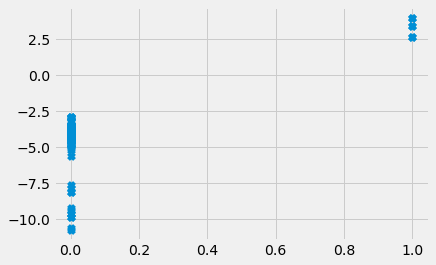

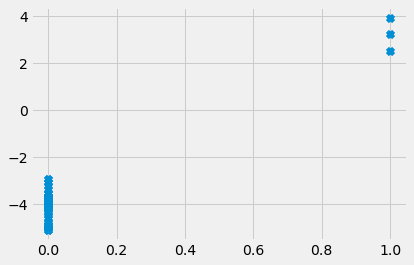

In [82]:
pi0_id_preds, pi0_id_truths = Models.get_predicitions(
        beam_model_mc,
        mc_path_params["schema_path"], mc_path_params["test_path"],
        pred_index=-1, other_truth="true_pi0")
pi0_id_bad_evt = pi0_id_preds[1998].numpy()
pi0_id_bad_evt_true = pi0_id_truths[1998].to_numpy()
plt.scatter(pi0_id_bad_evt_true, pi0_id_bad_evt, marker="x")
plt.show()
plt.scatter(pi0_id_truths[1849].to_numpy(), pi0_id_preds[1849].numpy(), marker="x")
plt.show()

In [ ]:
predictions, truth_index = Models.get_predicitions(
        beam_model_mc, mc_path_params["schema_path"], mc_path_params["test_path"])
pred_index = np.where(
    predictions == np.max(predictions, axis=1)[:, np.newaxis])[1]
bad_evt = np.logical_and(truth_index==1, pred_index==3)
print(np.sum(bad_evt))
pion_preds, pion_truths = Models.get_predicitions(
        beam_model_mc,
        mc_path_params["schema_path"], mc_path_params["test_path"],
        pred_index=1, other_truth="mc_pions")
print(f"Pion count prediction: {pion_preds[bad_evt][0]}")
pi0_preds, pi0_truths = Models.get_predicitions(
        beam_model_mc,
        mc_path_params["schema_path"], mc_path_params["test_path"],
        pred_index=2, other_truth="mc_pi0s")
print(f"Pi0 count prediction: {pi0_preds[bad_evt][0]}")

/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mc_truth_no_pi0_models/Model_mc_truth_no_pi0_028_pi0_edge_id_2MP_no_beam_mother_id
82/82 [==============================] - 1s 9ms/step
2617 events searched.
2616 events correctly classified (1 false), for an efficiency of 99.96%.
For Abs.: 100.00% efficiency, 100.00% purity (product: 100.00%).
For CEx.: 99.30% efficiency, 100.00% purity (product: 99.30%).
For 1 pi: 100.00% efficiency, 100.00% purity (product: 100.00%).
For Multi.: 100.00% efficiency, 99.94% purity (product: 99.94%).



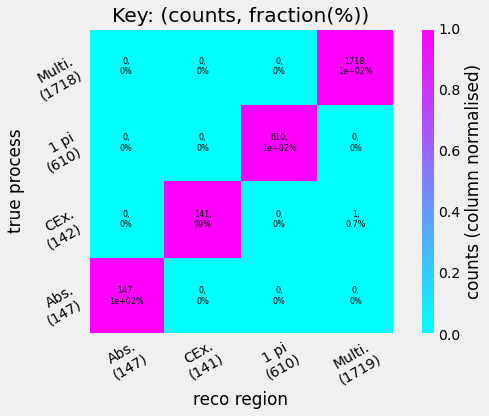

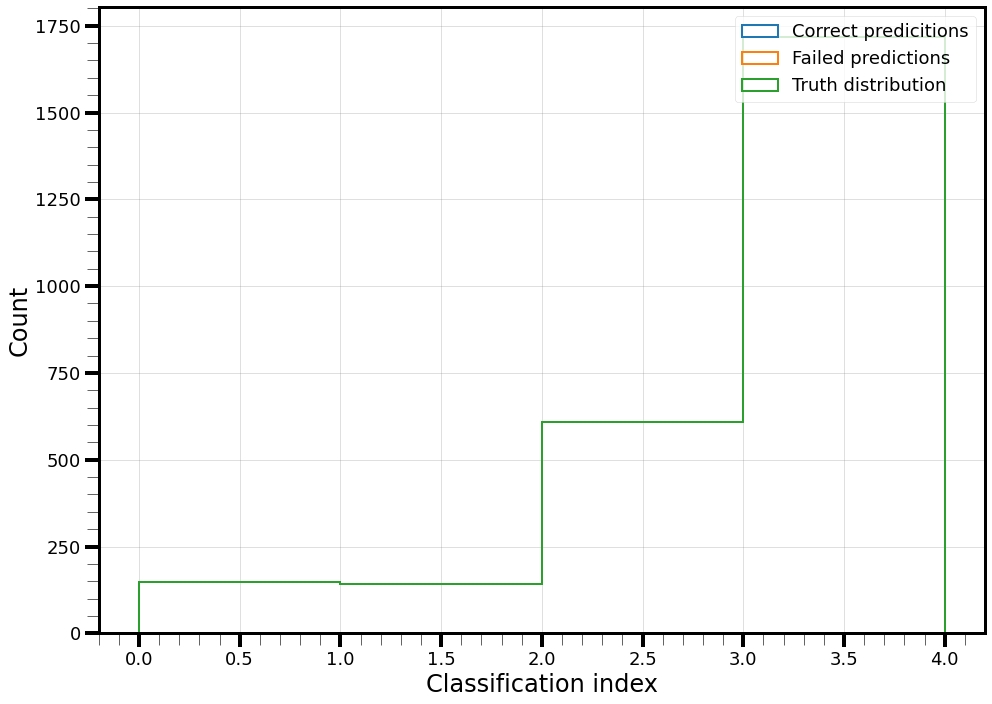

(array([3, 3, 3, ..., 2, 3, 3]), array([3., 3., 3., ..., 2., 3., 3.]))

In [54]:
print(mc_truth_hyper_params["folder_path"])
Models.evaluate_model(
    beam_model_mc,
    mc_path_params["schema_path"],
    mc_path_params["test_path"],
    classification_labels=["Abs.", "CEx.", "1 pi", "Multi."],
    plot_config=plt_conf)

In [67]:
# loaded_model = tf.keras.models.load_model("/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mc_truth_no_pi0_models/Model_mc_truth_no_pi0_007_pi0_edge_id_higher_loss_weightings_focal_0.9_id/model.tf")
loaded_model = tf.keras.models.load_model(mc_truth_hyper_params["model_path"])
print(mc_truth_hyper_params["folder_path"])
Models.evaluate_model(
    loaded_model,
    mc_path_params["schema_path"],
    mc_path_params["test_path"],
    plot_config=plt_conf)

UnboundLocalError: local variable 'kwargs' referenced before assignment

In [ ]:
test_record = DataPreparation.load_record(mc_path_params["schema_path"], mc_path_params["test_path"])
test_data = test_record.map(lambda data, label : data)
test_data = test_data.batch(batch_size=32)
test_label = test_record.map(lambda data, label : label)
truth_index = convert_labels_to_truth(test_label)
predictions = loaded_model.predict(test_data, batch_size=32)
if isinstance(predictions, list):
    # First predicition is always the classification
    predictions = predictions[0]
return predictions, truth_index

In [ ]:
loaded_model = tf.keras.models.load_model(data_hyper_params["model_path"])
print(data_hyper_params["folder_path"])
predictions, truth_index = Models.get_predicitions(
    loaded_model, data_path_params["schema_path"], data_path_params["test_path"])
predictions = predictions[2]
pred_index = np.where(
    predictions == np.max(predictions, axis=1)[:, np.newaxis])[1]
labels = Models._parse_classification_labels(["Abs.", "CEx.", "single pi", "multi pi"],
                                        pred_index, truth_index)
_ = Models.create_summary_text(
    pred_index, truth_index,
    classification_labels=labels,
    print_results=True)
confustion_mat = Models.create_confusion_matrix(pred_index, truth_index)
Models.plot_confusion_matrix(
    confustion_mat,
    labels, labels)
Models.plot_summary_information(pred_index, truth_index, plt_conf)

In [77]:
loaded_model = tf.keras.models.load_model(data_hyper_params["model_path"])
print(data_hyper_params["folder_path"])
Models.evaluate_model(
    loaded_model,
    data_path_params["schema_path"],
    data_path_params["test_path"],
    plot_config=plt_conf)

/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_models/Model_data_69_focal_alpha_MPx2_init_1x128_final_1x32_triple_loss
82/82 [==============================] - 1s 3ms/step


AttributeError: 'bool' object has no attribute 'size'

/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/truth_models/Model_truth_62_extra_data_focal_gamma_5_alpha_weighting
82/82 [==============================] - 1s 2ms/step
2617 events searched.
1775 events correctly classified (842 false), for an efficiency of 67.83%.
For class index 0: 29.92% efficiency, 89.02% purity.
For class index 1: 45.00% efficiency, 38.71% purity.
For class index 2: 91.25% efficiency, 60.76% purity.
For class index 3: 64.60% efficiency, 82.27% purity.



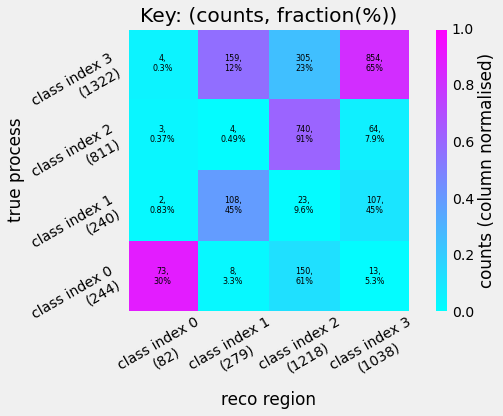

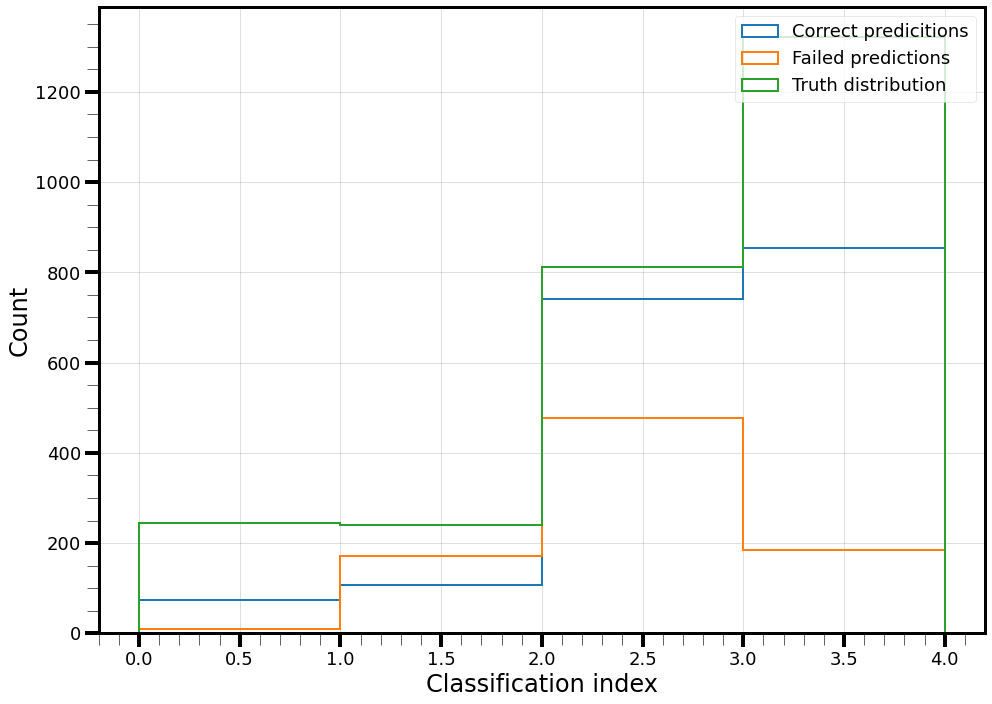

(array([2, 3, 3, ..., 2, 1, 3]), array([2., 3., 3., ..., 2., 3., 2.]))

In [75]:
print(truth_hyper_params["folder_path"])
Models.evaluate_model(
    beam_model_truth,
    full_path_params["schema_path"],
    full_path_params["test_path"],
    plot_config=plt_conf)

82/82 [==============================] - 1s 2ms/step
2617 events searched.
1821 events correctly classified (796 false), for an efficiency of 69.58%.
For class index 0: 35.66% efficiency, 84.47% purity.
For class index 1: 2.50% efficiency, 50.00% purity.
For class index 2: 84.46% efficiency, 61.82% purity.



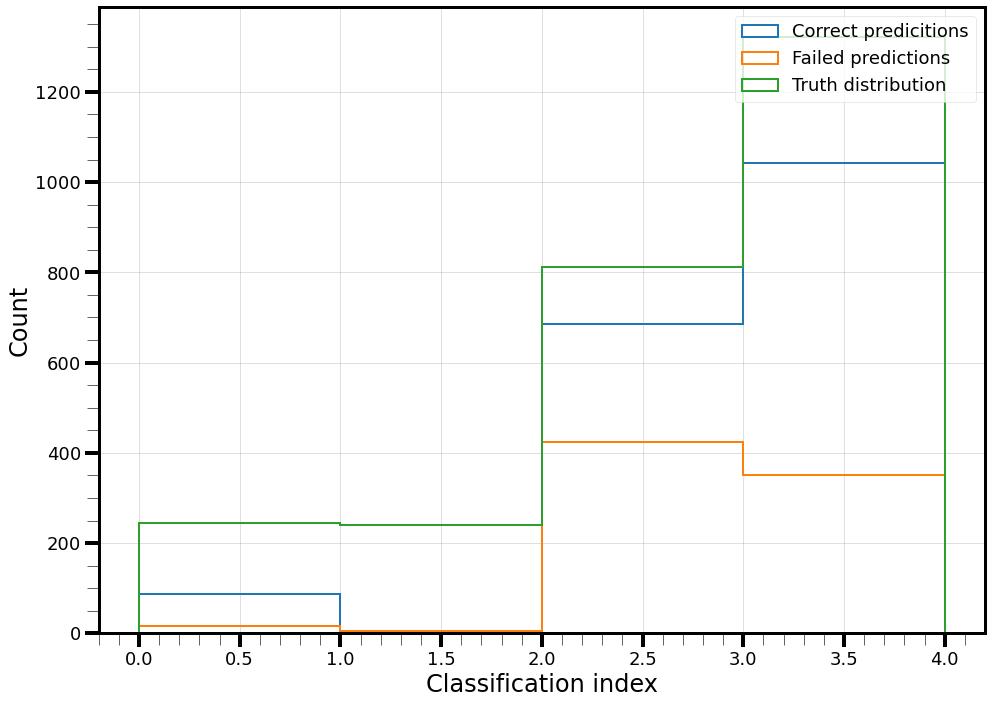

(array([2, 3, 3, ..., 2, 3, 3]), array([2., 3., 3., ..., 2., 3., 2.]))

In [18]:
Models.evaluate_model(
    beam_model_truth,
    with_val_path_params["schema_path"],
    with_val_path_params["test_path"],
    plot_config=plt_conf)

In [18]:
Models.evaluate_model(
    beam_model_truth,
    no_beam_truth_params["schema_path"],
    no_beam_truth_params["test_path"],
    plot_config=plt_conf)

NameError: name 'no_beam_truth_params' is not defined

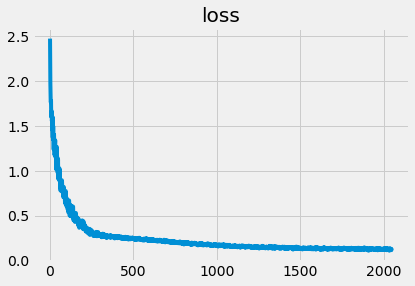

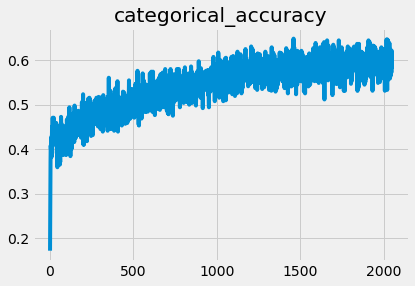

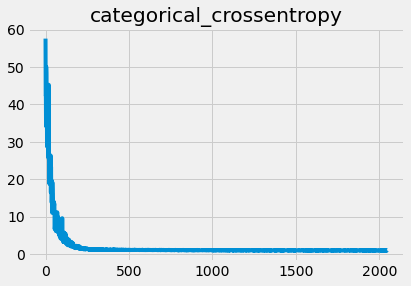

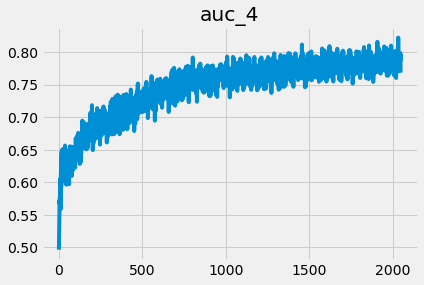

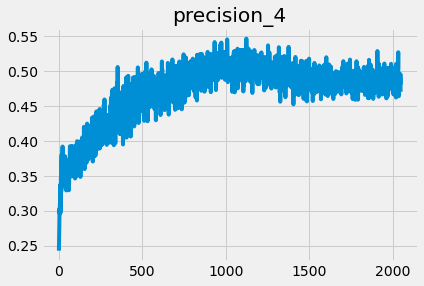

...

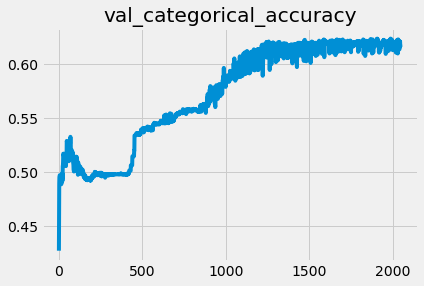

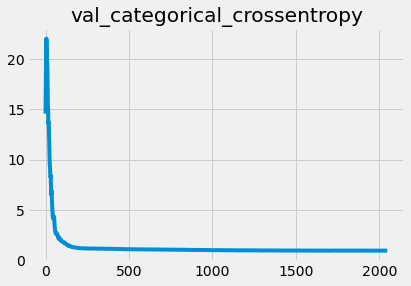

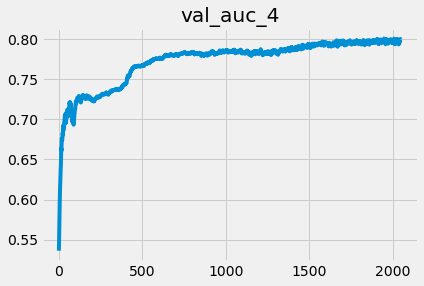

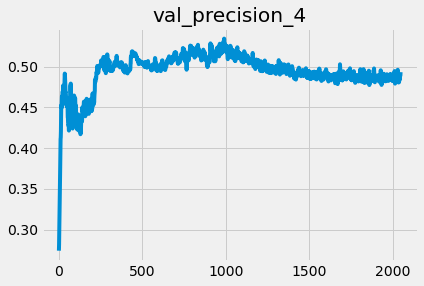

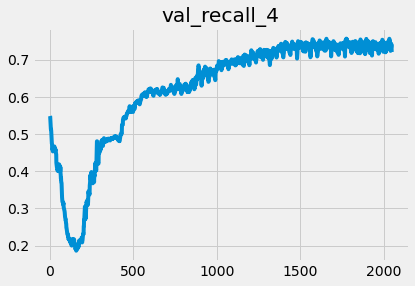

In [49]:
Models.simple_plot_history(truth_6_hist)

In [51]:
truth_6_hist_1 = base_model_truth.fit(train_ds_batched,
                         steps_per_epoch=truth_hyper_params["steps_per_epoch"],
                         epochs=truth_hyper_params["epochs"],
                         callbacks=truth_hyper_params["callbacks"],
                         validation_data=val_ds_batched)

Epoch 1/2048
16/16 [==============================] - 1s 31ms/step - loss: 0.1295 - categorical_accuracy: 0.5879 - categorical_crossentropy: 1.0078 - auc_4: 0.7863 - precision_4: 0.5007 - recall_4: 0.6895 - val_loss: 0.1193 - val_categorical_accuracy: 0.6193 - val_categorical_crossentropy: 0.9648 - val_auc_4: 0.8022 - val_precision_4: 0.4978 - val_recall_4: 0.7217
Epoch 2/2048
16/16 [==============================] - 0s 25ms/step - loss: 0.1304 - categorical_accuracy: 0.5723 - categorical_crossentropy: 1.0144 - auc_4: 0.7728 - precision_4: 0.4801 - recall_4: 0.6602 - val_loss: 0.1191 - val_categorical_accuracy: 0.6200 - val_categorical_crossentropy: 0.9644 - val_auc_4: 0.8031 - val_precision_4: 0.5018 - val_recall_4: 0.7267
Epoch 3/2048
16/16 [==============================] - 0s 25ms/step - loss: 0.1307 - categorical_accuracy: 0.5918 - categorical_crossentropy: 1.0187 - auc_4: 0.7762 - precision_4: 0.4908 - recall_4: 0.6758 - val_loss: 0.1190 - val_categorical_accuracy: 0.6181 - val_c

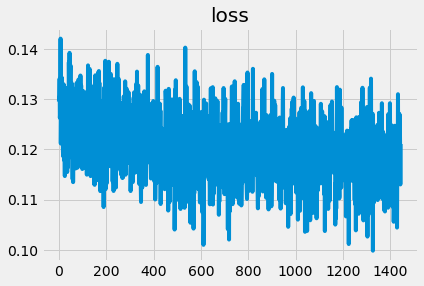

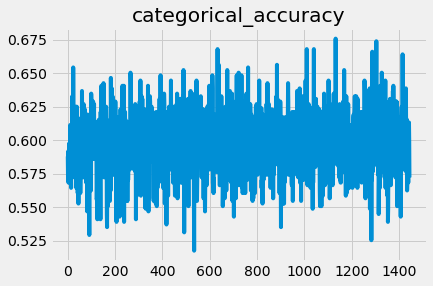

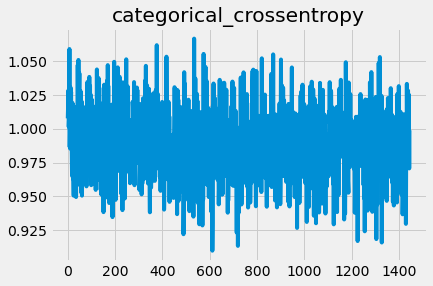

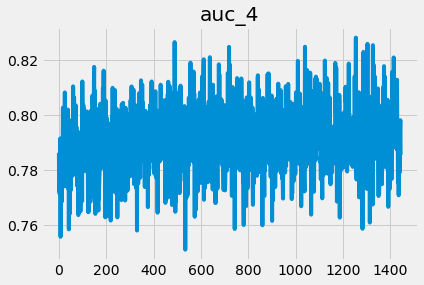

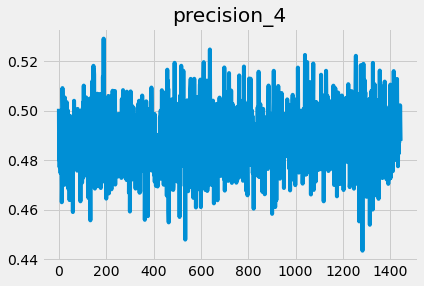

...

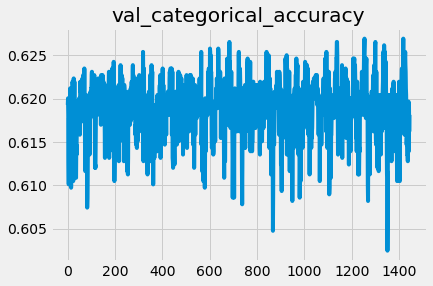

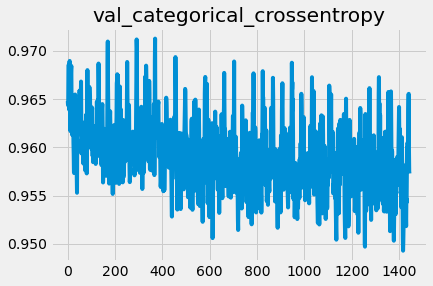

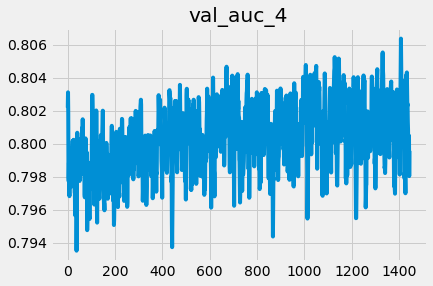

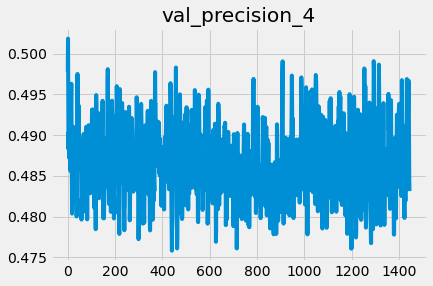

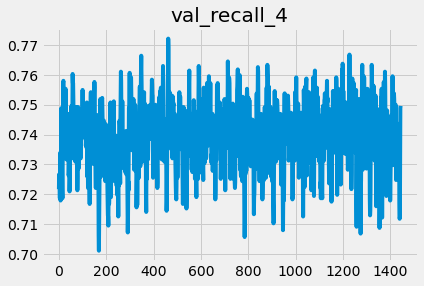

In [52]:
Models.simple_plot_history(truth_6_hist_1)

82/82 [==============================] - 1s 5ms/step


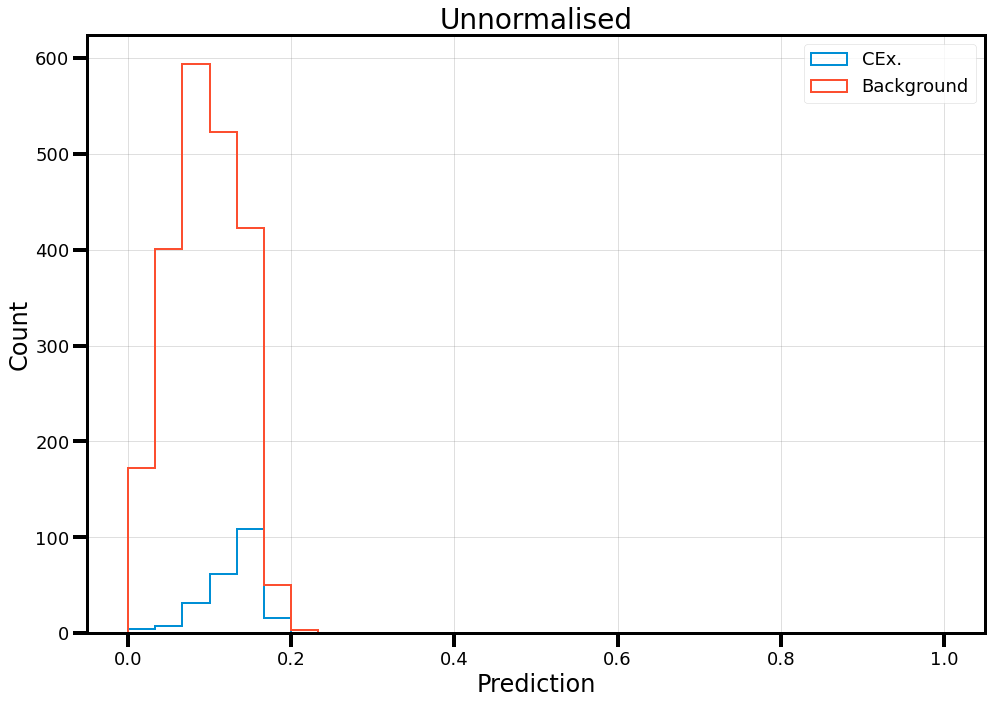

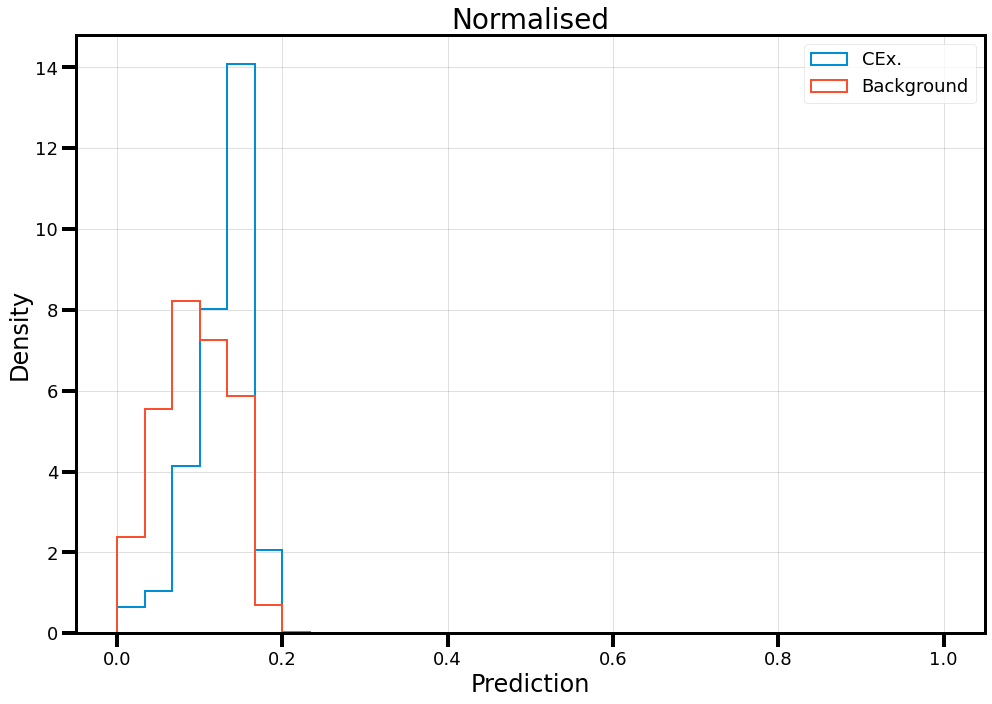

In [36]:
Models.plot_binary_dist(base_model_truth, full_path_params, plt_conf)

82/82 [==============================] - 1s 5ms/step
2617 events searched.
1589 events correctly classified (1028 false), for an efficiency of 60.72%.
For class index 0: 31.15% efficiency, 76.77% purity.
For class index 1: 9.58% efficiency, 45.10% purity.
For class index 2: 55.12% efficiency, 53.99% purity.



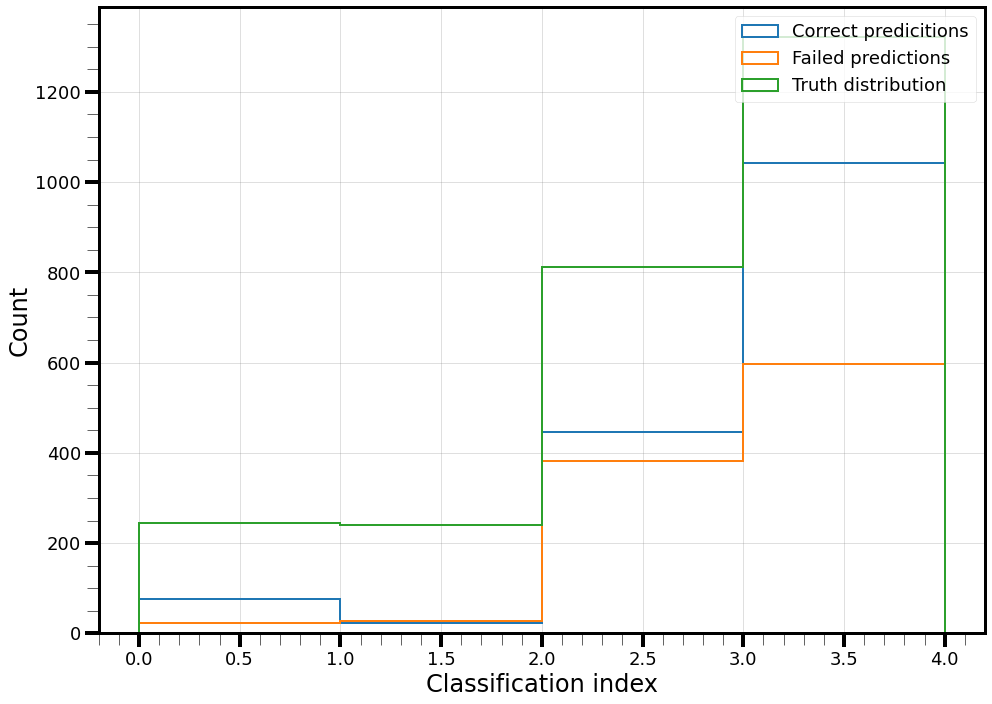

(array([2, 3, 3, ..., 2, 3, 2]), array([2., 3., 3., ..., 2., 3., 2.]))

In [53]:
Models.evaluate_model(
    base_model_truth,
    no_beam_truth_params["schema_path"],
    no_beam_truth_params["test_path"],
    plot_config=plt_conf)

82/82 [==============================] - 1s 4ms/step
2617 events searched.
1589 events correctly classified (1028 false), for an efficiency of 60.72%.
For class index 0: 36.07% efficiency, 69.84% purity.
For class index 1: 11.67% efficiency, 41.18% purity.
For class index 2: 53.27% efficiency, 55.10% purity.



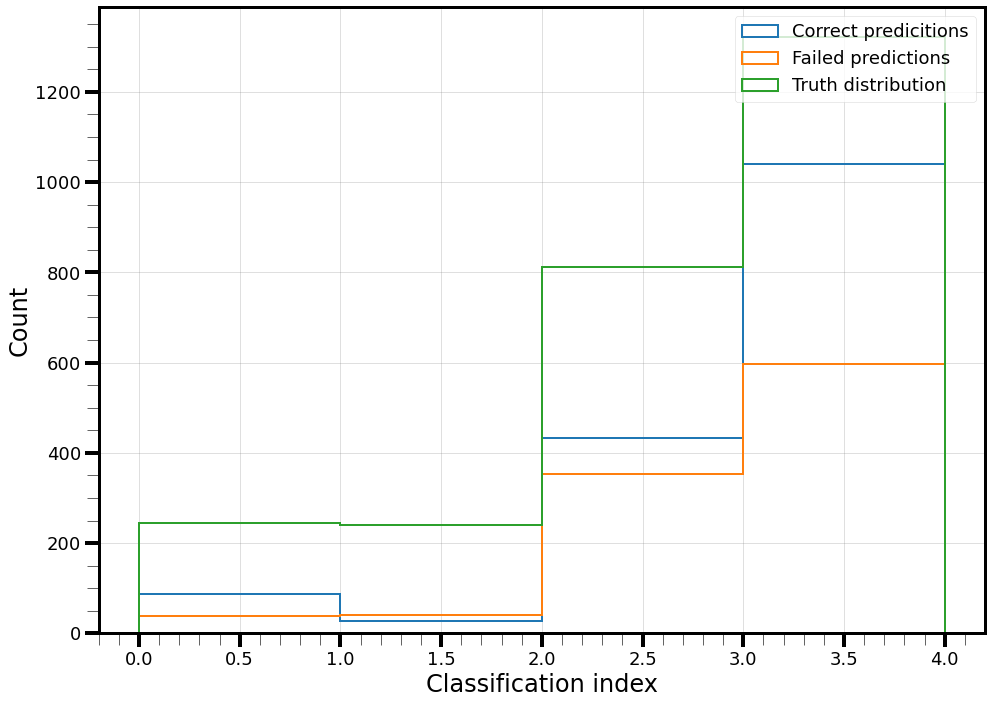

(array([2, 3, 3, ..., 2, 3, 3]), array([2., 3., 3., ..., 2., 3., 2.]))

In [50]:
Models.evaluate_model(
    base_model_truth,
    no_beam_truth_params["schema_path"],
    no_beam_truth_params["test_path"],
    plot_config=plt_conf)

## Pre-truth testing models below

In [6]:
hyper_params = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/sig_bkg_models/Model_sig-bkg_24_att_gat_dense",
    loss,
    metrics,
    callbacks,
    1e-5,
    2048,
    16,
    data_folder="/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_sig-bkg",
    training_batch=32,
    training_shuffle=1024)

In [8]:
train_ds_batched, val_ds_batched = Models.load_data_from_hyper_params(hyper_params)
model_input_graph_spec = Models.get_spec_from_hyper_params(hyper_params)
# gat_model_sig_bkg = GATv2_model(model_input_graph_spec,
#     node_dim=32, edge_dim=16,num_message_passing=2, n_heads=4, per_head_channels=16, num_classes=1)
# gat_model_sig_bkg = GATv2_model(model_input_graph_spec,
#     node_dim=16, edge_dim=16, num_message_passing=3, n_heads=4, per_head_channels=16, num_classes=1)
att_gat_dense_model = GATv2_model_dense(model_input_graph_spec,
    init_node_heads=3,
    init_node_channels=16,
    init_edge_heads=3,
    init_edge_channels=16,
    init_dropout=0.2, node_dim=16, edge_dim=16, num_message_passing=3, n_heads=4, per_head_channels=16, num_classes=1,
    final_depth=2, final_nodes=64)

ValueError: Exception encountered when calling layer "map_features" (type MapFeatures).

Unexpectedly found an instance of type `<class 'function'>`. Expected a symbolic tensor instance.

Call arguments received by layer "map_features" (type MapFeatures):
  • graph=GraphTensor(
  context=Context(features={}, sizes=Tensor("Placeholder:0", shape=(1,), dtype=int32), shape=(), indices_dtype=tf.int32),
  node_set_names=['pfo'],
  edge_set_names=['neighbours'])

In [17]:
gat_model_sig_bkg.save(hyper_params["model_path"], save_format= "keras")

TypeError: Object of type TensorSpec is not JSON serializable

In [ ]:
sig_bkg_24_hist = Models.compile_and_train(att_gat_dense_model, hyper_params, train_ds_batched, val_ds_batched)

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [()]                      0         
                                                                 
 input.merge_batch_to_compo  ()                        0         
 nents_3 (InstanceMethod)                                        
                                                                 
 map_features_3 (MapFeature  ()                        240       
 s)                                                              
                                                                 
 gat_v2_0 (GraphUpdate)      ()                        2240      
                                                                 
 gat_v2_1 (GraphUpdate)      ()                        8384      
                                                                 
 gat_v2_2 (GraphUpdate)      ()                        8384

In [27]:
sig_bkg_22_hist_3 =  gat_dense_model.fit(train_ds_batched,
                    class_weight={0:1., 1:10.},
                    steps_per_epoch=hyper_params["steps_per_epoch"],
                    epochs=100,#hyper_params["epochs"],
                    callbacks=None,#hyper_params["callbacks"],
                    validation_data=val_ds_batched)

Epoch 1/100
16/16 [==============================] - 1s 30ms/step - loss: 2.1809 - binary_accuracy: 0.9082 - binary_crossentropy: 0.3067 - auc_2: 0.5353 - precision_2: 0.0000e+00 - recall_1: 0.0000e+00 - val_loss: 0.2860 - val_binary_accuracy: 0.9209 - val_binary_crossentropy: 0.2800 - val_auc_2: 0.5472 - val_precision_2: 0.0000e+00 - val_recall_1: 0.0000e+00
Epoch 2/100
16/16 [==============================] - 0s 20ms/step - loss: 2.5188 - binary_accuracy: 0.8906 - binary_crossentropy: 0.3475 - auc_2: 0.5234 - precision_2: 0.0000e+00 - recall_1: 0.0000e+00 - val_loss: 0.2891 - val_binary_accuracy: 0.9209 - val_binary_crossentropy: 0.2831 - val_auc_2: 0.5397 - val_precision_2: 0.0000e+00 - val_recall_1: 0.0000e+00
Epoch 3/100
16/16 [==============================] - 0s 19ms/step - loss: 2.2843 - binary_accuracy: 0.8984 - binary_crossentropy: 0.3330 - auc_2: 0.4984 - precision_2: 0.0000e+00 - recall_1: 0.0000e+00 - val_loss: 0.2928 - val_binary_accuracy: 0.9209 - val_binary_crossentropy

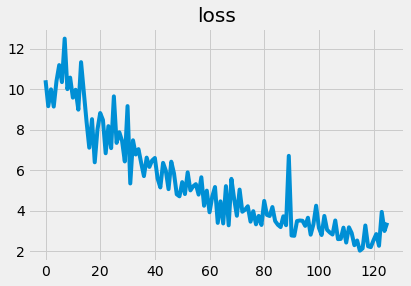

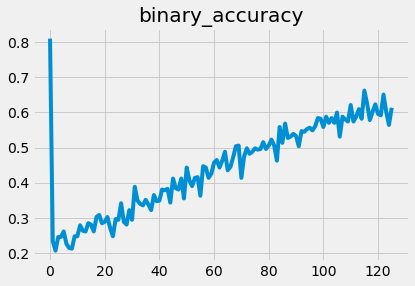

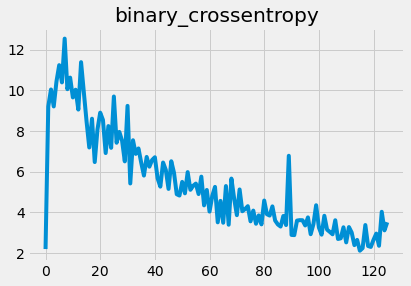

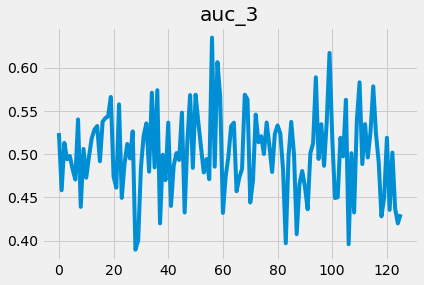

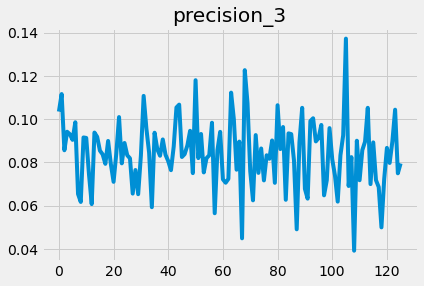

...

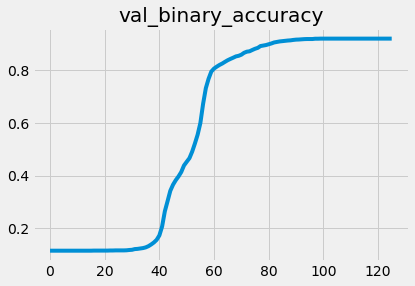

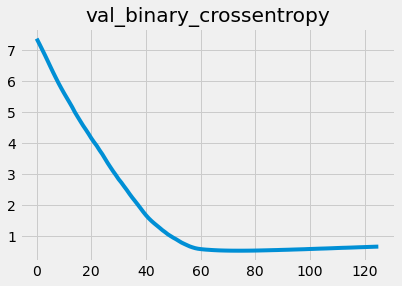

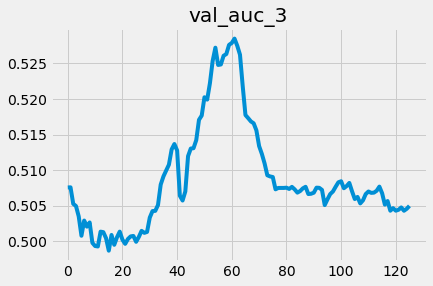

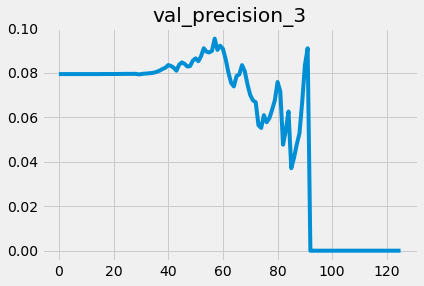

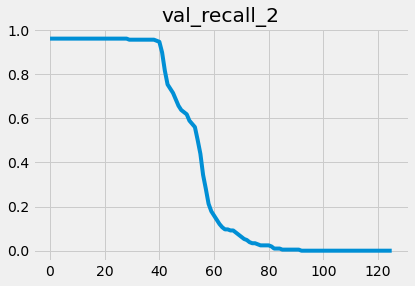

In [39]:
Models.simple_plot_history(sig_bkg_24_hist)

82/82 [==============================] - 1s 3ms/step
240.0


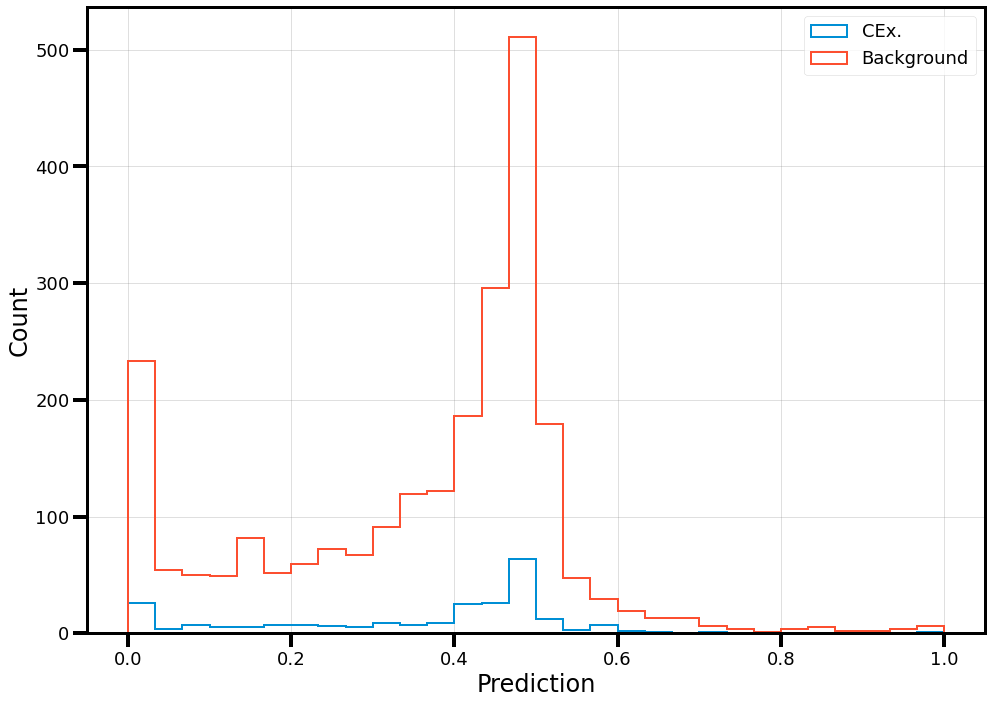

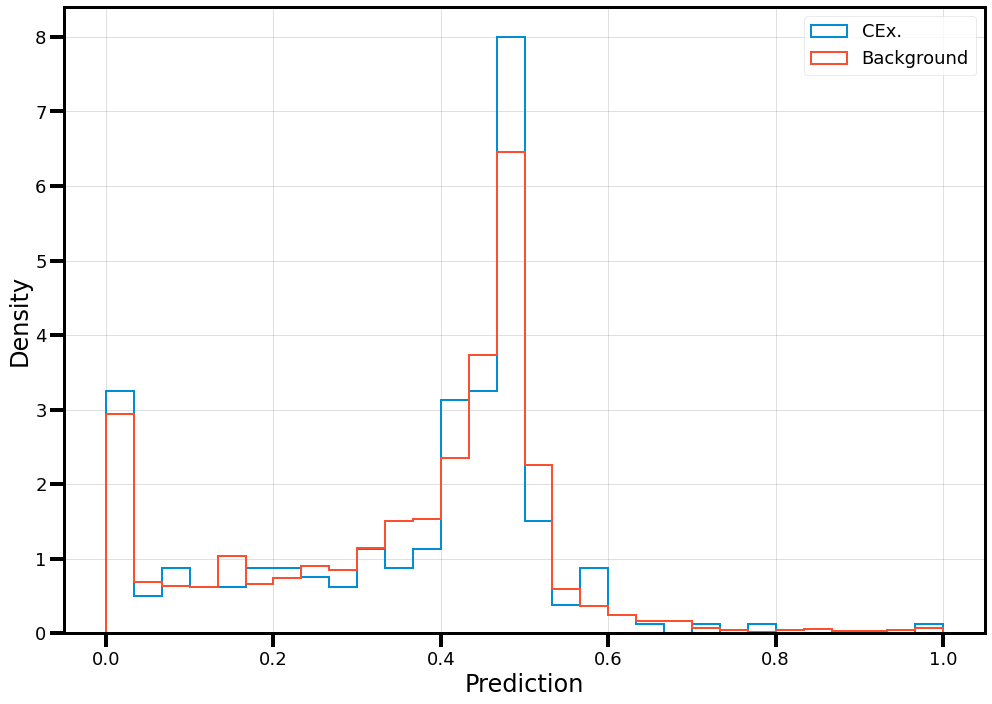

In [40]:
preds, truths = Models.get_predicitions(gat_dense_model, full_path_params["schema_path"], full_path_params["test_path"])
print(truths.sum())

bkg_preds = preds[:, 0][truths==0.]
sig_preds = preds[:, 0][truths==1.]
bins = np.linspace(0, 1, 31)

plt_conf.setup_figure()
plt.hist(sig_preds, **plt_conf.gen_kwargs(index=0, bins=bins, label="CEx.", density=False, histtype="step"))
plt.hist(bkg_preds, **plt_conf.gen_kwargs(index=1, bins=bins, label="Background", density=False, histtype="step"))
plt_conf.format_axis(xlog=False, ylog=False, xlabel="Prediction", ylabel="Count")
plt_conf.end_plot()

plt_conf.setup_figure()
plt.hist(sig_preds, **plt_conf.gen_kwargs(index=0, bins=bins, label="CEx.", density=True, histtype="step"))
plt.hist(bkg_preds, **plt_conf.gen_kwargs(index=1, bins=bins, label="Background", density=True, histtype="step"))
plt_conf.format_axis(xlog=False, ylog=False, xlabel="Prediction", ylabel="Density")
plt_conf.end_plot()

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_16 (InputLayer)       [(None,)]                 0         
                                                                 
 input.merge_batch_to_compo  ()                        0         
 nents_5 (InstanceMethod)                                        
                                                                 
 map_features_5 (MapFeature  ()                        208       
 s)                                                              
                                                                 
 graph_update (GraphUpdate)  ()                        8320      
                                                                 
 graph_update_1 (GraphUpdat  ()                        17536     
 e)                                                              
                                                           

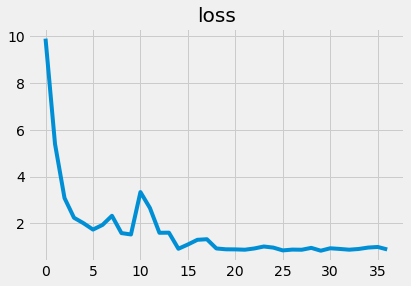

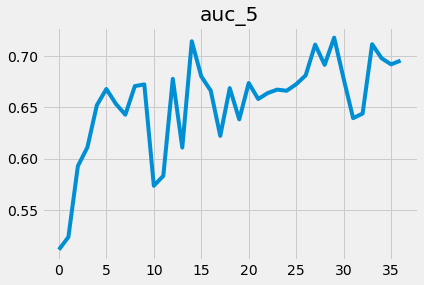

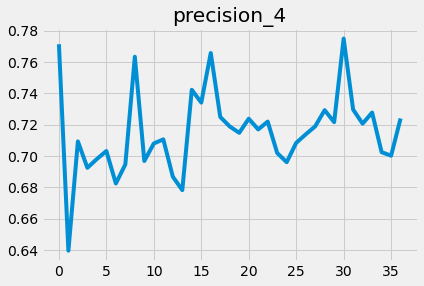

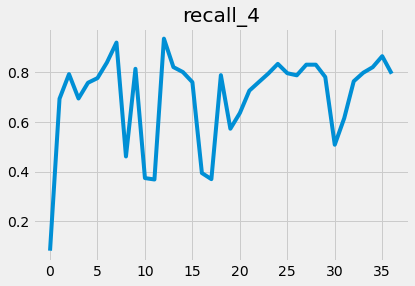

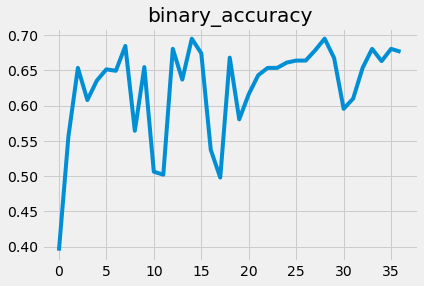

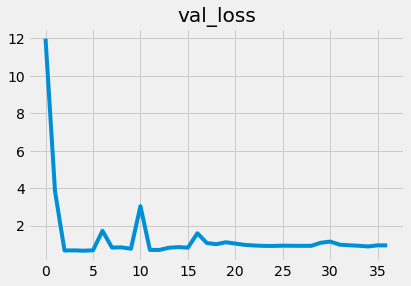

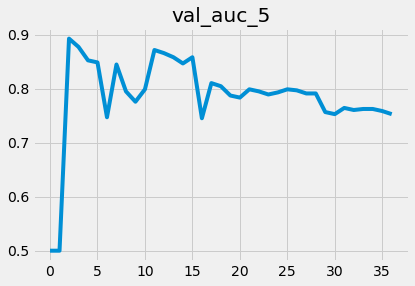

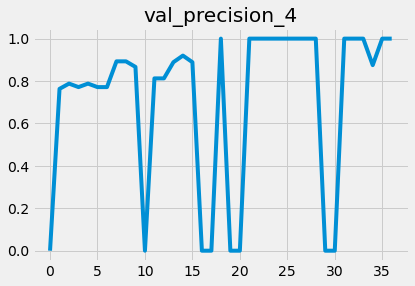

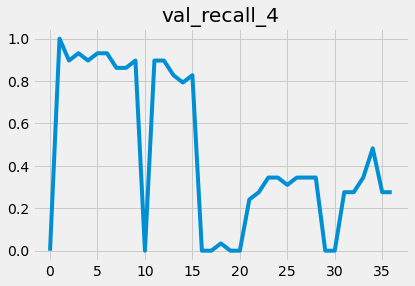

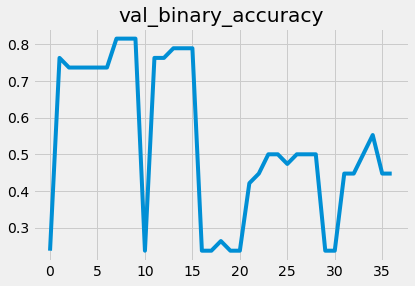

In [20]:
hyper_params_mutag_baseline = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mutag_tests/Model_sig-bkg",
    loss,
    metrics,
    callbacks,
    5e-4,
    2048,
    16,
    data_folder="/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_sig-bkg",
    training_batch=32,
    training_shuffle=1024)

MUTAG_spec = Models.get_MUTAG_input_spec(hyper_params_mutag_baseline, "/storage/wx21978/gnn/mutag_dataset/mutag")
mutag_baseline_model = _baseline_build_model(MUTAG_spec,
    node_dim=16, edge_dim=16, message_dim=64, next_state_dim=64, num_classes=1)

Models.test_architecture_on_MUTAG(mutag_baseline_model, hyper_params_mutag_baseline, "/storage/wx21978/gnn/mutag_dataset/mutag")

2/2 [==============================] - 0s 32ms/step


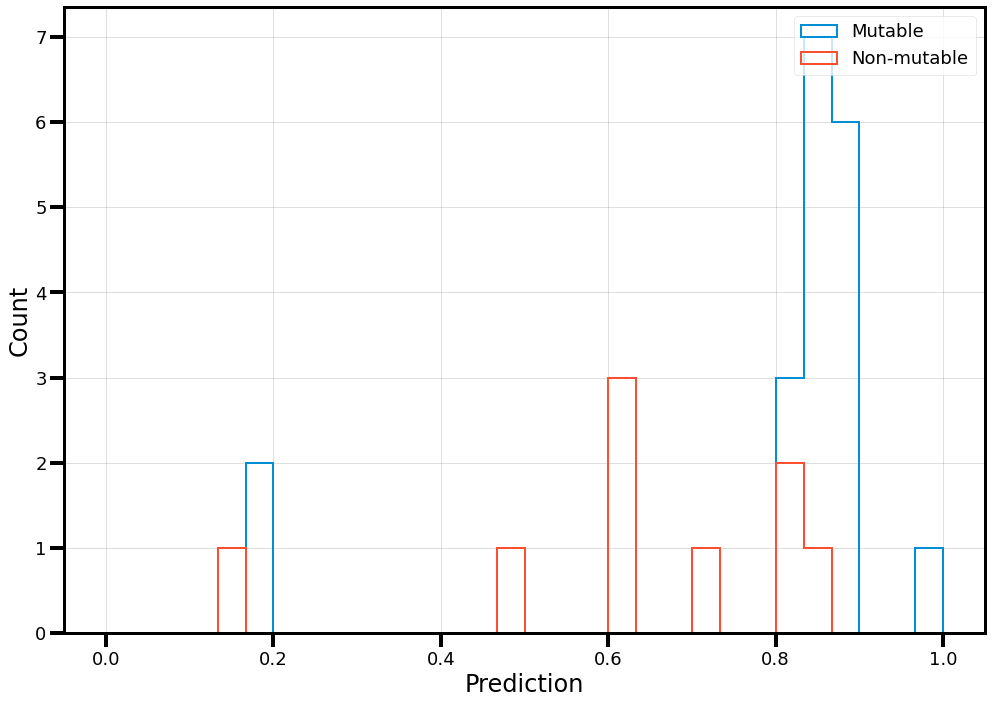

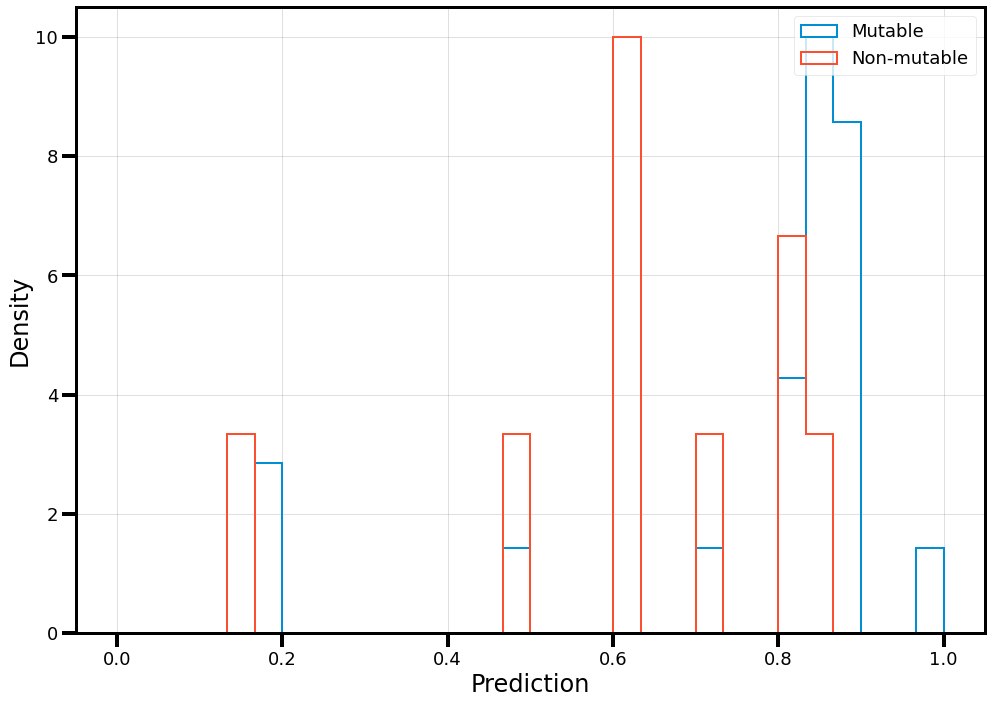

In [21]:
mutag_preds, mutag_truths = Models.get_MUTAG_predicitions(mutag_baseline_model, "/storage/wx21978/gnn/mutag_dataset/mutag")

bkg_preds = mutag_preds[:, 0][mutag_truths==0.]
sig_preds = mutag_preds[:, 0][mutag_truths==1.]
bins = np.linspace(0, 1, 31)

plt_conf.setup_figure()
plt.hist(sig_preds, **plt_conf.gen_kwargs(index=0, bins=bins, label="Mutable", density=False, histtype="step"))
plt.hist(bkg_preds, **plt_conf.gen_kwargs(index=1, bins=bins, label="Non-mutable", density=False, histtype="step"))
plt_conf.format_axis(xlog=False, ylog=False, xlabel="Prediction", ylabel="Count")
plt_conf.end_plot()

plt_conf.setup_figure()
plt.hist(sig_preds, **plt_conf.gen_kwargs(index=0, bins=bins, label="Mutable", density=True, histtype="step"))
plt.hist(bkg_preds, **plt_conf.gen_kwargs(index=1, bins=bins, label="Non-mutable", density=True, histtype="step"))
plt_conf.format_axis(xlog=False, ylog=False, xlabel="Prediction", ylabel="Density")
plt_conf.end_plot()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_16 (InputLayer)       [(None,)]                 0         
                                                                 
 input.merge_batch_to_compo  ()                        0         
 nents_5 (InstanceMethod)                                        
                                                                 
 map_features_5 (MapFeature  ()                        208       
 s)                                                              
                                                                 
 gat_v2_0 (GraphUpdate)      ()                        2240      
                                                                 
 gat_v2_1 (GraphUpdate)      ()                        8384      
                                                                 
 gat_v2_2 (GraphUpdate)      ()                        8384

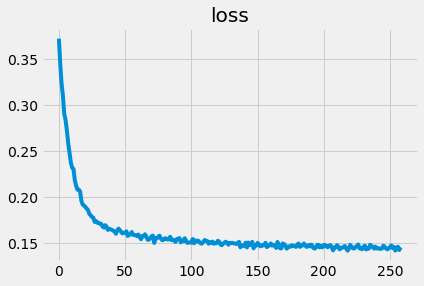

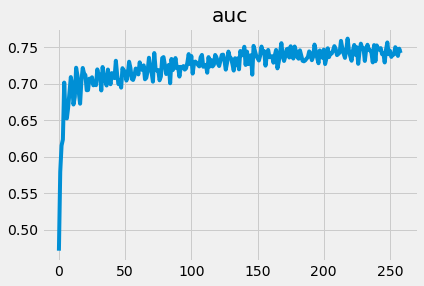

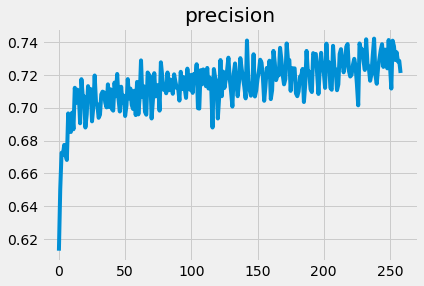

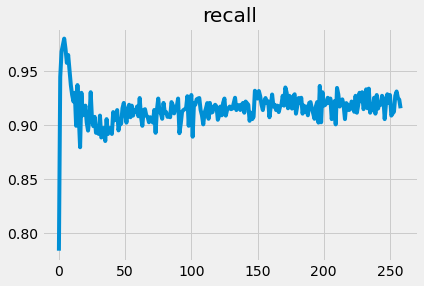

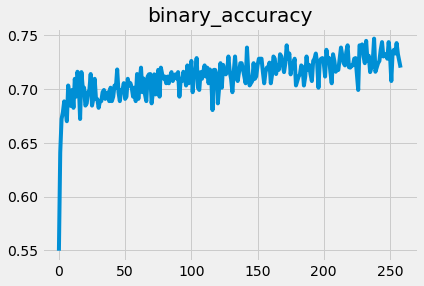

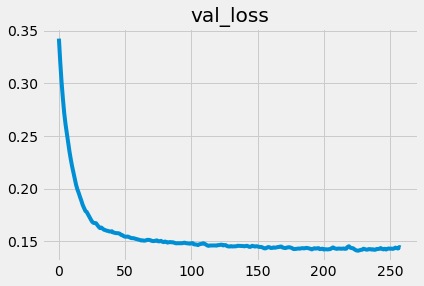

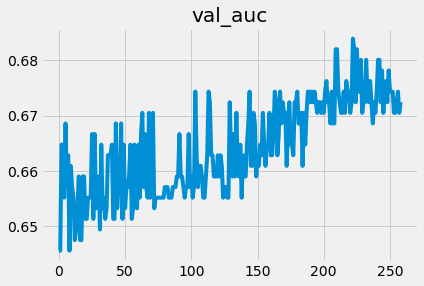

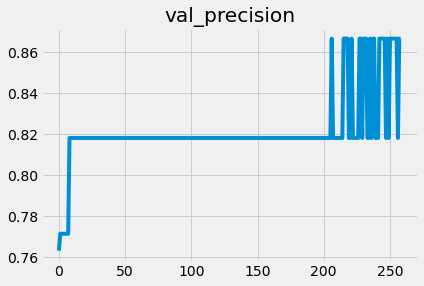

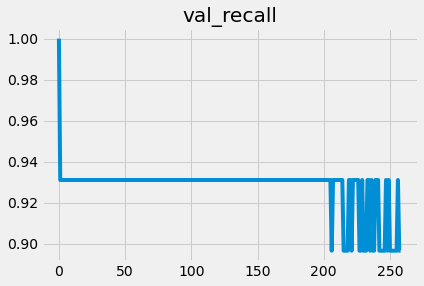

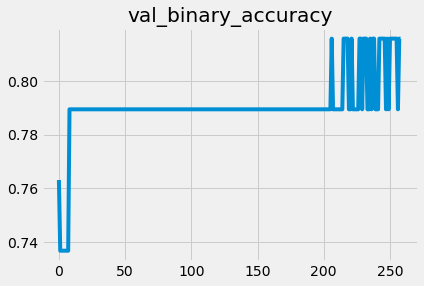

In [42]:
hyper_params_mutag = Models.generate_hyper_params(
    "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/mutag_tests/Model_gat_dense",
    loss,
    metrics,
    callbacks,
    5e-4,
    2048,
    16,
    data_folder="/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/3GeVMC00_sig-bkg",
    training_batch=32,
    training_shuffle=1024)

MUTAG_spec = Models.get_MUTAG_input_spec(hyper_params_mutag, "/storage/wx21978/gnn/mutag_dataset/mutag")
gat_dense_model_mutag = GATv2_model_dense(MUTAG_spec,
    node_dim=16, edge_dim=16, num_message_passing=3, n_heads=4, per_head_channels=16, num_classes=1,
    final_depth=2, final_nodes=64, edge_name="bonds")

Models.test_architecture_on_MUTAG(gat_dense_model_mutag, hyper_params_mutag, "/storage/wx21978/gnn/mutag_dataset/mutag")

2/2 [==============================] - 1s 77ms/step


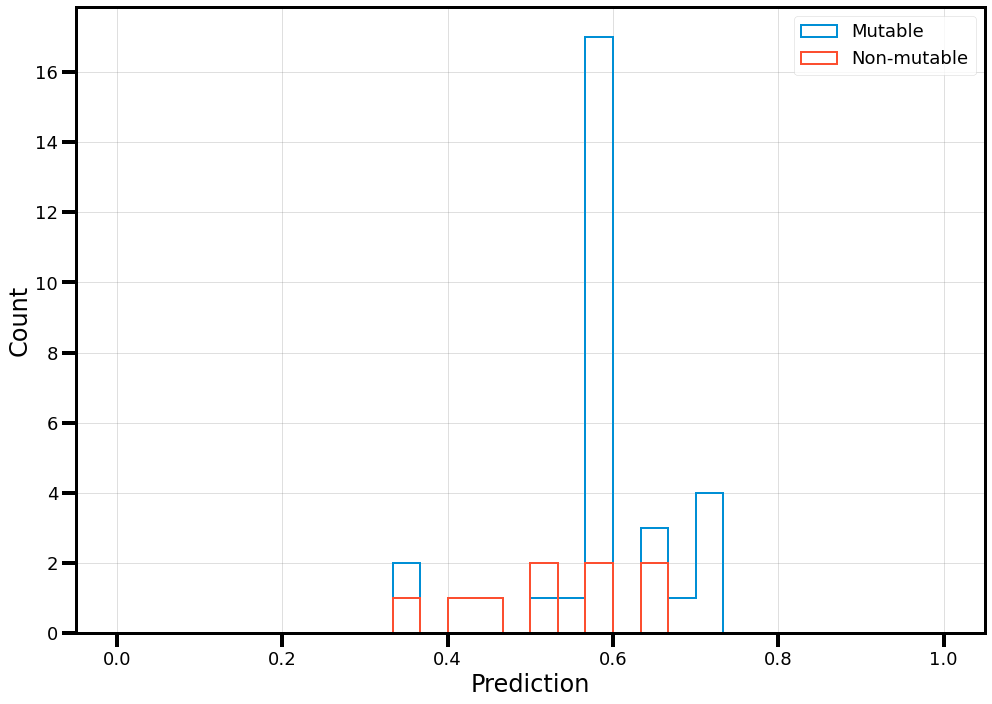

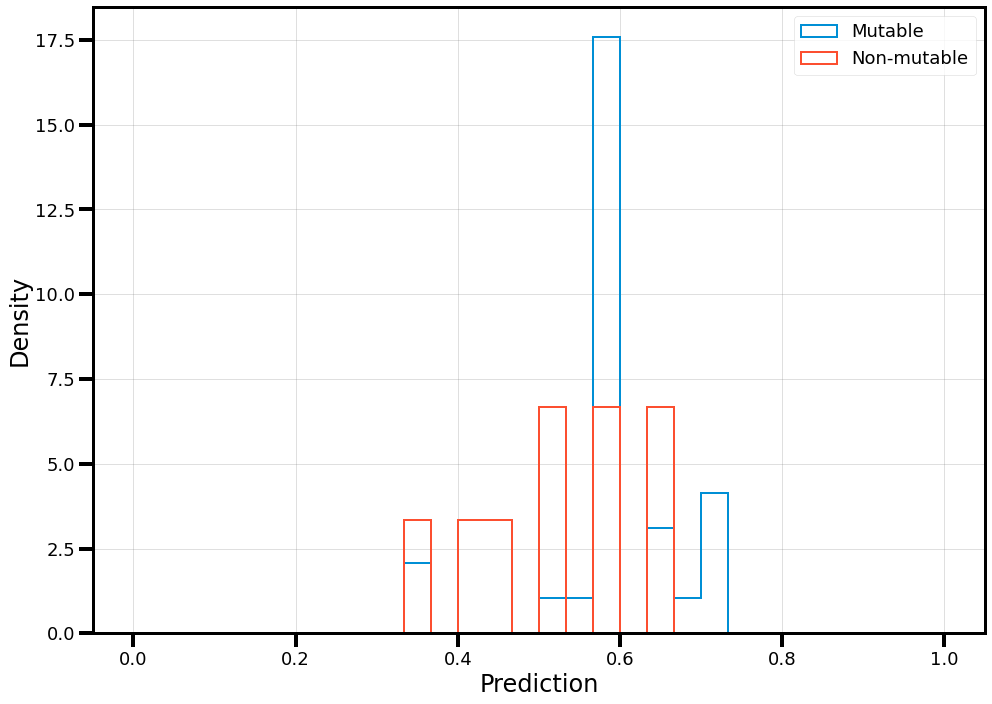

In [43]:
mutag_preds, mutag_truths = Models.get_MUTAG_predicitions(gat_dense_model_mutag, "/storage/wx21978/gnn/mutag_dataset/mutag")

bkg_preds = mutag_preds[:, 0][mutag_truths==0.]
sig_preds = mutag_preds[:, 0][mutag_truths==1.]
bins = np.linspace(0, 1, 31)

plt_conf.setup_figure()
plt.hist(sig_preds, **plt_conf.gen_kwargs(index=0, bins=bins, label="Mutable", density=False, histtype="step"))
plt.hist(bkg_preds, **plt_conf.gen_kwargs(index=1, bins=bins, label="Non-mutable", density=False, histtype="step"))
plt_conf.format_axis(xlog=False, ylog=False, xlabel="Prediction", ylabel="Count")
plt_conf.end_plot()

plt_conf.setup_figure()
plt.hist(sig_preds, **plt_conf.gen_kwargs(index=0, bins=bins, label="Mutable", density=True, histtype="step"))
plt.hist(bkg_preds, **plt_conf.gen_kwargs(index=1, bins=bins, label="Non-mutable", density=True, histtype="step"))
plt_conf.format_axis(xlog=False, ylog=False, xlabel="Prediction", ylabel="Density")
plt_conf.end_plot()

In [48]:
test_record = DataPreparation.load_record(full_path_params["schema_path"], full_path_params["test_path"])
test_label = test_record.map(lambda data, label : label)
print(test_label)
truth_index = Models.convert_labels_to_truth(test_label)

<_MapDataset element_spec=TensorSpec(shape=(1,), dtype=tf.float32, name=None)>


In [44]:
preds, truths = Models.get_predicitions(gat_model_sig_bkg, full_path_params["schema_path"], full_path_params["test_path"])

Cause: could not parse the source code of <function get_predicitions.<locals>.<lambda> at 0x7f896466a170>: no matching AST found among candidates:
# coding=utf-8
lambda data, label: data
# coding=utf-8
lambda data, label: label
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: could not parse the source code of <function get_predicitions.<locals>.<lambda> at 0x7f896466a170>: no matching AST found among candidates:
# coding=utf-8
lambda data, label: data
# coding=utf-8
lambda data, label: label
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3398, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/tmp/ipykernel_31536/528448831.py", line 1, in <cell line: 1>
    preds, truths = Models.get_predicitions(gat_model_sig_bkg, full_path_params["schema_path"], full_path_params["test_path"])
  File "/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py", line 413, in get_predicitions
  File "/software/wx21978/miniconda/envs/pi0-phys-ml/lib/python3.10/site-packages/keras/src/utils/traceback_utils.py", line 70, in error_handler
    raise e.with_traceback(filtered_tb) from None
  File "/tmp/__autograph_generated_fileyf3obfdn.py", line 15, in tf__predict_function
    retval_ = ag__.converted_call(ag__.ld(step_function), (ag__.ld(self), ag__.ld(iterator)), None, fscope)
AttributeError: in user code:

    File "/software/wx21978/miniconda

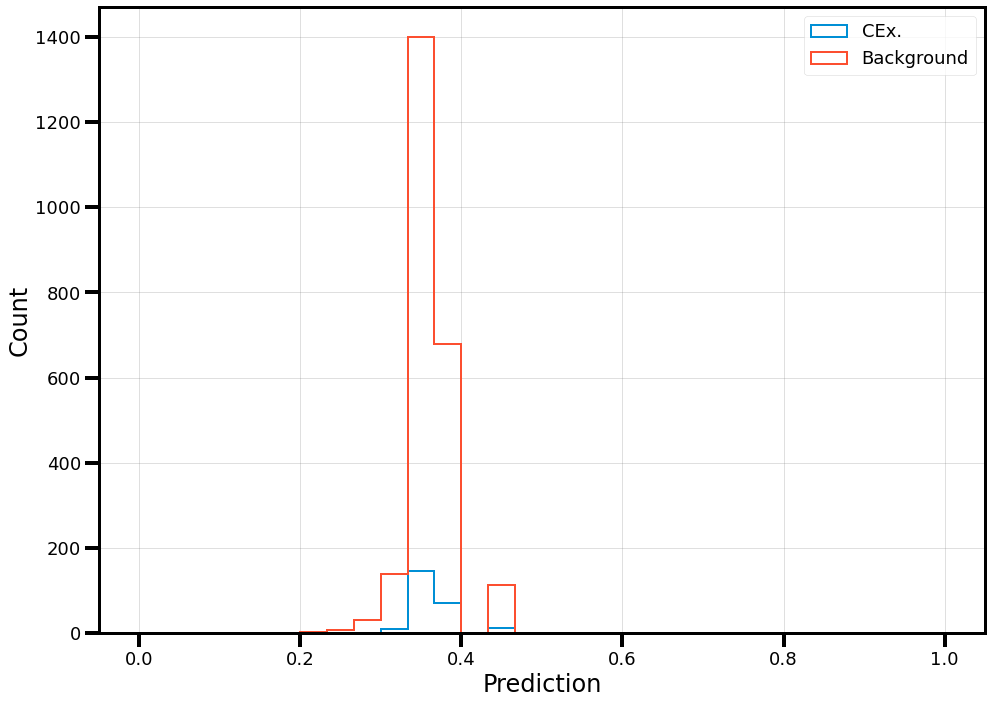

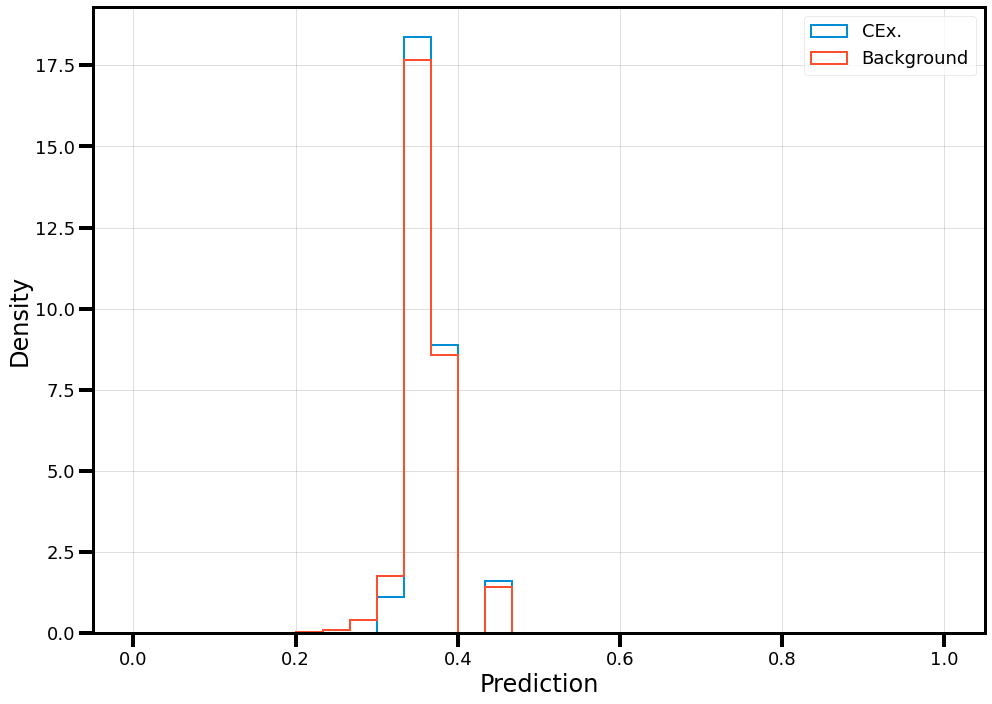

In [93]:
bkg_preds = preds[:, 0][truths==0.]
sig_preds = preds[:, 0][truths==1.]
bins = np.linspace(0, 1, 31)

plt_conf.setup_figure()
plt.hist(sig_preds, **plt_conf.gen_kwargs(index=0, bins=bins, label="CEx.", density=False, histtype="step"))
plt.hist(bkg_preds, **plt_conf.gen_kwargs(index=1, bins=bins, label="Background", density=False, histtype="step"))
plt_conf.format_axis(xlog=False, ylog=False, xlabel="Prediction", ylabel="Count")
plt_conf.end_plot()

plt_conf.setup_figure()
plt.hist(sig_preds, **plt_conf.gen_kwargs(index=0, bins=bins, label="CEx.", density=True, histtype="step"))
plt.hist(bkg_preds, **plt_conf.gen_kwargs(index=1, bins=bins, label="Background", density=True, histtype="step"))
plt_conf.format_axis(xlog=False, ylog=False, xlabel="Prediction", ylabel="Density")
plt_conf.end_plot()

655/655 [==============================] - 1s 2ms/step
240.0


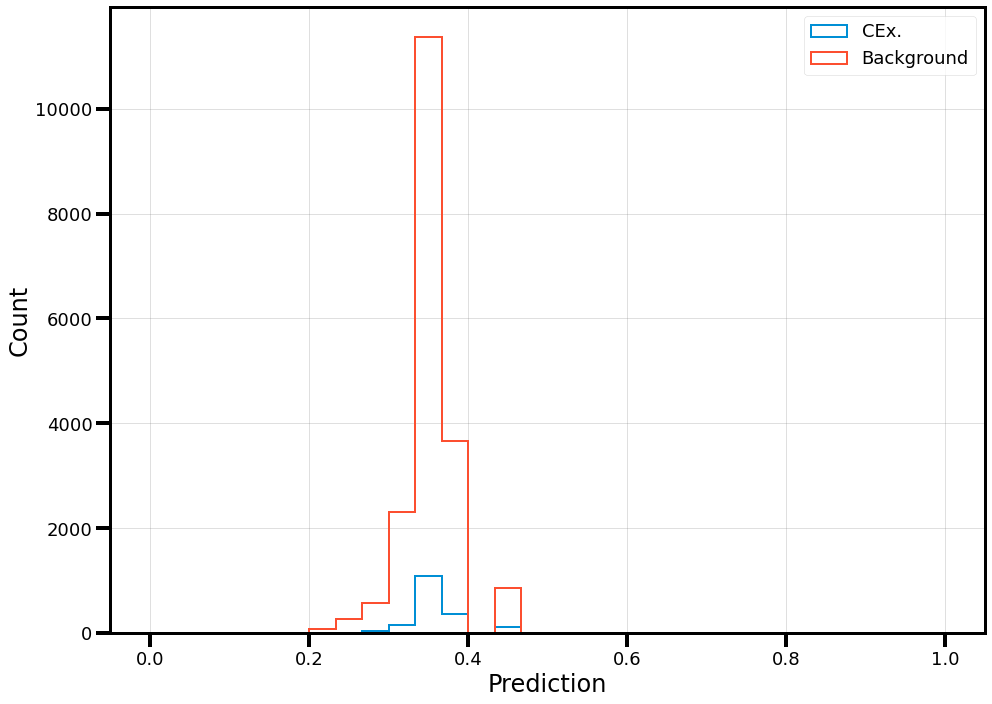

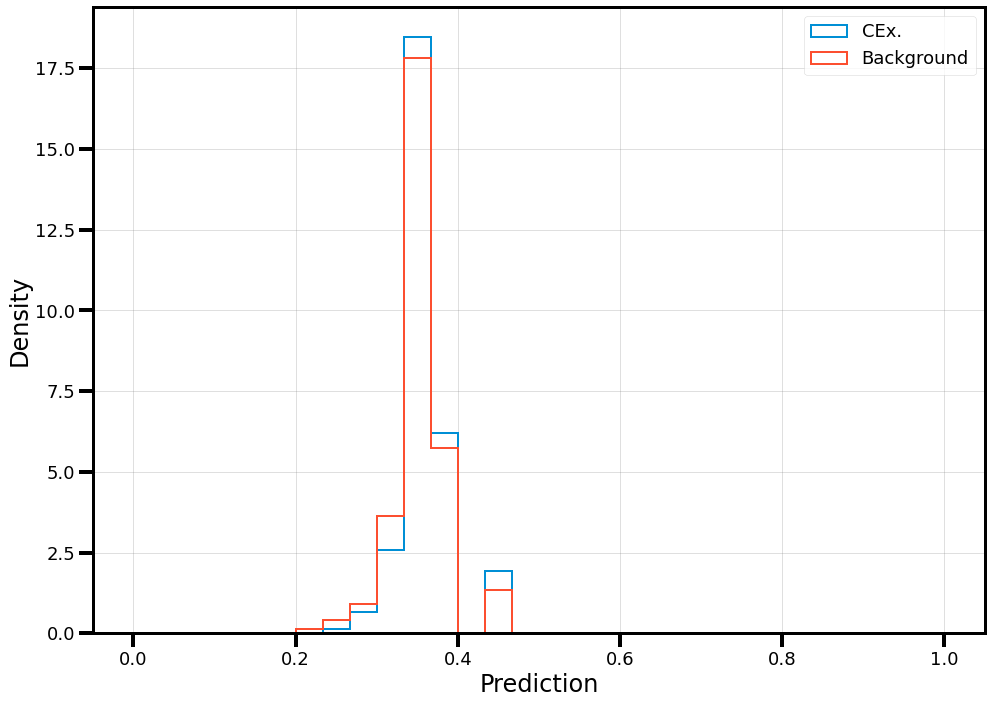

In [87]:
preds_train, truths_train = Models.get_predicitions(gat_model_sig_bkg, full_path_params["schema_path"], full_path_params["train_path"])
print(truths.sum())

bkg_preds_train = preds_train[:, 0][truths_train==0.]
sig_preds_train = preds_train[:, 0][truths_train==1.]
bins = np.linspace(0, 1, 31)

plt_conf.setup_figure()
plt.hist(sig_preds_train, **plt_conf.gen_kwargs(index=0, bins=bins, label="CEx.", density=False, histtype="step"))
plt.hist(bkg_preds_train, **plt_conf.gen_kwargs(index=1, bins=bins, label="Background", density=False, histtype="step"))
plt_conf.format_axis(xlog=False, ylog=False, xlabel="Prediction", ylabel="Count")
plt_conf.end_plot()

plt_conf.setup_figure()
plt.hist(sig_preds_train, **plt_conf.gen_kwargs(index=0, bins=bins, label="CEx.", density=True, histtype="step"))
plt.hist(bkg_preds_train, **plt_conf.gen_kwargs(index=1, bins=bins, label="Background", density=True, histtype="step"))
plt_conf.format_axis(xlog=False, ylog=False, xlabel="Prediction", ylabel="Density")
plt_conf.end_plot()

82/82 [==============================] - 2s 11ms/step
2617 events searched.
2617 events correctly classified (0 false), for an efficiency of 100.00%.
For Cex.: 100.00% efficiency, 100.00% purity.



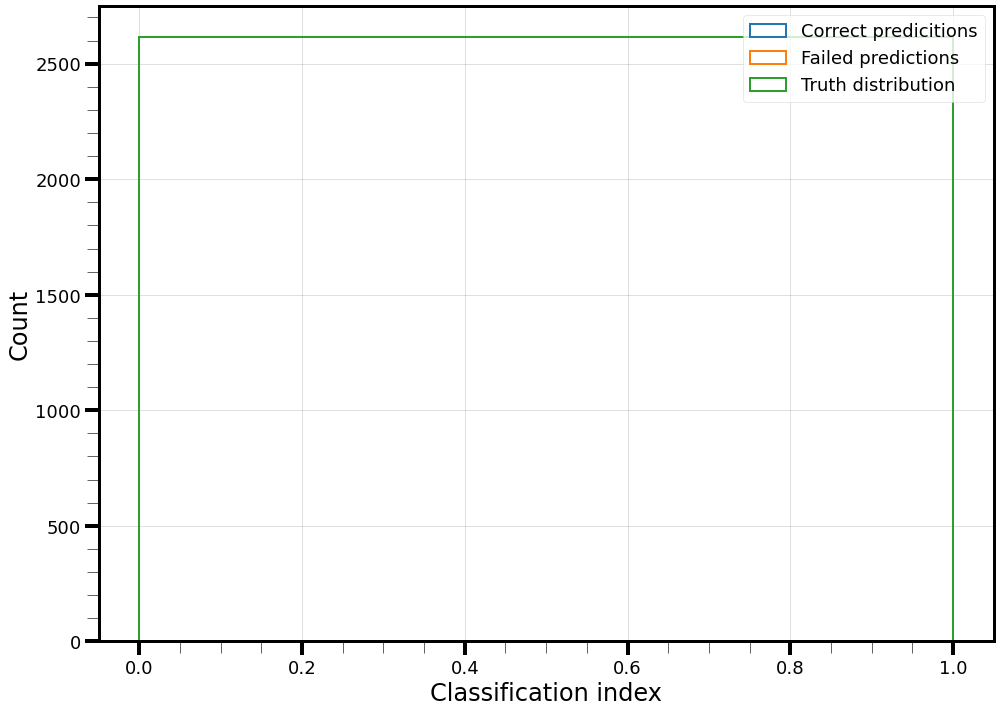

In [14]:
_ = Models.evaluate_model(
    gat_model_sig_bkg,
    full_path_params["schema_path"],
    full_path_params["test_path"],
    classification_labels=["Cex."], plot_config=plt_conf)

In [159]:
gat_model_full.compile(tf.keras.optimizers.Adam(learning_rate=1e-3), loss=loss)#, metrics=metrics)
gat_model_full.summary()

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_16 (InputLayer)       [()]                      0         
                                                                 
 input.merge_batch_to_compo  ()                        0         
 nents_5 (InstanceMethod)                                        
                                                                 
 map_features_5 (MapFeature  ()                        240       
 s)                                                              
                                                                 
 gat_v2_0 (GraphUpdate)      ()                        2240      
                                                                 
 gat_v2_1 (GraphUpdate)      ()                        8384      
                                                                 
 gat_v2_2 (GraphUpdate)      ()                        8384

In [124]:
y_true.shape[-1] - 1

3

In [146]:
y_true = tf.constant([[0, 1, 0, 0], [0, 0, 0, 1]])
y_pred = tf.constant([[0., 0.5, 0., 0., 0.5] , [0., 0., 0.1, 0.7, 0.2]])
unclass_weight = 0.5

unclass_pred = unclass_weight
print((y_true * unclass_pred))
print((((1-y_true) * (1-unclass_pred))))
pred_weighting = (y_true * unclass_pred) + (((1-y_true) * (1-unclass_pred))/(y_true.shape[-1] - 1))
# print(pred_weighting.shape)
# print(y_pred[..., :-1].shape)
print((y_pred[..., :-1] + pred_weighting * y_pred[..., -1:]))

TypeError: Cannot convert 0.5 to EagerTensor of dtype int32

In [145]:
tf.keras.losses.CategoricalCrossentropy()(y_true, y_pred[..., :-1])

<tf.Tensor: shape=(), dtype=float64, numpy=0.06676574631226379>

In [147]:
Models.CategoricalCrossentropyUnclassBin()(y_true, y_pred)

TypeError: Cannot convert 0.5 to EagerTensor of dtype int32

In [131]:
Models.CategoricalCrossentropyUnclassBin()(np.array([0, 1, 0, 0]), np.array([0., 0.5, 0., 0., 0.5]))

<tf.Tensor: shape=(), dtype=float64, numpy=0.2876820724517809>

In [132]:
Models.CategoricalCrossentropyUnclassBin()(np.array([0, 1, 0, 0]), np.array([0., 0., 0., 0., 1.]))

<tf.Tensor: shape=(), dtype=float64, numpy=0.6931471805599453>

In [133]:
Models.CategoricalCrossentropyUnclassBin()(np.array([0, 1, 0, 0]), np.array([0., 0., 1., 0., 0.]))

<tf.Tensor: shape=(), dtype=float64, numpy=16.11809565095832>

In [160]:
history_gat_full = gat_model_full.fit(train_ds_batched,
                            steps_per_epoch=10,
                            epochs=1000,
                            callbacks=callbacks,
                            validation_data=val_ds_batched)

Epoch 1/1000
10/10 [==============================] - 3s 89ms/step - loss: 1.1003 - val_loss: 0.9520
Epoch 2/1000
10/10 [==============================] - 0s 35ms/step - loss: 0.8933 - val_loss: 0.8046
Epoch 3/1000
10/10 [==============================] - 0s 36ms/step - loss: 0.7632 - val_loss: 0.7275
Epoch 4/1000
10/10 [==============================] - 0s 36ms/step - loss: 0.7303 - val_loss: 0.7154
Epoch 5/1000
10/10 [==============================] - 0s 36ms/step - loss: 0.7098 - val_loss: 0.7141
Epoch 6/1000
10/10 [==============================] - 0s 35ms/step - loss: 0.7171 - val_loss: 0.7139
Epoch 7/1000
10/10 [==============================] - 0s 36ms/step - loss: 0.7155 - val_loss: 0.7138
Epoch 8/1000
10/10 [==============================] - 0s 35ms/step - loss: 0.7229 - val_loss: 0.7137
Epoch 9/1000
10/10 [==============================] - 0s 35ms/step - loss: 0.7296 - val_loss: 0.7137
Epoch 10/1000
10/10 [==============================] - 0s 35ms/step - loss: 0.7183 - val_lo

In [156]:
from importlib import reload
reload(Models)

<module 'python.gnn.Models' from '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py'>

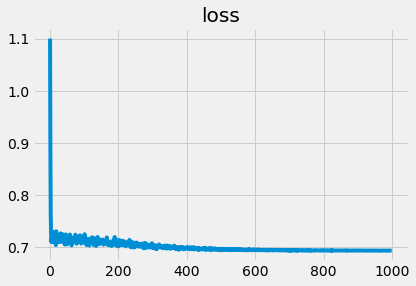

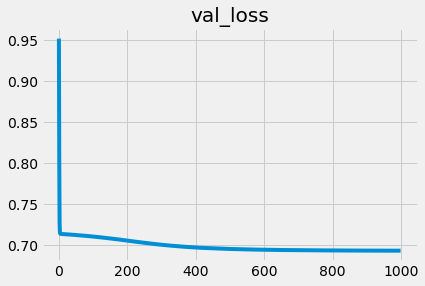

Cause: could not parse the source code of <function evaluate_model.<locals>.<lambda> at 0x7f8b90699630>: no matching AST found among candidates:
# coding=utf-8
lambda data, label: data
# coding=utf-8
lambda data, label: label
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: could not parse the source code of <function evaluate_model.<locals>.<lambda> at 0x7f8b90699630>: no matching AST found among candidates:
# coding=utf-8
lambda data, label: data
# coding=utf-8
lambda data, label: label
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: could not parse the source code of <function evaluate_model.<locals>.<lambda> at 0x7f8b90699b40>: no matching AST found among candidates:
# coding=utf-8
lambda data, label: data
# coding=utf-8
lambda data, label: label
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: could not parse the source code o

/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py:173: RuntimeWarning: invalid value encountered in scalar divide
  summary_text += f"{eff:.2f}% efficiency, {purity:.2f}% purity.\n"


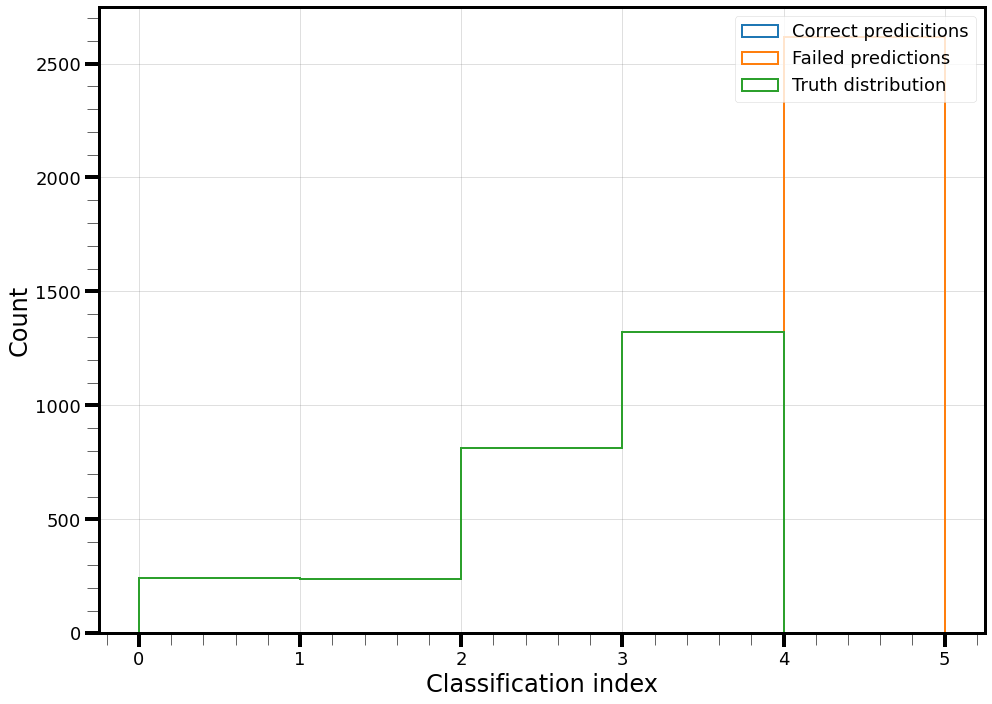

In [161]:
for k, hist in history_gat_full.history.items():
    plt.plot(hist)
    plt.title(k)
    plt.show()
_ = Models.evaluate_model(
    gat_model_full,
    full_path_params["schema_path"],
    full_path_params["test_path"],
    classification_labels=["Absorption", "Cex.", "Single pion prod.", "Multi pion prod."], plot_config=plt_conf)

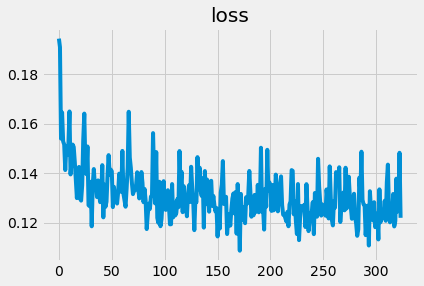

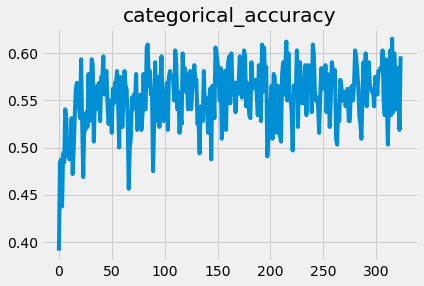

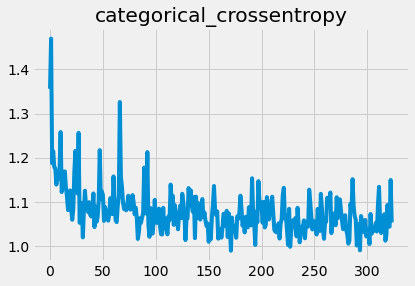

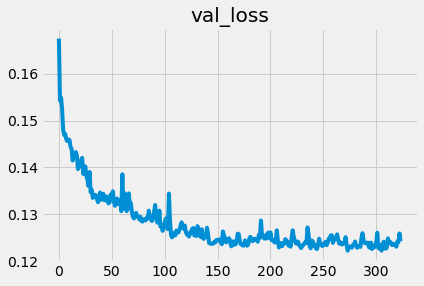

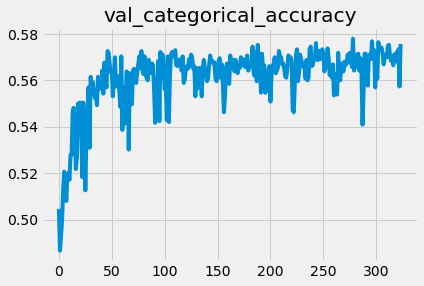

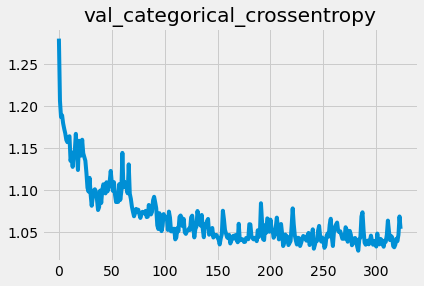

82/82 [==============================] - 1s 3ms/step
2617 events searched.
1449 events correctly classified (1168 false), for an efficiency of 55.37%.
For Absorption: 16.39% efficiency, 53.33% purity.
For Cex.: 1.25% efficiency, 50.00% purity.
For Single pion prod.: 43.03% efficiency, 48.20% purity.
For Multi pion prod.: 79.95% efficiency, 58.33% purity.



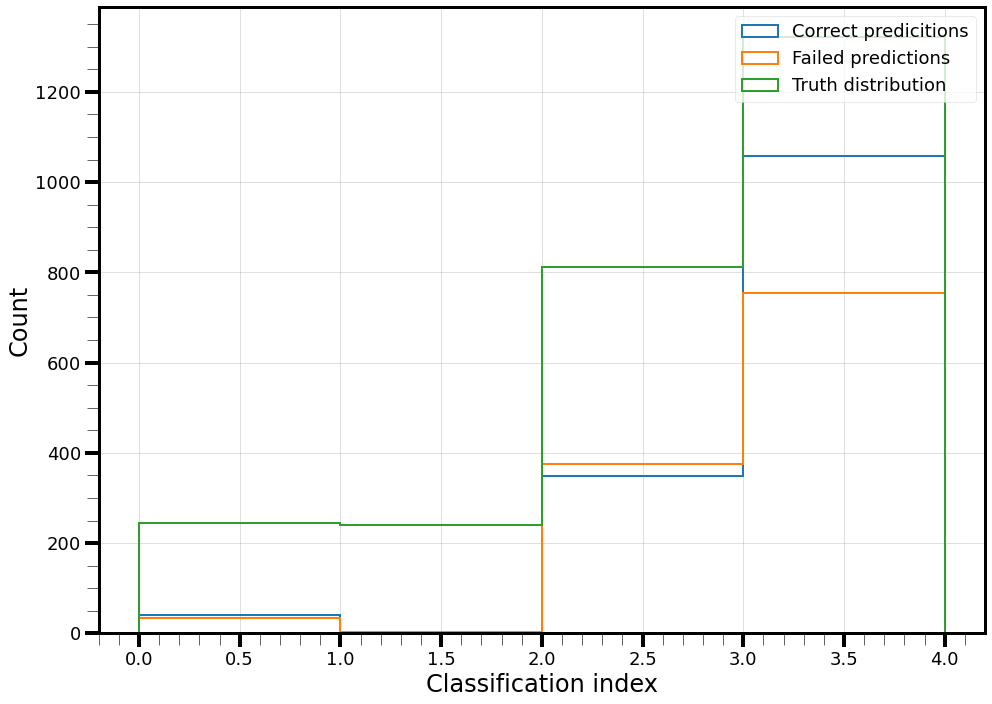

In [36]:
for k, hist in history_gat_full.history.items():
    plt.plot(hist)
    plt.title(k)
    plt.show()
_ = Models.evaluate_model(
    gat_model_full,
    full_path_params["schema_path"],
    full_path_params["test_path"],
    classification_labels=["Absorption", "Cex.", "Single pion prod.", "Multi pion prod."], plot_config=plt_conf)

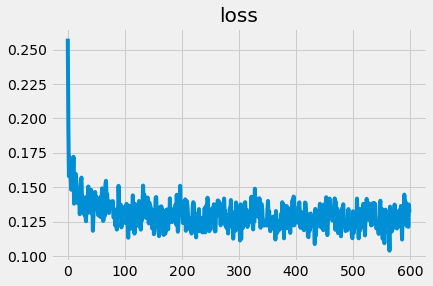

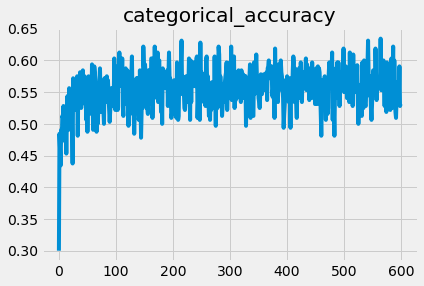

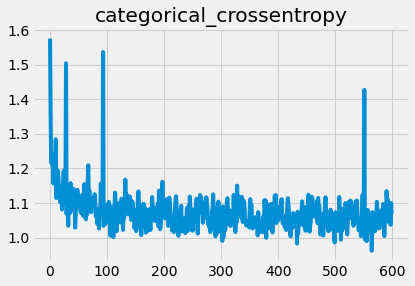

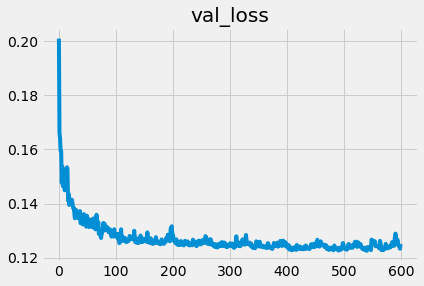

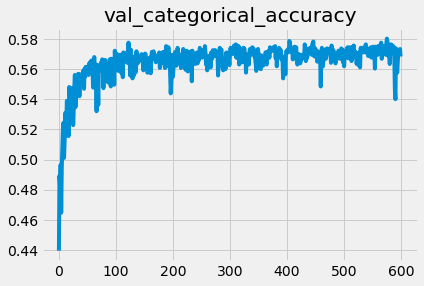

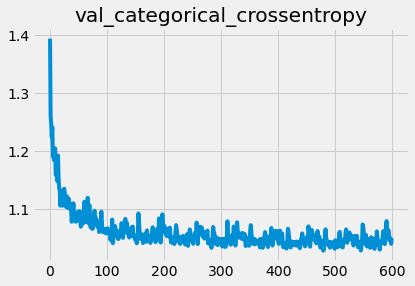

82/82 [==============================] - 1s 3ms/step
2617 events searched.
1465 events correctly classified (1152 false), for an efficiency of 55.98%.
For Absorption: 12.70% efficiency, 73.81% purity.
For Cex.: 0.00% efficiency, 0.00% purity.
For Single pion prod.: 39.58% efficiency, 50.47% purity.
For Multi pion prod.: 84.19% efficiency, 57.43% purity.



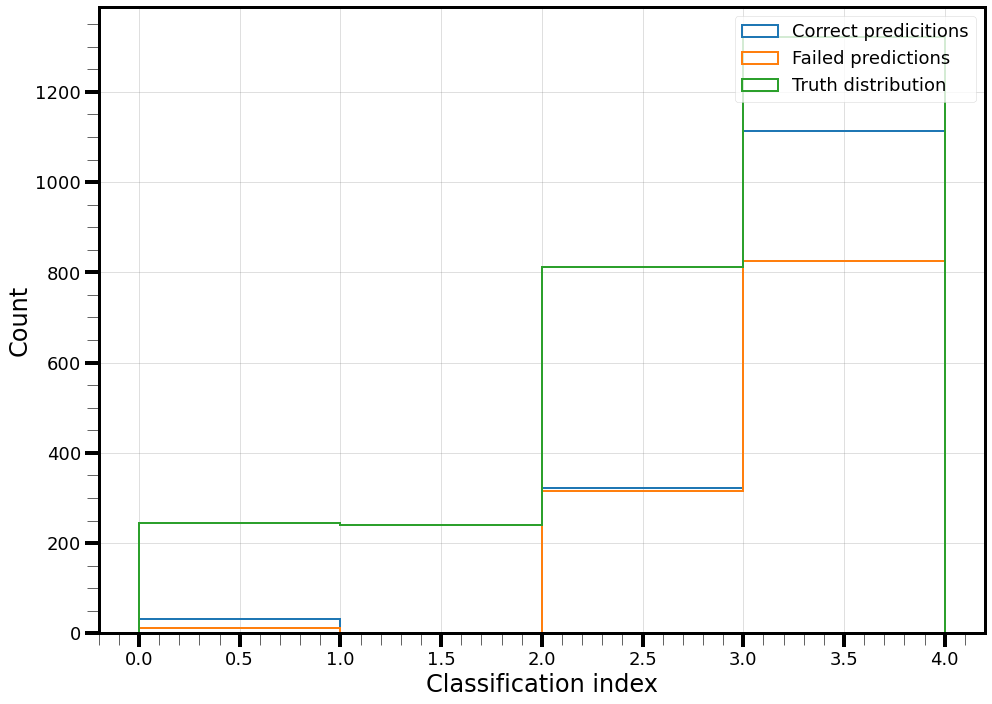

In [31]:
for k, hist in history_gat_full.history.items():
    plt.plot(hist)
    plt.title(k)
    plt.show()
_ = Models.evaluate_model(
    gat_model_full,
    full_path_params["schema_path"],
    full_path_params["test_path"],
    classification_labels=["Absorption", "Cex.", "Single pion prod.", "Multi pion prod."], plot_config=plt_conf)

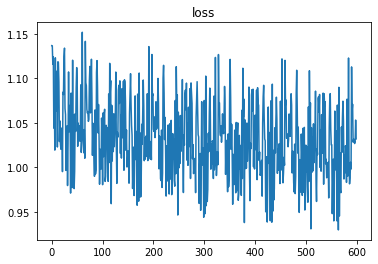

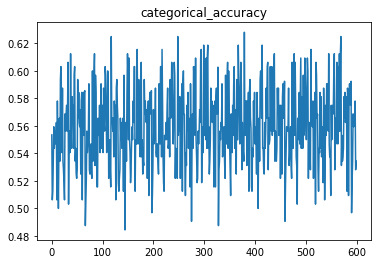

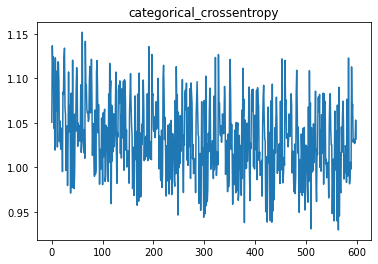

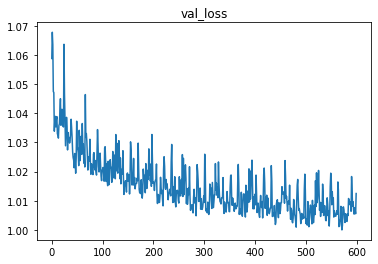

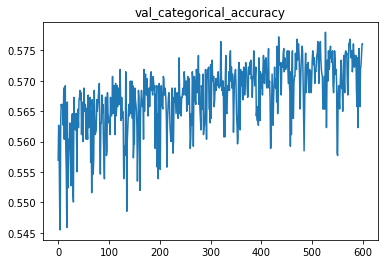

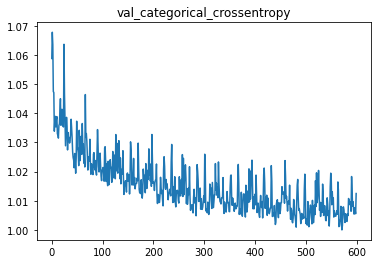

82/82 [==============================] - 1s 3ms/step
2617 events searched.
1475 events correctly classified (1142 false), for an efficiency of 56.36%.
For Absorption: 12.70% efficiency, 70.45% purity.
For Cex.: 0.00% efficiency, nan% purity.
For Single pion prod.: 41.31% efficiency, 50.99% purity.
For Multi pion prod.: 83.89% efficiency, 57.88% purity.



/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py:162: RuntimeWarning: invalid value encountered in scalar divide
  purity = (100*np.sum(truth_index[pred_index==i] == i)


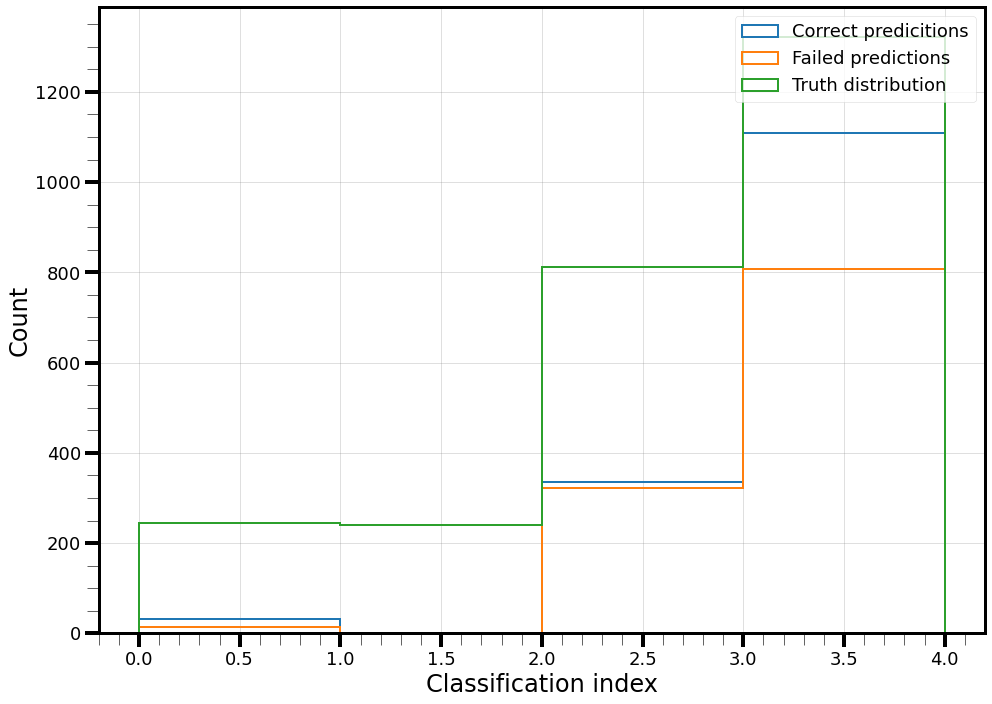

In [25]:
for k, hist in history_gat_full.history.items():
    plt.plot(hist)
    plt.title(k)
    plt.show()
_ = Models.evaluate_model(
    gat_model_full,
    full_path_params["schema_path"],
    full_path_params["test_path"],
    classification_labels=["Absorption", "Cex.", "Single pion prod.", "Multi pion prod."], plot_config=plt_conf)

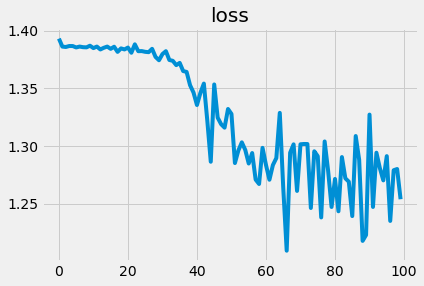

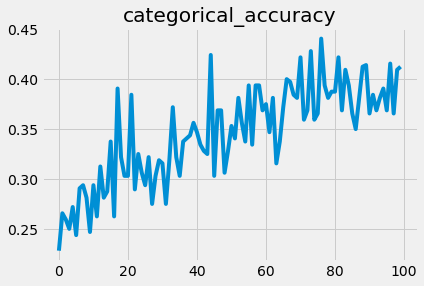

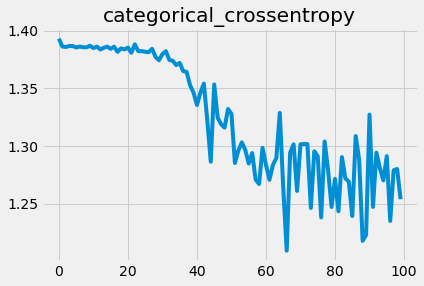

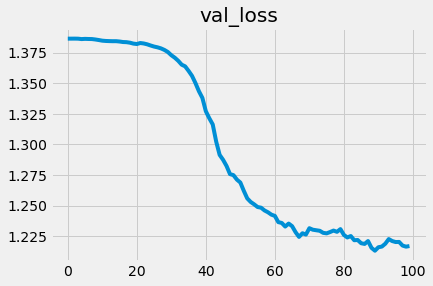

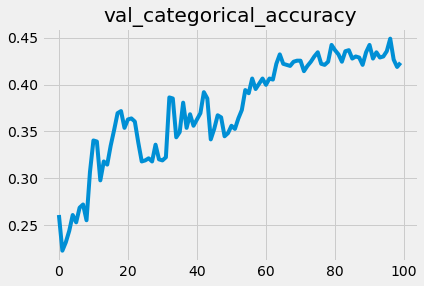

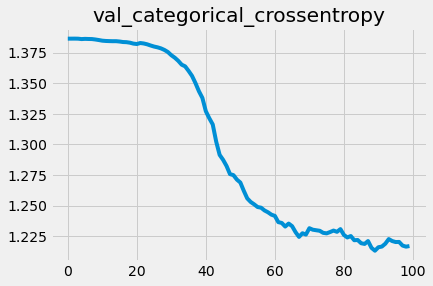

In [180]:
for k, hist in history_gat.history.items():
  plt.plot(hist)
  plt.title(k)
  plt.show()

Cause: could not parse the source code of <function evaluate_model.<locals>.<lambda> at 0x7fdcffcb6cb0>: no matching AST found among candidates:
# coding=utf-8
lambda data, label: data
# coding=utf-8
lambda data, label: label
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: could not parse the source code of <function evaluate_model.<locals>.<lambda> at 0x7fdcffcb6cb0>: no matching AST found among candidates:
# coding=utf-8
lambda data, label: data
# coding=utf-8
lambda data, label: label
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: could not parse the source code of <function evaluate_model.<locals>.<lambda> at 0x7fdcffcb7010>: no matching AST found among candidates:
# coding=utf-8
lambda data, label: data
# coding=utf-8
lambda data, label: label
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: could not parse the source code o

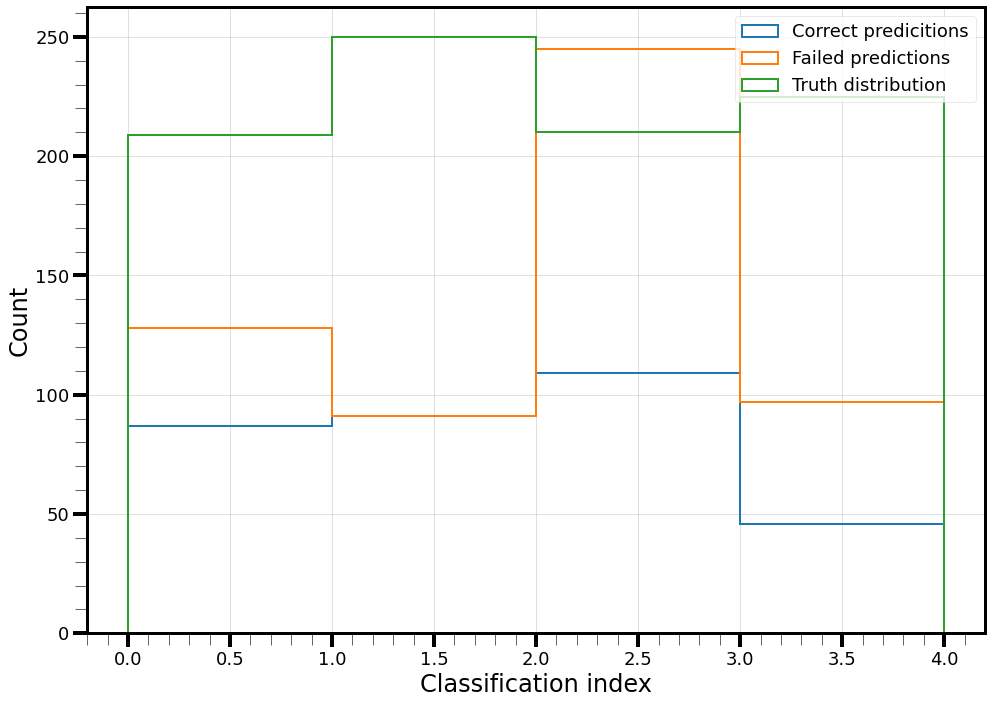

In [181]:
_ = Models.evaluate_model(
    gat_model,
    data_params_sampled["schema_path"],
    data_params_sampled["test_path"],
    classification_labels=data_params_sampled["classifications"], plot_config=plt_conf)

In [176]:
model_samp.compile(tf.keras.optimizers.Adam(learning_rate=1e-3), loss=loss, metrics=metrics)

In [ ]:
model_samp.summary()

Model: "model_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_28 (InputLayer)       [()]                      0         
                                                                 
 input.merge_batch_to_compo  ()                        0         
 nents_9 (InstanceMethod)                                        
                                                                 
 map_features_9 (MapFeature  ()                        240       
 s)                                                              
                                                                 
 graph_update_26 (GraphUpda  ()                        3136      
 te)                                                             
                                                                 
 graph_update_27 (GraphUpda  ()                        4672      
 te)                                                       

In [158]:
history_samp = model_samp.fit(train_ds_batched,
                            steps_per_epoch=10,
                            epochs=100,
                            # callbacks=callbacks,
                            validation_data=val_ds_batched)

Epoch 1/100
10/10 [==============================] - 2s 54ms/step - loss: 1063.6296 - categorical_accuracy: 0.2281 - categorical_crossentropy: 1063.5021 - val_loss: 140.2067 - val_categorical_accuracy: 0.2240 - val_categorical_crossentropy: 140.0795
Epoch 2/100
10/10 [==============================] - 0s 17ms/step - loss: 467.3015 - categorical_accuracy: 0.2250 - categorical_crossentropy: 467.1744 - val_loss: 81.2454 - val_categorical_accuracy: 0.2497 - val_categorical_crossentropy: 81.1184
Epoch 3/100
10/10 [==============================] - 0s 17ms/step - loss: 254.8668 - categorical_accuracy: 0.2719 - categorical_crossentropy: 254.7398 - val_loss: 74.3166 - val_categorical_accuracy: 0.2531 - val_categorical_crossentropy: 74.1898
Epoch 4/100
10/10 [==============================] - 0s 17ms/step - loss: 153.4607 - categorical_accuracy: 0.2688 - categorical_crossentropy: 153.3340 - val_loss: 59.6575 - val_categorical_accuracy: 0.2497 - val_categorical_crossentropy: 59.5308
Epoch 5/100


In [39]:
history = model.fit(train_ds_batched,
                    steps_per_epoch=10,
                    epochs=200,
                    # callbacks=callbacks,
                    validation_data=val_ds_batched)

Epoch 1/200
10/10 [==============================] - 2s 66ms/step - loss: 369.9168 - categorical_accuracy: 0.2844 - categorical_crossentropy: 369.7904 - val_loss: 70.0648 - val_categorical_accuracy: 0.4805 - val_categorical_crossentropy: 69.9386
Epoch 2/200
10/10 [==============================] - 0s 24ms/step - loss: 228.6818 - categorical_accuracy: 0.3406 - categorical_crossentropy: 228.5557 - val_loss: 37.6404 - val_categorical_accuracy: 0.4874 - val_categorical_crossentropy: 37.5145
Epoch 3/200
10/10 [==============================] - 0s 24ms/step - loss: 109.4402 - categorical_accuracy: 0.4313 - categorical_crossentropy: 109.3144 - val_loss: 29.3113 - val_categorical_accuracy: 0.4870 - val_categorical_crossentropy: 29.1856
Epoch 4/200
10/10 [==============================] - 0s 24ms/step - loss: 62.6251 - categorical_accuracy: 0.3250 - categorical_crossentropy: 62.4994 - val_loss: 18.7354 - val_categorical_accuracy: 0.4820 - val_categorical_crossentropy: 18.6098
Epoch 5/200
10/10 

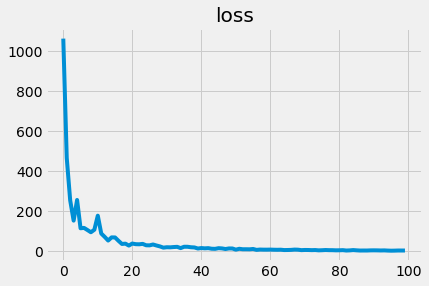

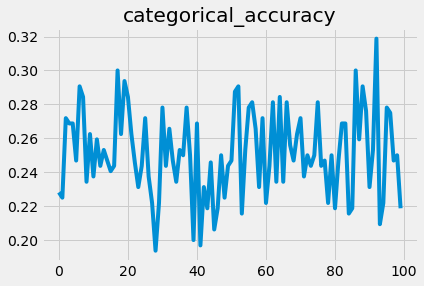

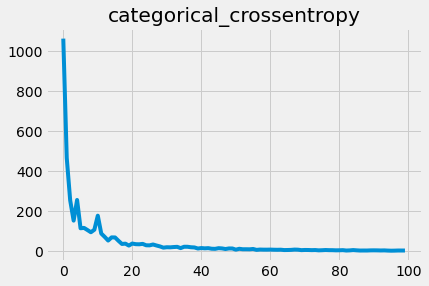

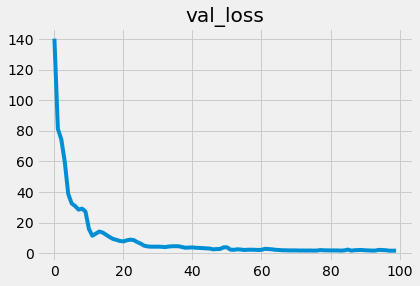

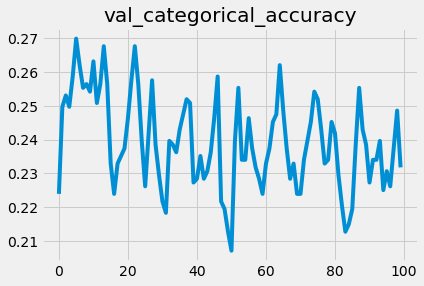

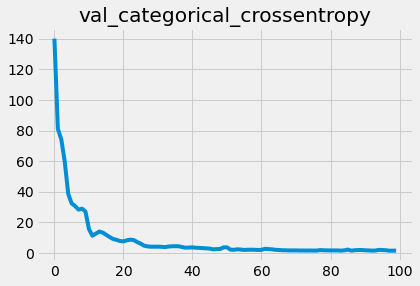

In [159]:
for k, hist in history_samp.history.items():
  plt.plot(hist)
  plt.title(k)
  plt.show()

In [107]:
data_t = test_ds.map(lambda d, l: d)

62/62 [==============================] - 0s 4ms/step
1968 events searched.
818 events correctly classified (1150 false), for an efficiency of 41.57%.
For absorption: 0.00% efficiency, 0.00% purity.
For charge_exchange: 0.00% efficiency, nan% purity.
For single_pion_production: 99.76% efficiency, 41.64% purity.
For multi_pion_production: 0.15% efficiency, 25.00% purity.



/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py:143: RuntimeWarning: invalid value encountered in scalar divide
  / np.sum(pred_index==i))


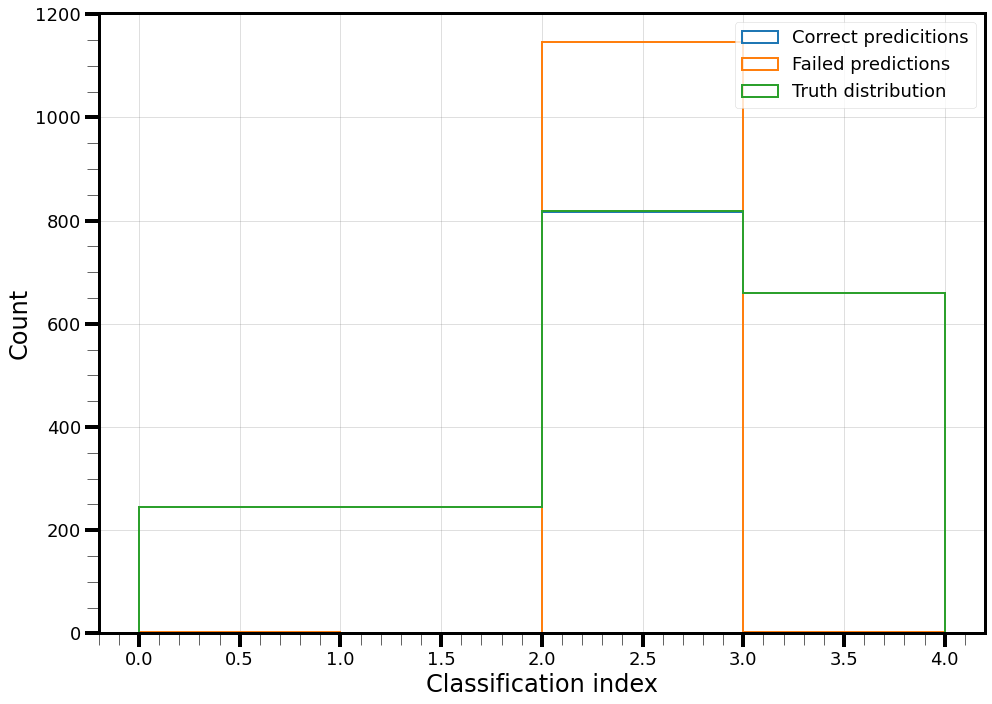

In [129]:
test_record = DataPreparation.load_record(data_params_sampled["schema_path"],
                                          data_params_sampled["test_path"])
test_data = test_record.map(lambda data, label : data)
test_data = test_data.batch(batch_size=32)
test_label = test_record.map(lambda data, label : label)
truth_index = Models.convert_labels_to_truth(test_label)
predictions = model_samp.predict(test_data, batch_size=32)
pred_index = np.where(
    predictions == np.max(predictions, axis=1)[:, np.newaxis])[1]
Models.create_summary_text(
    pred_index, truth_index,
    classification_labels=data_params_sampled["classifications"],
    print_results=True)
Models.plot_summary_information(pred_index, truth_index, plt_conf)

Cause: could not parse the source code of <function evaluate_model.<locals>.<lambda> at 0x7fdca65b9360>: no matching AST found among candidates:
# coding=utf-8
lambda data, label: data
# coding=utf-8
lambda data, label: label
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: could not parse the source code of <function evaluate_model.<locals>.<lambda> at 0x7fdca65b9360>: no matching AST found among candidates:
# coding=utf-8
lambda data, label: data
# coding=utf-8
lambda data, label: label
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: could not parse the source code of <function evaluate_model.<locals>.<lambda> at 0x7fdcf6234f70>: no matching AST found among candidates:
# coding=utf-8
lambda data, label: data
# coding=utf-8
lambda data, label: label
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Cause: could not parse the source code o

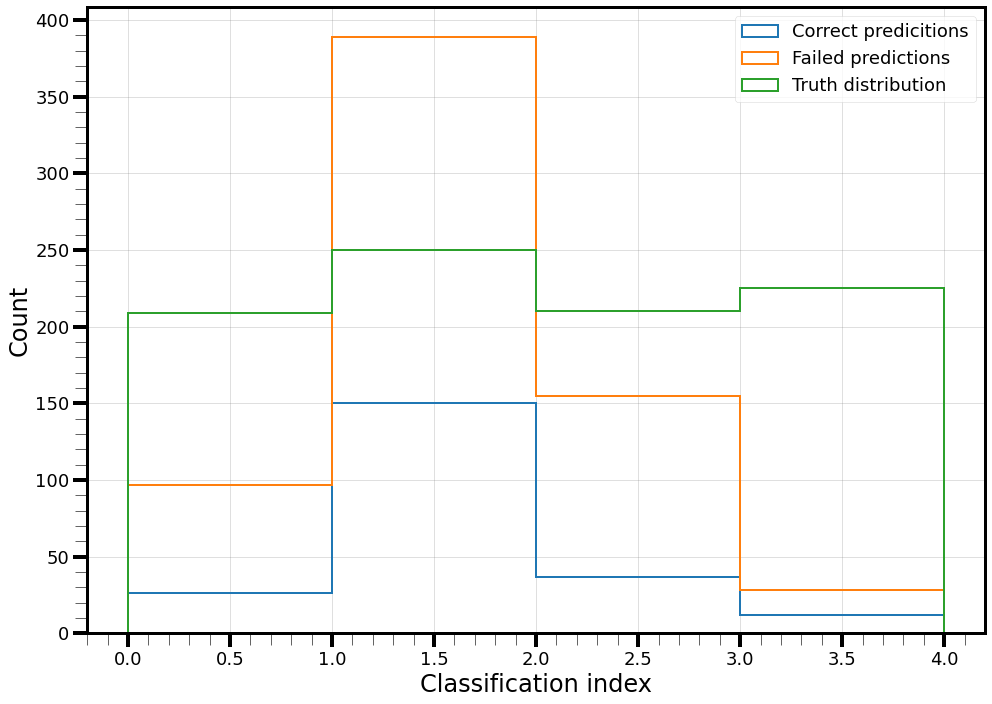

In [161]:
_ = Models.evaluate_model(
    model_samp,
    data_params_sampled["schema_path"],
    data_params_sampled["test_path"],
    classification_labels=data_params_sampled["classifications"], plot_config=plt_conf)

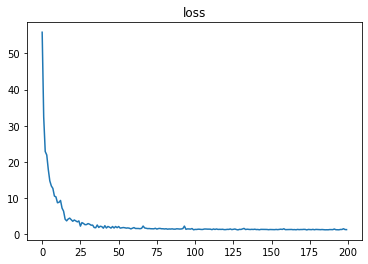

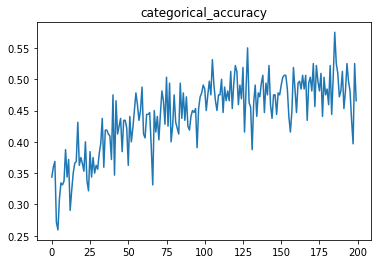

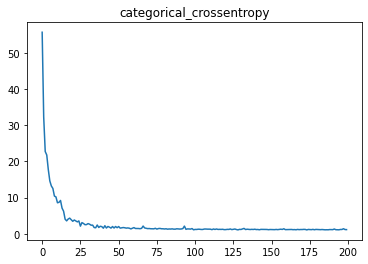

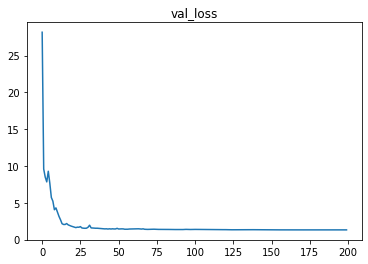

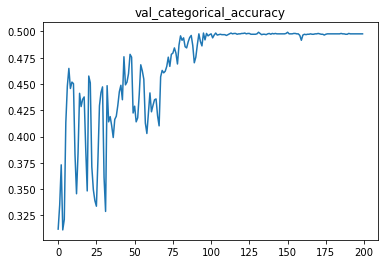

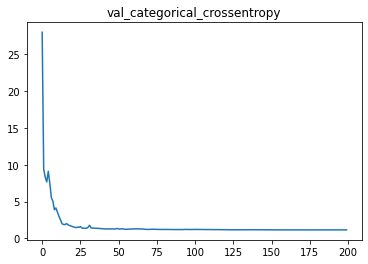

In [46]:
for k, hist in history_2.history.items():
  plt.plot(hist)
  plt.title(k)
  plt.show()

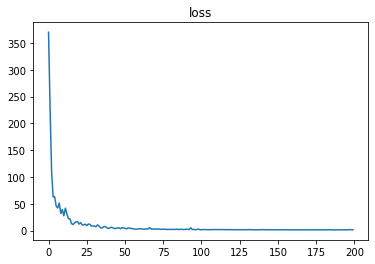

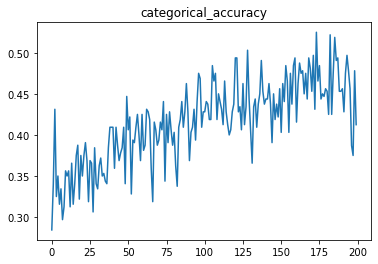

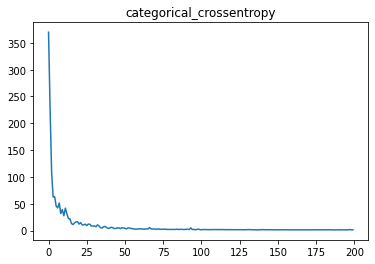

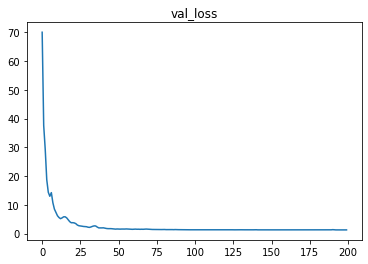

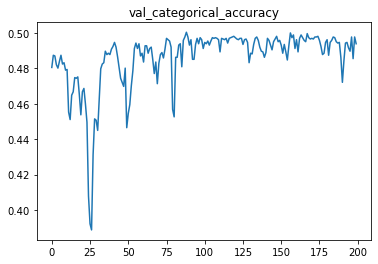

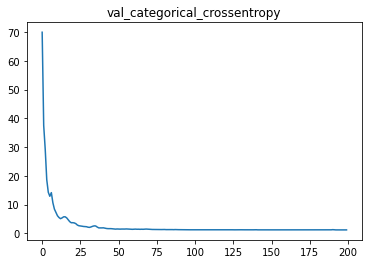

In [40]:
for k, hist in history.history.items():
  plt.plot(hist)
  plt.title(k)
  plt.show()

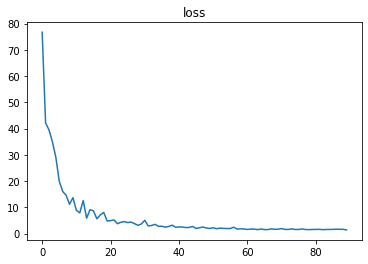

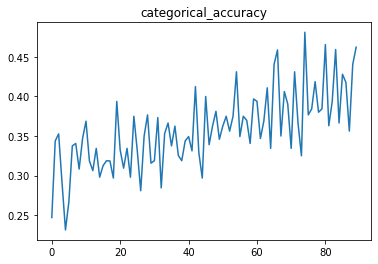

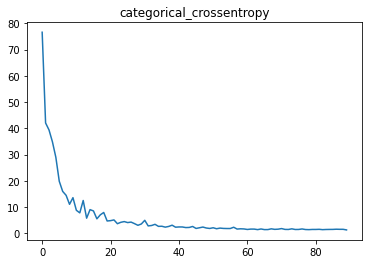

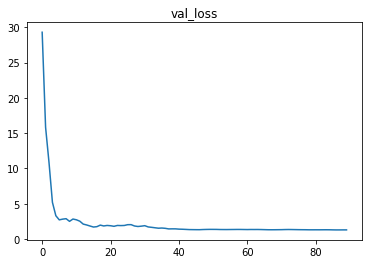

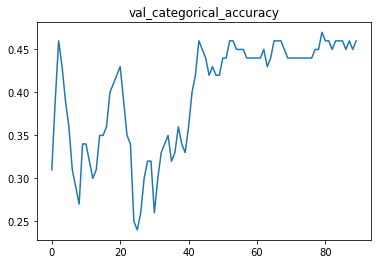

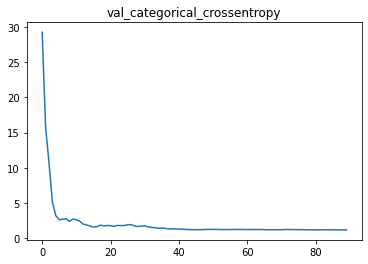

In [215]:
for k, hist in history.history.items():
  plt.plot(hist)
  plt.title(k)
  plt.show()

In [53]:
from python.gnn import Models

In [128]:
from importlib import reload
reload(Models)

<module 'python.gnn.Models' from '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/gnn/Models.py'>

In [60]:
truth_np = Models.convert_labels_to_truth(labs)
print(truth_np)

[2. 3. 3. ... 2. 3. 2.]


In [51]:
print(labs.take(1).get_single_element().shape)

(4,)


In [ ]:
test_data_batched = test_data.batch(batch_size=batch_size)
test_results = model.predict(test_data, batch_size=batch_size).numpy()

In [228]:
test_data = tf.data.TFRecordDataset(["/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_setup_3_tests.tfrecords"]).map(decode_fn_data_only)
test_truth = tf.data.TFRecordDataset(["/users/wx21978/projects/pion-phys/pi0-analysis/analysis/gnn-data/data_setup_3_tests.tfrecords"]).map(decode_fn_label_only)
test_data_batched = test_data.batch(batch_size=batch_size)
test_results = model.predict(test_data, batch_size=batch_size).numpy()

1000/1000 [==============================] - 1s 720us/step


In [248]:
prediction = np.where(test_results == np.max(test_results, axis=1)[:, np.newaxis])[1]
truth = np.where(test_truth.batch(1000).take(1).get_single_element() == 1)[1]

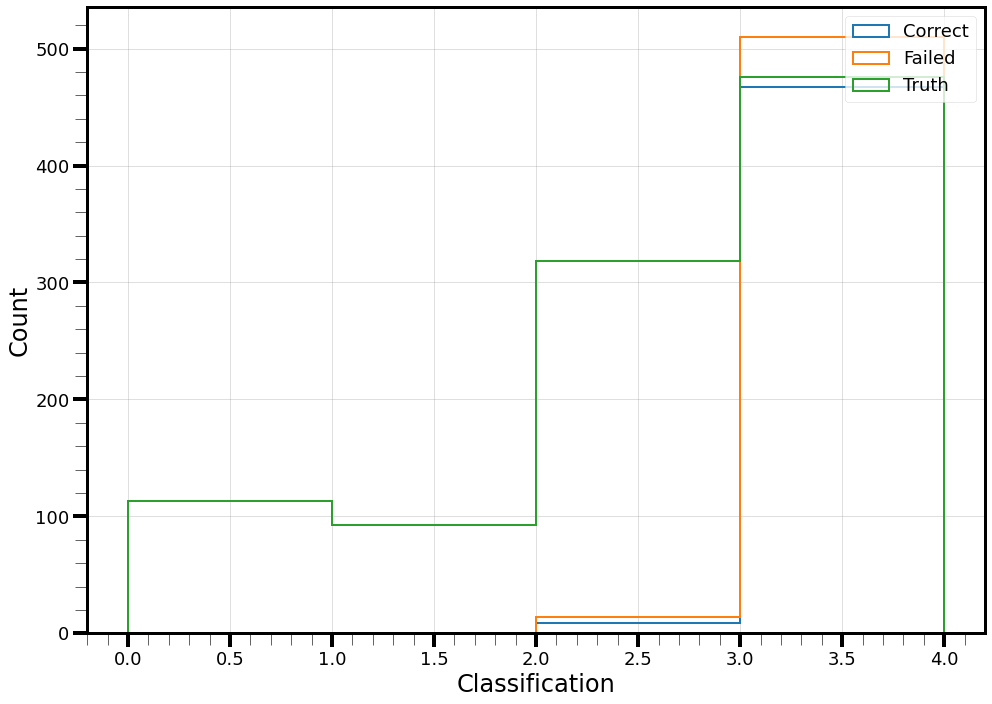

In [250]:
correct_mask = prediction == truth

plt_conf.setup_figure()
plt.hist(prediction[correct_mask],  **plt_conf.gen_kwargs(type="hist", label="Correct",  index=0, bins=np.arange(5), density=False))
plt.hist(prediction[np.logical_not(correct_mask)], **plt_conf.gen_kwargs(type="hist", label="Failed", index=1, bins=np.arange(5), density=False))
plt.hist(truth, **plt_conf.gen_kwargs(type="hist", label="Truth", index=2, bins=np.arange(5)))
plt_conf.format_axis(xlabel="Classification", ylabel="Count")
plt_conf.end_plot()



In [251]:
correct_mask = prediction == truth

summary_text  = f""
summary_text += f"{correct_mask.size} events searched.\n"
summary_text += f"{np.sum(correct_mask)} events correctly classified ({np.sum(np.logical_not(correct_mask))} false), for an efficiency of {100*np.sum(correct_mask)/correct_mask.size:.2f}%.\n"
for i in range(len(classifications)):
    summary_text += f"For {classifications[i]}: {100*np.sum(prediction[truth==i] == i)/np.sum(truth==i):.2f}% efficiency, {100*np.sum(truth[prediction==i] == i)/np.sum(prediction==i):.2f}% purity.\n"

print(summary_text)

1000 events searched.
476 events correctly classified (524 false), for an efficiency of 47.60%.
For absorption: 0.00% efficiency, nan% purity.
For charge_exchange: 0.00% efficiency, nan% purity.
For single_pion_production: 2.83% efficiency, 39.13% purity.
For multi_pion_production: 98.11% efficiency, 47.80% purity.



/tmp/ipykernel_1574763/3445263706.py:7: RuntimeWarning: invalid value encountered in scalar divide
  summary_text += f"For {classifications[i]}: {100*np.sum(prediction[truth==i] == i)/np.sum(truth==i):.2f}% efficiency, {100*np.sum(truth[prediction==i] == i)/np.sum(prediction==i):.2f}% purity.\n"


In [ ]:
def predict_one_event(event_index, model):
    graph = 0
    pass

# Non GNN code below

In [5]:
evts_data = Master.Data(conf_args.data_file, nTuple_type = conf_args.ntuple_type)
evts_data = apply_selection(evts_data, "data", "beam")
evts_data = apply_selection(evts_data, "data", "valid_pfo")

/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to filters.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to filename.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to nTuple_type.
  warnings.warn(f"Couldn't apply filters to {var}.")


            Name  Remaining events  Percentage of total events remaining  \
0   Initial data            256372                            100.000000   
1              -             61129                             23.843868   
2              -             52421                             20.447241   
3              -             47936                             18.697830   
4              -             36923                             14.402119   
5              -             35364                             13.794018   
6              -             33179                             12.941741   
7              -             24844                              9.690606   
8              -             24763                              9.659011   
9              -             23655                              9.226827   
10             -             18402                              7.177851   

    Relative percentage events  Remaining PFOs  \
0                   100.000000       

/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to filters.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to _TrueParticleDataBT__pdg.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to filename.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to nTuple_type.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to run.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/

            Name  Remaining events  Percentage of total events remaining  \
0   Initial data            256372                            100.000000   
1              -             61129                             23.843868   
2              -             52421                             20.447241   
3              -             47936                             18.697830   
4              -             36923                             14.402119   
5              -             35364                             13.794018   
6              -             33179                             12.941741   
7              -             24844                              9.690606   
8              -             24763                              9.659011   
9              -             23655                              9.226827   
10             -             18402                              7.177851   
11             -             18402                              7.177851   
12          

In [72]:
dQdxs = evts.recoParticles.track_dQdX
res_ranges = evts.recoParticles.residual_range
chi2_proton = evts.recoParticles.track_chi2_proton
chi2_proton_dof = evts.recoParticles.track_chi2_proton_ndof
chi2_pion = evts.recoParticles.track_chi2_pion
chi2_pion_dof = evts.recoParticles.track_chi2_pion_ndof
chi2_muon = evts.recoParticles.track_chi2_muon
chi2_muon_dof = evts.recoParticles.track_chi2_muon_ndof
lens = evts.recoParticles.track_len
lens_alt = evts.recoParticles.track_len_alt
verts_michel = evts.recoParticles.track_vertex_michel
verts_nhits = evts.recoParticles.track_vertex_nhits
dEdxs = evts.recoParticles.track_dEdX

In [100]:
def remove_unknown(prop):
    return prop[prop != -999.]

def make_good(prop1, prop2, lim1=10000, lim2=60):
    propsgood = np.logical_and(prop1 != -999., prop2 != -1)
    lim_good = np.logical_and(prop1 <= lim1, prop2 <= lim2)
    mask = np.logical_and(propsgood, lim_good)
    return prop1[mask], prop2[mask]

def plot_chi2s(mask):
    proton = ak.ravel(chi2_proton[mask])
    proton_dof = ak.ravel(chi2_proton_dof[mask])
    proton_good = proton_dof != -999.
    pion = ak.ravel(chi2_pion[mask])
    pion_dof = ak.ravel(chi2_pion_dof[mask])
    pion_good = pion_dof != -999.
    muon = ak.ravel(chi2_muon[mask])
    muon_dof = ak.ravel(chi2_muon_dof[mask])
    muon_good = muon_dof != -999.
    ver_michel = ak.ravel(verts_michel[mask])

    used_bins = plt_conf.get_bins(proton)
    plt_conf.setup_figure()
    plt.hist(proton, **plt_conf.gen_kwargs(type="hist", index=0, label="Proton fit", bins=used_bins))
    plt.hist(pion, **plt_conf.gen_kwargs(type="hist", index=1, label="Pion fit", bins=used_bins))
    plt.hist(muon, **plt_conf.gen_kwargs(type="hist", index=2, label="Muon fit", bins=used_bins))
    plt_conf.format_axis(xlabel="Chi2 fit", ylabel="Count")
    plt_conf.end_plot()

    plt_conf.setup_figure()
    # plt.hist2d(proton[proton_good], proton_dof[proton_good], bins=60)
    plt.hist2d(*make_good(proton, proton_dof), bins=60)
    plt_conf.format_axis(xlabel="Proton chi2", ylabel="Chi2 n.d.o.f.", xlim=(0, 10000))
    plt.colorbar()
    plt_conf.end_plot()

    plt_conf.setup_figure()
    # plt.hist2d(pion[pion_good], pion_dof[pion_good], bins=60)
    plt.hist2d(*make_good(pion, pion_dof), bins=60)
    plt_conf.format_axis(xlabel="Pion chi2", ylabel="Chi2 n.d.o.f.", xlim=(0, 10000))
    plt.colorbar()
    plt_conf.end_plot()

    plt_conf.setup_figure()
    # plt.hist2d(muon[muon_good], muon_dof[muon_good], bins=60)
    plt.hist2d(*make_good(muon, muon_dof), bins=60)
    plt_conf.format_axis(xlabel="Muon chi2", ylabel="Chi2 n.d.o.f.", xlim=(0, 10000))
    plt.colorbar()
    plt_conf.end_plot()

    plt_conf.setup_figure()
    plt.hist(remove_unknown(ver_michel), **plt_conf.gen_kwargs(type="hist", index=0, bins=plt_conf.get_bins(ver_michel)))
    plt_conf.format_axis(xlabel="Vertex micehl score", ylabel="Count")
    plt_conf.end_plot()
    return


def plot_props(mask):
    maxdEdx = 6
    maxres = 300
    flat_res = ak.ravel(res_ranges[mask])
    flat_dEdx = ak.ravel(dEdxs[mask])
    comb_mask = np.logical_and(flat_res < maxres, flat_dEdx < maxdEdx)
    plt_res = flat_res[comb_mask]
    plt_dEdx = flat_dEdx[comb_mask]
    plt_dQdx = ak.ravel(dQdxs[mask])[comb_mask]
    
    plt_conf.setup_figure()
    plt.hist2d(plt_res, plt_dEdx, bins=60)
    plt_conf.format_axis(xlabel="Residual range", ylabel="dEdX")
    plt.colorbar()
    plt_conf.end_plot()

    plt_conf.setup_figure()
    plt.hist2d(plt_res, plt_dQdx, bins=60)
    plt_conf.format_axis(xlabel="Residual range", ylabel="dQdX")
    plt.colorbar()
    plt_conf.end_plot()
    return

In [ ]:
# hist, x_bin, y_bin = np.histogram2d(ak.ravel(res_ranges[piplus_mask]), ak.ravel(dEdxs[piplus_mask]))

# hist_1d = hist.flatten()
# x_bin_1d = np.repeat(x_bin[:-1, np.newaxis], len(y_bin)-1, axis=1).flatten()
# y_bin_1d = np.repeat(y_bin[np.newaxis, :-1], len(x_bin)-1, axis=0).flatten()
piplus_mask = evts.trueParticlesBT.pdg == 211
# maxdEdx = 6
# maxres = 300
# flat_res = ak.ravel(res_ranges[piplus_mask])
# flat_dEdx = ak.ravel(dEdxs[piplus_mask])
# comb_mask = np.logical_and(flat_res < maxres, flat_dEdx < maxdEdx)
# plt_res = flat_res[comb_mask]
# plt_dEdx = flat_dEdx[comb_mask]
# plt_dQdx = ak.ravel(dQdxs[piplus_mask])

# plt_conf.setup_figure()
# # plt.hist2d(x_bin_1d, y_bin_1d, bins=[x_bin, y_bin], weights=hist_1d)
# plt.hist2d(plt_res, plt_dEdx, bins=60)
# plt_conf.format_axis(xlabel="Residual range", ylabel="dEdX")
# plt.colorbar()
# plt_conf.end_plot()
plot_props(piplus_mask)
plot_chi2s(piplus_mask)

In [ ]:
muon_mask = evts.trueParticlesBT.pdg == 13
plot_props(muon_mask)
plot_chi2s(muon_mask)

In [ ]:
proton_mask = evts.trueParticlesBT.pdg == 2212
plot_props(proton_mask)
plot_chi2s(proton_mask)

In [67]:
evts.io.ListNTuples()

[
    'run',
    'subrun',
    'event',
    'MC',
    'reco_reconstructable_beam_event',
    'reco_beam_type',
    'reco_beam_startX',
    'reco_beam_startY',
    'reco_beam_startZ',
    'reco_beam_endX',
    'reco_beam_endY',
    'reco_beam_endZ',
    'true_beam_len',
    'reco_beam_len',
    'test_branch',
    'reco_beam_alt_len',
    'for_truncation_method',
    'reco_beam_alt_len_allTrack',
    'reco_beam_calo_startX',
    'reco_beam_calo_startY',
    'reco_beam_calo_startZ',
    'reco_beam_calo_endX',
    'reco_beam_calo_endY',
    'reco_beam_calo_endZ',
    'reco_beam_calo_startX_allTrack',
    'reco_beam_calo_startY_allTrack',
    'reco_beam_calo_startZ_allTrack',
    'reco_beam_calo_endX_allTrack',
    'reco_beam_calo_endY_allTrack',
    'reco_beam_calo_endZ_allTrack',
    'reco_beam_calo_startDirX',
    'reco_beam_calo_startDirY',
    'reco_beam_calo_startDirZ',
    'reco_beam_calo_endDirX',
    'reco_beam_calo_endDirY',
    'reco_beam_calo_endDirZ',
    'reco_beam_trackDirX',
    'reco_beam_trackDirY',
    'reco_beam_trackDirZ',
    'reco_beam_trackEndDirX',
    'reco_beam_trackEndDirY',
    'reco_beam_trackEndDirZ',
    'reco_beam_vertex_nHits',
    'reco_beam_vertex_michel_score',
    'reco_beam_vertex_nHits_allTrack',
    'reco_beam_vertex_michel_score_allTrack',
    'reco_beam_vertex_michel_score_weight_by_charge',
    'reco_beam_vertex_michel_score_weight_by_charge_allTrack',
    'reco_beam_trackID',
    'n_beam_slices',
    'n_beam_particles',
    'beam_track_IDs',
    'beam_particle_scores',
    'reco_beam_dQdX_SCE',
    'reco_beam_EField_SCE',
    'reco_beam_calo_X',
    'reco_beam_calo_Y',
    'reco_beam_calo_Z',
    'reco_beam_calo_X_allTrack',
    'reco_beam_calo_Y_allTrack',
    'reco_beam_calo_Z_allTrack',
    'reco_beam_dQ',
    'reco_beam_dEdX_SCE',
    'reco_beam_calibrated_dEdX_SCE',
    'reco_beam_calibrated_dQdX_SCE',
    'reco_beam_resRange_SCE',
    'reco_beam_TrkPitch_SCE',
    'reco_beam_TrkPitch_SCE_allTrack',
    'reco_beam_dQdX_NoSCE',
    'reco_beam_dQ_NoSCE',
    'reco_beam_dEdX_NoSCE',
    'reco_beam_calibrated_dEdX_NoSCE',
    'reco_beam_resRange_NoSCE',
    'reco_beam_TrkPitch_NoSCE',
    'reco_beam_calo_wire',
    'reco_beam_calo_wire_allTrack',
    'reco_beam_calo_wire_z',
    'reco_beam_calo_wire_NoSCE',
    'reco_beam_calo_wire_z_NoSCE',
    'reco_beam_calo_tick',
    'reco_beam_calo_TPC',
    'reco_beam_calo_TPC_NoSCE',
    'reco_beam_flipped',
    'reco_beam_passes_beam_cuts',
    'reco_beam_PFP_ID',
    'reco_beam_PFP_nHits',
    'reco_beam_PFP_trackScore',
    'reco_beam_PFP_emScore',
    'reco_beam_PFP_michelScore',
    'reco_beam_PFP_trackScore_collection',
    'reco_beam_PFP_emScore_collection',
    'reco_beam_PFP_michelScore_collection',
    'reco_beam_PFP_trackScore_weight_by_charge',
    'reco_beam_PFP_emScore_weight_by_charge',
    'reco_beam_PFP_michelScore_weight_by_charge',
    'reco_beam_PFP_trackScore_collection_weight_by_charge',
    'reco_beam_PFP_emScore_collection_weight_by_charge',
    'reco_beam_PFP_michelScore_collection_weight_by_charge',
    'reco_beam_allTrack_ID',
    'reco_beam_allTrack_beam_cuts',
    'reco_beam_allTrack_flipped',
    'reco_beam_allTrack_len',
    'reco_beam_allTrack_startX',
    'reco_beam_allTrack_startY',
    'reco_beam_allTrack_startZ',
    'reco_beam_allTrack_endX',
    'reco_beam_allTrack_endY',
    'reco_beam_allTrack_endZ',
    'reco_beam_allTrack_trackDirX',
    'reco_beam_allTrack_trackDirY',
    'reco_beam_allTrack_trackDirZ',
    'reco_beam_allTrack_trackEndDirX',
    'reco_beam_allTrack_trackEndDirY',
    'reco_beam_allTrack_trackEndDirZ',
    'reco_beam_allTrack_resRange',
    'reco_beam_allTrack_calibrated_dEdX',
    'reco_beam_allTrack_Chi2_proton',
    'reco_beam_allTrack_Chi2_ndof',
    'reco_track_startX',
    'reco_track_startY',
    'reco_track_startZ',
    'reco_track_endX',
    'reco_track_endY',
    'reco_track_endZ',
    'reco_track_michel_score',
    'reco_track_michel_score_weight_by_charge',
    'reco_track_ID

In [3]:
"""Functions for generating metrics"""

def gen_cut(limit):
    if isinstance(limit, tuple):
        def cut(param):
            return np.logical_and(param > limit[0], param < limit[1])
    else:
        def cut(param):
            return np.abs(param) < limit
    return cut

def cut_metric_generator(mass_cuts=None, momentum_cuts=None, energy_cuts=None, approach_cuts=None, separation_cuts=None, impact_cuts=None, angle_cuts=None):
    cuts_dict = {}
    if mass_cuts is not None:
        cuts_dict.update({"mass":gen_cut(mass_cuts)})
    if momentum_cuts is not None:
        cuts_dict.update({"momentum":gen_cut(momentum_cuts)})
    if energy_cuts is not None:
        cuts_dict.update({"energy":gen_cut(energy_cuts)})
    if approach_cuts is not None:
        cuts_dict.update({"approach":gen_cut(approach_cuts)})
    if separation_cuts is not None:
        cuts_dict.update({"separation":gen_cut(separation_cuts)})
    if impact_cuts is not None:
        cuts_dict.update({"impact":gen_cut(impact_cuts)})
    if angle_cuts is not None:
        cuts_dict.update({"angle":gen_cut(angle_cuts)})


    def cuts_metric(**params_dict):
        passing_pairs = []
        for param in list(cuts_dict.keys()):
            if params_dict[param] is not None:
                passing_pairs += [ cuts_dict[param]( params_dict[param] ) ]
        
        # If no cuts specified, return 1s
        if len(passing_pairs) == 0:
            return ak.ones_like(params_dict["mass"])
        
        # Return 1s for values passing the cut(s), 0s for others
        elif len(passing_pairs) == 1:
            return ak.values_astype(passing_pairs[0], float)
        else:
            current_passing = passing_pairs[0]
            for i in range(1, len(passing_pairs)):
                current_passing = np.logical_and(current_passing, passing_pairs[i])
            return ak.values_astype(current_passing, float)            


    def cut_argument_handler(mass, momentum, energy, approach, separation, impact, angle):
        return cuts_metric(mass=mass, momentum=momentum, energy=energy, approach=approach, separation=separation, impact=impact, angle=angle)
    
    return cut_argument_handler

In [4]:
"""Functions for analysing results (mostly supplanted by classes)"""

def plot_rank_hist_nb(
        prop_name, ranking,
        path="/users/wx21978/projects/pion-phys/plots/photon_pairs/", unique_save_id = "",
        y_scaling = 'log', bins = None, **kwargs
    ):

    if path[-1] != '/':
        path += '/'

    if not isinstance(y_scaling, list):
        y_scaling = [y_scaling]
    if bins is None:
        # bins = int(np.max(ranking) - 1)
        bins = 2*int(np.max(ranking)) + 1

    for y_scale in y_scaling:
        plt.figure(figsize=(12,9))
        plt.hist(ak.max(ranking, axis=-1), label="signal", bins=bins,  **kwargs)
        plt.legend()
        plt.yscale(y_scale)
        plt.xlabel(prop_name.title() + " ranking")
        plt.ylabel("Count")
        plt.show()
        # plt.savefig(path + "ranking_" + prop_name.replace(" ", "_") + unique_save_id + ".png")
        # plt.close()
    
    return

def get_efficiency_fpr_stats(passing_pairs, sig_count, print_results=False):
    num_events = ak.num(passing_pairs, axis=0)

    false_0_counts = ak.sum( ak.values_astype(passing_pairs[ sig_count == 0 ], int) )
    false_1_counts = ak.sum( ak.values_astype(passing_pairs[ sig_count == 1 ], int) )

    true_sig_count_per_event = ak.sum( ak.values_astype(passing_pairs[ sig_count == 2 ], int), axis=1 )
    true_pi0_events_found = ak.sum( ak.values_astype(true_sig_count_per_event > 0, int) )
    excess_pi0_events_found = ak.sum( np.maximum(true_sig_count_per_event - 1, 0) )
    
    truth_pi0_event_count = ak.sum( ak.values_astype(ak.sum( ak.values_astype(sig_count == 2, int), axis=1 ) > 0, int) )

    if print_results:
        print(f"{num_events} searched with {truth_pi0_event_count} events containing pi0s.")
        print(f"{false_0_counts} false triggers on pairs with no pi0 photons and {false_1_counts} false triggers on pairs with 1 pi0 photon")
        print(f"for a total of {false_0_counts + false_1_counts} false triggers, at an average rate of {(false_0_counts + false_1_counts)/num_events:.2f} false triggers per event.")
        print(f"{true_pi0_events_found} events with true pi0 triggering found, for an efficiency of {100*true_pi0_events_found/truth_pi0_event_count:.2f}%.")
        print(f"{excess_pi0_events_found} excess truth events were found for and average of {excess_pi0_events_found/truth_pi0_event_count:.2f} excess events per truth pi0 trigger.")
    
    return true_pi0_events_found/truth_pi0_event_count, (false_0_counts+false_1_counts)/num_events

In [5]:
class SimpleCutSelector():
    def __init__(self, **cuts):
        self.known_properties = [key for key in cuts.keys()]
        
        self.applied_cuts = cuts

        self.cuts_dict = {}

        for i, cut in enumerate(cuts.values()):
            self._gen_cut(cut, self.known_properties[i])
        return

    def __call__(self, *args, **kwargs):
        if len(args) == 1 and isinstance(args[0], dict):
            return self.metric(*args)
        elif len(args) == len(self.known_properties):
            return self.explicit_args(*args)
        elif len(args) != 0:
            raise TypeError(f"{self.__name__}() takes 1 or {len(self.known_properties)} positional arguments")
        else:
            for prop in kwargs.keys():
                if prop not in self.known_properties:
                    raise TypeError(f"{self.__name__}() got an unexpected keyword argument '{prop}'")
            return self.explicit_args(**kwargs)

    def _gen_cut(self, limit, prop_name):
        if limit is None:
            return
        elif isinstance(limit, tuple):
            if len(limit) == 2:
                def cut(prop):
                    return np.logical_and(prop > limit[0], prop < limit[1])
            else:
                def cut(prop):
                    return prop > limit[0]
        else:
            def cut(prop):
                return np.abs(prop) < limit
        self.cuts_dict.update({prop_name:cut})
        return

    def explicit_args(self, **args):
        props_dict = {}
        for i, prop in enumerate(args.values()):
            props_dict.update({self.known_properties[i]:prop})
        return self.metric(props_dict)

    def metric(self, properties_dict):
        passing_pairs = []
        for prop in self.cuts_dict.keys():
            if properties_dict[prop] is not None:
                passing_pairs += [ self.cuts_dict[prop]( properties_dict[prop] ) ]

        # If no cuts specified, return 1s
        if len(passing_pairs) == 0:
            return ak.ones_like(properties_dict[self.known_properties[0]])
        
        # Return 1s for values passing the cut(s), 0s for others
        elif len(passing_pairs) == 1:
            return ak.values_astype(passing_pairs[0], float)
        else:
            current_passing = passing_pairs[0]
            for i in range(1, len(passing_pairs)):
                current_passing = np.logical_and(current_passing, passing_pairs[i])
            return ak.values_astype(current_passing, float) 


class SelectorEvaluator():
    """
    Class to store properties and cuts an generate
    plots indicating cut performance.

    ...
    
    Attributes
    ----------
    properties : dict {str: ak.Array}
        A dictionary containing the properties which
        may be cut on, with an label.
    prop_labels : list
        The list of keys of the `properties` dictionary.
    truth_mask : ak.Array
        A mask which is true for "signal" PFOs, and
        False for backgrounds
    pfo_name : str
        Name of the signal type PFOs to appear in text.
    metrics : dict {str: function}
        A dictionary containing cuts which to select
        signal PFOs.
    
    INCOMPLETE

    Methods
    -------
    get_metric_values
        Returns the values of PFOs under a specified metric.
    get_threshold
        Returns to cut threshold used by a specified metric.
    get_passing
        Returns an boolean mask of PFOs which exceed a
        threshold under a specified metric.
    
    
    """
    def __init__(self, truth, props_dict, pfo_name="signal"):
        """
        Creates a SelectorEvaluator instance.

        Parameters
        ----------
        truth : ak.Array
            Boolean array containing True for signal type PFOs
        props_dict : dict {str: ak.Array}
            Dictionary containing a property label, with an
            array holding the values of that property for each
            PFO.
        """
        self.properties = props_dict
        self.prop_labels = [key for key in self.properties.keys()]
        self.truth_mask = truth

        self.pfo_name = pfo_name

        self.metrics = {}
        self.thresholds = {}
        self.rankings = {}

        self.default_threshold = 0.5

        self.plt_cfg = Plots.PlotConfig()
        self.plt_cfg.BEST_BINS_MULTIPLIER = 2
        self.plt_cfg.SHOW_PLOT = True
        self.plt_cfg.SAVE_FOLDER = None
        self.plotting_style = "density_rejected"

        return
    
    def add_metric(self, name, function, threshold=None):
        """
        Adds the metric generation `function` stored as `name`.

        The function recieves a dictionary containing the
        properties specified as `props_dict` in `__init__`.
        """
        self.metrics.update({name:function})

        if threshold is None:
            threshold = self.default_threshold
        self.thresholds.update({name:threshold})
        return
    
    def add_selector_metric(self, name, **cuts):
        """
        Adds a selector called `name` with the supplied cuts.

        Each supplied cut must be of the form:
        `{property: cut}`
        With `property` being a string indexing an item in
        `self.properties`, and `cut` being one of the following:
            None            : no cut applied
            number          : require `property < number`
            (number)        : require `property > number`
            (num1, num2)    : require `num1 < property < num2`
        """
        full_cuts = {p : None for p in self.prop_labels}
        full_cuts.update(cuts)
        self.metrics.update({name:SimpleCutSelector(**full_cuts)})

        self.thresholds.update({name:0.5})
        return

    def get_metric_values(self, metric):
        """
        Return an array values under a specfied metric that
        each PFO has.
        
        Parameters
        ----------
        metric : str or function
            Either a string indexing the metric to use (in
            `self.metrics`), or a function containing the
            metric calculation.

        Returns
        -------
        ak.Array
            Array containing the values of each PFO under
            the specified metric.
        """
        if isinstance(metric, str):
            return self.metrics[metric](self.properties)
        return metric(self.properties)

    def get_threshold(self, metric):
        """
        Get the threshold using in a given metric cut
        
        Parameters
        ----------
        metric : str
            Metric for which to get the threshold

        Returns
        -------
        float
            Threshold applied by the metric. If not specified,
            this will be `self.default_threshold`.
        """
        if isinstance(metric, str):
            return self.thresholds[metric]
        return self.default_threshold

    def get_passing(self, metric, threshold=None):
        """
        Creates a boolean mask indicating which PFOs
        pass the specified metric.
        Parameters
        ----------
        metric : str
            Name of the metric as stored in the
            `self.metrics` dictionary.
        threshold : float, optional
            Threshold that must be exceeded by the metric
            for a PFO to pass. If unspecified, the threshold
            assiciated with the metric is used.

        Returns
        -------
        ak.Array
            Boolean mask of PFOs whose metric values
            exceed the metric's threshold.
        """
        if threshold is None:
            threshold = self.get_threshold(metric)
        return self.get_metric_values(metric) > threshold

    def wrap_metric_arguments(self, metric_func, kwarg_metrics=False):
        if kwarg_metrics:
            def dict_metric(parameters):
                return metric_func(**parameters)
        else:
            def dict_metric(parameters):
                return metric_func(parameters[prop] for prop in self.prop_labels)
        return dict_metric
    
    def get_selection_stats(self, metric_name, threshold=None, return_text=False, print_text=False):
        passing_pfos = self.get_passing(metric_name, threshold=threshold)

        num_events = ak.num(passing_pfos, axis=0)

        false_counts = ak.sum( ak.values_astype(passing_pfos[ np.logical_not(self.truth_mask) ], int) )

        true_sig_count_per_event = ak.sum( ak.values_astype(passing_pfos[ self.truth_mask ], int), axis=1 )
        true_events_found = ak.sum( ak.values_astype(true_sig_count_per_event > 0, int) )
        excess_events_found = ak.sum( np.maximum(true_sig_count_per_event - 1, 0) )
        
        truth_event_count = ak.sum( ak.values_astype(ak.sum( ak.values_astype(self.truth_mask, int), axis=1 ) > 0, int) )

        if print_text or return_text:
            summary_text = f""
            summary_text += f"{num_events} searched with {true_events_found} events containing {self.pfo_name}s.\n"
            summary_text += f"{false_counts} false triggers on non {self.pfo_name} PFOs, leading to an average \n"
            summary_text += f" rate of {(false_counts)/num_events:.2f} false triggers per event.\n"
            summary_text += f"{true_events_found} events with true pi0 triggering found, for an efficiency of {100*true_events_found/truth_event_count:.2f}%.\n"
            summary_text += f"{excess_events_found} excess truth events were found for and average of {excess_events_found/truth_event_count:.2f}\n"
            summary_text += f"excess events per truth pi0 trigger."
        if print_text:
            print(summary_text)
        if return_text:
            return summary_text

        return true_events_found/truth_event_count, false_counts/num_events

    def plot_metric_distribution(
        self,
        metric_name,
        y_scaling="linear",
        override=None,
        equal_bins=True,
        ax=None,
        **kwargs 
    ):
        if override == "display":
            y_scaling = "linear"
            equal_bins = True
            kwargs.update({"density":True})

        values = self.get_metric_values(metric_name)

        signal = ak.ravel(values[self.truth_mask])
        background = ak.ravel(values[np.logical_not(self.truth_mask)])

        bins_gen = self.check_equal_binning(equal_bins, signal)
        
        if ax is None:
            self.plt_cfg.setup_figure()
            plt.hist(signal, **self.plt_cfg.gen_kwargs(type="hist", label="Signal",  index=0, bins=bins_gen(signal), **kwargs))
            plt.hist(background,  **self.plt_cfg.gen_kwargs(type="hist", label="Background",  index=1, bins=bins_gen(background), **kwargs))
        else:
            ax.hist(signal, **self.plt_cfg.gen_kwargs(type="hist", label="Signal",  index=0, bins=bins_gen(signal), **kwargs))
            ax.hist(background,  **self.plt_cfg.gen_kwargs(type="hist", label="Background",  index=1, bins=bins_gen(background), **kwargs))
        if isinstance(metric_name, str):
            title = metric_name.title()
        else:
            title = "Metric"
        self.plt_cfg.format_axis(ax, xlabel=title, ylabel="Count", ylog=y_scaling=='log')
        if ax is None:
            self.plt_cfg.end_plot()
        else:
            ax.legend()
        
        return

    def plot_param_distributions(
        self,
        metric_name,
        property,
        y_scaling="linear",
        quartile=100,
        equal_bins=True,
        plot_rejected=False,
        ax=None,
        override=None,
        threshold=None,
        **kwargs 
    ):
        if override == "display":
            quartile = 95
            y_scaling = "log"
            equal_bins = True
            plot_rejected = False
            kwargs.update({"density":True})

        passing_events = self.get_passing(metric_name, threshold=threshold)

        passing_sig  = np.logical_and(self.truth_mask, passing_events)
        passing_bkg  = np.logical_and( np.logical_not(self.truth_mask), passing_events)

        prop = self.properties[property]

        passing_sig  = ak.ravel(prop[passing_sig])
        passing_bkg  = ak.ravel(prop[passing_bkg])

        if plot_rejected:
            rejected_sig = np.logical_and(self.truth_mask, np.logical_not(passing_events))
            rejected_bkg = np.logical_not( np.logical_or(self.truth_mask, passing_events) )
        
            rejected_sig = ak.ravel(prop[rejected_sig])
            rejected_bkg = ak.ravel(prop[rejected_bkg])
        
        bins_gen = self.check_equal_binning(equal_bins, passing_sig)

        format_ax_kwargs = {}
        if quartile != 100:
            passing_count = len(passing_sig) - 1
            passing_sig = np.sort(passing_sig)

            if min(passing_sig) < 0:
                quartile_range = (passing_sig[int(np.round(passing_count * (100 - quartile)/200))], passing_sig[int(np.round(passing_count * (100 + quartile)/200)) + 1])
            else:
                quartile_range = (0, passing_sig[int(np.round(passing_count * quartile/100)) + 1])
            
            kwargs.update({"range":quartile_range})
            format_ax_kwargs.update({"xlim":tuple(map(lambda x: x*1.08, quartile_range))})

            def apply_lims(data):
                return data[np.logical_and(data >= quartile_range[0], data < quartile_range[1])]
            
            passing_sig = apply_lims(passing_sig)
            passing_bkg = apply_lims(passing_bkg)
            if plot_rejected:
                rejected_sig = apply_lims(rejected_sig)
                rejected_bkg = apply_lims(rejected_bkg)

        if ax is None:
            self.plt_cfg.setup_figure()
            plt.hist(passing_sig,  **self.plt_cfg.gen_kwargs(type="hist", label="Passing sig",  index=0, bins=bins_gen(passing_sig), **kwargs))
            plt.hist(passing_bkg,  **self.plt_cfg.gen_kwargs(type="hist", label="Passing bkg",  index=1, bins=bins_gen(passing_bkg), **kwargs))
            if plot_rejected:
                plt.hist(rejected_sig, **self.plt_cfg.gen_kwargs(type="hist", label="Rejected sig", index=2, ls='--', bins=bins_gen(rejected_sig), **kwargs))
                plt.hist(rejected_bkg, **self.plt_cfg.gen_kwargs(type="hist", label="Rejected bkg", index=3, ls='--', bins=bins_gen(rejected_bkg), **kwargs))
        else:
            ax.hist(passing_sig,  **self.plt_cfg.gen_kwargs(type="hist", label="Passing sig",  index=0, bins=bins_gen(passing_sig), **kwargs))
            ax.hist(passing_bkg,  **self.plt_cfg.gen_kwargs(type="hist", label="Passing bkg",  index=1, bins=bins_gen(passing_bkg), **kwargs))
            if plot_rejected:
                ax.hist(rejected_sig, **self.plt_cfg.gen_kwargs(type="hist", label="Rejected sig", index=2, ls='--', bins=bins_gen(rejected_sig), **kwargs))
                ax.hist(rejected_bkg, **self.plt_cfg.gen_kwargs(type="hist", label="Rejected bkg", index=3, ls='--', bins=bins_gen(rejected_bkg), **kwargs))
        self.plt_cfg.format_axis(ax, xlabel=property.title(), ylabel="Count", ylog=y_scaling=='log', **format_ax_kwargs)
        if ax is None:
            self.plt_cfg.end_plot()
        else:
            ax.legend()
        
        return
    
    def plot_selection_comparison(
        self,
        metric_name_pre,
        metric_name_post,
        selection_text="",
        y_scaling='linear',
        override=None,
        equal_bins=False,
        ax=None,
        threshold_pre=None,
        threshold_post=None,
        **kwargs
    ):
        if override == "display":
            y_scaling = "log"
            equal_bins = True

        passing_events_pre = self.get_passing(metric_name_pre, threshold=threshold_pre)
        passing_events_post = self.get_passing(metric_name_post, threshold=threshold_post)

        passing_sig_pre   = np.logical_and(self.truth_mask, passing_events_pre)
        passing_bkg_pre   = np.logical_and(np.logical_not(self.truth_mask), passing_events_pre)
        passing_sig_post  = np.logical_and(self.truth_mask, passing_events_post)
        passing_bkg_post  = np.logical_and(np.logical_not(self.truth_mask), passing_events_post)

        data_pre  = self.get_metric_values(metric_name_pre)
        data_post = self.get_metric_values(metric_name_post)

        passing_sig_pre   = ak.ravel(data_pre[passing_sig_pre])
        passing_bkg_pre   = ak.ravel(data_pre[passing_bkg_pre])
        passing_sig_post  = ak.ravel(data_post[passing_sig_post])
        passing_bkg_post  = ak.ravel(data_post[passing_bkg_post])

        bins_gen = self.check_equal_binning(equal_bins, passing_sig_pre)
        

        if ax is None:
            self.plt_cfg.setup_figure()
            plt.hist(passing_sig_pre,  **self.plt_cfg.gen_kwargs(type="hist", label="Sig pre "+selection_text,  index=0, bins=bins_gen(passing_sig_pre), **kwargs))
            plt.hist(passing_sig_post, **self.plt_cfg.gen_kwargs(type="hist", label="Sig post "+selection_text, index=1, bins=bins_gen(passing_sig_post), **kwargs))
            plt.hist(passing_bkg_pre,  **self.plt_cfg.gen_kwargs(type="hist", label="Bkg pre "+selection_text,  index=2, ls='--', bins=bins_gen(passing_bkg_pre), **kwargs))
            plt.hist(passing_bkg_post, **self.plt_cfg.gen_kwargs(type="hist", label="Bkg post "+selection_text, index=3, ls='--', bins=bins_gen(passing_bkg_post), **kwargs))
        else:
            ax.hist(passing_sig_pre,  **self.plt_cfg.gen_kwargs(type="hist", label="Sig pre "+selection_text,  index=0, bins=bins_gen(passing_sig_pre), **kwargs))
            ax.hist(passing_sig_post, **self.plt_cfg.gen_kwargs(type="hist", label="Sig post "+selection_text, index=1, bins=bins_gen(passing_sig_post), **kwargs))
            ax.hist(passing_bkg_pre,  **self.plt_cfg.gen_kwargs(type="hist", label="Bkg pre "+selection_text,  index=2, ls='--', bins=bins_gen(passing_bkg_pre), **kwargs))
            ax.hist(passing_bkg_post, **self.plt_cfg.gen_kwargs(type="hist", label="Bkg post "+selection_text, index=3, ls='--', bins=bins_gen(passing_bkg_post), **kwargs))
        self.plt_cfg.format_axis(ax, xlabel="Passing metric scores", ylabel="Count", ylog=y_scaling=='log')
        if ax is None:
            self.plt_cfg.end_plot()
        else:
            ax.legend()
        
        return

    def set_style(self, style):
        self.plotting_style = style
        return

    def format_style(self, style, plotting_function):
        kwargs = {}
        if style is None:
            style = self.plotting_style
        styles = style.split("_")

        if "display" in styles:
            kwargs.update({"override":"display"})

        else:
            if "binning" in styles:
                kwargs.update({"equal_bins":False})
            if "log" in styles:
                kwargs.update({"y_scaling":"log"})
            if ("density" in styles) and (plotting_function in [self.plot_param_distributions, self.plot_metric_distribution]):
                kwargs.update({"density":True})
            if ("rejected" in styles) and (plotting_function in [self.plot_param_distributions]):
                kwargs.update({"plot_rejected":True})
            if ("quartile" in styles) and (plotting_function in [self.plot_param_distributions]):
                kwargs.update({"quartile":90})
            
        return kwargs

    def check_equal_binning(self, equal_binning, primary_data):
        if equal_binning:
            bins = self.plt_cfg.get_bins(primary_data, array=True)
            def bins_gen(data):
                return self.plt_cfg.expand_bins(bins, data)
        else:
            def bins_gen(data):
                return self.plt_cfg.get_bins(data)
        return bins_gen

    
    def remove_property_from_metric(self, prop_to_remove, metric_name):
        def removal_argument_handler(properties_dict):
            # N.B. dictionaries are mutable, so we need to copy it
            prop_removed_dict = properties_dict.copy()
            prop_removed_dict.update({prop_to_remove:None})
            return self.metrics[metric_name](prop_removed_dict)
        return removal_argument_handler
    
    def _get_num_subfigs(self):
        n_props = len(self.properties) + 2 # +1 for summary text, +1 for first plot
        n_cols = int(np.sqrt(n_props))
        n_rows = int(np.ceil(n_props/n_cols))
        return n_rows, n_cols

    def make_n_minus_1_summary(self, metric_name, prop_to_exclude, style=None):
        comparision_kwargs = self.format_style(style, self.plot_selection_comparison)
        distribution_kwargs = self.format_style(style, self.plot_param_distributions)

        if isinstance(metric_name, str):
            n_minus_one = f"{metric_name}_n-1_{prop_to_exclude}"
            self.add_metric(n_minus_one, self.remove_property_from_metric(prop_to_exclude, metric_name))
        else:
            n_minus_one = self.remove_property_from_metric(prop_to_exclude, metric_name)

        n_rows, n_cols = self._get_num_subfigs()

        _, axes = self.plt_cfg.setup_figure(n_rows, n_cols, figsize=(self.plt_cfg.FIG_SIZE[0]*n_cols, self.plt_cfg.FIG_SIZE[1]*n_rows))
        
        self.plot_selection_comparison(metric_name, n_minus_one, selection_text=f"{prop_to_exclude} removal", ax=axes[0,0], **comparision_kwargs)
        
        for index, property in enumerate(self.properties):
            plot_index = index+1
            self.plot_param_distributions(n_minus_one, property, ax=axes[plot_index//n_cols, plot_index%n_cols], **distribution_kwargs)
        
        axes[-1,-1].text(0.1, 0.4, self.get_selection_stats(n_minus_one, return_text=True), fontsize=20)

        self.plt_cfg.end_plot()
        return
    
    def make_n_minus_1_per_property(self, metric_name, style=None, show_thresh=True):
        metric_kwargs = self.format_style(style, self.plot_metric_distribution)
        param_kwargs = self.format_style(style, self.plot_param_distributions)

        n_rows, n_cols = self._get_num_subfigs()

        _, axes = self.plt_cfg.setup_figure(n_rows, n_cols, figsize=(self.plt_cfg.FIG_SIZE[0]*n_cols, self.plt_cfg.FIG_SIZE[1]*n_rows))
        
        self.plot_metric_distribution(metric_name, ax=axes[0,0], **metric_kwargs)
        base_eff, base_fpr = self.get_selection_stats(metric_name)
        axes[0,0].text(0.55, 0.8, f"{base_eff*100:.2f}% eff., {base_fpr:.2f} false tags/event", fontsize=20, transform=axes[0,0].transAxes)

        for index, property in enumerate(self.properties):
            n_minus_one = self.remove_property_from_metric(property, metric_name)

            plot_index = index+1
            curr_ax = axes[plot_index//n_cols, plot_index%n_cols]
            self.plot_param_distributions(n_minus_one, property, ax=curr_ax, **param_kwargs)
            if show_thresh and isinstance(self.metrics[metric_name], SimpleCutSelector):
                threshs = self.metrics[metric_name].applied_cuts[property]
                if threshs is not None:
                    if not isinstance(threshs, tuple):
                        threshs = (-threshs, threshs)
                    curr_ax.vlines(np.array(threshs), 0, 2, **self.plt_cfg.gen_kwargs(type="line"))

            efficiency, fpr = self.get_selection_stats(n_minus_one)
            curr_ax.text(0.55, 0.8, f"{efficiency*100:.2f}% eff., {fpr:.2f} false tags/event", fontsize=20, transform=curr_ax.transAxes)
        
        axes[-1,-1].text(0.1, 0.4, self.get_selection_stats(metric_name, return_text=True), fontsize=20)

        self.plt_cfg.end_plot()
        return


In [6]:
class NewPi0SelectorEvaluator(SelectorEvaluator):
    def __init__(self, events, pair_coordinates, signal_counts):
        pairs = Master.ShowerPairs(events, pair_coordinates)
        properties = {
            "mass"          : pairs.reco_mass,
            "momentum"      : pairs.reco_pi0_mom,
            "energy"        : pairs.reco_energy,
            "approach"      : pairs.reco_closest_approach,
            "separation"    : pairs.reco_separation,
            "impact"        : PairSelection.paired_beam_impact(pairs),
            "angle"         : pairs.reco_angle
        }

        self.sig_counts = signal_counts
        truth_mask = self.sig_counts == 2
        super().__init__(truth_mask, properties, pfo_name="pi0")

    def get_selection_stats(self, metric_name, threshold=None, return_text=False, print_text=False):
        passing_pairs = self.get_passing(metric_name, threshold=threshold)

        num_events = ak.num(passing_pairs, axis=0)

        false_0_counts = ak.sum( ak.values_astype(passing_pairs[ self.sig_counts == 0 ], int) )
        false_1_counts = ak.sum( ak.values_astype(passing_pairs[ self.sig_counts == 1 ], int) )

        true_sig_count_per_event = ak.sum( ak.values_astype(passing_pairs[ self.sig_counts == 2 ], int), axis=1 )
        true_pi0_events_found = ak.sum( ak.values_astype(true_sig_count_per_event > 0, int) )
        excess_pi0_events_found = ak.sum( np.maximum(true_sig_count_per_event - 1, 0) )
        
        truth_pi0_event_count = ak.sum( ak.values_astype(ak.sum( ak.values_astype(self.sig_counts == 2, int), axis=1 ) > 0, int) )

        if print_text or return_text:
            summary_text = f""
            summary_text += f"{num_events} searched with {truth_pi0_event_count} events containing pi0s.\n"
            summary_text += f"{false_0_counts} false triggers on pairs with no pi0 photons and {false_1_counts} false\n"
            summary_text += f"triggers on pairs with 1 pi0 photon for a total of {false_0_counts + false_1_counts} false triggers,\n"
            summary_text += f"at an average rate of {(false_0_counts + false_1_counts)/num_events:.2f} false triggers per event.\n"
            summary_text += f"{true_pi0_events_found} events with true pi0 triggering found, for an efficiency of {100*true_pi0_events_found/truth_pi0_event_count:.2f}%.\n"
            summary_text += f"{excess_pi0_events_found} excess truth events were found for and average of {excess_pi0_events_found/truth_pi0_event_count:.2f}\n"
            summary_text += f"excess events per truth pi0 trigger."
        if print_text:
            print(summary_text)
        if return_text:
            return summary_text

        return true_pi0_events_found/truth_pi0_event_count, (false_0_counts+false_1_counts)/num_events

In [7]:
"""Class for evaluating a metric which ranks pairs"""

class RankEvaluator(SelectorEvaluator):

    def fetch_rankings(self, metric, ascending=True):
        rankings = ak.argsort(self.get_metric_values(metric), ascending=ascending)
        if isinstance(metric, str):
            if metric not in self.rankings.keys():
                self.rankings.update({metric:ak.argsort(self.get_metric_values(metric), ascending=ascending)})
        return rankings

    def get_successes(self, metric_name):
        truth_ranks = self.fetch_rankings(metric_name)[self.truth_mask]
        good_events_mask = (truth_ranks == 0).to_numpy()[:,0]

        num_successes = np.sum(good_events_mask)
        num_samples = good_events_mask.size

        return num_successes, num_samples
    
    def plot_sig_ranks(
        self,
        metric_name,
        y_scaling='linear',
        ax=None,
        # path="/users/wx21978/projects/pion-phys/plots/photon_pairs/",
        # unique_save_id = "",
        **kwargs
    ):

        # if path[-1] != '/':
            # path += '/'

        if not isinstance(y_scaling, list):
            y_scaling = [y_scaling]
        
        ranking = ak.max(self.fetch_rankings(metric_name)[self.truth_mask], axis=-1)
        
        bins = 2*np.max(ranking)

        
        if ax is None:
            self.plt_cfg.setup_figure()
            plt.hist(ranking, **self.plt_cfg.gen_kwargs(type="hist", label="signal", bins=bins, histtype='bar', **kwargs))
        else:
            ax.hist( ranking, **self.plt_cfg.gen_kwargs(type="hist", label="signal", bins=bins, histtype='bar', **kwargs))
        if isinstance(metric_name, str):
            title = metric_name.title()+" ranking"
        else:
            title = "Metric ranking"
        self.plt_cfg.format_axis(ax, xlabel=title, ylabel="Count", ylog=y_scaling=='log')
        if ax is None:
            self.plt_cfg.end_plot()
        else:
            ax.legend()
        
        return

    def plot_leading_bkg_distribution(
        self,
        metric_name,
        property,
        y_scaling="linear",
        ax=None,
        **kwargs 
    ):
        truth_ranks = self.fetch_rankings(metric_name)[self.truth_mask]
        bkg_ranks   = self.fetch_rankings(metric_name)[np.logical_not(self.truth_mask)]
        good_events_mask = (truth_ranks == 0).to_numpy()[:,0]

        # num_successes = np.sum(good_events_mask)
        # num_samples = good_events_mask.size


        prop = self.properties[property]

        leading_truth_properties        = ak.ravel(prop[self.truth_mask][truth_ranks == 0])
        non_leading_truth_properties    = ak.ravel(prop[self.truth_mask][truth_ranks != 0])

        leading_bkg_properties      = ak.ravel(prop[bkg_ranks == 0])
        non_leading_bkg_properties  = ak.ravel(prop[bkg_ranks == 1][np.logical_not(good_events_mask)])

        if ax is None:
            self.plt_cfg.setup_figure()
            plt.hist(leading_bkg_properties,       **self.plt_cfg.gen_kwargs(type="hist", label="Leading bkgs",        index=0, bins=self.plt_cfg.get_bins(leading_bkg_properties), **kwargs))
            plt.hist(non_leading_truth_properties, **self.plt_cfg.gen_kwargs(type="hist", label="Non-leading signals", index=1, bins=self.plt_cfg.get_bins(non_leading_truth_properties), **kwargs))
            plt.hist(leading_truth_properties,   **self.plt_cfg.gen_kwargs(type="hist", label="Leading signals",   index=2, ls='--', bins=self.plt_cfg.get_bins(leading_truth_properties), **kwargs))
            plt.hist(non_leading_bkg_properties, **self.plt_cfg.gen_kwargs(type="hist", label="Next-leading bkgs", index=3, ls='--', bins=self.plt_cfg.get_bins(non_leading_bkg_properties), **kwargs))
        else:
            ax.hist(leading_bkg_properties,       **self.plt_cfg.gen_kwargs(type="hist", label="Leading bkgs",        index=0, bins=self.plt_cfg.get_bins(leading_bkg_properties), **kwargs))
            ax.hist(non_leading_truth_properties, **self.plt_cfg.gen_kwargs(type="hist", label="Non-leading signals", index=1, bins=self.plt_cfg.get_bins(non_leading_truth_properties), **kwargs))
            ax.hist(leading_truth_properties,   **self.plt_cfg.gen_kwargs(type="hist", label="Leading signals",   index=2, ls='--', bins=self.plt_cfg.get_bins(leading_truth_properties), **kwargs))
            ax.hist(non_leading_bkg_properties, **self.plt_cfg.gen_kwargs(type="hist", label="Next-leading bkgs", index=3, ls='--', bins=self.plt_cfg.get_bins(non_leading_bkg_properties), **kwargs))
        self.plt_cfg.format_axis(ax, xlabel=property.title(), ylabel="Count", ylog=y_scaling=='log')
        if ax is None:
            self.plt_cfg.end_plot()
        else:
            ax.legend()
        
        return

    def make_ranking_summary_plot(self, metric_name):
        n_rows, n_cols = self._get_num_subfigs()
        _, axes = self.plt_cfg.setup_figure(n_rows, n_cols, figsize=(self.plt_cfg.FIG_SIZE[0]*n_cols, self.plt_cfg.FIG_SIZE[1]*n_rows))
        
        self.plot_sig_ranks(metric_name, ax=axes[0,0])

        for index, property in enumerate(self.properties):
            plot_index = index+1
            self.plot_leading_bkg_distribution(metric_name, property, ax=axes[plot_index//n_cols, plot_index%n_cols], density=True)
        
        successes, samples = self.get_successes(metric_name)
        axes[-1,-1].text(0.2, 0.4, f"{successes} top ranked signals from\n{samples} samples ({100*successes/samples:.2f}%).", fontsize=30)

        self.plt_cfg.end_plot()
        return

In [7]:
"""Automatic "best" finding functions"""

def s_over_b(signal_count, background_count, *args):
    return signal_count/background_count

def s_over_root_b(signal_count, background_count, *args):
    return signal_count/np.sqrt(background_count)

def parse_guess_formats(**initial_guess):
    """
    Creates a list of guesses and a function to tranform
    the list of guesses to a format that can be passes as
    the arguments to `cut_metric_generator`.

    Parameters
    ----------
    param/param_cuts : float or tuple
        The initial guess on a given `param`.

    Returns
    -------
    guesses : list
        List of guesses to be changed by the optimiser.
    interpreter : function
        Function to take the list of guesses and
        transform them into a format passable to
        `cut_metric_generator`.
    """
    pass

def optimise_selection_cuts(optimisation_function, **initial_guesses):

    pass

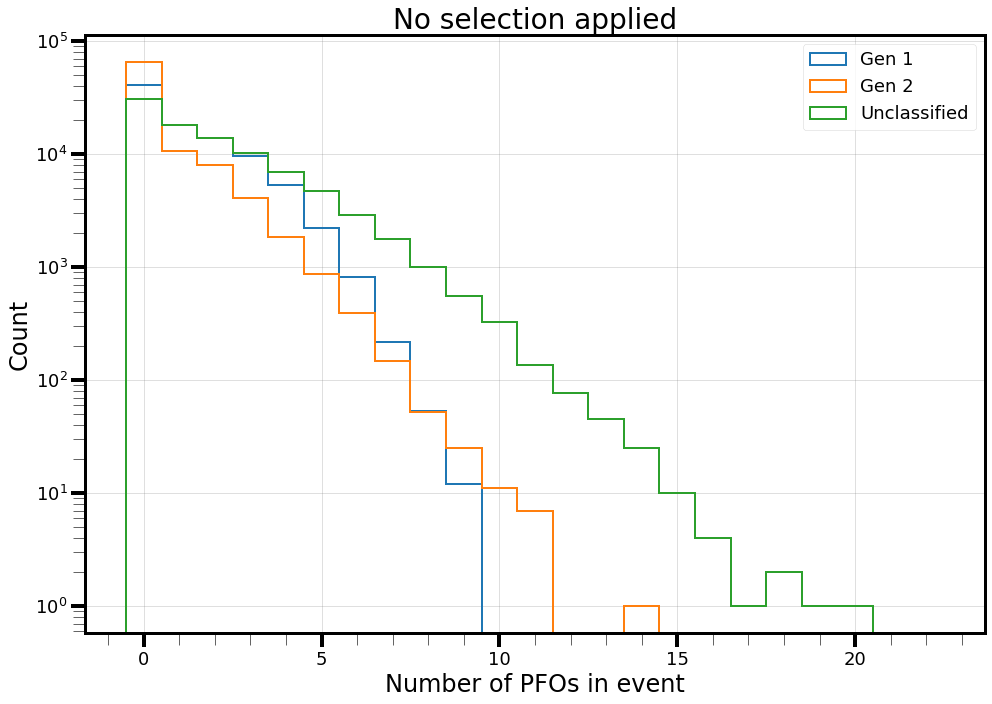

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


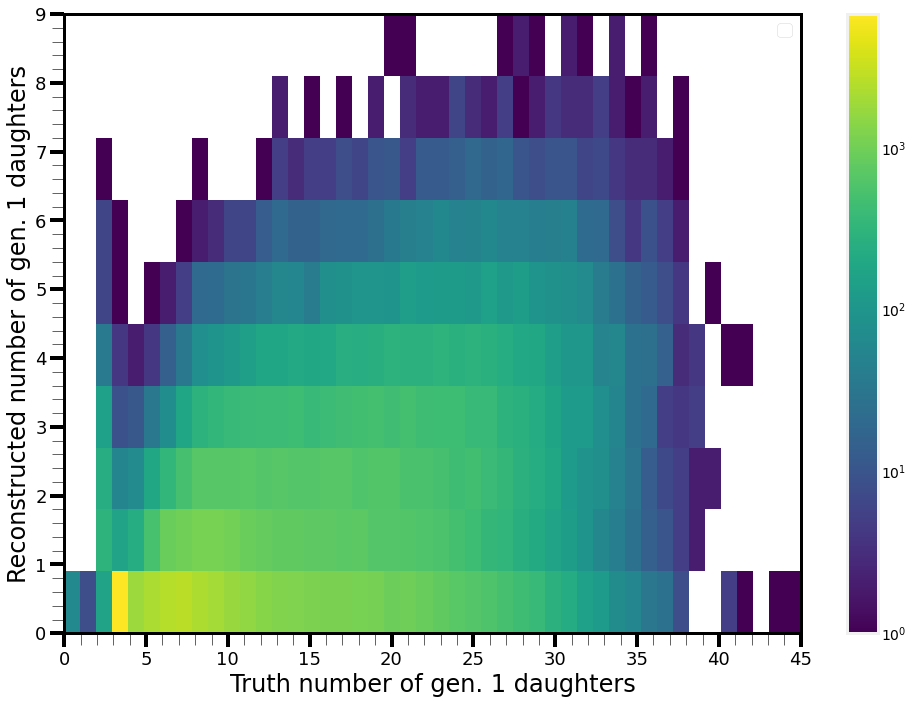

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


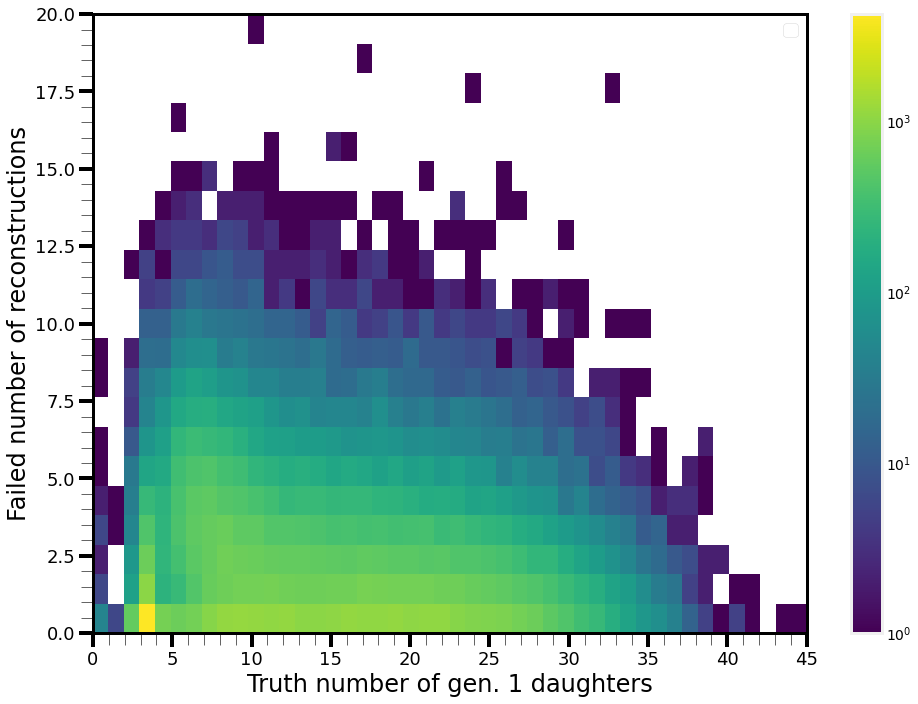

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


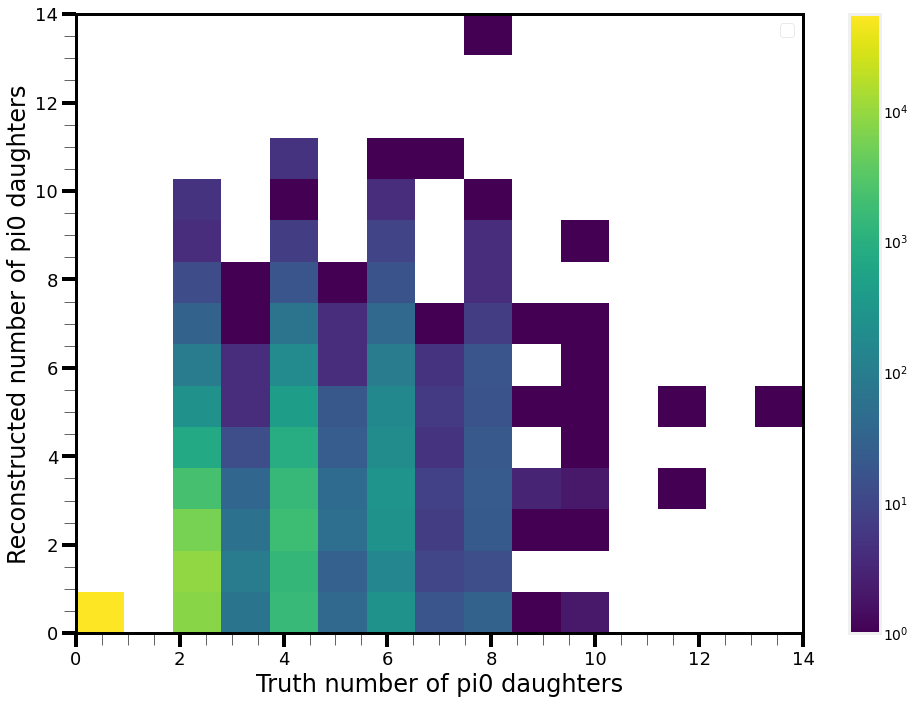

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


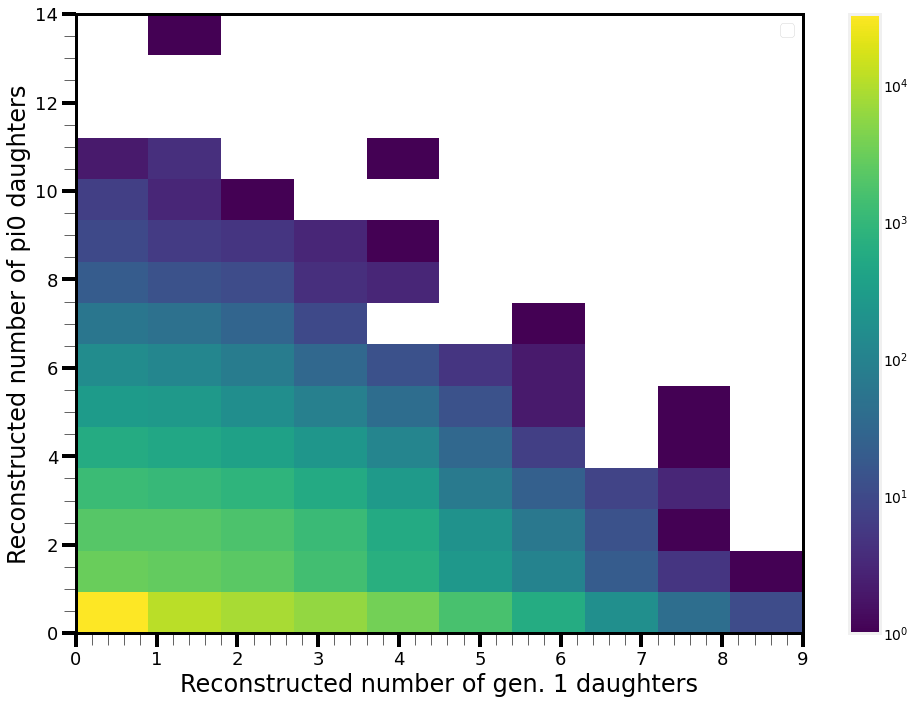

In [11]:
evts_uncut = Master.Data(conf_args.mc_file, nTuple_type = conf_args.ntuple_type)

true_gen1_uncut = gen_1_daughters_truth(evts_uncut)
true_gen2_uncut = pi0_daughters_truth(evts_uncut)
true_beam_uncut = evts_uncut.trueParticles.number == 1
bt_gen1_uncut = gen_1_daughters_bt(evts_uncut)
bt_gen2_uncut = pi0_daughters_bt(evts_uncut)
bt_beam_uncut = evts_uncut.trueParticlesBT.number == 1
bt_others_uncut = np.logical_not(np.logical_or(np.logical_or(bt_gen1_uncut, bt_gen2_uncut), bt_beam_uncut))

plt_conf.setup_figure(title="No selection applied")
plt.hist(count_num_per_event(bt_gen1_uncut), **plt_conf.gen_kwargs(type="hist", label="Gen 1", index=0, bins=np.arange(np.max(ak.count(evts_uncut.trueParticlesBT.number, axis=-1))+1) - 0.5))
plt.hist(count_num_per_event(bt_gen2_uncut), **plt_conf.gen_kwargs(type="hist", label="Gen 2", index=1, bins=np.arange(np.max(ak.count(evts_uncut.trueParticlesBT.number, axis=-1))+1) - 0.5))
plt.hist(count_num_per_event(bt_others_uncut), **plt_conf.gen_kwargs(type="hist", label="Unclassified", index=2, bins=np.arange(np.max(ak.count(evts_uncut.trueParticlesBT.number, axis=-1))+1) - 0.5))
plt_conf.format_axis(xlabel = "Number of PFOs in event", ylabel="Count", ylog=True)
plt_conf.end_plot()

hist_two(true_gen1_uncut, bt_gen1_uncut, "Truth number of gen. 1 daughters", "Reconstructed number of gen. 1 daughters")
hist_two(true_gen1_uncut, bt_others_uncut, "Truth number of gen. 1 daughters", "Failed number of reconstructions")
hist_two(true_gen2_uncut, bt_gen2_uncut, "Truth number of pi0 daughters", "Reconstructed number of pi0 daughters")
hist_two(bt_gen1_uncut, bt_gen2_uncut, "Reconstructed number of gen. 1 daughters", "Reconstructed number of pi0 daughters")

In [5]:
def count_num_per_event(mask):
    return ak.sum(ak.values_astype(mask, int), axis=1)

def gen_1_daughters_bt(events):
    return np.logical_and(events.trueParticlesBT.mother == 1,
                          events.trueParticlesBT.number != 1)

def gen_1_daughters_truth(events):
    return events.trueParticles.mother == 1

def pi0_daughters_truth(events):
    """
    Makes use of the fact only beam, gen 1 and pi0 daughters
    are stored in truth.

    See `mother` definition in `Master.py`, line 884.
    """
    return np.logical_not(
        np.logical_or(events.trueParticles.mother == 1,
                      events.trueParticles.mother == 0))

# # awkward 2.0.0 compatible version (not tested!)
# def isin_eventwise(layouts, **kwargs):
#     assert len(layouts) == 2
#     if layouts[0].is_numpy and layouts[1].is_numpy:
#         return ak.contents.NumpyArray(
#             np.isin(layouts[0].data, layouts[1].data))
# checked_isin = ak.transform(isin_eventwise, bt_nums, true_photon_nums)

def eventwise_isin(elements, test_elements):
    return ak.Array(map(
        lambda zipped: np.isin(zipped["elems"], zipped["tests"]),
        ak.zip(
            {"elems": elements, "tests": test_elements},
            depth_limit=1)))

def pi0_daughters_bt(events):
    true_pi0_daughters = events.trueParticles.number[
        pi0_daughters_truth(events)]
    return eventwise_isin(events.trueParticlesBT.number,
                          true_pi0_daughters)


In [6]:
# These masks completely catagorise every PFO with no overlaps
true_gen1 = gen_1_daughters_truth(evts)
true_gen2 = pi0_daughters_truth(evts)
true_beam = evts.trueParticles.number == 1
bt_gen1 = gen_1_daughters_bt(evts)
bt_gen2 = pi0_daughters_bt(evts)
bt_beam = evts.trueParticlesBT.number == 1
bt_others = np.logical_not(np.logical_or(np.logical_or(bt_gen1, bt_gen2), bt_beam))

In [7]:
bt_all_daughters = np.logical_or(bt_gen1, bt_gen2)

In [36]:
np.max(ak.count(evts.trueParticlesBT.number, axis=-1))

18

In [10]:
def hist_two(mask_one, mask_two, xlab, ylab):
    plt_conf.setup_figure()
    h = plt.hist2d(count_num_per_event(mask_one), count_num_per_event(mask_two), norm="log", bins=np.array([np.max(count_num_per_event(mask_one))+1, np.max(count_num_per_event(mask_two))+1]))
    plt.colorbar(h[-1])
    plt_conf.format_axis(xlabel=xlab, ylabel=ylab)
    plt_conf.end_plot()

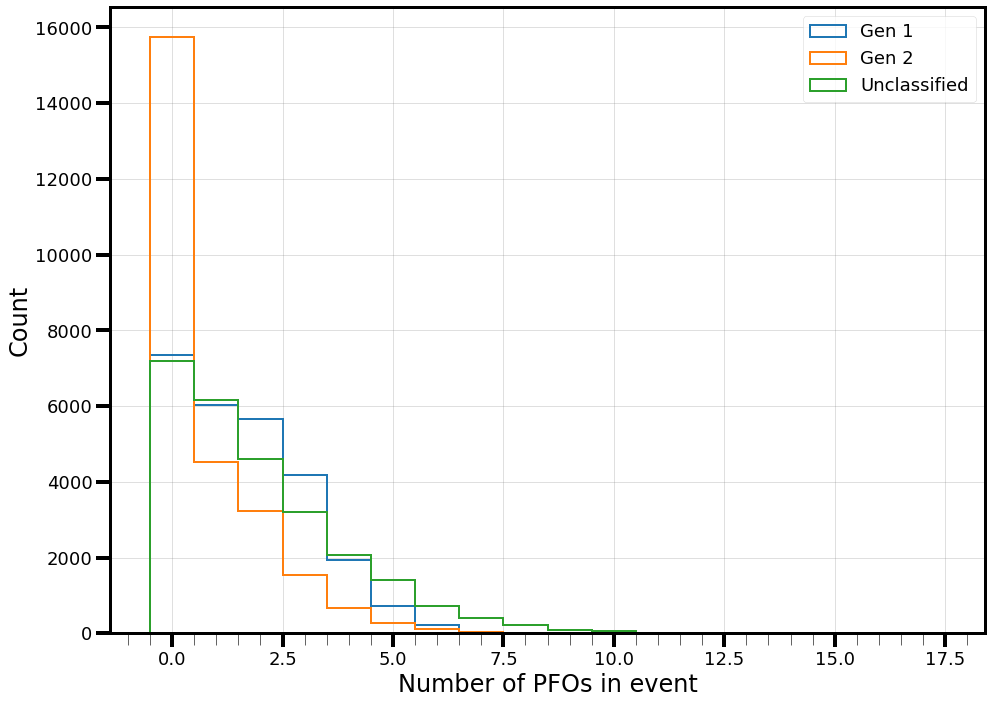

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


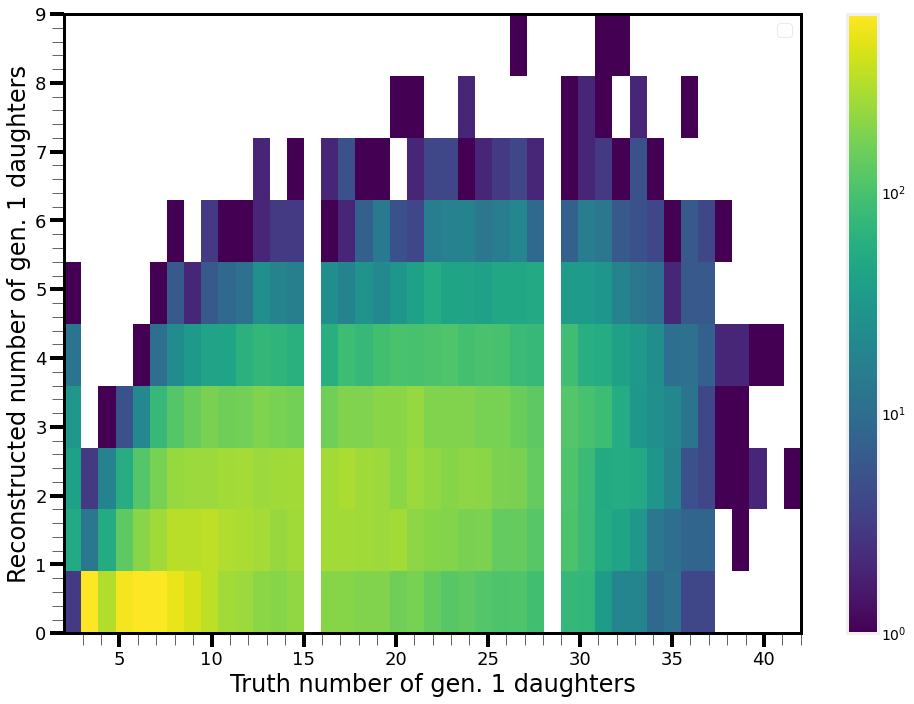

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


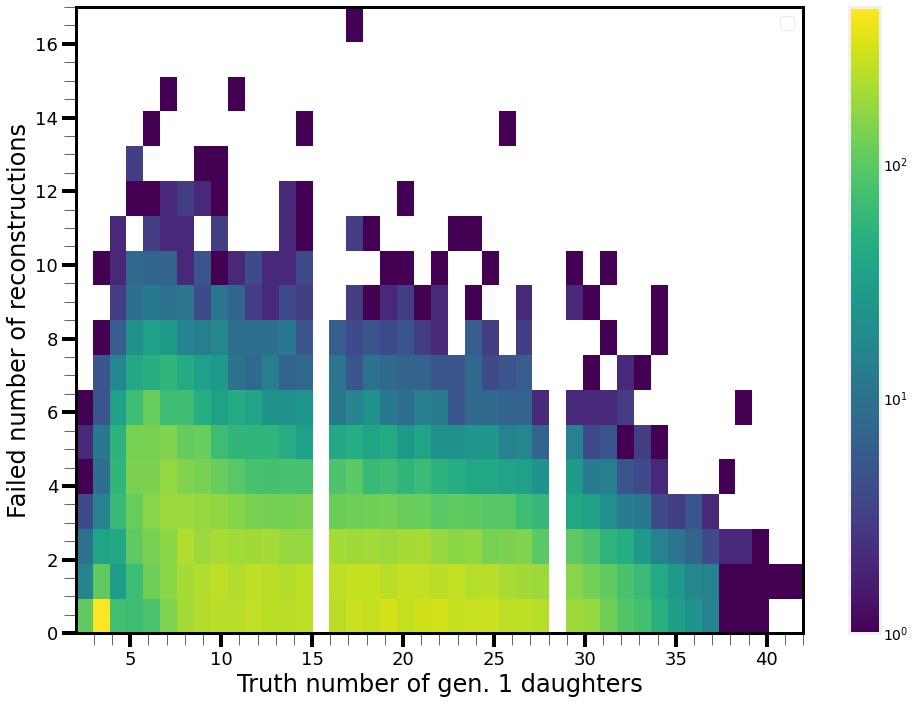

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


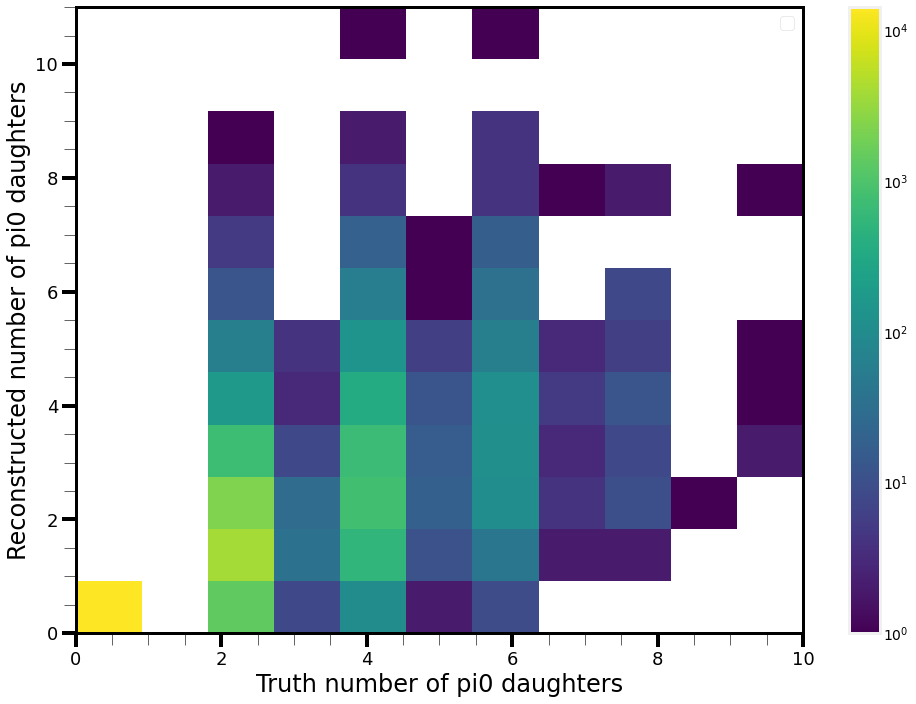

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


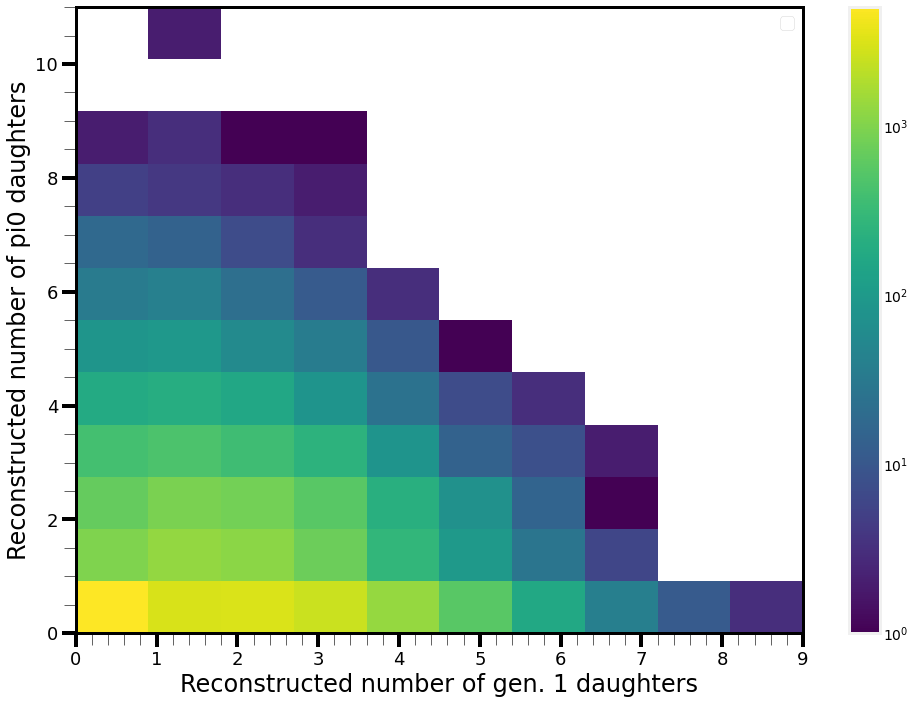

In [14]:
plt_conf.setup_figure()
plt.hist(count_num_per_event(bt_gen1), **plt_conf.gen_kwargs(type="hist", label="Gen 1", index=0, bins=np.arange(np.max(ak.count(evts.trueParticlesBT.number, axis=-1))+1) - 0.5))
plt.hist(count_num_per_event(bt_gen2), **plt_conf.gen_kwargs(type="hist", label="Gen 2", index=1, bins=np.arange(np.max(ak.count(evts.trueParticlesBT.number, axis=-1))+1) - 0.5))
plt.hist(count_num_per_event(bt_others), **plt_conf.gen_kwargs(type="hist", label="Unclassified", index=2, bins=np.arange(np.max(ak.count(evts.trueParticlesBT.number, axis=-1))+1) - 0.5))
plt_conf.format_axis(xlabel = "Number of PFOs in event", ylabel="Count", ylog=False)
plt_conf.end_plot()

hist_two(true_gen1, bt_gen1, "Truth number of gen. 1 daughters", "Reconstructed number of gen. 1 daughters")
hist_two(true_gen1, bt_others, "Truth number of gen. 1 daughters", "Failed number of reconstructions")
hist_two(true_gen2, bt_gen2, "Truth number of pi0 daughters", "Reconstructed number of pi0 daughters")
hist_two(bt_gen1, bt_gen2, "Reconstructed number of gen. 1 daughters", "Reconstructed number of pi0 daughters")

In [21]:
inds = [60, 14913, 351,4, 920]
for ind in inds:
    print(ind)
    print(true_photon_nums[ind])
    print(bt_nums[ind])
    print(np.isin(bt_nums[ind], true_photon_nums[ind]))
    print(checked_isin[ind])

60
[613242, 613243]
[613243, 613096, 612947, 612436]
[True, False, False, False]
[True, False, False, False]
14913
[672034, 672035, 671336, 671337]
[672035, 670335, 669640]
[True, False, False]
[True, False, False]
351
[739773, 739774]
[739773, 2819, 739290, 739288]
[True, False, False, False]
[True, False, False, False]
4
[]
[770742, 770743, 770744]
[False, False, False]
[False, False, False]
920
[646118, 646119]
[646849, 646118, 645874, 646119, 645876]
[False, True, False, True, False]
[False, True, False, True, False]


In [8]:
def gen_features_from_dict(d, keys_to_use=None):
    if keys_to_use is not None:
        d = {key:val for key, val in d.items() if key in keys_to_use}
    for i, val in enumerate(d.values()):
        if i == 0:
            features = np.zeros((ak.count(val), len(d)))
        value = ak.ravel(val)
        features[:, i] = value
    return features

def separate_train_test(truth, props_to_use: dict, test_frac=0.2, keys_to_use=None):
    if keys_to_use is not None:
        props_to_use = {key:val for key, val in props_to_use.items() if key in keys_to_use}
    if not isinstance(truth, ak.Array):
        flat_truth = np.zeros(ak.count(truth[0]), dtype=int)
        for i, t_mask in enumerate(truth):
            flat_truth[ak.ravel(t_mask)] = i+1
    else:
        flat_truth = ak.ravel(truth)
    n_tot = len(flat_truth)
    num_train = int(len(flat_truth) *(1-test_frac))
    print(f"{n_tot} data points found, separated into {num_train} "
          + f"training points and {n_tot - num_train} test_points.")
    train_classes = ak.values_astype(flat_truth[:num_train], int)
    test_truth = flat_truth[num_train:]
    train_data = np.zeros((num_train, len(props_to_use)))
    test_props = {}
    for i, item in enumerate(props_to_use.items()):
        val = ak.ravel(item[1])
        train_data[:, i] = val[:num_train]
        test_props[item[0]] = val[num_train:]
    return train_classes, train_data, test_truth, test_props

def wrap_bdt_args(bdt_fit_func, selector: seval.SelectorEvaluator):
    props_dict = selector.properties
    ind_dict = {}
    for i, key in enumerate(props_dict.keys()):
        if i == 0:
            num_pfos = len(ak.ravel(props_dict[key]))
        ind_dict[key] = i
    num_props = len(props_dict)
    def func(use_props):
        bdt_arg = np.zeros((num_pfos, num_props))
        for key, val in use_props.items():
            if val is not None:
                bdt_arg[:, ind_dict[key]] = ak.ravel(val)
        return bdt_fit_func(bdt_arg)
    return func

def bdt_probs(bdt_obj):
    def func(data):
        return bdt_obj.predict_proba(data)[:,1]
    return func

def convert_dict_to_array(props_dict):
    for i, val in enumerate(props_dict.values()):
        if i == 0:
            res = np.zeros((len(ak.ravel(val)), len(props_dict)))
        res[:, i] = ak.ravel(val)
    return res

def plot_importances(bdt, props):
    plt_conf.setup_figure()
    plt.bar([label.replace('_', '\n') for label in props.keys()], bdt.feature_importances_)
    plt_conf.format_axis(ylog=False, xlabel="Feature", ylabel="Importance")
    plt_conf.end_plot()

## Geometric Classification
Currently uses mostly the raw positions etc. of the particles. Will move to using physical quantities later.

Considered ideas:
- Dot product of direction with beam direction
- Dot product of own direction vs. direction between beam end point and own start point
- Thrust? along radial direction
- Create some plane of particles in the radial direction measure from the cylindrical coordinates centered around the beam direction
- All the event like variables will be a comparision between the total of the whole event, and the variable with this one parameter missing
- Possibly hints to a new way of doing it. Use this method to parameterise the partcles with respect to this plane to 
- Give angle around circle in radial direction
- Angular momentum of PFO with respect to the beam

Created variables should be tested on truth first!

In [42]:
evts_raw = Master.Data(conf_args.mc_file, nTuple_type = conf_args.ntuple_type)

In [43]:
print(ak.count(evts_raw.recoParticles.track_start_dir.x))
print(ak.num(evts_raw.recoParticles.track_start_dir.x, axis=0))
print(ak.num(evts_raw.recoParticles.track_start_dir.x, axis=1))
print(ak.count(evts_raw.recoParticles.track_start_dir.x, axis=0))

362892
91237
[0, 7, 1, 5, 6, 3, 4, 4, 7, 4, 3, 3, 7, ... 2, 3, 5, 2, 8, 1, 0, 0, 1, 7, 10, 5, 2]
[81100, 74595, 63953, 50460, 36248, 23904, 14552, 8339, ... 47, 30, 20, 9, 3, 1, 1]


In [44]:
print(ak.count(evts_raw.recoParticles.track_len))
print(ak.num(evts_raw.recoParticles.track_len, axis=0))
print(ak.num(evts_raw.recoParticles.track_len, axis=1))
print(ak.count(evts_raw.recoParticles.track_len, axis=0))

379943
91237
[0, 7, 1, 6, 6, 3, 4, 4, 7, 4, 3, 3, 7, ... 2, 3, 5, 3, 9, 1, 0, 0, 1, 7, 10, 6, 3]
[81241, 75275, 65510, 52807, 39260, 26895, 17055, 9914, ... 35, 22, 12, 7, 3, 1, 1]


In [45]:
evts_beam = Master.Data(conf_args.mc_file, nTuple_type = conf_args.ntuple_type)
evts_beam = apply_selection(evts_beam, "mc", "beam")

            Name  Remaining events  Percentage of total events remaining  \
0   Initial data             91237                            100.000000   
1              -             72019                             78.936177   
2              -             63508                             69.607725   
3              -             59771                             65.511799   
4              -             45862                             50.266887   
5              -             42147                             46.195074   
6              -             40749                             44.662801   
7              -             33019                             36.190361   
8              -             32919                             36.080757   
9              -             31855                             34.914563   
10             -             26165                             28.678058   

    Relative percentage events  Remaining PFOs  \
0                   100.000000       

/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to filters.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to filename.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to nTuple_type.
  warnings.warn(f"Couldn't apply filters to {var}.")


In [46]:
print(ak.count(evts_beam.recoParticles.track_start_dir.x))
print(ak.num(evts_beam.recoParticles.track_start_dir.x, axis=0))
print(ak.num(evts_beam.recoParticles.track_start_dir.x, axis=1))
print(ak.count(evts_beam.recoParticles.track_start_dir.x, axis=0))

127794
26165
[1, 4, 7, 3, 3, 2, 7, 5, 7, 4, 9, 6, 4, 3, ... 3, 3, 5, 2, 8, 4, 2, 4, 5, 7, 2, 1, 7]
[26022, 25134, 22827, 18979, 14080, 9321, 5518, 2973, ... 88, 45, 23, 8, 3, 2, 1]


In [47]:
print(ak.count(evts_beam.recoParticles.track_len))
print(ak.num(evts_beam.recoParticles.track_len, axis=0))
print(ak.num(evts_beam.recoParticles.track_len, axis=1))
print(ak.count(evts_beam.recoParticles.track_len, axis=0))

134264
26165
[1, 4, 7, 3, 3, 3, 8, 5, 7, 4, 9, 6, 4, 4, ... 3, 4, 5, 3, 8, 4, 2, 6, 5, 8, 2, 1, 7]
[26029, 25255, 23245, 19788, 15280, 10583, 6612, 3683, ... 62, 30, 12, 6, 2, 1, 1]


In [49]:
evts_pfo = Master.Data(conf_args.mc_file, nTuple_type = conf_args.ntuple_type)
evts_pfo = apply_selection(evts_pfo, "mc", "valid_pfo")

           Name  Remaining events  Percentage of total events remaining  \
0  Initial data             91237                                 100.0   
1             -             91237                                 100.0   

   Relative percentage events  Remaining PFOs  \
0                       100.0          379943   
1                       100.0          341313   

   Percentage of total PFOs remaining  Relative percentage of PFOs  \
0                          100.000000                   100.000000   
1                           89.832685                    89.832685   

   Average PFOs per event  
0                4.164352  
1                3.740949  


/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to filters.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to filename.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to nTuple_type.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to run.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:56: UserWarning: Couldn't apply filters to subRun.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/an

In [57]:
raw_good_mask = np.logical_not(np.logical_or(evts_raw.recoParticles.track_start_pos.x==-999., np.logical_or(evts_raw.recoParticles.track_start_pos.y==-999.,evts_raw.recoParticles.track_start_pos.z==-999.)))
test_start_pos = evts_raw.recoParticles.track_start_pos.x[raw_good_mask]

assert ak.count(evts_pfo.recoParticles.track_start_dir.x) == ak.count(test_start_pos)
assert ak.num(evts_pfo.recoParticles.track_start_dir.x, axis=0) == ak.num(test_start_pos, axis=0)
assert ak.all(ak.num(evts_pfo.recoParticles.track_start_dir.x, axis=1) == ak.num(test_start_pos, axis=1))
assert ak.all(ak.count(evts_pfo.recoParticles.track_start_dir.x, axis=0) == ak.count(test_start_pos, axis=0))

In [50]:
print(ak.count(evts_pfo.recoParticles.track_start_dir.x))
print(ak.num(evts_pfo.recoParticles.track_start_dir.x, axis=0))
print(ak.num(evts_pfo.recoParticles.track_start_dir.x, axis=1))
print(ak.count(evts_pfo.recoParticles.track_start_dir.x, axis=0))

362892
91237
[0, 7, 1, 5, 6, 3, 4, 4, 7, 4, 3, 3, 7, ... 2, 3, 5, 2, 8, 1, 0, 0, 1, 7, 10, 5, 2]
[81100, 74595, 63953, 50460, 36248, 23904, 14552, 8339, ... 47, 30, 20, 9, 3, 1, 1]


In [51]:
print(ak.count(evts_pfo.recoParticles.track_len))
print(ak.num(evts_pfo.recoParticles.track_len, axis=0))
print(ak.num(evts_pfo.recoParticles.track_len, axis=1))
print(ak.count(evts_pfo.recoParticles.track_len, axis=0))

341313
91237
[0, 7, 1, 3, 5, 3, 4, 4, 6, 4, 3, 3, 7, ... 2, 3, 5, 2, 9, 1, 0, 0, 1, 7, 10, 4, 2]
[80864, 73609, 61757, 47052, 32272, 20306, 11790, 6546, ... 61, 32, 19, 7, 2, 1, 1]


In [28]:
ak.count(evts.recoParticles.track_start_dir.x)

127794

In [8]:
print(ak.count(evts.recoParticles.track_start_dir.x))
print(ak.num(evts.recoParticles.track_start_dir.x, axis=0))
print(ak.num(evts.recoParticles.track_start_dir.x, axis=1))
print(ak.count(evts.recoParticles.track_start_dir.x, axis=0))

119568
26165
[1, 4, 6, 3, 3, 2, 6, 5, 7, 3, 8, 5, 3, 3, ... 2, 3, 5, 2, 7, 4, 2, 3, 5, 7, 2, 1, 7]
[25995, 24952, 22212, 17779, 12446, 7710, 4275, 2180, ... 119, 59, 25, 12, 4, 1, 1]


In [9]:
print(ak.count(evts.recoParticles.track_len))
print(ak.num(evts.recoParticles.track_len, axis=0))
print(ak.num(evts.recoParticles.track_len, axis=1))
print(ak.count(evts.recoParticles.track_len, axis=0))

119568
26165
[1, 4, 6, 3, 3, 2, 6, 5, 7, 3, 8, 5, 3, 3, ... 2, 3, 5, 2, 7, 4, 2, 3, 5, 7, 2, 1, 7]
[25995, 24952, 22212, 17779, 12446, 7710, 4275, 2180, ... 119, 59, 25, 12, 4, 1, 1]


In [32]:
ak.count(evts.io.Get("reco_daughter_allTrack_startDirX"))

362892

In [34]:
ak.count(evts.io.Get("reco_daughter_allShower_dirX"))

379943

In [33]:
ak.count(evts.io.Get("reco_daughter_allTrack_startX"))

379943

In [9]:
geom_props = {
    "length": evts.recoParticles.track_len,
    "alt_length": evts.recoParticles.track_len_alt,
    "beam_impact_params": PFOSelection.find_beam_impact_parameters(evts),
    "beam_separations": PFOSelection.find_beam_separations(evts),
    "beam_start_X":evts.recoParticles.beam_endPos.x*ak.ones_like(evts.recoParticles.track_start_pos.x),
    "beam_start_Y":evts.recoParticles.beam_endPos.y*ak.ones_like(evts.recoParticles.track_start_pos.x),
    "beam_start_Z":evts.recoParticles.beam_endPos.z*ak.ones_like(evts.recoParticles.track_start_pos.x),
    "track_score": evts.recoParticles.track_score,
    "track_start_X": evts.recoParticles.track_start_pos.x,
    "track_start_Y": evts.recoParticles.track_start_pos.y,
    "track_start_Z": evts.recoParticles.track_start_pos.z,
    "track_dir_X": evts.recoParticles.track_start_dir.x,
    "track_dir_Y": evts.recoParticles.track_start_dir.y,
    "track_dir_Z": evts.recoParticles.track_start_dir.z,
    "track_end_X": evts.recoParticles.track_end_pos.x,
    "track_end_Y": evts.recoParticles.track_end_pos.y,
    "track_end_Z": evts.recoParticles.track_end_pos.z,
    "shower_start_X": evts.recoParticles.shower_start_pos.x,
    "shower_start_Y": evts.recoParticles.shower_start_pos.y,
    "shower_start_Z": evts.recoParticles.shower_start_pos.z,
    "shower_dir_X": evts.recoParticles.shower_direction.x,
    "shower_dir_Y": evts.recoParticles.shower_direction.y,
    "shower_dir_Z": evts.recoParticles.shower_direction.z}

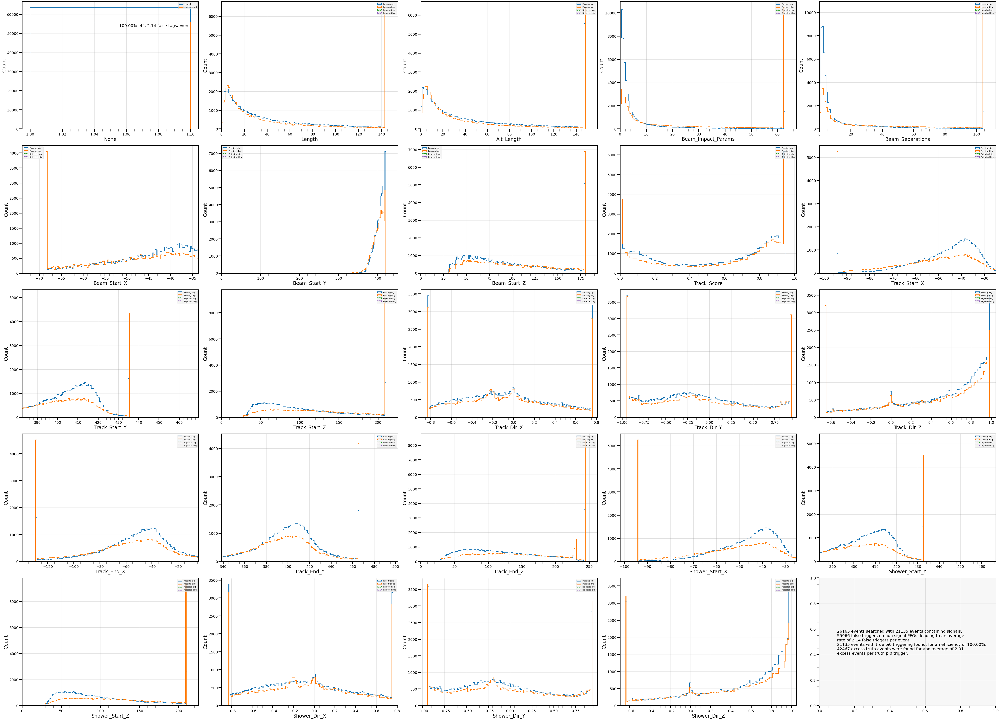

In [10]:
pfo_geom_eval = seval.SelectorEvaluator(bt_all_daughters, geom_props)
pfo_geom_eval.add_selector_metric("none")
pfo_geom_eval.make_metric_summary("none", style="quartile_rejected")

119568 data points found, separated into 95654 training points and 23914 test_points.


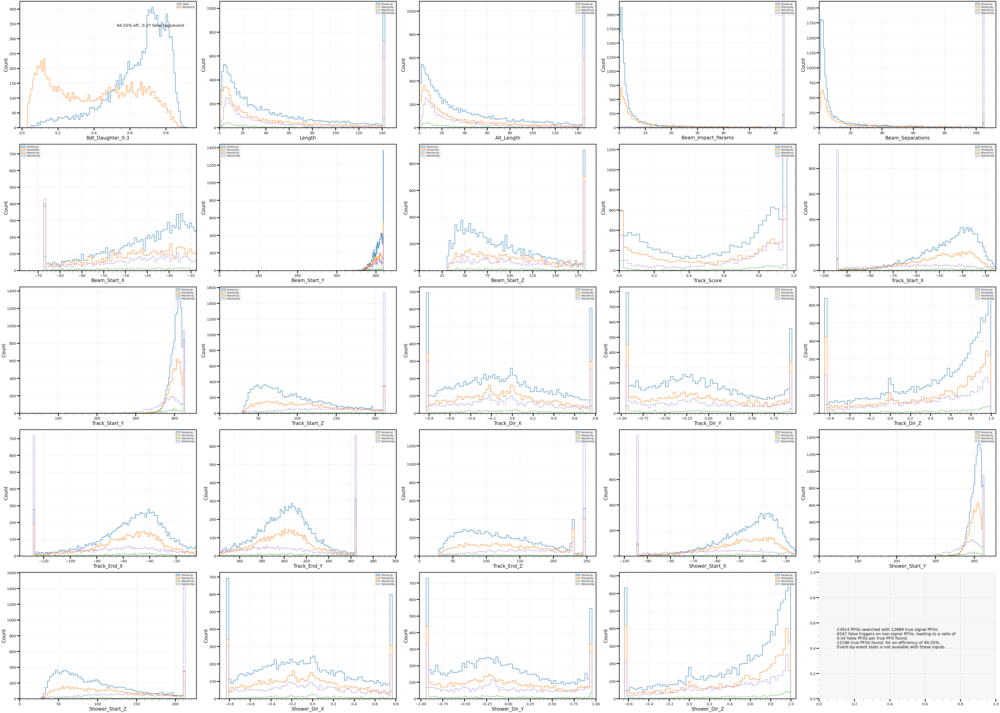

In [10]:
train_class_geom, train_data_geom, test_truth_geom, test_props_geom = separate_train_test(bt_all_daughters, geom_props)
bdt_geom = ensemble.GradientBoostingClassifier()
bdt_geom.fit(train_data_geom, train_class_geom)
bdt_geom_eval = seval.SelectorEvaluator(test_truth_geom, test_props_geom)
bdt_geom_eval.add_metric("bdt_daughter_0.3", wrap_bdt_args(bdt_probs(bdt_geom), bdt_geom_eval), threshold=0.3)
bdt_geom_eval.make_metric_summary("bdt_daughter_0.3", style="quartile_rejected")

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


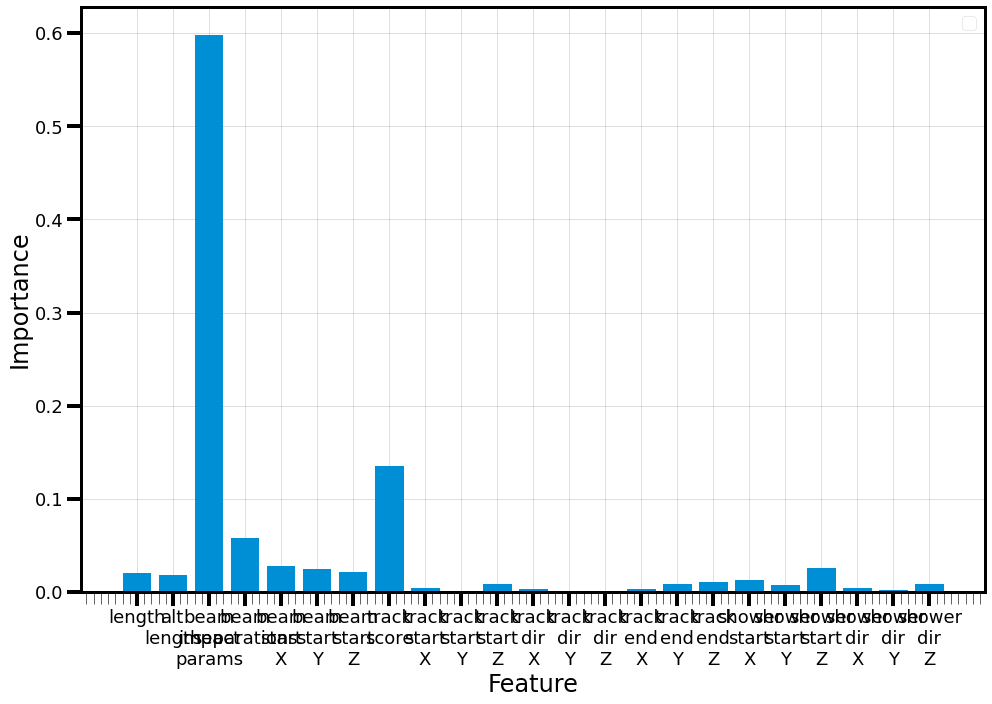

In [12]:
plot_importances(bdt_geom, test_props_geom)

In [ ]:
["length", "beam_impact_params", "beam_start_X", "beam_start_Z", "track_start_X", "track_start_Z", "track_dir_Y", "track_end_X", "track_end_Z", "shower_start_Y", "shower_dir_X", "shower_dir_Z"]
[    "alt_length",  "beam_separations", "beam_start_Y", "track_score",  "track_start_Y", "track_dir_X", "track_dir_Z", "track_end_Y", "shower_start_X", "shower_start_Z", "shower_dir_Y"       ]

In [ ]:
evts.io.ListNTuples()

In [66]:
gen1_daughter_truth = evts.trueParticlesBT.mother == 1
geom_props = {
    "impact":PFOSelection.find_beam_impact_parameters(evts),
    "separation":PFOSelection.find_beam_separations(evts),
    "length":evts.recoParticles.track_len,
    "beam_length":ak.ones_like(evts.recoParticles.track_len) * evts.recoParticles.beam_track_length
}
train_class_geom, train_data_geom, test_truth_geom, test_props_geom = separate_train_test(gen1_daughter_truth, geom_props)

119924 data points found, separated into 95939 training points and 23985 test_points.


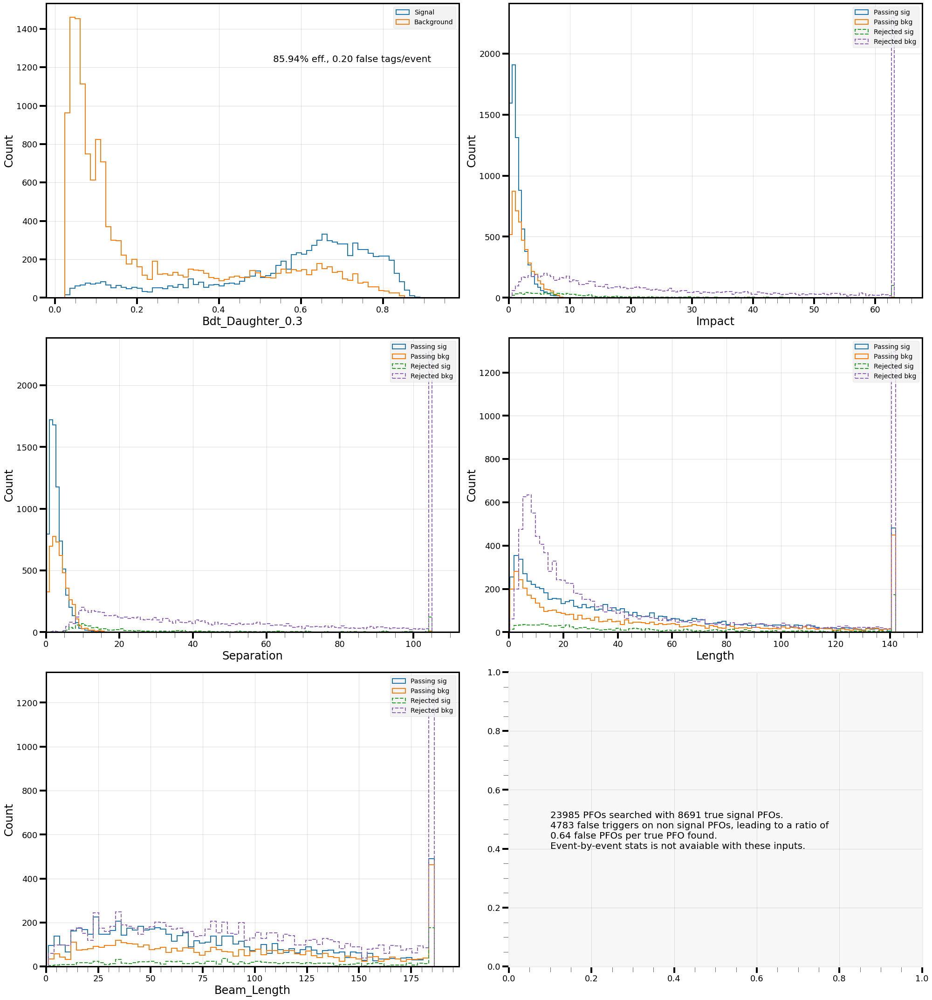

In [67]:
bdt_geom = ensemble.GradientBoostingClassifier()
bdt_geom.fit(train_data_geom, train_class_geom)
bdt_geom_eval = seval.SelectorEvaluator(test_truth_geom, test_props_geom)
bdt_geom_eval.add_metric("bdt_daughter_0.3", wrap_bdt_args(bdt_probs(bdt_geom), bdt_geom_eval), threshold=0.3)
bdt_geom_eval.make_metric_summary("bdt_daughter_0.3", style="quartile_rejected")

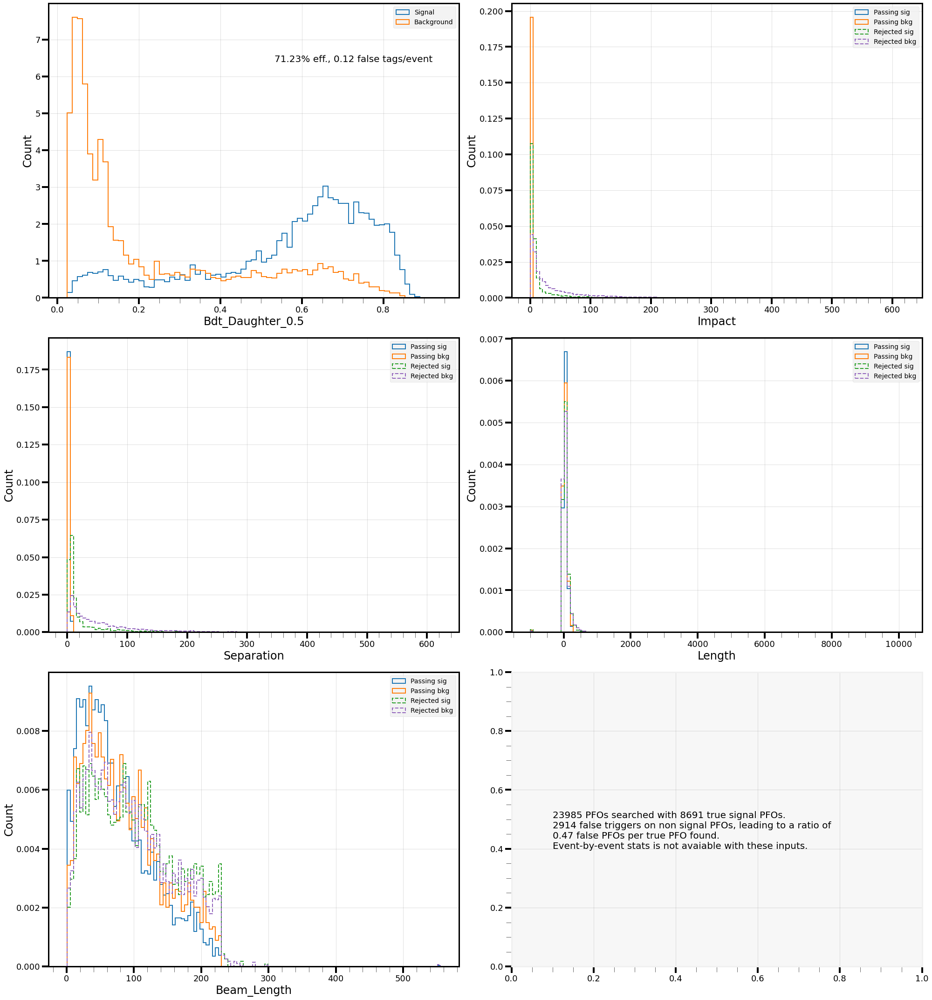

In [69]:
bdt_geom_eval.add_metric("bdt_daughter_0.5", wrap_bdt_args(bdt_probs(bdt_geom), bdt_geom_eval), threshold=0.5 )
bdt_geom_eval.make_metric_summary("bdt_daughter_0.5")

## $\pi^+$(/proton) identification
MicroBooNE paper: https://arxiv.org/pdf/1710.00898.pdf
See section 4.2 for a brief discussion on the observables they pull from the track.

Available reco params:
- number
- nHits
- nHits_collection
- startPos    > Ask Shyam about this (for tracks)
- direction  /
- trackScore
- track_dEdX


Params to explore:
- Track length
- Total energy
- Beam approach
- Beam separation
- 90/10% d2EdX2     > Make plots looking at some generic dEdX distributions
- 90/10% sum dEdX  /
- sum dR^2 from z line between initial and end point
- Sum dR from z line between initial and end point
- (Probably not, jsut sum instead) max dR from zline between initial and endpoit point
  -     ^ in general some handles on curvature - potentially two different handles - one for curved, one for variation
- variables that represent the shape and scale of the dE/dx (or dQ/dx) curve at any point along the reconstructed track


In [11]:
# piplus_props = {
#     "track": evts.recoParticles.track_score,
#     "nhits": evts.recoParticles.n_hits,
#     "dEdx": PFOSelection.Median(evts.recoParticles.track_dEdX),
#     "chi2": evts.recoParticles.track_chi2_pion,
#     "chi2_dof": evts.recoParticles.track_chi2_pion_ndof}
daughter_mask = np.logical_and(evts.trueParticlesBT.mother == 1,
                               evts.trueParticlesBT.number != 1)

piplus_truth = np.logical_and(daughter_mask,
                              evts.trueParticlesBT.pdg == 211)
pi_truth = np.logical_and(
    daughter_mask,
    np.logical_or(evts.trueParticlesBT.pdg == 211,
                  evts.trueParticlesBT.pdg == -211))
proton_truth = np.logical_and(daughter_mask,
                              evts.trueParticlesBT.pdg == 2212)
muon_truth = np.logical_and(daughter_mask,
                              evts.trueParticlesBT.pdg == 13)
any_mu_truth = np.logical_and(
    daughter_mask,
    np.logical_or(evts.trueParticlesBT.pdg == 13,
                  evts.trueParticlesBT.pdg == -13))

photon_truth = np.logical_and(evts.trueParticlesBT.pdg == 22, bt_gen2)

del daughter_mask

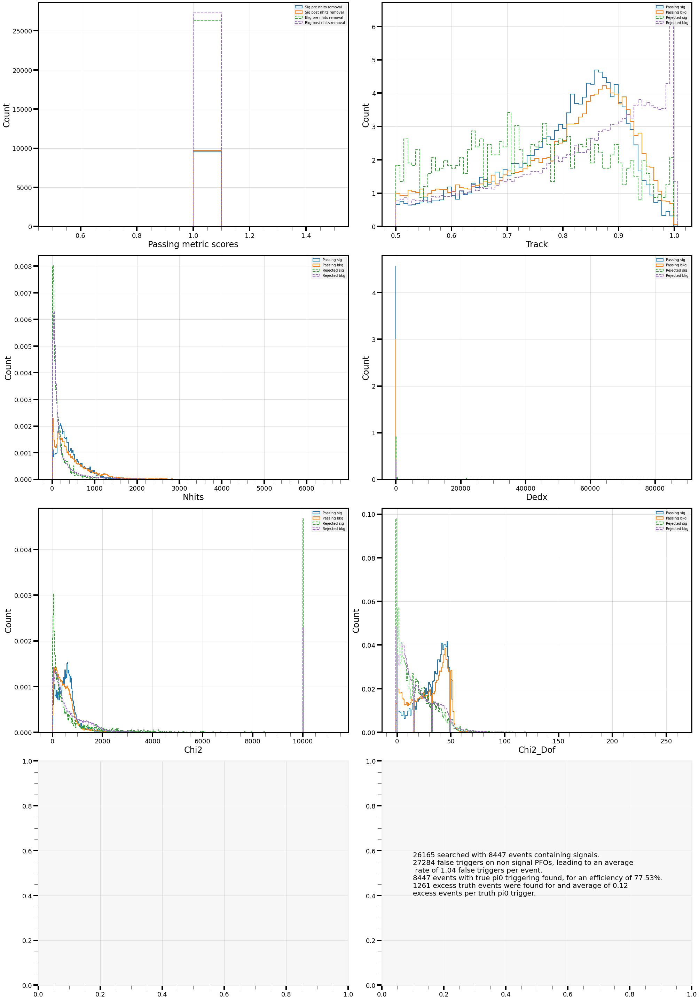

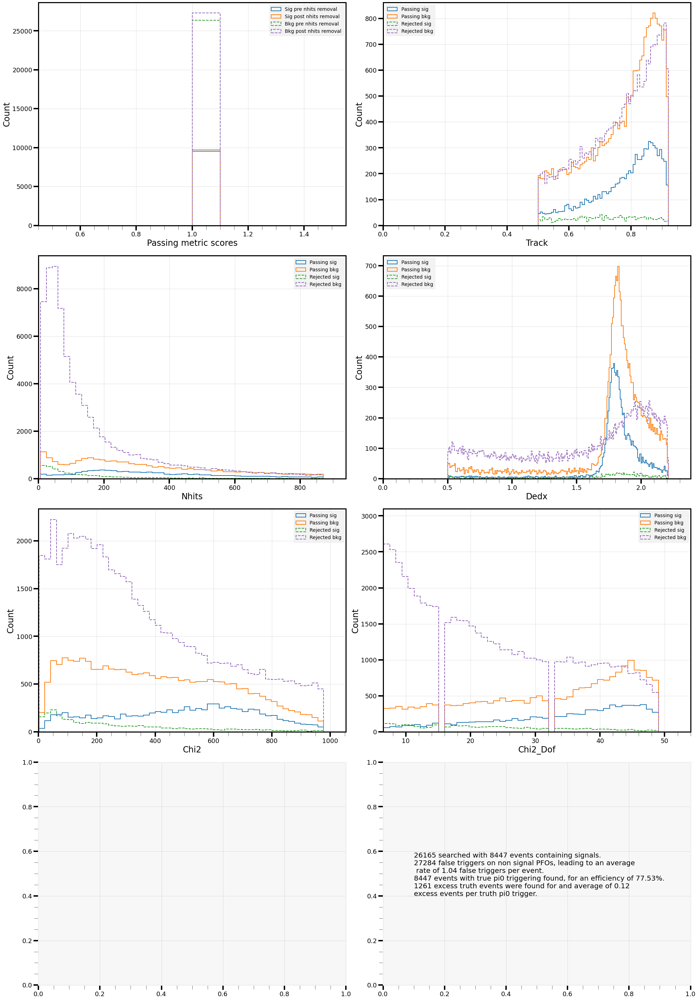

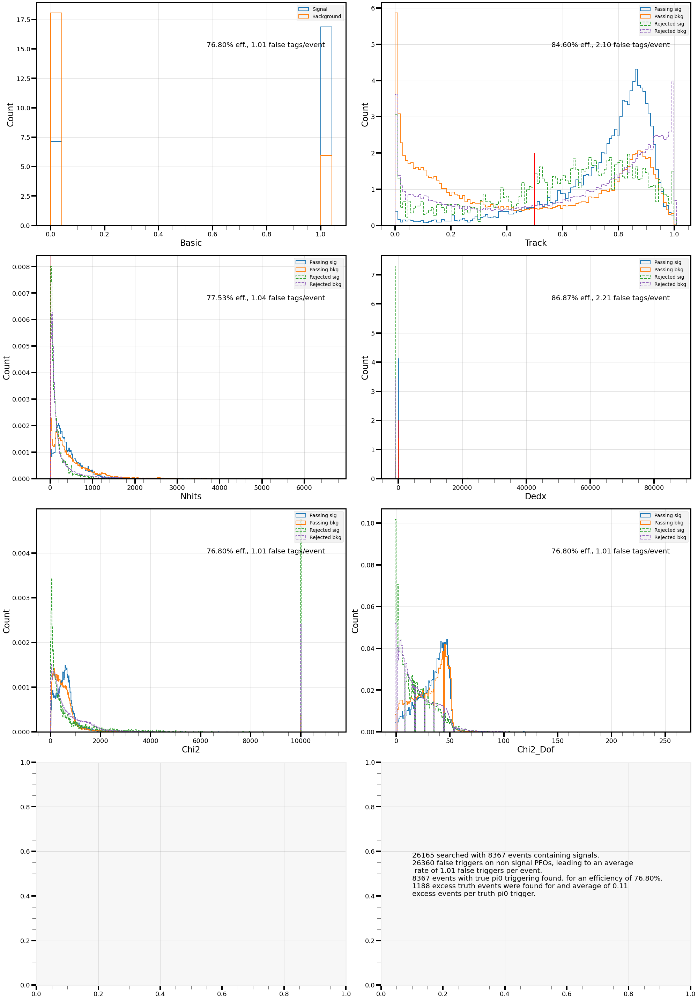

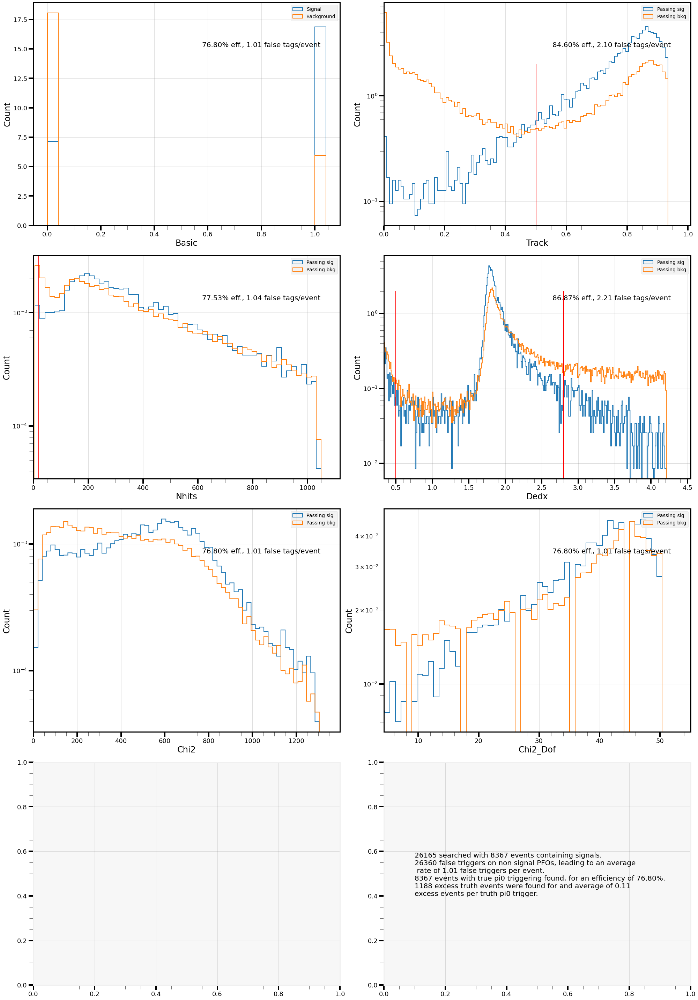

In [7]:
pipselector = seval.SelectorEvaluator(piplus_truth, piplus_props)
pipselector.add_selector_metric("basic", track=(0.5,), nhits=(20,), dEdx=(0.5,2.8))

pipselector.make_n_minus_1_summary("basic", "nhits")
pipselector.make_n_minus_1_summary("basic", "nhits", style="rejected_quartile")
pipselector.make_n_minus_1_per_property("basic")
pipselector.make_n_minus_1_per_property("basic", style="display")

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


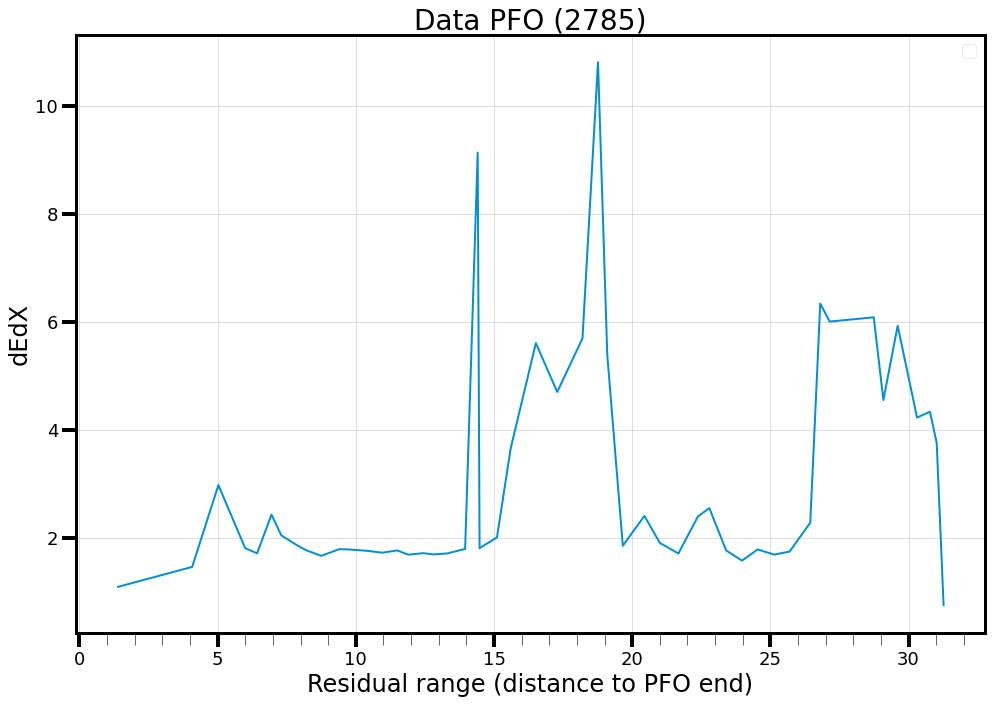

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


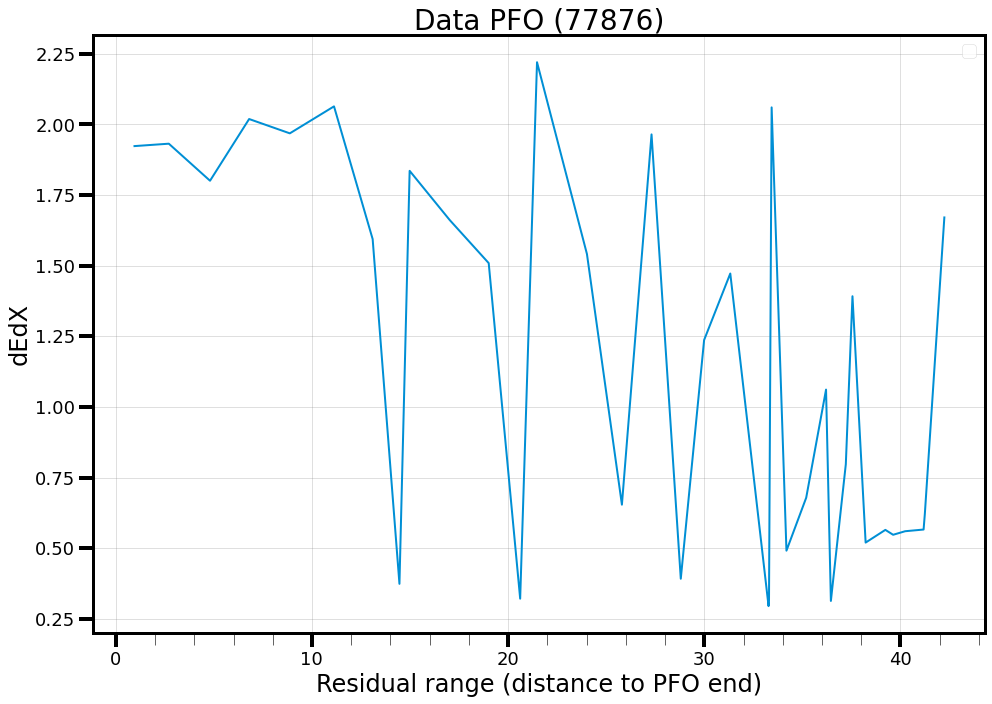

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


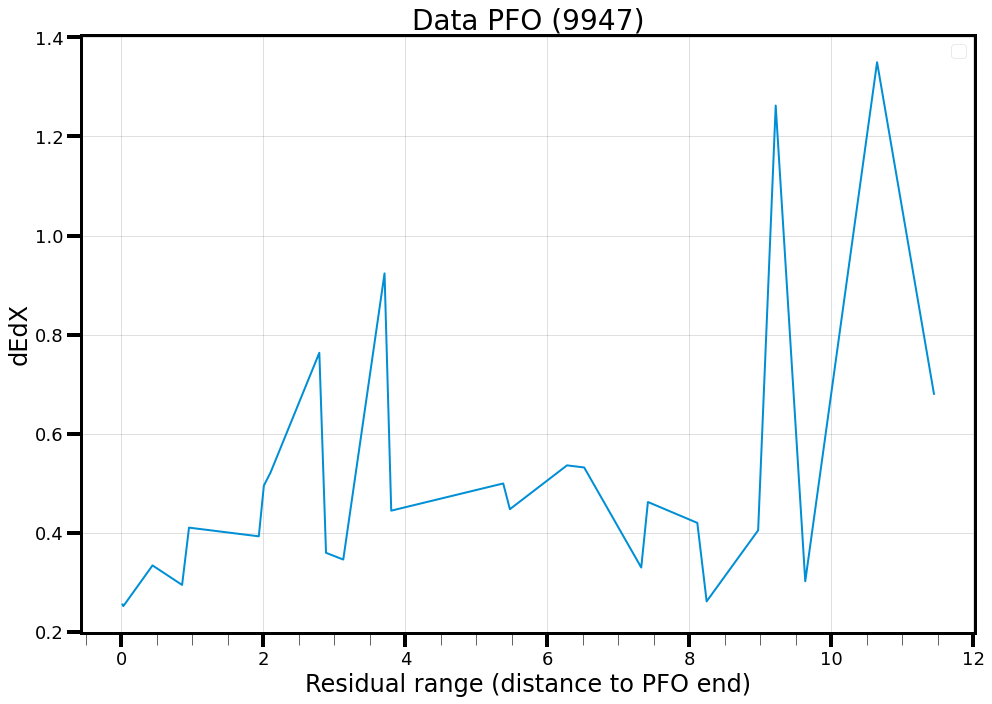

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


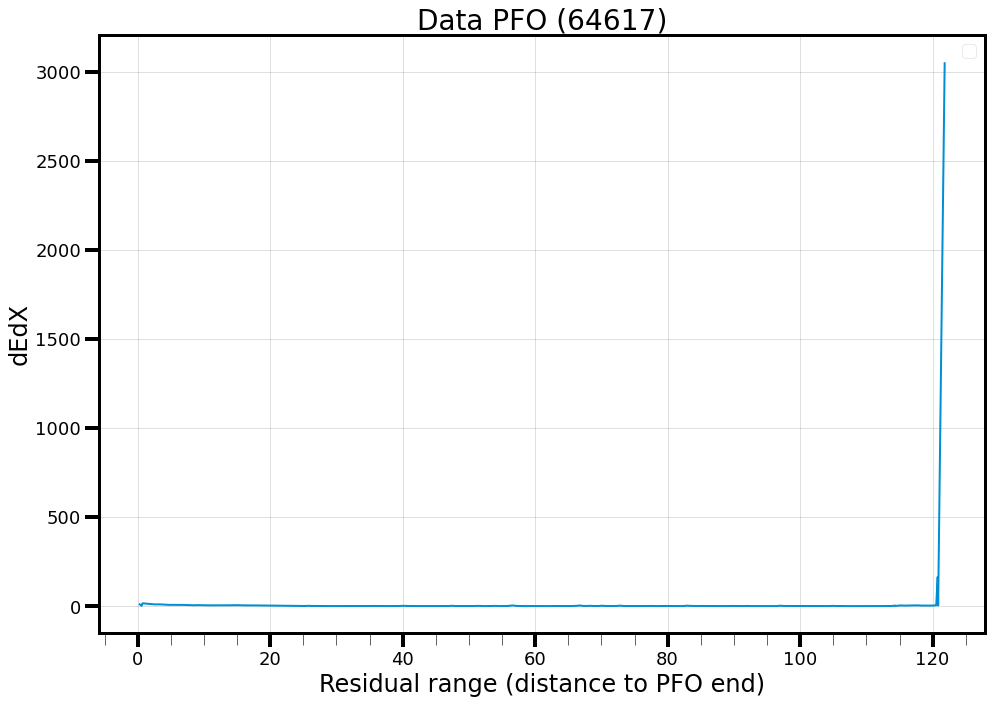

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


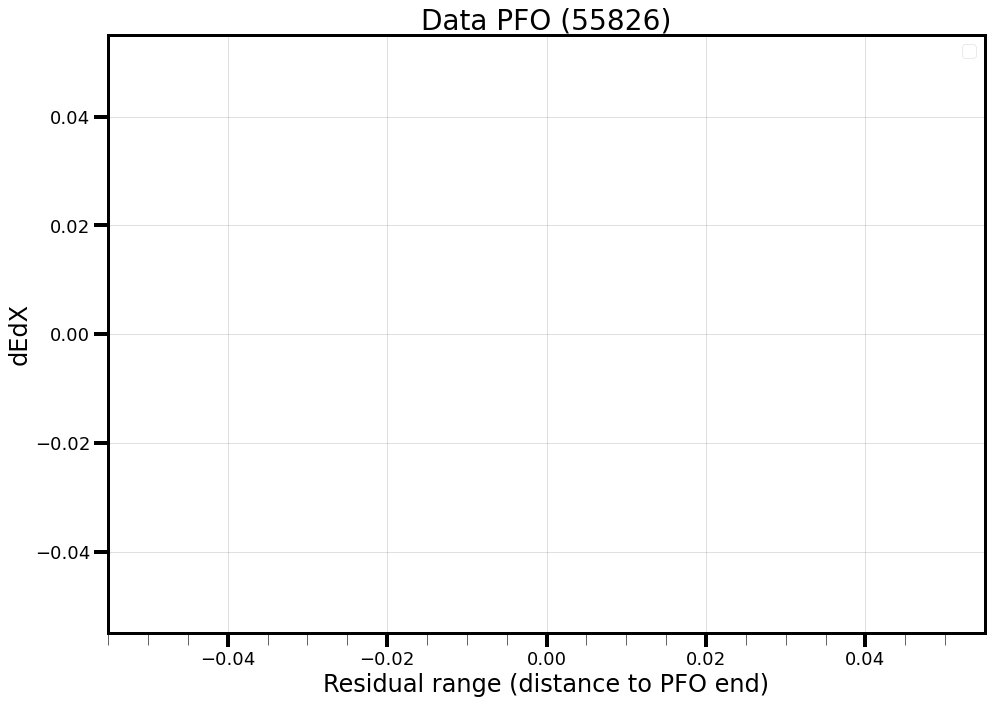

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


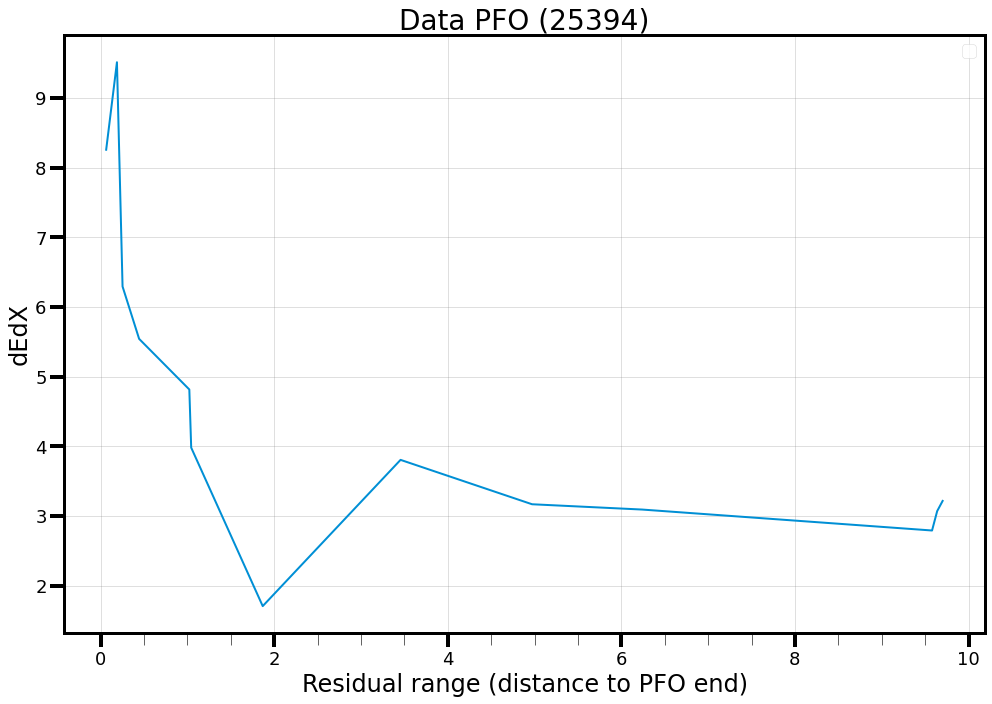

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


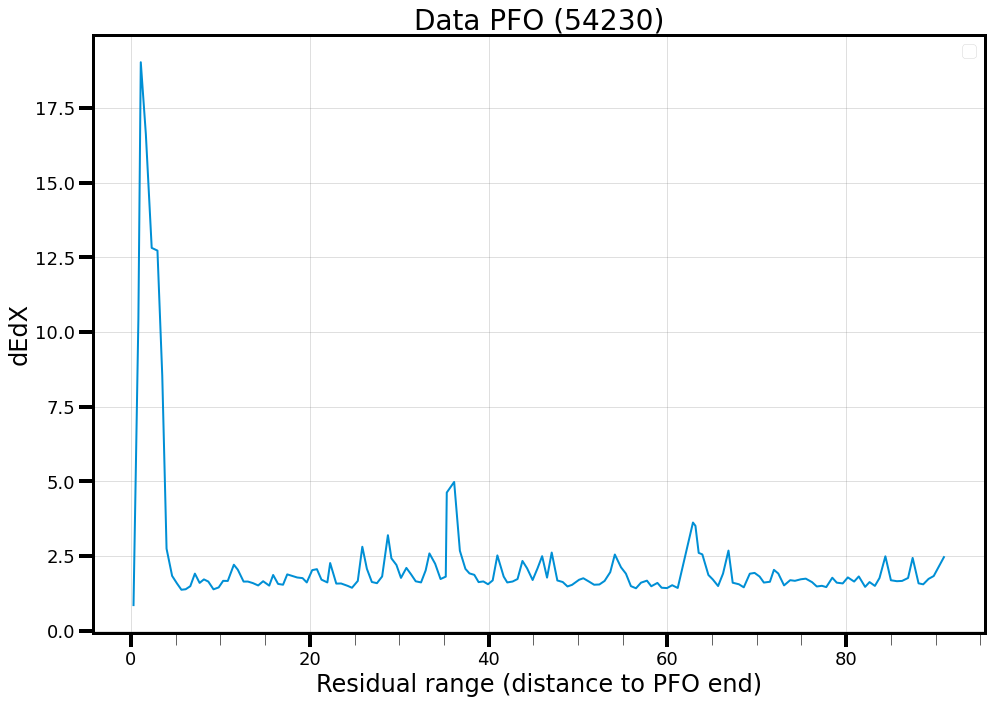

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


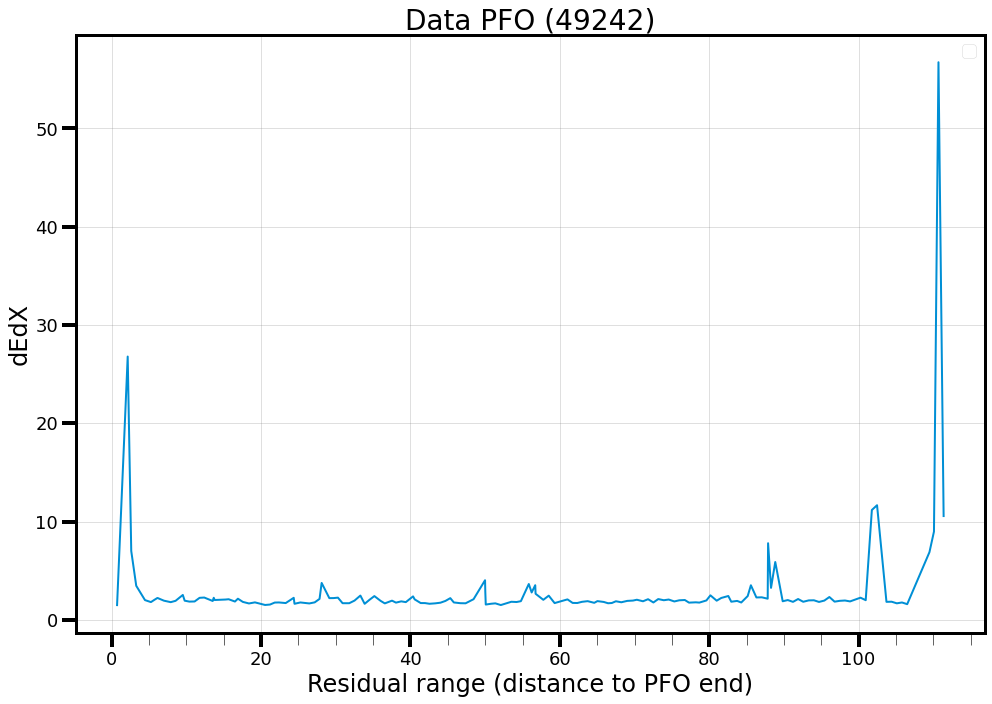

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


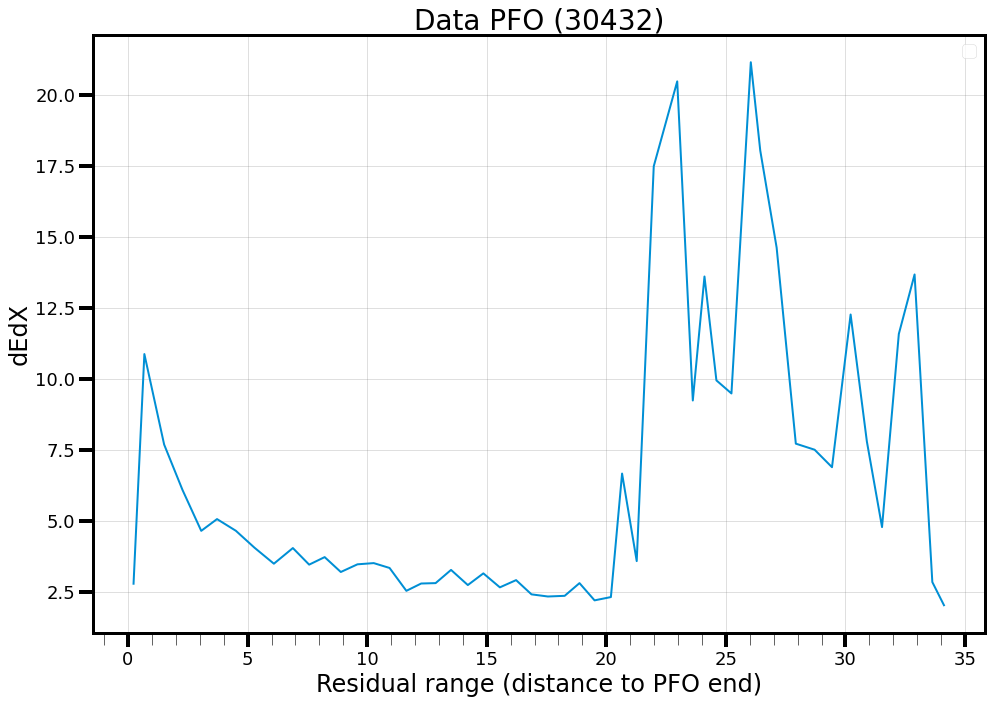

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


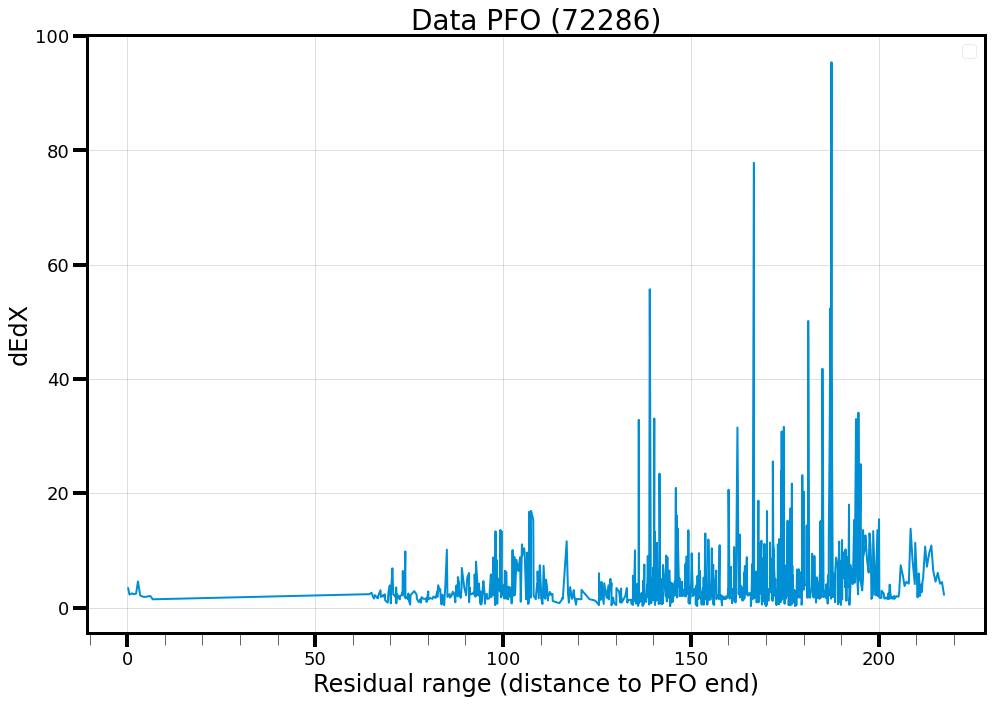

In [35]:
data_flat_dedx = ak.flatten(evts_data.recoParticles.track_dEdX, axis=1)
data_flat_res = ak.flatten(evts_data.recoParticles.residual_range, axis=1)

data_n_pfos = len(data_flat_dedx)

for _ in range(10):
    ind = np.random.randint(0, data_n_pfos)
    plt_conf.setup_figure(title=f"Data PFO ({ind})")
    plt.plot(data_flat_res[ind], data_flat_dedx[ind], **plt_conf.gen_kwargs())
    plt_conf.format_axis(xlabel = "Residual range (distance to PFO end)", ylabel="dEdX", ylog=False)
    plt_conf.end_plot()

In [38]:
np.unique(ak.ravel(evts.trueParticlesBT.pdg), return_counts=True)

(array([      -321,       -211,        -13,        -11,         11,
                13,         22,        211,        321,       2212,
              3112,       3222, 1000010020, 1000010030, 1000020030,
        1000020040, 1000070150], dtype=int32),
 array([   69, 12025,  5953,  2841,   240,  2770, 33422, 22700,   779,
        37928,     7,     4,  1135,    41,     7,     2,     1]))

In [7]:
flat_dedx = ak.flatten(evts.recoParticles.track_dEdX, axis=1)
flat_res = ak.flatten(evts.recoParticles.residual_range, axis=1)

n_pfos = len(flat_dedx)

pfo_type = {1: "Pion (+)", 2:"Muon", 3:"Proton"}
pfo_catalogue = np.zeros(n_pfos, dtype=int)
pfo_catalogue[ak.ravel(piplus_truth)] = 1
pfo_catalogue[ak.ravel(muon_truth)] = 2
pfo_catalogue[ak.ravel(proton_truth)] = 3
known_pfos = np.logical_or(ak.ravel(piplus_truth), np.logical_or(ak.ravel(muon_truth), ak.ravel(proton_truth)))
known_flat_dedx = flat_dedx[known_pfos]
known_flat_res = flat_res[known_pfos]
known_n_pfos = len(known_flat_dedx)
known_pfo_catalogue = pfo_catalogue[known_pfos]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


[0, 0, 4, 2, 3, 1, 5, 0, 2, 0, 3, 0, 0, 1, ... 1, 0, 2, 0, 3, 2, 1, 4, 4, 1, 0, 0, 2]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ... 0, 0, 1, 0, 1, 0, 0, 0, 0, 2, 0, 0, 0]
(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]), array([7355, 5299, 5452, 4371, 2250, 1004,  332,   71,   27,    4]))


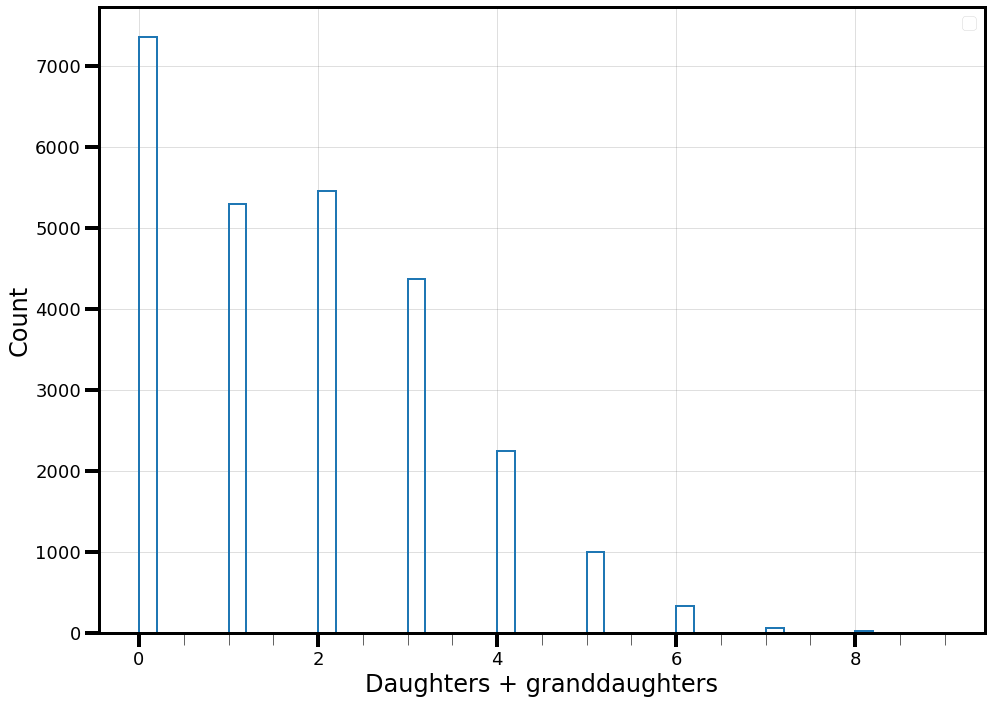

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


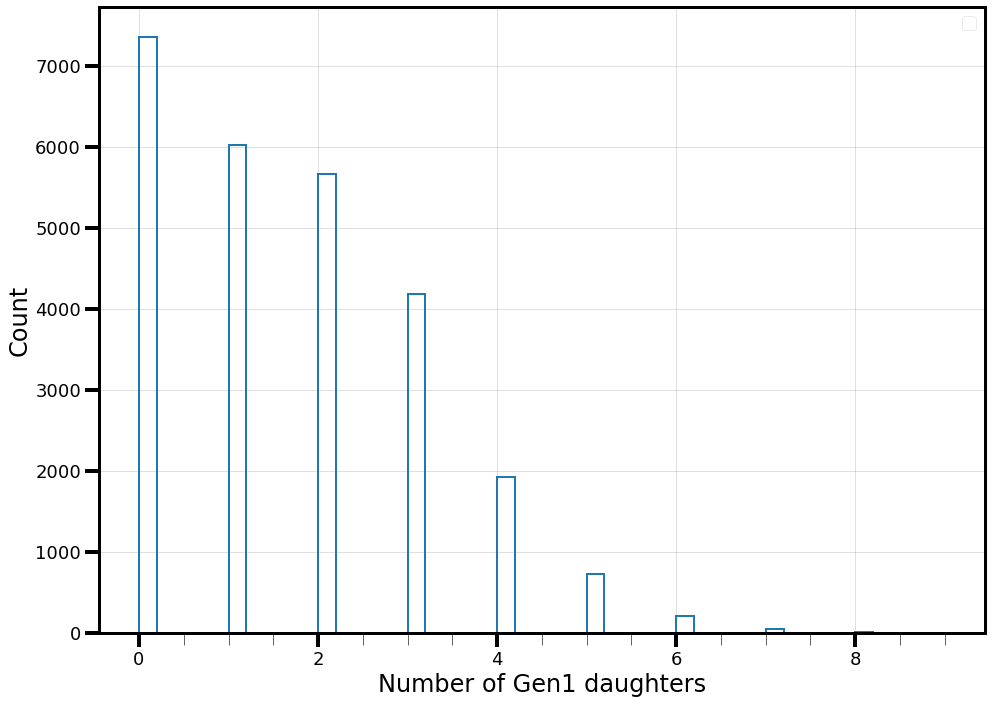

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


6


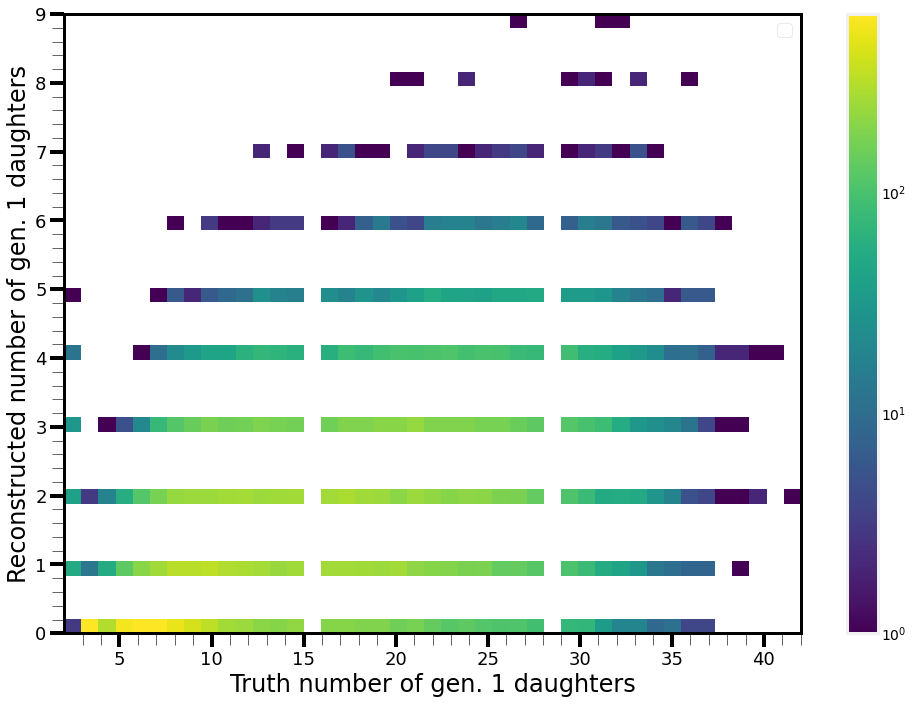

In [8]:
def get_gen2_counts(events, mother_id=None):
    if mother_id is not None:
        id_mask = events.trueParticlesBT.pdg == mother_id
    else:
        id_mask = True

    beam_particles = np.logical_and(
        events.trueParticlesBT.mother == 1,
        id_mask)
    mother_numbers = events.trueParticlesBT.number[beam_particles]
    candidates = evts.trueParticlesBT.mother[evts.trueParticlesBT.mother != 1]

    def get_counts(zipped):
        return 0 + sum([sum(zipped['candidates'] == pfo) for pfo in np.intersect1d(
            zipped['mother'],
            zipped['candidates'])])

    return ak.Array(map(
        get_counts,
        ak.zip(
            {"mother": mother_numbers, "candidates": candidates},
            depth_limit=1)))

truth_gen1_particles = np.logical_and(evts.trueParticles.mother == 1,
                                      evts.trueParticles.number != 1)
true_gen1_daughters = np.logical_and(evts.trueParticlesBT.mother == 1,
                                     evts.trueParticlesBT.number != 1)
true_gen2_counts = get_gen2_counts(evts)
print(ak.sum(ak.values_astype(true_gen1_daughters, int), axis=1))
print(true_gen2_counts)
true_gen1_counts = ak.sum(ak.values_astype(true_gen1_daughters, int), axis=1)
n_beam_pfos = true_gen1_counts + true_gen2_counts
print(np.unique(n_beam_pfos, return_counts=True))
plt_conf.setup_figure()
plt.hist(n_beam_pfos, **plt_conf.gen_kwargs(type="hist", bins=plt_conf.get_bins(n_beam_pfos)))
plt_conf.format_axis(xlabel = "Daughters + granddaughters", ylabel="Count", ylog=False)
plt_conf.end_plot()
plt_conf.setup_figure()
plt.hist(true_gen1_counts, **plt_conf.gen_kwargs(type="hist", bins=plt_conf.get_bins(n_beam_pfos)))
plt_conf.format_axis(xlabel = "Number of Gen1 daughters", ylabel="Count", ylog=False)
plt_conf.end_plot()

truth_gen1_particle_counts = ak.sum(ak.values_astype(truth_gen1_particles, int), axis=1)
plt_conf.setup_figure()
print(np.max(true_gen2_counts))
h = plt.hist2d(truth_gen1_particle_counts, true_gen1_counts, max(np.max(truth_gen1_particle_counts), np.max(true_gen1_counts))+1, norm="log")
plt.colorbar(h[-1])
plt_conf.format_axis(xlabel="Truth number of gen. 1 daughters", ylabel="Reconstructed number of gen. 1 daughters")
plt_conf.end_plot()

In [12]:
evt_id = 121
print(len(evts.trueParticles.pdg[evt_id]))
print(evts.trueParticles.pdg[evt_id])
print(evts.trueParticles.number[evt_id])
print()
print(evts.trueParticlesBT.pdg[evt_id])
print(evts.trueParticlesBT.number[evt_id])

26
[211, 1000180400, 2212, 2212, 2212, 2212, ... 22, 2112, 2112, 22, 22, 1000100210]
[1, 716502, 716523, 716524, 716525, ... 716542, 716543, 716544, 716545, 716546]

[2212, 211, 2212, 2212, 22, -11]
[716525, 716527, 717303, 717404, 717466, 718548]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


6


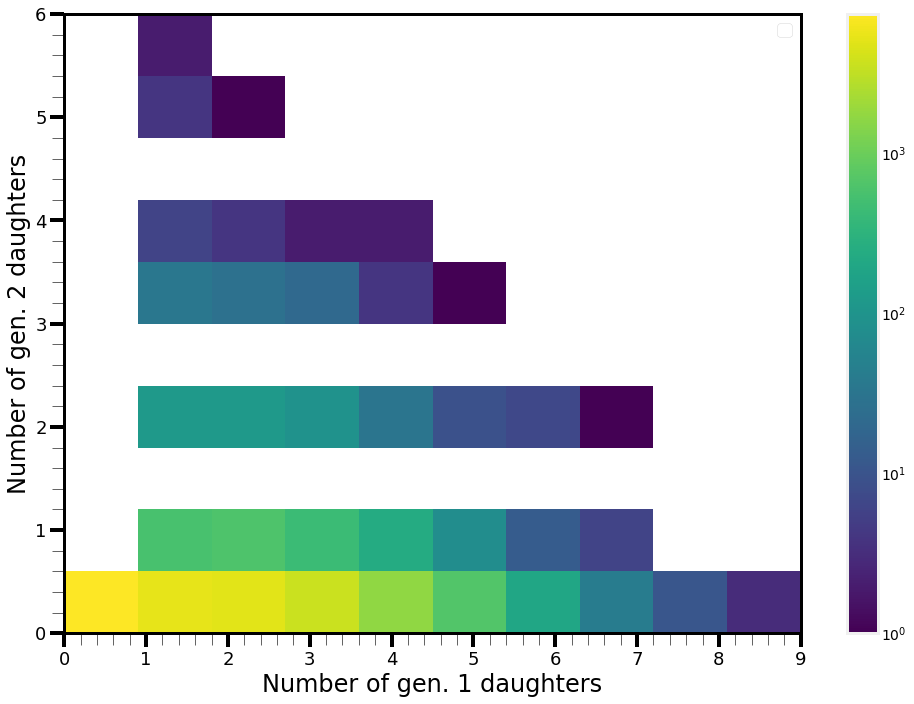

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


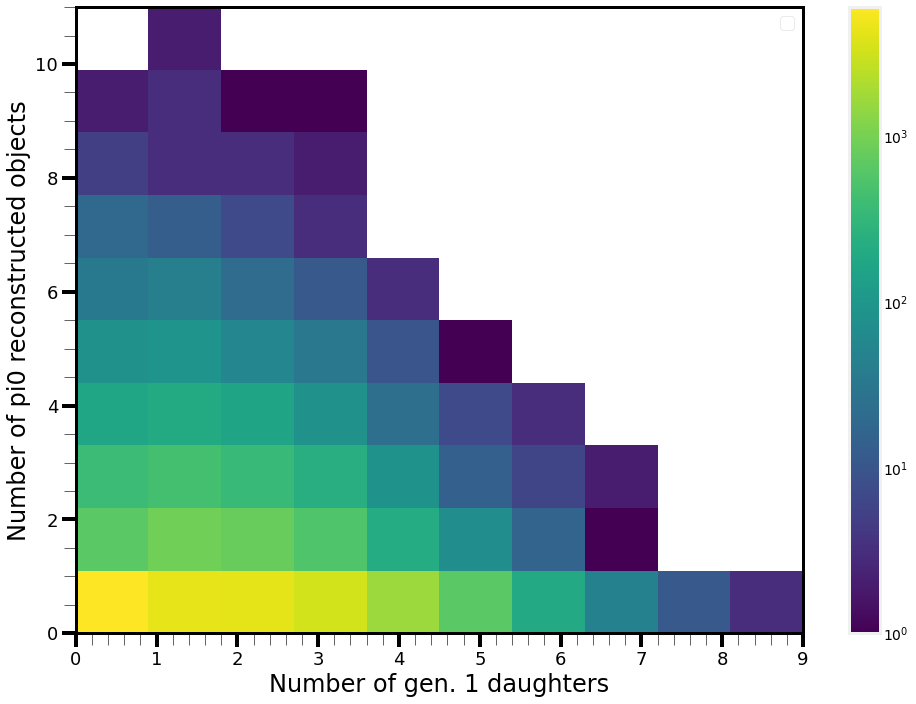

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


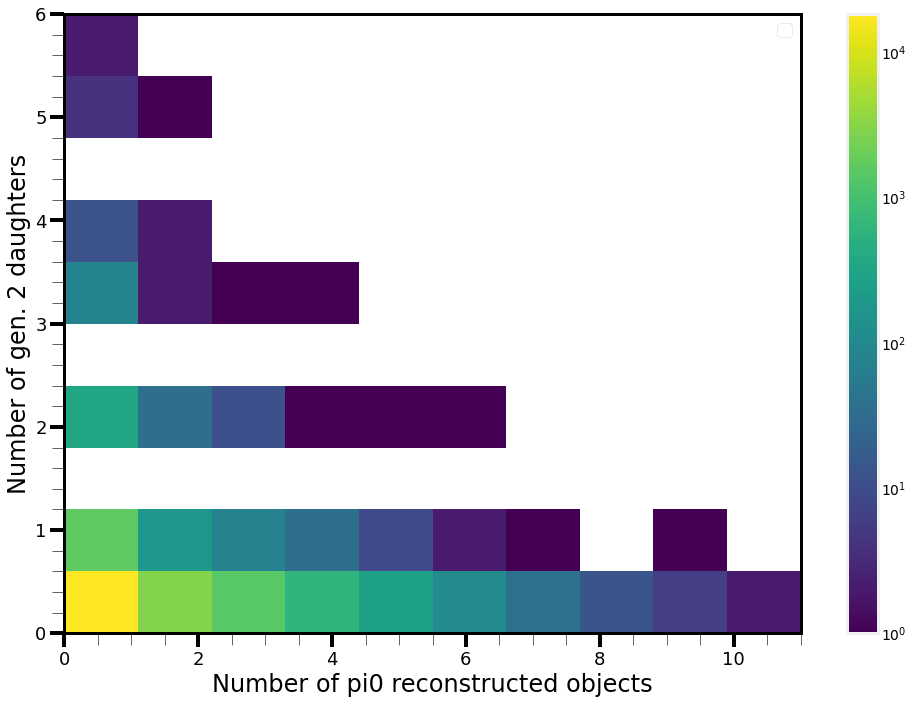

In [14]:
plt_conf.setup_figure()
print(np.max(true_gen2_counts))
h = plt.hist2d(true_gen1_counts, true_gen2_counts, max(np.max(true_gen2_counts), np.max(true_gen1_counts))+1, norm="log")
plt.colorbar(h[-1])
plt_conf.format_axis(xlabel="Number of gen. 1 daughters", ylabel="Number of gen. 2 daughters")
plt_conf.end_plot()

plt_conf.setup_figure()
h = plt.hist2d(true_gen1_counts, cnts2, max(np.max(true_gen2_counts), np.max(true_gen1_counts))+1, norm="log")
plt.colorbar(h[-1])
plt_conf.format_axis(xlabel="Number of gen. 1 daughters", ylabel="Number of pi0 reconstructed objects")
plt_conf.end_plot()

plt_conf.setup_figure()
h = plt.hist2d(cnts2, true_gen2_counts, max(np.max(true_gen2_counts), np.max(true_gen1_counts))+1, norm="log")
plt.colorbar(h[-1])
plt_conf.format_axis(xlabel="Number of pi0 reconstructed objects", ylabel="Number of gen. 2 daughters")
plt_conf.end_plot()

In [13]:
print(len(true_gen1_counts))
print(len(cnts))
print(len(cnts2))

26165
15685
26165


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]), array([2928, 7157, 4039, 1147,  285,   97,   21,    7,    3,    1]))
(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 11]), array([15847,  4515,  3211,  1510,   639,   270,   110,    41,    13,
           7,     2]))


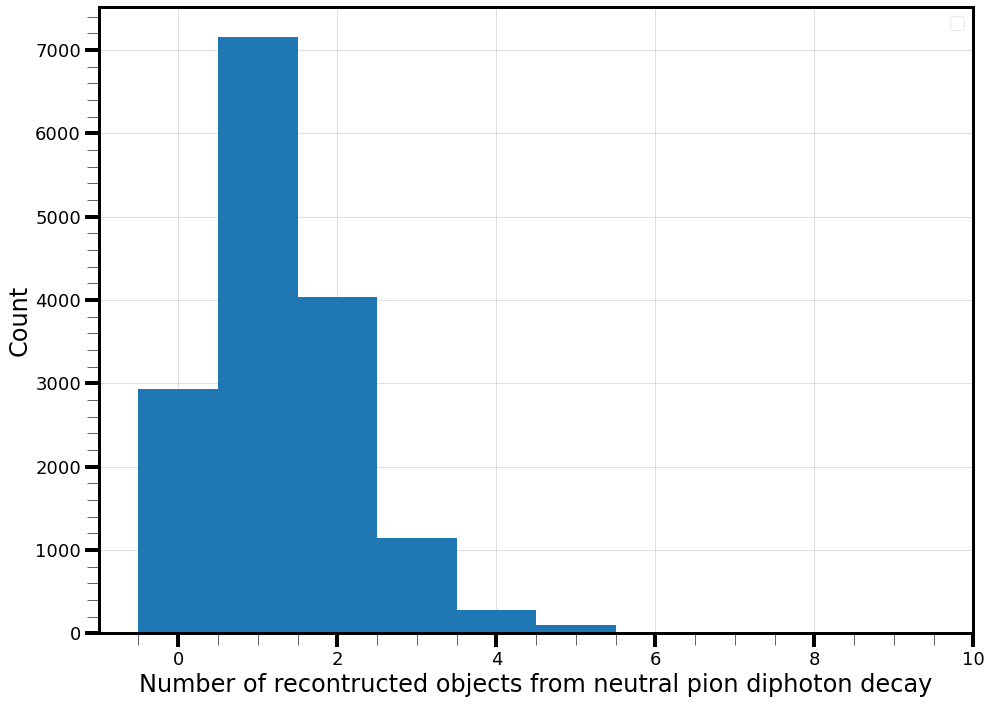

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


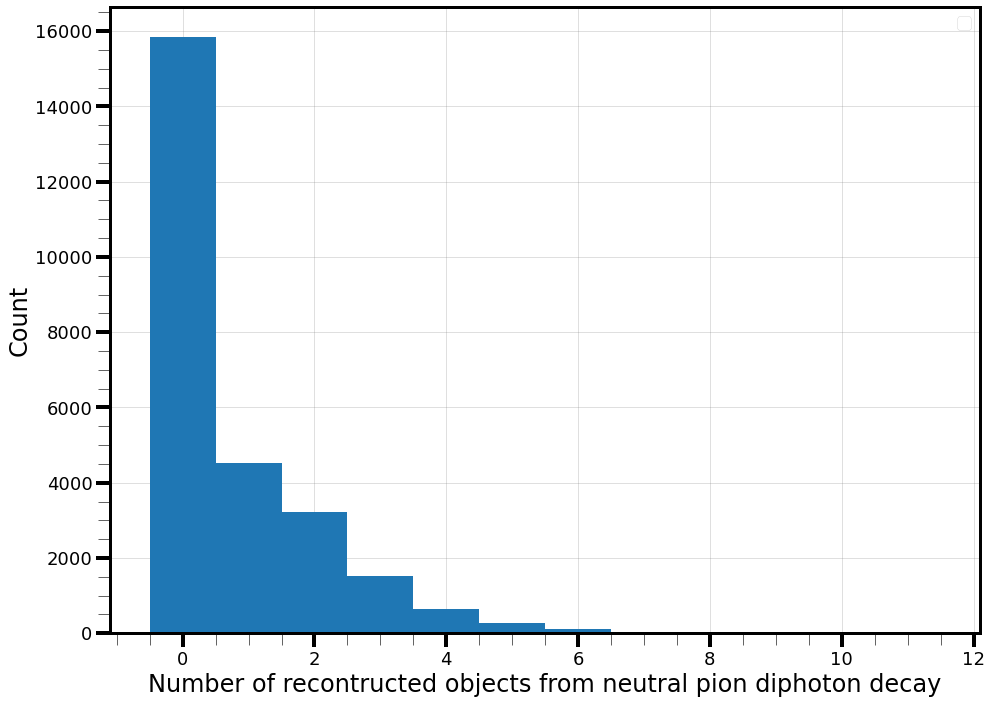

In [10]:
def get_counts(events):
    def get_two_count_pi0s(pi0s):
        pions, counts = np.unique(pi0s, return_counts=True)
        return pions[counts == 2]
    
    beam_pi0s = np.logical_and(
        events.trueParticles.mother == 1,
        events.trueParticles.pdg == 111)
    pi0_numbers = events.trueParticles.number[beam_pi0s]

    pi0_daughters = PFOSelection.get_mother_pdgs(events) == 111
    pi0_photon_mothers = events.trueParticles.mother[np.logical_and(
        events.trueParticles.pdg == 22,
        pi0_daughters)]

    reco_photon_mothers = events.trueParticlesBT.mother[events.trueParticlesBT.pdg == 22]

    def get_counts(zipped):
        return [sum(zipped['photon'] == pi) for pi in np.intersect1d(
            zipped['pi0'],
            get_two_count_pi0s(zipped['diphoton']))]

    return ak.Array(map(
        get_counts,
        ak.zip(
            {"pi0": pi0_numbers, "diphoton": pi0_photon_mothers, "photon": reco_photon_mothers},
            depth_limit=1)))

def get_counts_alt(events):
    def get_two_count_pi0s(pi0s):
        pions, counts = np.unique(pi0s, return_counts=True)
        return pions[counts == 2]
    
    beam_pi0s = np.logical_and(
        events.trueParticles.mother == 1,
        events.trueParticles.pdg == 111)
    pi0_numbers = events.trueParticles.number[beam_pi0s]

    pi0_daughters = PFOSelection.get_mother_pdgs(events) == 111
    pi0_photon_mothers = events.trueParticles.mother[np.logical_and(
        events.trueParticles.pdg == 22,
        pi0_daughters)]

    reco_photon_mothers = events.trueParticlesBT.mother[events.trueParticlesBT.pdg == 22]

    def get_counts(zipped):
        return 0 + sum([sum(zipped['photon'] == pi) for pi in np.intersect1d(
            zipped['pi0'],
            get_two_count_pi0s(zipped['diphoton']))])

    return ak.Array(map(
        get_counts,
        ak.zip(
            {"pi0": pi0_numbers, "diphoton": pi0_photon_mothers, "photon": reco_photon_mothers},
            depth_limit=1)))

cnts = ak.ravel(get_counts(evts))
cnts2 = ak.ravel(get_counts_alt(evts))
print(np.unique(cnts, return_counts=True))
print(np.unique(cnts2, return_counts=True))
plt_conf.setup_figure()
plt.hist(cnts, **plt_conf.gen_kwargs(type="hist", histtype="bar", index=0, bins=max(cnts)+1, range=(-0.5, max(cnts)+0.5)))
plt_conf.format_axis(xlabel="Number of recontructed objects from neutral pion diphoton decay", ylabel="Count")
plt_conf.end_plot()
plt_conf.setup_figure()
plt.hist(cnts2, **plt_conf.gen_kwargs(type="hist", histtype="bar", index=0, bins=max(cnts2)+1, range=(-0.5, max(cnts2)+0.5)))
plt_conf.format_axis(xlabel="Number of recontructed objects from neutral pion diphoton decay", ylabel="Count")
plt_conf.end_plot()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


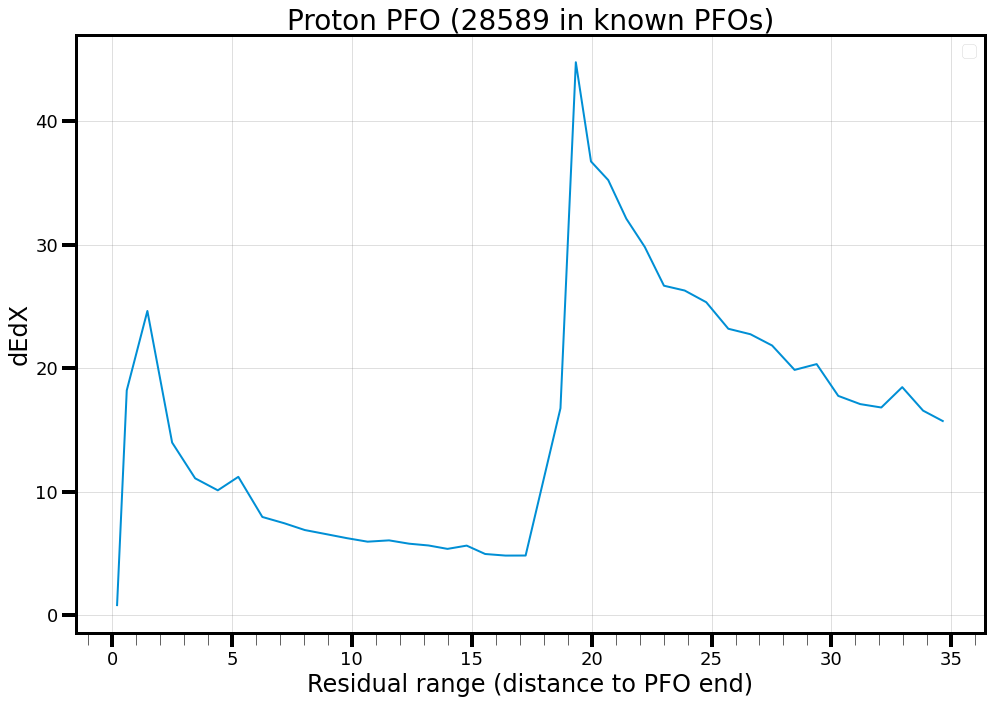

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


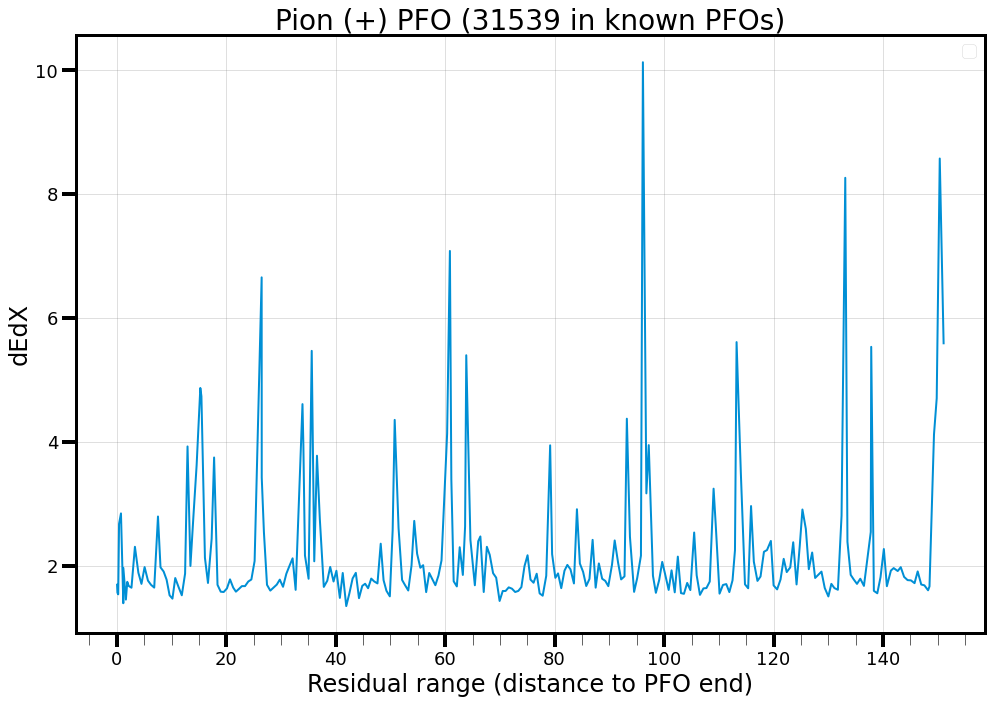

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


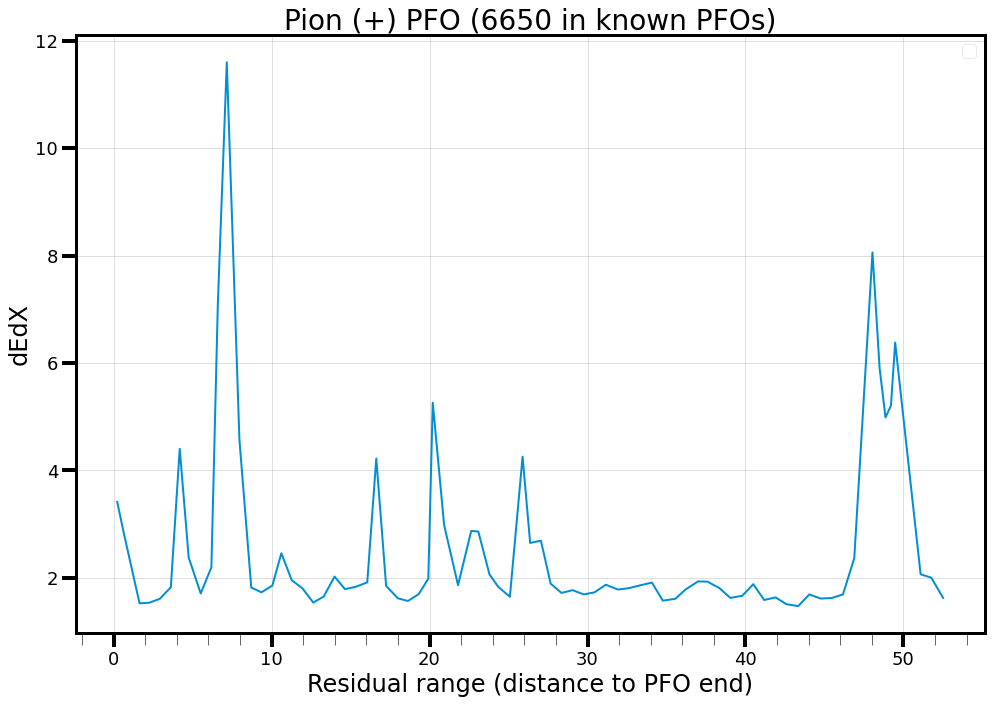

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


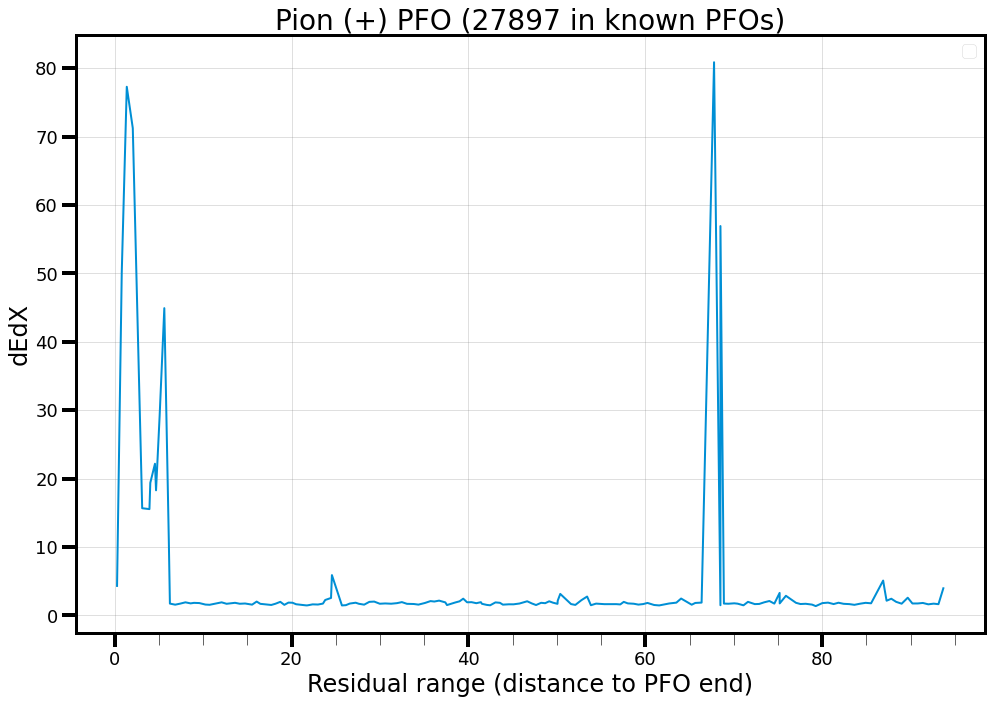

In [32]:
for _ in range(4):
    ind = np.random.randint(0, known_n_pfos)
    plt_conf.setup_figure(title=f"{pfo_type[known_pfo_catalogue[ind]]} PFO ({ind} in known PFOs)")
    plt.plot(known_flat_res[ind], known_flat_dedx[ind], **plt_conf.gen_kwargs())
    plt_conf.format_axis(xlabel = "Residual range (distance to PFO end)", ylabel="dEdX", ylog=False)
    plt_conf.end_plot()

In [ ]:
for _ in range(100):
    ind = np.random.randint(0, known_n_pfos)
    plt_conf.setup_figure(title=f"{pfo_type[known_pfo_catalogue[ind]]} PFO ({ind} in known PFOs)")
    plt.plot(known_flat_res[ind], known_flat_dedx[ind], **plt_conf.gen_kwargs())
    plt_conf.format_axis(xlabel = "Residual range (distance to PFO end)", ylabel="dEdX", ylog=False)
    plt_conf.end_plot()

In [12]:
def split_energy(dedx, res, split=0.1, abs_split=None):
    if abs_split is None:
        length = res[-1]
        end_mask = res <= split*length
    else:
        end_mask = res <= abs_split
    end_e = np.sum(dedx[end_mask])
    start_e = np.sum(dedx[np.logical_not(end_mask)])
    return [end_e, start_e]

def variation(f, x):
    if len(f) < 3:
        return -999.
    dxs = x[1:] - x[:-1]
    dfdx = (f[1:] - f[:-1])/dxs
    d2fdx2 = (dfdx[1:] - dfdx[:-1])/dxs[1:]
    return np.var(d2fdx2)

def deposited_charge(dedx, *args):
    return np.sum(dedx)


In [12]:
def split_energy_full(dedx, res, split=0.1, abs_split=None):
    if abs_split is None:
        abs_split = split*ak.max(res, axis=-1)#[...,-1]
    end_mask = res <= abs_split
    end_e = ak.sum(dedx[end_mask], axis=-1)
    start_e = ak.sum(dedx[np.logical_not(end_mask)], axis=-1)
    return [end_e, start_e]

def get_split_reco_energies(events: Master.Data, split=0.1, abs_split=None):
    if abs_split is None:
        abs_split = split*events.recoParticles.track_len
    end_mask = events.recoParticles.residual_range <= abs_split
    end_e = ak.sum(events.recoParticles.track_dEdX[end_mask], axis=-1)
    start_e = ak.sum(events.recoParticles.track_dEdX[np.logical_not(end_mask)], axis=-1)
    return [end_e, start_e]

def variation_full(f, x):
    # if len(f) < 3:
    #     return -999.
    dxs = x[...,1:] - x[...,:-1]
    good_dxs = dxs != 0.
    dxs = dxs[good_dxs]
    dfdx = (f[...,1:] - f[...,:-1])[good_dxs]/dxs
    d2fdx2 = (dfdx[...,1:] - dfdx[...,:-1])/dxs[...,1:]
    return ak.fill_none(ak.var(d2fdx2, axis=-1), 0., axis=-1)

def get_dedx_variation(events):
    return variation_full(events.recoParticles.track_dEdX, events.recoParticles.residual_range)

def get_deposited_charge_full(events):
    return np.sum(events.recoParticles.track_dEdX, axis=-1)

In [13]:
# props_for_bdt = {
#     "track": evts.recoParticles.track_score,
#     "nhits": evts.recoParticles.n_hits,
#     "dEdx": PFOSelection.Median(evts.recoParticles.track_dEdX),
#     "chi2_pion": evts.recoParticles.track_chi2_pion,
#     # "chi2_pion_reduced": evts.recoParticles.track_chi2_pion/evts.recoParticles.track_chi2_pion_ndof,
#     # "chi2_pion_dof": evts.recoParticles.track_chi2_pion_ndof,
#     "chi2_dof": evts.recoParticles.track_chi2_pion_ndof,
#     "chi2_muon": evts.recoParticles.track_chi2_muon,
#     # "chi2_muon_reduced": evts.recoParticles.track_chi2_muon/evts.recoParticles.track_chi2_muon_ndof,
#     # "chi2_muon_dof": evts.recoParticles.track_chi2_muon_ndof,
#     "chi2_proton": evts.recoParticles.track_chi2_proton,
#     # "chi2_proton_reduced": evts.recoParticles.track_chi2_proton/evts.recoParticles.track_chi2_proton_ndof,
#     # "chi2_proton_dof": evts.recoParticles.track_chi2_proton_ndof,
#     "length": evts.recoParticles.track_len}
end_e, start_e = get_split_reco_energies(evts, split=0.25)
props_for_bdt_reduced = {
    "track": evts.recoParticles.track_score,
    "nhits": evts.recoParticles.n_hits,
    "dEdx_med": PFOSelection.Median(evts.recoParticles.track_dEdX),
    "dEdx_sum": get_deposited_charge_full(evts),
    "dEdx_var": get_dedx_variation(evts),
    "dEdx_end25%":end_e,
    "dEdx_start75%":start_e,
    # "chi2_pion": evts.recoParticles.track_chi2_pion,
    "chi2_pion_reduced": evts.recoParticles.track_chi2_pion/evts.recoParticles.track_chi2_pion_ndof,
    # "chi2_pion_dof": evts.recoParticles.track_chi2_pion_ndof,
    # "chi2_dof": evts.recoParticles.track_chi2_pion_ndof,
    # "chi2_muon": evts.recoParticles.track_chi2_muon,
    "chi2_muon_reduced": evts.recoParticles.track_chi2_muon/evts.recoParticles.track_chi2_muon_ndof,
    # "chi2_muon_dof": evts.recoParticles.track_chi2_muon_ndof,
    # "chi2_proton": evts.recoParticles.track_chi2_proton,
    "chi2_proton_reduced": evts.recoParticles.track_chi2_proton/evts.recoParticles.track_chi2_proton_ndof,
    # "chi2_proton_dof": evts.recoParticles.track_chi2_proton_ndof,
    "length": evts.recoParticles.track_len}
# old_props_for_bdt = {
#     "track": evts.recoParticles.track_score,
#     "nhits": evts.recoParticles.n_hits,
#     "dEdx": PFOSelection.Median(evts.recoParticles.track_dEdX),
#     "chi2_pion": evts.recoParticles.track_chi2_pion,
#     "chi2_pion_dof": evts.recoParticles.track_chi2_pion_ndof,
#     # "chi2_dof": evts.recoParticles.track_chi2_pion_ndof,
#     "chi2_muon": evts.recoParticles.track_chi2_muon,
#     "chi2_muon_dof": evts.recoParticles.track_chi2_muon_ndof,
#     "chi2_proton": evts.recoParticles.track_chi2_proton,
#     "chi2_proton_dof": evts.recoParticles.track_chi2_proton_ndof,
#     "length": evts.recoParticles.track_len}

# def gen_features_from_dict(d):
#     for i, val in enumerate(d.values()):
#         if i == 0:
#             features = np.zeros((ak.count(val), len(d)))
#         value = ak.ravel(val)
#         features[:, i] = value
#     return features

# def separate_train_test(truth, props_to_use: dict, test_frac=0.2):
#     if not isinstance(truth, ak.Array):
#         flat_truth = np.zeros(ak.count(truth[0]), dtype=int)
#         for i, t_mask in enumerate(truth):
#             flat_truth[ak.ravel(t_mask)] = i+1
#     else:
#         flat_truth = ak.ravel(truth)
#     n_tot = len(flat_truth)
#     num_train = int(len(flat_truth) *(1-test_frac))
#     print(f"{n_tot} data points found, separated into {num_train} "
#           + f"training points and {n_tot - num_train} test_points.")
#     train_classes = ak.values_astype(flat_truth[:num_train], int)
#     test_truth = flat_truth[num_train:]
#     train_data = np.zeros((num_train, len(props_to_use)))
#     test_props = {}
#     for i, item in enumerate(props_to_use.items()):
#         val = ak.ravel(item[1])
#         train_data[:, i] = val[:num_train]
#         test_props[item[0]] = val[num_train:]
#     return train_classes, train_data, test_truth, test_props

# def wrap_bdt_args(bdt_fit_func, selector: seval.SelectorEvaluator):
#     props_dict = selector.properties
#     ind_dict = {}
#     for i, key in enumerate(props_dict.keys()):
#         if i == 0:
#             num_pfos = len(ak.ravel(props_dict[key]))
#         ind_dict[key] = i
#     num_props = len(props_dict)
#     def func(use_props):
#         bdt_arg = np.zeros((num_pfos, num_props))
#         for key, val in use_props.items():
#             if val is not None:
#                 bdt_arg[:, ind_dict[key]] = ak.ravel(val)
#         return bdt_fit_func(bdt_arg)
#     return func

# def bdt_probs(bdt_obj):
#     def func(data):
#         return bdt_obj.predict_proba(data)[:,1]
#     return func

# def convert_dict_to_array(props_dict):
#     for i, val in enumerate(props_dict.values()):
#         if i == 0:
#             res = np.zeros((len(ak.ravel(val)), len(props_dict)))
#         res[:, i] = ak.ravel(val)
#     return res

# old_train_class, old_train_data, old_test_truth, old_test_props = separate_train_test(piplus_truth, old_props_for_bdt)
# train_class, train_data, test_truth, test_props = separate_train_test(piplus_truth, props_for_bdt)
# train_class_reduced, train_data_reduced, test_truth_reduced, test_props_reduced = separate_train_test(piplus_truth, props_for_bdt_reduced)
train_class_multi, train_data_multi, test_truth_multi, test_props_multi = separate_train_test(
    (proton_truth, any_mu_truth, photon_truth, pi_truth), props_for_bdt_reduced)
test_truth_multi = test_truth_multi == 4

119568 data points found, separated into 95654 training points and 23914 test_points.


In [62]:
ak.sum(ak.values_astype(gen1_daughter_truth, int))

43021

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


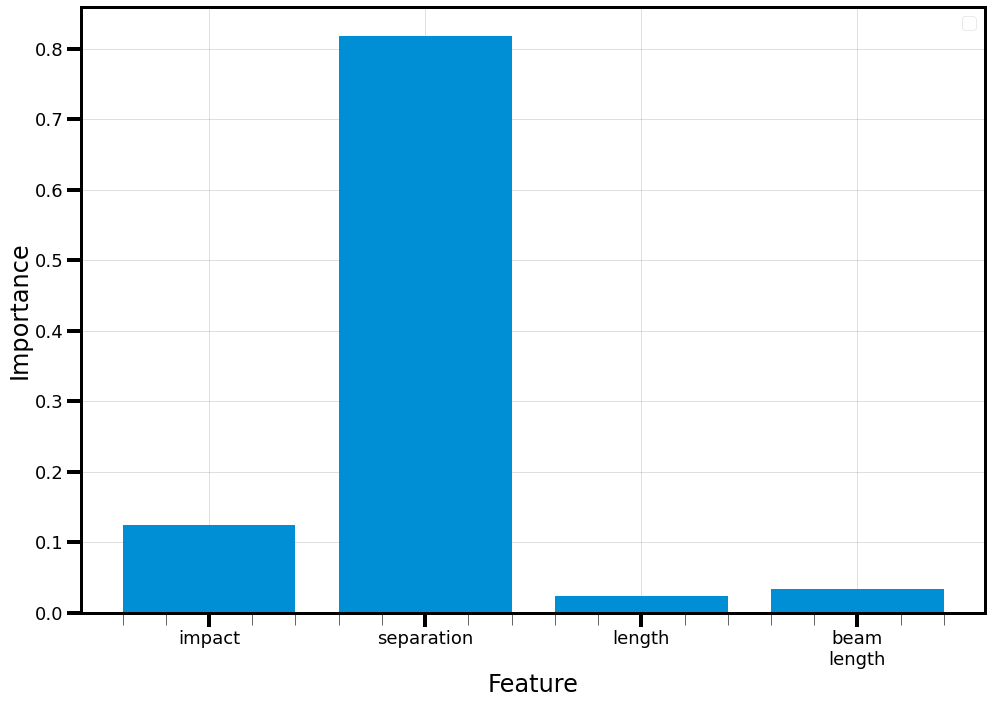

In [68]:
plt_conf.setup_figure()
plt.bar([lab.replace('_', '\n') for lab in test_props_geom.keys()], bdt_geom.feature_importances_)
plt_conf.format_axis(ylog=False, xlabel="Feature", ylabel="Importance")
plt_conf.end_plot()

In [ ]:
bdt_geom_eval.make_property_correlations("beam_length", style="log")
bdt_geom_eval.make_property_correlations("separation", style="quartile_log")

In [14]:
print(f'pion chi^2 == -999.: {np.sum(props_for_bdt["chi2_pion"] == -999.)}')
print(f'pion chi^2 == 9999.: {np.sum(props_for_bdt["chi2_pion"] == 9999.)}')
print(f'pion chi^2 > 9999.: {np.sum(props_for_bdt["chi2_pion"] > 9999.)}')
print()
print(f'muon chi^2 == -999.: {np.sum(props_for_bdt["chi2_muon"] == -999.)}')
print(f'muon chi^2 == 9999.: {np.sum(props_for_bdt["chi2_muon"] == 9999.)}')
print(f'muon chi^2 > 9999.: {np.sum(props_for_bdt["chi2_muon"] > 9999.)}')
print()
print(f'proton chi^2 == -999.: {np.sum(props_for_bdt["chi2_proton"] == -999.)}')
print(f'proton chi^2 == 9999.: {np.sum(props_for_bdt["chi2_proton"] == 9999.)}')
print(f'proton chi^2 > 9999.: {np.sum(props_for_bdt["chi2_proton"] > 9999.)}')

pion chi^2 == -999.: 364
pion chi^2 == 9999.: 4342
pion chi^2 > 9999.: 1

muon chi^2 == -999.: 364
muon chi^2 == 9999.: 4342
muon chi^2 > 9999.: 0

proton chi^2 == -999.: 364
proton chi^2 == 9999.: 4342
proton chi^2 > 9999.: 8172


In [75]:
print(np.sum(test_props["track"] < 0.5))
print(np.min(test_props["track"]))

9444
6.956794550205814e-06


In [71]:
print(np.min(evts.recoParticles.track_score))
print(np.sum(evts.recoParticles.track_score < 0.5))
print(np.sum(evts.recoParticles.track_score > 0.5))
print(len(ak.ravel(evts.recoParticles.track_score)))

6.263268048645187e-08
47244
72680
119924


In [10]:
bdt1 = ensemble.GradientBoostingClassifier()
bdt1.fit(train_data, train_class)

In [11]:
bdt1.score(convert_dict_to_array(test_props), ak.values_astype(test_truth, int))

0.8854700854700854

In [12]:
bdt1.predict_proba(convert_dict_to_array(test_props))

array([[0.60141834, 0.39858166],
       [0.55928289, 0.44071711],
       [0.98960535, 0.01039465],
       ...,
       [0.98520768, 0.01479232],
       [0.93395991, 0.06604009],
       [0.93292404, 0.06707596]])

In [13]:
bdt_probs(bdt1)(convert_dict_to_array(test_props))

array([0.39858166, 0.44071711, 0.01039465, ..., 0.01479232, 0.06604009,
       0.06707596])

In [37]:
from importlib import reload
reload(seval)

<module 'python.analysis.SelectionEvaluation' from '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/SelectionEvaluation.py'>

In [26]:
bdt_reduced = ensemble.GradientBoostingClassifier()
bdt_reduced.fit(train_data_reduced, train_class_reduced)

GradientBoostingClassifier()

In [ ]:
bdt_reduced_eval = seval.SelectorEvaluator(test_truth_reduced, test_props_reduced)
bdt_reduced_eval.add_metric("bdt_reduced_0.3", wrap_bdt_args(bdt_probs(bdt_reduced), bdt_reduced_eval), threshold=0.3)
bdt_reduced_eval.make_metric_summary("bdt_reduced_0.3")

In [ ]:
bdt_reduced_eval.make_metric_summary("bdt_reduced_0.3", style="quartile_rejected")

In [ ]:
bdt_reduced_eval.make_property_correlations("chi2_pion_reduced", style="quartile_log")
bdt_reduced_eval.make_property_correlations("nhits", style="quartile_log")

In [14]:
bdt_classify = ensemble.GradientBoostingClassifier()
bdt_classify.fit(train_data_multi, train_class_multi)

GradientBoostingClassifier()

In [29]:
test_props_format = gen_features_from_dict(test_props_multi)

In [33]:
print(np.unique(bdt_classify.predict(test_props_format), return_counts=True))
print(np.unique(bdt_classify.predict(test_props_format)[test_truth_multi], return_counts=True))

(array([0, 1, 2, 3]), array([19125,  1655,    14,  3191]))
(array([0, 1, 3]), array([2256,   99, 1952]))


In [50]:
bdt_classify.predict_proba(gen_features_from_dict(test_props_multi)).shape

(23914, 5)

In [34]:
bdt_classify.predict_proba(test_props_format)[test_truth_multi, :]

array([[4.33425049e-01, 2.15604597e-02, 2.65387460e-03, 5.42360617e-01],
       [2.58320749e-01, 4.26414334e-02, 1.33493716e-03, 6.97702880e-01],
       [3.76718600e-01, 2.42776568e-02, 1.97876293e-03, 5.97024980e-01],
       ...,
       [3.28673837e-01, 2.47944977e-02, 1.78874778e-03, 6.44742917e-01],
       [9.70631826e-01, 8.60435616e-03, 1.54443464e-04, 2.06093739e-02],
       [5.25906836e-01, 1.57165079e-01, 4.73322215e-04, 3.16454763e-01]])

In [23]:
np.unique(bdt_classify.predict(test_props_format), return_counts=True)

(array([0, 1, 2, 3]), array([19125,  3191,    14,  1655]))

In [26]:
np.unique(bdt_classify.predict(test_props_format)[test_truth_multi], return_counts=True)

(array([0, 1, 3]), array([2256, 1952,   99]))

In [25]:
bdt_classify.predict_proba(test_props_format)[test_truth_multi, :]

array([[4.33425049e-01, 5.42360617e-01, 2.65387460e-03, 2.15604597e-02],
       [2.58320749e-01, 6.97702880e-01, 1.33493716e-03, 4.26414334e-02],
       [3.76718600e-01, 5.97024980e-01, 1.97876293e-03, 2.42776568e-02],
       ...,
       [3.28673837e-01, 6.44742917e-01, 1.78874778e-03, 2.47944977e-02],
       [9.70631826e-01, 2.06093739e-02, 1.54443464e-04, 8.60435616e-03],
       [5.25906836e-01, 3.16454763e-01, 4.73322215e-04, 1.57165079e-01]])

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


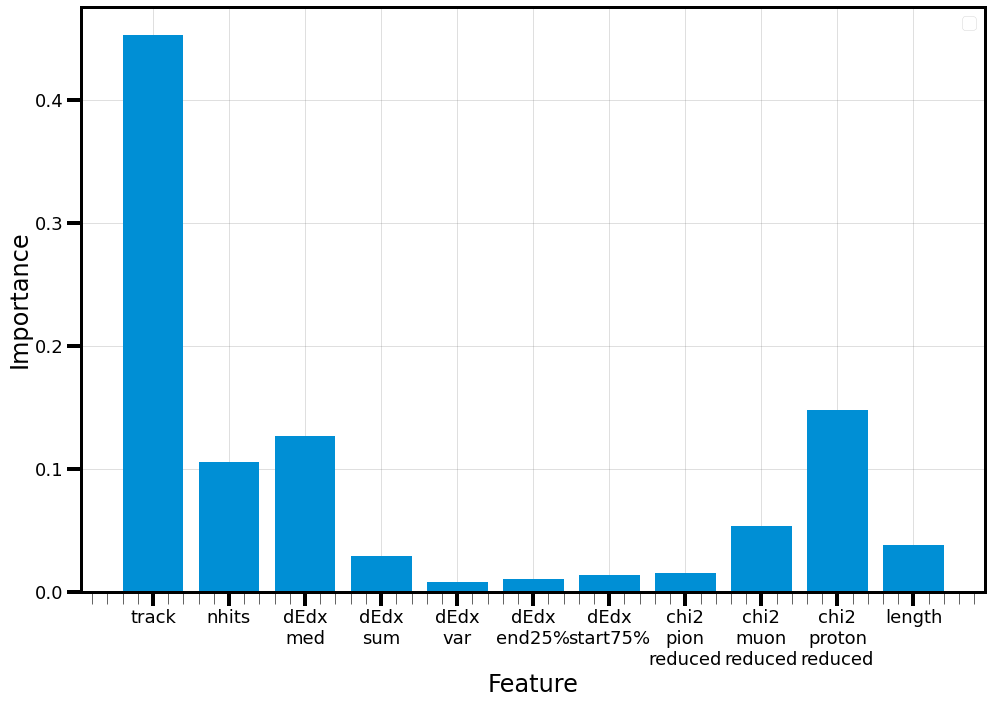

In [30]:
plt_conf.setup_figure()
plt.bar([lab.replace('_', '\n') for lab in test_props_multi.keys()], bdt_classify.feature_importances_)
plt_conf.format_axis(ylog=False, xlabel="Feature", ylabel="Importance")
plt_conf.end_plot()

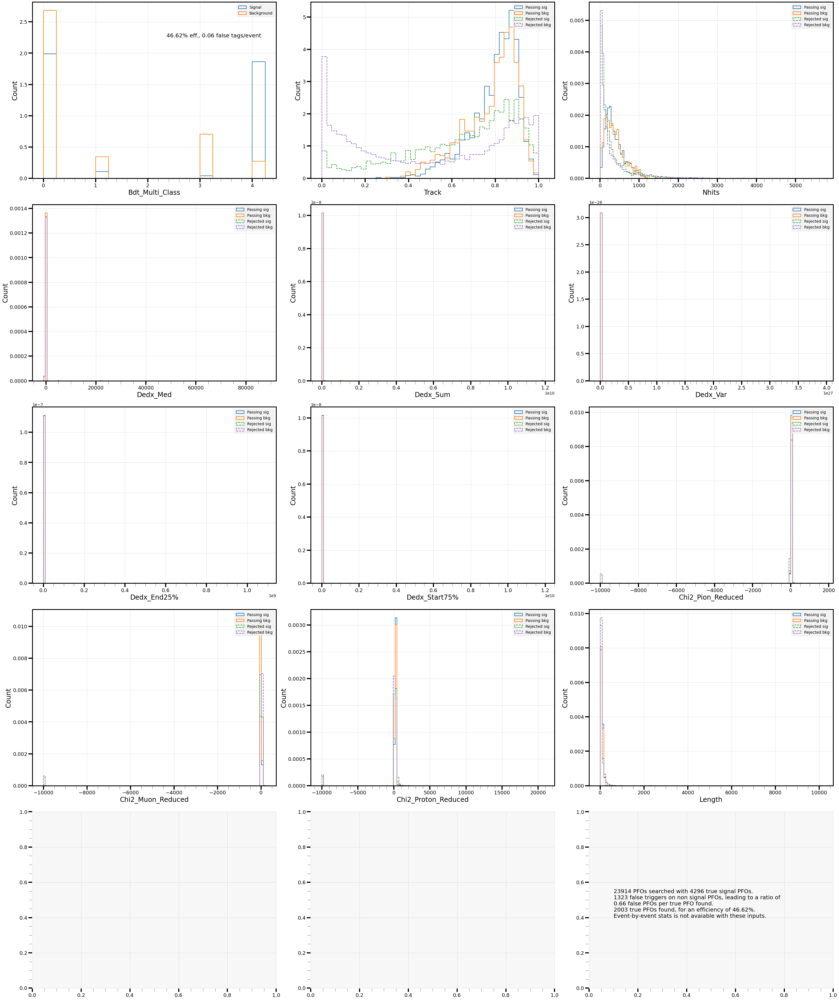

In [51]:
bdt_multi_eval = seval.SelectorEvaluator(test_truth_multi, test_props_multi)
bdt_multi_eval.add_metric("bdt_multi_class", wrap_bdt_args(lambda data: bdt_classify.predict(data), bdt_multi_eval), threshold=3.5)
bdt_multi_eval.make_metric_summary("bdt_multi_class")

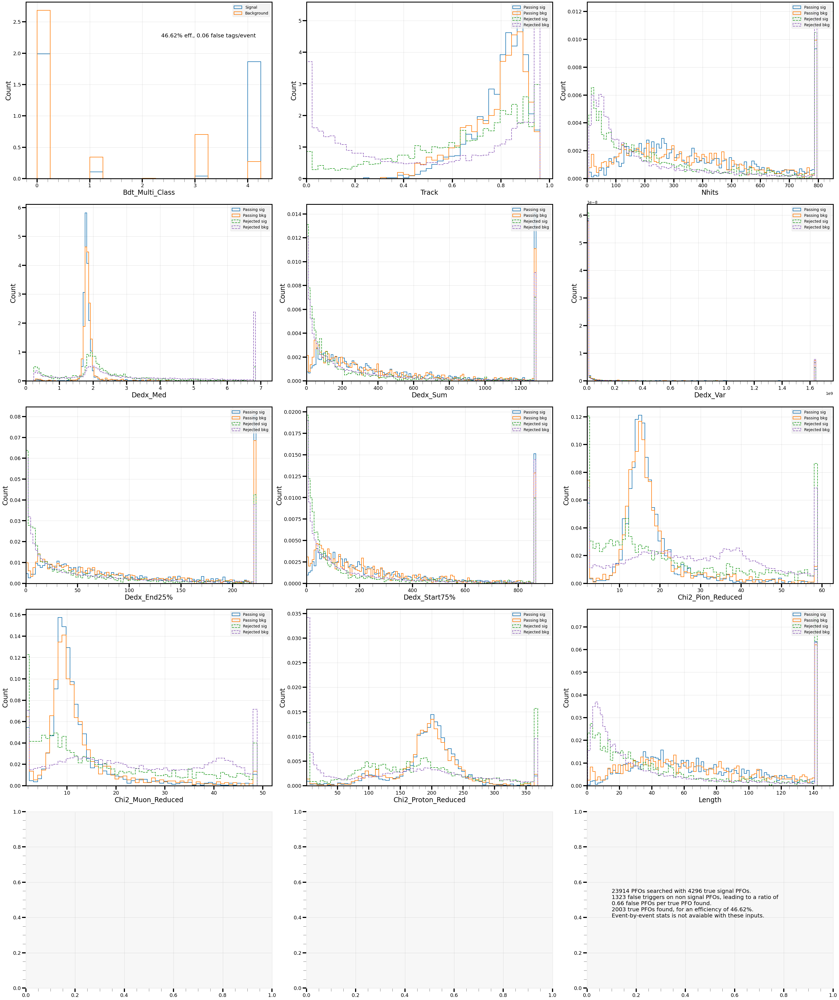

In [32]:
bdt_multi_eval.make_metric_summary("bdt_multi_class", style="quartile_rejected_density")

In [ ]:
bdt_multi_eval.make_property_correlations("track", style="quartile_log")

In [ ]:
bdt_multi_eval.make_property_correlations("dEdx_med", style="quartile_log")

In [ ]:
bdt_multi_eval.make_property_correlations("chi2_proton_reduced", style="quartile_log")

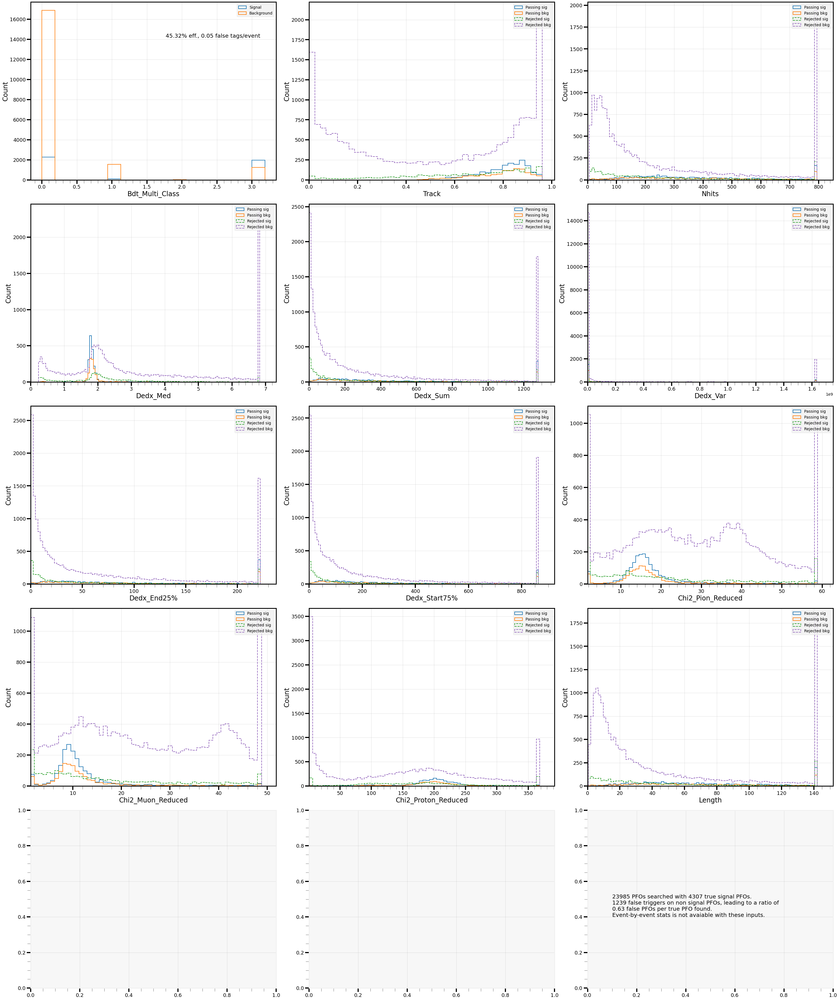

In [41]:
bdt_multi_eval.make_metric_summary("bdt_multi_class", style="quartile_rejected")

In [ ]:
bdt_multi_eval.make_metric_summary("bdt_multi_class", style="quartile_rejected_density")

## Event type selection
Takes the leading PFOs by some combination of previous cuts, and tries to identify the event type

Event types as follows:
- Absorbtion - no pi0s
- Charge Exchange
- Single pion production
- Multi pion production

We choose to take the 4 most shower-like PFOs, and 4 most track like PFOs.
Each PFO can only get assigned to one or the other.
Missing PFOs are assigned parameters based upon what is least realsitic, i.e. Median dEdx -> 0, other physical params to large (inf?).

Variables passed for each PFO:
- Beam like score from beam BDT
- Each of the 4 classifications from classifer BDT
- Track score
- Impact parameter
- Beam separation
- Median dEdx
- Pion reduced chi^2

In [21]:
beam_props = ["length", "alt_length", "beam_impact_params", "beam_separations",
              "beam_start_X", "beam_start_Y", "beam_start_Z", "track",
              "track_start_X", "track_start_Y", "track_start_Z",
              "track_dir_X", "track_dir_Y", "track_dir_Z",
              "track_end_X", "track_end_Y", "track_end_Z",
              "shower_start_X", "shower_start_Y", "shower_start_Z",
              "shower_dir_X", "shower_dir_Y", "shower_dir_Z"]
classify_props = ["track", "nhits",
                  "dEdx_med", "dEdx_sum", "dEdx_var", "dEdx_end25%", "dEdx_start75%",
                  "chi2_pion_reduced", "chi2_muon_reduced", "chi2_proton_reduced", "length"]

event_props = ["beam_score", "proton_score", "muon_score", "photon_score", "pion_score", #"other_score",
               "track", "beam_impact_params", "beam_separations", "dEdx_med", "chi2_pion_reduced"]

all_props = {
    "track": evts.recoParticles.track_score,
    "nhits": evts.recoParticles.n_hits,
    "dEdx_med": PFOSelection.Median(evts.recoParticles.track_dEdX),
    "dEdx_sum": get_deposited_charge_full(evts),
    "dEdx_var": get_dedx_variation(evts),
    "dEdx_end25%":end_e,
    "dEdx_start75%":start_e,
    "chi2_pion_reduced": evts.recoParticles.track_chi2_pion/evts.recoParticles.track_chi2_pion_ndof,
    "chi2_muon_reduced": evts.recoParticles.track_chi2_muon/evts.recoParticles.track_chi2_muon_ndof,
    "chi2_proton_reduced": evts.recoParticles.track_chi2_proton/evts.recoParticles.track_chi2_proton_ndof,
    "length": evts.recoParticles.track_len,
    "alt_length": evts.recoParticles.track_len_alt,
    "beam_impact_params": PFOSelection.find_beam_impact_parameters(evts),
    "beam_separations": PFOSelection.find_beam_separations(evts),
    "beam_start_X":evts.recoParticles.beam_endPos.x*ak.ones_like(evts.recoParticles.track_start_pos.x),
    "beam_start_Y":evts.recoParticles.beam_endPos.y*ak.ones_like(evts.recoParticles.track_start_pos.x),
    "beam_start_Z":evts.recoParticles.beam_endPos.z*ak.ones_like(evts.recoParticles.track_start_pos.x),
    "track_start_X": evts.recoParticles.track_start_pos.x,
    "track_start_Y": evts.recoParticles.track_start_pos.y,
    "track_start_Z": evts.recoParticles.track_start_pos.z,
    "track_dir_X": evts.recoParticles.track_start_dir.x,
    "track_dir_Y": evts.recoParticles.track_start_dir.y,
    "track_dir_Z": evts.recoParticles.track_start_dir.z,
    "track_end_X": evts.recoParticles.track_end_pos.x,
    "track_end_Y": evts.recoParticles.track_end_pos.y,
    "track_end_Z": evts.recoParticles.track_end_pos.z,
    "shower_start_X": evts.recoParticles.shower_start_pos.x,
    "shower_start_Y": evts.recoParticles.shower_start_pos.y,
    "shower_start_Z": evts.recoParticles.shower_start_pos.z,
    "shower_dir_X": evts.recoParticles.shower_direction.x,
    "shower_dir_Y": evts.recoParticles.shower_direction.y,
    "shower_dir_Z": evts.recoParticles.shower_direction.z,
    "beam_score": None,
    "other_score": None,
    "proton_score": None,
    "muon_score": None,
    "photon_score": None,
    "pion_score": None}

all_props["beam_score"] = bdt_geom.predict_proba(gen_features_from_dict(all_props, beam_props))[:, 1]
classify_scores = bdt_classify.predict_proba(gen_features_from_dict(all_props, classify_props))
all_props["other_score"] = classify_scores[:, 0]
all_props["proton_score"] = classify_scores[:, 1]
all_props["muon_score"] = classify_scores[:, 2]
all_props["photon_score"] = classify_scores[:, 3]
all_props["pion_score"] = classify_scores[:, 4]

In [65]:
# ns = evts.recoParticles.number
# pfo_counts = ak.local_index(ns, axis=-1)
# in_evt_counts = ak.count(ns, axis=1)
# unravel_ind = np.concatenate((np.zeros(1, dtype=int), np.cumsum(in_evt_counts)[:-1]), axis=0) + pfo_counts
# scores = ak.Array([
#     [all_props["pion_score"][ev], all_props["photon_score"][ev], all_props["beam_score"][ev]]
#     for ev in unravel_ind])
# pion_scores = scores[:, 0, :]
# photon_scores = scores[:, 1, :]
# beam_scores = scores[:, 2, :]

# pion_selector = ak.values_astype(pion_scores > photon_scores, bool)
# photon_selector = np.logical_not(pion_selector)
# pion_beam_order = ak.argsort(beam_scores[pion_selector], axis=-1)[:, :4]
# photon_beam_order = ak.argsort(beam_scores[photon_selector], axis=-1)[:, :4]
# pion_order = ak.argsort(pion_scores[pion_selector][pion_beam_order], axis=-1)
# photon_order = ak.argsort(photon_scores[photon_selector][photon_beam_order], axis=-1)
pion_inds = unravel_ind[pion_order]
photon_inds = unravel_ind[photon_order]
# pion_inds = ak.pad_none(unravel_ind[pion_order], 4, axis=-1)
# photon_inds = ak.pad_none(unravel_ind[photon_order], 4, axis=-1)


In [ ]:
def gen_event_selection_props(events, props, keys_to_use=None, n_pions=4, n_photons=4):
    if keys_to_use is not None:
        props = {key:val for key, val in props.items() if key in keys_to_use}

    ns = events.recoParticles.number
    pfo_counts = ak.local_index(ns, axis=-1)
    in_evt_counts = ak.count(ns, axis=1)
    unravel_ind = np.concatenate((np.zeros(1, dtype=int), np.cumsum(in_evt_counts)[:-1]), axis=0) + pfo_counts

    scores = ak.Array([
        [props["pion_score"][ev], props["photon_score"][ev], props["beam_score"][ev]]
        for ev in unravel_ind])
    pion_scores = scores[:, 0, :]
    photon_scores = scores[:, 1, :]
    beam_scores = scores[:, 2, :]

    pion_selector = pion_scores > photon_scores
    photon_selector = np.logical_not(pion_selector)
    pion_beam_order = ak.argsort(beam_scores[pion_selector], axis=-1)[:, :n_pions]
    photon_beam_order = ak.argsort(beam_scores[photon_selector], axis=-1)[:, :n_photons]
    pion_order = ak.argsort(pion_scores[pion_selector][pion_beam_order], axis=-1)
    photon_order = ak.argsort(photon_scores[photon_selector][photon_beam_order], axis=-1)
    pion_inds = unravel_ind[pion_order]
    photon_inds = unravel_ind[photon_order]
    np_pion_inds = ak.to_numpy(
        ak.fill_none(
            ak.pad_none(pion_inds, n_pions, axis=-1),
            -1))
    np_photon_inds = ak.to_numpy(
        ak.fill_none(
            ak.pad_none(photon_inds, n_photons, axis=-1),
            -1))
    np_inds = np.concatenate((np_pion_inds, np_photon_inds), axis=1)
    np_bad_mask = np_inds == -1
    np_inds[np_bad_mask] = 0

    evt_props = {}
    for key, val in props.items():
        if key in keys_to_use:
            evt_props[key] = ak.to_numpy(ak.ravel(val))[np_inds]
            evt_props[key][np_bad_mask] = np.nan
    # Add in a property which counts the number of pions/photons, but needs extra attention since this is event based, not PFO based
    return evt_props
    
def separate_evt_train_test(truth_classes, props, test_frac=0.2):
    truth = np.zeros(ak.count(truth_classes[0]), dtype=int)
    for i, t_mask in enumerate(truth_classes):
        truth[t_mask] = i
    n_tot = len(truth)
    num_train = int(n_tot * (1-test_frac))
    print(f"{n_tot} data points found, separated into {num_train} "
          + f"training points and {n_tot - num_train} test_points.")
    train_classes = ak.values_astype(truth[:num_train], int)
    test_truth = truth[num_train:]
    train_data = {}
    test_props = {}
    for i, item in enumerate(props.items()):
        key, val = item
        train_data[key] = val[:num_train]
        test_props[key] = val[num_train:]
    train_data = convert_evts_dict_to_array(train_data)
    return train_classes, train_data, test_truth, test_props


def convert_evts_dict_to_array(props_dict):
    for i, val in enumerate(props_dict.values()):
        if i == 0:
            n_particles = val.shape[1]
            res = np.zeros((val.shape[0], n_particles * len(props_dict)))
        res[:, i*n_particles:(i+1)*n_particles] = val
    return res

def wrap_evt_bdt_args(bdt_fit_func, selector: seval.SelectorEvaluator, imputer):
    props_dict = selector.properties
    bdt_props = {key:ak.zeros_like(val) for key, val in props_dict.items()}
    def func(use_props):
        for key, val in use_props.items():
            if val is not None:
                bdt_props[key] = val
        bdt_arg = convert_evts_dict_to_array(bdt_props)
        bdt_arg = imputer.transform(bdt_arg)
        return bdt_fit_func(bdt_arg)
    return func

In [70]:
train_class

<Array [1, 1, 3, 2, 2, 3, ... 2, 3, 3, 2, 3, 3] type='20932 * int64'>

In [68]:
np.unique(pion_counts[regions_dict["charge_exchange"]], return_counts=True)

(array([], dtype=int64), array([], dtype=int64))

In [24]:
np.unique(np.logical_and(pi0_counts >= 1, pion_counts == 0), return_counts=True)

(array([False,  True]), array([22580,  3585]))

In [26]:
from importlib import reload
reload(EventSelection)
pi0_counts = EventSelection.count_all_pi0s(evts)

In [29]:
evt_props = gen_event_selection_props(evts, all_props, keys_to_use=event_props, n_pions=4, n_photons=4)
pi0_counts = EventSelection.count_all_pi0s(evts)
pion_counts = EventSelection.count_non_beam_charged_pi(evts)
regions_dict = EventSelection.create_regions_new(pi0_counts, pion_counts)

train_class, train_data, test_class, test_data = separate_evt_train_test((regions_dict["absorption"], regions_dict["single_pion_production"], regions_dict["pion_production"], regions_dict["charge_exchange"]), evt_props)

26165 data points found, separated into 20932 training points and 5233 test_points.


In [30]:
from sklearn.experimental import enable_iterative_imputer
bad_imp = impute.IterativeImputer()
bad_imp.fit(train_data)
train_data_imp = bad_imp.transform(train_data)

/software/wx21978/miniconda/envs/pi0-phys/lib/python3.10/site-packages/sklearn/impute/_iterative.py:800: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


In [31]:
bdt_evt = ensemble.GradientBoostingClassifier()
bdt_evt.fit(train_data_imp, train_class)

GradientBoostingClassifier()

In [35]:
res_evt = bdt_evt.predict(bad_imp.transform(convert_evts_dict_to_array(test_data)))

In [41]:
proba_evt = bdt_evt.predict_proba(bad_imp.transform(convert_evts_dict_to_array(test_data)))

<BarContainer object of 80 artists>

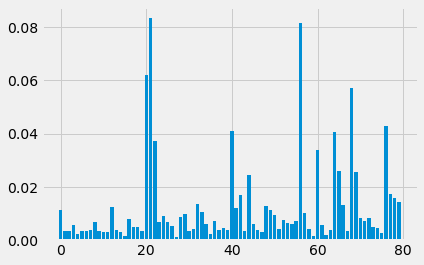

In [38]:
plt.bar(np.arange(80), bdt_evt.feature_importances_)

In [33]:
np.unique(test_class, return_counts=True)

(array([0, 1, 2, 3]), array([ 522, 1640, 2624,  447]))

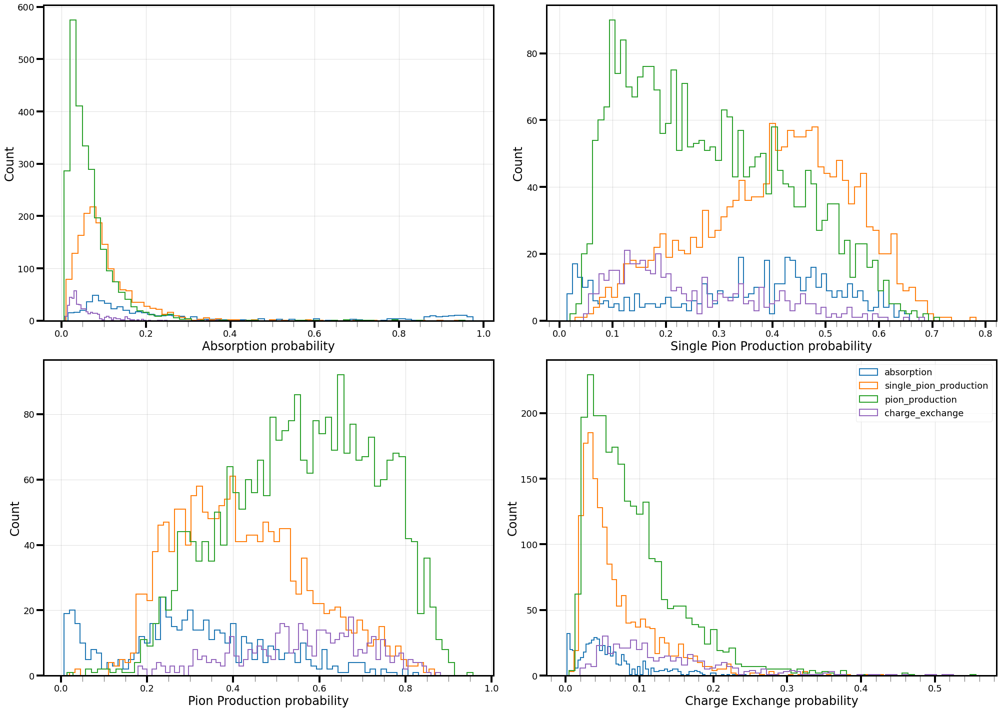

In [50]:
fig, axs = plt_conf.setup_figure(2, 2, figsize = (28, 20))
for j, ax_region in enumerate(["absorption", "single_pion_production", "pion_production", "charge_exchange"]):
    for i, region in enumerate(["absorption", "single_pion_production", "pion_production", "charge_exchange"]):
        axs[j//2, j%2].hist(proba_evt[:, j][test_class == i], **plt_conf.gen_kwargs(type="hist", index=i, label=region, bins=plt_conf.get_bins(proba_evt[:, 3]), density=False))
    plt_conf.format_axis(axs[j//2, j%2], xlabel=f"{ax_region.replace('_', ' ').title()} probability", ylabel="Count", ylog=False)
plt_conf.end_plot()

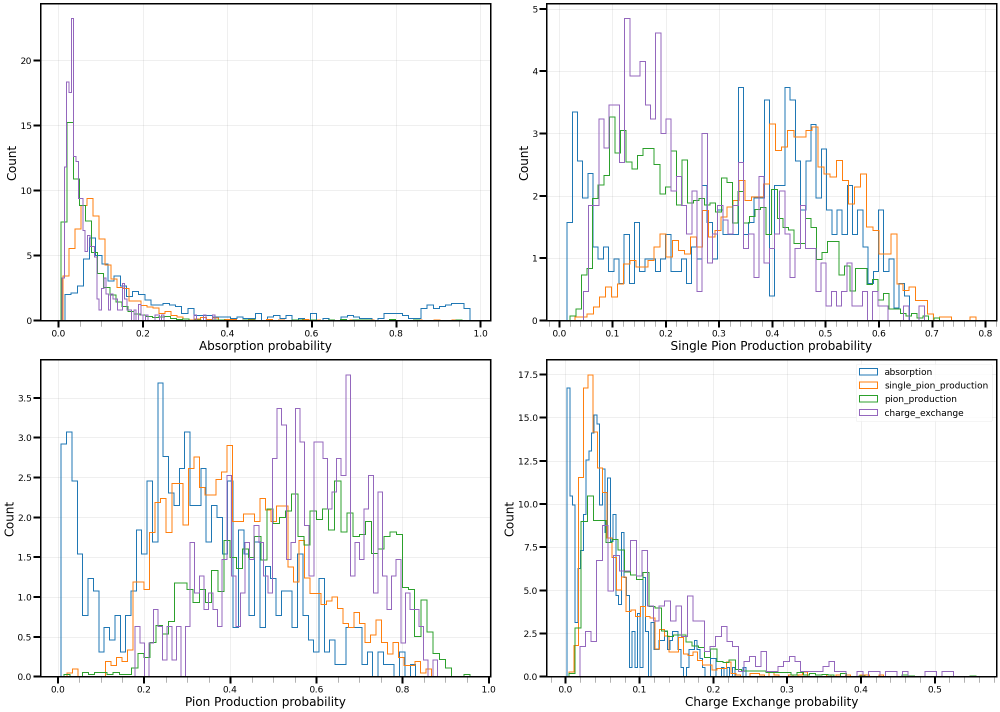

In [49]:
fig, axs = plt_conf.setup_figure(2, 2, figsize = (28, 20))
for j, ax_region in enumerate(["absorption", "single_pion_production", "pion_production", "charge_exchange"]):
    for i, region in enumerate(["absorption", "single_pion_production", "pion_production", "charge_exchange"]):
        axs[j//2, j%2].hist(proba_evt[:, j][test_class == i], **plt_conf.gen_kwargs(type="hist", index=i, label=region, bins=plt_conf.get_bins(proba_evt[:, 3]), density=True))
    plt_conf.format_axis(axs[j//2, j%2], xlabel=f"{ax_region.replace('_', ' ').title()} probability", ylabel="Count", ylog=False)
plt_conf.end_plot()

ValueError: cannot convert float NaN to integer

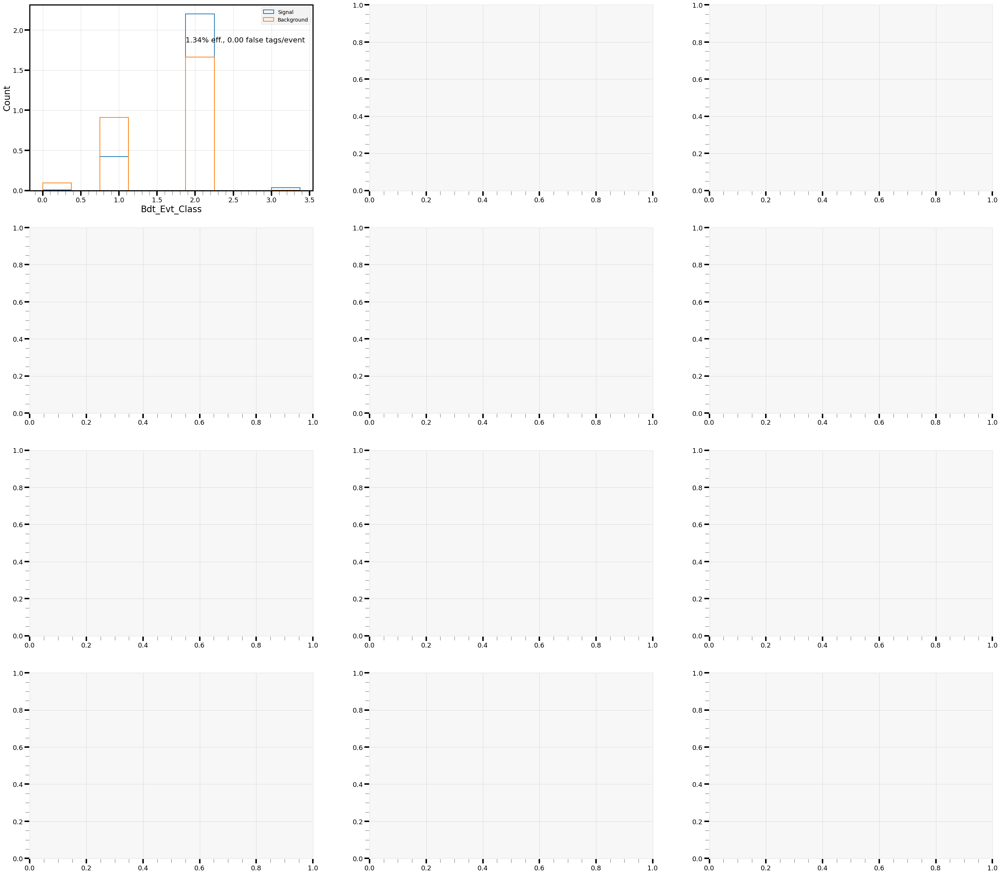

In [32]:
bdt_evt_eval = seval.SelectorEvaluator(test_class==3, test_data)
bdt_evt_eval.add_metric("bdt_evt_class", wrap_evt_bdt_args(lambda data: bdt_evt.predict(data), bdt_evt_eval, bad_imp), threshold=2.5)
bdt_evt_eval.make_metric_summary("bdt_evt_class")

## Older code
Based on this sort of stuff, but not up-to-date!

In [31]:
print(list(test_props_reduced.keys()))
print(bdt_reduced.feature_importances_)
print()
print(list(test_props.keys()))
print(bdt_new.feature_importances_)

['track', 'nhits', 'dEdx', 'chi2_pion_reduced', 'chi2_muon_reduced', 'chi2_proton_reduced', 'length']
[0.38802882 0.02131487 0.38859763 0.04631952 0.01028647 0.0418415
 0.10361119]

['track', 'nhits', 'dEdx', 'chi2_pion', 'chi2_dof', 'chi2_muon', 'chi2_proton', 'length']
[0.39074898 0.01539772 0.36973716 0.00930149 0.05191949 0.02394803
 0.05435198 0.08459514]


In [30]:
print(list(test_props_reduced.keys()))
print(bdt_reduced.feature_importances_)

['track', 'nhits', 'dEdx_med', 'dEdx_sum', 'dEdx_var', 'dEdx_end25%', 'dEdx_start75%', 'chi2_pion_reduced', 'chi2_muon_reduced', 'chi2_proton_reduced', 'length']
[0.35670119 0.01901328 0.37639981 0.01684698 0.01012212 0.04497791
 0.00775953 0.02894803 0.01593324 0.03429221 0.0890057 ]


In [29]:
bdt_new = ensemble.GradientBoostingClassifier()
bdt_new.fit(train_data, train_class)

GradientBoostingClassifier()

In [8]:
bdt_one_dof = seval.SelectorEvaluator(test_truth, test_props)
bdt_one_dof.add_metric("bdt", wrap_bdt_args(bdt_probs(bdt_new), bdt_one_dof), threshold=0.3)

In [ ]:
bdt_one_dof.make_property_correlations("chi2_pion", style="quartile_log")
bdt_one_dof.make_property_correlations("dEdx", style="quartile_log")

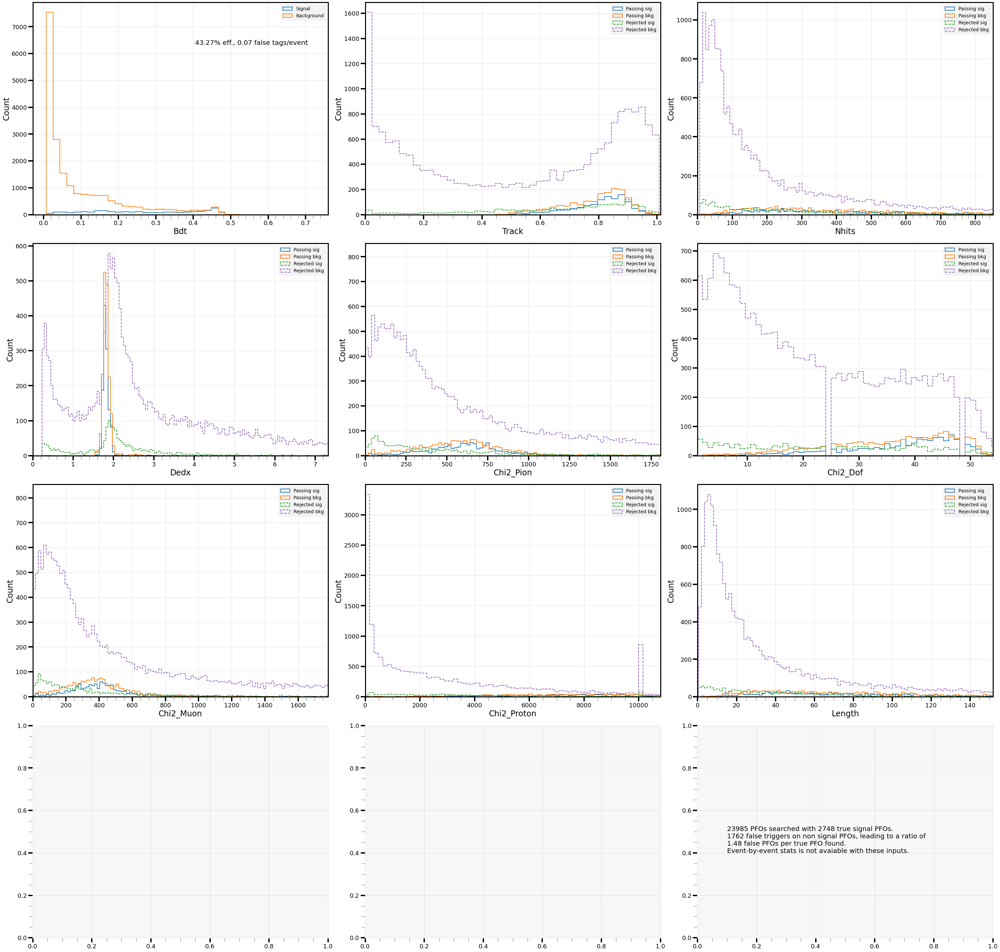

In [37]:
# bdt_one_dof = seval.SelectorEvaluator(test_truth, test_props)
# bdt_one_dof.add_metric("bdt", wrap_bdt_args(bdt_probs(bdt_new), bdt_one_dof), threshold=0.3)
bdt_one_dof.make_metric_summary("bdt", style="quartile_rejected")

In [85]:
bdt_selector = seval.SelectorEvaluator(old_test_truth, old_test_props)
bdt_selector.add_metric("bdt1", wrap_bdt_args(bdt_probs(bdt1), bdt_selector))

In [57]:
bdt_selector.metrics

{'bdt1': <function __main__.wrap_bdt_args.<locals>.func(use_props)>,
 'bdt1_n-1_track': <function python.analysis.SelectionEvaluation.SelectorEvaluator.remove_property_from_metric.<locals>.removal_argument_handler(properties_dict)>}

In [61]:
bdt_selector.metrics["bdt1_n-1_track"](test_props)

array([0, 0, 0, ..., 0, 0, 0])

In [16]:
bdt_selector.get_metric_values("bdt1")

array([0.39858166, 0.44071711, 0.01039465, ..., 0.01479232, 0.06604009,
       0.06707596])

In [71]:
ak.ravel(bdt_selector.get_metric_values("bdt1_n-1_track")[np.logical_and(bdt_selector.truth_mask, bdt_selector.get_passing("bdt1_n-1_track"))])

<Array [] type='0 * int64'>

In [81]:
np.unique(np.logical_and(bdt_selector.truth_mask, bdt_selector.get_passing("bdt1")), return_counts=True)

(array([False,  True]), array([23977,     8]))

In [88]:
ak.ravel(bdt_selector.properties["track"][np.logical_and(bdt_selector.truth_mask, bdt_selector.get_passing("bdt1"))])

<Array [0.66, 0.829, 0.798, ... 0.562, 0.872] type='8 * float64'>

In [ ]:
bdt_selector.make_metric_summary("bdt1", style="rejected_quartile")

In [88]:
bdt_selector.add_metric("bdt0.3", wrap_bdt_args(bdt_probs(bdt1), bdt_selector), threshold=0.3)

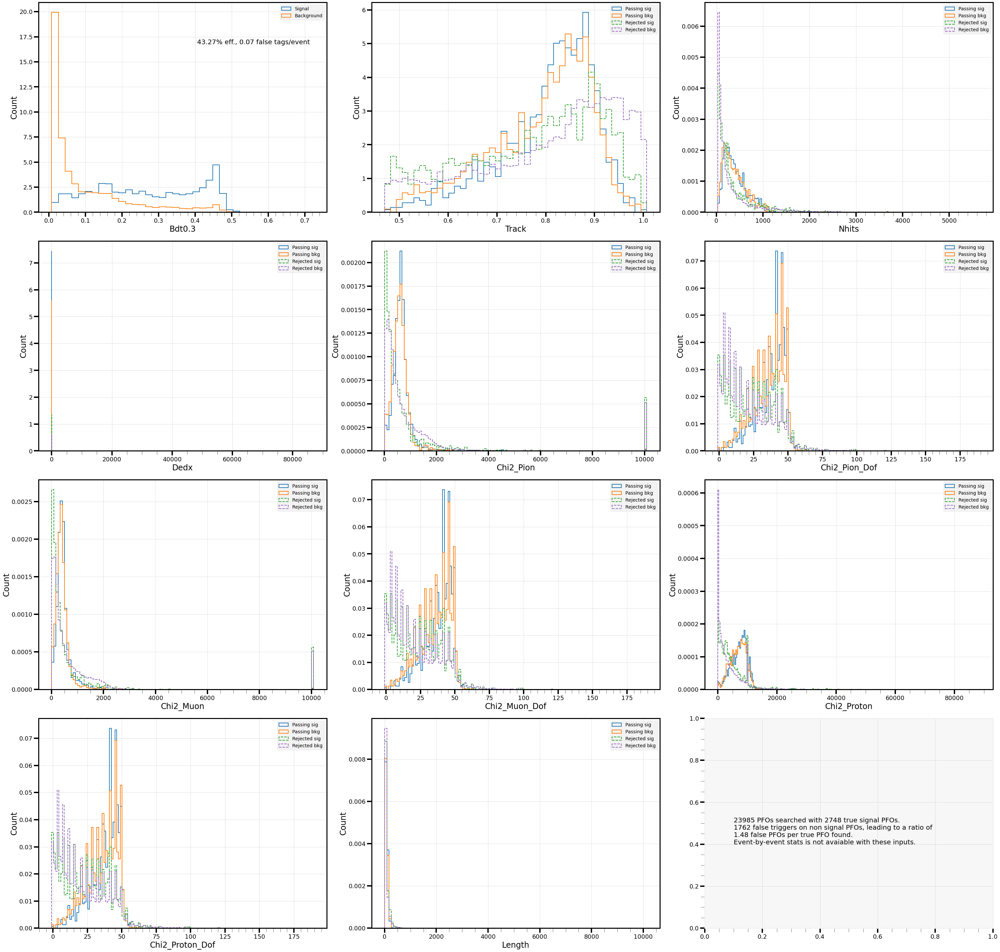

In [27]:
bdt_selector.add_metric("bdt0.3", wrap_bdt_args(bdt_probs(bdt1), bdt_selector), threshold=0.3)
bdt_selector.make_metric_summary("bdt0.3", style="rejected_quartile")

In [56]:
bdt_selector.properties["dEdx"]
passing_count = len(passing_sig) - 1
passing_sig = np.sort(passing_sig)
primary_data = self._determine_primary_data(passing_sig, passing_bkg, rejected_sig, rejected_bkg)
primary_data[min(int(np.round(passing_count * quartile/100)) + 1, passing_count)]

<Array [1.85, 1.79, 8.95, ... 1.4, 3.78, 0.279] type='23985 * float64'>

In [ ]:
bdt_selector.make_n_minus_1_per_property("bdt0.3", style="rejected_quartile")

In [ ]:
bdt_selector.make_n_minus_1_summary("bdt1", "track", style="rejected_quartile")

In [ ]:
pipselector_n = seval.SelectorEvaluator(piplus_truth, piplus_props)
pipselector_n.add_selector_metric("basic", track=(0.5,), nhits=(20,), dEdx=(0.5,2.8))

cProfile.run('pipselector_n.make_n_minus_1_summary("basic", "nhits")')

In [ ]:
import cProfile
cProfile.run('pipselector.make_n_minus_1_summary("basic", "nhits")')

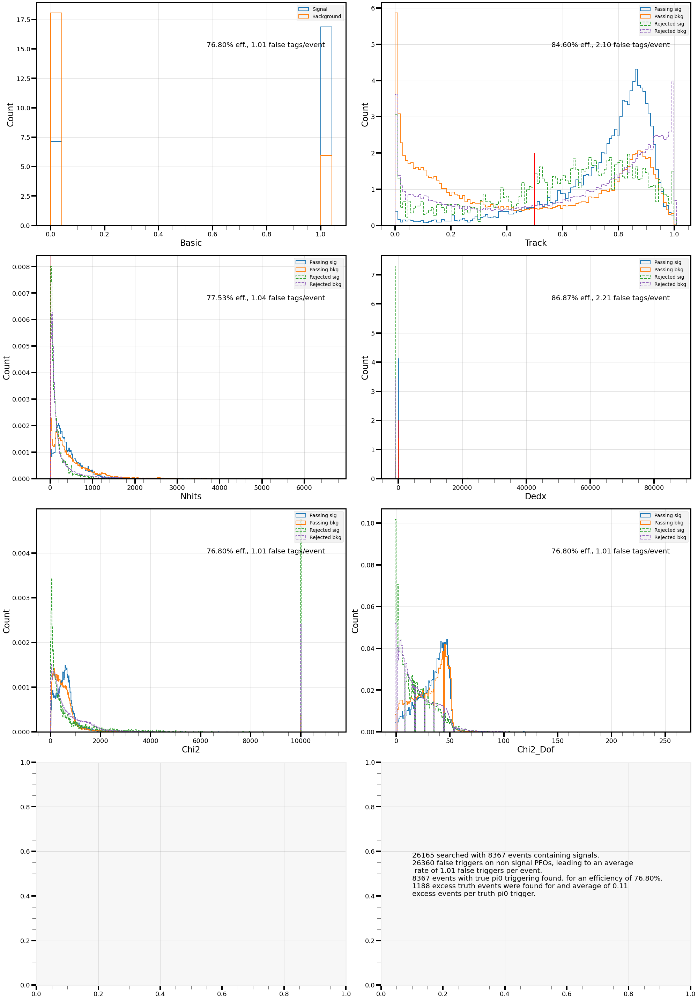

         570413414 function calls (570310411 primitive calls) in 2315.116 seconds

   Ordered by: cumulative time

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1    0.000    0.000 2315.118 2315.118 {built-in method builtins.exec}
        1    0.000    0.000 2315.118 2315.118 <string>:1(<module>)
        1    0.001    0.001 2315.118 2315.118 SelectionEvaluation.py:537(make_n_minus_1_per_property)
        5    0.002    0.000 2293.628  458.726 SelectionEvaluation.py:323(plot_param_distributions)
       25    0.001    0.000 2284.834   91.393 __init__.py:1430(inner)
       22    0.462    0.021 2284.820  103.855 _axes.py:6446(hist)
       22    0.001    0.000 2283.161  103.780 _axes.py:5128(fill)
       22    0.051    0.002 2282.945  103.770 _base.py:2400(add_patch)
       22  225.505   10.250 2282.887  103.768 _base.py:2413(_update_patch_limits)
 23202612  130.710    0.000  983.394    0.000 path.py:420(iter_bezier)
 23202590  551.917    0.000  918.056    0

In [10]:
cProfile.run('pipselector.make_n_minus_1_per_property("basic")', sort="cumtime")

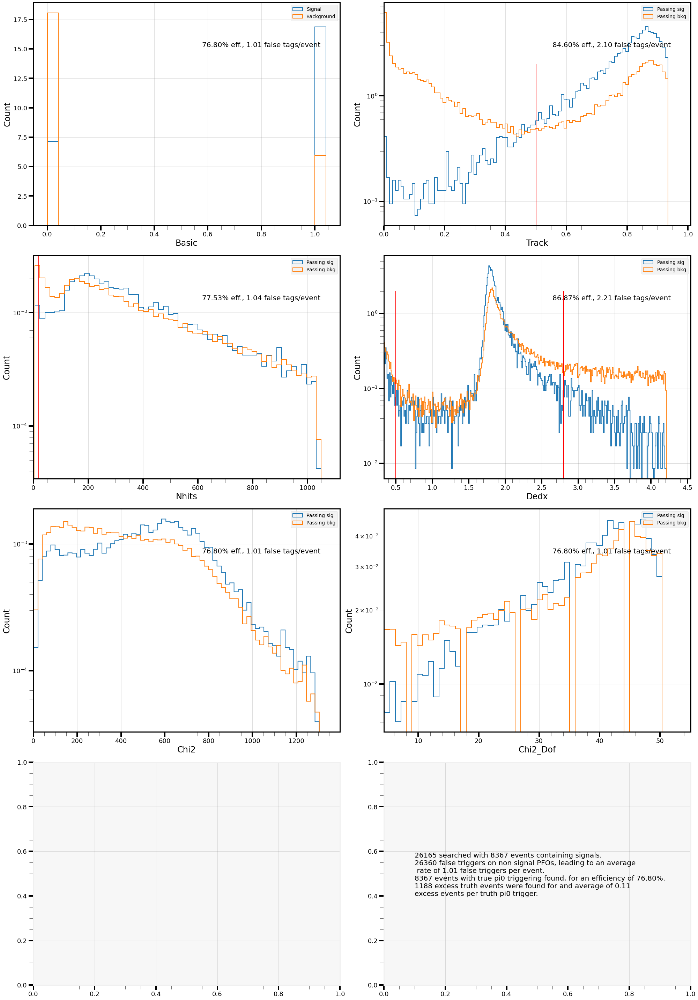

         21431855 function calls (21246621 primitive calls) in 64.733 seconds

   Ordered by: cumulative time

   ncalls  tottime  percall  cumtime  percall filename:lineno(function)
        1    0.000    0.000   64.736   64.736 {built-in method builtins.exec}
        1    0.000    0.000   64.736   64.736 <string>:1(<module>)
        1    0.001    0.001   64.736   64.736 SelectionEvaluation.py:537(make_n_minus_1_per_property)
        5    0.001    0.000   56.770   11.354 SelectionEvaluation.py:323(plot_param_distributions)
       15    0.000    0.000   54.101    3.607 __init__.py:1430(inner)
       12    0.007    0.001   54.090    4.507 _axes.py:6446(hist)
       12    0.000    0.000   54.034    4.503 _axes.py:5128(fill)
       12    0.000    0.000   54.019    4.502 _base.py:2400(add_patch)
       12    5.279    0.440   54.015    4.501 _base.py:2413(_update_patch_limits)
   542888    3.072    0.000   23.423    0.000 path.py:420(iter_bezier)
   542876   13.068    0.000   21.620    0.000

In [11]:
cProfile.run('pipselector.make_n_minus_1_per_property("basic", style="display")', sort="cumtime")

In [ ]:
pipselector = SelectorEvaluator(piplus_truth, piplus_props)
pipselector.add_selector_metric("basic", track=(0.5,), nhits=(20,), dEdx=(0.5,2.8))

pipselector.make_n_minus_1_summary("basic", "nhits")
pipselector.make_n_minus_1_summary("basic", "nhits", style="rejected_quartile")
pipselector.make_n_minus_1_per_property("basic")
pipselector.make_n_minus_1_per_property("basic", style="display")

In [ ]:
pipselector.make_n_minus_1_summary("basic", "dEdx", style="display")
pipselector.make_n_minus_1_summary("basic", "dEdx", style="rejected_quartile")

In [9]:
from importlib import reload
reload(PairSelection)

<module 'python.analysis.PairSelection' from '/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/PairSelection.py'>

In [ ]:
def get_two_count_pi0s(pi0s):
    pions, counts = np.unique(pi0s, return_counts=True)
    return pions[counts == 2]

beam_cadidate_pi0s = events.trueParticles.number[np.logical_and(
    events.trueParticles.mother == 1,
    events.trueParticles.pdg == 111)]

pi0_daughters = events.trueParticles.mother_pdg == 111
pi0_photon_mothers = events.trueParticles.mother[np.logical_and(
    events.trueParticles.pdg == 22,
    pi0_daughters)]
counts = ak.Array(map(
    lambda pi0s: len(
        np.intersect1d(
            pi0s['beam'],
            get_two_count_pi0s(pi0s['photon']))),
    ak.zip(
        {"beam": beam_cadidate_pi0s, "photon": pi0_photon_mothers},
        depth_limit=1)))

In [9]:
def get_counts(events):
    def get_two_count_pi0s(pi0s):
        pions, counts = np.unique(pi0s, return_counts=True)
        return pions[counts == 2]
    
    beam_pi0s = np.logical_and(
        events.trueParticles.mother == 1,
        events.trueParticles.pdg == 111)
    pi0_numbers = events.trueParticles.number[beam_pi0s]

    pi0_daughters = events.trueParticles.mother_pdg == 111
    pi0_photon_mothers = events.trueParticles.mother[np.logical_and(
        events.trueParticles.pdg == 22,
        pi0_daughters)]

    reco_photon_mothers = events.trueParticlesBT.mother[events.trueParticlesBT.pdg == 22]

    def get_counts(zipped):
        return [sum(zipped['photon'] == pi) for pi in np.intersect1d(
            zipped['pi0'],
            get_two_count_pi0s(zipped['diphoton']))]

    return ak.Array(map(
        get_counts,
        ak.zip(
            {"pi0": pi0_numbers, "diphoton": pi0_photon_mothers, "photon": reco_photon_mothers},
            depth_limit=1)))

In [10]:
counts = get_counts(evts)

In [20]:
counts2 = get_counts(evts2)

In [22]:
np.unique(ak.ravel(counts2), return_counts=True)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 20, 21, 25, 26, 27, 29, 32]),
 array([ 14,  54, 102,  83,  94,  53,  38,  44,  33,  22,  20,  20,  16,
          7,   7,   7,   6,   9,   2,   1,   2,   1,   1,   1,   1]))

In [21]:
np.unique(ak.num(counts2), return_counts=True)

(array([0, 1, 2]), array([2442,  548,   45]))

In [12]:
np.unique(ak.num(counts), return_counts=True)

(array([0, 1, 2]), array([2442,  548,   45]))

In [17]:
np.unique(ak.ravel(counts), return_counts=True)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 19,
        22]),
 array([ 30, 148, 167, 105,  57,  39,  32,  13,  13,  11,   8,   4,   3,
          3,   1,   2,   1,   1]))

In [25]:
print(ak.count(counts))
# print(ak.count(counts2))

638
638


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


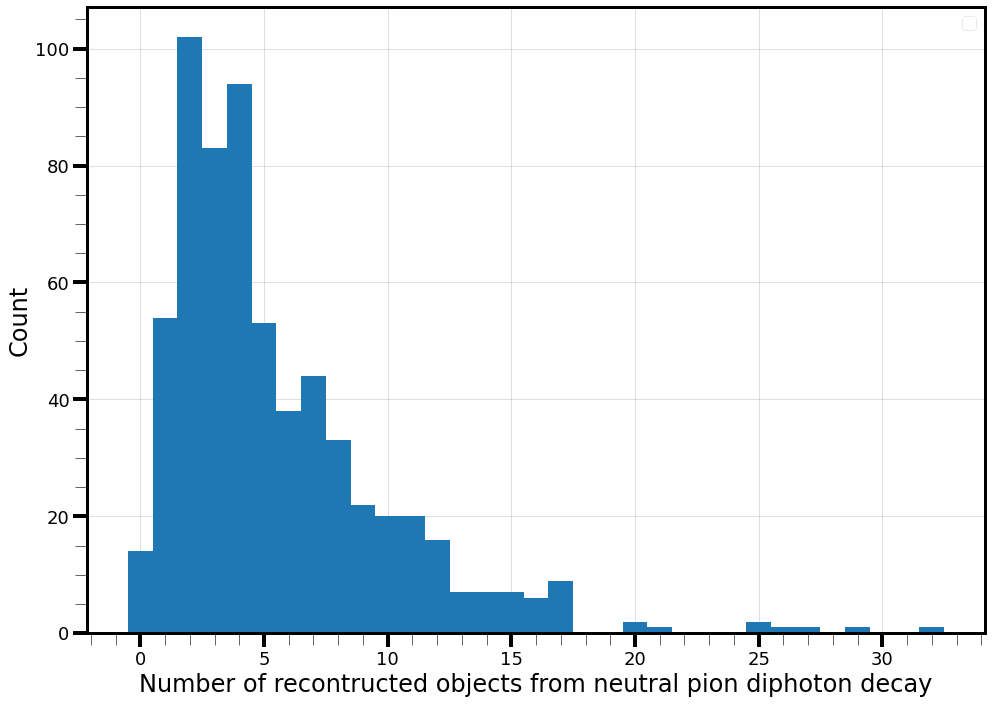

In [23]:
cnts2 = ak.ravel(counts2)
plt_conf.setup_figure()
plt.hist(cnts2, **plt_conf.gen_kwargs(type="hist", histtype="bar", index=0, bins=max(cnts2)+1, range=(-0.5, max(cnts2)+0.5)))
plt_conf.format_axis(xlabel="Number of recontructed objects from neutral pion diphoton decay", ylabel="Count")
plt_conf.end_plot()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


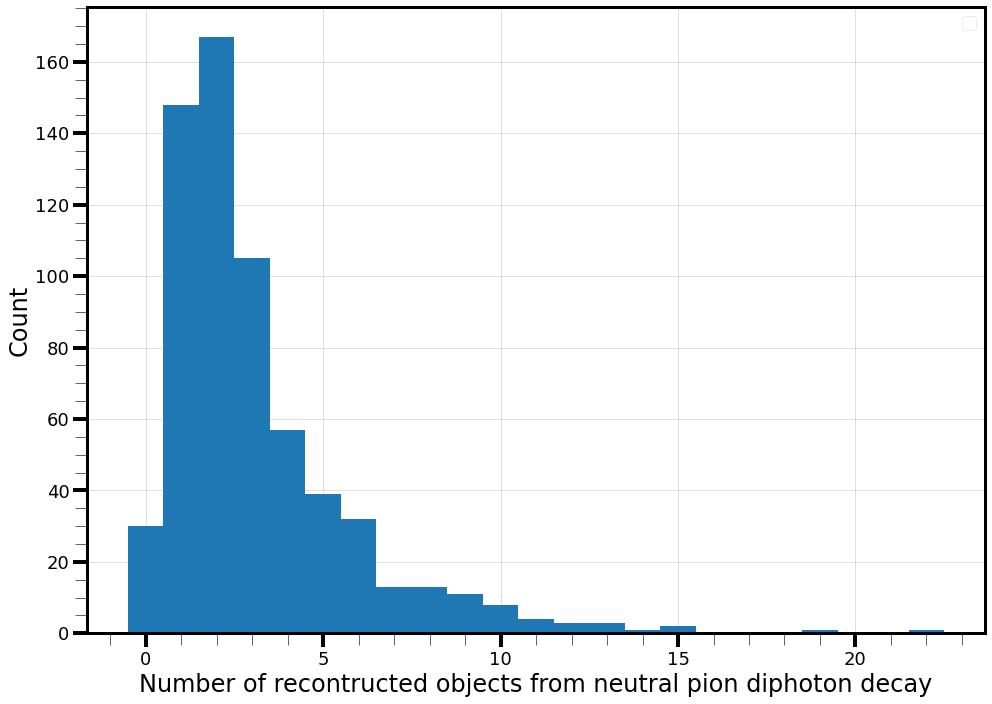

In [16]:
cnts = ak.ravel(counts)
plt_conf.setup_figure()
plt.hist(cnts, **plt_conf.gen_kwargs(type="hist", histtype="bar", index=0, bins=max(cnts)+1, range=(-0.5, max(cnts)+0.5)))
plt_conf.format_axis(xlabel="Number of recontructed objects from neutral pion diphoton decay", ylabel="Count")
plt_conf.end_plot()

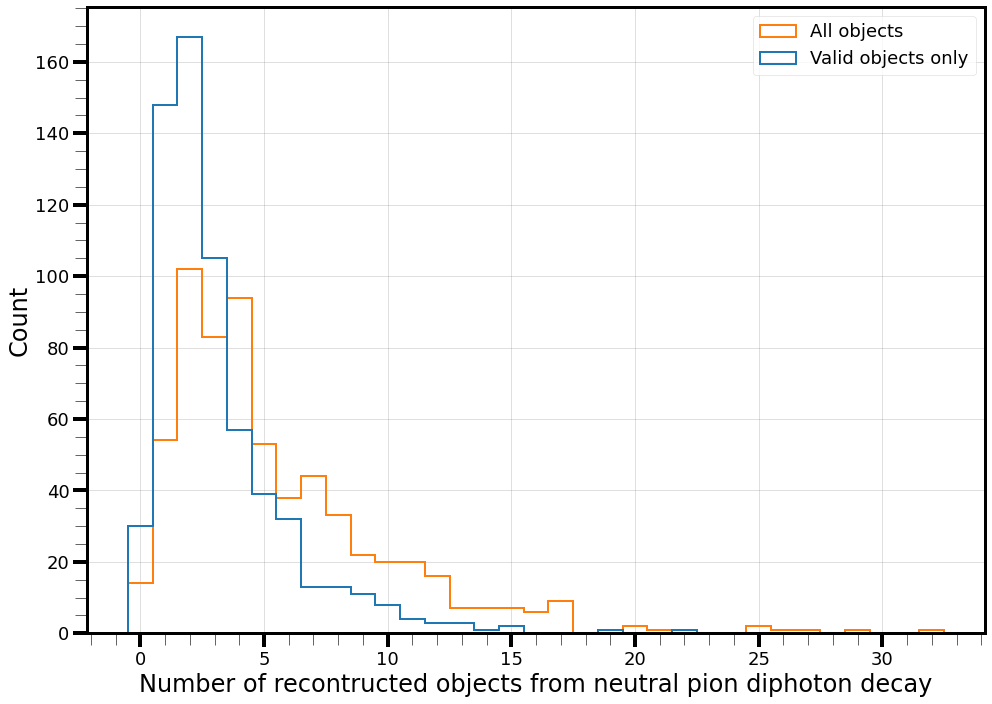

In [24]:
plt_conf.setup_figure()
plt.hist(cnts2, **plt_conf.gen_kwargs(label="All objects", type="hist", index=1, bins=max(cnts2)+1, range=(-0.5, max(cnts2)+0.5)))
plt.hist(cnts, **plt_conf.gen_kwargs(label="Valid objects only", type="hist", index=0, bins=max(cnts)+1, range=(-0.5, max(cnts)+0.5)))
plt_conf.format_axis(xlabel="Number of recontructed objects from neutral pion diphoton decay", ylabel="Count")
plt_conf.end_plot()

In [28]:
np.unique(ak.num(counts), return_counts=True)

(array([0, 1, 2]), array([2430,  560,   45]))

In [ ]:
def get_two_count_pi0s(pi0s):
        pions, counts = np.unique(pi0s, return_counts=True)
        return pions[counts == 2]

    if beam_daughters:
        beam_daughter_filter = events.trueParticles.mother == 1
    else:
        beam_daughter_filter = True
    beam_cadidate_pi0s = events.trueParticles.number[np.logical_and(
        beam_daughter_filter,
        events.trueParticles.pdg == 111)]
    try:
        pi0_daughters = events.trueParticles.mother_pdg == 111
    except:
        pi0_daughters = get_mother_pdgs(events) == 111
    pi0_photon_mothers = events.trueParticles.mother[np.logical_and(
        events.trueParticles.pdg == 22,
        pi0_daughters)]
    counts = ak.Array(map(
        lambda pi0s: len(
            np.intersect1d(
                pi0s['beam'],
                get_two_count_pi0s(pi0s['photon']))),
        ak.zip(
            {"beam": beam_cadidate_pi0s, "photon": pi0_photon_mothers},
            depth_limit=1)))

In [33]:
def get_electrons(pi0s):
    pions, counts = np.unique(pi0s, return_counts=True)
    return pions[counts >=1]

beam_daughter_filter = evts.trueParticles.mother == 1
beam_cadidate_pi0s = evts.trueParticles.number[np.logical_and(
    beam_daughter_filter,
    evts.trueParticles.pdg == 111)]
pi0_daughters = evts.trueParticles.mother_pdg == 111
pi0_photon_mothers = evts.trueParticles.mother[np.logical_and(
    evts.trueParticles.pdg == 11,
    pi0_daughters)]
dalitz_counts = ak.Array(map(
    lambda pi0s: len(
        np.intersect1d(
            pi0s['beam'],
            get_electrons(pi0s['photon']))),
    ak.zip(
        {"beam": beam_cadidate_pi0s, "photon": pi0_photon_mothers},
        depth_limit=1)))

print(ak.sum(dalitz_counts))

12


In [13]:
print(ak.sum(EventSelection.generate_truth_tags(evts, 0, None)))
print(ak.sum(EventSelection.generate_truth_tags(evts, 1, None)))
print(ak.sum(EventSelection.generate_truth_tags(evts, 2, None)))
print(ak.sum(EventSelection.generate_truth_tags(evts, (3,), None)))

2442
548
45
0


In [26]:
zeros_mask = ak.Array(map(lambda x: 0 in x, counts2))

In [35]:
for i, this_event in enumerate(evts.trueParticles.pdg[zeros_mask]):
    print(this_event[evts.trueParticles.mother[zeros_mask][i] == 1])

[111, 11, 11, 11, 11, 11, 11, 11, ... 2112, 211, 111, 22, 22, 2112, 1000180380, 211]
[111, 11, 11, 11, 11, 11, 11, ... 22, 2112, 1000010020, 1000020040, 1000130280, 211]
[111, 11, 11, 11, 11, 11, 11, 11, ... 11, 11, 11, 2212, 111, 22, 2112, 1000180380]
[111, 111, 11, 11, 11, 11, 11, ... 2112, 22, 22, 1000010020, 1000020040, 1000140280]
[111, 111, 11, 11, 11, 11, 11, 11, ... 111, 2212, 22, 2112, 2112, 22, 22, 1000160340]
[111, 11, 11, 11, 11, 11, 11, ... 2212, 22, 2112, 22, 1000020040, 1000140300, 211]
[111, 11, 11, 11, 11, 11, 11, 11, ... 2212, 2112, 2112, 2112, 2112, 22, 1000140290]
[111, 11, 11, 11, 11, 11, 11, ... 2112, 2112, 2112, 22, 22, 1000010020, 1000110230]
[111, 11, 11, 11, 11, 11, 11, 11, ... 22, 2212, 2112, 2212, 2112, 22, 1000140280]
[111, 11, 11, 11, 11, 11, 11, 11, ... 2112, 2112, 2212, 2112, 2112, 2112, 1000140290]
[111, 11, 11, 11, 11, 11, 11, 11, ... 22, 2112, 22, 2112, 22, 1000010020, 1000160320]
[111, 11, 11, 11, 11, 11, 11, ... 2112, 2112, 2112, 22, 1000020030, 100

In [19]:
evts2 = EventSelection.load_and_cut_data(
    "/scratch/wx21978/pi0/root_files/1GeV_beam_v4_prelim/Prod4a_1GeV_BeamSim_00_prelim.root",
    batch_size = -1, batch_start = -1,
    valid_momenta=False,
    cnn_cut=0,#0.5,
    n_hits_cut=0,#80,
    distance_bounds_cm=None,#(3,90),
    max_impact_cm=None,#20,
    beam_slice_cut=False)

number of entries before|after PiBeamSelection: 23660|13430
number of entries before|after PandoraTagCut: 23660|19505
number of entries before|after CaloSizeCut: 23660|19194
number of entries before|after BeamQualityCut: 23660|14415
number of entries before|after APA3Cut: 23660|21409
number of entries before|after MichelScoreCut: 23660|9583
number of entries before|after MedianDEdXCut: 23660|15907
                 number of events which pass the cut  single efficiency  \
no selection                                 23660.0         100.000000   
PiBeamSelection                              13430.0          56.762468   
PandoraTagCut                                19505.0          82.438715   
CaloSizeCut                                  19194.0          81.124260   
BeamQualityCut                               14415.0          60.925613   
APA3Cut                                      21409.0          90.486052   
MichelScoreCut                                9583.0          40.502959   

In [8]:
evts = EventSelection.load_and_cut_data(
    "/scratch/wx21978/pi0/root_files/1GeV_beam_v4_prelim/Prod4a_1GeV_BeamSim_00_prelim.root",
    batch_size = -1, batch_start = -1,
    valid_momenta=True,
    cnn_cut=0,#0.5,
    n_hits_cut=0,#80,
    distance_bounds_cm=None,#(3,90),
    max_impact_cm=None,#20,
    beam_slice_cut=False)

# pair_coords = ak.argcombinations(evts.recoParticles.number, 2)

# sig_count = PairSelection.get_sig_count(evts, pair_coords)
# truth_mask = sig_count == 2
# print("a")

# pairs = Master.ShowerPairs(evts, pair_coords)
# print("b")
# masses = pairs.reco_mass
# momenta = pairs.reco_pi0_mom
# energies = pairs.reco_energy
# approaches = pairs.reco_closest_approach
# separations = pairs.reco_separation
# impacts = PairSelection.paired_beam_impact(pairs)
# angles = pairs.reco_angle

number of entries before|after PiBeamSelection: 23660|13430
number of entries before|after PandoraTagCut: 23660|19505
number of entries before|after CaloSizeCut: 23660|19194
number of entries before|after BeamQualityCut: 23660|14415
number of entries before|after APA3Cut: 23660|21409
number of entries before|after MichelScoreCut: 23660|9583
number of entries before|after MedianDEdXCut: 23660|15907
                 number of events which pass the cut  single efficiency  \
no selection                                 23660.0         100.000000   
PiBeamSelection                              13430.0          56.762468   
PandoraTagCut                                19505.0          82.438715   
CaloSizeCut                                  19194.0          81.124260   
BeamQualityCut                               14415.0          60.925613   
APA3Cut                                      21409.0          90.486052   
MichelScoreCut                                9583.0          40.502959   

In [9]:
tags = {
    "10-0+": EventSelection.generate_truth_tags(evts, 1, 0),
    "X0-0+": EventSelection.generate_truth_tags(evts, (1,), 0),
    "00-0+": EventSelection.generate_truth_tags(evts, 0, 0),
    "00-X+": EventSelection.generate_truth_tags(evts, 0, (1,)),
    "X0-X+": EventSelection.generate_truth_tags(evts, (1,), (1,)),
    "X0-+": EventSelection.generate_truth_tags(evts, (1,), None)}

In [22]:
# print(ak.all(tags["00-0+"] + tags["00-X+"] + tags["X0-+"]))
keys = list(tags.keys())
for i,k in enumerate(keys):
    for k2 in keys[i+1:]:
        print(f"{k}, {k2} Overlapping: {ak.any(tags[k] * tags[k2])}")
        print(f"{k} subset of {k2}: {ak.all((tags[k] * tags[k2])[tags[k]])}")
        print(f"{k2} subset of {k}: {ak.all((tags[k] * tags[k2])[tags[k2]])}")

10-0+, X0-0+ Overlapping: True
10-0+ subset of X0-0+: True
X0-0+ subset of 10-0+: False
10-0+, 00-0+ Overlapping: False
10-0+ subset of 00-0+: False
00-0+ subset of 10-0+: False
10-0+, 00-X+ Overlapping: False
10-0+ subset of 00-X+: False
00-X+ subset of 10-0+: False
10-0+, X0-X+ Overlapping: False
10-0+ subset of X0-X+: False
X0-X+ subset of 10-0+: False
10-0+, X0-+ Overlapping: True
10-0+ subset of X0-+: True
X0-+ subset of 10-0+: False
X0-0+, 00-0+ Overlapping: False
X0-0+ subset of 00-0+: False
00-0+ subset of X0-0+: False
X0-0+, 00-X+ Overlapping: False
X0-0+ subset of 00-X+: False
00-X+ subset of X0-0+: False
X0-0+, X0-X+ Overlapping: False
X0-0+ subset of X0-X+: False
X0-X+ subset of X0-0+: False
X0-0+, X0-+ Overlapping: True
X0-0+ subset of X0-+: True
X0-+ subset of X0-0+: False
00-0+, 00-X+ Overlapping: False
00-0+ subset of 00-X+: False
00-X+ subset of 00-0+: False
00-0+, X0-X+ Overlapping: False
00-0+ subset of X0-X+: False
X0-X+ subset of 00-0+: False
00-0+, X0-+ Overlappin

In [10]:
pairs = Master.ShowerPairs(evts, pair_coords)
print("b")
masses = pairs.reco_mass
momenta = pairs.reco_pi0_mom
energies = pairs.reco_energy
approaches = pairs.reco_closest_approach
separations = pairs.reco_separation
impacts = PairSelection.paired_beam_impact(pairs)
angles = pairs.reco_angle

b


/software/wx21978/miniconda/envs/pi0-phys/lib/python3.10/site-packages/awkward/_connect/_numpy.py:195: RuntimeWarning: invalid value encountered in true_divide
  result = getattr(ufunc, method)(


In [9]:
selction_filter = PFOSelection.InitialPi0PhotonSelection(evts, verbose=True)
test_evts = evts.Filter([selction_filter], returnCopy=True)
EventSelection.apply_filter(test_evts, Master.NPFPMask(test_evts, -1), truth_filter=True)

number of entries before|after EMScoreCut: 790027|601498
number of entries before|after NHitsCut: 790027|204662
number of entries before|after BeamParticleDistanceCut: 790027|16727
number of entries before|after BeamParticleIPCut: 790027|9298
                         number of events which pass the cut  \
no selection                                        790027.0   
EMScoreCut                                          601498.0   
NHitsCut                                            204662.0   
BeamParticleDistanceCut                              16727.0   
BeamParticleIPCut                                     9298.0   

                         single efficiency  \
no selection                    100.000000   
EMScoreCut                       76.136385   
NHitsCut                         25.905697   
BeamParticleDistanceCut           2.117269   
BeamParticleIPCut                 1.176922   

                         number of events after successive cuts  \
no selection                

/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:54: UserWarning: Couldn't apply filters to filters.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:54: UserWarning: Couldn't apply filters to _RecoParticleData__beam_number.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:54: UserWarning: Couldn't apply filters to _RecoParticleData__beam_caloWire.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:54: UserWarning: Couldn't apply filters to _RecoParticleData__beam_startPos.
  warnings.warn(f"Couldn't apply filters to {var}.")
/users/wx21978/projects/pion-phys/pi0-analysis/analysis/python/analysis/Master.py:54: UserWarning: Couldn't apply filters to _RecoParticleData__beam_endPos.
  warnings.warn(f"Coul

Mask created


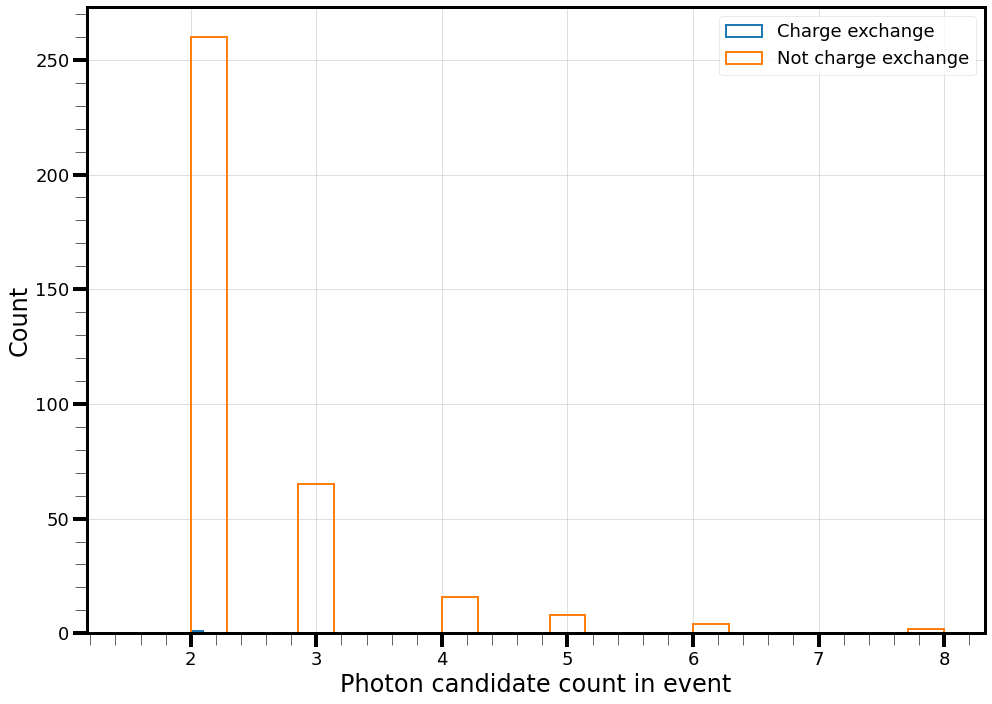

In [ ]:
charge_exchange_mask = EventSelection.generate_truth_tags(evts, 1, 0)
print("Mask created")
cex_counts = ak.count(evts.recoParticles.number[charge_exchange_mask], axis=1)
not_cex_counts = ak.count(evts.recoParticles.number[np.logical_not(charge_exchange_mask)], axis=1)

plt_conf.setup_figure()
plt.hist(cex_counts, **plt_conf.gen_kwargs(type="hist", index=0, label="Charge exchange", bins=plt_conf.get_bins(cex_counts)))
plt.hist(not_cex_counts, **plt_conf.gen_kwargs(type="hist", index=1, label="Not charge exchange", bins=plt_conf.get_bins(not_cex_counts)))
plt_conf.format_axis(xlabel="Photon candidate count in event", ylabel="Count")
plt_conf.end_plot()

In [ ]:
tags = {
    "Charge ex. 1pi0, 0pi+": EventSelection.generate_truth_tags(evts, 1, 0),
    "Charge ex. Xpi0, 0pi+": EventSelection.generate_truth_tags(evts, (1,), 0),
    "Absorbtion 0pi0, 0pi+": EventSelection.generate_truth_tags(evts, 0, 0),
    "Pion production 0pi0, Xpi+": EventSelection.generate_truth_tags(evts, 0, (1,)),
    "Pion production Xpi0, Xpi+": EventSelection.generate_truth_tags(evts, (1,), (1,)),
    "Inclusive pi0 signal Xpi0, 0/Xpi+": EventSelection.generate_truth_tags(evts, (1,), None)}

for label in tags.keys():
    print(f"{ak.sum(tags[label])} events of type: {label}.")



407 events of type: Charge ex. 1pi0, 0pi+.
449 events of type: Charge ex. Xpi0, 0pi+.
1263 events of type: Absorbtion 0pi0, 0pi+.
1179 events of type: Pion production 0pi0, Xpi+.
144 events of type: Pion production Xpi0, Xpi+.
593 events of type: Inclusive pi0 signal Xpi0, 0/Xpi+.


In [13]:
test_evts = evts.Filter([selction_filter], returnCopy=True)
EventSelection.apply_filter(test_evts, np.sort(Master.NPFPMask(test_evts, -1))[::-1], truth_filter=True)

In [14]:
tags = {
    "Charge ex. 1pi0, 0pi+": EventSelection.generate_truth_tags(test_evts, 1, 0),
    "Charge ex. Xpi0, 0pi+": EventSelection.generate_truth_tags(test_evts, (1,), 0),
    "Absorbtion 0pi0, 0pi+": EventSelection.generate_truth_tags(test_evts, 0, 0),
    "Pion production 0pi0, Xpi+": EventSelection.generate_truth_tags(test_evts, 0, (1,)),
    "Pion production Xpi0, Xpi+": EventSelection.generate_truth_tags(test_evts, (1,), (1,)),
    "Inclusive pi0 signal Xpi0, 0/Xpi+": EventSelection.generate_truth_tags(test_evts, (1,), None)}

for label in tags.keys():
    print(f"{ak.sum(tags[label])} events of type: {label}.")

12 events of type: Charge ex. 1pi0, 0pi+.
14 events of type: Charge ex. Xpi0, 0pi+.
57 events of type: Absorbtion 0pi0, 0pi+.
41 events of type: Pion production 0pi0, Xpi+.
6 events of type: Pion production Xpi0, Xpi+.
20 events of type: Inclusive pi0 signal Xpi0, 0/Xpi+.


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


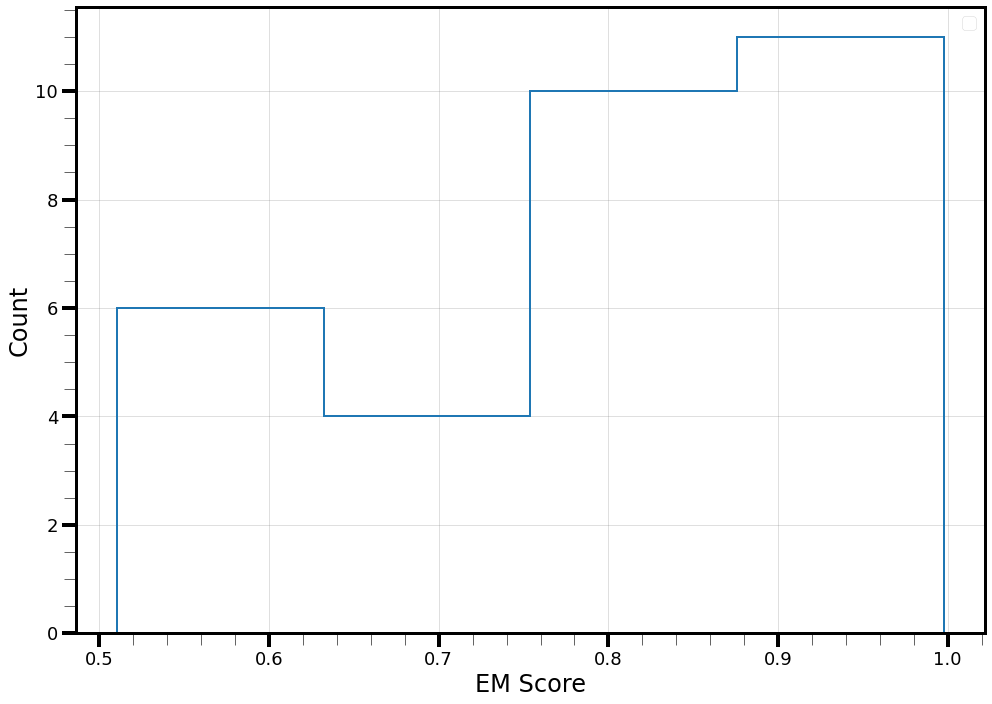

In [16]:
data = ak.ravel(test_evts.recoParticles.emScore)
plt_conf.setup_figure()
plt.hist(data, **plt_conf.gen_kwargs(type="hist", bins=plt_conf.get_bins(data)))
plt_conf.format_axis(xlabel="EM Score", ylabel="Count")
plt_conf.end_plot()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


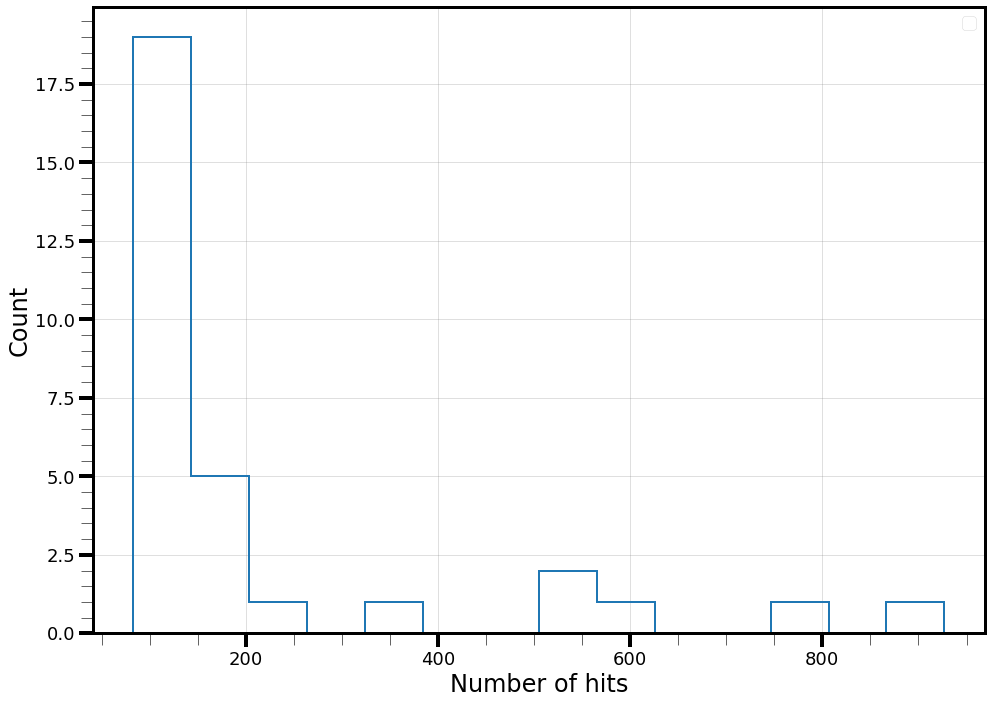

In [17]:
data = ak.ravel(test_evts.recoParticles.nHits)
plt_conf.setup_figure()
plt.hist(data, **plt_conf.gen_kwargs(type="hist", bins=plt_conf.get_bins(data)))
plt_conf.format_axis(xlabel="Number of hits", ylabel="Count")
plt_conf.end_plot()

In [ ]:
tags = {
    "Charge ex. 1pi0, 0pi+": EventSelection.generate_truth_tags(test_evts, 1, 0),
    "Charge ex. Xpi0, 0pi+": EventSelection.generate_truth_tags(test_evts, (1,), 0),
    "Absorbtion 0pi0, 0pi+": EventSelection.generate_truth_tags(test_evts, 0, 0),
    "Pion production 0pi0, Xpi+": EventSelection.generate_truth_tags(test_evts, 0, (1,)),
    "Pion production Xpi0, Xpi+": EventSelection.generate_truth_tags(test_evts, (1,), (1,)),
    "Inclusive pi0 signal Xpi0, 0/Xpi+": EventSelection.generate_truth_tags(test_evts, (1,), None)}

for label in tags.keys():
    print(f"{ak.sum(tags[label])} events of type: {label}.")

12 events of type: Charge ex. 1pi0, 0pi+.
14 events of type: Charge ex. Xpi0, 0pi+.
57 events of type: Absorbtion 0pi0, 0pi+.
41 events of type: Pion production 0pi0, Xpi+.
6 events of type: Pion production Xpi0, Xpi+.
20 events of type: Inclusive pi0 signal Xpi0, 0/Xpi+.


In [ ]:
print(ak.num(evts.eventNum, axis=0))
print(ak.num(test_evts.eventNum, axis=0))

3035
118


In [ ]:
from python.analysis import pfoProperties
num_events = ak.num(evts.recoParticles.beam_number, axis=0)
distance_mask_old = [[]] * num_events
print(num_events)
for i in range(num_events):
    if i%100 == 0:
        print(i)
    starts = evts.recoParticles.startPos[i]
    beam_vertex = evts.recoParticles.beam_endPos[i]
    directions = evts.recoParticles.direction[i]
    distance_mask_old[i] = pfoProperties.get_impact_parameter(
                directions,
                starts,
                beam_vertex) < 20
distance_mask_old = ak.Array(distance_mask_old)

distances_new = pfoProperties.get_impact_parameter(evts.recoParticles.direction, evts.recoParticles.startPos, evts.recoParticles.beam_endPos)

23633
0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900
7000
7100
7200
7300
7400
7500
7600
7700
7800
7900
8000
8100
8200
8300
8400
8500
8600
8700
8800
8900
9000
9100
9200
9300
9400
9500
9600
9700
9800
9900
10000
10100
10200
10300
10400
10500
10600
10700
10800
10900
11000
11100
11200
11300
11400
11500
11600
11700
11800
11900
12000
12100
12200
12300
12400
12500
12600
12700
12800
12900
13000
13100
13200
13300
13400
13500
13600
13700
13800
13900
14000
14100
14200
14300
14400
14500
14600
14700
14800
14900
15000
15100
15200
15300
15400
15500
15600
15700
15800
15900
16000
16100
16200
16300
16400
16500
16600
16700
16800
16900
17000
17100
17200
17300
17400
17500
17600
17700
17800
17900
18000
18100
18200
18300
18

In [ ]:
selectors = SelectorEvaluator(evts, pair_coords, sig_count)
selectors.add_selector_metric("basic", mass_cuts=(50,150), approach_cuts=40, impact_cuts=40, separation_cuts=(5,60))

selectors.make_n_minus_1_summary("basic", "mass")
selectors.make_n_minus_1_per_property("basic")
selectors.make_n_minus_1_per_property("basic", style="display")

In [ ]:
# sig_evts = photon_pairs.load_and_cut_data("/scratch/wx21978/pi0/root_files/1GeV_beam_v3/Prod4a_1GeV_BeamSim_00.root", batch_size = -1, batch_start = -1, pion_count="one", two_photon=True)
# bkg_evts = photon_pairs.load_and_cut_data("/scratch/wx21978/pi0/root_files/1GeV_beam_v3/Prod4a_1GeV_BeamSim_00.root", batch_size = -1, batch_start = -1, pion_count="zero", two_photon=False)

# #TODO Split into a background and signal version
# # For bkg, use onl

# sig_pair_coords = ak.argcombinations(sig_evts.recoParticles.number, 2)
# bkg_pair_coords = ak.argcombinations(bkg_evts.recoParticles.number, 2)

# sig_count_single = photon_pairs.get_sig_count(sig_evts, sig_pair_coords, single_best=True) # This isn't working as the "best" method wasnt' designed to deal with this
# sig_count_multi = photon_pairs.get_sig_count(sig_evts, sig_pair_coords)
# bkg_count_multi = photon_pairs.get_sig_count(bkg_evts, bkg_pair_coords)


# sig_masses = photon_pairs.paired_mass(sig_evts, sig_pair_coords)
# sig_momenta = vector.magnitude(photon_pairs.paired_momentum(sig_evts, sig_pair_coords))
# sig_energies = photon_pairs.paired_energy(sig_evts, sig_pair_coords)
# sig_approaches = photon_pairs.paired_closest_approach(sig_evts, sig_pair_coords)
# sig_separations = photon_pairs.paired_separation(sig_evts, sig_pair_coords)
# sig_impacts = photon_pairs.paired_beam_impact(sig_evts, sig_pair_coords)
# sig_angles = photon_pairs.paired_opening_angle(sig_evts, sig_pair_coords)

# bkg_masses = photon_pairs.paired_mass(bkg_evts, bkg_pair_coords)
# bkg_momenta = vector.magnitude(photon_pairs.paired_momentum(bkg_evts, bkg_pair_coords))
# bkg_energies = photon_pairs.paired_energy(bkg_evts, bkg_pair_coords)
# bkg_approaches = photon_pairs.paired_closest_approach(bkg_evts, bkg_pair_coords)
# bkg_separations = photon_pairs.paired_separation(bkg_evts, bkg_pair_coords)
# bkg_impacts = photon_pairs.paired_beam_impact(bkg_evts, bkg_pair_coords)
# bkg_angles = photon_pairs.paired_opening_angle(bkg_evts, bkg_pair_coords)

In [ ]:
# Pair selector
init_cut_metric = cut_metric_generator(mass_cuts=(50,150), approach_cuts=40, impact_cuts=40, separation_cuts=(5,60))

In [ ]:
# sig_count = tagging
get_efficiency_fpr_stats(init_cut_metric(masses, momenta, energies, approaches, separations, impacts, angles) > 0.5, sig_count, print_results=True)
# Get this to produce a metric, i.e. signal/sqrt(bkg)

# Not "triggers" - fake pairs

824 searched with 406 events containing pi0s.
82 false triggers on pairs with no pi0 photons and 518 false triggers on pairs with 1 pi0 photon
for a total of 600 false triggers, at an average rate of 0.73 false triggers per event.
278 events with true pi0 triggering found, for an efficiency of 68.47%.
59 excess truth events were found for and average of 0.15 excess events per truth pi0 trigger.


(0.6847290640394089, 0.7281553398058253)

In [ ]:
selectors = SelectorEvaluator(evts, pair_coords, sig_count)
selectors.add_metric("basic", selectors.wrap_metric_arguments(init_cut_metric))

selectors.make_n_minus_1_summary("basic", "mass")
selectors.make_n_minus_1_per_property("basic")
selectors.make_n_minus_1_per_property("basic", style="display")

NameError: name 'init_cut_metric' is not defined

In [ ]:
selectors.add_selector_metric("included_angle", mass_cuts=(50,150), approach_cuts=40, impact_cuts=40, separation_cuts=(5,60), angle_cuts=(0.2, np.pi/2))

selectors.make_n_minus_1_per_property("included_angle", style="display")

In [ ]:
selectors.add_selector_metric("new_mass", mass_cuts=(40,180), approach_cuts=20, impact_cuts=30, separation_cuts=(5,80), angle_cuts=(0.2, np.pi/2))

selectors.make_n_minus_1_per_property("new_mass", style="display")

In [ ]:
selectors.add_selector_metric("harsh_mass", mass_cuts=(60,180), approach_cuts=20, impact_cuts=40, separation_cuts=(5,80), angle_cuts=(0.2, np.pi/2))

selectors.make_n_minus_1_per_property("harsh_mass", style="display")

In [ ]:
def comb_metric(mass, momentum, energy, approach, separation, impact, angle):
    initial_offset = 100
    
    approach_divisor = 0.01
    separation_divisor = 0.01
    impact_divisor = 0.01

    geometry_metric = np.exp( - approach**2/approach_divisor - separation**2/separation_divisor - impact**2/impact_divisor)

    # geometry_metric = geometry_metric * np.sin(angle)**2

    mass_mean = 110
    mass_sigma = 30

    energy_metric = np.exp(-(mass-mass_mean)**2/mass_sigma)
    energy_metric=1
    
    return np.exp(initial_offset) * geometry_metric * energy_metric

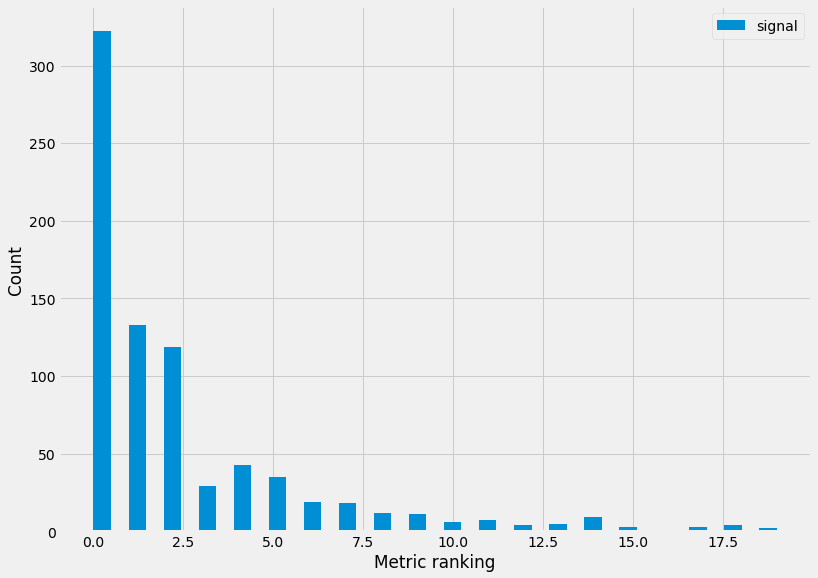

0.3640776699029126


In [ ]:
metric_rank = ak.argsort(comb_metric(masses, momenta, energies, approaches, separations, impacts, angles), ascending=True)[truth_mask]

plot_rank_hist_nb("Metric", metric_rank, y_scaling='linear')

print(np.sum(metric_rank == 0)/ak.num(metric_rank, axis=0))

In [ ]:
def metric_generator(prop_name):
    def metric(properties):
        divisor = 10
        return np.exp(abs(properties[prop_name]) /divisor)
    return metric

def geo_metric(properties):
    initial_offset = 3
    
    approach_divisor = 10
    separation_divisor = 10
    impact_divisor = 10
    
    angle_metric = np.cos((properties["angle"]-np.pi/16)/0.75)

    geometry_metric = np.exp(- initial_offset + abs(properties["approach"])/approach_divisor + abs(properties["separation"])/separation_divisor + abs(properties["impact"])/impact_divisor)
    
    return geometry_metric * np.exp(-angle_metric)

def geo_metric_angle(properties):
    angle_metric = np.cos((properties["angle"]-np.pi/16)/0.75)
    
    return geo_metric(properties) * np.exp(-angle_metric)

metrics = RankEvaluator(evts, pair_coords, sig_count)

metrics.add_metric("separation", metric_generator("separation"))
metrics.add_metric("geometric", geo_metric)
metrics.add_metric("geo_ang", geo_metric_angle)

# Add distribution of metric itself
metrics.make_summary_plot("separation")
metrics.make_summary_plot("geometric")
metrics.make_summary_plot("geo_ang")

[False False False  True False False  True False  True False False False
  True False False False False  True  True False  True False False False
 False  True  True False False False False  True False False False False
  True False False  True False  True  True  True False False  True False
 False False  True False False False  True False  True  True False False
  True False False False  True False False  True False False False False
  True False False  True False False False False False False  True False
 False False  True  True  True False False  True False  True False False
  True False  True  True  True  True False False  True False  True False
 False False False False False  True  True False False False False False
 False  True  True False  True False  True False False False  True  True
 False  True  True False False False False False False  True False False
 False False  True False False False  True False False False False  True
 False  True False False False False False  True Fa

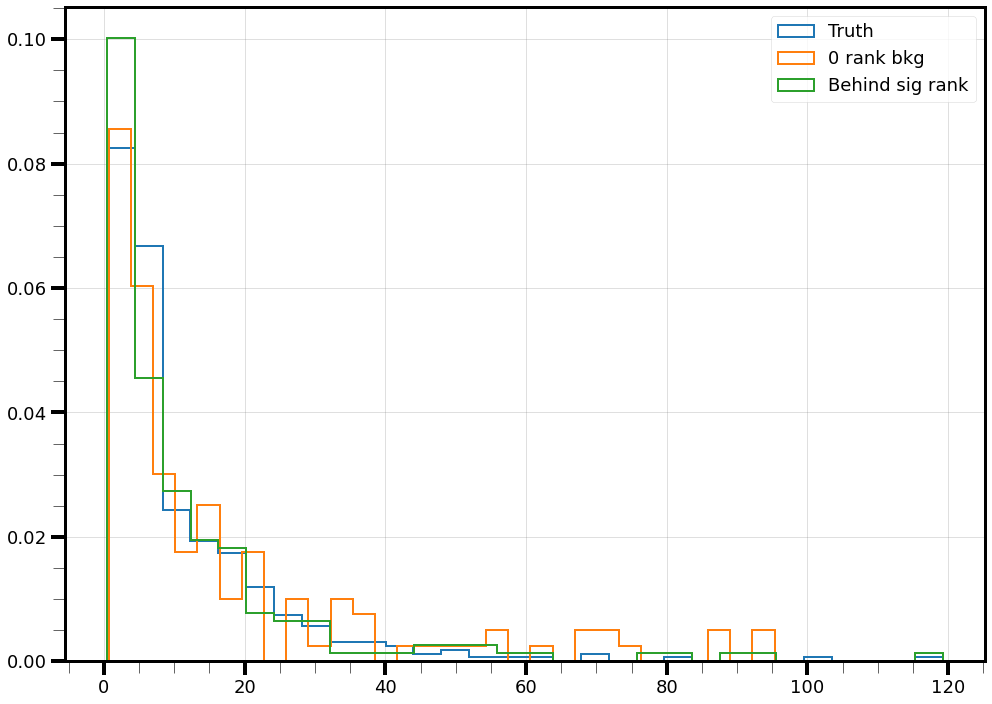

In [ ]:
ranks = ak.argsort(comb_metric(masses, momenta, energies, approaches, separations, impacts, angles), ascending=True)
bkg_ranks = ranks[np.logical_not(truth_mask)]

def get_second_rank(property):
    non_first_sig_events = np.logical_not(ranks[truth_mask] == 0).to_numpy()[:,0]
    print(non_first_sig_events)
    return

second_ranked = get_second_rank(impacts)

plt_conf.setup_figure()
plt.hist(impacts[truth_mask], **plt_conf.gen_kwargs(type="hist", density=True, label="Truth", bins=30))#plt_conf.get_bins(impacts[truth_mask])))
plt.hist(ak.pad_none(impacts[bkg_ranks == 0], 1, axis=1).to_numpy(), **plt_conf.gen_kwargs(type="hist", density=True, label="0 rank bkg", index=1, bins=30))#plt_conf.get_bins(ak.pad_none(impacts[bkg_ranks == 0], 1, axis=1).to_numpy())))

plt.hist(ak.pad_none(impacts[bkg_ranks == 1], 1, axis=1).to_numpy(), **plt_conf.gen_kwargs(type="hist", density=True, label="Behind sig rank", index=2, bins=30))
plt_conf.format_axis()
plt_conf.end_plot()

In [ ]:
print(results)
print(np.max(results))
print(np.where(results == np.max(results)))

[[[[0.68811881 0.18069307 0.06188119]
   [0.68811881 0.18069307 0.06188119]
   [0.68811881 0.18069307 0.06188119]
   [0.68811881 0.18069307 0.06188119]
   [0.68811881 0.18069307 0.06188119]
   [0.68811881 0.18069307 0.06188119]
   [0.68811881 0.18069307 0.06188119]
   [0.68811881 0.18069307 0.06188119]]

  [[0.68811881 0.18069307 0.05940594]
   [0.68564356 0.17821782 0.06188119]
   [0.68564356 0.17821782 0.06188119]
   [0.68564356 0.17821782 0.06188119]
   [0.68564356 0.17821782 0.06188119]
   [0.68564356 0.17821782 0.06188119]
   [0.68564356 0.17821782 0.06188119]
   [0.68564356 0.17821782 0.06188119]]

  [[0.68811881 0.18069307 0.05940594]
   [0.68564356 0.17821782 0.06188119]
   [0.68564356 0.17821782 0.06188119]
   [0.68564356 0.17821782 0.06188119]
   [0.68564356 0.17821782 0.06188119]
   [0.68564356 0.17821782 0.06188119]
   [0.68564356 0.17821782 0.06188119]
   [0.68564356 0.17821782 0.06188119]]

  [[0.68811881 0.18069307 0.05940594]
   [0.68564356 0.17821782 0.06188119]
   [0.

In [ ]:
# WTH is this you ****ing moron... Use something iterable for forming the polynomials...

def comb_metric_polynomial_sum(mass, m_0, m_1, m_2, m_3, m_4, angle, ang_0, ang_1, ang_2, ang_3, ang_4, approach, a_0, a_1, a_2, a_3, a_4, separation, s_0, s_1, s_2, s_3, s_4, impact, i_0, i_1, i_2, i_3, i_4):
    mass_metric     = m_0 + m_1 * mass       + m_2 * mass**2       + m_3 * mass**3       + m_4 * mass**4
    approach_metric =       a_1 * approach   + a_2 * approach**2   + a_3 * approach**3   + a_4 * approach**4
    separation_metric =     s_1 * separation + s_2 * separation**2 + s_3 * separation**3 + s_4 * separation**4
    impact_metric   =       i_1 * impact     + i_2 * impact**2     + i_3 * impact**3     + i_4 * impact**4
    angle_metric    =       ang_1 * angle    + ang_2 * angle**2    + ang_3 * angle**3    + ang_4 * angle**4

    return mass_metric + approach_metric + separation_metric + impact_metric + angle_metric

def comb_metric_polynomial_mult(mass, m_0, m_1, m_2, m_3, m_4, angle, ang_0, ang_1, ang_2, ang_3, ang_4, approach, a_0, a_1, a_2, a_3, a_4, separation, s_0, s_1, s_2, s_3, s_4, impact, i_0, i_1, i_2, i_3, i_4):
    mass_metric     = m_0 + m_1 * mass       + m_2 * mass**2       + m_3 * mass**3       + m_4 * mass**4
    approach_metric = a_0 + a_1 * approach   + a_2 * approach**2   + a_3 * approach**3   + a_4 * approach**4
    separation_metric =s_0+ s_1 * separation + s_2 * separation**2 + s_3 * separation**3 + s_4 * separation**4
    impact_metric   = i_0 + i_1 * impact     + i_2 * impact**2     + i_3 * impact**3     + i_4 * impact**4
    angle_metric    =ang_0+ ang_1 * angle    + ang_2 * angle**2    + ang_3 * angle**3    + ang_4 * angle**4

    return mass_metric * approach_metric * separation_metric * impact_metric * angle_metric

def get_pos_frac(approach_div, sep_div, impact_div, position=0):
    metric_rank = ak.argsort(comb_metric_iterate(approaches, separations, impacts, approach_divisor=approach_div, separation_divisor=sep_div, impact_divisor=impact_div), ascending=True)[truth_mask]
    
    if isinstance(position, int):
        return np.sum(metric_rank == position)/ak.num(metric_rank, axis=0)
    else:
        results = np.zeros_like(position, dtype=float)
        num_vals = ak.num(metric_rank, axis=0)
        for i, p in enumerate(position):
            results[i] = np.sum(metric_rank == p) / num_vals
        return results

In [ ]:
fig = plt.figure()
ax = Axes3D(fig)

